In [1]:
# general utilities
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import utils_CN
import os
import scipy.stats as ss
import scikit_posthocs as sp
import time
import joblib
import seaborn as sns
import math
import random
from statsmodels.stats.proportion import proportion_confint, proportions_ztest
from utils_CN import calculate_trended_lr, remove_corr_features, cramers_v_association, remove_assoc_features, univariate_cat, univariate_num
from itertools import product, combinations
from sklearn.base import BaseEstimator, TransformerMixin
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from pandas.testing import assert_frame_equal
from scipy.stats import ks_2samp, anderson_ksamp

# modelling
import xgboost as xgb
import shap
import imblearn.pipeline as imbpipe
from sklearn.tree import plot_tree
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_squared_error, r2_score, f1_score, accuracy_score, roc_auc_score, make_scorer, RocCurveDisplay, confusion_matrix, ConfusionMatrixDisplay, auc, classification_report
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import GroupShuffleSplit, RandomizedSearchCV, KFold, StratifiedGroupKFold, GroupKFold, cross_val_predict, cross_val_score, GridSearchCV
#from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_transformer, ColumnTransformer, TransformedTargetRegressor
from sklearn.linear_model import LogisticRegression, TweedieRegressor, LinearRegression
from imblearn.over_sampling import SMOTE, SMOTENC
from imblearn.under_sampling import RandomUnderSampler
from sklearn.pipeline import Pipeline
from sklearn.dummy import DummyRegressor
from smogn import smoter
from sklearn.base import BaseEstimator
from sklearn.ensemble import HistGradientBoostingRegressor, HistGradientBoostingClassifier, RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN, KMeans
import umap.umap_ as umap
import six
import sys
sys.modules['sklearn.externals.six'] = six
from skrules import SkopeRules
# global plotting params
%matplotlib inline
plt.rcParams["figure.figsize"]=20,14
textsize = 25

%load_ext autoreload
%autoreload 2

In [2]:
test = np.array([[0.4, 0.5], [10, 0]])
print(test)
logreg = LogisticRegression()
logreg.coef_ = np.array([[0.1, -2.9]])
logreg.classes_ = np.array([0, 1])
logreg.intercept_ = np.array([[0]])

logreg.predict(test)

[[ 0.4  0.5]
 [10.   0. ]]


array([0, 1])

In [3]:
pd.__version__

'1.3.5'

In [4]:
# !pip install --upgrade pandas --proxy=http://gate.swissre.com:9443

# Loading dataset

In [5]:
base_data_path = "/SharedWithSome/smc-lawyers/LR_Hotspots/merged_datasets/"
merged_df = pd.read_csv(os.path.join(base_data_path, "sml_merged.csv"), parse_dates = ["effective_date"], low_memory=False)

In [6]:
merged_df["aop_low_risk_exposure"].value_counts()

0.0000     88978
0.1000      5833
0.0500      5588
0.2000      4319
1.0000      3668
           ...  
19.4560        1
10.5630        1
4.9608         1
5.0500         1
13.8060        1
Name: aop_low_risk_exposure, Length: 10109, dtype: int64

In [7]:
merged_df["exposure"] * merged_df["aop_low_risk"]

0          0.1881
1          0.0000
2          0.0000
3          0.5272
4          0.0000
           ...   
234059    13.8060
234060        NaN
234061        NaN
234062     9.7900
234063     2.6400
Length: 234064, dtype: float64

In [8]:
merged_df["aop_low_risk_exposure"]

0          0.1881
1          0.0000
2          0.0000
3          0.5272
4          0.0000
           ...   
234059    13.8060
234060        NaN
234061        NaN
234062     9.7900
234063     2.6400
Name: aop_low_risk_exposure, Length: 234064, dtype: float64

# import dtypes pre-processing

## date dtype casting

In [9]:
potential_dates = [ele for ele in merged_df.columns if "date" in ele or "dt" in ele]
merged_df = utils_CN.localize_dates(merged_df, potential_dates)

# Target Variable

## Building "ultimate (not developed)" target variable. Note that in this calculation, nulls in ultimate loss are replaced with zero before computation.

In [10]:
merged_df = utils_CN.calculate_trended_lr(merged_df)

In [11]:
print(merged_df["ultimate_trended_onlevel_lr"].describe())
merged_df["ultimate_trended_onlevel_lr"].value_counts()

count    77232.000000
mean         0.751440
std         13.099391
min          0.000000
25%          0.000000
50%          0.000000
75%          0.012079
max       1524.773986
Name: ultimate_trended_onlevel_lr, dtype: float64


0.000000    47604
0.126423     2098
0.126423     1233
0.126423      156
0.001240      108
            ...  
0.013176        1
0.001387        1
0.012528        1
0.001332        1
0.028669        1
Name: ultimate_trended_onlevel_lr, Length: 21423, dtype: int64

In [12]:
merged_df["loss_trend_factor"].describe()

count    234064.000000
mean          1.457234
std           0.177954
min           1.000000
25%           1.345478
50%           1.485516
75%           1.607970
max           1.672932
Name: loss_trend_factor, dtype: float64

In [13]:
merged_df["ultimate_trended_onlevel_lr"].isna().sum()

156832

## Elminating rows with no target variable 

In [14]:
present_target_df = merged_df[merged_df["ultimate_trended_onlevel_lr"].notnull()].copy()

In [15]:
present_target_df.shape

(77232, 535)

In [16]:
present_target_df["effective_year"].value_counts()

2007    9616
2008    9059
2009    8211
2010    7414
2011    6477
2012    5697
2019    3909
2018    3903
2021    3885
2020    3880
2017    3753
2016    3495
2015    2930
2013    2829
2014    2086
2022      88
Name: effective_year, dtype: int64

## Restricting policies to those beyond 2010

In [17]:
present_target_trunc_df = present_target_df[(present_target_df["effective_date"].dt.year > 2010) & (present_target_df["effective_date"].dt.year < 2022)].copy()

In [18]:
present_target_trunc_df.shape

(42844, 535)

## Target distributions

In [19]:
print(present_target_trunc_df.shape)

(42844, 535)


In [20]:
fraction_above_zero = present_target_trunc_df[present_target_trunc_df["ultimate_trended_onlevel_lr"] > 0].shape[0]/present_target_trunc_df.shape[0]

print("fraction of policies above 0 LR:", fraction_above_zero)

fraction_above_thresh = present_target_trunc_df[present_target_trunc_df["ultimate_trended_onlevel_lr"] > 0.57].shape[0]/present_target_trunc_df.shape[0]

print("fraction of policies above 0.57 LR:", fraction_above_thresh)

present_target_trunc_df["policy_id"].nunique()

fraction of policies above 0 LR: 0.6596022780319298
fraction of policies above 0.57 LR: 0.0285921015778172


17309

In [21]:
print(np.percentile(present_target_trunc_df["ultimate_trended_onlevel_lr"], 99.5))

33.27788277696893


In [22]:
present_target_trunc_df[present_target_trunc_df["ultimate_trended_onlevel_lr"] > 33.277].shape[0]

215

In [23]:
present_target_trunc_df["policy_id"].nunique()

17309

Checking if excess of thresholds follow GPD:

(array([-5.,  0.,  5., 10., 15., 20., 25., 30.]),
 [Text(0, -5.0, '−5'),
  Text(0, 0.0, '0'),
  Text(0, 5.0, '5'),
  Text(0, 10.0, '10'),
  Text(0, 15.0, '15'),
  Text(0, 20.0, '20'),
  Text(0, 25.0, '25'),
  Text(0, 30.0, '30')])

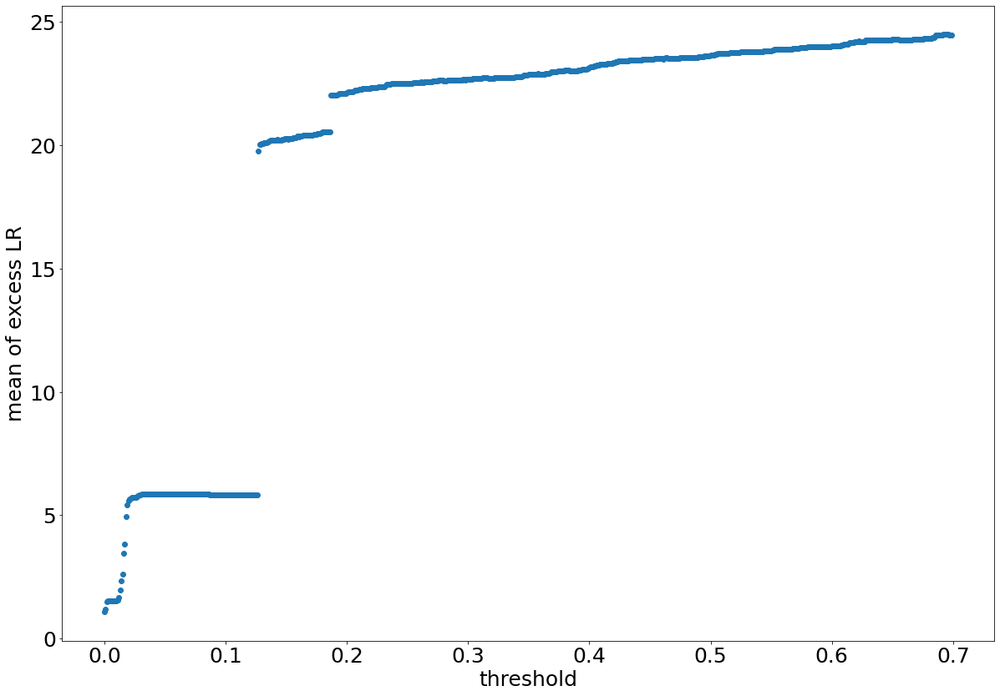

In [24]:
thresh_range = np.arange(0.000, 0.7, 0.001)

excess_mean_per_thresh = []
thresh = []
for u in thresh_range:
    excess = present_target_trunc_df[present_target_trunc_df["ultimate_trended_onlevel_lr"] > u]["ultimate_trended_onlevel_lr"] - u
    excess_mean = excess.mean()
    #print(u, excess.shape)
    excess_mean_per_thresh.append(excess_mean)
    thresh.append(u)
    
plt.plot(thresh, excess_mean_per_thresh, marker='o', lw=0)
plt.xlabel("threshold", fontsize=25)
plt.ylabel("mean of excess LR", fontsize=25)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

regular dist:

count    42844.000000
mean         0.717851
std         12.580030
min          0.000000
25%          0.000000
50%          0.001538
75%          0.015272
max       1524.773986
Name: ultimate_trended_onlevel_lr, dtype: float64

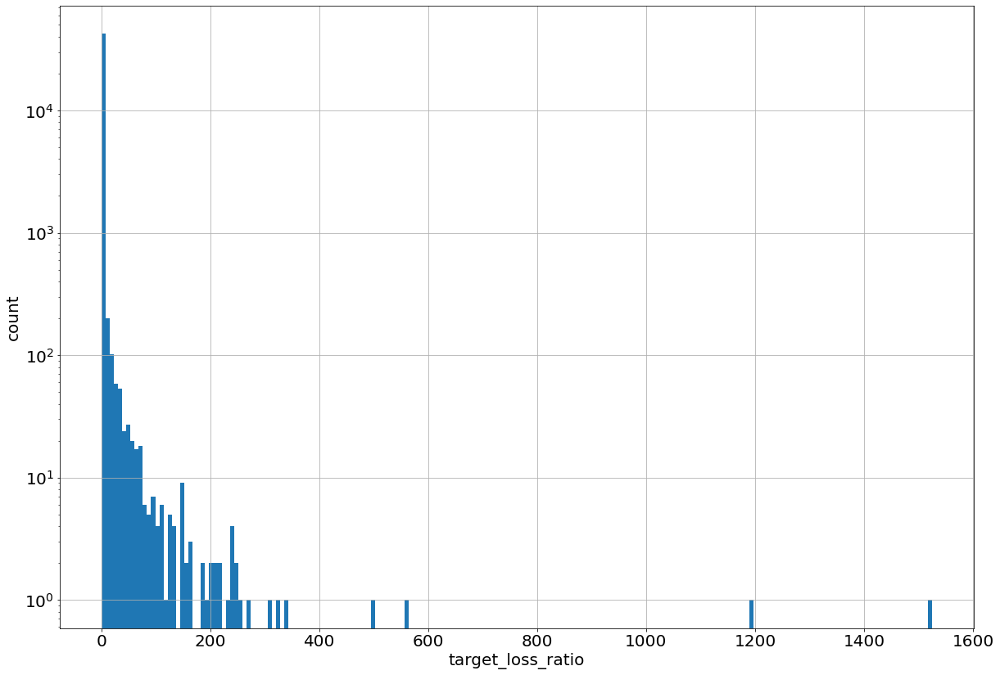

In [25]:
present_target_trunc_df["ultimate_trended_onlevel_lr"].hist(bins=200)

plt.yscale('log')
plt.xlabel("target_loss_ratio", fontsize=20)
plt.ylabel("count", fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.savefig("nontruncated_loss_ratio.png", dpi=300, bbox_inches="tight")
present_target_trunc_df["ultimate_trended_onlevel_lr"].describe()

sqrt:

(array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03, 1.e+04, 1.e+05,
        1.e+06]),
 [Text(0, 0.01, '$\\mathdefault{10^{-2}}$'),
  Text(0, 0.1, '$\\mathdefault{10^{-1}}$'),
  Text(0, 1.0, '$\\mathdefault{10^{0}}$'),
  Text(0, 10.0, '$\\mathdefault{10^{1}}$'),
  Text(0, 100.0, '$\\mathdefault{10^{2}}$'),
  Text(0, 1000.0, '$\\mathdefault{10^{3}}$'),
  Text(0, 10000.0, '$\\mathdefault{10^{4}}$'),
  Text(0, 100000.0, '$\\mathdefault{10^{5}}$'),
  Text(0, 1000000.0, '$\\mathdefault{10^{6}}$')])

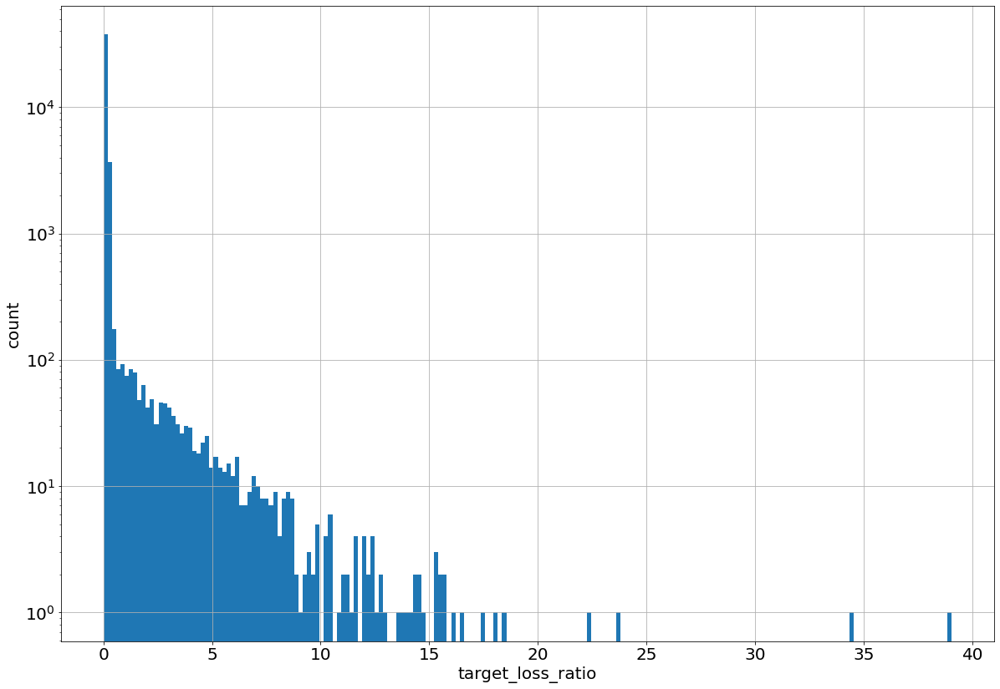

In [26]:
np.sqrt(present_target_trunc_df["ultimate_trended_onlevel_lr"]).hist(bins=200)

plt.yscale('log')
plt.xlabel("target_loss_ratio", fontsize=20)
plt.ylabel("count", fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
#plt.savefig("nontruncated_loss_ratio.png", dpi=300, bbox_inches="tight")

log transformation (log(x+1)):

(array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03, 1.e+04, 1.e+05,
        1.e+06]),
 [Text(0, 0.01, '$\\mathdefault{10^{-2}}$'),
  Text(0, 0.1, '$\\mathdefault{10^{-1}}$'),
  Text(0, 1.0, '$\\mathdefault{10^{0}}$'),
  Text(0, 10.0, '$\\mathdefault{10^{1}}$'),
  Text(0, 100.0, '$\\mathdefault{10^{2}}$'),
  Text(0, 1000.0, '$\\mathdefault{10^{3}}$'),
  Text(0, 10000.0, '$\\mathdefault{10^{4}}$'),
  Text(0, 100000.0, '$\\mathdefault{10^{5}}$'),
  Text(0, 1000000.0, '$\\mathdefault{10^{6}}$')])

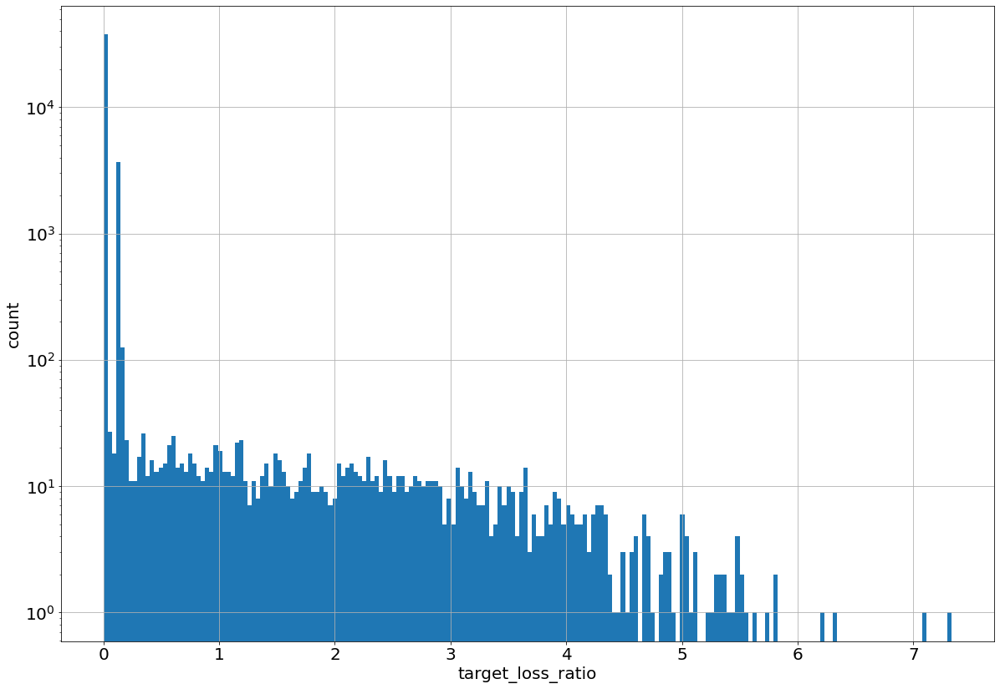

In [27]:
np.log(present_target_trunc_df["ultimate_trended_onlevel_lr"] + 1).hist(bins=200)

plt.yscale('log')
plt.xlabel("target_loss_ratio", fontsize=20)
plt.ylabel("count", fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
#plt.savefig("nontruncated_loss_ratio.png", dpi=300, bbox_inches="tight")

<Axes: >

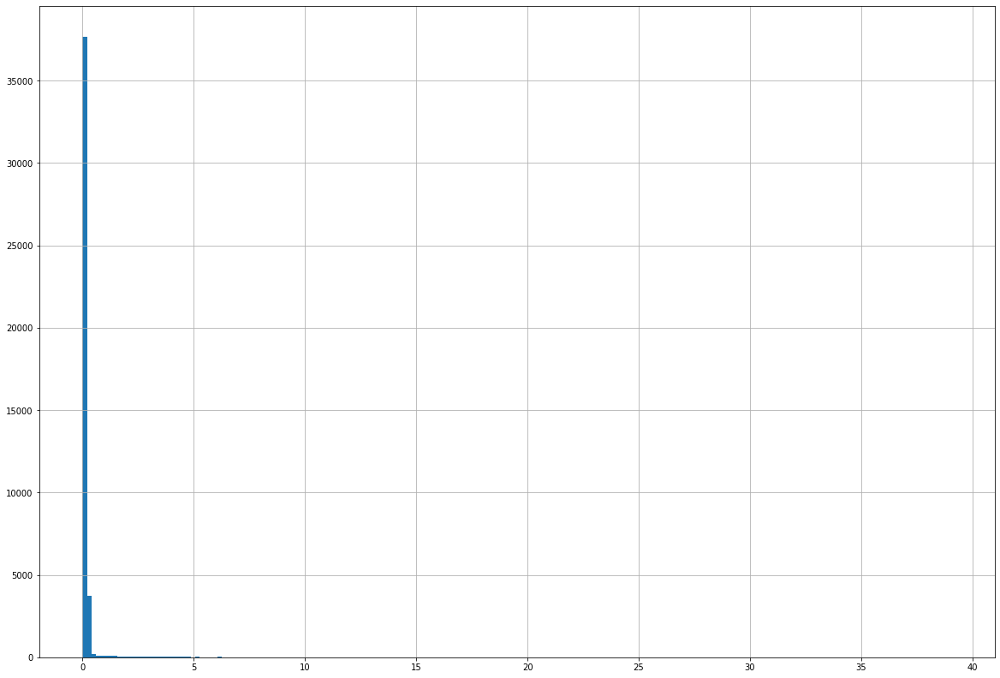

In [28]:
np.sqrt(present_target_trunc_df["ultimate_trended_onlevel_lr"]).hist(bins=200)

# Previous policy feature engineering (the groupby approach)

In [29]:
def generate_history(df, use_features, groupby='policy_id', order_by='effective_year'):
    testgroup_df = df.groupby(groupby)[use_features].agg(list)
    testgroup_df["sorted_indicies"] = testgroup_df[order_by].apply(lambda x: np.array(x).argsort())
    
    for feat in use_features:
        testgroup_df[feat] = testgroup_df.apply(lambda row: np.array(row[feat])[row["sorted_indicies"]], axis=1)
        
    testgroup_df = testgroup_df.drop(columns="sorted_indicies")
        
    testgroup_df.columns.values[:] = [col + '_history' for col in testgroup_df.columns.values[:]]
    return testgroup_df

## create a trended ultimate_loss for future feature engineering (useful to split up trended losses and onlevel premiums for some features)

In [30]:
present_target_trunc_df["ultimate_loss_trended"] = present_target_trunc_df[ "ultimate_trended_onlevel_lr"] * present_target_trunc_df["onlevel_premium"]

## generate a groupby history df 

In [31]:
# columns selected based on discussions w/ Rishav
use_cols = [
    "effective_year",
    'onlevel_premium',
    'ultimate_loss_trended',
    'renewed_count',
    'producer',
    'underwriter',
    'exposure',
    'auto_renewal_count',
    'max_detailed_aop',
    'pt_att',
    'ft_att',
    'rate_change',
    'defense_outside'
]

grouped_histories_df = generate_history(present_target_trunc_df, use_features=use_cols, order_by='effective_year')

In [32]:
grouped_histories_df.columns

Index(['effective_year_history', 'onlevel_premium_history',
       'ultimate_loss_trended_history', 'renewed_count_history',
       'producer_history', 'underwriter_history', 'exposure_history',
       'auto_renewal_count_history', 'max_detailed_aop_history',
       'pt_att_history', 'ft_att_history', 'rate_change_history',
       'defense_outside_history'],
      dtype='object')

In [33]:
grouped_histories_df.head()

,effective_year_history,onlevel_premium_history,ultimate_loss_trended_history,renewed_count_history,producer_history,underwriter_history,exposure_history,auto_renewal_count_history,max_detailed_aop_history,pt_att_history,ft_att_history,rate_change_history,defense_outside_history
policy_id,,,,,,,,,,,,,
FNA3370001031,"[2019, 2020, 2021]","[36100.0, 42868.75, 45125.0]","[610.290594496087, 5226.71167756677, 228256.18...","[1, 1, 1]","[LEMME INSURANCE GROUP, INC. , LEMME INSURAN...","[JILL ZUBAK, JILL ZUBAK, JILL ZUBAK]","[16.0, 19.0, 20.0]","[0, 0, 0]","[intellectual_property_patent_trademark, intel...","[0.0, 0.0, 0.0]","[16.0, 19.0, 20.0]","[2.132857142857143, 2.117748502994012, 2.11880...","[34300.0, 41750.0, 45125.0]"
FNA3370107898,"[2014, 2015, 2016, 2017]","[15457.5, 20610.0, 20610.0, 20610.0]","[10.396910179469351, 35.14193929646215, 28.504...","[1, 1, 1, 0]","[R-T SPECIALTY, LLC, R-T SPECIALTY, LLC, R-T S...","[JILL ZUBAK, JILL ZUBAK, JILL ZUBAK, JILL ZUBAK]","[3.0, 4.0, 4.0, 4.0]","[0, 0, 0, 0]","[insurance, insurance, insurance, insurance]","[0.0, 0.0, 0.0, 0.0]","[3.0, 4.0, 4.0, 4.0]","[0.4970912220617074, 0.5688847599649083, 0.477...","[22900.0, 22900.0, 22900.0, 20610.0]"
FNA3370107925,"[2014, 2015, 2016, 2017, 2018]","[23134.5, 23134.5, 23134.5, 23134.5, 15423.0]","[11.480186497731967, 36.8637408637386, 28.4159...","[1, 1, 1, 1, 0]","[PEARL INSURANCE GROUP LLC , PEARL INSURAN...","[JILL ZUBAK, JILL ZUBAK, JILL ZUBAK, JILL ZUBA...","[3.0, 3.0, 3.0, 3.0, 2.0]","[0, 0, 0, 0, 0]","[real_estate_commercial, real_estate_commercia...","[0.0, 0.0, 0.0, 0.0, 0.0]","[3.0, 3.0, 3.0, 3.0, 2.0]","[0.6738768041294115, 0.6993882627671051, 0.735...","[25286.0, 24022.0, 22829.0, 22829.0, 15423.0]"
FNA3370107958,"[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]","[46048.0, 46048.0, 34536.0, 40292.0, 34536.0, ...","[28.600129250894867, 95.265347143453, 56.07013...","[1, 1, 1, 1, 1, 1, 1, 1]","[THE JAMES B OSWALD COMPANY , THE JAMES B O...","[MARYROSE T. REUSZ, MARYROSE T. REUSZ, MARYROS...","[8.0, 8.0, 6.0, 7.0, 6.0, 6.0, 6.0, 6.0]","[0, 0, 0, 0, 0, 0, 0, 0]","[real_estate_commercial, corporate_and_busines...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]","[8.0, 8.0, 6.0, 7.0, 6.0, 6.0, 6.0, 6.0]","[0.4945594955212227, 0.4516190931622303, 0.369...","[62994.0, 62079.0, 45046.0, 42975.0, 35890.0, ..."
FNA3370108020,"[2014, 2015, 2016, 2017, 2018, 2019]","[26196.0, 26196.0, 26196.0, 34928.0, 26196.0, ...","[16.09205608738479, 51.673996590819634, 38.362...","[1, 1, 1, 1, 1, 0]","[R-T SPECIALTY, LLC, R-T SPECIALTY, LLC, R-T S...","[JILL ZUBAK, JILL ZUBAK, JILL ZUBAK, JILL ZUBA...","[3.0, 3.0, 3.0, 4.0, 3.0, 3.0]","[0, 0, 0, 0, 0, 0]","[family_law, family_law, family_law, family_la...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]","[3.0, 3.0, 3.0, 4.0, 3.0, 3.0]","[0.6437834378526437, 0.589969133375945, 0.6574...","[35444.0, 33673.0, 30820.0, 34928.0, 26196.0, ..."


What are the distributions of history lengths?

In [34]:
grouped_histories_df["effective_year_history"].apply(lambda row: len(row)).describe()

count    17309.000000
mean         2.475244
std          2.106488
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         11.000000
Name: effective_year_history, dtype: float64

In [35]:
grouped_histories_df["effective_year_history"].apply(lambda row: len(row)).value_counts()

1     7581
2     4393
3     1801
4     1399
6      516
7      444
5      370
8      279
9      247
11     179
10     100
Name: effective_year_history, dtype: int64

## Merge groupby history with the policy-level dataset to append histories to policies

In [36]:
def merge_truncate_histories(df, grpby_histories_df, truncate_by='effective_year', truncation_index_from="effective_year_history", merge_on='policy_id'):
    
    # do merge
    df_with_histories = pd.merge(df, grpby_histories_df, how='left', on=merge_on)
    
    # truncate histories for each policy_id
    for history in [col for col in grpby_histories_df.columns if col != truncation_index_from]:
        df_with_histories[history] = df_with_histories.apply(lambda row: row[history][:np.where(np.array(row[truncation_index_from]) == row[truncate_by])[0][0]], axis=1)
    df_with_histories[truncation_index_from] = df_with_histories.apply(lambda row: row[truncation_index_from]
                                                                       [:np.where(np.array(row[truncation_index_from]) == row[truncate_by])[0][0]], axis=1)
    
    return df_with_histories

In [37]:
df_with_histories = merge_truncate_histories(present_target_trunc_df, grouped_histories_df)

In [38]:
df_with_histories["effective_year_history"].apply(lambda row: len(row)).value_counts().cumsum()

0     17311
1     27037
2     32372
3     35906
4     38041
5     39806
6     41055
7     41860
8     42386
9     42665
10    42844
Name: effective_year_history, dtype: int64

## feature engineering

In [39]:
def calc_mean_of_ratios(row, years_back, num, denom):
    
    if len(row[denom]) >= years_back:
        return np.mean(np.divide(np.array(row[num][-years_back:]), np.array(row[denom][-years_back:])))
    else:
        return np.nan
    
def calc_mean_of_history(row, years_back, target):
    if len(row[target]) >= years_back:
        return np.mean(np.array(row[target][-years_back:]))
    else:
        return np.nan
    
def create_previous_pol_features(df):
    
    # loss ratio related features (past 5 year history represents ~93% of history for all policies)
    df["prev_lr_avg_1"] = df.apply(calc_mean_of_ratios, args=(1, "ultimate_loss_trended_history", "onlevel_premium_history"), axis=1)
    df["prev_lr_avg_2"] = df.apply(calc_mean_of_ratios, args=(2, "ultimate_loss_trended_history", "onlevel_premium_history"), axis=1)
    df["prev_lr_avg_3"] = df.apply(calc_mean_of_ratios, args=(3, "ultimate_loss_trended_history", "onlevel_premium_history"), axis=1)
    df["prev_lr_avg_4"] = df.apply(calc_mean_of_ratios, args=(4, "ultimate_loss_trended_history", "onlevel_premium_history"), axis=1)
    df["prev_lr_avg_5"] = df.apply(calc_mean_of_ratios, args=(5, "ultimate_loss_trended_history", "onlevel_premium_history"), axis=1)
    
    df["prev_lr_std"] = df.apply(lambda row: np.nan if (len(row["onlevel_premium_history"]) <= 1) \
                                 else np.std(np.divide(np.array(row["ultimate_loss_trended_history"]), np.array(row["onlevel_premium_history"]))), axis=1)
    
    df["prev_lr_trend"] = df.apply(lambda row: np.nan if (len(row["onlevel_premium_history"]) <= 1) \
                                   else np.polyfit(np.array(row["effective_year_history"]), np.divide(np.array(row["ultimate_loss_trended_history"]), \
                                                                                                      np.array(row["onlevel_premium_history"])), 1)[0], axis=1)
    df["prev_agg_lr_bad"] = df.apply(lambda row: np.nan if (np.sum(np.array(row["onlevel_premium_history"])) == 0) \
                                     else 1 if (np.sum(np.array(row["ultimate_loss_trended_history"]))/np.sum(np.array(row["onlevel_premium_history"])) > 0.57) \
                                     else 0, axis=1)
    
    df["prev_lr_bad_proportion"] = df.apply(lambda row: np.nan if (len(row["onlevel_premium_history"]) == 0) \
                                            else len(np.where(np.divide(np.array(row["ultimate_loss_trended_history"]), \
                                                                        np.array(row["onlevel_premium_history"])) > 0.57)[0])/len(row["onlevel_premium_history"]), axis=1)
    # loss related features
    df["prev_loss_avg_1"] = df.apply(calc_mean_of_history, args=(1, "ultimate_loss_trended_history"), axis=1)
    df["prev_loss_avg_2"] = df.apply(calc_mean_of_history, args=(2, "ultimate_loss_trended_history"), axis=1)
    df["prev_loss_avg_3"] = df.apply(calc_mean_of_history, args=(3, "ultimate_loss_trended_history"), axis=1)
    df["prev_loss_avg_4"] = df.apply(calc_mean_of_history, args=(4, "ultimate_loss_trended_history"), axis=1)
    df["prev_loss_avg_5"] = df.apply(calc_mean_of_history, args=(5, "ultimate_loss_trended_history"), axis=1)
    
    df["prev_loss_trend"] = df.apply(lambda row: np.nan if (len(row["ultimate_loss_trended_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["ultimate_loss_trended_history"]), 1)[0] , axis=1)
    
    # premiums related features
    df["prev_premium_avg_1"] = df.apply(calc_mean_of_history, args=(1, "onlevel_premium_history"), axis=1)
    df["prev_premium_avg_2"] = df.apply(calc_mean_of_history, args=(2, "onlevel_premium_history"), axis=1)
    df["prev_premium_avg_3"] = df.apply(calc_mean_of_history, args=(3, "onlevel_premium_history"), axis=1)
    df["prev_premium_avg_4"] = df.apply(calc_mean_of_history, args=(4, "onlevel_premium_history"), axis=1)
    df["prev_premium_avg_5"] = df.apply(calc_mean_of_history, args=(5, "onlevel_premium_history"), axis=1)
    
    df["prev_premium_trend"] = df.apply(lambda row: np.nan if (len(row["onlevel_premium_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["onlevel_premium_history"]), 1)[0] , axis=1)
    
    # renewal 
    df["prev_policy_renewed"] = df.apply(lambda row: 0 if (len(row["renewed_count_history"]) == 0) else 1, axis=1)
    df["prev_renewal_uniform"] = df.apply(lambda row: np.nan if (len(row["renewed_count_history"]) == 0) \
                                          else 1 if (np.mean(row["renewed_count_history"]) == 1) \
                                          else 0, axis=1)
    # autorenewal related features
    df["prev_auto_renewal"] = df.apply(lambda row: 1 if sum(row["auto_renewal_count_history"]) > 1 else 0, axis=1)
    df["prev_auto_renewal_std"] = df.apply(lambda row: np.nan if (len(row["auto_renewal_count_history"]) <= 1) else np.std(np.array(row["auto_renewal_count_history"])), axis=1)
    df["prev_auto_renewal_trend"] = df.apply(lambda row: np.nan if (len(row["auto_renewal_count_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["auto_renewal_count_history"]), 1)[0] , axis=1)
    df["prev_auto_renewal_mean"] = df.apply(lambda row: np.nan if (len(row["auto_renewal_count_history"]) == 0) else np.mean(row["auto_renewal_count_history"]), axis=1)
    
    # broker/producer related
    df["prev_broker_uniform"] = df.apply(lambda row: np.nan if (len(np.unique(row["producer_history"])) == 0) else 1 if (len(np.unique(row["producer_history"])) == 1) else 0, axis=1)
    
    # underwriter related policies
    df["prev_underwriter_uniform"] = df.apply(lambda row: np.nan if (len(np.unique(row["underwriter_history"])) == 0) \
                                              else 1 if (len(np.unique(row["underwriter_history"])) == 1) else 0, axis=1)
    
    # exposure related
    df["prev_exposure_mean"] = df.apply(lambda row: np.nan if (len(row["exposure_history"]) == 0) else np.mean(row["exposure_history"]) if (len(row["exposure_history"]) > 0) else 0, axis=1)
    
    # aop category related
    df["prev_max_aop_consistency"] = df.apply(lambda row: np.nan if (len(row["max_detailed_aop_history"]) == 0) \
                                              else list(row["max_detailed_aop_history"]).count(row["max_detailed_aop"])/len(row["max_detailed_aop_history"]), axis=1)
    # ft_att related
    df["prev_ft_att_trend"] = df.apply(lambda row: np.nan if (len(row["ft_att_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["ft_att_history"]), 1)[0] , axis=1)
    # pt_att related
    df["prev_pt_att_trend"] = df.apply(lambda row: np.nan if (len(row["pt_att_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["pt_att_history"]), 1)[0] , axis=1)
    
    # rate change related
    df["prev_rate_change"] = df.apply(lambda row: np.nan if (len(row["rate_change_history"]) == 0) \
                                             else row["rate_change_history"][-1], axis=1)
    df["prev_rate_change_trend"] = df.apply(lambda row: np.nan if (len(row["rate_change_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["rate_change_history"]), 1)[0] , axis=1)
    
    # defense outside related
    df["prev_defense_outside"] = df.apply(lambda row: np.nan if (len(row["defense_outside_history"]) == 0) \
                                             else row["rate_change_history"][-1], axis=1)
    df["prev_defense_outside_trend"] = df.apply(lambda row: np.nan if (len(row["defense_outside_history"]) <= 1) \
                                             else np.polyfit(np.array(row["effective_year_history"]), np.array(row["defense_outside_history"]), 1)[0] , axis=1)
    

In [40]:
create_previous_pol_features(df_with_histories)

Polyfit may be poorly conditioned
Polyfit may be poorly conditioned
Polyfit may be poorly conditioned
Polyfit may be poorly conditioned
Polyfit may be poorly conditioned
Polyfit may be poorly conditioned
Polyfit may be poorly conditioned
Polyfit may be poorly conditioned


In [41]:
df_with_histories[["prev_premium_avg_1", "prev_rate_change_trend", "rate_change_history", "effective_year_history", "prev_lr_trend", "ultimate_loss_trended_history", "onlevel_premium_history", "prev_agg_lr_bad", "auto_renewal_count_history", "prev_auto_renewal_trend", "renewed_count_history"]].sample(20)

,prev_premium_avg_1,prev_rate_change_trend,rate_change_history,effective_year_history,prev_lr_trend,ultimate_loss_trended_history,onlevel_premium_history,prev_agg_lr_bad,auto_renewal_count_history,prev_auto_renewal_trend,renewed_count_history
2071,2772.622971,-5.589281e-04,"[1.0181792559188274, 0.9692307692307692, 0.868...","[2011, 2012, 2013, 2014, 2015]",0.000382,"[0.0, 0.0, 0.0, 1.4387689239623744, 4.60681667...","[6212.281134453138, 3147.514275364717, 2887.89...",0.0,"[1, 1, 1, 1, 1]",2.794938e-17,"[1, 1, 1, 1, 1]"
11844,NaN,NaN,[],[],NaN,[],[],NaN,[],NaN,[]
35713,19461.589358,-7.019996e-03,"[1.0596997756944844, 1.045488561043404, 1.0456...","[2011, 2012, 2013]",0.000000,"[0.0, 0.0, 0.0]","[18603.72070288732, 19151.794623966314, 19461....",0.0,"[1, 0, 0]",-5.000000e-01,"[1, 1, 1]"
15898,NaN,NaN,[],[],NaN,[],[],NaN,[],NaN,[]
13022,20554.768694,-3.029844e-02,"[0.9687593200119295, 0.9384608796197164]","[2018, 2019]",0.006228,"[343.0243014801596, 415.478007932307]","[24527.58041487564, 20554.768694234168]",0.0,"[0, 1]",1.000000e+00,"[1, 1]"
31933,1487.335734,-4.580464e-15,"[1.0, 1.0275952693823915, 1.0]","[2015, 2016, 2017]",0.006017,"[2.3356345680880084, 1.894479944201628, 20.008...","[1647.0587571356264, 1647.6456113192953, 1487....",0.0,"[1, 1, 1]",-1.120231e-16,"[1, 1, 1]"
27050,1187.810761,-4.444444e-03,"[1.0, 1.0444444444444445, 1.0, 1.0]","[2011, 2012, 2013, 2014]",0.000151,"[0.0, 0.0, 0.0, 0.5974818251607714]","[1182.812181244381, 1169.4259696632316, 1195.6...",0.0,"[1, 1, 1, 0]",-3.000000e-01,"[1, 1, 1, 1]"
4906,5543.037873,-1.815098e-16,"[1.0, 1.0]","[2014, 2015]",0.000995,"[2.5565502716415685, 7.896961555440796]","[5944.295640550006, 5543.037872709294]",0.0,"[1, 1]",-1.815098e-16,"[1, 1]"
13179,9929.563522,-7.571241e-17,"[1.0, 1.0]","[2018, 2019]",0.003972,"[120.09175422010804, 167.00255160175723]","[9348.07059194654, 9929.563521537772]",0.0,"[1, 1]",-7.571241e-17,"[1, 1]"
33886,817.914317,NaN,[1.0182481751824817],[2011],NaN,[0.0],[817.9143173363977],0.0,[1],NaN,[1]


# Feature Pruning/Engineering

## remove histories

In [42]:
df = df_with_histories.drop(columns=[col for col in df_with_histories if 'history' in col])

## Dropping low-hanging duplicate fruit

In [43]:
potential_duplicates = [ele for ele in df.columns if ele[-2:] == "_x" or ele[-2:] == "_y"]
print(potential_duplicates)

['tech_upd_ts_x', 'program_description_x', 'stamp_date_x', 'valuation_date_x', 'total_incurred_incl_rec_x', 'program_description_y', 'tech_upd_ts_y', 'stamp_date_y', 'valuation_date_y', 'total_incurred_incl_rec_y']


Eliminating columns previous investigated in deduplication as PI (tech_upd_ts, stamp_date, valuation_date, total_incurred_incl_rec). Keeping those in small_midsize_lawyers except in total_incurred_incl_rec case.

In [44]:
preprocess_df = df.drop(columns=['tech_upd_ts_y', 'stamp_date_y', 'valuation_date_y', 'program_description_y', 'total_incurred_incl_rec_y'])

In [45]:
preprocess_df = preprocess_df.rename(columns = {'tech_upd_ts_x': 'tech_upd_ts', 'program_description_x': 'program_description',
                               'stamp_date_x': 'stamp_date', 'valuation_date_x': 'valuation_date',
                               'total_incurred_incl_rec_x': 'total_incurred_incl_rec'})

## AOP feature engineering

Updating AOP columns here (which the business may do themselves in Stargate):

In [46]:
aop_cols = ['entertainment_sports',
            'personal_injury_and_negligence_plaintiff',
            'financial_planning',
            'intellectual_property_copyright',
            'intellectual_property_patent_trademark',
            'mergers_acquisitions',
            'commercial_and_business_litigation_defense',
            'employment_law_defense',
            'personal_injury_and_negligence_defense',
            'workers_comp_defense',
            'civil_rights_and_discrimination',
            'collection_bankruptcy',
            'commercial_and_business_litigation_defense_plaintiff',
            'estate_probate_trust',
            'family_law',
            'administrative_law',
            'admiralty_law',
            'admiralty_law_general',
            'admiralty_law_plaintiff',
            'antitrust_trade',
            'commercial_real_estate_closings',
            'commercial_real_estate_foreclosure',
            'commercial_real_estate_other',
            'commercial_real_estate_title',
            'communications_fcc',
            'construction_law',
            'consumer_law',
            'corporate_and_business_organization',
            'criminal',
            'employment_law_plaintiff',
            'environmental_law',
            'financial_institution',
            'government_contracts_relations',
            'healthcare',
            'immigration_naturalization',
            'insurance_coverage',
            'insurance_opinions',
            'intellectual_property_c_p_t_including_litigation',
            'intellectual_property_c_p_t_not_including_litigation',
            'international_law',
            'juvenile_court_proceeding',
            'labor_labor_representation',
            'labor_management_representation',
            'lobbying',
            'mediation_arbitration',
            'natural_resources_other',
            'natural_resources_title',
            'natural_resources_general',
            'other',
            'pension_employee_benefits',
            'plaintiff_class_action',
            'plaintiff_mass_tort',
            'residential_real_estate_closings',
            'residential_real_estate_foreclosure',
            'residential_real_estate_other',
            'residential_real_estate_title',
            'real_estate_residential', 
            'real_estate_commercial',
            'securities_law_incl_bonds_private_placements_and_limited_partnerships',
            'social_security_veterans_administration',
            'tax_ad_valorum',
            'taxation_opinions',
            'taxation_other',
            'taxation_general',
            'workers_comp_plaintiff',
            'defense']

aops_independent_risk = ['insurance', 'personal_injury_and_negligence_defense']
aops_low_risk = ['administrative_law', 'commercial_and_business_litigation_defense', 'criminal', 'employment_law_defense', 
                 'lobbying', 'mediation_arbitration', 'workers_comp_defense']
aops_below_average_risk = ['consumer_law', 'government_contracts_relations', 'immigration_naturalization', 'labor_management_representation']
aops_average_risk = ['admiralty_law_general', 'civil_rights_and_discrimination', 'construction_law', 'corporate_and_business_organization',
                    'family_law', 'healthcare', 'international_law', 'other', 'taxation_other', 'workers_comp_plaintiff']
aops_above_average_risk = ['antitrust_trade', 'collection_bankruptcy', 'commercial_and_business_litigation_defense_plaintiff', 'employment_law_plaintiff',
                          'entertainment_sports', 'environmental_law', 'estate_probate_trust', 'financial_institution',
                          'financial_planning', 'intellectual_property_copyright', 'labor_labor_representation', 'mergers_acquisitions',
                          'natural_resources_general', 'pension_employee_benefits', 'real_estate_residential', 'real_estate_commercial', 
                          'taxation_opinions']
aops_high_risk = ['intellectual_property_patent_trademark', 'personal_injury_and_negligence_plaintiff', 'plaintiff_class_action', 'plaintiff_mass_tort',
                 'securities_law_incl_bonds_private_placements_and_limited_partnerships']

precursor_aops_high_risk = ['intellectual_property_c_p_t_including_litigation', 'intellectual_property_c_p_t_not_including_litigation']
aops_high_risk.extend(precursor_aops_high_risk)

def return_cols_in_df(col_list, df):
    return list(set(col_list).intersection(set(df.columns)))

# over-writing existing AOP risk categories with new information from the business
preprocess_df["aop_independent_risk"] = preprocess_df[return_cols_in_df(aops_independent_risk, preprocess_df)].fillna(0).sum(axis = 1)/100.0
preprocess_df["aop_low_risk"] = preprocess_df[return_cols_in_df(aops_low_risk, preprocess_df)].fillna(0).sum(axis = 1)/100.0
preprocess_df["aop_below_average_risk"] = preprocess_df[return_cols_in_df(aops_below_average_risk, preprocess_df)].fillna(0).sum(axis = 1)/100.0
preprocess_df["aop_average_risk"] = preprocess_df[return_cols_in_df(aops_average_risk, preprocess_df)].fillna(0).sum(axis = 1)/100.0
preprocess_df["aop_above_average_risk"] = preprocess_df[return_cols_in_df(aops_above_average_risk, preprocess_df)].fillna(0).sum(axis = 1)/100.0
preprocess_df["aop_high_risk"] = preprocess_df[return_cols_in_df(aops_high_risk, preprocess_df)].fillna(0).sum(axis = 1)/100.0

# update max aop pct and max detailed aop
preprocess_df['max_detailed_aop_pct'] = preprocess_df[aop_cols].max(axis=1)
preprocess_df['max_detailed_aop'] = preprocess_df[aop_cols].idxmax(axis=1)

# remove aop columns (as the engineered versions exist)
aop_in_df = [col for col in aop_cols if col in preprocess_df.columns]
preprocess_df = preprocess_df.drop(columns= aop_in_df)

## Dropping uninformative/completely null columns

In [47]:
preprocess_df.shape

(42844, 503)

In [48]:
%%capture
preprocess_df = utils_CN.drop_const_null(preprocess_df)

In [49]:
preprocess_df.shape

(42844, 467)

## Dropping unique columns, or 'key' columns (don't want unique mappings to LR):

### Dropping completely unique columns:

Completely unique:

In [50]:
uniqueness = preprocess_df.nunique()/preprocess_df.shape[0]
high_cardinality_columns = preprocess_df.loc[:, (uniqueness == 1)].columns.tolist()
preprocess_df = preprocess_df.drop(columns=high_cardinality_columns)

What about columns with nearly unique values excluding nulls?

In [51]:
non_null_uniqueness = preprocess_df.nunique()/preprocess_df.count()
print(preprocess_df.loc[:, (non_null_uniqueness > 0.9 )].head())
print(preprocess_df.loc[:, (non_null_uniqueness > 0.9 )].columns)

   system_assign_id renewed_policy_number    null  \
0      4.733994e+13       FNA337000103114 -2500.0   
1      2.052864e+13                   NaN     NaN   
2      6.368840e+12       FNA337010795807     NaN   
3      9.907314e+13       FNA337010802001     NaN   
4      9.563824e+13       FNA337010802002     NaN   

   loss_aop_admiralty_law_general  loss_aop_antitrust_trade  \
0                             NaN                       NaN   
1                             NaN                       NaN   
2                             NaN                       NaN   
3                             NaN                       NaN   
4                             NaN                       NaN   

   loss_aop_civil_rights_and_discrimination  loss_aop_collection_bankruptcy  \
0                                       NaN                             NaN   
1                                       NaN                             NaN   
2                                       NaN                      

### removing 'key' columns:

In [52]:
preprocess_df = preprocess_df.drop(columns=["system_assign_id", "renewed_policy_number", "an_policy_biz_key_to_join", "an_policy_key_to_link", 
                                            "lawyers_policy_key_aop", "previous_policy_number", "sl_systemassignid", "quote_number"])

What about columns with nearly unique values excluding nulls?

## Investigating columns with high null fractions (those that aren't uniform, but are close)

In [53]:
preprocess_df.loc[:, (preprocess_df.isnull().mean() > 0.90)]

,cancellation_date,cancellation_month,cancellation_year,extended_reporting_period,renewed_cancellation_date,null,loss_aop_administrative_law,loss_aop_admiralty_law_general,loss_aop_antitrust_trade,loss_aop_civil_rights_and_discrimination,...,cl_count_incurred,cl_count_incurred_xs_100k,cl_count_incurred_xs_250k,cl_count_incurred_xs_500k,cl_count_incurred_xs_1M,ultimate_loss_factor,rate_tier_code,cancel_reason_code,cancel_reason,lawyers_surcharge
0,NaT,NaN,NaN,NaN,NaT,-2500.0,NaN,NaN,NaN,NaN,...,2.0,0.0,0.0,0.0,0.0,6.620103,NaN,NaN,NaN,NaN
1,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42839,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42840,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42841,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42842,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [54]:
preprocess_df = preprocess_df.drop(columns = ["null"])

Majority are losses specific to aop, or spare columns where the sparsity makes sense (cancellation date doesn't have to be present, as it is unlikely policies are cancelled etc). Other columns are these aop columns ("commercial_real_estate_title"... etc) which are sparse because they contain the proportion of the aop per policy (they sum to 100.0 on average).

## Dropping features that compose the target variable, and those that are linearly related (any loss or premiums data)

In [55]:
target_components = ["total_paid", "total_reserve", "ultimate_loss", "onlevel_premium", "loss_trend_factor", "total_incurred_incl_rec"]
target_comp_to_remove = [col for col in target_components if col in preprocess_df.columns]
preprocess_df_incl_lossnpremium = preprocess_df.copy()
preprocess_df = preprocess_df.drop(columns = target_comp_to_remove)

In [56]:
related_loss_terms = ["loss", "incurred", "ulae", "alae", "ibnr", "ibner", "cl_count"]
related_premium_terms = ["premium"]

potential_loss_cols = [col for col in preprocess_df.columns if any([x in col for x in related_loss_terms])]
potential_premium_cols = [col for col in preprocess_df.columns if any([x in col for x in related_premium_terms])]

potential_loss_to_remove = [col for col in potential_loss_cols if col in preprocess_df.columns]
potential_premium_to_remove = [col for col in potential_premium_cols if col in preprocess_df.columns]

print(potential_loss_to_remove)
print(potential_premium_to_remove)

preprocess_df = preprocess_df.drop(columns = list(set(potential_loss_cols + potential_premium_cols)))

['loss_aop_administrative_law', 'loss_aop_admiralty_law_general', 'loss_aop_antitrust_trade', 'loss_aop_civil_rights_and_discrimination', 'loss_aop_collection_bankruptcy', 'loss_aop_commercial_and_business_litigation_defense', 'loss_aop_commercial_and_business_litigation_defense_plaintiff', 'loss_aop_commercial_real_estate_title', 'loss_aop_construction_law', 'loss_aop_consumer_law', 'loss_aop_corporate_and_business_organization', 'loss_aop_criminal', 'loss_aop_employment_law_defense', 'loss_aop_employment_law_plaintiff', 'loss_aop_environmental_law', 'loss_aop_estate_probate_trust', 'loss_aop_family_law', 'loss_aop_financial_institution', 'loss_aop_financial_planning', 'loss_aop_government_contracts_relations', 'loss_aop_healthcare', 'loss_aop_immigration_naturalization', 'loss_aop_insurance', 'loss_aop_intellectual_property_copyright', 'loss_aop_intellectual_property_patent_trademark', 'loss_aop_labor_labor_representation', 'loss_aop_mediation_arbitration', 'loss_aop_mergers_acquisit

## Dropping date columns (duplicated in numerical "year", "month" entries and hard to imagine date plays a role, unless long running policies are enriched because they have low LR for example)

In [57]:
date_cols = preprocess_df.loc[:, preprocess_df.dtypes == "datetime64[ns, UTC]"].columns.tolist()

related_date_terms = ["month", "year", "quarter"]
date_related_cols = [col for col in preprocess_df.columns if any([x in col for x in related_date_terms])]

#date_related_cols = [ele for ele in preprocess_df.columns if "month" in ele]
date_cols.extend(date_related_cols)

In [58]:
preprocess_df = preprocess_df.drop(columns = date_cols)

In [59]:
preprocess_df.shape

(42844, 268)

## Removing "no-use" columns

In [60]:
# from original list from business, removed 'max_detailed_aop_pct','max_detailed_aop', added cancel related columns ('cancel_reason', 'cancel_reason_code', 'cancelled_count', 'cancelled_exposure')
nouse_cols = ['LimitAmount','DedAmount','zip_code_implied','IID', 'Program','cl_count','target_frequency','target_severity','total_paid', 'total_reserve',
              'total_incurred','cl_count_incurred','earned_exposure',"Debits_Deflated_Premium","premium","base_input_premium","New_Premium",
              "Renewal_Premium","Renewed_Premium","Expired_Premium","Cancelled_Premium","Inforce_Premium","Future_Premium","60_PREM",
              "Renewed_Premium_NAASREN","Expired_Premium_NAASREN","REN_PREMIUM","RERATED_PREMIUM","earned_premium",'time_to_expiring','Wtd_Debit_Amount',
              'Days_Inforce','WP_AOP_GFC_N','WP_AOP_LOW_RISK','WP_AOP_BELOWAVG_RISK','WP_AOP_AVG_RISK','WP_AOP_ABOVEAVG_RISK',
              'WP_AOP_HIGH_RISK','WP_AOP_GFC_Y_EX_RE', 'WP_AOP_GFC_Y_RE','EXP_DEBIT_DEFLATED_PREM','ONLEVEL_DEBIT_DEFLATED_PREM','PLANNED_PREMIUM',
              'PROD_CD','producer_code','UndwrNm','PA_Territory','PROG_DESC','Program_Territory','REN_EXPOSURE', 'REN_SE_MOD', 'REN_S_MOD', 'REN_E_MOD', 
              'earned_factor', 'RISK_IMPACT_OVERALL','NOTAR_Count','AR',"policy_number_5","previous_policy_number_5","prev_pol_total_incurred_5",
              "prev_pol_earned_premium_5","cl_count_incurred_5","earned_exposure_5",'policy_type_2',
              'tech_src_sys', 'tech_gold_copy_src_sys', 'tech_upd_ts', 'tech_src_sys_upd_ts','insured_name', 'underwriter','limit_amount','deductible_amount',
              'program_territory','pennsylvania_territory','program_description','debits_deflated_premium','zip_code','auto_renewal','not_auto_renewal_count',
              'alae_paid', 'alae_reserve', 'total_incurred_excl_rec', 'ulae_reserve', 'ulae_paid', 'ulae_recovery', 'cl_count_incurred_xs_100k', 
              'cl_count_incurred_xs_250k', 'cl_count_incurred_xs_500k', 'cl_count_incurred_xs_1M','new_premium','renewal_premium', 'renewed_premium','cancelled_premium', 
              'inforce_premium', 'future_premium', 'sixty_premium', 'renewed_premium_na_as_renewed', 'expired_premium_na_as_renewed', 'aop_low_risk_premium',
              'aop_below_average_risk_premium', 'aop_average_risk_premium', 'aop_above_average_risk_premium', 'aop_high_risk_premium', 'aop_greater_financial_crisis_excluding_real_estate_premium',
              'aop_greater_financial_crisis_real_estate_premium', 'aop_not_greater_financial_crisis_premium', 'experience_and_schedule_modifier_premium', 'schedule_modifier_premium',
              'experience_modifier_premium', 'debit_deflated_premium', 'renewed_policy_premium', 'renewed_policy_experience_and_schedule_modifier_premium', 'renewed_policy_schedule_modifier_premium',
              'renewed_policy_experience_modifier_premium', 'rerated_premium', 'onlevel_debit_deflated_premium', 'planned_premium','premium_renewed_production','premium_renewed_retention','territory_code',
              'state_name','fips_code_string','us_states_mapbox','program','expired_premium','onlevel_aop_exposure','onlevel_aop','onlevel_aop_rate',
              'ins_tenure_by_pol_length','prev_pol_total_incurred_1','prev_pol_total_incurred_2','prev_pol_total_incurred_3','prev_pol_total_incurred_4','prev_pol_total_incurred_5',
              'cl_count_incurred_1','cl_count_incurred_2','cl_count_incurred_3','cl_count_incurred_4','cl_count_incurred_5',
              'state_code', 'county','weighted_debit_amount','auto_renewal_count',
              "price_impact_miscellaneous","price_impact_pro_rata","price_impact_endorsement","price_impact_higher_rate","price_impact_webinar","price_impact_aop_adjustment",
              "price_impact_schedule_modifier","price_impact_aop","price_impact_step","price_impact_experience_modifier","price_impact_tier","price_impact_non_discretionary_modifier",
              "price_impact_size_of_firm","price_impact_attorney_count","price_impact_algorithm","price_impact_limit_deductible","price_impact_base_rate","price_impact_overall",
              "risk_impact_tier","risk_impact_base_rate","risk_impact_limit_deductible","risk_impact_algorithm","risk_impact_size_of_firm","risk_impact_schedule_modifier",
              "risk_impact_non_discretionary_modifier","risk_impact_experience_modifier","risk_impact_step","risk_impact_higher_rate","risk_impact_pro_rata","risk_impact_webinar",
              "risk_impact_aop_adjustment","risk_impact_endorsement","risk_impact_attorney_count","risk_impact_aop","risk_impact_overall","risk_impact_miscellaneous",
              
              'aop_greater_financial_crisis_excluding_real_estate_premium','aop_greater_financial_crisis_real_estate_premium','aop_not_greater_financial_crisis_premium',
              'aop_greater_financial_crisis_excluding_real_estate_exposure','aop_greater_financial_crisis_real_estate_exposure','aop_not_greater_financial_crisis_exposure',
              'max_aop_band_exposure','max_aop_band',
              'greatest_aop_group',
              'database_name', 'status_retention','status_retention_na_as_new', 'status_retention_na_as_renewed',
              'cancellation_indicator', 'cancelled_within_a_month', 'renewed_cancellation_indicator', 'renewed_cancelled_within_a_month_indicator',
              'extended_reporting_period',
              'expired_exposure',
               'entertainment_sports',
                'personal_injury_and_negligence_plaintiff',
                'financial_planning',
                'intellectual_property_copyright',
                'intellectual_property_patent_trademark',
                'mergers_acquisitions',
                'commercial_and_business_litigation_defense',
                'employment_law_defense',
                'personal_injury_and_negligence_defense',
                'workers_comp_defense',
                'civil_rights_and_discrimination',
                'collection_bankruptcy',
                'commercial_and_business_litigation_defense_plaintiff',
                'estate_probate_trust',
                'family_law',
                'administrative_law',
                'admiralty_law',
                'admiralty_law_plaintiff',
                'antitrust_trade',
                'commercial_real_estate_closings',
                'commercial_real_estate_foreclosure',
                'commercial_real_estate_other',
                'commercial_real_estate_title',
                'communications_fcc',
                'construction_law',
                'consumer_law',
                'corporate_and_business_organization',
                'criminal',
                'employment_law_plaintiff',
                'environmental_law',
                'financial_institution',
                'government_contracts_relations',
                'healthcare',
                'immigration_naturalization',
                'insurance_coverage',
                'insurance_opinions',
                'intellectual_property_c_p_t_including_litigation',
                'intellectual_property_c_p_t_not_including_litigation',
                'international_law',
                'juvenile_court_proceeding',
                'labor_labor_representation',
                'labor_management_representation',
                'lobbying',
                'mediation_arbitration',
                'natural_resources_other',
                'natural_resources_title',
                'other',
                'pension_employee_benefits',
                'plaintiff_class_action',
                'plaintiff_mass_tort',
                'residential_real_estate_closings',
                'residential_real_estate_foreclosure',
                'residential_real_estate_other',
                'residential_real_estate_title',
                'securities_law_incl_bonds_private_placements_and_limited_partnerships',
                'social_security_veterans_administration',
                'tax_ad_valorum',
                'taxation_opinions',
                'taxation_other',
                'workers_comp_plaintiff',
                'defense',
                'aop_greater_financial_crisis_excluding_real_estate',
                'real_estate_residential',
                'labor_representation',
                'aop_greater_financial_crisis_real_estate', 
                'cancel_reason', 
                'cancel_reason_code', 
                'cancelled_count', 
                'cancelled_exposure',
                'aop_low_risk_exposure',
                'aop_below_average_risk_exposure',
                'aop_average_risk_exposure',
                'aop_above_average_risk_exposure',
                'aop_high_risk_exposure',
                'rate_change',
                'defense_outside',
                'renewed_days_inforce',
                'renewed_count',
                'exposure_renewed_retention',
                'new_vs_renew',
                'renewed_exposure',
                'renewal_exposure', 
                'renewed_count_na_as_renewed',
                'exposure_renewed_production',
                'status_production_na_as_renewed', 
                'sixty_renewed_count',
                'expired_count_na_as_renewed',
                'renewal_count',
                'renewed_cancellation_date',
                'renewed_effective_date',
                'renewed_expiration_date',
                'renewed_policy_exposure',
                'renewed_policy_number',
                'new_count',
                'expired_count',
                'sixty_expired_count',
                'size_of_firm_bucket']

# ^ added cancel_" and aop exposure categories as well as rate_change and defense_outside which is leaky
# second, added any columns related to renewals as well as expired flag related columns

nouse_present = list(set(nouse_cols).intersection(set(preprocess_df.columns)))
preprocess_df = preprocess_df.drop(columns = nouse_present)

In [61]:
df[["exposure", "size_of_firm_bucket"]].value_counts().head(30)

exposure  size_of_firm_bucket
1.0       A:1                    23397
2.0       B:2                     6095
0.5       A:1                     3116
3.0       C:3-5                   2938
4.0       C:3-5                   1708
5.0       C:3-5                    985
6.0       D:6-10                   784
7.0       D:6-10                   498
8.0       D:6-10                   393
9.0       D:6-10                   354
10.0      D:6-10                   269
11.0      E:11-19                  202
12.0      E:11-19                  180
13.0      E:11-19                  172
14.0      E:11-19                  133
15.0      E:11-19                  116
16.0      E:11-19                   99
17.0      E:11-19                   96
19.0      E:11-19                   81
18.0      E:11-19                   78
20.0      F:20-34                   68
24.0      F:20-34                   52
22.0      F:20-34                   50
21.0      F:20-34                   45
29.0      F:20-34                 

In [62]:
df[["new_count", "new_vs_renew"]].value_counts()

new_count  new_vs_renew
0          RENEWED         35752
1          NEW              6366
0          RENEWED_NA        726
dtype: int64

In [63]:
df[["rule_2_single_dabbler", "auto_renewal"]].value_counts()

rule_2_single_dabbler  auto_renewal
0                      Y               22638
                       N               10683
1                      Y                5642
                       N                3881
dtype: int64

In [64]:
df[["expired_count", "sixty_expired_count"]].value_counts()

expired_count  sixty_expired_count
0              0                      34598
1              1                       8097
               0                        149
dtype: int64

In [65]:
[col for col in merged_df.columns if 'renew' in col]

['auto_renewal',
 'renewal_count',
 'renewed_count',
 'auto_renewal_count',
 'not_auto_renewal_count',
 'renewal_exposure',
 'renewed_exposure',
 'renewal_premium',
 'renewed_premium',
 'status_production_na_as_renewed',
 'status_retention_na_as_renewed',
 'renewed_policy_id',
 'renewed_policy_number',
 'renewed_effective_date',
 'renewed_expiration_date',
 'renewed_cancellation_date',
 'renewed_days_inforce',
 'renewed_cancellation_indicator',
 'renewed_cancelled_within_a_month_indicator',
 'sixty_renewed_count',
 'renewed_count_na_as_renewed',
 'expired_count_na_as_renewed',
 'renewed_premium_na_as_renewed',
 'expired_premium_na_as_renewed',
 'renewed_policy_exposure',
 'renewed_policy_premium',
 'renewed_policy_experience_and_schedule_modifier_premium',
 'renewed_policy_schedule_modifier_premium',
 'renewed_policy_experience_modifier_premium',
 'new_vs_renew',
 'premium_renewed_production',
 'premium_renewed_retention',
 'exposure_renewed_production',
 'exposure_renewed_retention']

## Separating nominal/numerical features

In [66]:
nominal_dtypes = ["object", "category"]
nominal_to_remove = ["mapped_policy_id", "renewed_policy_id"] # policy_id will be removed later
nominal_features = list(set(preprocess_df.select_dtypes(include=nominal_dtypes).columns.tolist()) ^ set(nominal_to_remove))
nominal_features.remove("policy_id")

preprocess_df = preprocess_df.drop(columns = nominal_to_remove)

In [67]:
print(nominal_features)
print(len(nominal_features))

['deductible_type', 'producer_id', 'limit_type', 'status_production', 'lob_code', 'product_modified', 'admitted_vs_notadmitted', 'producer_name', 'producer_external', 'core_exited', 'legal_entity', 'extended_reporting_period_type', 'policy_type', 'risk_category', 'rating_program', 'excludePABAR_vs_notexcludePABAR', 'program_code', 'status_production_na_as_new', 'dominat_aop_group', 'valid_invalid', 'above_average_risk_indicator', 'market', 'price_report_indicator', 'low_focus_risk_indicator', 'policy_prefix_code', 'max_detailed_aop', 'extended_reporting_period_indicator', 'producer', 'high_risk_indicator', 'POLICY_TYPE', 'pa_other_states', 'product']
32


In [68]:
preprocess_df.dtypes.value_counts()

float64    119
object      33
int64       15
dtype: int64

### Identifying numerical columns

In [69]:
numerical_dtypes = ["int64", "float64"]

numerical_features = preprocess_df.select_dtypes(include=numerical_dtypes).columns.tolist()
numerical_features.remove("ultimate_trended_onlevel_lr")

In [70]:
print(numerical_features)
print(len(numerical_features))

['occurrence_limit', 'aggregate_limit', 'per_claim_deductible_amount', 'aggregate_deductible_amount', 'days_inforce', 'exposure', 'new_exposure', 'insurance', 'rule_1_total', 'rule_1_non_dabbler', 'rule_1_single_dabbler', 'rule_1_multiple_dabbler', 'rule_2_total', 'rule_2_non_dabbler', 'rule_2_single_dabbler', 'rule_2_multiple_dabbler', 'rule_3_total', 'rule_3_non_dabbler', 'rule_3_single_dabbler', 'rule_3_multiple_dabbler', 'aop_low_risk', 'aop_below_average_risk', 'aop_average_risk', 'aop_above_average_risk', 'aop_high_risk', 'not_greater_financial_crisis', 'AOP_adjustment_ratio', 'experience_modification_factor', 'non_discretionary_modification_factor', 'size_of_firm_factor', 'base_rate_factor', 'webinar_factor', 'higher_rate_factor', 'pro_rata_factor', 'tier_rate', 'average_step_factor', 'deductible_factor', 'increased_limits_factor', 'area_of_practice_factor', 'schedule_modification_factor', 'policy_lenght_days', 'quater', 'factor_aop_administrative_law', 'factor_aop_admiralty_law

### removing spuriously captured numerical columns based on nunique and adding back to categorical

In [71]:
ignore_cols_possible_cat = (preprocess_df[numerical_features].nunique() < 10)
ignore_cols_possible_cat = ignore_cols_possible_cat[ignore_cols_possible_cat].index.tolist()
ignore_cols_possible_cat = [col for col in ignore_cols_possible_cat if 'prev_' not in col]

# numerical_features = list(set(numerical_features) - set(ignore_cols_possible_cat))
# nominal_features = list(list(set(nominal_features)) + list(set(ignore_cols_possible_cat)))

## dropping correlated/associated features

### numerical

Starting with numerical features. How are their null fractions?

In [72]:
preprocess_df[numerical_features].isnull().mean().value_counts()

0.013024    45
0.000000    39
0.404047     9
0.001937     7
0.512627     7
0.631057     7
0.010410     4
0.000023     3
0.404257     2
0.755578     1
0.631757     1
0.887896     1
0.838064     1
0.987093     1
0.965059     1
0.875408     1
0.024694     1
0.000140     1
0.646882     1
dtype: int64

For the majority of numerical features, neglecting nulls is ok to do (as default in pearson.corr). Here I remove features with > 0.9 correlation, and choosing features to remove in order of their average correlation with all other features:

In [73]:
numerical_to_keep = remove_corr_features(preprocess_df[numerical_features], 
                                         var_thr=None, corr_thr=0.95).columns.tolist()


After removing correlated features: 133 -> 94


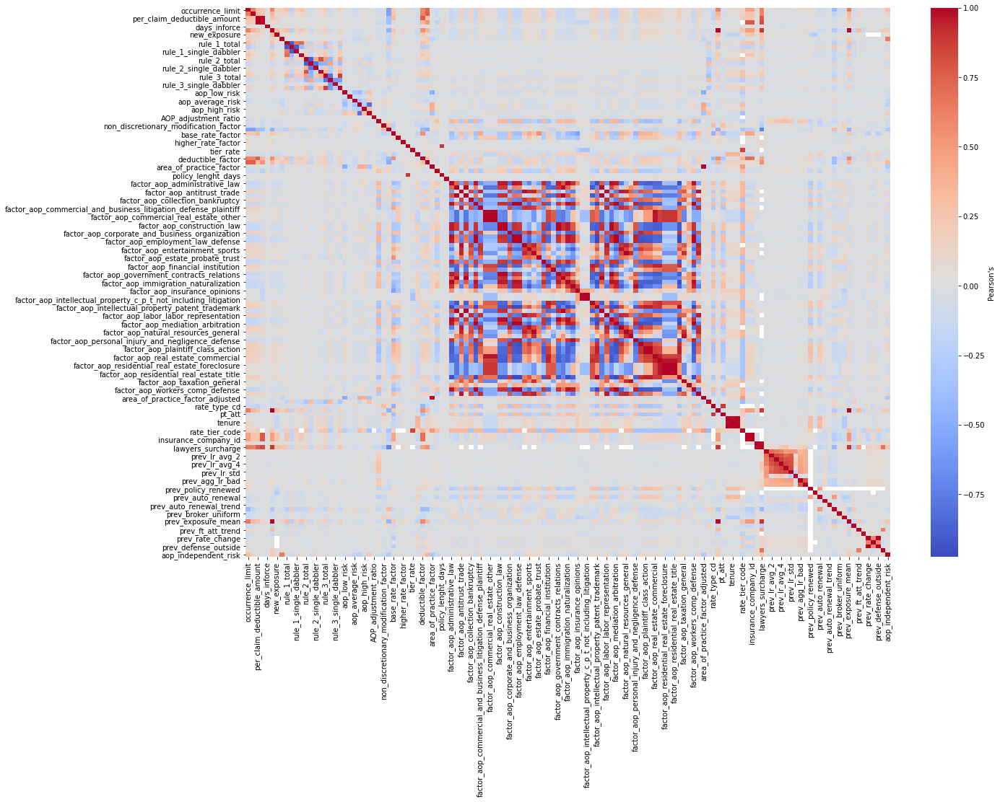

In [74]:
sns.heatmap(preprocess_df[numerical_features].corr(), cbar_kws={"label": "Pearson's"}, cmap="coolwarm")
plt.gcf()
plt.savefig("correlations.png", dpi=300, bbox_inches="tight")

### nominal

#### Exploring categorical features association (Cramer's V):

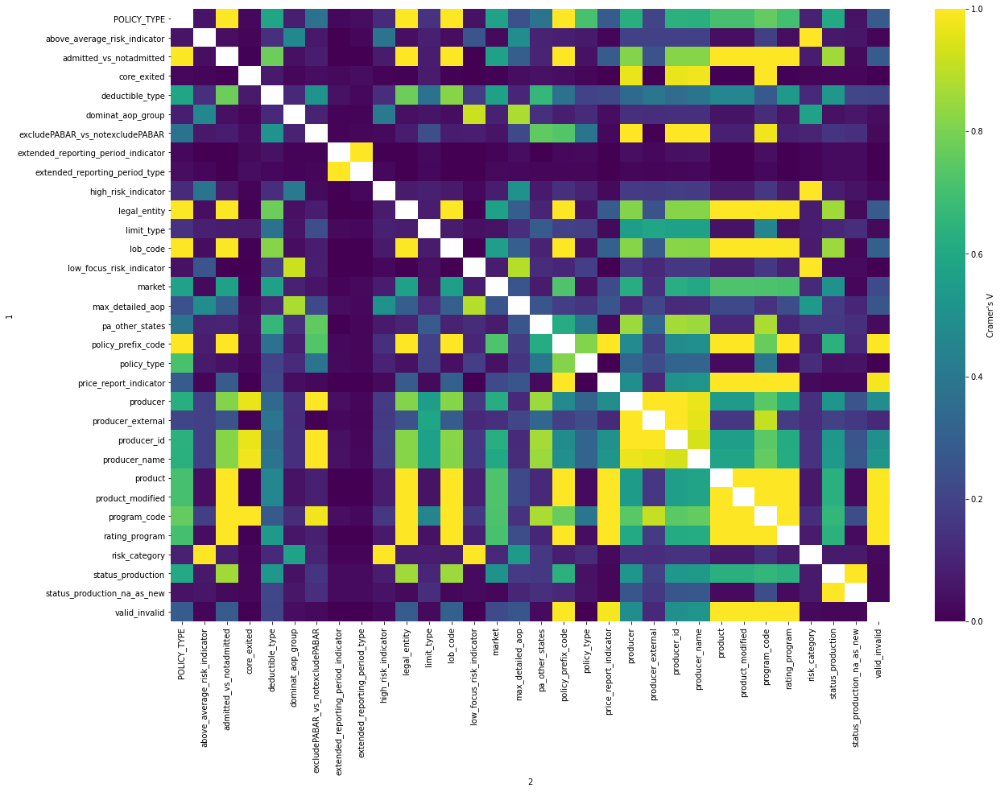

In [75]:
assoc_df = cramers_v_association(preprocess_df[nominal_features])
sns.heatmap(assoc_df, cbar_kws={"label": "Cramer's V"}, cmap="viridis")
plt.savefig("cramersV.png", dpi=300, bbox_inches="tight")

In [76]:
nominal_to_keep = remove_assoc_features(preprocess_df[nominal_features], assoc_thr=1.0).columns.tolist()

After removing associated features: 32 -> 32


Showing an example of how useful this metric is to check for varying levels of association in categorical features:

In [77]:
preprocess_df[["product", "product_modified"]].value_counts()

product               product_modified
FLOW                  FLOW                41612
Non Admitted Lawyers  NONADMIT              904
LLF                   LLF                   235
Excess Lawyers        Excess Lawyers         82
Free Trade Zone       Free Trade Zone        11
dtype: int64

In [78]:
print(numerical_to_keep)

['occurrence_limit', 'aggregate_limit', 'aggregate_deductible_amount', 'days_inforce', 'exposure', 'new_exposure', 'insurance', 'rule_1_total', 'rule_1_non_dabbler', 'rule_1_single_dabbler', 'rule_1_multiple_dabbler', 'rule_2_total', 'rule_2_non_dabbler', 'rule_2_single_dabbler', 'rule_2_multiple_dabbler', 'rule_3_total', 'rule_3_non_dabbler', 'rule_3_single_dabbler', 'rule_3_multiple_dabbler', 'aop_low_risk', 'aop_below_average_risk', 'aop_average_risk', 'aop_above_average_risk', 'aop_high_risk', 'not_greater_financial_crisis', 'AOP_adjustment_ratio', 'experience_modification_factor', 'non_discretionary_modification_factor', 'size_of_firm_factor', 'base_rate_factor', 'webinar_factor', 'higher_rate_factor', 'pro_rata_factor', 'tier_rate', 'average_step_factor', 'deductible_factor', 'increased_limits_factor', 'area_of_practice_factor', 'schedule_modification_factor', 'policy_lenght_days', 'quater', 'factor_aop_admiralty_law_general', 'factor_aop_collection_bankruptcy', 'factor_aop_comme

In [79]:
print(nominal_to_keep)

['deductible_type', 'producer_id', 'limit_type', 'status_production', 'lob_code', 'product_modified', 'admitted_vs_notadmitted', 'producer_name', 'producer_external', 'core_exited', 'legal_entity', 'extended_reporting_period_type', 'policy_type', 'risk_category', 'rating_program', 'excludePABAR_vs_notexcludePABAR', 'program_code', 'status_production_na_as_new', 'dominat_aop_group', 'valid_invalid', 'above_average_risk_indicator', 'market', 'price_report_indicator', 'low_focus_risk_indicator', 'policy_prefix_code', 'max_detailed_aop', 'extended_reporting_period_indicator', 'producer', 'high_risk_indicator', 'POLICY_TYPE', 'pa_other_states', 'product']


In [80]:
print(len(numerical_to_keep))
print(len(nominal_to_keep))

94
32


count    42844.000000
mean         0.717851
std         12.580030
min          0.000000
25%          0.000000
50%          0.001538
75%          0.015272
max       1524.773986
Name: ultimate_trended_onlevel_lr, dtype: float64

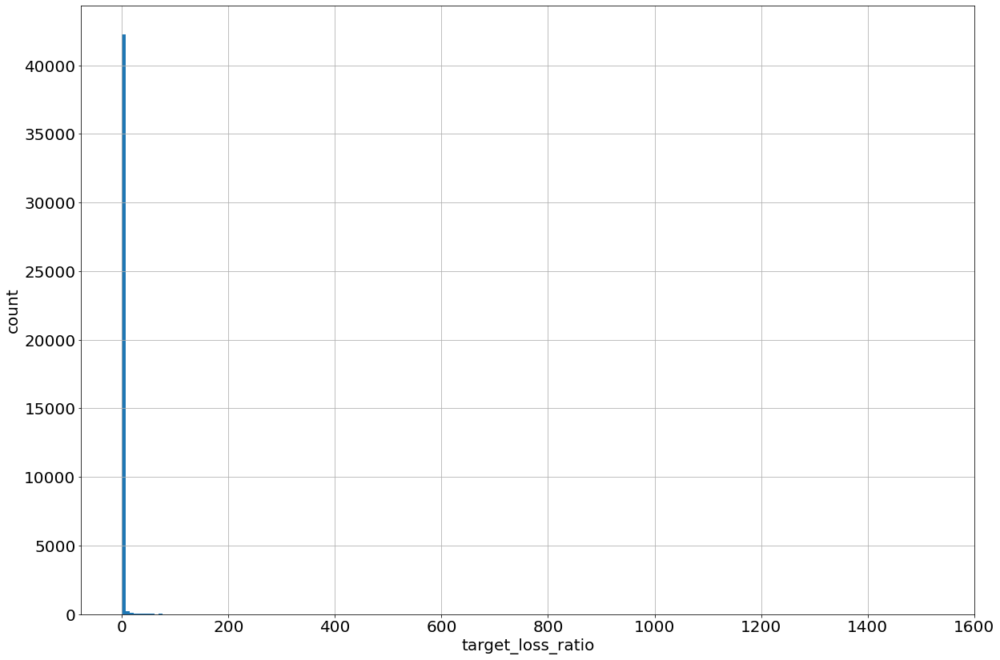

In [81]:
preprocess_df["ultimate_trended_onlevel_lr"].hist(bins=200)

#plt.yscale('log')
plt.xlabel("target_loss_ratio", fontsize=20)
plt.ylabel("count", fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.savefig("truncated_loss_ratio.png", dpi=300, bbox_inches="tight")
preprocess_df["ultimate_trended_onlevel_lr"].describe()

# Saving output for collaborative exploration:

In [82]:
keeping = numerical_to_keep.copy()
keeping.extend(nominal_to_keep)
keeping.append("ultimate_trended_onlevel_lr")
keeping.append("policy_id")
csv_save = preprocess_df[keeping]
csv_save.to_csv("regression_notrunc_5_2_2023.csv")
print(len(keeping))

128


In [83]:
preprocess_df.shape

(42844, 167)

In [84]:
merged_df["ultimate_trended_onlevel_lr"].isnull().sum()

156832

In [85]:
preprocess_df["policy_id"].nunique()

17309

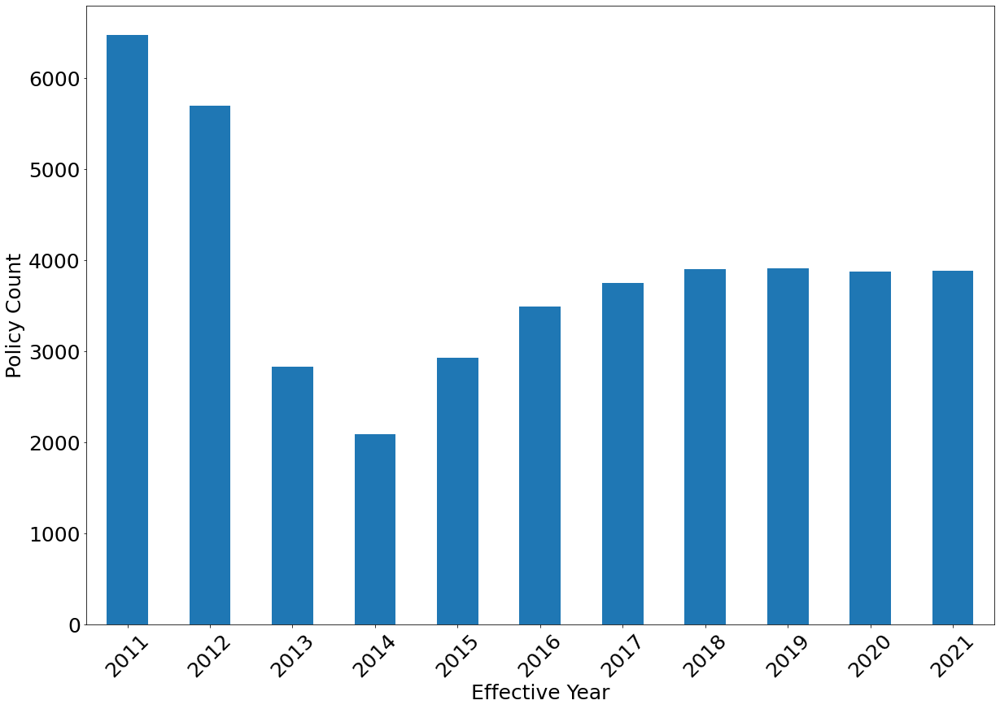

In [86]:
fontsize=25
preprocess_df_incl_lossnpremium["effective_year"].value_counts().sort_index().plot(kind='bar')
plt.ylabel("Policy Count", fontsize=fontsize),
plt.xlabel("Effective Year", fontsize=fontsize)
plt.xticks(size=fontsize, rotation=45)
plt.yticks(size=fontsize)
plt.savefig("effective_year_distributions.png", dpi=300, bbox_inches="tight")

# test/train splitting

The important consideration here, as suggested by Ajay, is to ensure that there is no leakage by splitting based on policy_id. This handles cases where renewed policies have similar LR and features (which we don't want to breach the test/train divide).

In [87]:
gss = GroupShuffleSplit(test_size=.30, n_splits=2, random_state=42)
split = gss.split(preprocess_df, groups=preprocess_df['policy_id'])
train_idx, test_idx = next(split)

verifying there are no shared policy_id between train and test:

In [88]:
unique_id_train = set(preprocess_df["policy_id"].iloc[train_idx].values.tolist())
unique_id_test = set(preprocess_df["policy_id"].iloc[test_idx].values.tolist())
print(unique_id_train.intersection(unique_id_test))

set()


In [89]:
print(train_idx[0:15])

[ 1  3  4  7  8  9 11 12 13 14 18 19 20 21 22]


In [90]:
train_df = preprocess_df.iloc[train_idx]
test_df = preprocess_df.iloc[test_idx]

print(train_df.shape)
print(test_df.shape)

(29991, 167)
(12853, 167)


## Constructing X and y

In [91]:
X_train = train_df.drop(columns=["ultimate_trended_onlevel_lr", "policy_id"])
X_test = test_df.drop(columns=["ultimate_trended_onlevel_lr", "policy_id"])

y_train = train_df["ultimate_trended_onlevel_lr"]
y_test = test_df["ultimate_trended_onlevel_lr"]

print(X_train.shape)
print(X_test.shape)

print(y_train.shape)
print(y_test.shape)

(29991, 165)
(12853, 165)
(29991,)
(12853,)


In [92]:
preprocess_df[keeping].head()

,occurrence_limit,aggregate_limit,aggregate_deductible_amount,days_inforce,exposure,new_exposure,insurance,rule_1_total,rule_1_non_dabbler,rule_1_single_dabbler,...,policy_prefix_code,max_detailed_aop,extended_reporting_period_indicator,producer,high_risk_indicator,POLICY_TYPE,pa_other_states,product,ultimate_trended_onlevel_lr,policy_id
0,5000000.0,5000000.0,NaN,365,20.0,0.0,0.0,0.0,1,0,...,FNA,intellectual_property_patent_trademark,NaN,"LEMME INSURANCE GROUP, INC.",N,STD,Other States,Non Admitted Lawyers,5.058309,FNA3370001031
1,1000000.0,1000000.0,NaN,365,2.0,0.0,0.0,0.0,1,0,...,FNA,commercial_real_estate_other,NaN,PEARL INSURANCE GROUP LLC,Y,STD,Other States,Non Admitted Lawyers,0.012788,FNA3370107925
2,5000000.0,5000000.0,NaN,365,6.0,0.0,0.0,0.0,1,0,...,FNA,corporate_and_business_organization,NaN,"GEMINI RISK PARTNERS, LLC",N,STD,Other States,Non Admitted Lawyers,0.015496,FNA3370107958
3,1000000.0,3000000.0,NaN,365,3.0,3.0,0.0,0.0,1,0,...,FNA,family_law,NaN,"R-T SPECIALTY, LLC",Y,STD,Other States,Non Admitted Lawyers,0.000614,FNA3370108020
4,1000000.0,3000000.0,NaN,366,3.0,0.0,0.0,0.0,1,0,...,FNA,family_law,NaN,"R-T SPECIALTY, LLC",Y,STD,Other States,Non Admitted Lawyers,0.001973,FNA3370108020


In [93]:
preprocess_df[["producer", "program_code"]].value_counts()

producer                        program_code
USI AFFINITY                    304001          6564
PEARL INSURANCE GROUP LLC       335001          6354
BROWN & BROWN, INC. DBA VILLAR  308001          5528
LOCKTON RISK SERVICES, INC.     325001          5284
USI AFFINITY                    305001          3292
                                                ... 
MARSH & MCLENNAN, INC.          337001             1
PAT MOORE INSURANCE SERVICES,   337001             1
PRITCHARD & JERDEN, INC.        327004             1
R-T SPECIALTY, LLC              301002             1
JOHNSON INSURANCE SERVICES, IN  327004             1
Length: 191, dtype: int64

In [94]:
pd.set_option('display.max_columns', 8)

In [95]:
example_columns = "occurrence_limit	aggregate_limit	aggregate_deductible_amount	days_inforce	exposure	new_exposure	insurance	rule_1_total	rule_1_non_dabbler	rule_1_single_dabbler"
example_columns = ["policy_id"] + example_columns.split("\t") + ["ultimate_trended_onlevel_lr"]
preprocess_df[example_columns].head()

,policy_id,occurrence_limit,aggregate_limit,aggregate_deductible_amount,...,rule_1_total,rule_1_non_dabbler,rule_1_single_dabbler,ultimate_trended_onlevel_lr
0,FNA3370001031,5000000.0,5000000.0,NaN,...,0.0,1,0,5.058309
1,FNA3370107925,1000000.0,1000000.0,NaN,...,0.0,1,0,0.012788
2,FNA3370107958,5000000.0,5000000.0,NaN,...,0.0,1,0,0.015496
3,FNA3370108020,1000000.0,3000000.0,NaN,...,0.0,1,0,0.000614
4,FNA3370108020,1000000.0,3000000.0,NaN,...,0.0,1,0,0.001973


# regression

## XGB

In [250]:
def XGB_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])
    xgb_reg = xgb.XGBRegressor(objective="reg:tweedie", n_jobs=6)
    
    start = time.time()
    
    param_grid = {
    'XGBoost__tweedie_variance_power': [1.0, 1.1, 1.2, 1.3, 1.4],
    'XGBoost__n_estimators': [10, 50, 100, 500, 1000],
    'XGBoost__max_depth': [2, 3, 4, 5],
    'XGBoost__gamma': [0.01, 0.1, 1, 10, 100],
    'XGBoost__colsample_bytree': [0.2, 0.5, 1.0],
    'XGBoost__subsample': [0.2, 0.5, 1.0],
    'XGBoost__eta': [0.01, 0.1, 0.2] 
    }
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), ("XGBoost", xgb_reg)])

    xgb_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    xgb_search.fit(X_train, y_train)
    
    results = pd.DataFrame(xgb_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return xgb_search

def XGB_experiment_transform(train_for_cv_df, X_train, y_train, func, inverse_func, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])
    xgb_reg = xgb.XGBRegressor(objective="reg:tweedie", n_jobs=6)
    
    start = time.time()
    
    param_grid = {
    'XGBoost__regressor__tweedie_variance_power': [1.0, 1.2, 1.4, 1.6, 1.8, 1.9],
    'XGBoost__regressor__n_estimators': [10, 50, 100, 500, 1000],
    'XGBoost__regressor__max_depth': [2, 3, 4, 5],
    'XGBoost__regressor__gamma': [0.01, 0.1, 1, 10, 100],
    'XGBoost__regressor__colsample_bytree': [0.2, 0.5, 1.0],
    'XGBoost__regressor__subsample': [0.2, 0.5, 1.0],
    'XGBoost__regressor__eta': [0.01, 0.1, 0.2] 
    }
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), 
                           ("XGBoost", TransformedTargetRegressor(xgb_reg, func=func, inverse_func=inverse_func))])

    xgb_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    xgb_search.fit(X_train, y_train)
    
    results = pd.DataFrame(xgb_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return xgb_search


In [86]:
def print_XGB_metrics(xgb_search_object):
    print("Best parameters:", xgb_search_object.best_params_)
    print("Best Score (-ve MSE): ", xgb_search_object.best_score_)
    print("MSE std: ", (xgb_search_object.cv_results_['std_test_score'][xgb_search_object.best_index_] ))
    print("Lowest RMSE (test): ", (-xgb_search_object.best_score_)**(1/2.0))

    # calculating std of RMSE
    fold = 3
    keys = ["split" + str(i) + "_test_score" for i in range(fold)]
    best_rmse_std = np.std(np.sqrt([-xgb_search_object.cv_results_[key][xgb_search_object.best_index_] for key in keys]))
    print("Lowest RMSE STD (test): ", best_rmse_std)
    
    # metrics on train
    print("\n")

In [81]:
def my_quantile_rmse(gt, predictions):

    quantiles = pd.qcut(predictions, 10, duplicates='drop')
    qq_df = pd.DataFrame(index = quantiles, data= {"predicted": predictions, "actual": gt.values})
    grouped = qq_df.groupby(level=0).mean().sort_index()

    rmse = mean_squared_error(grouped["actual"], grouped['predicted'], squared=False)
    return rmse

### XGBoost vanilla

Optimized XGBoost regression model with all data.

In [201]:
xgb_search = XGB_experiment(train_df, X_train, y_train, feature_subset = [], n_iterations=250, scorer='neg_root_mean_squared_error',
                          name_for_model= "XGBv3_best_estimator_newpreprocessing_notruncation.pkl", name_for_results="regression_notruncation.csv",
                          description = "XGB no truncation removed renewed, updated FE(XGBv3_best_estimator_newpreprocessing_notruncation.pkl)")

Fitting 3 folds for each of 250 candidates, totalling 750 fits


One or more of the test scores are non-finite: [-1.18734326e+01 -1.06506040e+01 -1.06509165e+01 -1.21415956e+01
 -1.06517095e+01 -1.06472155e+01             nan -1.06463730e+01
             nan -1.06443882e+01 -1.06484559e+01 -1.06453967e+01
 -4.99743580e+22 -1.15241261e+01 -1.06832599e+01 -1.06451459e+01
 -1.06707455e+01 -1.06876148e+01 -1.06716963e+01 -1.06778544e+01
 -1.06445161e+01 -1.06706430e+01 -1.06854893e+01 -1.17717935e+12
 -1.06496073e+01 -1.06450554e+01 -1.06454612e+01             nan
 -1.07498386e+01 -1.06708061e+01 -1.06603748e+01             nan
             nan -1.06556595e+01 -1.07065523e+01 -6.42868589e+18
 -1.06657210e+01 -1.06660146e+01 -1.06614537e+01 -1.07570220e+01
 -1.06687098e+01 -1.06586801e+01 -1.06650248e+01             nan
 -1.06451243e+01 -1.06497125e+01 -1.06991434e+01 -1.06442774e+01
 -1.06770866e+01 -1.06484272e+01 -1.06495277e+01 -1.06707015e+01
 -1.06555956e+01 -1.06511630e+01 -1.06537070e+01             nan
 -1.07773030e+01 -1.08445197e+01 -1.0656158

Time elapsed (in Sec): 2257.589772462845


In [411]:
# xgb_search_quantile = XGB_experiment(train_df, X_train, y_train, feature_subset = [], n_iterations=500, scorer=make_scorer(my_quantile_rmse, greater_is_better=False),
#                           name_for_model="XGBv1_best_estimator_newpreprocessing_notruncation_quantile.pkl", name_for_results="regression_notruncation_quantile.csv",
#                           description = "XGB all features no truncation (XGBv1_best_estimator_newpreprocessing_notruncation_quantile.pkl)")

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


One or more of the test scores are non-finite: [-5.44753642e-01 -4.80551557e-01 -6.45722768e-01 -5.37011515e-01
 -6.27177418e-01 -5.92233514e+17 -6.38659938e-01 -5.14848395e-01
 -3.83361172e-01 -3.57193595e-01 -6.20933892e-01 -7.18650446e-01
 -6.69891535e-01 -3.66325988e-01 -3.82759491e-01 -3.63037110e-01
 -1.04686979e+16 -5.23779053e-01 -6.35316932e-01 -3.09748803e-01
 -5.37255344e-01 -5.26458760e-01 -4.52235543e-01 -3.02080249e-01
 -5.25096171e-01 -4.84950793e-01 -4.32628212e-01 -5.94018954e-01
 -4.95023260e-01 -4.93595676e-01             nan -3.12157063e-01
 -5.31042688e-01 -5.92371035e-01 -6.08281729e-01 -4.92910930e-01
             nan -3.78052318e-01 -3.78926952e-01 -6.24310069e-01
 -4.06024804e-01 -6.00906279e-01 -3.58461359e-01 -5.60041549e-01
 -5.27166543e-01 -4.25599762e-01 -6.92046815e-01 -7.11407233e-01
 -6.95987529e-01 -4.00441107e-01 -9.38953152e+17 -5.63703080e-01
             nan -2.97586090e+12 -4.40053408e-01 -3.69330013e-01
 -4.04458315e-01 -3.69320872e-01 -4.1468211

Time elapsed (in Sec): 5407.017646551132


### XGBoost transforms

#### sqrt transform

In [ ]:
xgb_search_sqrt = XGB_experiment_transform(train_df, X_train, y_train, func=np.sqrt, inverse_func=np.square, feature_subset = [], n_iterations=250,
                          scorer='neg_root_mean_squared_error', name_for_model="XGBv1_best_estimator_notruncation_sqrt_transform.pkl", name_for_results="regression_notruncation.csv",
                          description="XGB with sqrt transform removed renewed (XGBv1_best_estimator_notruncation_sqrt_transform.pkl)")

In [413]:
# xgb_search_sqrt_quantile = XGB_experiment_transform(train_df, X_train, y_train, func=np.sqrt, inverse_func=np.square, feature_subset = [], n_iterations=500,
#                           scorer=make_scorer(my_quantile_rmse, greater_is_better=False), name_for_model="XGBv1_best_estimator_notruncation_sqrt_transform_quantile.pkl", name_for_results="regression_notruncation_quantile.csv",
#                           description="XGB all with sqrt transform (XGBv1_best_estimator_notruncation_sqrt_transform_quantile.pkl)")

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


One or more of the test scores are non-finite: [-7.28468961e-01 -7.21436909e-01 -6.26095313e-01 -7.50237487e-01
 -6.66935974e-01 -6.32649722e-01 -7.14483652e-01 -6.70525035e-01
 -5.62479448e-01 -7.22721384e-01 -5.77179248e-01 -7.13630959e-01
 -7.12227730e-01 -7.02635605e-01 -1.17432522e+00 -6.66206562e-01
 -7.16454281e-01 -7.45242521e-01 -8.10269359e-01 -5.45323804e-01
 -7.16002556e-01 -3.36070191e+06 -6.97663717e-01 -7.17680121e-01
 -7.00881153e-01 -7.12357530e-01 -7.02354564e-01 -6.54646504e-01
 -1.97229512e+00 -7.35877802e-01 -6.40311156e-01 -6.79877704e-01
 -7.05003319e-01 -7.38047554e-01 -7.43334000e-01 -9.90236724e-01
 -7.23103762e-01 -7.21476735e-01 -6.79839552e-01 -7.28741749e-01
 -7.23058696e-01 -6.81425254e-01 -6.19627823e-01 -6.49820005e-01
 -5.57853936e-01 -6.85054732e-01 -7.46399244e-01 -7.23337132e-01
 -2.30820683e+00 -7.67668428e-01 -3.25088030e+01 -7.15117401e-01
 -4.75171528e-01 -2.96574749e+00 -6.70417568e-01 -7.72420569e-01
 -1.22398837e+02 -7.26149334e-01 -7.3051754

Time elapsed (in Sec): 5451.13218331337


#### log transform

In [501]:
def log_func(y):
    return np.log(y + 1)

def log_inverse_func(y):
    return np.exp(y) - 1

In [ ]:
xgb_search_log = XGB_experiment_transform(train_df, X_train, y_train, func=log_func, inverse_func=log_inverse_func, feature_subset = [], n_iterations=250, 
                          scorer='neg_root_mean_squared_error', name_for_model="XGBv1_best_estimator_notruncation_log_transform.pkl", name_for_results="regression_notruncation.csv",
                          description = "XGB with log transform removed renewed (XGBv1_best_estimator_notruncation_log_transform.pkl)")

In [416]:
# xgb_search_log_quantile = XGB_experiment_transform(train_df, X_train, y_train, func=log_func, inverse_func=log_inverse_func, feature_subset = [], n_iterations=500, 
#                           scorer=make_scorer(my_quantile_rmse, greater_is_better=False), name_for_model="XGBv1_best_estimator_notruncation_log_transform_quantile.pkl", name_for_results="regression_notruncation_quantile.csv",
#                           description = "XGB all with log transform (XGBv1_best_estimator_notruncation_log_transform_quantile.pkl)")

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


One or more of the test scores are non-finite: [-6.81661723e-01 -7.19690450e-01 -6.77878526e-01 -7.24978105e+29
 -1.48368372e+09 -6.52918368e-01 -6.74663787e-01 -6.99215817e-01
 -7.82062355e+03             nan -7.27084810e-01 -6.74991701e-01
 -6.31267616e-01 -6.76891206e-01 -7.07784863e-01 -6.44272270e-01
 -7.01545798e-01 -6.91824671e-01 -7.00497326e-01 -2.67740083e+03
 -6.71084455e-01 -6.81779874e-01 -7.19040226e-01 -6.91447884e-01
 -6.91066238e-01 -6.92180403e-01 -5.57357483e-01 -6.90691351e-01
 -5.64229591e-01 -5.84710711e-01 -6.89727369e-01 -6.79680101e-01
 -6.92046464e-01 -6.96394340e-01             nan -6.00181766e-01
 -6.88126885e-01 -2.36387723e-01 -6.88800492e-01 -7.13992868e-01
 -5.30768772e-01 -7.32189698e-01 -7.12963324e-01 -4.30661757e+17
 -6.89496260e-01 -7.09361253e-01 -7.05116910e-01 -7.00072432e-01
 -6.81165174e-01 -9.95190571e-01 -4.14641936e+03 -3.61127094e-01
 -6.66911572e-01 -4.16960447e-01 -6.75504926e-01             nan
 -3.75804376e-01 -6.78364949e-01 -6.4371766

Time elapsed (in Sec): 5654.861536026001


#### capping

In [500]:
def capping_func(y):
    capped_return = y.copy()
    capped_return[capped_return > 15] = 15
    return capped_return

def inverse_capping_func(y):
    return y

In [ ]:
xgb_search_capping = XGB_experiment_transform(train_df, X_train, y_train, func=capping_func, inverse_func=inverse_capping_func, feature_subset = [], n_iterations=250, 
                          scorer='neg_root_mean_squared_error', name_for_model="XGBv1_best_estimator_notruncation_capping_transform.pkl", name_for_results="regression_notruncation.csv",
                          description = "XGB with capping transform removed renewed(XGBv1_best_estimator_notruncation_capping_transform.pkl)")

In [420]:
# xgb_search_capping_quantile = XGB_experiment_transform(train_df, X_train, y_train, func=capping_func, inverse_func=inverse_capping_func, feature_subset = [], n_iterations=500, 
#                           scorer=make_scorer(my_quantile_rmse, greater_is_better=False), name_for_model="XGBv1_best_estimator_notruncation_capping_transform_quantile.pkl", name_for_results="regression_notruncation_quantile.csv",
#                           description = "XGB all with capping transform (XGBv1_best_estimator_notruncation_capping_transform_quantile.pkl)")

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


One or more of the test scores are non-finite: [-5.99557335e-01 -6.66423098e-01 -5.77117930e-01 -4.86622794e-01
 -5.89256965e-01 -6.64605720e-01 -7.27720005e-01 -5.56315845e-01
 -3.84583557e-01 -5.73804055e-01 -6.07073923e-01 -6.50201972e-01
 -5.71320635e-01 -6.48552696e-01 -5.31050111e-01 -7.32195583e-01
 -5.53501384e-01 -6.25996279e-01 -4.59988728e-01 -6.35535772e-01
 -5.75535497e-01 -5.24791226e-01 -6.73966538e-01 -5.76893303e-01
 -6.67365363e-01 -6.30849072e-01 -5.74275885e-01 -5.38260265e-01
 -4.80506131e+07 -4.93241781e-01 -6.13894039e-01 -5.69141819e-01
 -5.26583139e-01 -5.60414767e-01 -7.12797972e-01 -5.33711845e-01
 -5.62152573e-01 -6.84318542e-01 -6.15630687e-01 -5.25527127e+13
 -6.31854095e-01 -5.87480564e-01 -5.70927206e-01 -5.97523632e-01
 -5.66231107e-01 -5.97091372e-01 -6.42010938e-01 -6.00331460e-01
 -5.06100784e-01 -4.31479014e-01 -6.98564896e-01 -6.55243160e-01
 -4.72005670e-01 -6.06705124e-01 -6.04283222e-01 -5.14315843e-01
 -5.97273876e-01 -4.55322261e-01 -6.0142660

Time elapsed (in Sec): 5646.3933963775635


### Quantile plots

In [228]:
def quantile_actual_predicted_line(model_filename, savename, X, y, CV=False, df_for_splitting=None, fontsize=25):
    
    with open(model_filename, 'rb') as file:
        # Call load method to deserialze
        reg_model = joblib.load(file)
        
    if CV and df_for_splitting.shape[0] > 0:
        gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
        zero_nonzero_indicator = y.apply(lambda row: 1 if row > 0 else 0)
        splitter_cv = gkf_cv.split(df_for_splitting, zero_nonzero_indicator, groups=df_for_splitting['policy_id'])
        y_pred = cross_val_predict(reg_model, X, y, cv = splitter_cv)
        
    else:
        y_pred = reg_model.predict(X)
        
    print(y_pred)
    quantiles = pd.qcut(y_pred, 10, duplicates='drop')
    print(quantiles)
    qq_df = pd.DataFrame(index = quantiles, data= {"predicted": y_pred, "actual": y.values})
    grouped = qq_df.groupby(level=0).mean().sort_index()
    print(max(y_pred))
    print([str(ele) for ele in grouped.index])
    plt.plot([str(ele) for ele in grouped.index.values], grouped["predicted"], label='predicted', lw=5)
    plt.plot([str(ele) for ele in grouped.index.values], grouped["actual"], label='actual', lw=5)
    #plt.scatter(grouped["predicted"], grouped["actual"], s=40)
    #plt.plot(np.arange(0, max(grouped["actual"]), 0.1), np.arange(0, max(grouped["actual"]), 0.1), ls='--', c='k')
    plt.ylabel("Mean LR in decile", fontsize= fontsize)
    plt.xlabel("Deciles from predictions", fontsize = fontsize)
    #plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
    plt.legend(fontsize=fontsize)
    plt.yticks(size= fontsize)
    plt.xticks(size = fontsize, rotation=45)
    plt.savefig(savename, dpi=300, bbox_inches='tight')

#### best XGB, optimized on rmse

train_data:

[0.52989805 0.52989805 0.52989805 ... 0.5556469  0.7556586  0.7971483 ]
[(0.526, 0.53], (0.526, 0.53], (0.526, 0.53], (0.53, 0.556], (0.556, 0.581], ..., (0.581, 0.65], (0.581, 0.65], (0.53, 0.556], (0.723, 8.461], (0.723, 8.461]]
Length: 29991
Categories (7, interval[float64, right]): [(0.432, 0.526] < (0.526, 0.53] < (0.53, 0.556] < (0.556, 0.581] < (0.581, 0.65] < (0.65, 0.723] < (0.723, 8.461]]
8.460768
['(0.432, 0.526]', '(0.526, 0.53]', '(0.53, 0.556]', '(0.556, 0.581]', '(0.581, 0.65]', '(0.65, 0.723]', '(0.723, 8.461]']


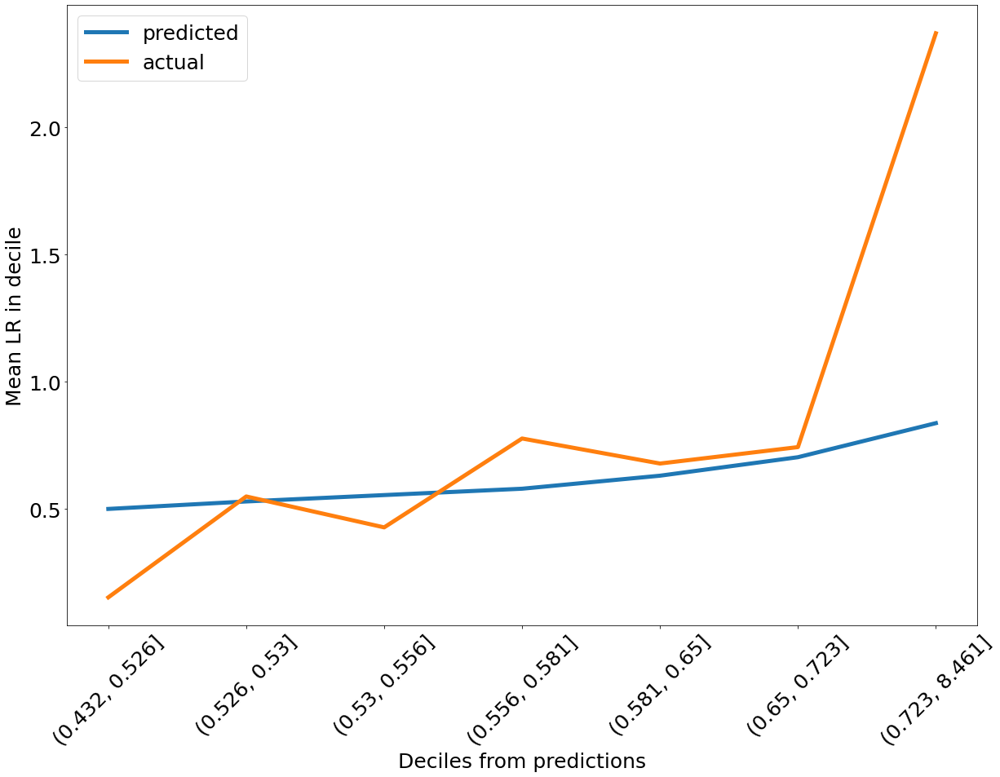

In [477]:
# X_total = pd.concat([X_train, X_test], ignore_index=True)
# y_total = pd.concat([y_train, y_test], ignore_index=True)

quantile_actual_predicted_line("XGBv1_best_estimator_newpreprocessing_notruncation.pkl", "XGB_rmse_optimized_train.png", X_train, y_train)

CV results:

[0.51842105 0.6168469  0.54776573 ... 0.6489318  0.72364753 0.54693514]
[(0.508, 0.522], (0.61, 0.646], (0.543, 0.553], (0.491, 0.508], (0.583, 0.61], ..., (0.725, 4.117], (0.491, 0.508], (0.646, 0.725], (0.646, 0.725], (0.543, 0.553]]
Length: 29991
Categories (10, interval[float64, right]): [(0.402, 0.491] < (0.491, 0.508] < (0.508, 0.522] < (0.522, 0.543] ... (0.583, 0.61] < (0.61, 0.646] < (0.646, 0.725] < (0.725, 4.117]]
4.116654
['(0.402, 0.491]', '(0.491, 0.508]', '(0.508, 0.522]', '(0.522, 0.543]', '(0.543, 0.553]', '(0.553, 0.583]', '(0.583, 0.61]', '(0.61, 0.646]', '(0.646, 0.725]', '(0.725, 4.117]']


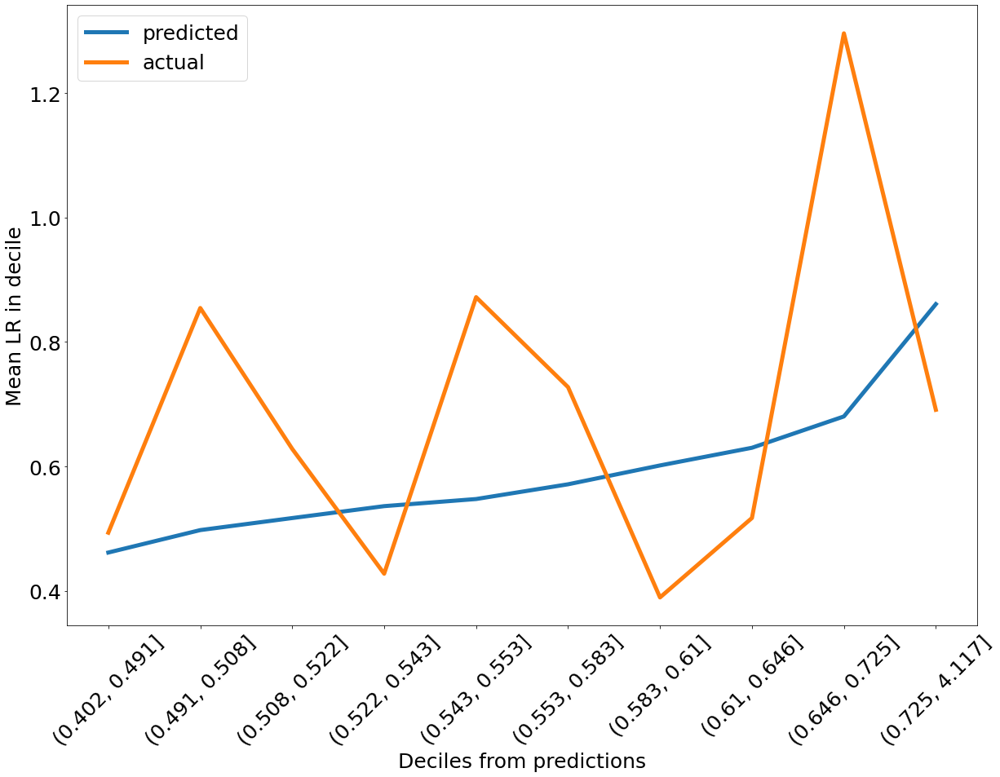

In [478]:
quantile_actual_predicted_line("XGBv1_best_estimator_newpreprocessing_notruncation.pkl", "XGB_rmse_optimized_CV.png", X_train, y_train, CV=True, df_for_splitting=train_df)

test data:

[0.7206412  0.7556586  0.52989805 ... 0.7497963  0.52989805 0.649716  ]
[(0.65, 0.723], (0.723, 2.587], (0.517, 0.53], (0.517, 0.53], (0.556, 0.581], ..., (0.53, 0.556], (0.517, 0.53], (0.723, 2.587], (0.517, 0.53], (0.581, 0.65]]
Length: 12853
Categories (7, interval[float64, right]): [(0.432, 0.517] < (0.517, 0.53] < (0.53, 0.556] < (0.556, 0.581] < (0.581, 0.65] < (0.65, 0.723] < (0.723, 2.587]]
2.5874465
['(0.432, 0.517]', '(0.517, 0.53]', '(0.53, 0.556]', '(0.556, 0.581]', '(0.581, 0.65]', '(0.65, 0.723]', '(0.723, 2.587]']


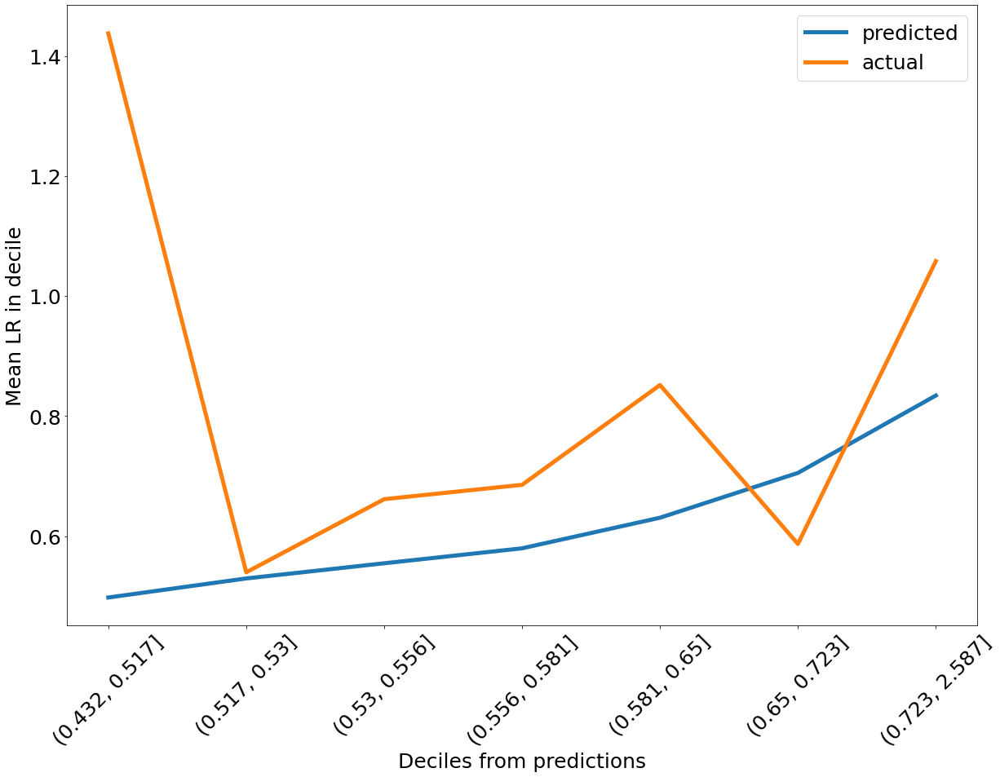

In [479]:
quantile_actual_predicted_line("XGBv1_best_estimator_newpreprocessing_notruncation.pkl", "XGB_rmse_optimized_test.png", X_test, y_test)

### Feature importance

#### Permutation importance (best model optimized on rmse)

In [481]:
# This is the best performing model 
with open("XGBv1_best_estimator_newpreprocessing_notruncation.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_reg_model = joblib.load(file)

feature_names = best_reg_model.named_steps["encoding"].transformers_[0][2]  + best_reg_model.named_steps["encoding"].transformers_[1][2]

perm = permutation_importance(best_reg_model, X_test.loc[:, feature_names], y_test, n_repeats = 50, scoring="neg_mean_squared_error", n_jobs=-1)

In [482]:
top_x = 15
perm_idx_sorted = perm.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

['extended_reporting_period_indicator', 'prev_auto_renewal_std', 'max_detailed_aop_name', 'factor_aop_pension_employee_benefits', 'risk_category', 'extended_reporting_period_type', 'area_of_practice_factor', 'prev_rate_change_trend', 'prev_pt_att_trend', 'schedule_modification_factor', 'policy_lenght_days', 'higher_rate_factor', 'pro_rata_factor', 'tier_rate', 'average_step_factor']
['extended_reporting_period_indicator', 'prev_auto_renewal_std', 'max_detailed_aop_name', 'factor_aop_pension_employee_benefits', 'risk_category', 'extended_reporting_period_type', 'area_of_practice_factor', 'prev_rate_change_trend', 'prev_pt_att_trend', 'schedule_modification_factor']
10


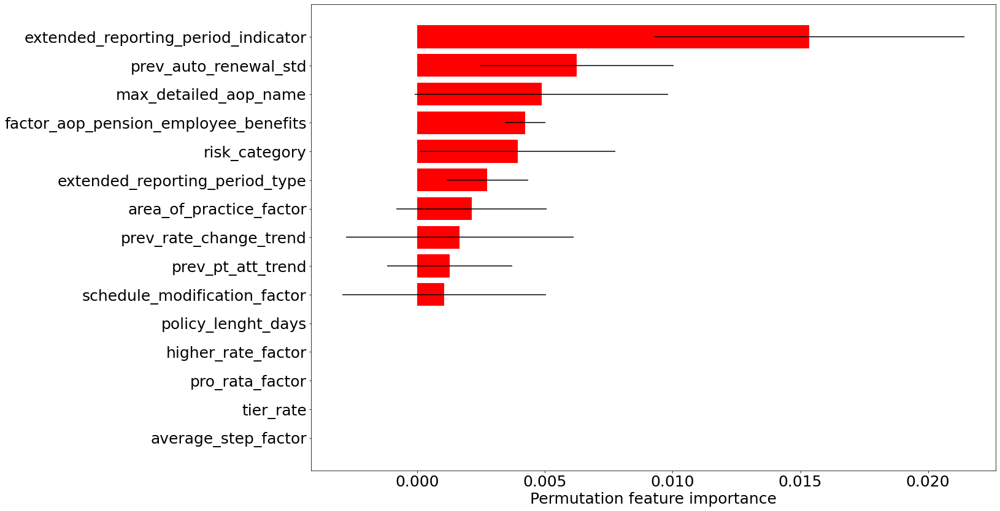

In [483]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_XGB_optimizedrmse.png", dpi=300, bbox_inches='tight')
plt.show()

In [97]:
df["program_code"].sample(10)

29006    308001
16759    304001
34068    305001
20317    308001
13764    335001
21759    325001
18029    300001
24086    336001
9206     300001
36785    304001
Name: program_code, dtype: object

#### Feature importance (gain)

In [416]:
gain_importances = xgb_search.best_estimator_.named_steps["XGBoost"].feature_importances_
feature_names_encoded = xgb_search.best_estimator_.named_steps["encoding"].get_feature_names_out()

['nominal__status_retention_na_as_new_EXPIRED', 'nominal__zip_code_20036', 'nominal__extended_reporting_period_type_04', 'numerical__pt_att', 'nominal__policy_type_STD', 'numerical__price_impact_experience_modifier', 'nominal__low_focus_risk_indicator_Y', 'nominal__lob_code_nan', 'numerical__not_auto_renewal_count', 'numerical__insurance_company_id', 'numerical__pro_rata_factor', 'nominal__producer_name_MERCER CONSUMER, A SERVICE OF MERCER HEALTH &', 'nominal__state_code_IA', 'nominal__status_retention_EXPIRED', 'nominal__producer_CAPITAL PROFESSIONAL          ']


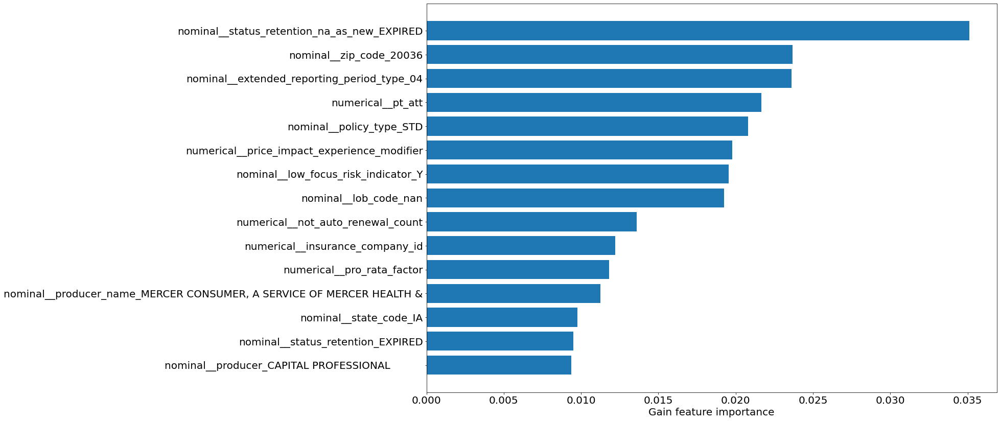

In [383]:
sorted_idx = gain_importances.argsort()[::-1]
top_x = 15
size = 20
plt.barh(np.asarray(feature_names_encoded)[sorted_idx][0:top_x][::-1], np.asarray(gain_importances)[sorted_idx][0:top_x][::-1])
plt.xlabel("Gain feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)

gain_top_x = list(np.asarray(feature_names_encoded)[sorted_idx][0:top_x])
print(gain_top_x)

#### SHAP importance (all features)

In [1761]:
# This is the best performing model 
with open("XGBv7_best_estimator.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_reg_model = joblib.load(file)


X_shap = Pipeline(best_reg_model.steps[:-1]).transform(X_train)
pred = best_reg_model.named_steps["XGBoost"].predict(X_shap, output_margin=True)
explainer = shap.TreeExplainer(best_reg_model.named_steps["XGBoost"])
shap_values = explainer.shap_values(X_shap)
np.abs(shap_values.sum(1) + explainer.expected_value - pred).max()

# X_shap = Pipeline(xgb_search.best_estimator_.steps[:-1]).transform(X_train)
# pred = xgb_search.best_estimator_.named_steps["XGBoost"].predict(X_shap, output_margin=True)
# explainer = shap.TreeExplainer(xgb_search.best_estimator_.named_steps["XGBoost"])
# shap_values = explainer.shap_values(X_shap)
# np.abs(shap_values.sum(1) + explainer.expected_value - pred).max()

4.403293e-06

(29808, 419)
169


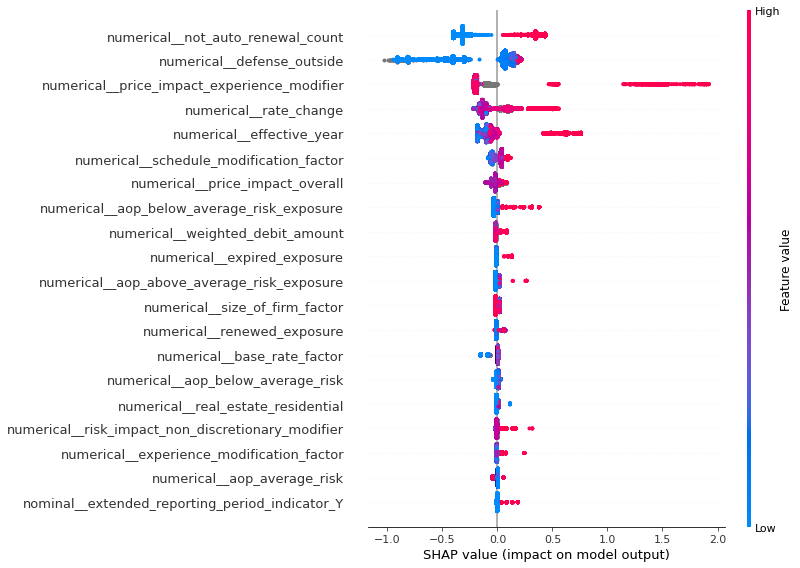

In [1762]:
print(shap_values.shape)
print(len(feature_names))
feature_names_encoded = best_reg_model.named_steps["encoding"].get_feature_names_out()
output = shap.summary_plot(shap_values, X_shap, feature_names=feature_names_encoded, show=False)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "SHAP_importance_allfeatures.png", dpi=300, bbox_inches='tight')

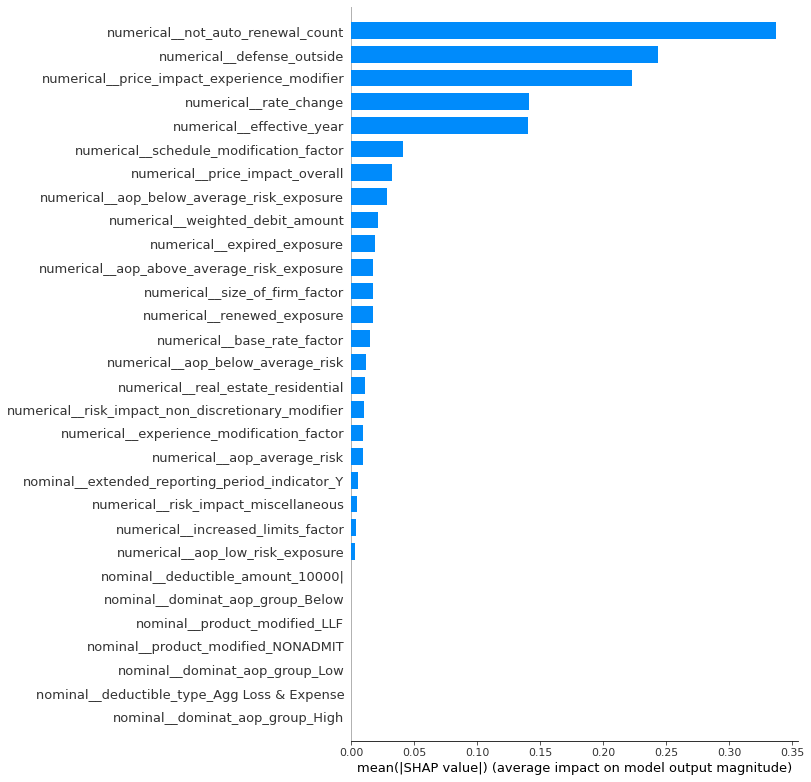

In [1723]:
shap.summary_plot(shap_values, max_display=30, plot_type='bar', feature_names = feature_names_encoded)

In [387]:
shap_val_df = pd.DataFrame(shap_values, columns = feature_names_encoded)
shap_top_x = list(shap_val_df.abs().mean(axis=0).sort_values(ascending=False).index[:top_x])
print(shap_top_x)

['numerical__effective_year', 'numerical__defense_outside', 'numerical__not_auto_renewal_count', 'numerical__price_impact_experience_modifier', 'numerical__expiration_year_month', 'numerical__rate_change', 'numerical__weighted_debit_amount', 'numerical__schedule_modification_factor', 'numerical__price_impact_overall', 'numerical__risk_impact_miscellaneous', 'numerical__risk_impact_overall', 'numerical__price_impact_miscellaneous', 'numerical__aop_above_average_risk', 'numerical__aop_average_risk', 'numerical__deductible_factor']


## Tweedie GLM

In [151]:
# Custom Transformers (pipeline.fit calls fit then transform sequentially, predict just does transform (focus here))
class PandasCastTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns
    def fit(self, X, y = None):
        return self
    def transform(self, X):
        X = pd.DataFrame(X, columns = self.columns)
        return X
    
def tweedie_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])
    
    tweedie_reg = TweedieRegressor()
    
    param_grid = {
        'tweedie__power': np.arange(1.0, 1.9, 0.1),
        'tweedie__alpha': [0.001, 0.01, 0.1, 1.0, 10.0],
        'tweedie__link': ['auto'], #, 'log', 'identity'],
        'tweedie__max_iter': [10, 100, 200, 300, 500, 800, 1000], 
        'fill_na__numerical__imputer__strategy': ["mean", "median"]
    }

    start = time.time()
    
    # imputation/encoding of features
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)
    
    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    pipe = Pipeline(steps=[("fill_na", fillna_transform), ("pandascast", PandasCastTransformer(columns = columns_after_fill)), ("encoding", encode_transform),  ("tweedie", tweedie_reg)])

    tweedie_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring='neg_root_mean_squared_error', 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    tweedie_search.fit(X_train, y_train)
    
    results = pd.DataFrame(tweedie_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(tweedie_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return tweedie_search

def tweedie_experiment_transform(train_for_cv_df, X_train, y_train, func, inverse_func, feature_subset, n_iterations, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])
    
    tweedie_reg = TweedieRegressor()
    
    param_grid = {
        'tweedie__regressor__power': np.arange(0, 4, 0.1),
        'tweedie__regressor__alpha': [0.001, 0.01, 0.1, 1.0, 10.0],
        'tweedie__regressor__link': ['auto', 'log', 'identity'],
        'tweedie__regressor__max_iter': [10, 100, 200, 300, 500, 800, 1000], 
        'fill_na__numerical__imputer__strategy': ["mean", "median"]
    }

    start = time.time()
    
    # imputation/encoding of features
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)
    
    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    pipe = Pipeline(steps=[("fill_na", fillna_transform), ("pandascast", PandasCastTransformer(columns = columns_after_fill)), 
                           ("encoding", encode_transform),  ("tweedie", TransformedTargetRegressor(tweedie_reg, func=func, inverse_func=inverse_func))])

    tweedie_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring='neg_root_mean_squared_error', 
                              cv=splitter_cv, n_jobs=8, return_train_score=True, n_iter=n_iterations, verbose=1)

    tweedie_search.fit(X_train, y_train)
    
    results = pd.DataFrame(tweedie_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(tweedie_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return tweedie_search

### Tweedie vanilla

In [96]:
tweedie_srch = tweedie_experiment(train_df, X_train, y_train, feature_subset = [], n_iterations=100, 
                          name_for_model="tweediev2_best_estimator.pkl", name_for_results="regression_notruncation.csv",
                          description = "tweedie, updated FE (tweediev2_best_estimator.pkl)")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Time elapsed (in Sec): 53.58581018447876


### Tweedie transforms

#### sqrt transform

#### log transform

#### capped transform

### quantile plots

train:

[0.65471254 0.63552328 0.6328965  ... 0.71541034 0.72241605 0.72786026]
[(0.637, 0.655], (0.506, 0.637], (0.506, 0.637], (0.506, 0.637], (0.736, 3.518], ..., (0.719, 0.736], (0.707, 0.719], (0.707, 0.719], (0.719, 0.736], (0.719, 0.736]]
Length: 29991
Categories (10, interval[float64, right]): [(0.506, 0.637] < (0.637, 0.655] < (0.655, 0.667] < (0.667, 0.677] ... (0.696, 0.707] < (0.707, 0.719] < (0.719, 0.736] < (0.736, 3.518]]
3.5176280332342365
['(0.506, 0.637]', '(0.637, 0.655]', '(0.655, 0.667]', '(0.667, 0.677]', '(0.677, 0.686]', '(0.686, 0.696]', '(0.696, 0.707]', '(0.707, 0.719]', '(0.719, 0.736]', '(0.736, 3.518]']


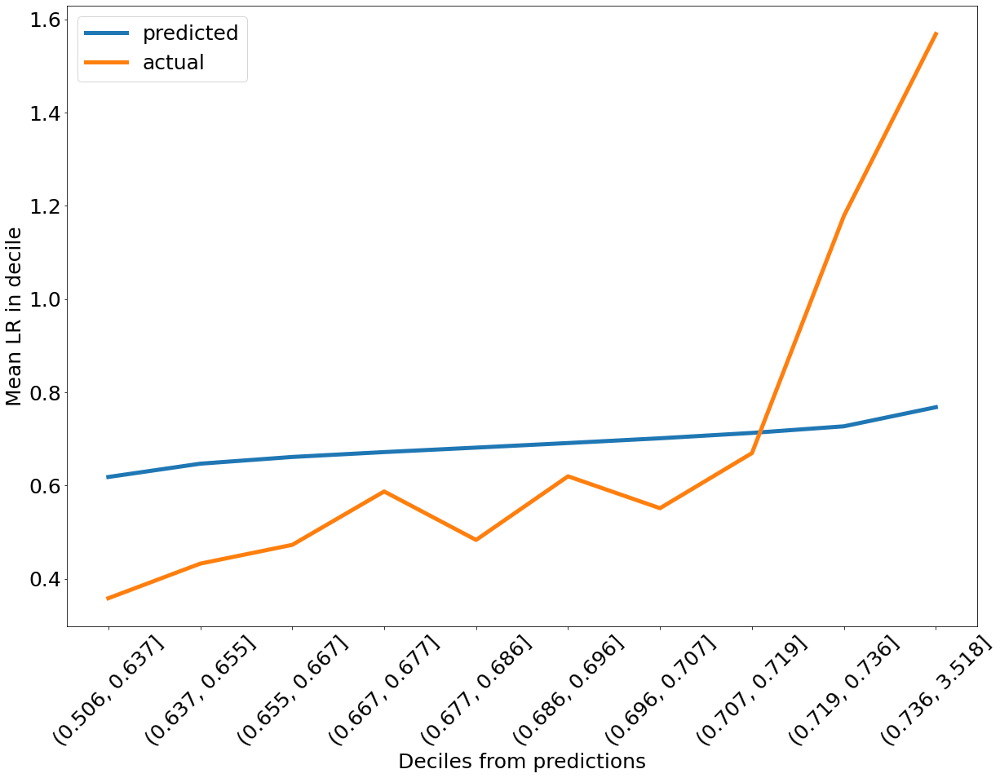

In [486]:
quantile_actual_predicted_line("tweediev1_best_estimator.pkl", "tweedie_optimized_rmse_train.png", X_train, y_train)

CV:

[0.70880372 0.6584601  0.64585156 ... 0.82471046 0.73598332 0.71471734]
[(0.701, 0.721], (0.643, 0.664], (0.643, 0.664], (0.326, 0.589], (0.776, 3.07], ..., (0.721, 0.745], (0.589, 0.616], (0.776, 3.07], (0.721, 0.745], (0.701, 0.721]]
Length: 29991
Categories (10, interval[float64, right]): [(0.326, 0.589] < (0.589, 0.616] < (0.616, 0.643] < (0.643, 0.664] ... (0.701, 0.721] < (0.721, 0.745] < (0.745, 0.776] < (0.776, 3.07]]
3.070018730834799
['(0.326, 0.589]', '(0.589, 0.616]', '(0.616, 0.643]', '(0.643, 0.664]', '(0.664, 0.682]', '(0.682, 0.701]', '(0.701, 0.721]', '(0.721, 0.745]', '(0.745, 0.776]', '(0.776, 3.07]']


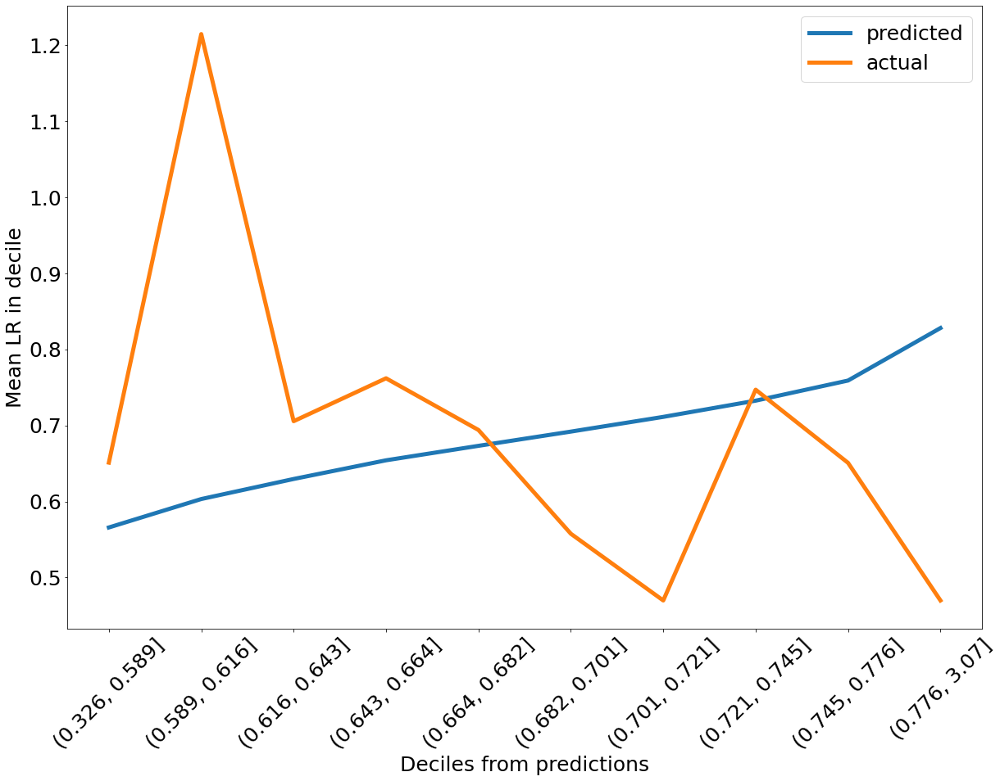

In [487]:
quantile_actual_predicted_line("tweediev1_best_estimator.pkl", "tweedie_optimized_rmse_CV.png", X_train, y_train, CV=True, df_for_splitting=train_df)

test:

[0.64695334 0.76423598 0.63582555 ... 0.7107946  0.66874609 0.75436242]
[(0.639, 0.655], (0.736, 1.984], (0.508, 0.639], (0.508, 0.639], (0.655, 0.667], ..., (0.639, 0.655], (0.639, 0.655], (0.707, 0.719], (0.667, 0.677], (0.736, 1.984]]
Length: 12853
Categories (10, interval[float64, right]): [(0.508, 0.639] < (0.639, 0.655] < (0.655, 0.667] < (0.667, 0.677] ... (0.696, 0.707] < (0.707, 0.719] < (0.719, 0.736] < (0.736, 1.984]]
1.9838932435994012
['(0.508, 0.639]', '(0.639, 0.655]', '(0.655, 0.667]', '(0.667, 0.677]', '(0.677, 0.686]', '(0.686, 0.696]', '(0.696, 0.707]', '(0.707, 0.719]', '(0.719, 0.736]', '(0.736, 1.984]']


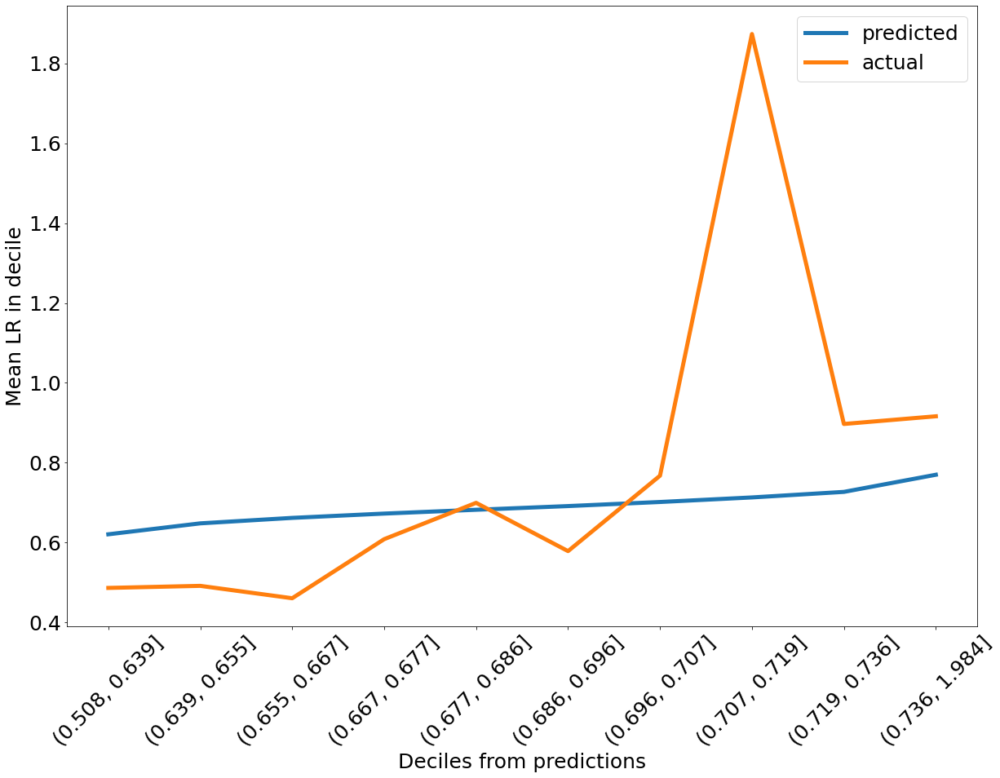

In [488]:
quantile_actual_predicted_line("tweediev1_best_estimator.pkl", "tweedie_optimized_rmse_test.png", X_test, y_test)

### Feature importance

#### Permutation importance (best model optimized on rmse)

In [489]:
# This is the best performing model 
with open("tweediev1_best_estimator.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_reg_model = joblib.load(file)

feature_names = best_reg_model.named_steps["encoding"].transformers_[0][2]  + best_reg_model.named_steps["encoding"].transformers_[1][2]

perm = permutation_importance(best_reg_model, X_test.loc[:, feature_names], y_test, n_repeats = 50, scoring="neg_mean_squared_error", n_jobs=-1)

In [490]:
top_x = 15
perm_idx_sorted = perm.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

['max_detailed_aop_pct', 'pt_att', 'rate_type_cd', 'aop_low_risk', 'prev_lr_bad_proportion', 'deductible_factor', 'prev_agg_lr_bad', 'policy_prefix_code', 'deductible_type', 'excludePABAR_vs_notexcludePABAR', 'prev_lr_avg_1', 'max_detailed_aop_name', 'prev_auto_renewal_mean', 'max_detailed_aop', 'low_focus_risk_indicator']
['max_detailed_aop_pct', 'pt_att', 'rate_type_cd', 'aop_low_risk', 'prev_lr_bad_proportion', 'deductible_factor', 'prev_agg_lr_bad', 'policy_prefix_code', 'deductible_type', 'excludePABAR_vs_notexcludePABAR', 'prev_lr_avg_1', 'max_detailed_aop_name', 'prev_auto_renewal_mean', 'max_detailed_aop', 'low_focus_risk_indicator', 'factor_aop_collection_bankruptcy', 'dominat_aop_group', 'quater', 'POLICY_TYPE', 'pa_other_states', 'policy_type', 'edition', 'producer_id', 'factor_aop_intellectual_property_c_p_t_not_including_litigation', 'producer', 'factor_aop_personal_injury_and_negligence_defense', 'limit_type', 'factor_aop_taxation_other', 'producer_name', 'high_risk_indic

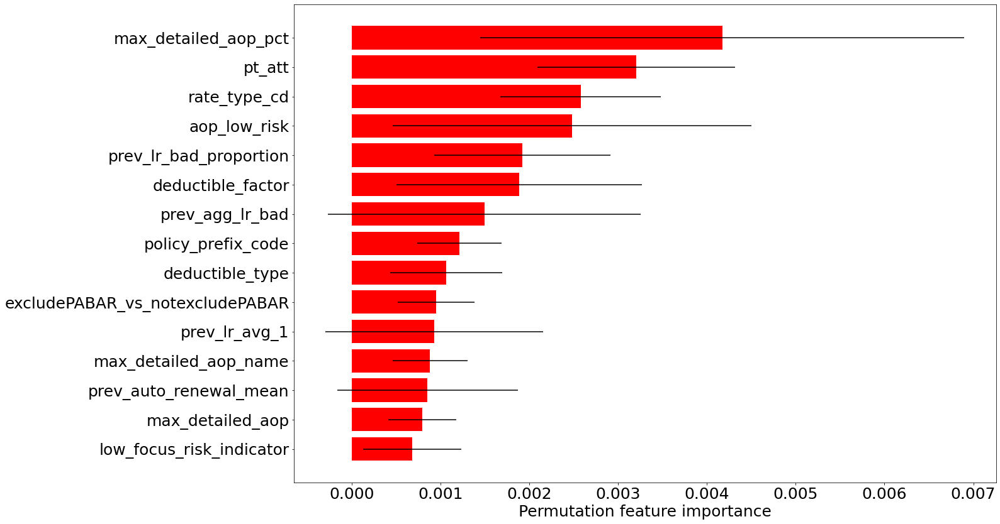

In [491]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_tweedie_optimizedrmse.png", dpi=300, bbox_inches='tight')
plt.show()

## HGBT regression

In [102]:
def HGBT_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    random_state = 42
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=random_state, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])

    model_HGBR = HistGradientBoostingRegressor(random_state=random_state)
    
    start = time.time()
    
    param_grid = {}
    param_grid['HGBTregressor__learning_rate'] = [10, 5, 1, 0.1, 0.01]
    param_grid['HGBTregressor__max_bins'] = [10, 20, 30, 40, 50, 75, 100]
    param_grid['HGBTregressor__max_iter'] = [100, 500, 1000, 1500, 2000, 2500, 3000]
    param_grid['HGBTregressor__min_samples_leaf'] = [2, 5, 10, 20, 30, 50, 100]
    param_grid['HGBTregressor__max_leaf_nodes'] = [10, 20, 30, 40]
    param_grid['HGBTregressor__max_depth'] = [None, 5, 10, 20]
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=9, sparse=False)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", StandardScaler(), numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), ("HGBTregressor", model_HGBR)])

    hgbt_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    hgbt_search.fit(X_train, y_train)
    
    results = pd.DataFrame(hgbt_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(hgbt_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return hgbt_search

def HGBT_experiment_transform(train_for_cv_df, X_train, y_train, func, inverse_func, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    random_state = 42
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=random_state, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])

    model_HGBR = HistGradientBoostingRegressor(random_state=random_state)
    
    start = time.time()
    
    param_grid = {}
    param_grid['HGBTregressor__regressor__learning_rate'] = [10, 5, 1, 0.1, 0.01]
    param_grid['HGBTregressor__regressor__max_bins'] = [10, 20, 30, 40, 50, 75, 100]
    param_grid['HGBTregressor__regressor__max_iter'] = [100, 500, 1000, 1500, 2000, 2500, 3000]
    param_grid['HGBTregressor__regressor__min_samples_leaf'] = [2, 5, 10, 20, 30, 50, 100]
    param_grid['HGBTregressor__regressor__max_leaf_nodes'] = [10, 20, 30, 40]
    param_grid['HGBTregressor__regressor__max_depth'] = [None, 5, 10, 20]
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=9, sparse=False)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), 
                           ("HGBTregressor", TransformedTargetRegressor(model_HGBR, func=func, inverse_func=inverse_func))])

    hgbt_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    hgbt_search.fit(X_train, y_train)
    
    results = pd.DataFrame(hgbt_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return hgbt_search

### vanilla HGBT

In [226]:
hgbt_search = HGBT_experiment(train_df, X_train, y_train, feature_subset = [], n_iterations=1250, scorer='neg_root_mean_squared_error',
                          name_for_model="HGBTv3_best_estimator_newpreprocessing_notruncation.pkl", name_for_results="regression_notruncation.csv",
                          description = "HGBT no truncation removed renewed, less preprocessing removal - 0.95 threshold, added loss and premiums FE (HGBTv3_best_estimator_newpreprocessing_notruncation.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits
Time elapsed (in Sec): 958.9327044487


### hgbt transforms

#### sqrt transform

In [508]:
hgbt_search_sqrt = HGBT_experiment_transform(train_df, X_train, y_train, func=np.sqrt, inverse_func=np.square, feature_subset = [], n_iterations=1250,
                          scorer='neg_root_mean_squared_error', name_for_model="HGBTv1_best_estimator_newpreprocessing_notruncation_sqrt_transform.pkl", name_for_results="regression_notruncation.csv",
                          description="HGBT no truncation removed renewed sqrt transform (HGBTv1_best_estimator_newpreprocessing_notruncation_sqrt_transform.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits
Time elapsed (in Sec): 983.4464328289032


#### log transform

In [501]:
def log_func(y):
    return np.log(y + 1)

def log_inverse_func(y):
    return np.exp(y) - 1

In [509]:
hgbt_search_log = HGBT_experiment_transform(train_df, X_train, y_train, func=log_func, inverse_func=log_inverse_func, feature_subset = [], n_iterations=1250,
                          scorer='neg_root_mean_squared_error', name_for_model="HGBTv1_best_estimator_newpreprocessing_notruncation_log_transform.pkl", name_for_results="regression_notruncation.csv",
                          description="HGBT no truncation removed renewed log transform (HGBTv1_best_estimator_newpreprocessing_notruncation_log_transform.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits


One or more of the test scores are non-finite: [-10.66029223 -10.92016384          nan ...          nan          nan
 -10.66203923]
One or more of the train scores are non-finite: [-10.83700415 -10.69039082          nan ...          nan          nan
 -10.80200956]


Time elapsed (in Sec): 951.0027377605438


#### capping

In [403]:
def capping_func(y):
    capped_return = y.copy()
    capped_return[capped_return > 15] = 15
    return capped_return

def inverse_capping_func(y):
    return y

In [406]:
hgbt_search_capping = HGBT_experiment_transform(train_df, X_train, y_train, func=capping_func, inverse_func=inverse_capping_func, feature_subset = [], n_iterations=1250,
                          scorer='neg_root_mean_squared_error', name_for_model="HGBTv1_best_estimator_newpreprocessing_notruncation_capping_transform.pkl", name_for_results="regression_notruncation.csv",
                          description="HGBT no truncation removed renewed capping transform (HGBTv1_best_estimator_newpreprocessing_notruncation_capping_transform.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits


NameError: name 'xgb_search' is not defined

### quantile plots

sqrt CV:

[0.51842105 0.6168469  0.54776573 ... 0.6489318  0.72364753 0.54693514]
[(0.508, 0.522], (0.61, 0.646], (0.543, 0.553], (0.491, 0.508], (0.583, 0.61], ..., (0.725, 4.117], (0.491, 0.508], (0.646, 0.725], (0.646, 0.725], (0.543, 0.553]]
Length: 29991
Categories (10, interval[float64, right]): [(0.402, 0.491] < (0.491, 0.508] < (0.508, 0.522] < (0.522, 0.543] ... (0.583, 0.61] < (0.61, 0.646] < (0.646, 0.725] < (0.725, 4.117]]
4.116654
['(0.402, 0.491]', '(0.491, 0.508]', '(0.508, 0.522]', '(0.522, 0.543]', '(0.543, 0.553]', '(0.553, 0.583]', '(0.583, 0.61]', '(0.61, 0.646]', '(0.646, 0.725]', '(0.725, 4.117]']


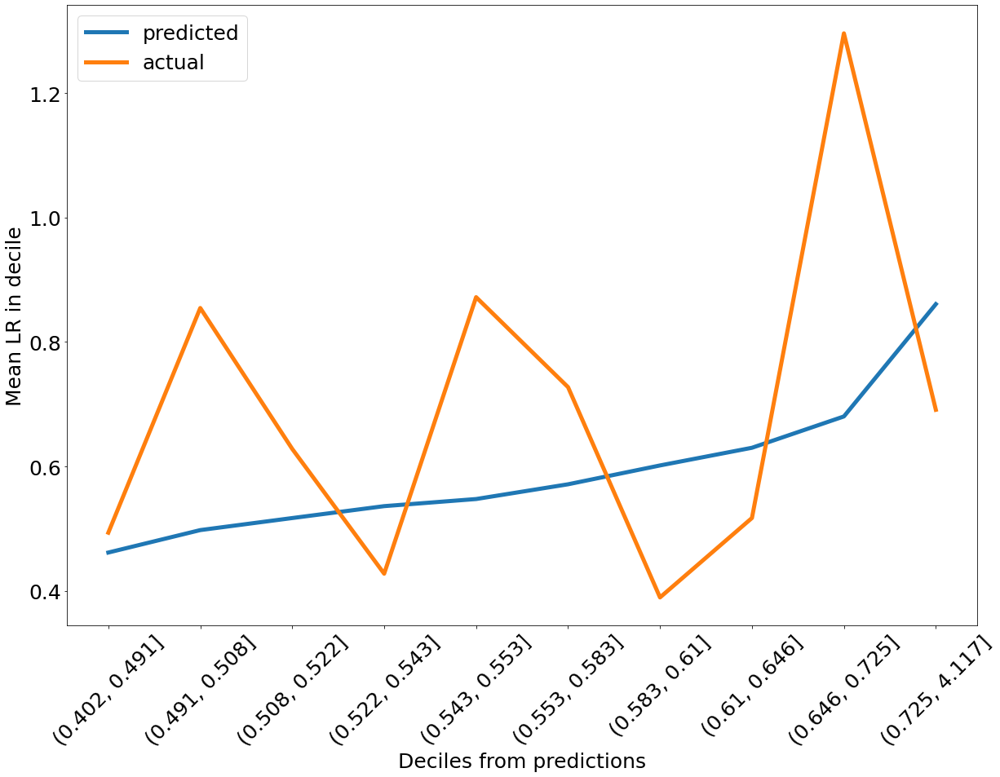

In [512]:
quantile_actual_predicted_line("HGBTv1_best_estimator_newpreprocessing_notruncation_sqrt_transform.pkl", "test.png", X_train, y_train, CV=True, df_for_splitting=train_df)

log CV:

[0.51842105 0.6168469  0.54776573 ... 0.6489318  0.72364753 0.54693514]
[(0.508, 0.522], (0.61, 0.646], (0.543, 0.553], (0.491, 0.508], (0.583, 0.61], ..., (0.725, 4.117], (0.491, 0.508], (0.646, 0.725], (0.646, 0.725], (0.543, 0.553]]
Length: 29991
Categories (10, interval[float64, right]): [(0.402, 0.491] < (0.491, 0.508] < (0.508, 0.522] < (0.522, 0.543] ... (0.583, 0.61] < (0.61, 0.646] < (0.646, 0.725] < (0.725, 4.117]]
4.116654
['(0.402, 0.491]', '(0.491, 0.508]', '(0.508, 0.522]', '(0.522, 0.543]', '(0.543, 0.553]', '(0.553, 0.583]', '(0.583, 0.61]', '(0.61, 0.646]', '(0.646, 0.725]', '(0.725, 4.117]']


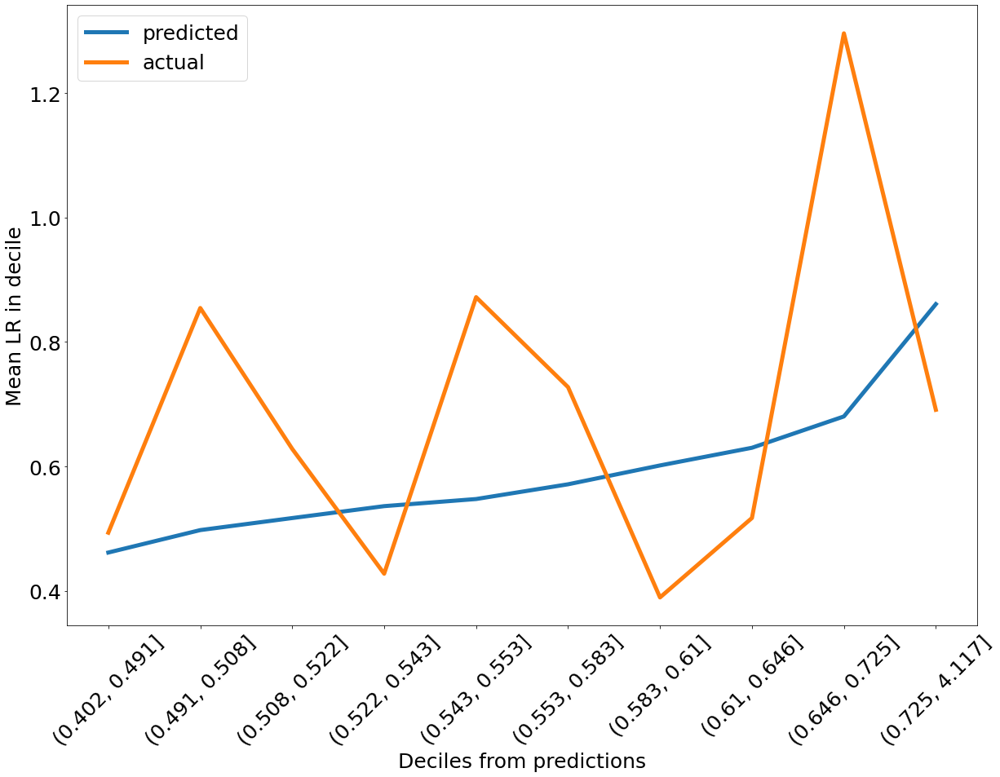

In [513]:
quantile_actual_predicted_line("HGBTv1_best_estimator_newpreprocessing_notruncation_log_transform.pkl", "test.png", X_train, y_train, CV=True, df_for_splitting=train_df)

capping CV:

[0.51842105 0.6168469  0.54776573 ... 0.6489318  0.72364753 0.54693514]
[(0.508, 0.522], (0.61, 0.646], (0.543, 0.553], (0.491, 0.508], (0.583, 0.61], ..., (0.725, 4.117], (0.491, 0.508], (0.646, 0.725], (0.646, 0.725], (0.543, 0.553]]
Length: 29991
Categories (10, interval[float64, right]): [(0.402, 0.491] < (0.491, 0.508] < (0.508, 0.522] < (0.522, 0.543] ... (0.583, 0.61] < (0.61, 0.646] < (0.646, 0.725] < (0.725, 4.117]]
4.116654
['(0.402, 0.491]', '(0.491, 0.508]', '(0.508, 0.522]', '(0.522, 0.543]', '(0.543, 0.553]', '(0.553, 0.583]', '(0.583, 0.61]', '(0.61, 0.646]', '(0.646, 0.725]', '(0.725, 4.117]']


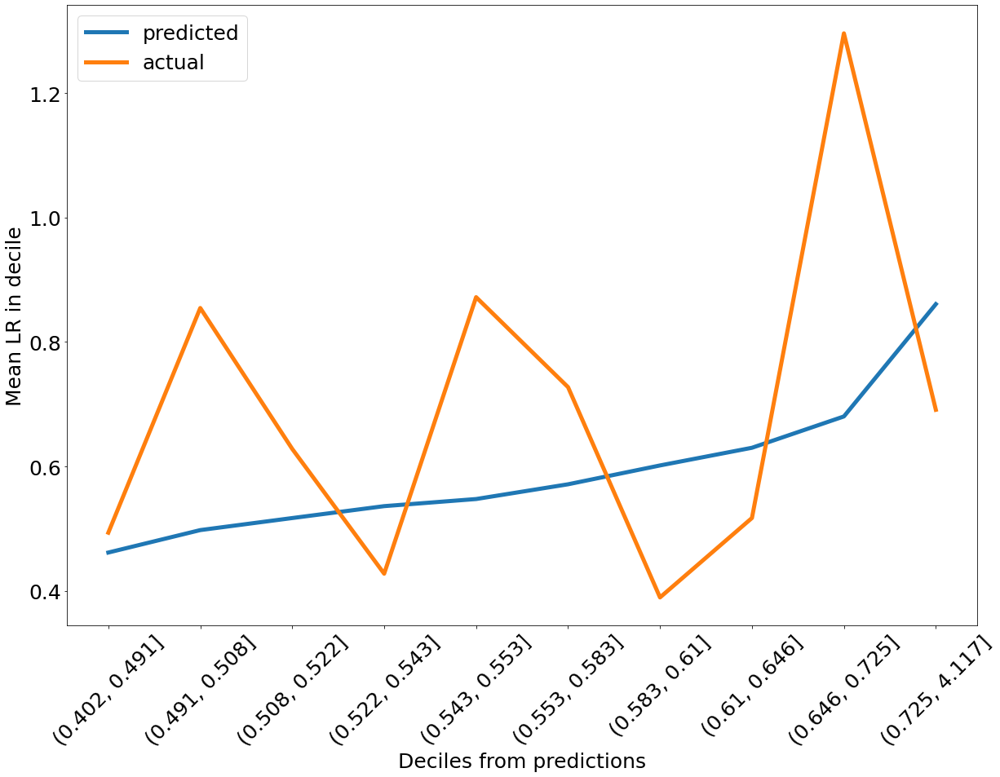

In [514]:
quantile_actual_predicted_line("HGBTv1_best_estimator_newpreprocessing_notruncation_capping_transform.pkl", "test.png", X_train, y_train, CV=True, df_for_splitting=train_df)

[0.7206412  0.7556586  0.52989805 ... 0.7497963  0.52989805 0.649716  ]
[(0.65, 0.723], (0.723, 2.587], (0.517, 0.53], (0.517, 0.53], (0.556, 0.581], ..., (0.53, 0.556], (0.517, 0.53], (0.723, 2.587], (0.517, 0.53], (0.581, 0.65]]
Length: 12853
Categories (7, interval[float64, right]): [(0.432, 0.517] < (0.517, 0.53] < (0.53, 0.556] < (0.556, 0.581] < (0.581, 0.65] < (0.65, 0.723] < (0.723, 2.587]]
2.5874465
['(0.432, 0.517]', '(0.517, 0.53]', '(0.53, 0.556]', '(0.556, 0.581]', '(0.581, 0.65]', '(0.65, 0.723]', '(0.723, 2.587]']


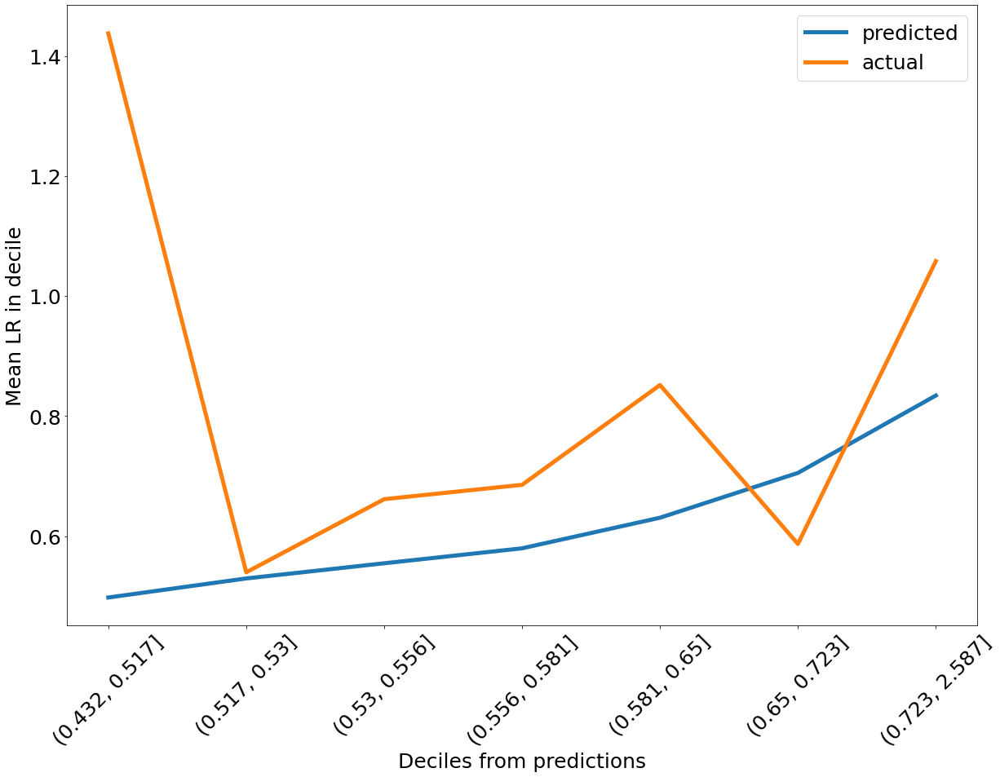

In [515]:
quantile_actual_predicted_line("HGBTv1_best_estimator_newpreprocessing_notruncation_capping_transform.pkl", "test.png", X_test, y_test)

train:

[0.63908896 0.62846894 0.62846894 ... 0.62846894 0.71025651 0.71025651]
[(0.631, 0.641], (0.547, 0.628], (0.547, 0.628], (0.631, 0.641], (0.631, 0.641], ..., (0.547, 0.628], (0.547, 0.628], (0.547, 0.628], (0.659, 6.032], (0.659, 6.032]]
Length: 29991
Categories (6, interval[float64, right]): [(0.547, 0.628] < (0.628, 0.631] < (0.631, 0.641] < (0.641, 0.642] < (0.642, 0.659] < (0.659, 6.032]]
6.032297427726075
['(0.547, 0.628]', '(0.628, 0.631]', '(0.631, 0.641]', '(0.641, 0.642]', '(0.642, 0.659]', '(0.659, 6.032]']


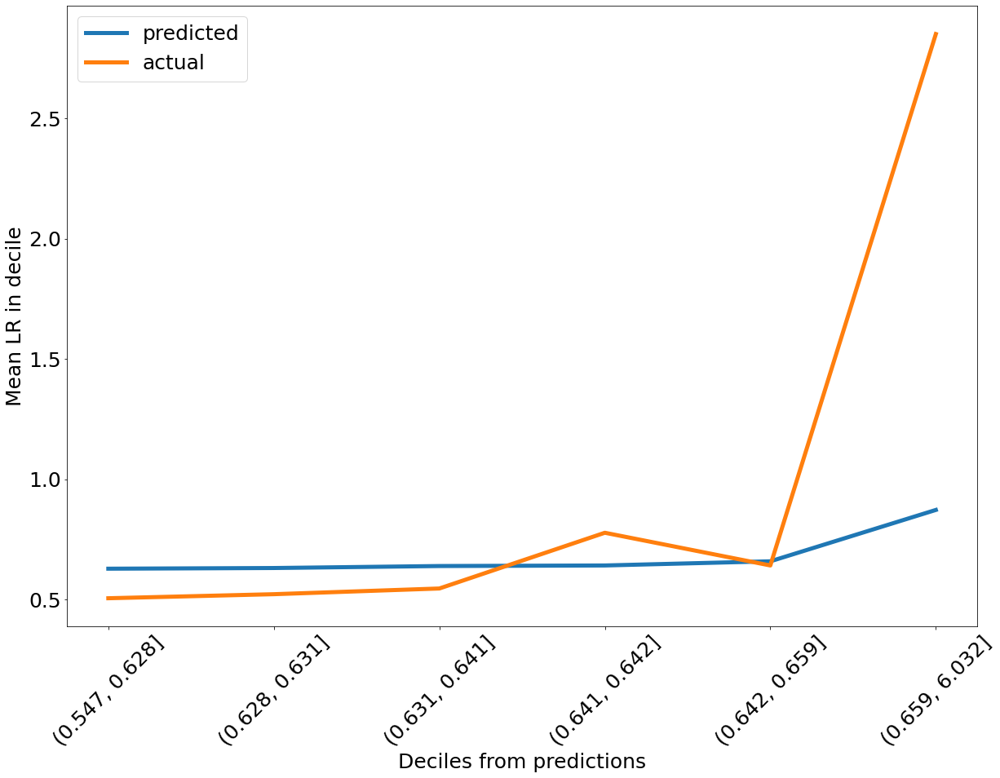

In [494]:
quantile_actual_predicted_line("HGBTv1_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_train.png", X_train, y_train)

train (less removal of features):

[0.63447803 0.63447803 0.63447803 ... 0.637013   0.60704366 0.60704366]
[(0.547, 0.634], (0.547, 0.634], (0.547, 0.634], (0.547, 0.634], (0.637, 0.638], ..., (0.634, 0.637], (0.547, 0.634], (0.634, 0.637], (0.547, 0.634], (0.547, 0.634]]
Length: 29991
Categories (7, interval[float64, right]): [(0.547, 0.634] < (0.634, 0.637] < (0.637, 0.638] < (0.638, 0.641] < (0.641, 0.645] < (0.645, 0.65] < (0.65, 6.161]]
6.1609200550431265
['(0.547, 0.634]', '(0.634, 0.637]', '(0.637, 0.638]', '(0.638, 0.641]', '(0.641, 0.645]', '(0.645, 0.65]', '(0.65, 6.161]']


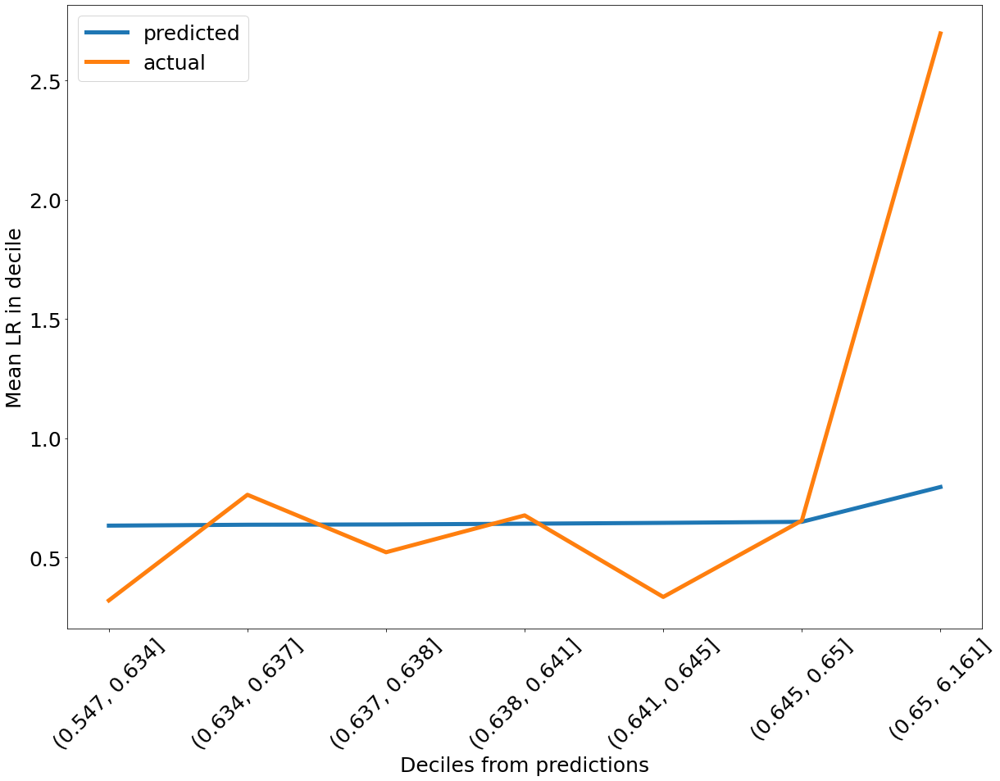

In [407]:
quantile_actual_predicted_line("HGBTv2_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_train_lessremoval.png", X_train, y_train)

CV:

[0.76023575 0.69541946 0.69541946 ... 0.71346128 0.76023575 0.60092876]
[(0.722, 0.76], (0.61, 0.697], (0.61, 0.697], (0.544, 0.581], (0.722, 0.76], ..., (0.776, 7.419], (0.581, 0.61], (0.712, 0.722], (0.722, 0.76], (0.581, 0.61]]
Length: 29991
Categories (8, interval[float64, right]): [(0.544, 0.581] < (0.581, 0.61] < (0.61, 0.697] < (0.697, 0.712] < (0.712, 0.722] < (0.722, 0.76] < (0.76, 0.776] < (0.776, 7.419]]
7.4194936381398655
['(0.544, 0.581]', '(0.581, 0.61]', '(0.61, 0.697]', '(0.697, 0.712]', '(0.712, 0.722]', '(0.722, 0.76]', '(0.76, 0.776]', '(0.776, 7.419]']


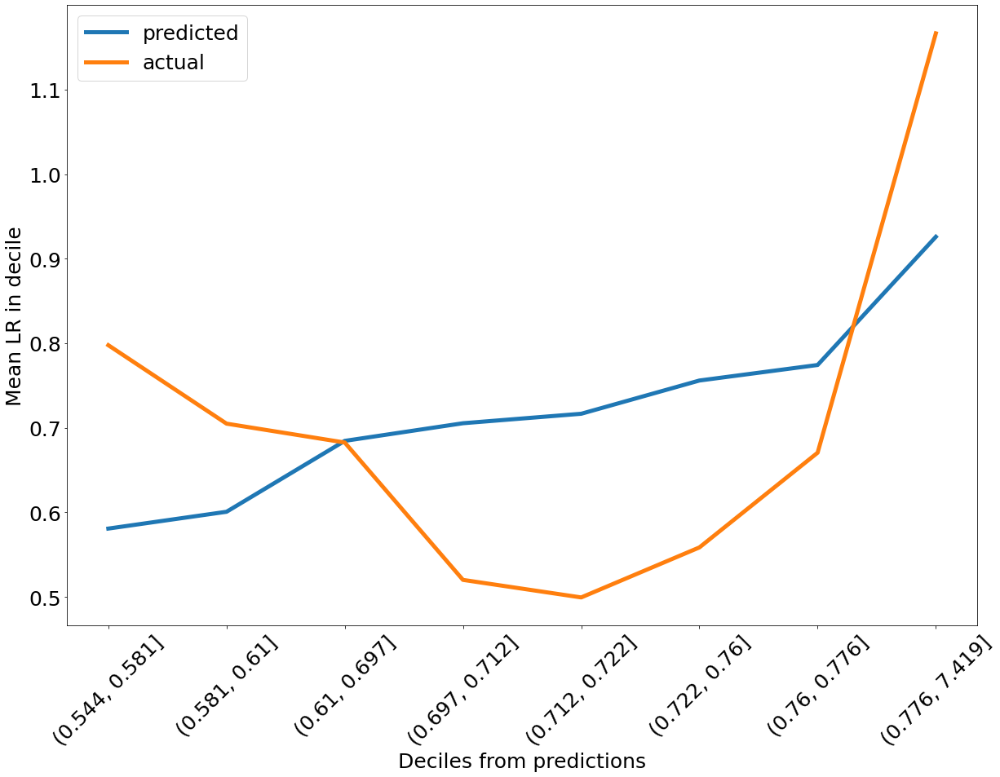

In [495]:
quantile_actual_predicted_line("HGBTv1_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_CV.png", X_train, y_train, CV=True, df_for_splitting=train_df)

CV (less removal of features):

[0.7657148  0.6909247  0.6909247  ... 0.72687721 0.7657148  0.58376765]
[(0.727, 0.766], (0.602, 0.691], (0.602, 0.691], (0.766, 7.839], (0.727, 0.766], ..., (0.766, 7.839], (0.542, 0.584], (0.724, 0.727], (0.727, 0.766], (0.542, 0.584]]
Length: 29991
Categories (7, interval[float64, right]): [(0.542, 0.584] < (0.584, 0.602] < (0.602, 0.691] < (0.691, 0.724] < (0.724, 0.727] < (0.727, 0.766] < (0.766, 7.839]]
7.8385910033772
['(0.542, 0.584]', '(0.584, 0.602]', '(0.602, 0.691]', '(0.691, 0.724]', '(0.724, 0.727]', '(0.727, 0.766]', '(0.766, 7.839]']


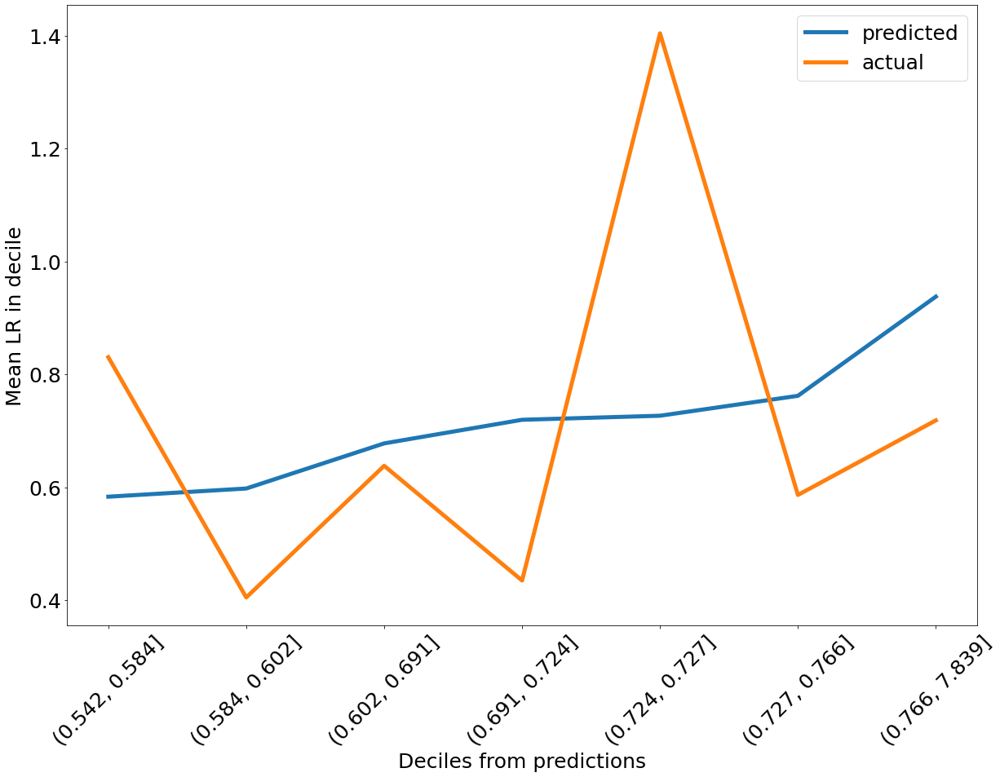

In [408]:
quantile_actual_predicted_line("HGBTv2_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_CV_lessremoval.png", X_train, y_train, CV=True, df_for_splitting=train_df)

test:

[0.65010958 0.65010958 0.63447803 ... 0.64899526 0.65211903 0.637013  ]
[(0.645, 0.65], (0.645, 0.65], (0.547, 0.634], (0.547, 0.634], (0.638, 0.641], ..., (0.645, 0.65], (0.645, 0.65], (0.645, 0.65], (0.65, 6.161], (0.634, 0.637]]
Length: 12853
Categories (7, interval[float64, right]): [(0.547, 0.634] < (0.634, 0.637] < (0.637, 0.638] < (0.638, 0.641] < (0.641, 0.645] < (0.645, 0.65] < (0.65, 6.161]]
6.1609200550431265
['(0.547, 0.634]', '(0.634, 0.637]', '(0.637, 0.638]', '(0.638, 0.641]', '(0.641, 0.645]', '(0.645, 0.65]', '(0.65, 6.161]']


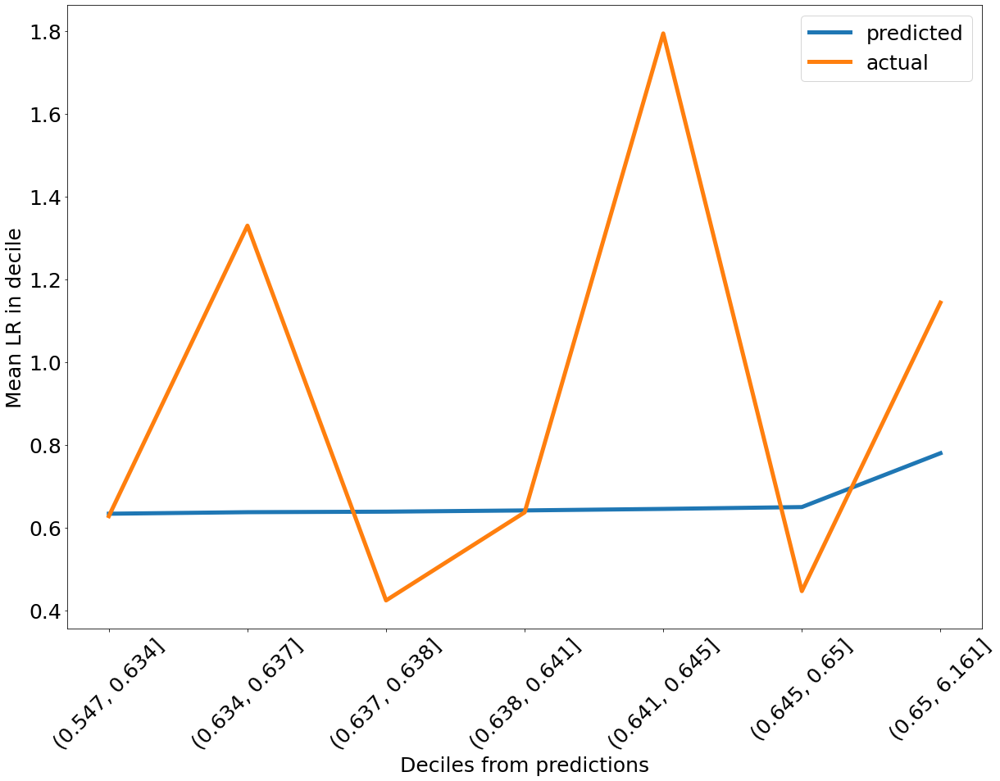

In [363]:
quantile_actual_predicted_line("HGBTv2_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_test.png", X_test, y_test, CV=False)

train (less removal of features + prem and loss FE):

[0.63447803 0.63447803 0.63447803 ... 0.637013   0.60704366 0.60704366]
[(0.547, 0.634], (0.547, 0.634], (0.547, 0.634], (0.547, 0.634], (0.637, 0.638], ..., (0.634, 0.637], (0.547, 0.634], (0.634, 0.637], (0.547, 0.634], (0.547, 0.634]]
Length: 29991
Categories (7, interval[float64, right]): [(0.547, 0.634] < (0.634, 0.637] < (0.637, 0.638] < (0.638, 0.641] < (0.641, 0.645] < (0.645, 0.65] < (0.65, 6.161]]
6.1609200550431265
['(0.547, 0.634]', '(0.634, 0.637]', '(0.637, 0.638]', '(0.638, 0.641]', '(0.641, 0.645]', '(0.645, 0.65]', '(0.65, 6.161]']


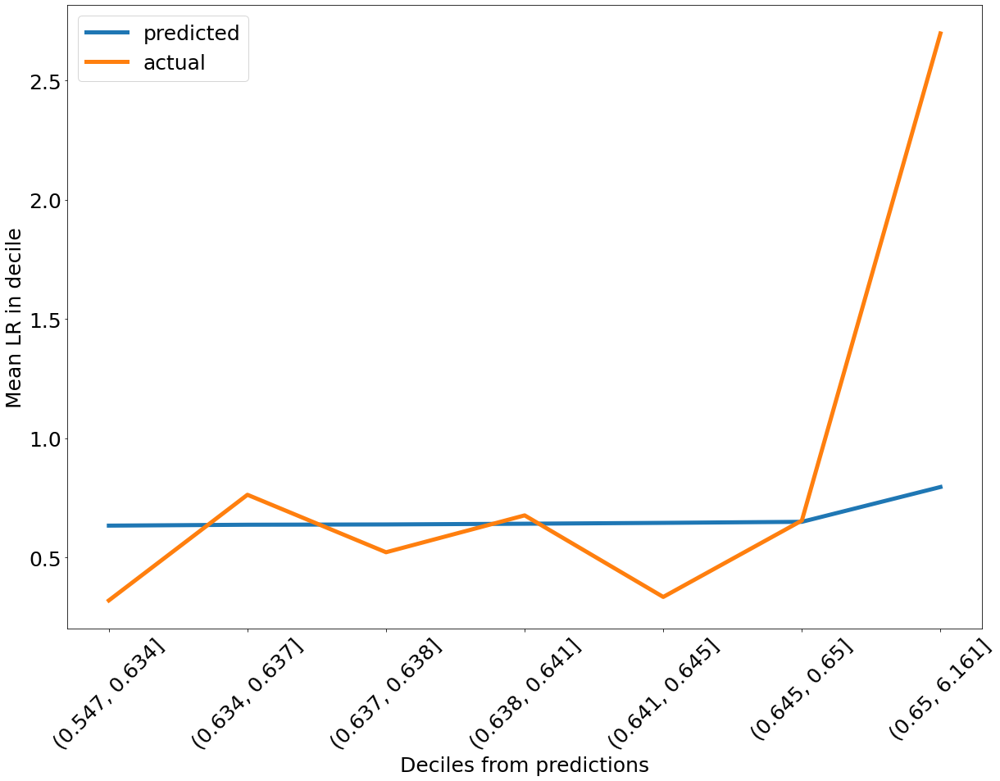

In [229]:
quantile_actual_predicted_line("HGBTv3_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_train_lessremoval_premlossFE.png", X_train, y_train)

CV:

[0.7657148  0.6909247  0.6909247  ... 0.72687721 0.7657148  0.58376765]
[(0.727, 0.766], (0.602, 0.691], (0.602, 0.691], (0.766, 7.839], (0.727, 0.766], ..., (0.766, 7.839], (0.542, 0.584], (0.724, 0.727], (0.727, 0.766], (0.542, 0.584]]
Length: 29991
Categories (7, interval[float64, right]): [(0.542, 0.584] < (0.584, 0.602] < (0.602, 0.691] < (0.691, 0.724] < (0.724, 0.727] < (0.727, 0.766] < (0.766, 7.839]]
7.8385910033772
['(0.542, 0.584]', '(0.584, 0.602]', '(0.602, 0.691]', '(0.691, 0.724]', '(0.724, 0.727]', '(0.727, 0.766]', '(0.766, 7.839]']


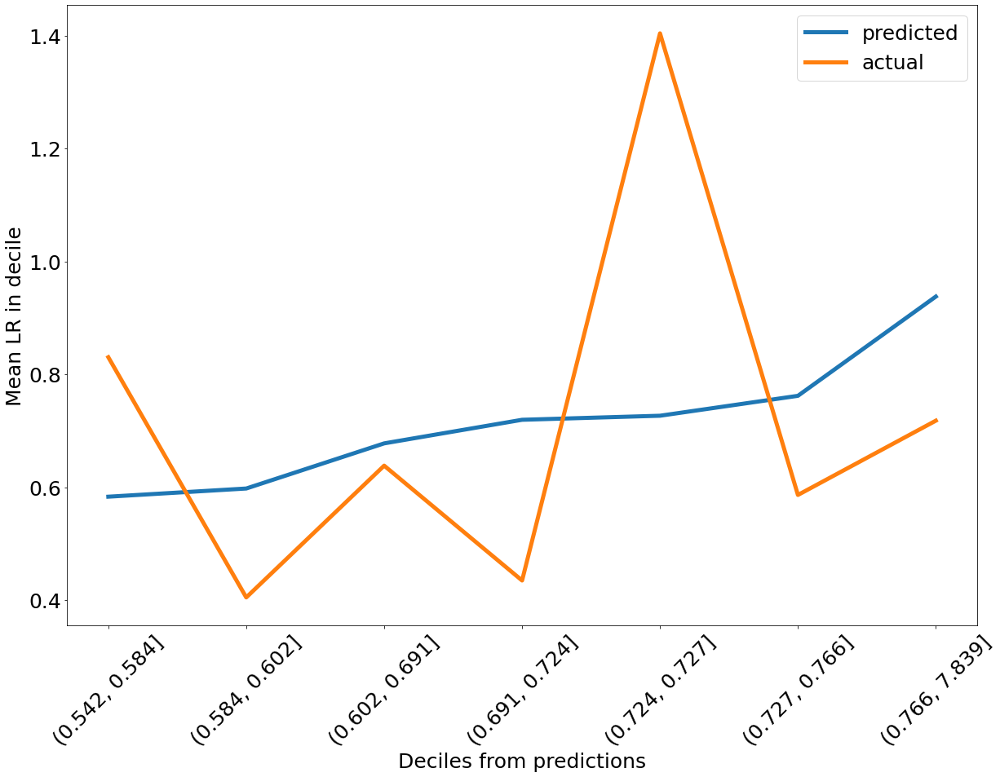

In [230]:
quantile_actual_predicted_line("HGBTv3_best_estimator_newpreprocessing_notruncation.pkl", "HGBT_rmse_optimized_CV_lessremoval_premlossFE.png", X_train, y_train, CV=True, df_for_splitting=train_df)

### Feature importance

#### Permutation importance (best model optimized on rmse)

In [231]:
# This is the best performing model 
with open("HGBTv3_best_estimator_newpreprocessing_notruncation.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_reg_model = joblib.load(file)

feature_names = best_reg_model.named_steps["encoding"].transformers_[0][2]  + best_reg_model.named_steps["encoding"].transformers_[1][2]

perm = permutation_importance(best_reg_model, X_test.loc[:, feature_names], y_test, n_repeats = 50, scoring="neg_mean_squared_error", n_jobs=-1)

In [232]:
top_x = 15
perm_idx_sorted = perm.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

['prev_auto_renewal_trend', 'rule_3_total', 'aggregate_limit', 'aggregate_deductible_amount', 'factor_aop_insurance_opinions', 'not_greater_financial_crisis', 'prev_agg_lr_bad', 'max_detailed_aop', 'policy_prefix_code', 'prev_lr_avg_4', 'increased_limits_factor', 'prev_auto_renewal_std', 'prev_ft_att_trend', 'prev_rate_change_trend', 'prev_lr_avg_5']
['prev_auto_renewal_trend', 'rule_3_total', 'aggregate_limit', 'aggregate_deductible_amount', 'factor_aop_insurance_opinions', 'not_greater_financial_crisis', 'prev_agg_lr_bad', 'max_detailed_aop', 'policy_prefix_code', 'prev_lr_avg_4', 'increased_limits_factor', 'prev_auto_renewal_std', 'prev_ft_att_trend', 'prev_rate_change_trend', 'prev_lr_avg_5']
15


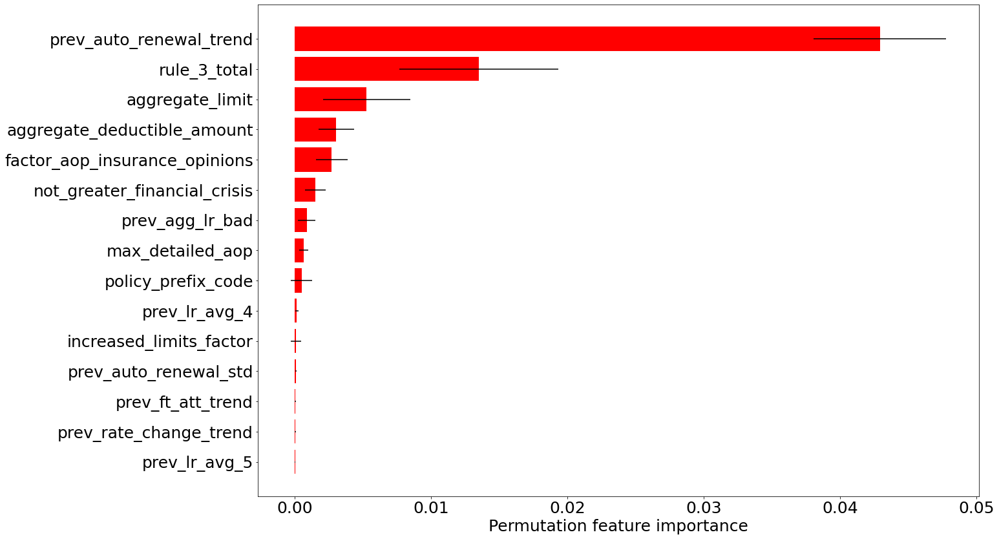

In [233]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_HGBT_optimizedrmse.png", dpi=300, bbox_inches='tight')
plt.show()

# Implementing SMOTER with XGB

Custom transformer for X:

In [64]:
# Custom Transformers (pipeline.fit calls fit then transform sequentially, predict just does transform (focus here))
class PandasCastTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns
    def fit(self, X, y = None):
        return self
    def transform(self, X):
        X = pd.DataFrame(X, columns = self.columns)
        return X

Defining a "sampler" class, which is detectable by the imblearn pipeline (so that it only applies resample to train splits in CV):

In [65]:
class SmoterSampler(BaseEstimator):
    
    def __init__(self, k_nn = 5, pert = 0.02, samp_method="balanced", under_samp = True, drop_na_col=True, drop_na_row=True, 
                 replace=False, rel_thres = 0.5, rel_method='auto', rel_xtrm_type='both', rel_coef=1.5, rel_ctrl_pts_rg=None):
        
        self.k_nn = k_nn
        self.pert = pert # Gaussian noise perturbation factor
        self.samp_method = samp_method
        self.under_samp = under_samp
        self.drop_na_col = drop_na_col
        self.drop_na_row = drop_na_row
        self.replace = replace
        self.rel_thres = rel_thres
        self.rel_method = rel_method
        self.rel_xtrm_type = rel_xtrm_type
        self.rel_coef = rel_coef
        self.rel_ctrl_pts_rg = rel_ctrl_pts_rg
        
    def fit(self, X, y):
        return self
    
    def fit_resample(self, X, y):
        dataset_df = pd.concat([X, pd.DataFrame(y).reset_index(drop=True)], axis=1)
        dataset_df = dataset_df.fillna(0)
        
        #assert_frame_equal(dataset_df, dataset_df2, check_dtype=False)
        target_col = dataset_df.columns.tolist()[-1]
        smoter_transformed = smoter(data=dataset_df, y=target_col, 
                                    k=self.k_nn, pert=self.pert, samp_method=self.samp_method,
                                    under_samp=self.under_samp, drop_na_col=self.drop_na_col, 
                                    drop_na_row=self.drop_na_row, replace=self.replace,
                                    rel_thres=self.rel_thres, rel_method=self.rel_method,
                                    rel_xtrm_type=self.rel_xtrm_type, rel_ctrl_pts_rg=self.rel_ctrl_pts_rg)
        X = smoter_transformed.drop(columns=[target_col])
        y = smoter_transformed[target_col] 
        return X, y 

In [69]:
def XGB_smoter_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, name_for_model, name_for_results, description):
    
    rg_mtrx = [
    [1500, 1, 0], ## over-sample ("minority")
    [1200, 1, 0], ## over-sample ("minority")
    [600, 1, 0], ## over-sample ("minority")
    [400, 1, 0], ## over-sample ("minority")
    [200, 1, 0], ## over-sample ("minority")
    [100, 1, 0], ## over-sample ("minority")
    [50, 1, 0], ## over-sample ("minority")
    [10, 1, 0], ## over-sample ("minority")
    [5, 1, 0], ## over-sample ("minority")
    [1, 0, 0], ## under-sample ("majority")
    [0.126423, 0, 0], ## under-sample ("majority")
    [0.001240, 0, 0], ## under-sample ("majority")
    [0.015178, 0, 0] ## under-sample ("majority")
    ]
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])
    xgb_reg = xgb.XGBRegressor(objective="reg:tweedie", n_jobs=3)
    
    start = time.time()
    
    param_grid = {
    'XGBoost__tweedie_variance_power': [1.0, 1.1, 1.2, 1.3],
    'XGBoost__n_estimators': [10, 50, 100, 500, 1000],
    'XGBoost__max_depth': [2, 3, 4, 5],
    'XGBoost__gamma': [0.01, 0.1, 1, 10, 100],
    'XGBoost__colsample_bytree': [0.2, 0.5, 1.0],
    'XGBoost__subsample': [0.2, 0.5, 1.0],
    'XGBoost__eta': [0.01, 0.1, 0.2],
    'fill_na__numerical__imputer__strategy': ["mean", "median"],
    'smoter__k_nn': [3,5,7],
    'smoter__rel_thres': [0.01, 0.1, 0.5, 0.99]
    #'smoter__rel_coef': [1.5, 10, 100, 200]
    }
    
#     param_grid = {
#     'XGBoost__tweedie_variance_power': [1.0, 1.1, 1.2, 1.3],
#     'XGBoost__n_estimators': [500, 1000],
#     'XGBoost__max_depth': [2, 4],
#     'XGBoost__gamma': [0.1, 1, 10, 100],
#     'XGBoost__colsample_bytree': [0.2, 0.5, 1.0],
#     'XGBoost__subsample': [0.5, 1.0],
#     'XGBoost__eta': [0.01, 0.1],
#     #'fill_na__numerical__imputer__strategy': ["mean", "median"],
#     'smoter__k_nn': [3, 5],
#     'smoter__rel_thres': [0.2, 0.5, 0.9]
#     }
    
    # imputation/encoding of features
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)
    
    numerical_fill = imbpipe.Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = imbpipe.Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), 
                           ("smoter", SmoterSampler(k_nn=3, samp_method='balance', rel_thres=0.5, rel_method='manual', drop_na_col=False, drop_na_row=False, rel_ctrl_pts_rg=rg_mtrx)), 
                           ("encode", encode_transform), ("XGBoost", xgb_reg)])
    
    xgb_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring='neg_mean_squared_error', 
                              cv=splitter_cv, n_jobs=9, return_train_score=True, n_iter=n_iterations, verbose=1)

    xgb_search.fit(X_train, y_train)
    
    results = pd.DataFrame(xgb_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return xgb_search

In [1330]:
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
# create a dummy target that is binary for zero/non-zero 
zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
splitter_cv = gkf_cv.split(train_df, zero_nonzero_indicator, groups=train_df['policy_id'])

sampler = SmoterSampler(k_nn=5, samp_method='extreme', rel_thres=0.9, rel_method='auto', rel_xtrm_type='high', rel_coef=200, drop_na_col=False, drop_na_row=False)

# imputation/encoding of features
ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

numerical_fill = imbpipe.Pipeline(
    steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
)

categorical_fill = imbpipe.Pipeline(
    steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
)

numeric = numerical_to_keep
nominal = nominal_to_keep
        
fillna_transform = ColumnTransformer(
    transformers=[
        ("numerical", numerical_fill, numeric),
        ("nominal", categorical_fill, nominal)
    ])

encode_transform = ColumnTransformer(
    transformers=[
        ("numerical", 'passthrough', numeric),
        ("nominal", ohe, nominal)
    ])
    
columns_after_fill = numeric + nominal
preprocess_pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill))]) 

for train, test in splitter_cv:
    print(len(train), len(test))
    #print(y_train.reset_index(drop=True)[train].value_counts().sort_index())
    preprocess_pipe.fit(X_train.iloc[train], y_train.iloc[train])
    X_pre_train= preprocess_pipe.transform(X_train.iloc[train])
    
    y_pre_train = y_train.iloc[train].reset_index(drop=True)
    
    print(X_pre_train.isnull().values.any())
    print(y_pre_train.isnull().values.any())
    test = pd.concat([X_pre_train, y_pre_train], axis=1)
    print(test.isnull().values.any())
    X_resamp, y_resamp = sampler.fit_resample(X_pre_train, y_pre_train)

19749 10059
False
False
False
False


dist_matrix:   5%|5         | 119/2268 [07:10<2:09:32,  3.62s/it]


KeyboardInterrupt: 

In [ ]:
xgb_search_smoter = XGB_smoter_experiment(train_df, X_train, y_train, feature_subset = [], n_iterations=50, 
                          name_for_model="XGBv1_best_estimator_notruncation_smoter.pkl", name_for_results="XGB_regression_notruncation.csv",
                          description = "XGB all features smoter no truncation (XGBv1_best_estimator_notruncation_smoter.pkl)")

Fitting 3 folds for each of 50 candidates, totalling 150 fits


In [ ]:
%%capture cap
print("XGB all features smoter no truncation (XGBv1_best_estimator_notruncation_smoter.pkl)\n")
print_XGB_metrics(xgb_search_smoter)

In [ ]:
with open('regression.log', 'a') as f: f.write(cap.stdout)
print(cap.stdout)

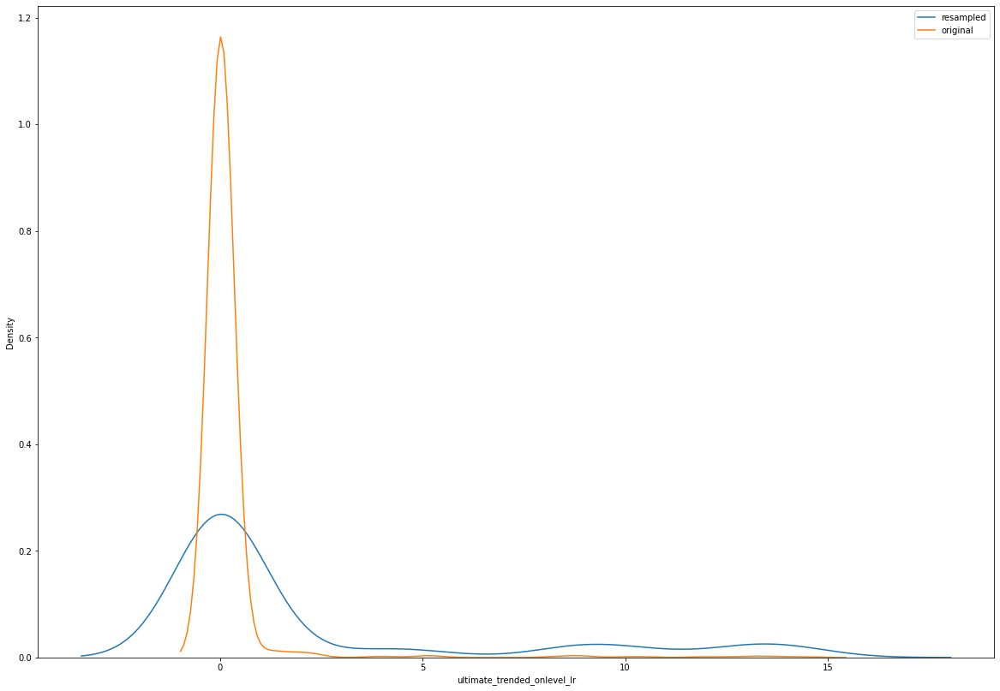

In [1887]:
sns.kdeplot(y_resamp, label = 'resampled')
sns.kdeplot(y_train.values[0:1000], label = 'original')
plt.legend()
plt.savefig(os.getcwd() + os.sep+ "Figures" + os.sep + "smoter_example_dist.png", dpi=300, bbox_inches='tight')


# classification

In [90]:
lr_threshold = 0.57

y_train_labeled = y_train.apply(lambda x: 1 if x > lr_threshold else 0)
y_test_labeled = y_test.apply(lambda x: 1 if x > lr_threshold else 0)

## logistic regression

In [91]:
# Custom Transformers (pipeline.fit calls fit then transform sequentially, predict just does transform (focus here))
class PandasCastTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns
    def fit(self, x, y = None):
        return self
    def transform(self, x):
        x = pd.DataFrame(x, columns = self.columns)
        return x

In [88]:
def LR_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    
    lr_clf = LogisticRegression(random_state = 42, penalty = "l1", n_jobs = 1, solver='saga', max_iter=8000)

    start = time.time()
    
    param_grid = {
    'LR__C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'LR__penalty': ["elasticnet"],
    'LR__l1_ratio': np.arange(0, 1.1, 0.1),
    'oversample__sampling_strategy': np.arange(0.1, 0.5, 0.1),
    'oversample__k_neighbors': [1, 2, 3, 4, 5],
    'undersample__sampling_strategy': np.arange(0.3, 0.6, 0.1),
    'fill_na__numerical__imputer__strategy': ["mean", "median"]    

    }
    
    # imputation/encoding of features
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), 
                           ("oversample", SMOTENC(sampling_strategy=0.1, categorical_features = list(range(len(numeric), len(numeric) + len(nominal))))), 
                           ("undersample", RandomUnderSampler(sampling_strategy=0.4)), ("encode", encode_transform), ("LR", lr_clf)])

    lr_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring='roc_auc', 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)
    
    lr_search.fit(X_train, y_train)
    
    results = pd.DataFrame(lr_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
    joblib.dump(lr_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return lr_search

def LR_experiment_calibrated(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    
    lr_clf = LogisticRegression(random_state = 42, penalty = "l1", n_jobs = 1, solver='saga', max_iter=8000)

    start = time.time()
    
    param_grid = {
    'LR__C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'LR__penalty': ["elasticnet"],
    'LR__l1_ratio': np.arange(0, 1.1, 0.1),
    'fill_na__numerical__imputer__strategy': ["mean", "median"]    

    }
    
    # imputation/encoding of features
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), ("encode", encode_transform), ("LR", lr_clf)])

    lr_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring='roc_auc', 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)
    
    lr_search.fit(X_train, y_train)
    
    results = pd.DataFrame(lr_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
    joblib.dump(lr_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return lr_search

def LR_experiment_calibrated_specific(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    
    lr_clf = LogisticRegression(random_state = 42, penalty = "l1", n_jobs = 1, solver='saga', max_iter=8000)

    start = time.time()
    
    param_grid = {
    'LR__C': [0.1],
    'LR__penalty': ["elasticnet"],
    'LR__l1_ratio': [0.3],
    'fill_na__numerical__imputer__strategy': ["mean"]    

    }
    
    # imputation/encoding of features
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), ("encode", encode_transform), ("LR", lr_clf)])

    lr_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring='roc_auc', 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)
    
    lr_search.fit(X_train, y_train)
    
    results = pd.DataFrame(lr_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
    joblib.dump(lr_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return lr_search

def LR_experiment_weighting(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scoring, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    
    lr_clf = LogisticRegression(random_state = 42, penalty = "l1", n_jobs = 1, solver='saga', max_iter=8000)

    start = time.time()
    
    # for weighting
    frac_range = np.arange(0.30, 1.0, 0.05)
    
    param_grid = {
    'LR__C': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
    'LR__penalty': ["elasticnet"],
    'LR__l1_ratio': np.arange(0, 1.1, 0.1),
    'fill_na__numerical__imputer__strategy': ["mean", "median"],
    'LR__class_weight': [{0: 1 - v, 1: v} for v in frac_range],
    }
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    
    pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)),  
                       ("encode", encode_transform), ("LR", lr_clf)])

    lr_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scoring, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)
    
    lr_search.fit(X_train, y_train)
    
    results = pd.DataFrame(lr_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
    joblib.dump(lr_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return lr_search

In [204]:
def print_LR_metrics(search_object):
    print("Best parameters:", search_object.best_params_)
    print("Best Score (ROC_AUC): ", search_object.best_score_)
    print("ROC_AUC std: ", (search_object.cv_results_['std_test_score'][search_object.best_index_]))
    print("\n")

### vanilla + oversampling version

In [ ]:
LR_search_useful = LR_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=200, 
                          name_for_model="LRv1_best_estimator_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "LR removed renewal etc (LRv1_best_estimator_ND.pkl)")

Fitting 3 folds for each of 200 candidates, totalling 600 fits



51 fits failed out of a total of 600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
51 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.8/dist-packages/imblearn/pipeline.py", line 262, in fit
    Xt, yt = self._fit(X, y, **fit_params_steps)
  File "/usr/local/lib/python3.8/dist-packages/imblearn/pipeline.py", line 220, in _fit
    X, y, fitted_transformer = fit_resample_one_cached(
  File "/usr/local/lib/python3.8/dist-packages/joblib/memory.py", line 349, in __call__
    return self.func(*args, **kwargs)
  File "/usr

### weighting version

In [87]:
LR_search_weighting = LR_experiment_weighting(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=200, scoring='roc_auc',
                          name_for_model="LRv2_best_estimator_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "LR weighted removed renewal etc (LRv2_best_estimator_ND.pkl)")

KeyboardInterrupt: 

### calibrated version

In [ ]:
LR_search_calibrated = LR_experiment_calibrated(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=150,
                          name_for_model="LRv6_best_estimator_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "LR calibrated, updated FE increased max iter to 8k(LRv6_best_estimator_ND.pkl)")

Fitting 3 folds for each of 150 candidates, totalling 450 fits


### calibrated version (removed size of firm bucket + max_detailed_aop_name)

In [89]:
LR_search_calibrated = LR_experiment_calibrated_specific(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1,
                          name_for_model="LRv9_best_estimator_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "LR calibrated, removed size of firm bucket + max_detailed_aop_name (LRv9_best_estimator_ND.pkl)")

Fitting 3 folds for each of 1 candidates, totalling 3 fits
Time elapsed (in Sec): 1381.3156130313873


The max_iter was reached which means the coef_ did not converge


### calibration exploration

In [87]:
def quantile_actual_predicted_dotted(model_filename, savename, X, y, proba = None, prob_thresh_low = 0, prob_thresh_high = 1, ylabel='Mean of label in bin', xlabel="Mean of probability in quantile",fontsize=25):
    
    with open(model_filename, 'rb') as file:
        # Call load method to deserialze
        reg_model = joblib.load(file)
    
    if proba.shape[0] > 0:
        pred = proba
    else:
        pred = reg_model.predict_proba(X)[:, 1]
        
    idx_in_range = np.argwhere((pred>=prob_thresh_low) & (pred<=prob_thresh_high)).flatten()
    
    y_pred = pred[idx_in_range]
    y = y.iloc[idx_in_range]
    print(max(y_pred))
    print(y_pred)
    print(y)
    quantiles = pd.qcut(y_pred, 10, duplicates='drop')
    print(quantiles)
    qq_df = pd.DataFrame(index = quantiles, data= {"predicted": y_pred, "actual": y.values})
    grouped = qq_df.groupby(level=0).mean().sort_index()
    print([str(ele) for ele in grouped.index])
    #plt.plot([str(ele) for ele in grouped.index.values], grouped["predicted"], label='predicted', lw=5)
    #plt.plot([str(ele) for ele in grouped.index.values], grouped["actual"], label='actual', lw=5)
    plt.scatter(grouped["predicted"], grouped["actual"], s=40)
    #plt.plot(grouped["predicted"], grouped["actual"])
    plt.plot(np.arange(0, max(grouped["predicted"]), 0.01), np.arange(0, max(grouped["predicted"]), 0.01), ls='--', c='k')
                                                               
    plt.ylabel(ylabel, fontsize= fontsize)
    plt.xlabel(xlabel, fontsize = fontsize)
    #plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
    #plt.legend(fontsize=fontsize)
    plt.yticks(size= fontsize)
    plt.xticks(size = fontsize, rotation=45)
    plt.savefig(savename, dpi=300, bbox_inches='tight')

In [ ]:
# With sigmoid calibration
with open("LRv2_best_estimator_ND.pkl", 'rb') as file:
        # Call load method to deserialze
        reg_model = joblib.load(file)

clf_sigmoid = CalibratedClassifierCV(reg_model, cv=2, method="sigmoid")
clf_sigmoid.fit(X_train, y_train_labeled)
prob_pos_sigmoid = clf_sigmoid.predict_proba(X_test)[:, 1]

The max_iter was reached which means the coef_ did not converge


In [ ]:
print(max(prob_pos_sigmoid))

0.1831232492997199
[0.07544996 0.10676059 0.0413971  ... 0.0571188  0.02946566 0.05681844]
0        1
2        0
5        0
6        0
10       0
        ..
42816    0
42826    0
42829    0
42830    0
42834    0
Name: ultimate_trended_onlevel_lr, Length: 12853, dtype: int64
[(0.0515, 0.183], (0.0515, 0.183], (0.0384, 0.0515], (0.0384, 0.0515], (0.0255, 0.0286], ..., (0.0286, 0.0301], (0.0166, 0.0198], (0.0515, 0.183], (0.0286, 0.0301], (0.0515, 0.183]]
Length: 12853
Categories (10, interval[float64, right]): [(-0.001, 0.00836] < (0.00836, 0.0166] < (0.0166, 0.0198] < (0.0198, 0.0229] ... (0.0286, 0.0301] < (0.0301, 0.0384] < (0.0384, 0.0515] < (0.0515, 0.183]]
['(-0.001, 0.00836]', '(0.00836, 0.0166]', '(0.0166, 0.0198]', '(0.0198, 0.0229]', '(0.0229, 0.0255]', '(0.0255, 0.0286]', '(0.0286, 0.0301]', '(0.0301, 0.0384]', '(0.0384, 0.0515]', '(0.0515, 0.183]']


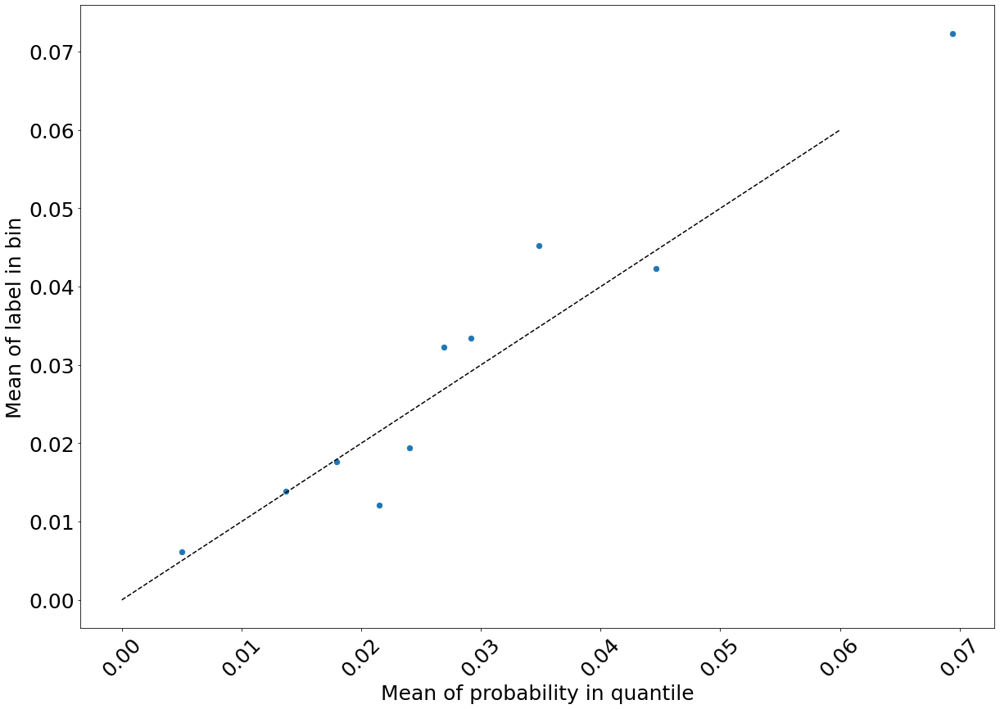

In [147]:
quantile_actual_predicted_dotted("LRv1_best_estimator_ND.pkl", "LR_calibration_plot.png", X_test, y_test_labeled, proba = prob_pos_sigmoid,  prob_thresh_low=0.0, prob_thresh_high=1.0)

0.5675932275830162
[0.08102919 0.11432173 0.04481683 ... 0.0473615  0.03861652 0.07202162]
0        1
2        0
5        0
6        0
10       0
        ..
42816    0
42826    0
42829    0
42830    0
42834    0
Name: ultimate_trended_onlevel_lr, Length: 12853, dtype: int64
[(0.0491, 0.568], (0.0491, 0.568], (0.0386, 0.0491], (0.0386, 0.0491], (0.0244, 0.0277], ..., (0.0277, 0.0325], (0.0114, 0.0168], (0.0386, 0.0491], (0.0325, 0.0386], (0.0491, 0.568]]
Length: 12853
Categories (10, interval[float64, right]): [(0.0031999999999999997, 0.0114] < (0.0114, 0.0168] < (0.0168, 0.0196] < (0.0196, 0.022] ... (0.0277, 0.0325] < (0.0325, 0.0386] < (0.0386, 0.0491] < (0.0491, 0.568]]
['(0.0031999999999999997, 0.0114]', '(0.0114, 0.0168]', '(0.0168, 0.0196]', '(0.0196, 0.022]', '(0.022, 0.0244]', '(0.0244, 0.0277]', '(0.0277, 0.0325]', '(0.0325, 0.0386]', '(0.0386, 0.0491]', '(0.0491, 0.568]']


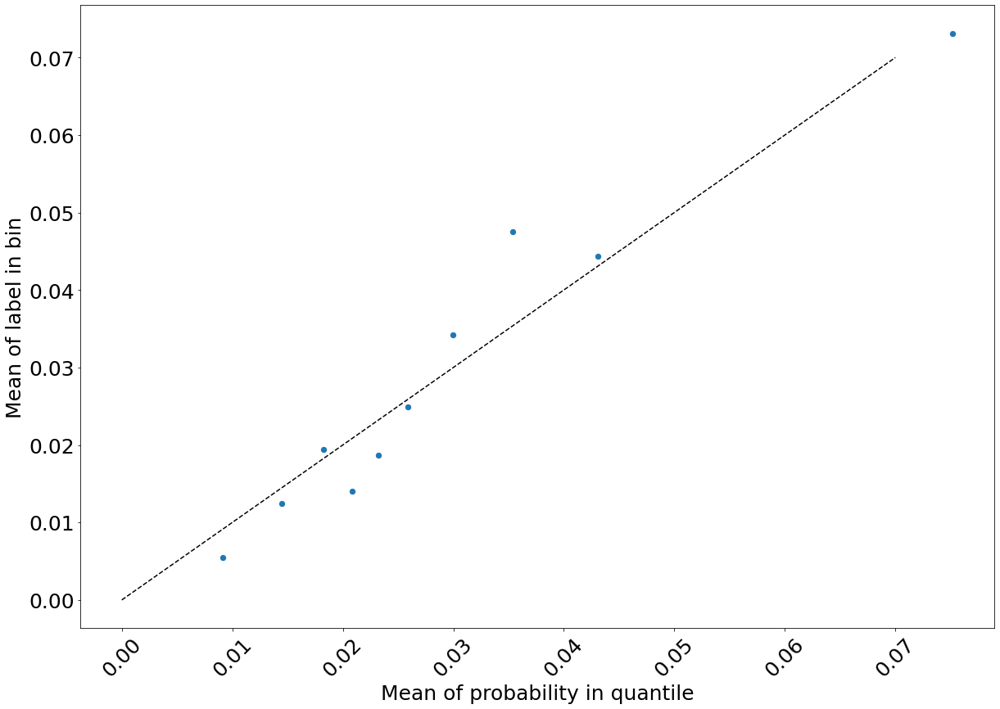

In [148]:
quantile_actual_predicted_dotted("LRv3_best_estimator_ND.pkl", "LR_calibration_plot.png", X_test, y_test_labeled, proba = np.array([]),  prob_thresh_low=0.0, prob_thresh_high=1.0)

0        1
102      1
104      1
105      1
166      1
        ..
42611    1
42654    1
42683    1
42709    1
42731    1
Name: ultimate_trended_onlevel_lr, Length: 378, dtype: int64
0.8994066886277559
[0.56493862 0.74955595 0.45246253 ... 0.53323707 0.37038388 0.42381864]
0        1
2        0
5        0
6        0
10       0
        ..
42816    0
42826    0
42829    0
42830    0
42834    0
Name: ultimate_trended_onlevel_lr, Length: 12853, dtype: int64
[(0.476, 0.899], (0.476, 0.899], (0.404, 0.476], (0.404, 0.476], (0.265, 0.294], ..., (0.294, 0.324], (0.191, 0.232], (0.476, 0.899], (0.359, 0.404], (0.404, 0.476]]
Length: 12853
Categories (10, interval[float64, right]): [(0.0246, 0.125] < (0.125, 0.191] < (0.191, 0.232] < (0.232, 0.265] ... (0.324, 0.359] < (0.359, 0.404] < (0.404, 0.476] < (0.476, 0.899]]
['(0.0246, 0.125]', '(0.125, 0.191]', '(0.191, 0.232]', '(0.232, 0.265]', '(0.265, 0.294]', '(0.294, 0.324]', '(0.324, 0.359]', '(0.359, 0.404]', '(0.404, 0.476]', '(0.476, 0.899]']

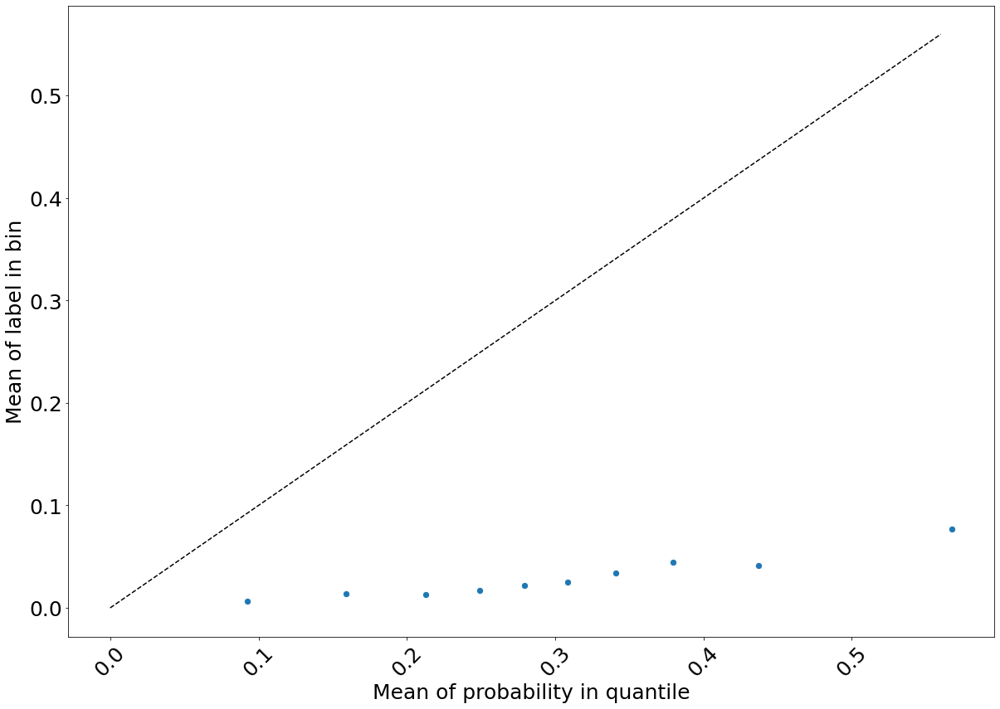

In [121]:
indicies = y_test_labeled[y_test_labeled ==1]
print(indicies)
quantile_actual_predicted_dotted("LRv1_best_estimator_ND.pkl", "LR_calibration_plot.png", X_test, y_test_labeled, prob_thresh_low=0.0, prob_thresh_high=1.0)

### ROC AUC for cross-fold validation

In [214]:
def roc_cv(train_for_cv_df, X, y, classifier, target, fontsize, filename):
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    splitter_cv = gkf_cv.split(train_for_cv_df, y, groups=train_for_cv_df['policy_id'])

    tprs = []
    aucs = []
    mean_fpr = np.linspace(0, 1, 100)

    fig, ax = plt.subplots(figsize=(20, 14))
    for fold, (train, test) in enumerate(splitter_cv):

        classifier.fit(X.reset_index(drop=True).loc[train, :], y.iloc[train].values)
        viz = RocCurveDisplay.from_estimator(
            classifier,
            X.reset_index().loc[test, :],
            y.iloc[test].values,
            name=f"ROC fold {fold}",
            alpha=0.3,
            lw=1,
            ax=ax,
        )
        interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
        interp_tpr[0] = 0.0
        tprs.append(interp_tpr)
        aucs.append(viz.roc_auc)
    ax.plot([0, 1], [0, 1], "k--", label="chance level (AUC = 0.5)")

    mean_tpr = np.mean(tprs, axis=0)
    mean_tpr[-1] = 1.0
    mean_auc = auc(mean_fpr, mean_tpr)
    std_auc = np.std(aucs)
    ax.plot(
        mean_fpr,
        mean_tpr,
        color="b",
        label=r"Mean ROC (AUC = %0.2f $\pm$ %0.2f)" % (mean_auc, std_auc),
        lw=2,
        alpha=0.8,
    )

    std_tpr = np.std(tprs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    ax.fill_between(
        mean_fpr,
        tprs_lower,
        tprs_upper,
        color="grey",
        alpha=0.2,
        label=r"$\pm$ 1 std. dev.",
    )

    ax.set(
        xlim=[-0.05, 1.05],
        ylim=[-0.05, 1.05],
        xlabel="False Positive Rate",
        ylabel="True Positive Rate",
        title=f"Mean ROC curve with variability\n(Positive label '{target}')",
    )
    ax.axis("square")
    ax.legend(loc="lower right")
    plt.title(f"Mean ROC curve with variability\n(Positive label '{target}')", fontsize = fontsize)
    plt.ylabel("True Positive Rate", fontsize=fontsize)
    plt.xlabel("False Positive Rate", fontsize=fontsize)
    plt.yticks(size= fontsize)
    plt.xticks(size = fontsize)
    plt.legend(fontsize = fontsize)
    plt.savefig(filename, bbox_inches='tight', dpi=300)
    plt.show()
    

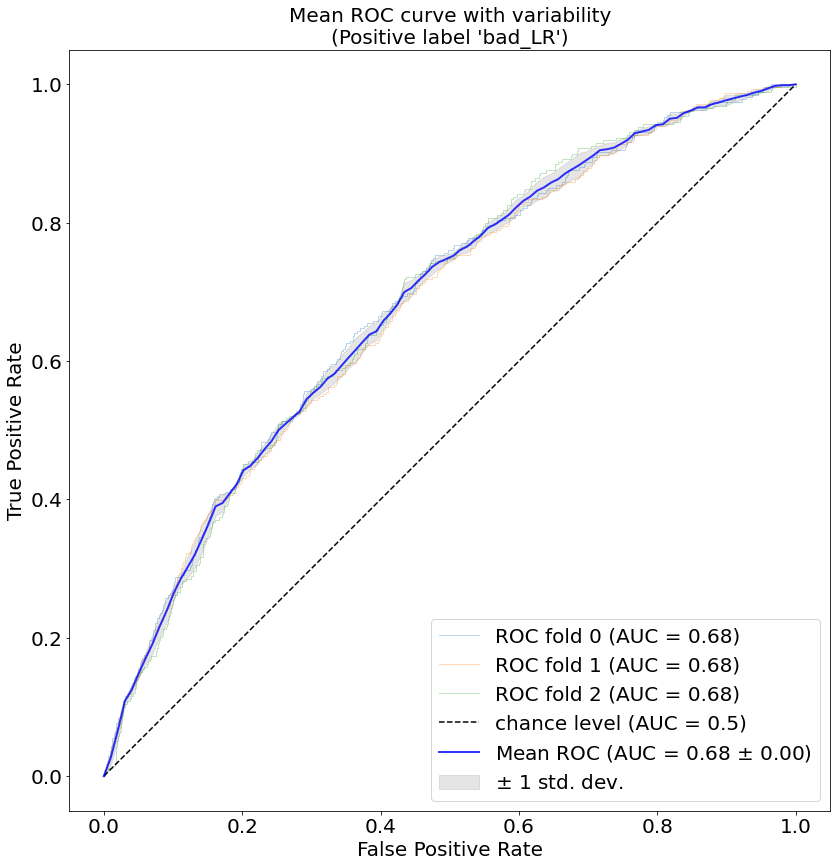

In [159]:
with open("LRv6_best_estimator_ND.pkl", 'rb') as file:
    log_reg = joblib.load(file)
    
roc_cv(train_df, X=X_train, y=y_train_labeled, classifier=log_reg, target='bad_LR', fontsize=20, filename="bad_lr_classifier_CV.png")

### confusion matricies

In [65]:
def confusion_cv(train_for_cv_df, X, y, classifier, fontsize, filename):
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    splitter_cv = gkf_cv.split(train_for_cv_df, y, groups=train_for_cv_df['policy_id'])
    
    y_pred = cross_val_predict(classifier, X, y, cv = splitter_cv)
    
    print(classification_report(y, y_pred))
    cm = confusion_matrix(y, y_pred, labels=classifier.classes_)
    
    sns.set(font_scale=1.5) # Adjust to fit
    sns.heatmap(cm, annot=True, cmap="Blues", fmt="g");
#     disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classifier.classes_)
#     disp.plot(cmap=plt.cm.Blues)
    plt.yticks(size= fontsize)
    plt.xticks(size = fontsize)
    plt.ylabel("True label", size = fontsize)
    plt.xlabel("Predicted label", size = fontsize)
    #plt.rcParams.update({'font.size': 16})
    plt.savefig(filename, bbox_inches='tight', dpi=300)
    plt.show()

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


              precision    recall  f1-score   support

           0       0.97      0.99      0.98     29144
           1       0.10      0.02      0.03       847

    accuracy                           0.97     29991
   macro avg       0.54      0.51      0.51     29991
weighted avg       0.95      0.97      0.96     29991



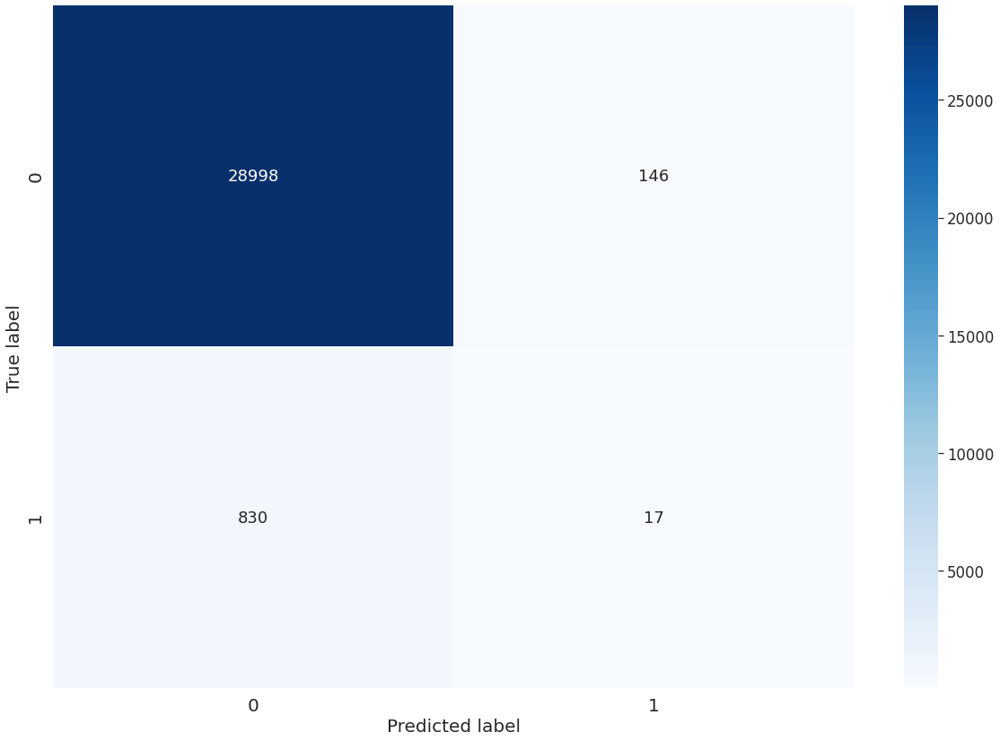

In [66]:
with open("LRv3_best_estimator_ND_weighted_removed2cols.pkl", 'rb') as file:
    log_reg = joblib.load(file)
    
confusion_cv(train_df, X_train, y_train, classifier=log_reg, fontsize=20, filename="confusion_cv_removed2cols.png")

### lift plot of calibrated model

In [147]:
def plot_lift(y_real, y_proba,  fontsize, color = 'b', title = 'Lift Curve'):
    # Prepare the data
    aux_df = pd.DataFrame()
    aux_df['y_real'] = y_real
    aux_df['y_proba'] = y_proba
    # Sort by predicted probability
    aux_df = aux_df.sort_values('y_proba', ascending = False)
    # Find the total positive ratio of the whole dataset
    total_positive_ratio = sum(aux_df['y_real'] == 1) / aux_df.shape[0]
    # For each line of data, get the ratio of positives of the given subset and calculate the lift
    
    print(total_positive_ratio)
    lift_values = []
    for i in aux_df.index:
        threshold = aux_df.loc[i]['y_proba']
        subset = aux_df[aux_df['y_proba'] >= threshold]
        subset_positive_ratio = sum(subset['y_real'] == 1) / subset.shape[0]
        lift = subset_positive_ratio / total_positive_ratio
        lift_values.append(lift)
        
    # theoretical upper bound:
    theor_upper = 1.0/total_positive_ratio
    
    # theoretical lower bound:
    theor_lower = 1.0

    # Plot the lift curve
    plt.xlabel('Proportion of sample', fontsize=fontsize)
    plt.ylabel('Lift', fontsize=fontsize)
    plt.title(title, fontsize=fontsize)
    plt.xticks(size=fontsize)
    plt.yticks(size=fontsize)
    x_data = [x/len(lift_values) for x in range(len(lift_values))]
    plt.plot(x_data, lift_values, color = color, label='lift')
    plt.plot(x_data, [theor_upper] * len(lift_values), linestyle = 'dashed', lw=4, c='g', label='upper limit')
    plt.plot(x_data, [theor_lower] * len(lift_values), linestyle = 'dashed', lw=4, c='r', label='random selection')
    plt.legend(loc='best', fontsize=fontsize)
    plt.yscale('log')
    #ax.axhline(1, color = 'gray', linestyle = 'dashed', linewidth = 3)

0.029409476386835758


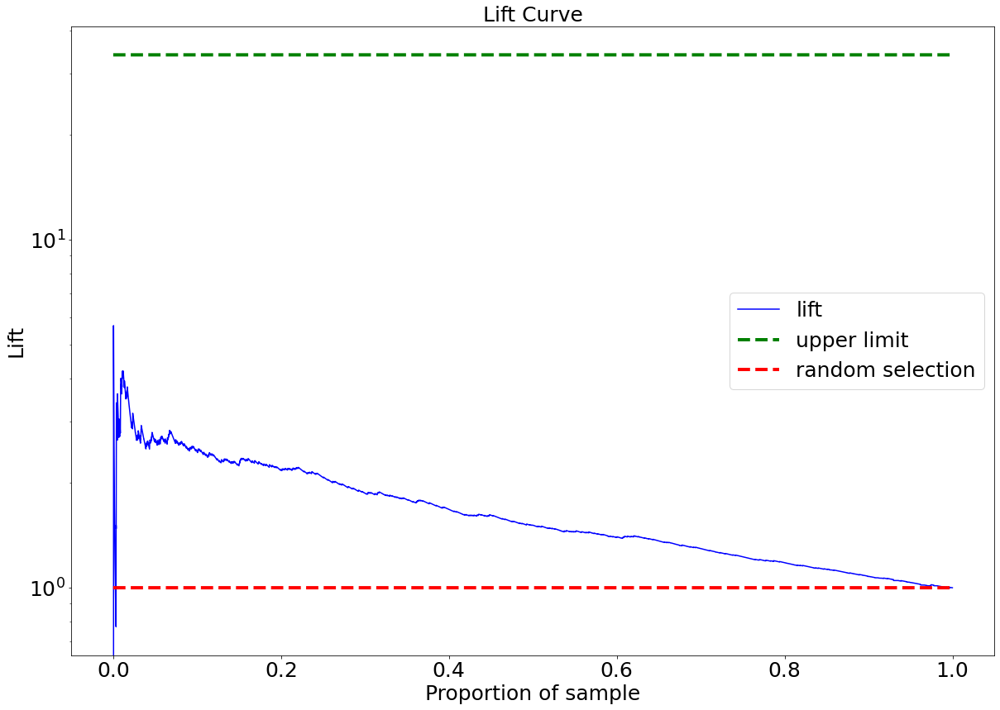

In [153]:
with open("HGBTv1_best_estimator_classifier_ND.pkl", 'rb') as file:
    log_reg = joblib.load(file)
    
y_prob_predict = log_reg.predict_proba(X_test)[:, -1]
plot_lift(y_test_labeled, y_prob_predict, fontsize=25)

### permutation feature importances

In [155]:
# This is the best performing model 
with open("LRv6_best_estimator_ND.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

feature_names = best_clss_model.named_steps["encode"].transformers_[0][2]  + best_clss_model.named_steps["encode"].transformers_[1][2]

perm = permutation_importance(best_clss_model, X_test.loc[:, feature_names], y_test_labeled, n_repeats = 50, scoring="roc_auc", n_jobs=-1)

In [85]:
top_x = 20
perm_idx_sorted = perm.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

NameError: name 'perm' is not defined

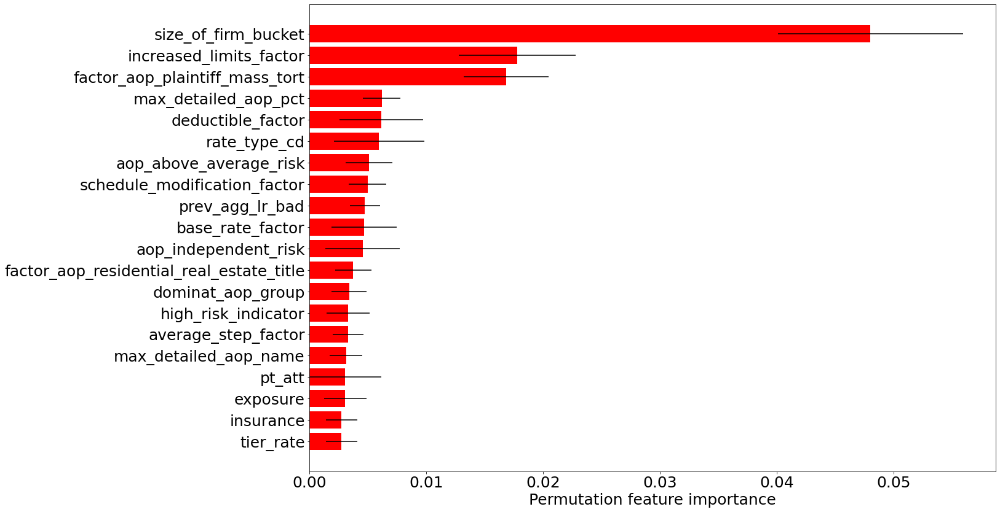

In [157]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_LR_classification.png", dpi=300, bbox_inches='tight')
plt.show()

### SHAP feature importances

In [635]:
# This is the best performing model 
with open("LRv6_best_estimator_ND.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

#feature_names = best_clss_model.named_steps["encode"].transformers_[0][2]  + best_clss_model.named_steps["encode"].transformers_[1][2]
#feature_names = best_clss_model.named_steps["encode"].get_feature_names_out()
X_shap = Pipeline(best_clss_model.steps[:-1]).transform(X_test)
pred = best_clss_model.named_steps["LR"].predict(X_shap)
print(pred)
masker = shap.maskers.Independent(data=X_shap)
explainer = shap.Explainer(best_clss_model.named_steps["LR"], X_shap, masker)
shap_values = explainer.shap_values(X_shap)
np.abs(shap_values.sum(1) + explainer.expected_value - pred).max()

# main_effect_shap_values = Pipeline(best_clss_model.steps[:-1]).coef_ * (X_shap - X_shap.mean(0))
# print(np.linalg.norm(shap_values - main_effect_shap_values))
# X_shap = Pipeline(xgb_search.best_estimator_.steps[:-1]).transform(X_train)
# pred = xgb_search.best_estimator_.named_steps["XGBoost"].predict(X_shap, output_margin=True)
# explainer = shap.TreeExplainer(xgb_search.best_estimator_.named_steps["XGBoost"])
# shap_values = explainer.shap_values(X_shap)
# np.abs(shap_values.sum(1) + explainer.expected_value - pred).max()

[0 0 0 ... 0 0 0]


7.900782744944415

In [601]:
print(shap_values.shape)
print(X_shap.shape)

(12853, 270)
(12853, 270)


(12853, 270)


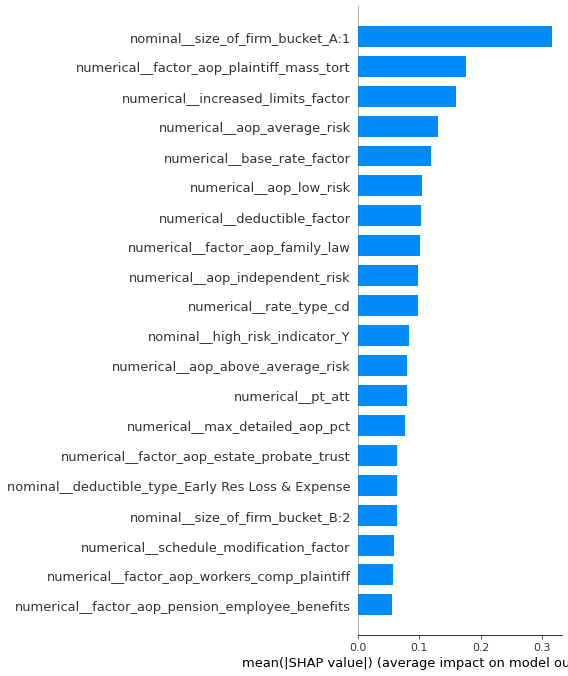

In [133]:
print(shap_values.shape)
feature_names_encoded = best_clss_model.named_steps["encode"].get_feature_names_out()
shap.summary_plot(shap_values, plot_type='bar', feature_names = feature_names_encoded, show=False, plot_size='auto')
#plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "SHAP_importance_allfeatures.png", dpi=300, bbox_inches='tight')

[[-0.10793805926373645 -0.01447481755928915 -5.4653620485347286e-05 ...
  -0.12296748789281768 0.0 -0.0]
 [-0.10793805926373645 -0.01447481755928915 -5.4653620485347286e-05 ...
  -0.0 0.0 -0.0]
 [-0.010123778100404823 -4.329456897095436e-05 -5.4653620485347286e-05
  ... -0.0 0.0 -0.0]
 ...
 [-0.010123778100404823 -4.329456897095436e-05 -5.4653620485347286e-05
  ... -0.0 0.0 -0.0]
 [-0.04272853848818203 -0.004853802232410354 -5.4653620485347286e-05 ...
  -0.0 0.0 -0.0]
 [-0.10793805926373645 -0.01447481755928915 -5.4653620485347286e-05 ...
  -0.12296748789281768 0.0 -0.0]]
{0.0, 1.0}
{-0.0}


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


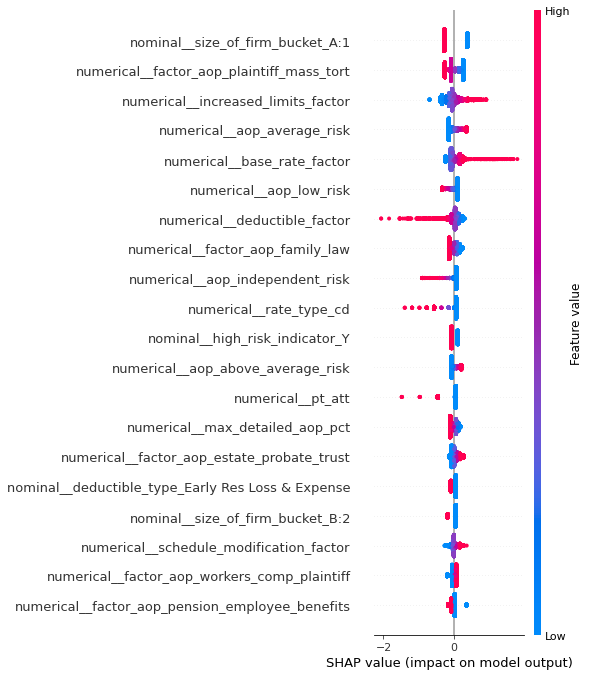

In [510]:
feature_names_encoded = best_clss_model.named_steps["encode"].get_feature_names_out()
print(shap_values)
print(set(X_shap[:, -1]))
print(set(shap_values[:, -1]))
#print(feature_names_encoded)
shap.summary_plot(shap_values.astype(np.double), X_shap, max_display=20, feature_names = feature_names_encoded, show=False)
plt.savefig("SHAP_beeswarm_LR.png", dpi=300, bbox_inches='tight')

Computing SHAP interaction values explicitly (will be necessary for dependence plots to pick which feature has the highest interaction)

In [625]:
shap_interaction_values = explainer.shap_interaction_values(X_shap)

shap.summary_plot(shap_interaction_values, X_shap)

AttributeError: 'Linear' object has no attribute 'shap_interaction_values'

SHAP dependence plots of top 5 features (by permutation importance)

In [606]:
print(len(feature_names_encoded))
print(X_shap.shape)

270
(12853, 270)


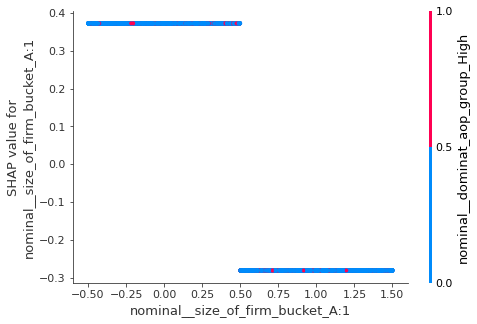

In [624]:
shap.dependence_plot("nominal__size_of_firm_bucket_A:1", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=1.0)

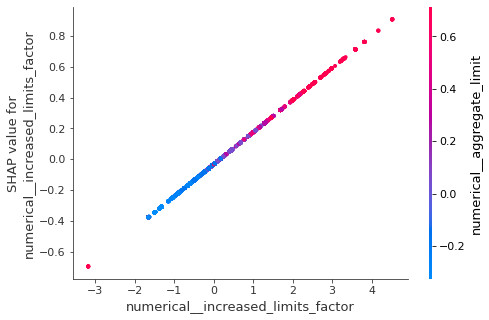

In [623]:
shap.dependence_plot("numerical__increased_limits_factor", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=1.0)

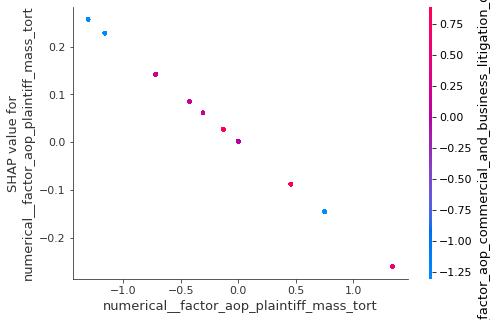

In [613]:
shap.dependence_plot("numerical__factor_aop_plaintiff_mass_tort", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded)

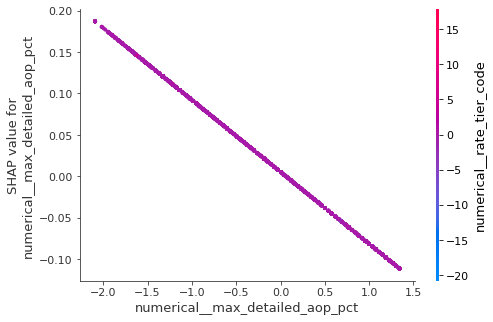

In [614]:
shap.dependence_plot("numerical__max_detailed_aop_pct", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded)

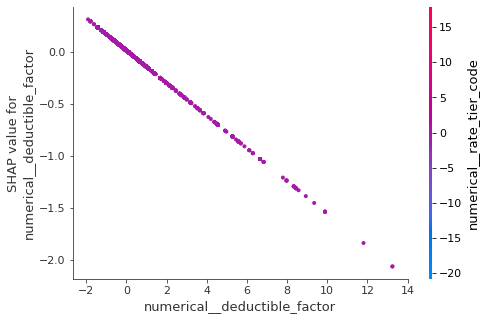

In [621]:
shap.dependence_plot("numerical__deductible_factor", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=0.5)

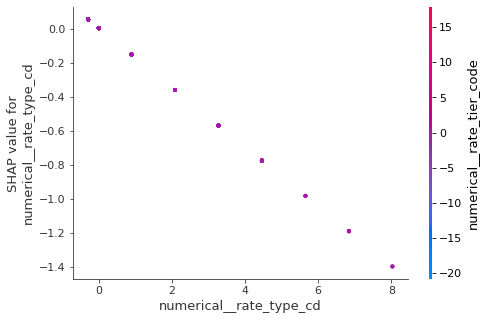

In [620]:
shap.dependence_plot("numerical__rate_type_cd", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded)

### adding random noise

In [500]:
X_train_addnoise = X_train.copy()
X_test_addnoise = X_test.copy()

# uniform noise for train/test
X_train_addnoise["rand_uniform"] = np.random.uniform(-1, 1, X_train.shape[0])
X_test_addnoise["rand_uniform"] = np.random.uniform(-1, 1, X_test.shape[0])

# normal sampling for train/test 
X_train_addnoise["rand_norm"] = np.random.normal(0, 1, size=X_train.shape[0])
X_test_addnoise["rand_norm"] = np.random.normal(0, 1, size=X_test.shape[0])

training logistic with the best hyperparameters from before:

In [ ]:
lr_clf = LogisticRegression(random_state = 42, C = 0.1, penalty = "elasticnet", l1_ratio = 0.3, n_jobs = 1, solver='saga', max_iter=8000)

# imputation/encoding of features
ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

numerical_fill = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
)

categorical_fill = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
)


fillna_transform = ColumnTransformer(
    transformers=[
        ("numerical", numerical_fill, numerical_to_keep + ["rand_uniform", "rand_norm"]),
        ("nominal", categorical_fill, nominal_to_keep)
    ])

encode_transform = ColumnTransformer(
    transformers=[
        ("numerical", 'passthrough', numerical_to_keep + ["rand_uniform", "rand_norm"]),
        ("nominal", ohe, nominal_to_keep)
    ])

columns_after_fill = numerical_to_keep + ["rand_uniform", "rand_norm"] + nominal_to_keep
pipe = imbpipe.Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), ("encode", encode_transform), ("LR", lr_clf)])

pipe.fit(X_train_addnoise, y_train_labeled)

joblib.dump(pipe, "LRv6_best_estimator_ND_addednoise.pkl")

#### permutation importance with this noise

In [501]:
# This is the best performing model 
with open("LRv6_best_estimator_ND_addednoise.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

feature_names = best_clss_model.named_steps["encode"].transformers_[0][2]  + best_clss_model.named_steps["encode"].transformers_[1][2]

perm = permutation_importance(best_clss_model, X_test_addnoise.loc[:, feature_names], y_test_labeled, n_repeats = 50, scoring="roc_auc", n_jobs=-1)

In [502]:
top_x = 20
perm_idx_sorted = perm.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

['size_of_firm_bucket', 'increased_limits_factor', 'factor_aop_plaintiff_mass_tort', 'deductible_factor', 'max_detailed_aop_pct', 'rate_type_cd', 'schedule_modification_factor', 'prev_agg_lr_bad', 'aop_above_average_risk', 'aop_independent_risk', 'high_risk_indicator', 'average_step_factor', 'dominat_aop_group', 'base_rate_factor', 'factor_aop_residential_real_estate_title', 'pt_att', 'max_detailed_aop_name', 'tier_rate', 'aop_low_risk', 'exposure']
['size_of_firm_bucket', 'increased_limits_factor', 'factor_aop_plaintiff_mass_tort', 'deductible_factor', 'max_detailed_aop_pct', 'rate_type_cd', 'schedule_modification_factor', 'prev_agg_lr_bad', 'aop_above_average_risk', 'aop_independent_risk', 'high_risk_indicator', 'average_step_factor', 'dominat_aop_group', 'base_rate_factor', 'factor_aop_residential_real_estate_title', 'pt_att', 'max_detailed_aop_name', 'tier_rate', 'aop_low_risk', 'exposure', 'insurance', 'experience_modification_factor', 'prev_auto_renewal_std', 'max_detailed_aop', 

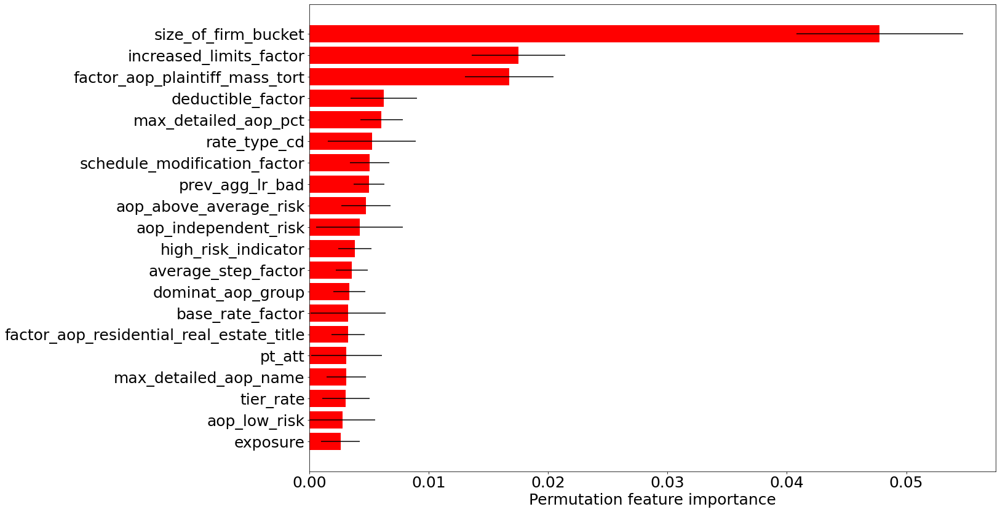

In [503]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_LR_classification_withnoise.png", dpi=300, bbox_inches='tight')
plt.show()

## XGB

In [90]:
def XGB_classification_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    xgb_clf = xgb.XGBClassifier(n_jobs=6, use_label_encoder=False, tree_method='hist')
    
    start = time.time()
    
    param_grid = {
    'XGBoost__n_estimators': [10, 50, 100, 200, 300],
    'XGBoost__max_depth': [2, 3, 4, 5, 6],
    'XGBoost__gamma': [0.01, 0.1, 1, 10, 100, 200],
    'XGBoost__colsample_bytree': [0.2, 0.5, 1.0],
    'XGBoost__subsample': [0.2, 0.5],
    'XGBoost__eta': [0.01, 0.1, 0.2, 0.5],
    'XGBoost__min_child_weight': [1, 2, 5, 10],
    #'XGBoost__scale_pos_weight': [25, 30 ,35],
    'XGBoost__max_delta_step':[0, 1, 5, 10]
    }
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), ("XGBoost", xgb_clf)])

    xgb_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    xgb_search.fit(X_train, y_train)
    
    results = pd.DataFrame(xgb_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return xgb_search

def XGB_classification_specific(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    xgb_clf = xgb.XGBClassifier(n_jobs=6, use_label_encoder=False, tree_method='hist')
    
    start = time.time()

    param_grid = {
    'XGBoost__n_estimators': [50],
    'XGBoost__max_depth': [2],
    'XGBoost__gamma': [0.01],
    'XGBoost__colsample_bytree': [0.2],
    'XGBoost__subsample': [0.5],
    'XGBoost__eta': [0.1],
    'XGBoost__min_child_weight': [5],
    #'XGBoost__scale_pos_weight': [25, 30 ,35],
    'XGBoost__max_delta_step':[0]
    }
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), ("XGBoost", xgb_clf)])

    xgb_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    xgb_search.fit(X_train, y_train)
    
    results = pd.DataFrame(xgb_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return xgb_search

In [214]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1000, scorer='roc_auc',
                          name_for_model= "XGBv1_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v1 (XGBv1_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 1000 candidates, totalling 3000 fits


A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.


[21:22:16] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
RangeIndex(start=0, stop=1000, step=1)
                                         description  \
0  XGB classification v1 (XGBv1_best_estimator_cl...   
1  XGB classification v1 (XGBv1_best_estimator_cl...   
2  XGB classification v1 (XGBv1_best_estimator_cl...   
3  XGB classification v1 (XGBv1_best_estimator_cl...   
4  XGB classification v1 (XGBv1_best_estimator_cl...   

                                              params  split0_test_score  \
0  {'XGBoost__subsample': 0.2, 'XGBoost__n_estima...           0.500000   
1  {'XGBoost__subsample': 0.5, 'XGBoost__n_estima...           0.500000   
2  {'XGBoost__subsample': 0.5, 'XGBoost__n_estima...           0.583160   
3  {'XGBoost__subsample': 0.2, 'XGBoost__n_estima...           0.500000 

In [668]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=100, scorer='roc_auc',
                          name_for_model= "XGBv2_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v2, reduced complexity (XGBv2_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[22:29:27] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time elapsed (in Sec): 226.23419189453125


In [670]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=100, scorer='roc_auc',
                          name_for_model= "XGBv3_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v3 (XGBv3_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[22:34:59] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time elapsed (in Sec): 243.48635506629944


In [86]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=100, scorer='roc_auc',
                          name_for_model= "XGBv4_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v4, removed size_of_firm (XGBv4_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[22:41:11] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time elapsed (in Sec): 250.23910641670227


In [87]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=100, scorer='roc_auc',
                          name_for_model= "XGBv5_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v5, removed size_of_firm (XGBv5_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[22:45:33] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time elapsed (in Sec): 178.08546495437622


In [88]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=100, scorer='roc_auc',
                          name_for_model= "XGBv6_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v6, removed size_of_firm (XGBv6_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
[22:48:35] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time elapsed (in Sec): 178.78691172599792


In [ ]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=500, scorer='roc_auc',
                          name_for_model= "XGBv7_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v7, removed size_of_firm (XGBv7_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


In [ ]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=500, scorer='roc_auc',
                          name_for_model= "XGBv8_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v8, removed size_of_firm (XGBv8_best_estimator_classifier_ND.pkl)")

[autoreload of pandas._config.config failed: Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/usr/local/lib/python3.8/dist-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/usr/local/lib/python3.8/dist-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/usr/local/lib/python3.8/dist-packages/IPython/extensions/autoreload.py", line 317, in update_class
    update_instances(old, new)
  File "/usr/local/lib/python3.8/dist-packages/IPython/extensions/autoreload.py", line 280, in update_instances
    ref.__class__ = new
  File "/home/s6nm7s/.local/lib/python3.8/site-packages/pandas/_config/config.py", line 198, in __setattr__
    raise OptionError("You can only set the value of existing options")
pandas._config.config.OptionError: 'You can only

In [174]:
XGB_search_clss = XGB_classification_specific(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1, scorer='roc_auc',
                          name_for_model= "XGBv9_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v9, removed size_of_firm (XGBv9_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 1 candidates, totalling 3 fits
[17:57:06] WARNING: ../src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time elapsed (in Sec): 54.831576108932495


In [91]:
XGB_search_clss = XGB_classification_specific(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1, scorer='roc_auc',
                          name_for_model= "XGBv14_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v1, removed size_of_firm + max_detailed_aop_name (XGBv14_best_estimator_classifier_ND.pkl)")

`use_label_encoder` is deprecated in 1.7.0.


Fitting 3 folds for each of 1 candidates, totalling 3 fits


`use_label_encoder` is deprecated in 1.7.0.


Time elapsed (in Sec): 50.761462926864624


In [92]:
subset = ['size_of_firm_factor', 'experience_modification_factor', 'exposure', 'prev_lr_bad_proportion', 'aop_above_average_risk', 'max_detailed_aop', 'policy_type', 'schedule_modification_factor', 'aop_low_risk', 'risk_category', 'max_detailed_aop_pct', 'producer_name']

XGB_search_clss = XGB_classification_specific(train_df, X_train, y_train_labeled, feature_subset = subset, n_iterations=1, scorer='roc_auc',
                          name_for_model= "XGBv12_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                           description = "XGB classification v12, truncated to top x features (XGBv12_best_estimator_classifier_ND.pkl)")

`use_label_encoder` is deprecated in 1.7.0.


Fitting 3 folds for each of 1 candidates, totalling 3 fits


`use_label_encoder` is deprecated in 1.7.0.


Time elapsed (in Sec): 45.94286751747131


In [92]:
XGB_search_clss = XGB_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=500, scorer='roc_auc',
                          name_for_model= "XGBv13_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "XGB classification v13, removed size_of_firm (XGBv13_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


`use_label_encoder` is deprecated in 1.7.0.


Time elapsed (in Sec): 769.2775874137878


### permutation feature importances

In [319]:
# This is the best performing model with low complexity
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

feature_names = best_clss_model.named_steps["encoding"].transformers_[0][2]  + best_clss_model.named_steps["encoding"].transformers_[1][2]

perm_xgb = permutation_importance(best_clss_model, X_test.loc[:, feature_names], y_test_labeled, n_repeats = 50, scoring="roc_auc", n_jobs=-1)

In [90]:
top_x = 20
perm_idx_sorted = perm_xgb.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm_xgb.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'not_greater_financial_crisis', 'risk_category', 'rate_type_cd', 'schedule_modification_factor', 'max_detailed_aop_pct', 'prev_lr_bad_proportion', 'aop_above_average_risk', 'rule_2_total', 'aop_average_risk', 'rule_3_total', 'policy_type', 'prev_auto_renewal_mean', 'prev_agg_lr_bad', 'non_discretionary_modification_factor', 'aop_high_risk', 'prev_lr_avg_3', 'factor_aop_personal_injury_and_negligence_plaintiff']
['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'not_greater_financial_crisis', 'risk_category', 'rate_type_cd', 'schedule_modification_factor', 'max_detailed_aop_pct', 'prev_lr_bad_proportion', 'aop_above_average_risk', 'rule_2_total', 'aop_average_risk', 'rule_3_total', 'policy_type', 'prev_auto_renewal_mean', 'prev_agg_lr_bad', 'non_discretionary_modification_factor', 'aop_high_risk', 'prev_lr_avg_3', 'factor_aop_personal_injury_and_negligence_plaintiff', 'increased_limits_factor', 'pr

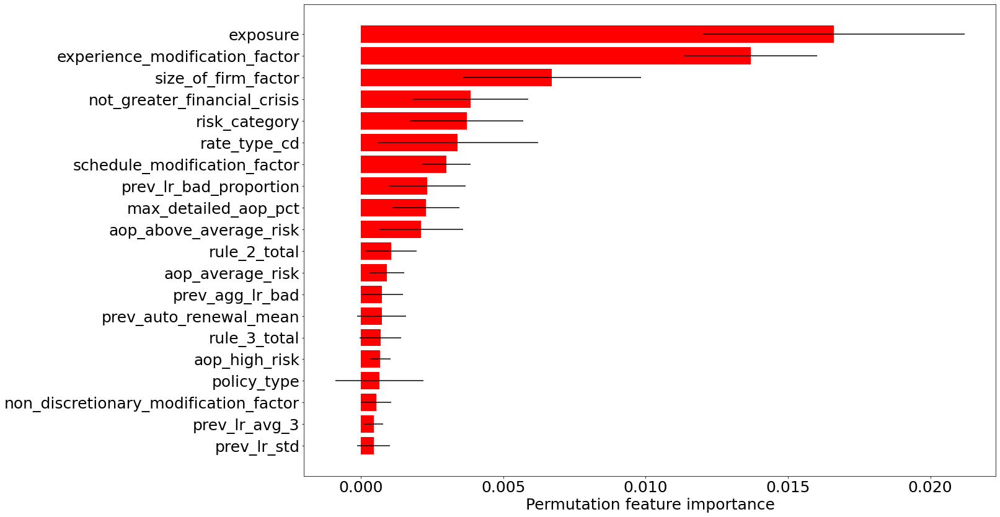

In [551]:
plt.clf()
%matplotlib inline
plt.rcParams["figure.figsize"]=20,14
textsize = 25
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm_xgb.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm_xgb.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_XGB_classification.png", dpi=300, bbox_inches='tight')
plt.show()

In [173]:
preprocess_df[["not_greater_financial_crisis"]].value_counts()

not_greater_financial_crisis
1.0000                          11389
0.0000                           4918
0.9500                           1479
0.9000                           1463
0.5000                           1141
                                ...  
0.5734                              1
0.5730                              1
0.5720                              1
0.5712                              1
0.5029                              1
Name: count, Length: 854, dtype: int64

### SHAP importance

In [92]:
# This is the best performing model 
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

X_shap = Pipeline(best_clss_model.steps[:-1]).transform(X_test)
pred = best_clss_model.named_steps["XGBoost"].predict_proba(X_shap)[:, 1]
print(pred)
#explainer = shap.TreeExplainer(best_clss_model.named_steps["XGBoost"], X_shap, masker)
# explainer = shap.TreeExplainer(best_clss_model.named_steps["XGBoost"], 
#                                model_output="raw",
#                                feature_perturbation="tree_path_dependent")

explainer = shap.TreeExplainer(best_clss_model.named_steps["XGBoost"])
shap_values = explainer.shap_values(X_shap, y_test_labeled)#, check_additivity=True)
#np.abs(shap_values.sum(1) + explainer.expected_value - pred).max()

[0.078775   0.08186746 0.04575985 ... 0.03837798 0.04290476 0.05606051]


In [233]:
[i for i in range(len(X_test.columns)) if X_test.columns[i] == "exposure"]

[17]

In [250]:
[i for i in range(len(feature_names_encoded)) if feature_names_encoded[i] == "numerical__exposure"]

[4]

[[ 0.062486    0.0202273  -0.00177093 ...  0.          0.
   0.        ]
 [ 0.062486    0.07047546 -0.00177093 ...  0.          0.
   0.        ]
 [ 0.02165313  0.07047546 -0.00240928 ...  0.          0.
   0.        ]
 ...
 [ 0.00945085  0.05349082 -0.00240928 ...  0.          0.
   0.        ]
 [ 0.02165313  0.05349082 -0.00433734 ...  0.          0.
   0.        ]
 [ 0.062486    0.05349082 -0.00433734 ...  0.          0.
   0.        ]]
{0.0, 1.0}
{0.0}


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


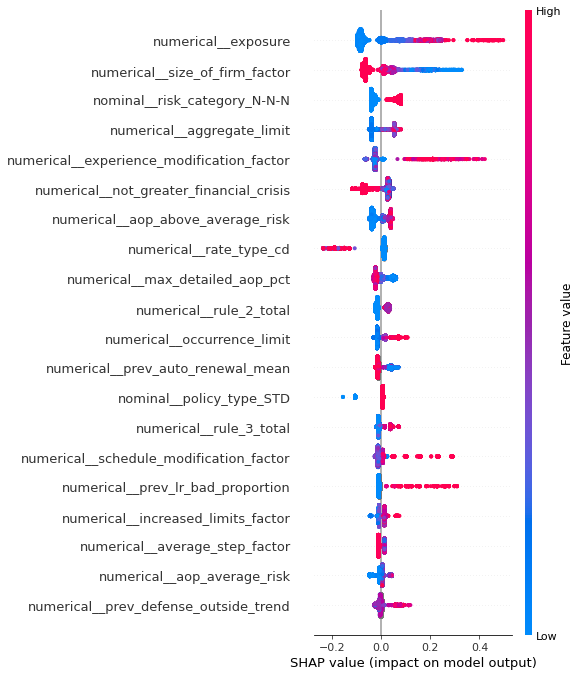

In [96]:
feature_names_encoded = best_clss_model.named_steps["encoding"].get_feature_names_out()
print(shap_values)
print(set(X_shap[:, -1]))
print(set(shap_values[:, -1]))
#print(feature_names_encoded)
shap.summary_plot(shap_values.astype(np.double), X_shap, max_display=20, feature_names = feature_names_encoded, show=False)
plt.savefig("SHAP_beeswarm_XGB.png", dpi=300, bbox_inches='tight')

In [116]:
shap_values.shape

(12853, 262)

Computing SHAP interaction values explicitly (will be necessary for dependence plots to pick which feature has the highest interaction)

(816216912,)
-0.18700686
0.43877512


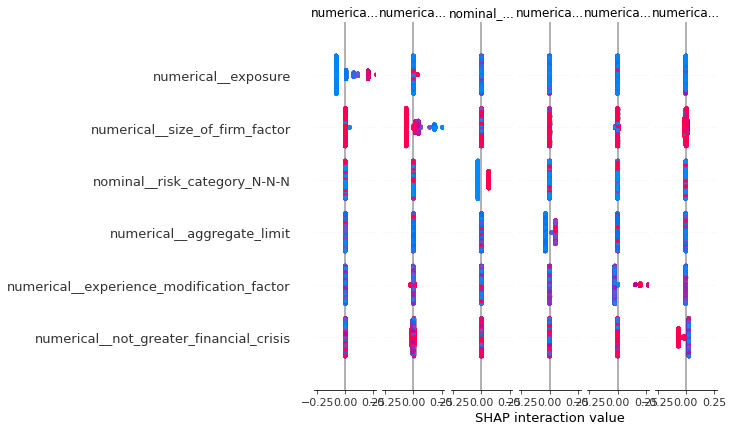

In [97]:
shap_interaction_values = explainer.shap_interaction_values(X_shap)

shap.summary_plot(shap_interaction_values.astype(np.double), X_shap, max_display=6, feature_names = feature_names_encoded, show=False)

print(shap_interaction_values.ravel().shape)
print(min(shap_interaction_values.ravel()))
print(max(shap_interaction_values.ravel()))

In [102]:
print(shap_interaction_values.shape)

(12853, 252, 252)


In [93]:
def get_shap_interaction_magnitudes(shap_interactions, feature_names):
    
    abs_mean_shap_inter = np.triu(abs(shap_interactions).mean(axis=0), k=1)
    max_interaction = abs_mean_shap_inter.max(axis=0)
    
    zero_interactions_idx = np.where(max_interaction == 0)
    max_interaction_fnames = feature_names[np.argmax(abs_mean_shap_inter, axis=0)]
    max_interaction_fnames[zero_interactions_idx] = None
    
    return dict(zip(feature_names, zip(max_interaction_fnames, max_interaction)))
#         return max_interaction_fname, abs_mean_max_shap_int[target_feature_idx]

In [98]:
interaction_magnitudes = get_shap_interaction_magnitudes(shap_interaction_values, feature_names_encoded)

In [557]:
{k: v for k, v in sorted(interaction_magnitudes.items(), key=lambda item: item[1][1], reverse=True)}


{'numerical__aop_average_risk': ('numerical__exposure', 0.00679821),
 'numerical__prev_auto_renewal_trend': ('numerical__exposure', 0.00497893),
 'nominal__risk_category_N-N-N': ('numerical__aop_above_average_risk',
  0.0039786054),
 'numerical__size_of_firm_factor': ('numerical__not_greater_financial_crisis',
  0.003914038),
 'numerical__schedule_modification_factor': ('numerical__experience_modification_factor',
  0.0037920692),
 'numerical__max_detailed_aop_pct': ('numerical__rule_2_total', 0.0032673657),
 'numerical__prev_defense_outside_trend': ('numerical__max_detailed_aop_pct',
  0.0031400833),
 'numerical__prev_lr_avg_1': ('numerical__rule_3_total', 0.003046363),
 'numerical__aop_above_average_risk': ('numerical__rule_3_multiple_dabbler',
  0.0029315194),
 'numerical__rate_type_cd': ('numerical__size_of_firm_factor', 0.002780971),
 'numerical__prev_max_aop_consistency': ('numerical__size_of_firm_factor',
  0.002195942),
 'numerical__prev_lr_avg_3': ('numerical__edition', 0.0020

In [109]:
interaction_magnitudes["numerical__exposure"]

(None, 0.0)

#### SHAP interaction plots of top 10 features (by permutation importance).

numerical__experience_modification_factor ('numerical__occurrence_limit', 0.0008660544)


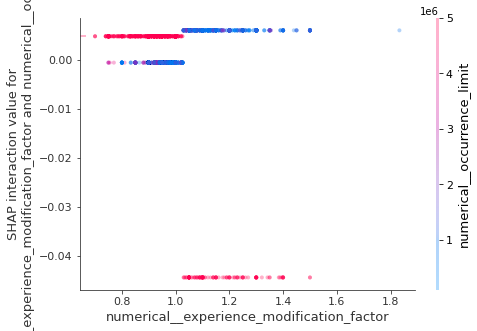

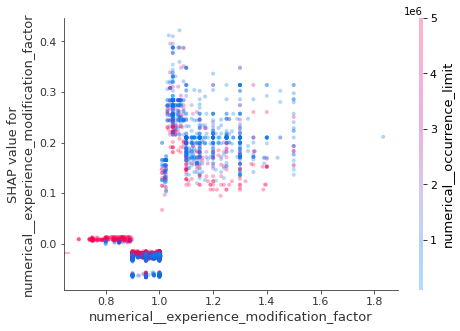

numerical__size_of_firm_factor ('numerical__not_greater_financial_crisis', 0.003914038)


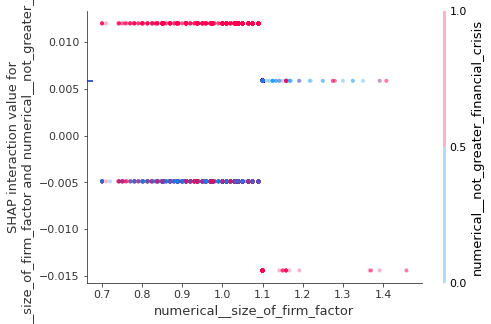

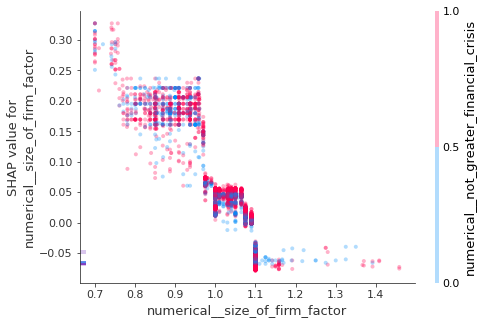

numerical__rate_type_cd ('numerical__size_of_firm_factor', 0.002780971)


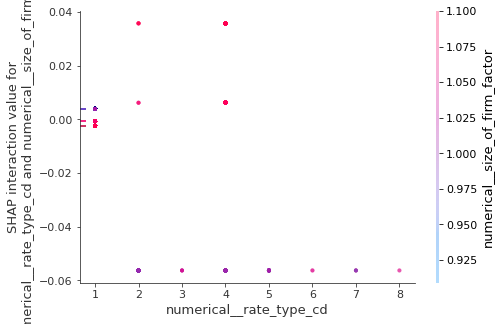

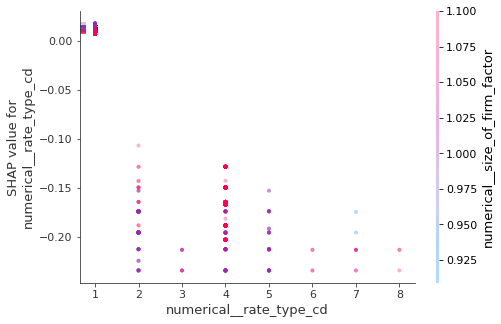

numerical__schedule_modification_factor ('numerical__experience_modification_factor', 0.0037920692)


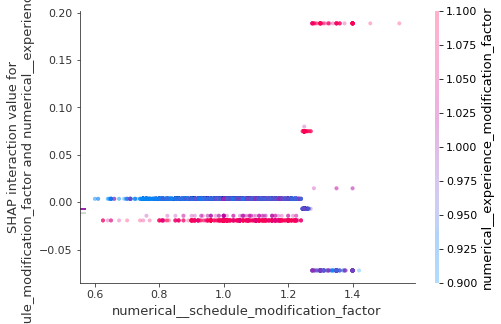

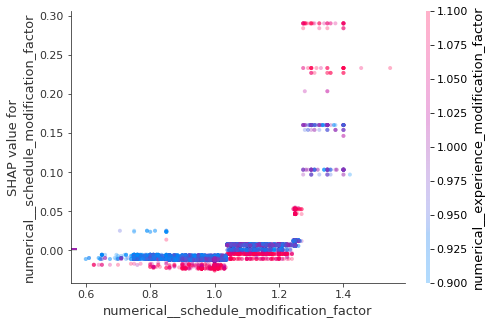

numerical__max_detailed_aop_pct ('numerical__rule_2_total', 0.0032673657)


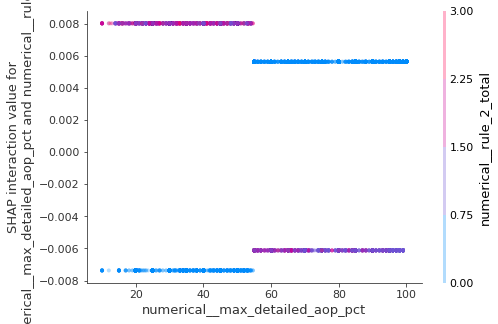

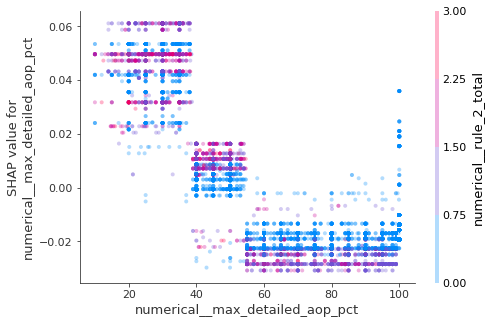

numerical__prev_lr_bad_proportion ('numerical__rule_3_total', 0.0010941172)


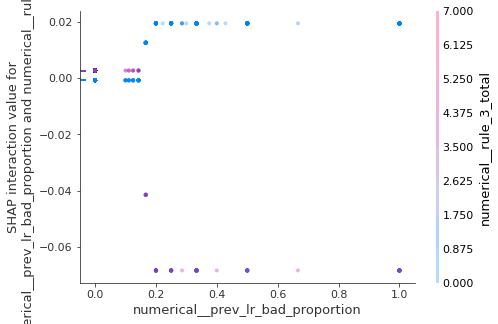

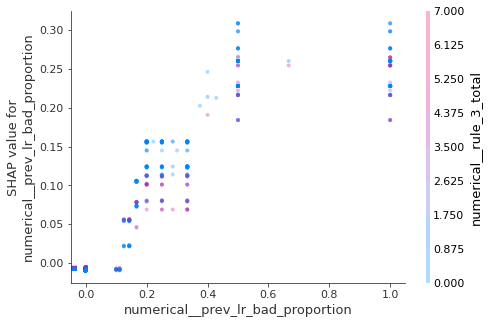

numerical__aop_above_average_risk ('numerical__rule_3_multiple_dabbler', 0.0029315194)


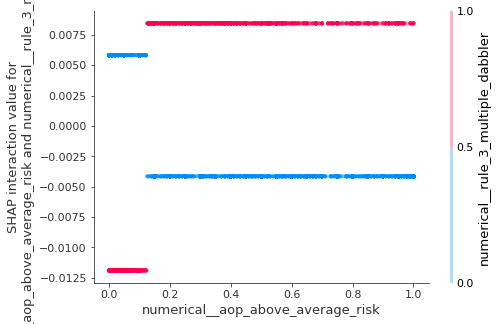

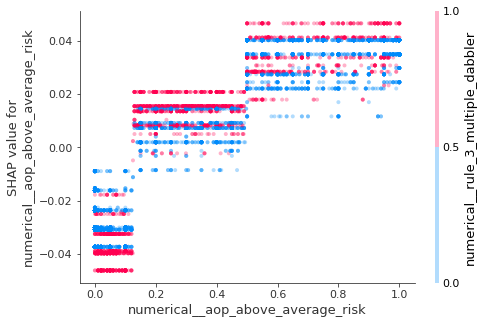

In [108]:
top_10 = perm_importance_top[0:10]
top_10 = [ele for ele in top_10 if "risk_category" not in ele]
#print(top_10)
for feat in top_10:
    if preprocess_df[feat].dtype in numerical_dtypes:  
        prefix = "numerical__"
    else:
        prefix = "nominal__"
        
    feat_name = prefix + feat
    interaction_tuple = interaction_magnitudes[feat_name]

    if interaction_tuple[0]:
        print(feat_name, interaction_tuple)
        
        shap.dependence_plot((feat_name, interaction_tuple[0]), shap_interaction_values, X_shap, feature_names=feature_names_encoded, x_jitter=0, alpha = 0.3)
        shap.dependence_plot(feat_name, shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = interaction_tuple[0], x_jitter=0, alpha = 0.3)

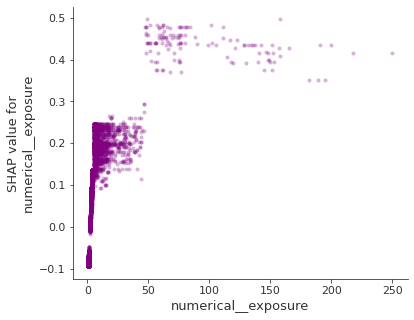

In [103]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, interaction_index=None, 
                     feature_names=feature_names_encoded, x_jitter=0, alpha = 0.3, color='purple')

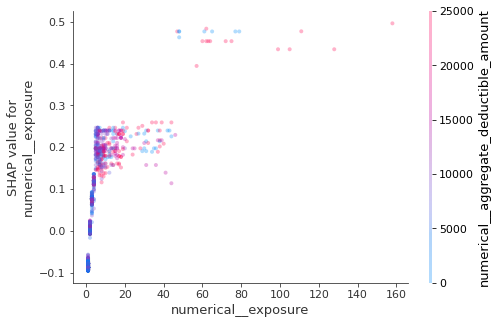

In [112]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, interaction_index="numerical__aggregate_deductible_amount", 
                     feature_names=feature_names_encoded, x_jitter=0, alpha = 0.3)

In [261]:
shap_values.shape

(12853, 252)

In [262]:
X_shap.shape

(12853, 252)

In [264]:
X_test.shape

(12853, 165)

In [110]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='purple')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "TOPSHAP_NOINTERACTION" + "nominal_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: <object object at 0x7fe85477cd60>


In [111]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

In [251]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__schedule_modification_factor", shap_values, X_shap, feature_names=feature_names_encoded, 
                     interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "TOPSHAP_NOINTERACTION" + "schedule_modification_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [252]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

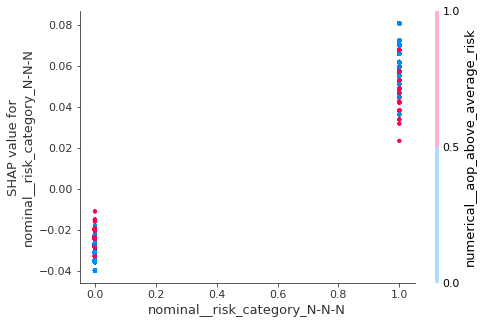

In [693]:
shap.dependence_plot("nominal__risk_category_N-N-N", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = interaction_magnitudes["nominal__risk_category_N-N-N"][0], x_jitter=0, alpha = 0.3)

In [698]:
%matplotlib auto
plt.clf()
shap.dependence_plot("nominal__risk_category_N-N-N", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = interaction_magnitudes["nominal__risk_category_N-N-N"][0], x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "TOPSHAP_interaction_v2" + "nominal_risk_category" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

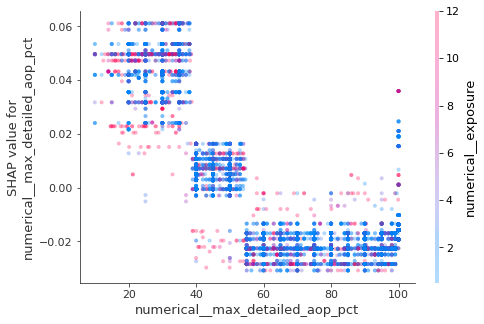

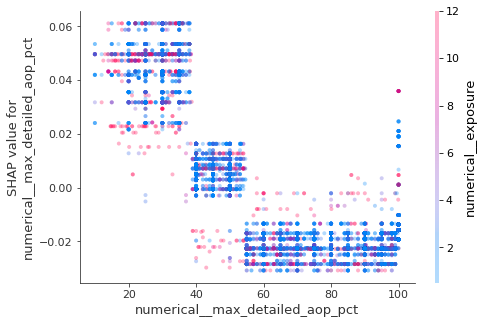

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

In [275]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

Saving them:

In [679]:
%matplotlib auto
plt.clf()

for i, feat in enumerate(top_10):
    if preprocess_df[feat].dtype in numerical_dtypes:  
        prefix = "numerical__"
    else:
        prefix = "nominal__"
        
    feat_name = prefix + feat
    interaction_tuple = interaction_magnitudes[feat_name]
    
    if interaction_tuple[0]:
        print(feat, interaction_tuple)
        
        shap.dependence_plot((feat_name, interaction_tuple[0]), shap_interaction_values, X_shap, feature_names=feature_names_encoded, x_jitter=0, alpha = 0.3)
        
        figure = plt.gcf()
        figure.savefig("EDA_investigation_figures"+ os.sep + "TOPSHAP_interaction_v2" + top_10[i] + ".png", dpi=300, bbox_inches='tight')
        plt.clf()
        
        shap.dependence_plot(feat_name, shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = interaction_tuple[0], x_jitter=0, alpha = 0.3)
        
        figure = plt.gcf()
        figure.savefig("EDA_investigation_figures"+ os.sep + "TOPSHAP_v2" + top_10[i] + ".png", dpi=300, bbox_inches='tight')
        plt.clf()

Using matplotlib backend: agg
experience_modification_factor ('numerical__occurrence_limit', 0.0008660544)
size_of_firm_factor ('numerical__not_greater_financial_crisis', 0.003914038)
rate_type_cd ('numerical__size_of_firm_factor', 0.002780971)
schedule_modification_factor ('numerical__experience_modification_factor', 0.0037920692)
prev_lr_bad_proportion ('numerical__rule_3_total', 0.0010941172)
max_detailed_aop_pct ('numerical__rule_2_total', 0.0032673657)
aop_above_average_risk ('numerical__rule_3_multiple_dabbler', 0.0029315194)


In [680]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

<Figure size 540x360 with 0 Axes>

#### Validating some of the interesting predictions:

In [333]:
def cumulative_ks_plot(low_mask, high_mask, df, save_name, target, low_label, high_label):
    
    purported_high = df[high_mask][target]
    purported_low = df[low_mask][target]

    KS = ks_2samp(purported_high, purported_low)[0]
    p_val = ks_2samp(purported_high, purported_low)[1]
    
    print(ks_2samp(purported_high, purported_low))
    print(purported_low.mean())
    print(purported_high.mean())

    x_low, counts_low = np.unique(purported_low, return_counts=True)
    cusum_low = np.cumsum(counts_low)

    x_high, counts_high = np.unique(purported_high, return_counts=True)
    cusum_high = np.cumsum(counts_high)

    #print(cusum / cusum[-1])
    fontsize=25
    plt.plot(x_low, cusum_low/cusum_low[-1], color='#1f77b4', label=low_label, lw=3)
    plt.plot(x_high, cusum_high/cusum_high[-1], color='#ff7f0e', label=high_label, lw=3)

    plt.plot([0.57] * 20, np.linspace(-1, 1.2, 20), color='r', ls='--', label='portfolio LR target')
    plt.xscale('log')
    plt.ylim(-0.05, 1.05)
    plt.title("Cumulative distributions of segmented LR \n (KS={:2.2}, pval={:2.2})".format(KS, p_val), fontsize=fontsize)
    plt.xlabel("Loss Ratios", fontsize=fontsize)
    plt.ylabel("Cumulative fraction of LRs",fontsize=fontsize)
    plt.xticks(size=fontsize)
    plt.yticks(size=fontsize)
    plt.legend(loc='best', fontsize=fontsize)

    plt.savefig("EDA_investigation_figures"+ os.sep + save_name, dpi=300, bbox_inches='tight')

    plt.show()

In [109]:
def high_low_confint_plot(low_mask, high_mask, df, save_name, target, low_label, high_label, threshold):
    
    purported_high = df[high_mask][target]
    purported_low = df[low_mask][target]

    print("low", purported_low.mean())
    print("high", purported_high.mean())

    # computing 'bad' policy fractions for high and low bins
    x_low, counts_low = np.unique(purported_low, return_counts=True)
    cusum_low = np.cumsum(counts_low)

    x_high, counts_high = np.unique(purported_high, return_counts=True)
    cusum_high = np.cumsum(counts_high)
    
    low_counts = cusum_low[np.where(np.array(sorted(x_low)) <= threshold)[0][-1]]
    low_total = cusum_low[-1]
    
    high_counts = cusum_high[np.where(np.array(sorted(x_high)) <= threshold)[0][-1]]
    high_total = cusum_high[-1]
    
    low_fraction = 1 - (low_counts/low_total)
    high_fraction = 1- (high_counts/high_total)
    
    low_fraction_bounds = proportion_confint(low_total - low_counts, low_total, alpha = 0.05)
    high_fraction_bounds = proportion_confint(high_total - high_counts, high_total, alpha = 0.05)
    
    # ------plotting---------
    fig, ax = plt.subplots(figsize=(20,14))
    fontsize=32
    x = [low_label + "\n" + "n={}".format(purported_low.shape[0]), high_label + "\n" + "n={}".format(purported_high.shape[0])]
    
    # line plot of global success fraction
    global_mean = preprocess_df[target].apply(lambda x: 1 if x > threshold else 0).mean()
    plt.plot([-0.5, 0, 1, 1.5] , [global_mean] * 4, label="global proportion of LRs above {}".format(threshold), linestyle = '--', color='k', lw=3)
    
    # line plot of local success fraction for just two bins
    plt.bar(x, [low_fraction, high_fraction], color=['#1f77b4', '#ff7f0e'])
    
    # plot 95% confidence interval around observed success fraction (using errorbar)
    yerr = [[abs(low_fraction - low_fraction_bounds[0]), abs(high_fraction - high_fraction_bounds[0])], 
                    [abs(low_fraction - low_fraction_bounds[1]), abs(high_fraction - high_fraction_bounds[1])]]
    
    plt.errorbar(x, [low_fraction, high_fraction], yerr = yerr, fmt='none', color='r', lw=3, label='95% confidence interval')
    
    plt.ylabel("Proportion of LRs above {}".format(threshold),fontsize=fontsize)
    
    plt.xticks(size=fontsize/1.1)
    plt.yticks(size=fontsize/1.1)
    plt.legend(loc='best', fontsize=fontsize)

    plt.savefig("EDA_investigation_figures"+ os.sep + save_name, dpi=300, bbox_inches='tight')

    plt.show()

In [106]:
def lr_box_plot(low_mask, high_mask, df, df_with_loss_premiums, save_name, target, low_label, high_label):
    
    purported_high = df[high_mask][target]
    purported_low = df[low_mask][target]

    print("low", purported_low.mean())
    print("high", purported_high.mean())

    sns_df = pd.concat([pd.DataFrame({'segment of data': ["high"]*len(purported_high), 'LRs': purported_high}), 
                    pd.DataFrame({'segment of data': ["low"]*len(purported_low), 'LRs': purported_low})], axis=0)
    
    # compute aggregate loss ratios
    df_with_loss_premiums.iloc[df[high_mask].index]

    high_mask_losses = df_with_loss_premiums.iloc[df[high_mask].index]["ultimate_loss_trended"]
    high_mask_premiums = df_with_loss_premiums.iloc[df[high_mask].index]["onlevel_premium"]

    low_mask_losses = df_with_loss_premiums.iloc[df[low_mask].index]["ultimate_loss_trended"]
    low_mask_premiums = df_with_loss_premiums.iloc[df[low_mask].index]["onlevel_premium"]
    
    # ------plotting---------
    fig, ax = plt.subplots(figsize=(20,14))
    fontsize=32
    x = [low_label + "\n" + "n={}".format(purported_low.shape[0]), high_label + "\n" + "n={}".format(purported_high.shape[0])]
    
    # box plot of individual loss ratios
    sns.boxplot(data = sns_df, x="segment of data", y="LRs", order=["low", "high"], showfliers=True)
    
    # add dashed lines indicating the aggregate loss ratio
    low_xrange = np.linspace(-0.4, 0.4, 10)
    high_xrange = np.linspace(0.6, 1.4, 10)
    low_agg_lr = np.sum(low_mask_losses)/np.sum(low_mask_premiums)
    high_agg_lr = np.sum(high_mask_losses)/np.sum(high_mask_premiums)
    
    plt.plot(low_xrange, [low_agg_lr] * len(low_xrange), color='#1f77b4', ls='--', label='Aggregate low LR')
    plt.plot(high_xrange, [high_agg_lr] * len(high_xrange), color='#ff7f0e', ls='--', label='Aggregate high LR')
    
#     plt.scatter([0, 1], [np.sum(low_mask_losses)/np.sum(low_mask_premiums), np.sum(high_mask_losses)/np.sum(high_mask_premiums)],
#             marker='*', color=['#1f77b4', '#ff7f0e'], s=45)
    
    plt.ylabel("Loss ratio", fontsize=fontsize)
    plt.xlabel("Segment of raw data", fontsize=fontsize)
    
    plt.xticks(size=fontsize/1.1)
    plt.yticks(size=fontsize/1.1)
    
    # set ylim to capture 2* max of quartiles (so that boxes are emphasized, not outliers)
    plt.ylim(0, max(low_agg_lr, high_agg_lr)*1.2)
    plt.legend(loc='best', fontsize=fontsize/1.2)
    plt.savefig("EDA_investigation_figures"+ os.sep + save_name, dpi=300, bbox_inches='tight')

    plt.show()

Note that the business requested insights to present both for old (2013 prior), and new (2014 upwards) policies. Below I extract the index where this occurs in a df that contains years, and then apply it to preprocess_df which has the same indicies:

In [321]:
old_policy_idx = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["effective_year"] <= 2013].index
new_policy_idx = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["effective_year"] >= 2014].index

#setting up test indicies
preprocess_df_incl_lossnpremium_test = preprocess_df_incl_lossnpremium.iloc[test_idx].reset_index()

old_policy_idx_test = preprocess_df_incl_lossnpremium_test[preprocess_df_incl_lossnpremium_test["effective_year"] <= 2013].index
new_policy_idx_test = preprocess_df_incl_lossnpremium_test[preprocess_df_incl_lossnpremium_test["effective_year"] >= 2014].index

preprocess_df_old = preprocess_df.iloc[old_policy_idx].reset_index()
preprocess_df_new = preprocess_df.iloc[new_policy_idx].reset_index()

preprocess_df_incl_lossnpremium_old = preprocess_df_incl_lossnpremium.iloc[old_policy_idx].reset_index()
preprocess_df_incl_lossnpremium_new = preprocess_df_incl_lossnpremium.iloc[new_policy_idx].reset_index()

A second request from Katie was to use a different year breakdown of 2018 prior and 2019 and forward:

In [101]:
erm_old_policy_idx = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["effective_year"] <= 2018].index
erm_new_policy_idx = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["effective_year"] >= 2019].index

#setting up test indicies
preprocess_df_incl_lossnpremium_test = preprocess_df_incl_lossnpremium.iloc[test_idx].reset_index()

erm_old_policy_idx_test = preprocess_df_incl_lossnpremium_test[preprocess_df_incl_lossnpremium_test["effective_year"] <= 2018].index
erm_new_policy_idx_test = preprocess_df_incl_lossnpremium_test[preprocess_df_incl_lossnpremium_test["effective_year"] >= 2019].index

erm_preprocess_df_old = preprocess_df.iloc[erm_old_policy_idx].reset_index()
erm_preprocess_df_new = preprocess_df.iloc[erm_new_policy_idx].reset_index()

erm_preprocess_df_incl_lossnpremium_old = preprocess_df_incl_lossnpremium.iloc[erm_old_policy_idx].reset_index()
erm_preprocess_df_incl_lossnpremium_new = preprocess_df_incl_lossnpremium.iloc[erm_new_policy_idx].reset_index()

##### Exposure related:

Is it true that exposure above 50 is actually higher in the data? yes.

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=65.30152254695223, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.2756439900300631, pvalue=5.646491827093398e-21)
0.7180144854915416
0.6952246782703968


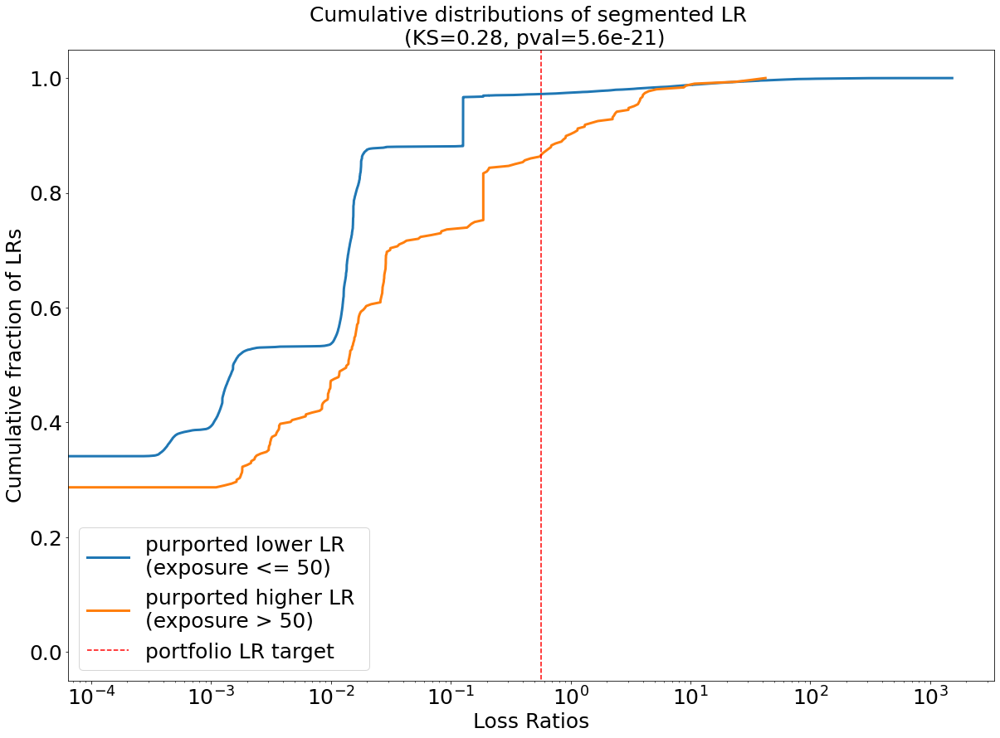

In [91]:
high_mask = (preprocess_df["exposure"] > 50) 
low_mask = (preprocess_df["exposure"] <= 50) 

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_exposure.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(exposure <= 50)", high_label="purported higher LR \n(exposure > 50)")

low 0.7180144854915416
high 0.6952246782703968


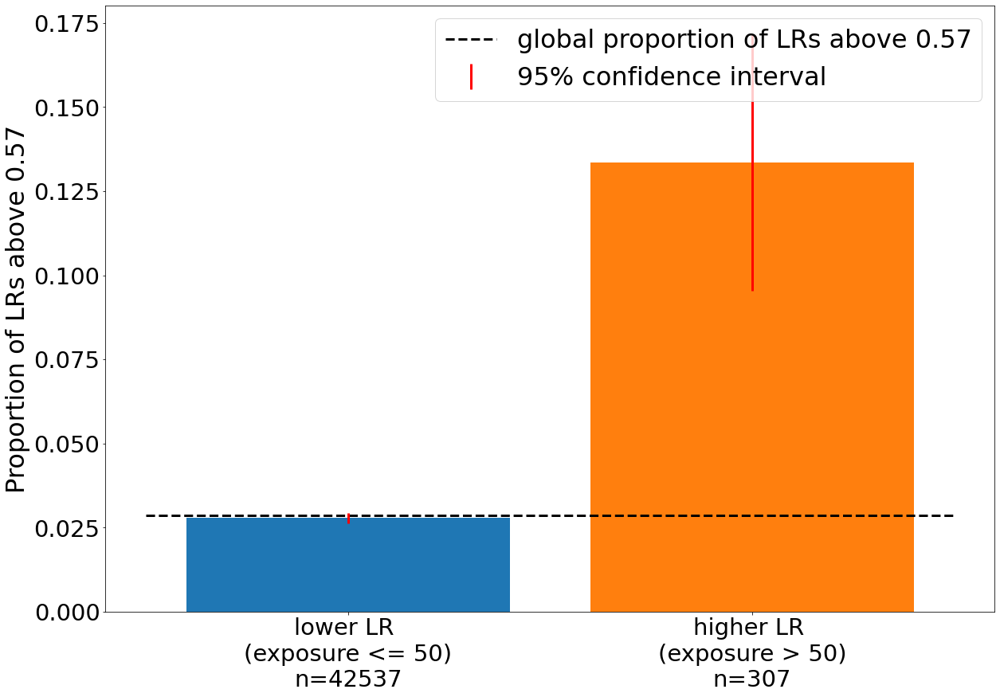

NameError: name 'lr_box_plot' is not defined

In [116]:
high_mask = (preprocess_df["exposure"] > 50) 
low_mask = (preprocess_df["exposure"] <= 50) 

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_exposure_057_dumbed.png", "ultimate_trended_onlevel_lr", 
                        low_label = "lower LR \n(exposure <= 50)", high_label = "higher LR \n(exposure > 50)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_exposure_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(exposure <= 50)", high_label = "purported higher LR \n(exposure > 50)")

old and new:

low 0.9192576481120684
high 0.9468848513448243


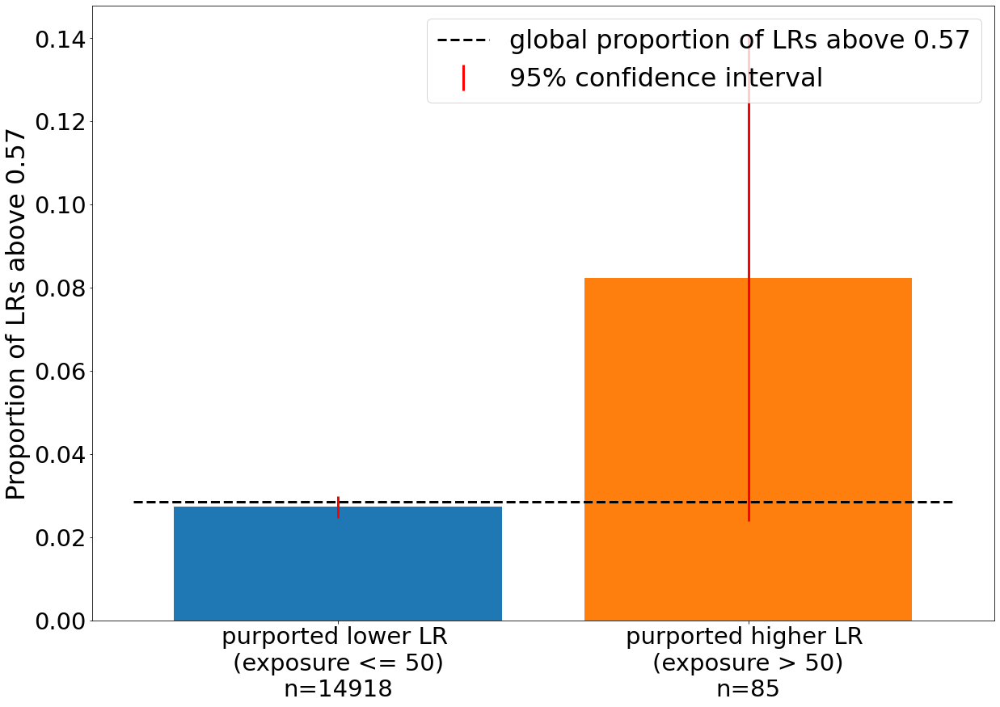

low 0.9192576481120684
high 0.9468848513448243


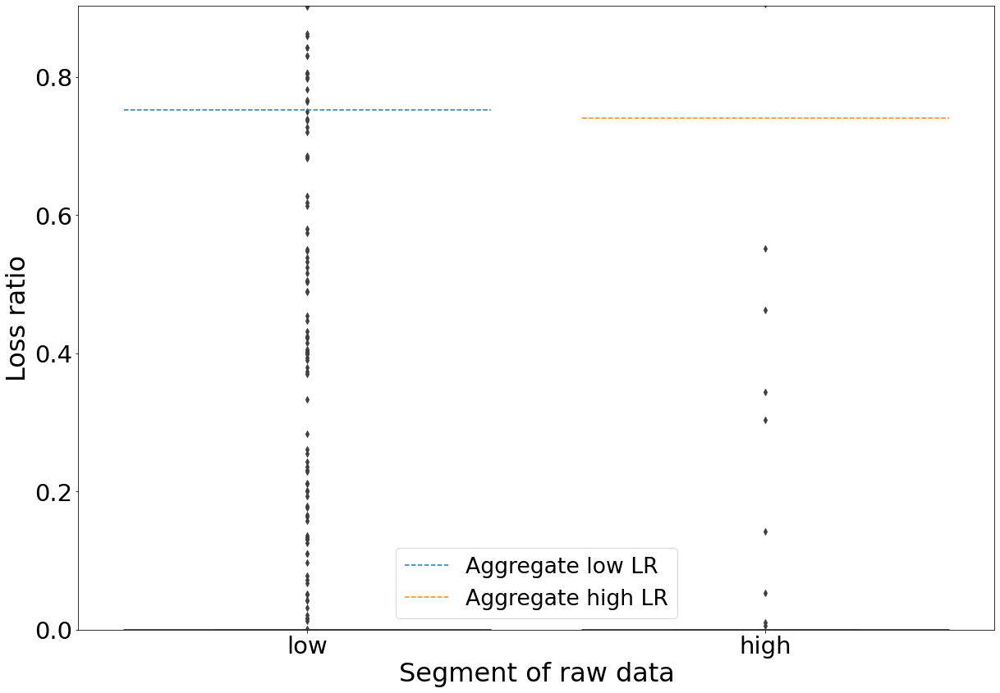

low 0.6093159265294856
high 0.5988683056968547


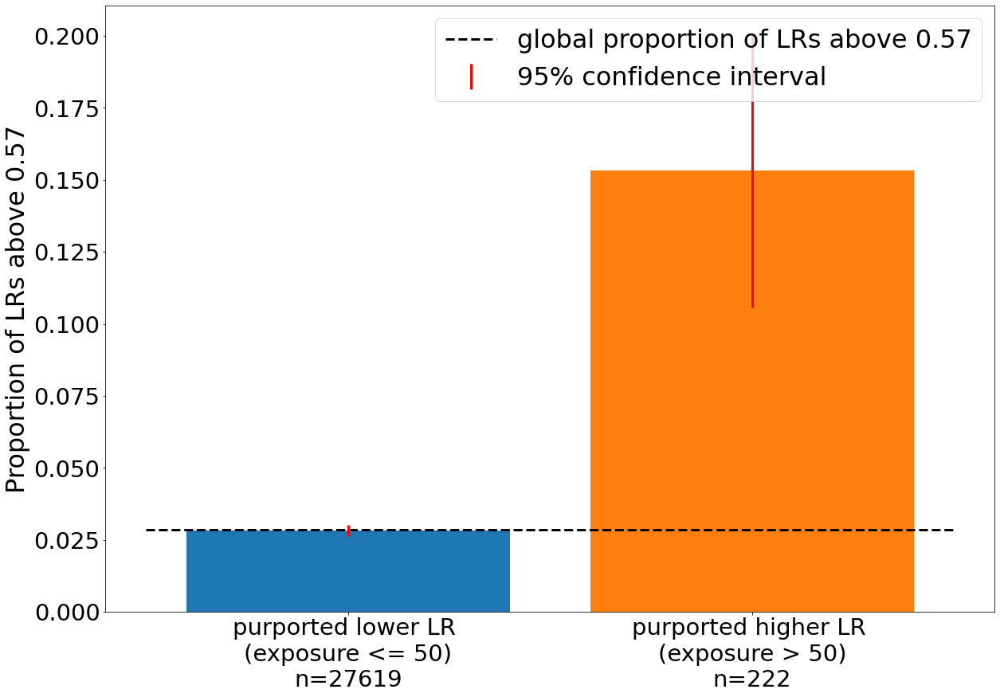

low 0.6093159265294856
high 0.5988683056968547


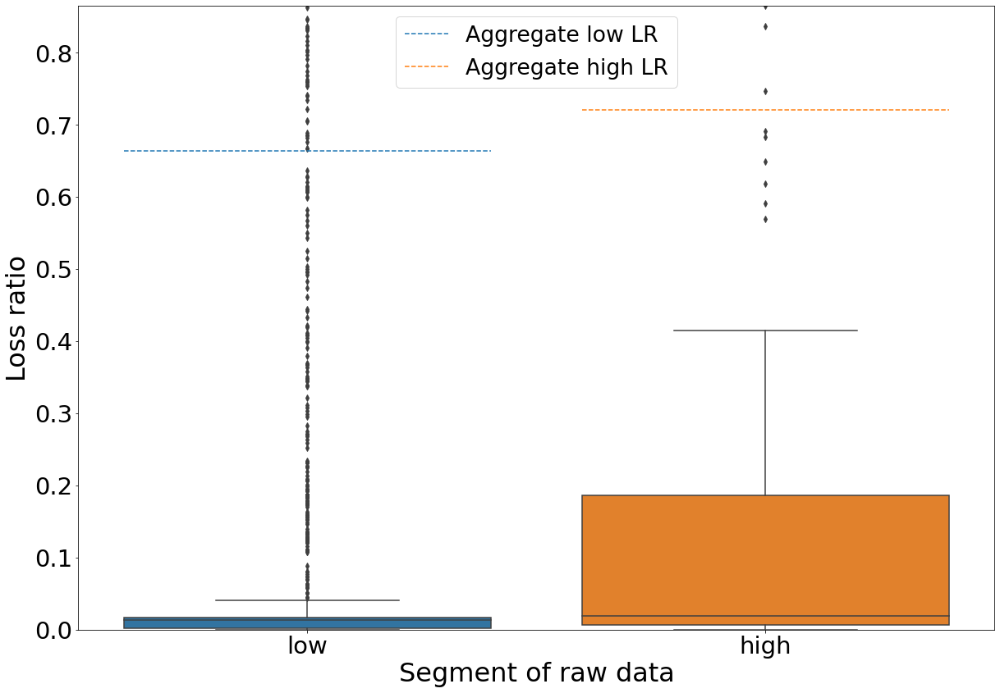

In [416]:
high_mask = (preprocess_df_old["exposure"] > 50) 
low_mask = (preprocess_df_old["exposure"] <= 50) 

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_exposure_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure <= 50)", high_label = "purported higher LR \n(exposure > 50)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_exposure_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(exposure <= 50)", high_label = "purported higher LR \n(exposure > 50)")

high_mask = (preprocess_df_new["exposure"] > 50) 
low_mask = (preprocess_df_new["exposure"] <= 50) 

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_exposure_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure <= 50)", high_label = "purported higher LR \n(exposure > 50)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_exposure_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(exposure <= 50)", high_label = "purported higher LR \n(exposure > 50)")

SHAP plots for old and new policies:

In [333]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__exposure", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_NOINTERACTION" + "numerical_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()
# new
shap.dependence_plot("numerical__exposure", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_NOINTERACTION" + "numerical_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: <object object at 0x7fb9b8402d80>


In [334]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

Is it true that for similar low exposure, a higher aggregate deductible limit yields higher LR? Yes

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=162.7412713177637, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.2627652796763758, pvalue=1.1098753620905264e-31)
0.8298931483489632
0.856265387340353


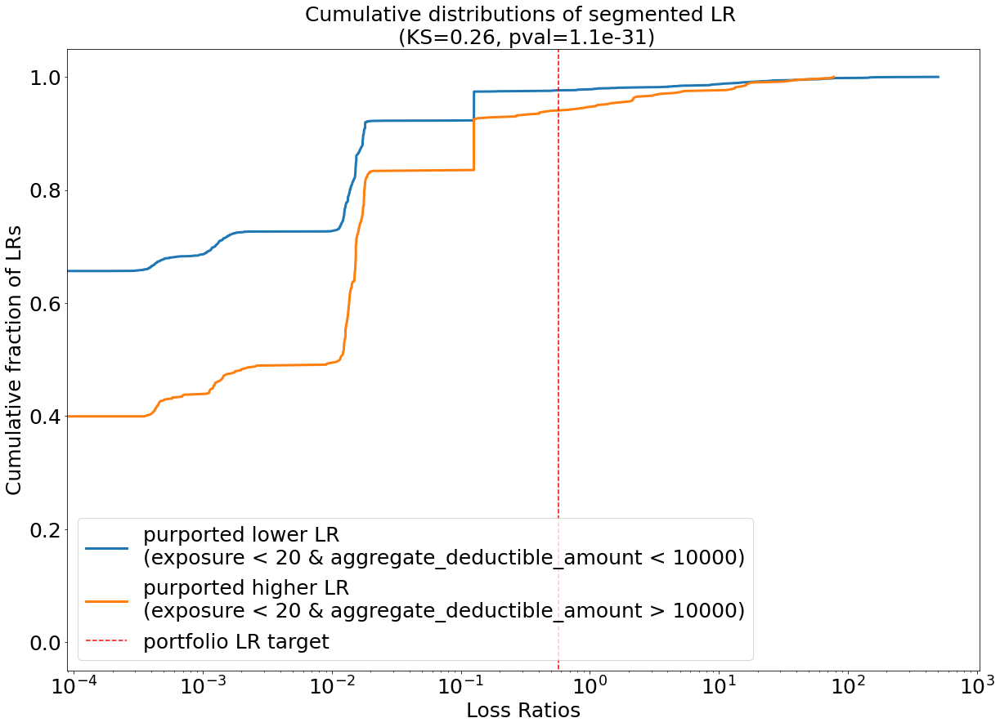

In [92]:
high_mask = (preprocess_df["exposure"] < 20) & (preprocess_df["aggregate_deductible_amount"] > 10000) 
low_mask = (preprocess_df["exposure"] < 20) & (preprocess_df["aggregate_deductible_amount"] < 10000) 

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_exposure_aggregate_deductible.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(exposure < 20 & aggregate_deductible_amount < 10000)", high_label="purported higher LR \n(exposure < 20 & aggregate_deductible_amount > 10000)")

low 0.8298931483489632
high 0.856265387340353


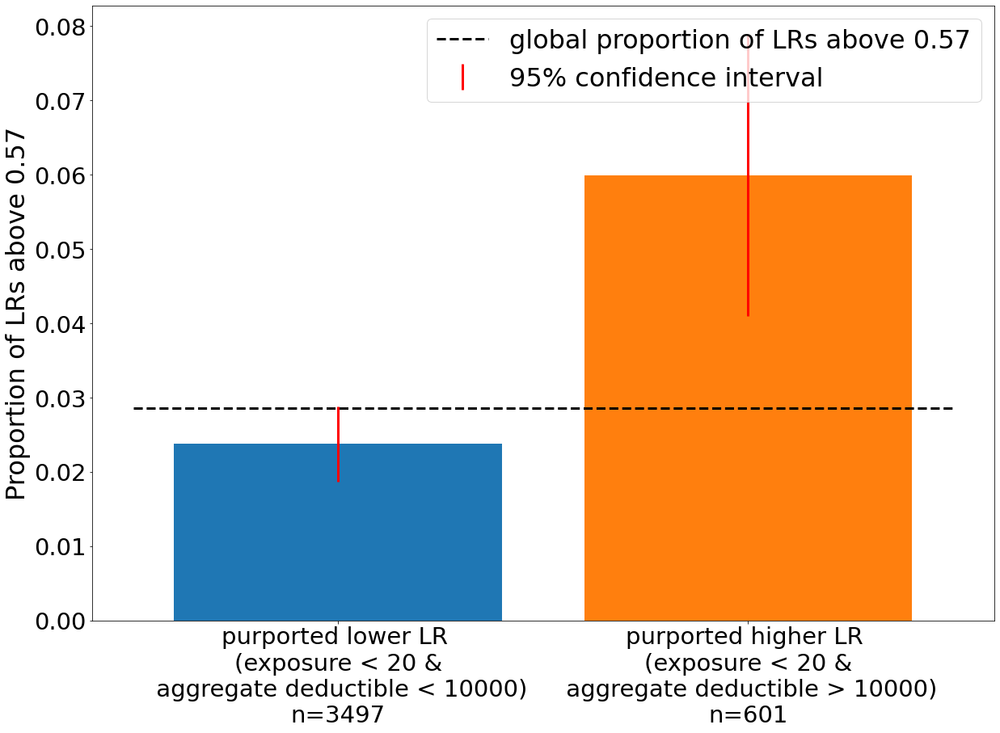

low 0.8298931483489632
high 0.856265387340353


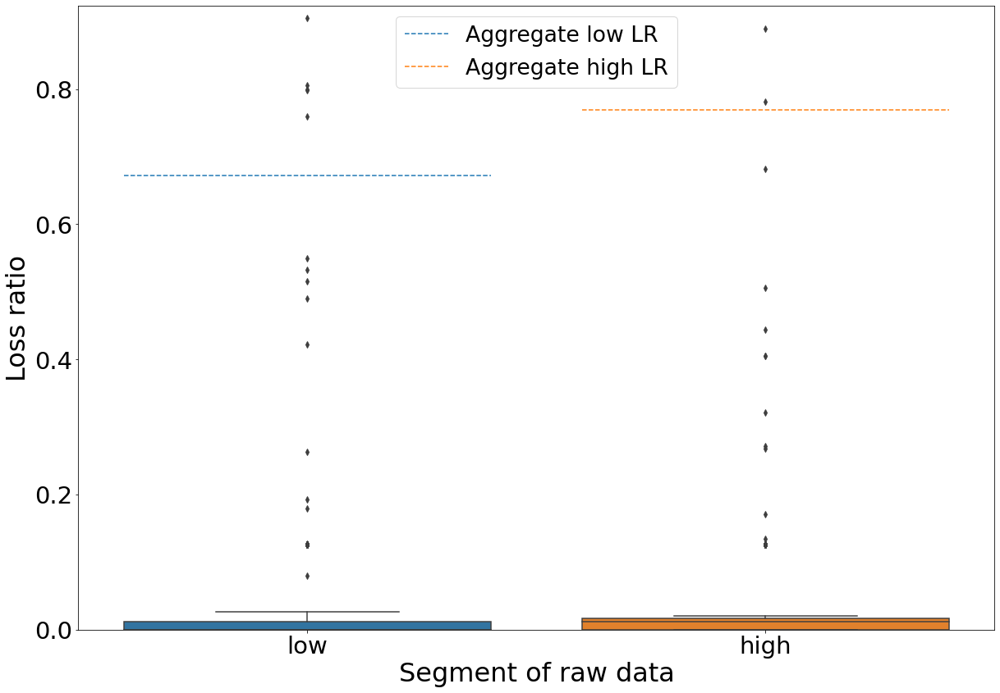

In [372]:
high_mask = (preprocess_df["exposure"] < 20) & (preprocess_df["aggregate_deductible_amount"] > 10000) 
low_mask = (preprocess_df["exposure"] < 20) & (preprocess_df["aggregate_deductible_amount"] < 10000) 

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_exposure_aggregate_deductible_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure < 20 &\n aggregate deductible < 10000)", high_label = "purported higher LR \n(exposure < 20 &\n aggregate deductible > 10000)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_exposure_aggregate_deductible_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(exposure < 20 &\n aggregate deductible < 10000)", high_label = "purported higher LR \n(exposure < 20 &\n aggregate deductible > 10000)")

old and new:

low 0.642638031979082
high 1.2004975496896826


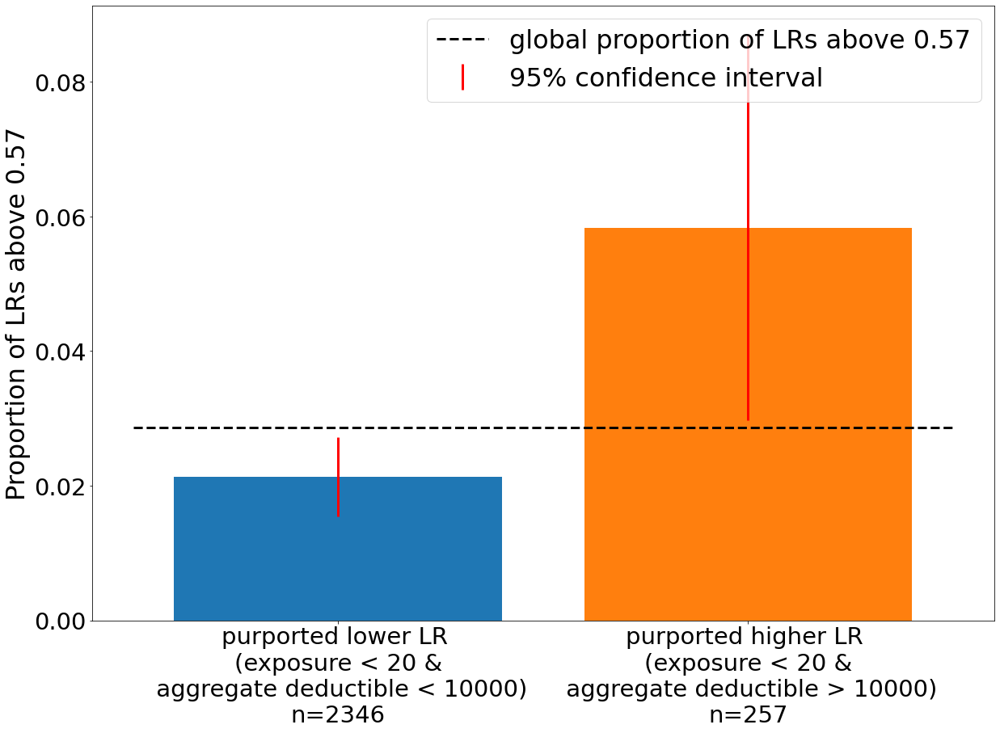

low 0.642638031979082
high 1.2004975496896826


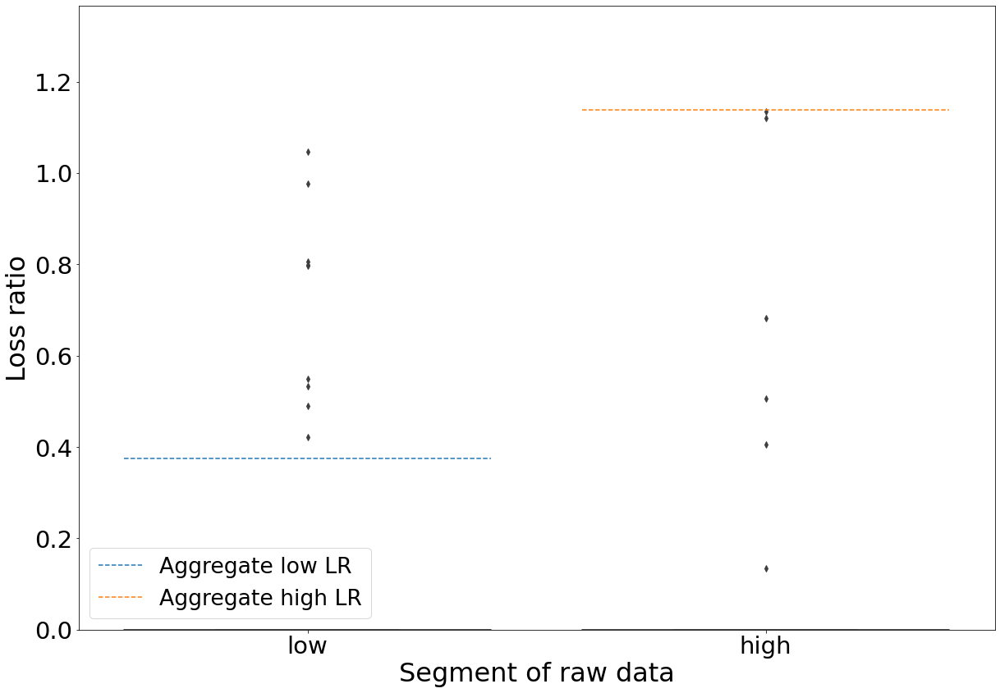

low 1.2115617000463925
high 0.5990919404689062


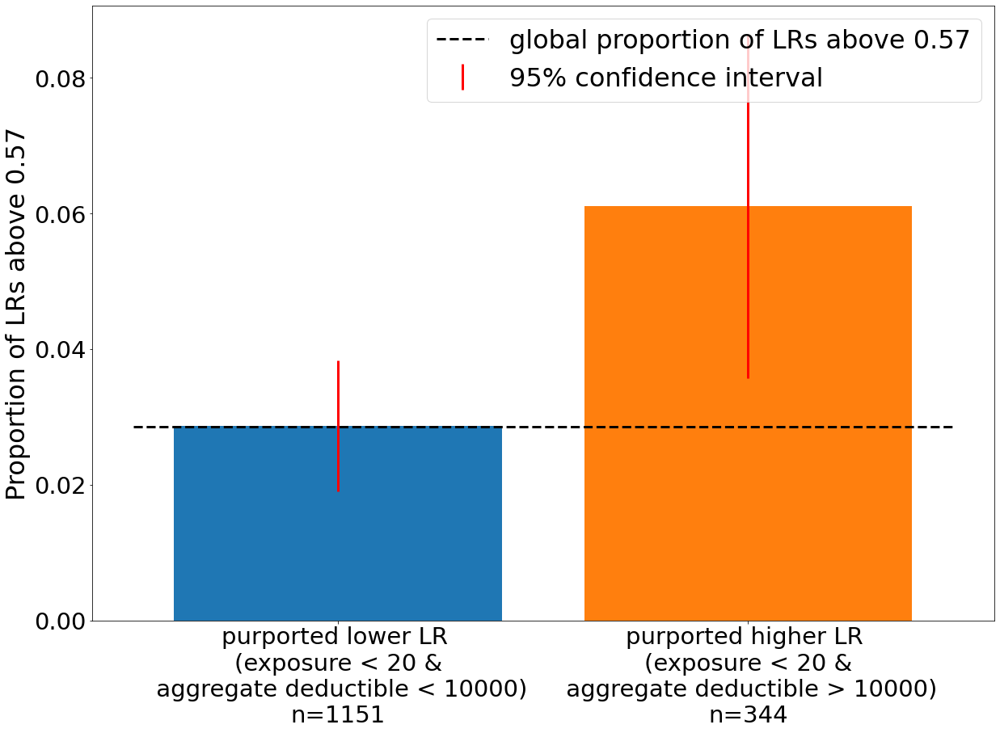

low 1.2115617000463925
high 0.5990919404689062


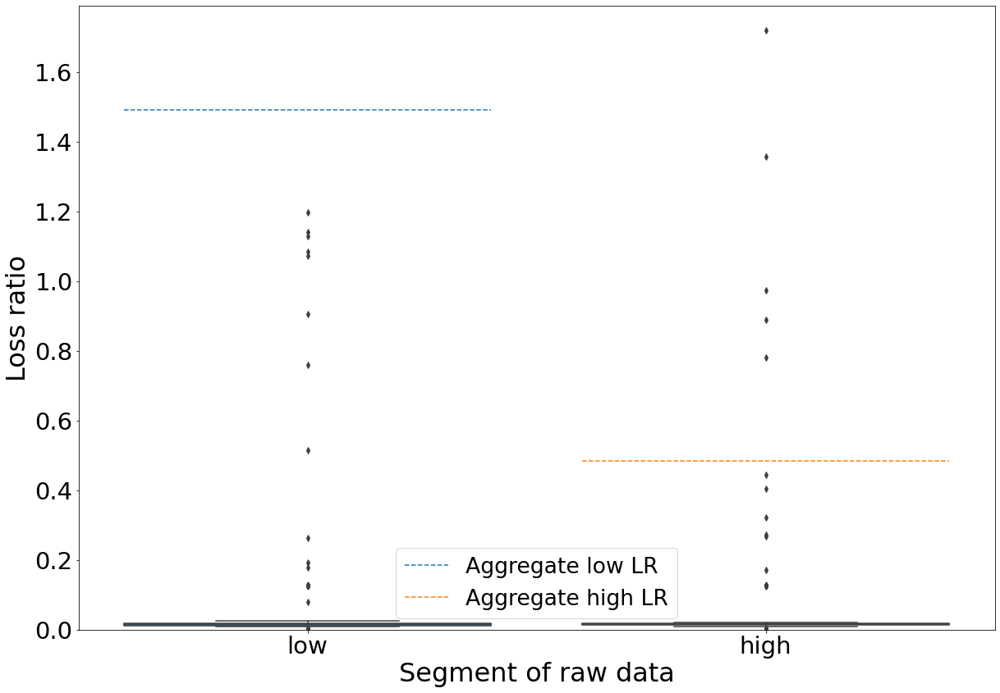

In [418]:
high_mask = (preprocess_df_old["exposure"] < 20) & (preprocess_df_old["aggregate_deductible_amount"] > 10000) 
low_mask = (preprocess_df_old["exposure"] < 20) & (preprocess_df_old["aggregate_deductible_amount"] < 10000) 

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_exposure_aggregate_deductible_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure < 20 &\n aggregate deductible < 10000)", high_label = "purported higher LR \n(exposure < 20 &\n aggregate deductible > 10000)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_exposure_aggregate_deductible_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(exposure < 20 &\n aggregate deductible < 10000)", high_label = "purported higher LR \n(exposure < 20 &\n aggregate deductible > 10000)")

high_mask = (preprocess_df_new["exposure"] < 20) & (preprocess_df_new["aggregate_deductible_amount"] > 10000) 
low_mask = (preprocess_df_new["exposure"] < 20) & (preprocess_df_new["aggregate_deductible_amount"] < 10000) 

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_exposure_aggregate_deductible_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure < 20 &\n aggregate deductible < 10000)", high_label = "purported higher LR \n(exposure < 20 &\n aggregate deductible > 10000)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_exposure_aggregate_deductible_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(exposure < 20 &\n aggregate deductible < 10000)", high_label = "purported higher LR \n(exposure < 20 &\n aggregate deductible > 10000)")

SHAP plots for old and new policies:

In [336]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__exposure", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__aggregate_deductible_amount", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_NOINTERACTION" + "_numerical_exposure_agg_deductible" + ".png", dpi=300, bbox_inches='tight')
plt.clf()
# new
shap.dependence_plot("numerical__exposure", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__aggregate_deductible_amount", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_NOINTERACTION" + "_numerical_exposure_agg_deductible" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [337]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

##### Experience modification factor related:

It isn't surprising that for high experience modification factor (>1) that we see higher odds. The good news is that high exposure policies in this range are lower than lower exposure policies, indicating that pricing is appropriate. However, a hotspot does exist below 0.85 experience modification factor and for high exposure, in contrast to lower odds for experience modification factors between 0.85 and 1. Can we see this in the data?

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=126.83699340465805, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.33805021381225175, pvalue=2.4880482825516254e-33)
0.7003169504795694
0.44621899540150295


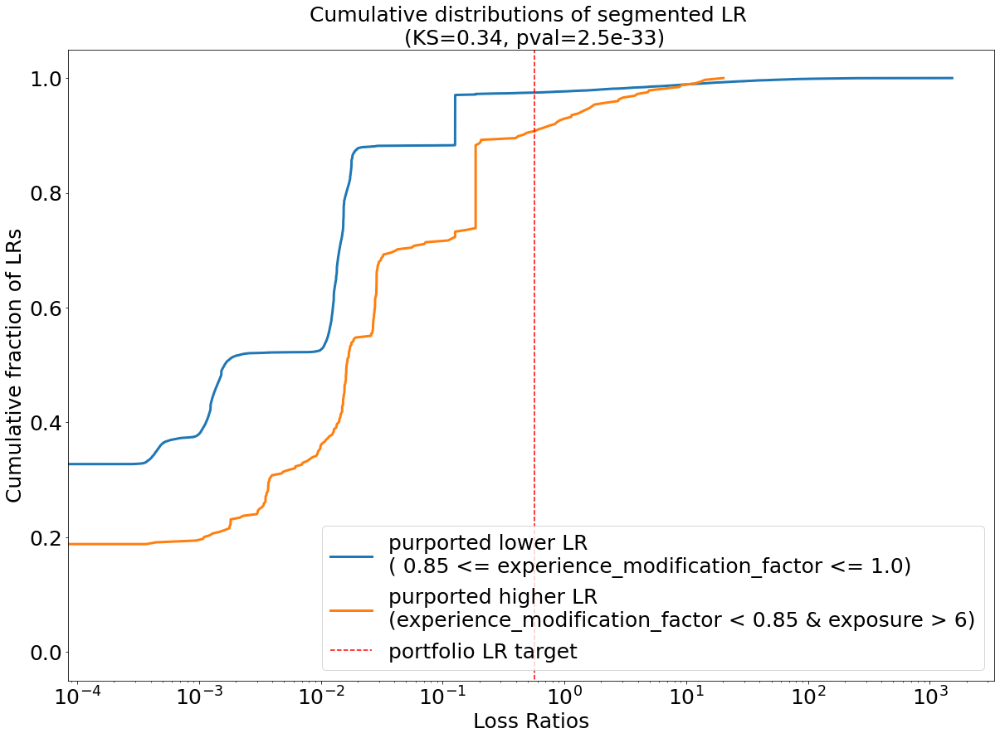

In [93]:
high_mask = (preprocess_df["experience_modification_factor"] < 0.85) & (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df["experience_modification_factor"] >= 0.85) & (preprocess_df["experience_modification_factor"] <= 1.0)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_exp_mod_factor.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n( 0.85 <= experience_modification_factor <= 1.0)", high_label="purported higher LR \n(experience_modification_factor < 0.85 & exposure > 6)")

low 0.7003169504795694
high 0.44621899540150295


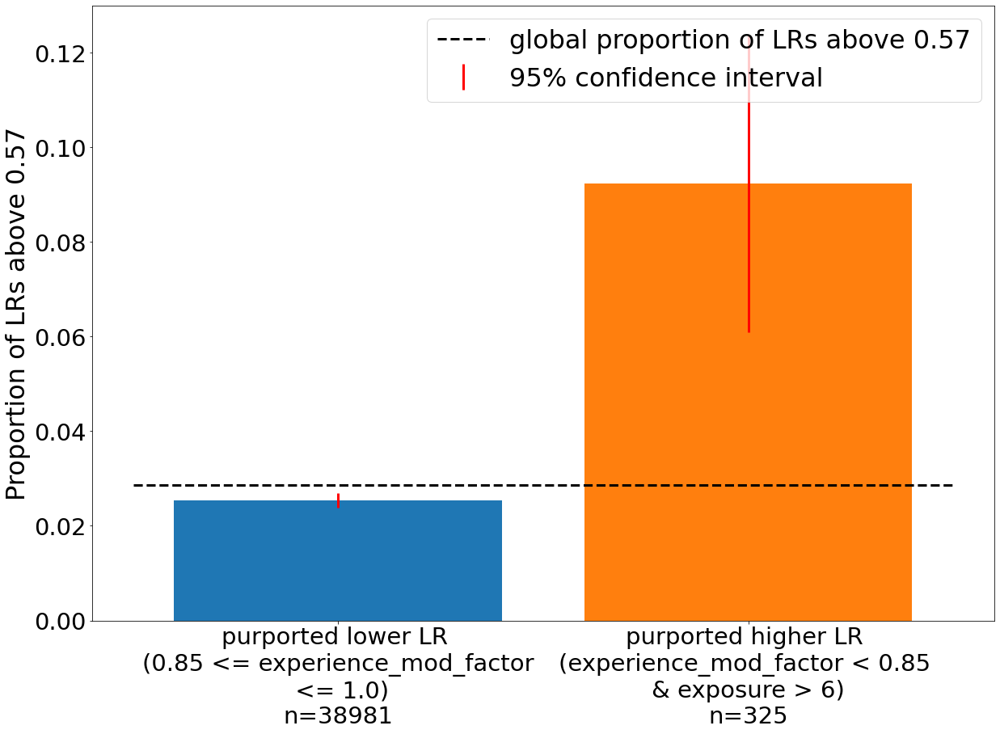

low 0.7003169504795694
high 0.44621899540150295


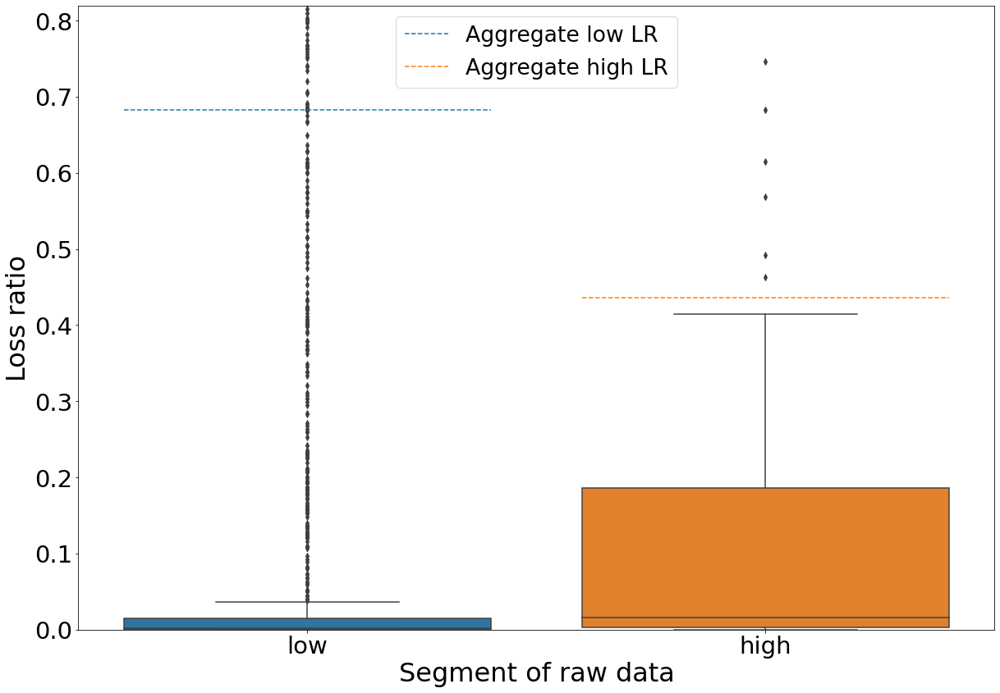

In [373]:
high_mask = (preprocess_df["experience_modification_factor"] < 0.85) & (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df["experience_modification_factor"] >= 0.85) & (preprocess_df["experience_modification_factor"] <= 1.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_experience_mod_exposure_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_experience_mod_exposure_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)")

old and new:

low 0.8941312595187064
high 0.03104036431133907


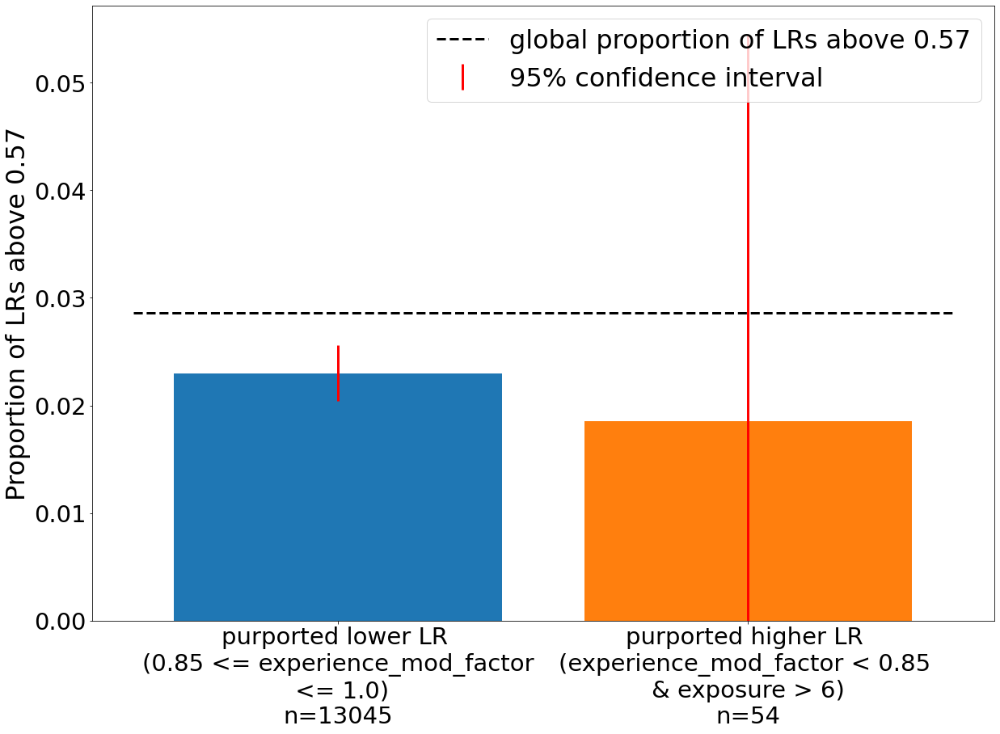

low 0.8941312595187064
high 0.03104036431133907


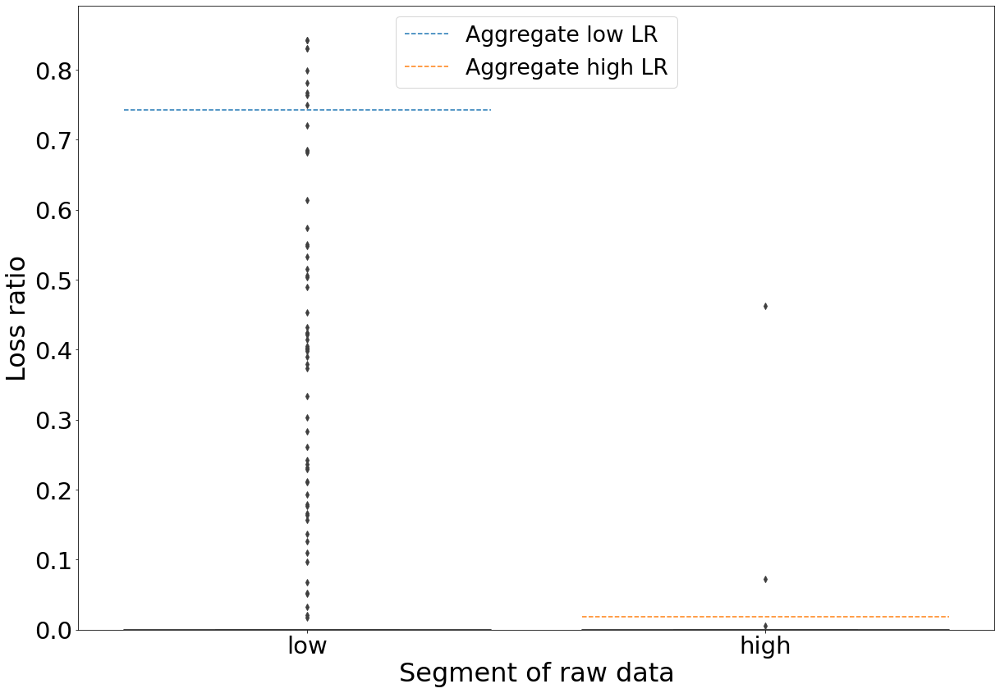

low 0.6028343910480635
high 0.5289483167257423


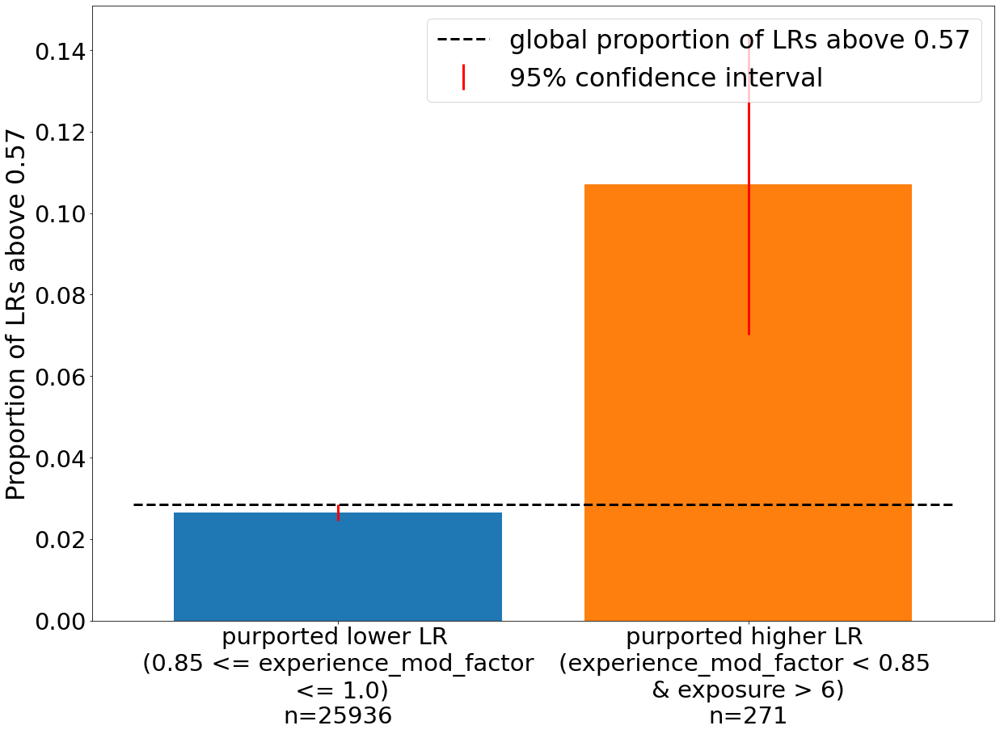

low 0.6028343910480635
high 0.5289483167257423


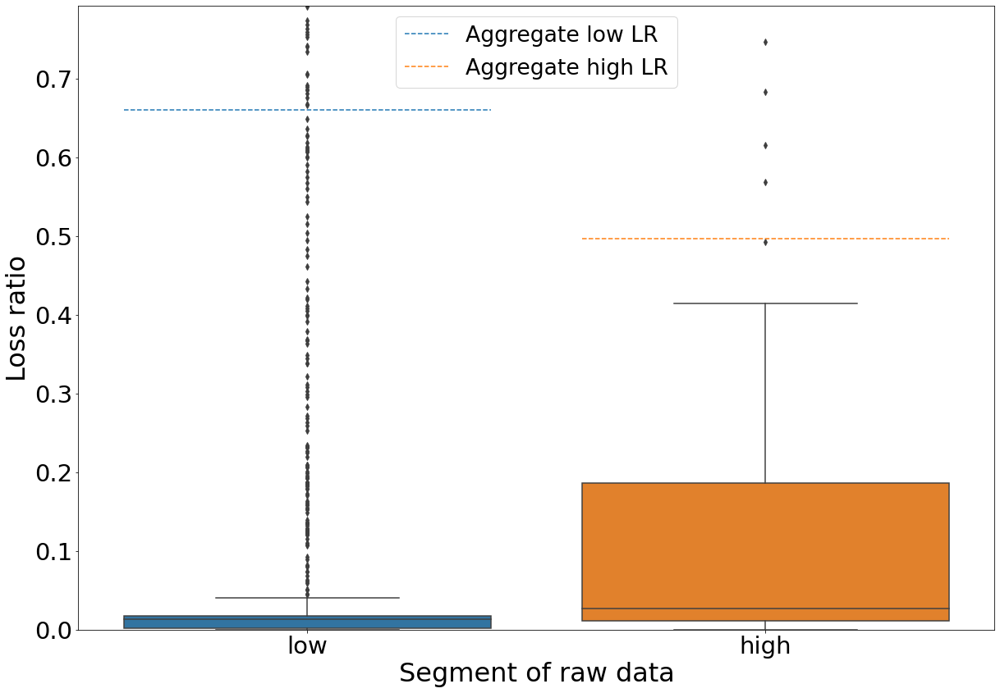

In [420]:
high_mask = (preprocess_df_old["experience_modification_factor"] < 0.85) & (preprocess_df_old["exposure"] > 6)
low_mask = (preprocess_df_old["experience_modification_factor"] >= 0.85) & (preprocess_df_old["experience_modification_factor"] <= 1.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_experience_mod_exposure_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_experience_mod_exposure_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)")

high_mask = (preprocess_df_new["experience_modification_factor"] < 0.85) & (preprocess_df_new["exposure"] > 6)
low_mask = (preprocess_df_new["experience_modification_factor"] >= 0.85) & (preprocess_df_new["experience_modification_factor"] <= 1.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_experience_mod_exposure_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_experience_mod_exposure_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)")

SHAP plots for old and new policies:

In [338]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__experience_modification_factor", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_numerical_expmod_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()
# new
shap.dependence_plot("numerical__experience_modification_factor", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_numerical_exmod_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [339]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

Following Katie's request: "Small ERM and large exposure: is the new/old breakout here the same as the others (2013 and prior vs 2014 and forward)? If so, I would like to see if we could adjust that split to 2018 and prior vs 2019 and forward. Unlike some of the other observations, the 2014 time frame isn't as meaningful here. However, we did change our ERM approach around the end of 2018, so I would be curious to see (although I realize data will be very limited) if we can see the same observation for this new approach. "

low 0.7101735022054977
high 0.24777570329203602


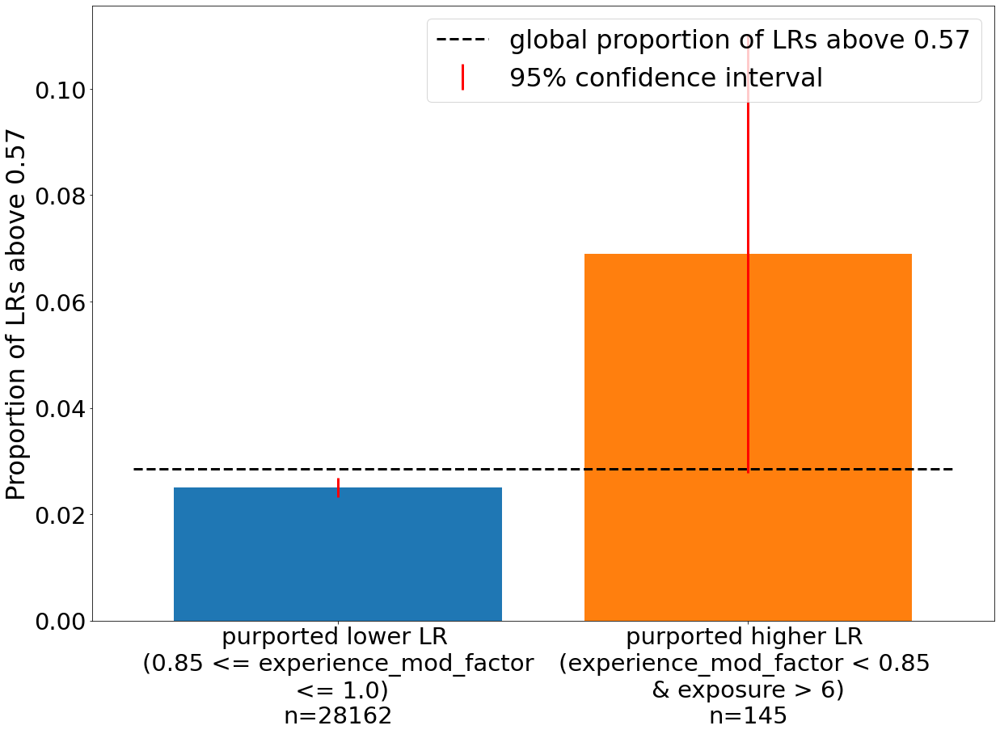

low 0.7101735022054977
high 0.24777570329203602


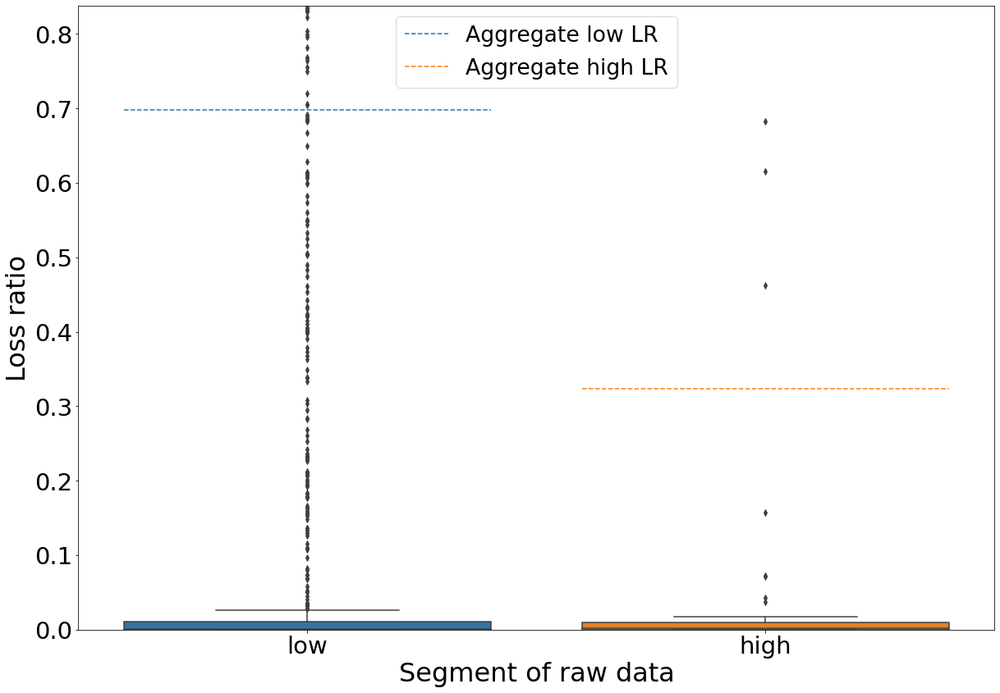

low 0.6746602160581266
high 0.6060760918230179


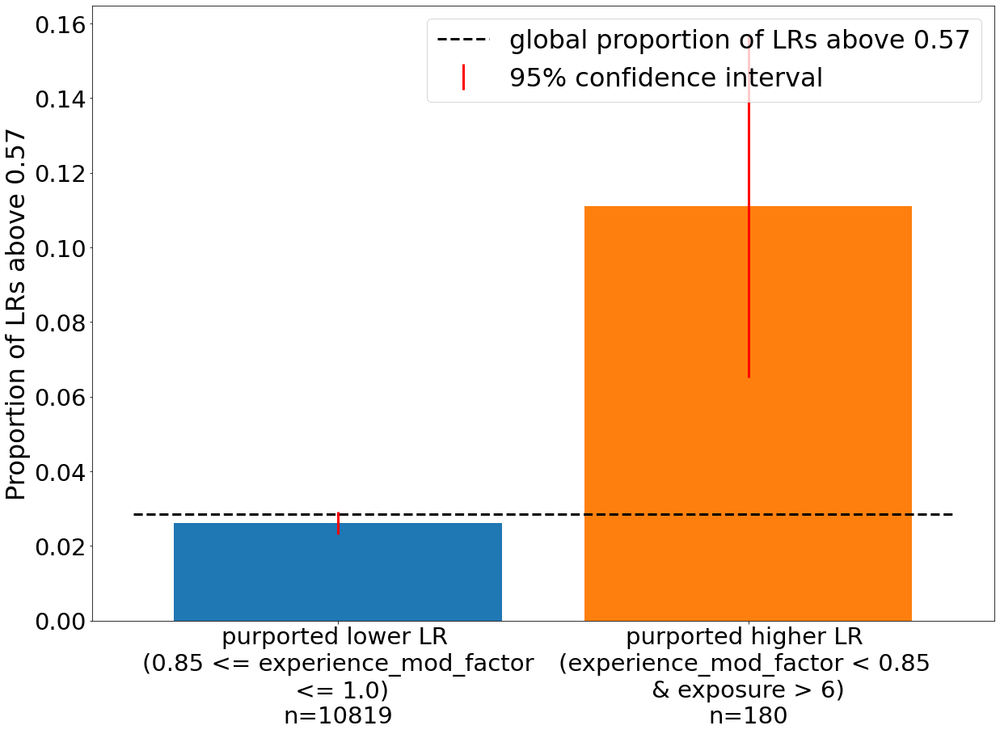

low 0.6746602160581266
high 0.6060760918230179


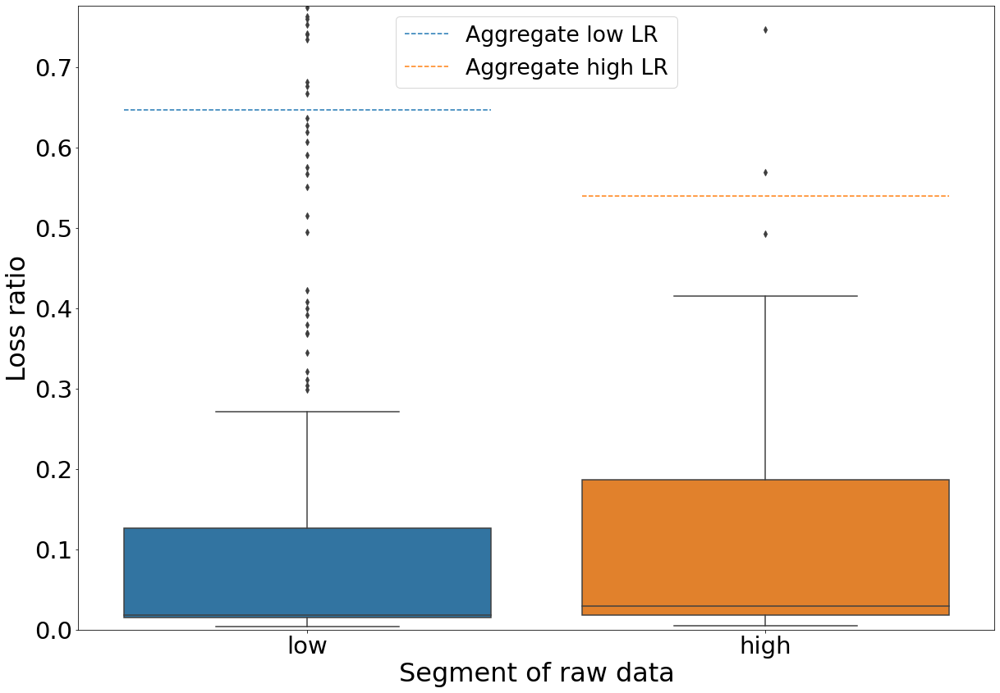

In [108]:
high_mask = (erm_preprocess_df_old["experience_modification_factor"] < 0.85) & (erm_preprocess_df_old["exposure"] > 6)
low_mask = (erm_preprocess_df_old["experience_modification_factor"] >= 0.85) & (erm_preprocess_df_old["experience_modification_factor"] <= 1.0)

high_low_confint_plot(low_mask, high_mask, erm_preprocess_df_old, "erm_bar_chart_experience_mod_exposure_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, erm_preprocess_df_old, erm_preprocess_df_incl_lossnpremium_old, "erm_bar_chart_experience_mod_exposure_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)")

high_mask = (erm_preprocess_df_new["experience_modification_factor"] < 0.85) & (erm_preprocess_df_new["exposure"] > 6)
low_mask = (erm_preprocess_df_new["experience_modification_factor"] >= 0.85) & (erm_preprocess_df_new["experience_modification_factor"] <= 1.0)

high_low_confint_plot(low_mask, high_mask, erm_preprocess_df_new, "erm_bar_chart_experience_mod_exposure_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, erm_preprocess_df_new, erm_preprocess_df_incl_lossnpremium_new, "erm_bar_chart_experience_mod_exposure_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(0.85 <= experience_mod_factor\n <= 1.0)", high_label = "purported higher LR \n(experience_mod_factor < 0.85 \n& exposure > 6)")

SHAP plots for old and new (erm) policies:

In [109]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__experience_modification_factor", shap_values[erm_old_policy_idx_test], X_shap[erm_old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "erm_OLD_" + "_numerical_expmod_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()
# new
shap.dependence_plot("numerical__experience_modification_factor", shap_values[erm_new_policy_idx_test], X_shap[erm_new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "erm_NEW_" + "_numerical_exmod_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: <object object at 0x7f5dcaa0ad60>


In [110]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

Is it true that pricing is working well above 0.1 experience_modification_factor? No, no significant difference

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=66.50764218774405, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.22074339746768654, pvalue=2.625006816806413e-19)
1.0905552231392797
0.9110996641517211


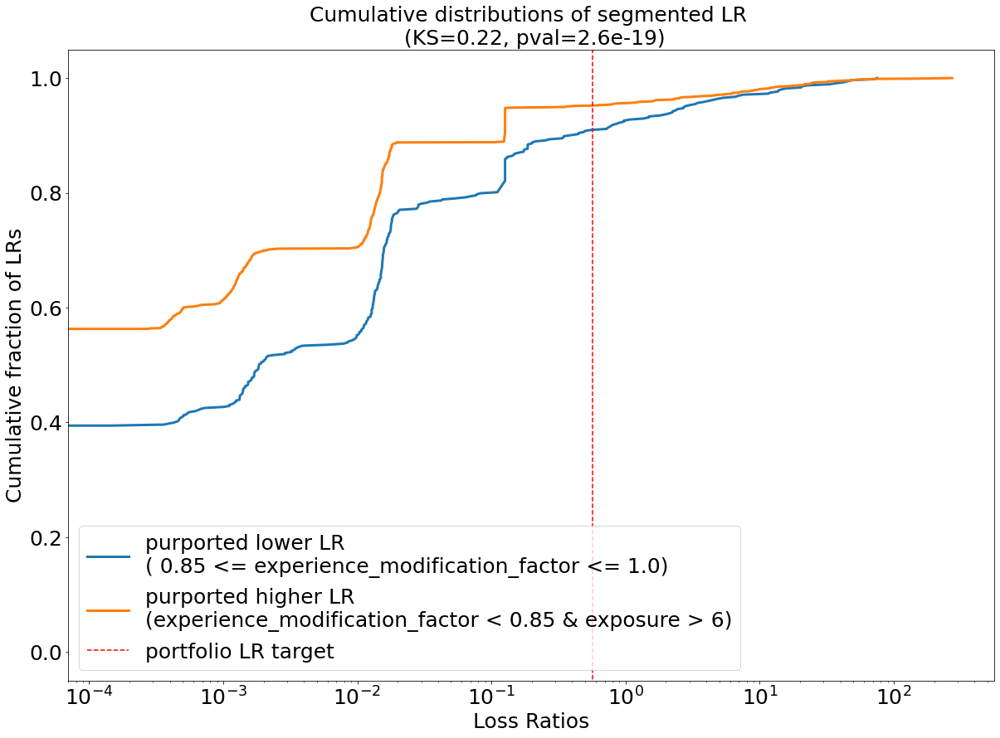

In [94]:
high_mask = (preprocess_df["experience_modification_factor"] > 1.0) & (preprocess_df["exposure"] < 3)
low_mask = (preprocess_df["experience_modification_factor"] > 1.0) & (preprocess_df["exposure"] > 6)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n( 0.85 <= experience_modification_factor <= 1.0)", high_label="purported higher LR \n(experience_modification_factor < 0.85 & exposure > 6)")

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=58.13217957883294, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.08270527612309068, pvalue=1.5093896556061997e-15)
0.6742983851961505
0.9499304746156128


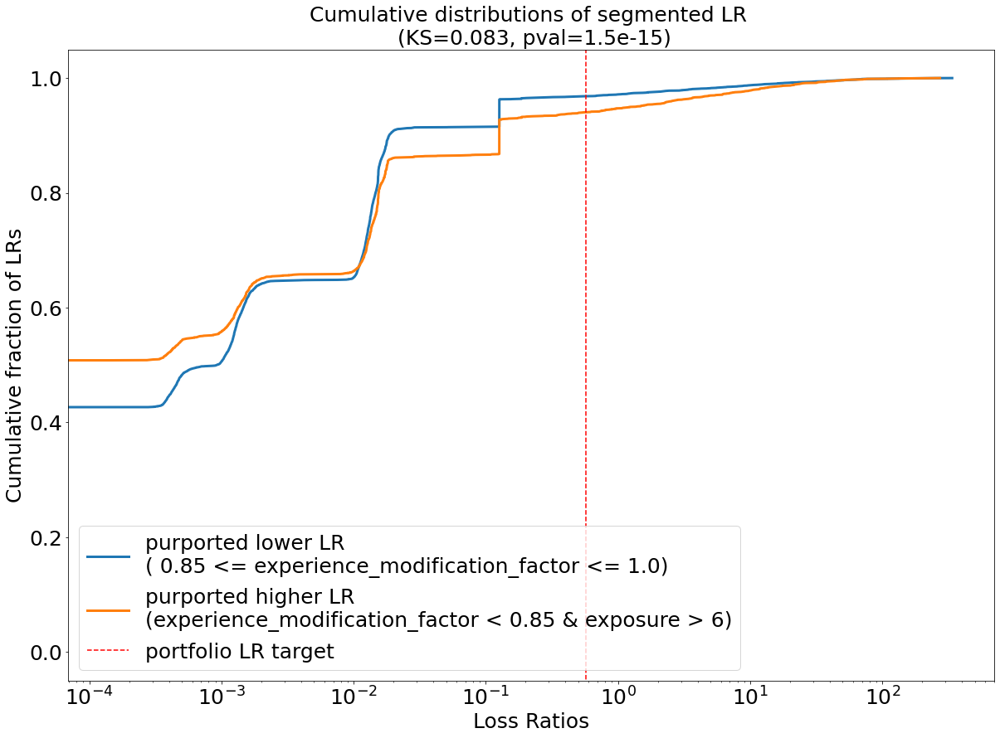

In [95]:
high_mask = (preprocess_df["experience_modification_factor"] > 1.0)
low_mask = (preprocess_df["experience_modification_factor"] > 0.9) & (preprocess_df["experience_modification_factor"] < 1.0)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n( 0.85 <= experience_modification_factor <= 1.0)", high_label="purported higher LR \n(experience_modification_factor < 0.85 & exposure > 6)")

##### size of firm factor related:

Most obvious trend is that below 0.975 size of firm factor, odds are higher. Also potentially aop_above_average_risk being above 0.5 increases the odds:

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=1102.497639378273, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.30016144795169253, pvalue=2.74940243848559e-242)
0.7189027675826136
0.7208704820262897


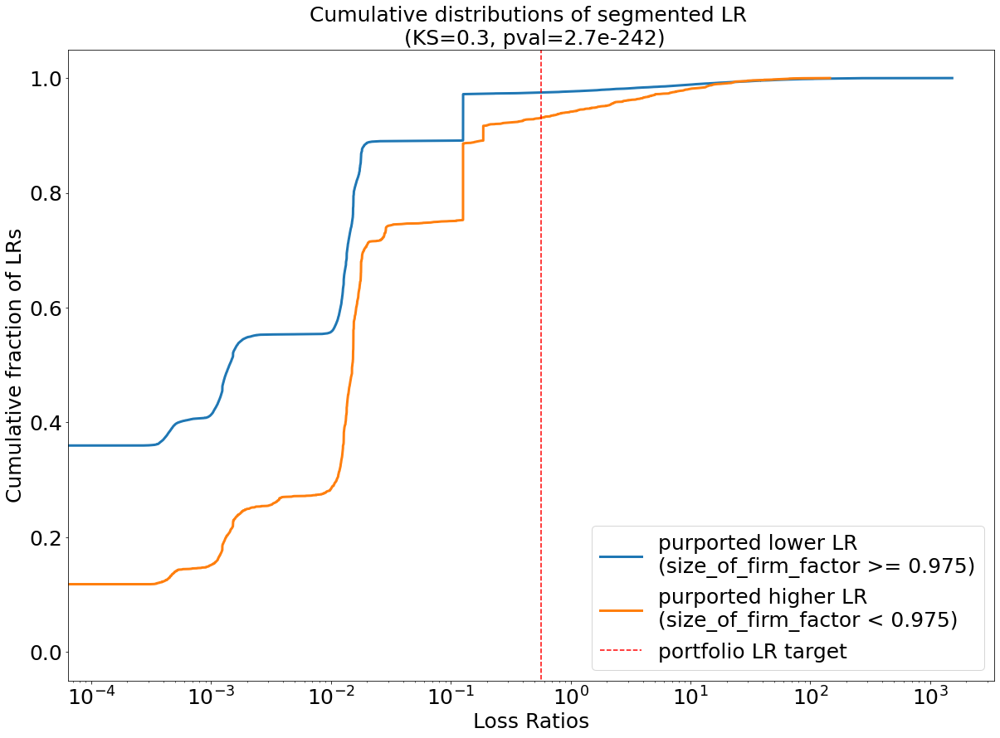

In [96]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) #& (preprocess_df["exposure"] < 3)
low_mask = (preprocess_df["size_of_firm_factor"] >= 0.975) #& (preprocess_df["exposure"] > 6)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_size_of_firm.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(size_of_firm_factor >= 0.975)", high_label="purported higher LR \n(size_of_firm_factor < 0.975)")

low 0.7189027675826136
high 0.7208704820262897


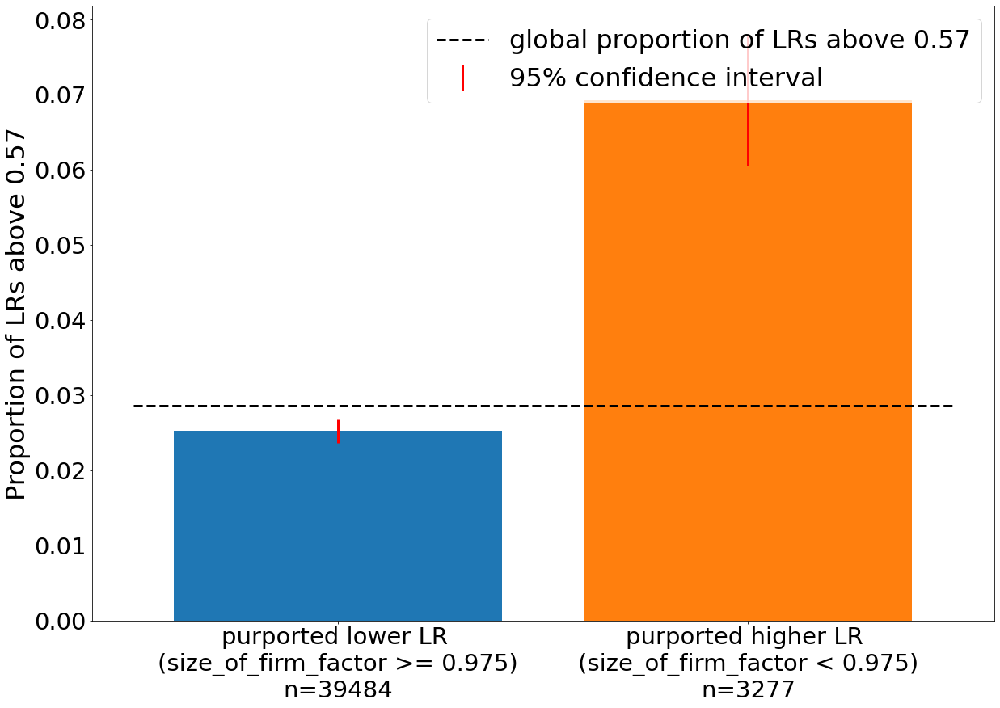

low 0.7189027675826136
high 0.7208704820262897


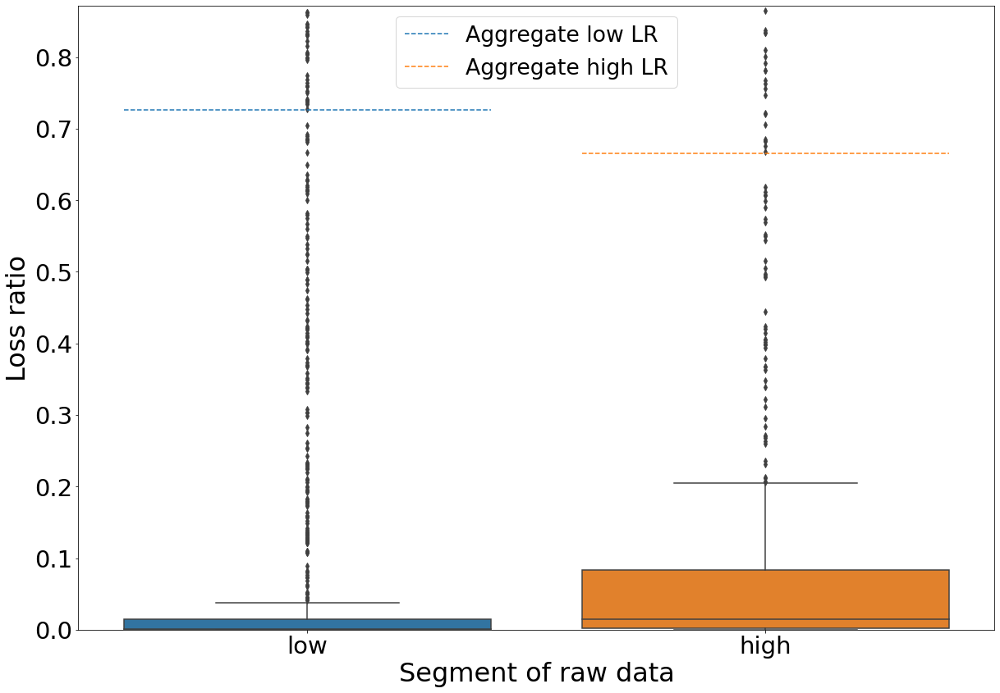

In [374]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) #& (preprocess_df["exposure"] < 3)
low_mask = (preprocess_df["size_of_firm_factor"] >= 0.975) #& (preprocess_df["exposure"] > 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_size_of_firm_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor >= 0.975)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_size_of_firm_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor >= 0.975)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975)")

old and new:

low 0.9147524344859339
high 1.0772634086652173


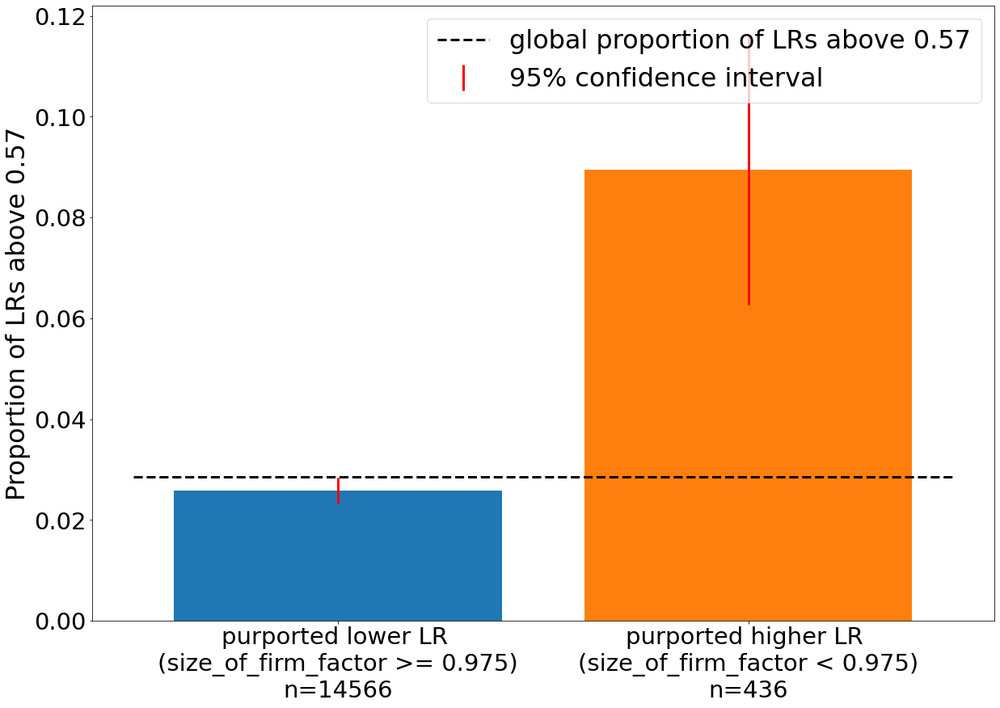

low 0.9147524344859339
high 1.0772634086652173


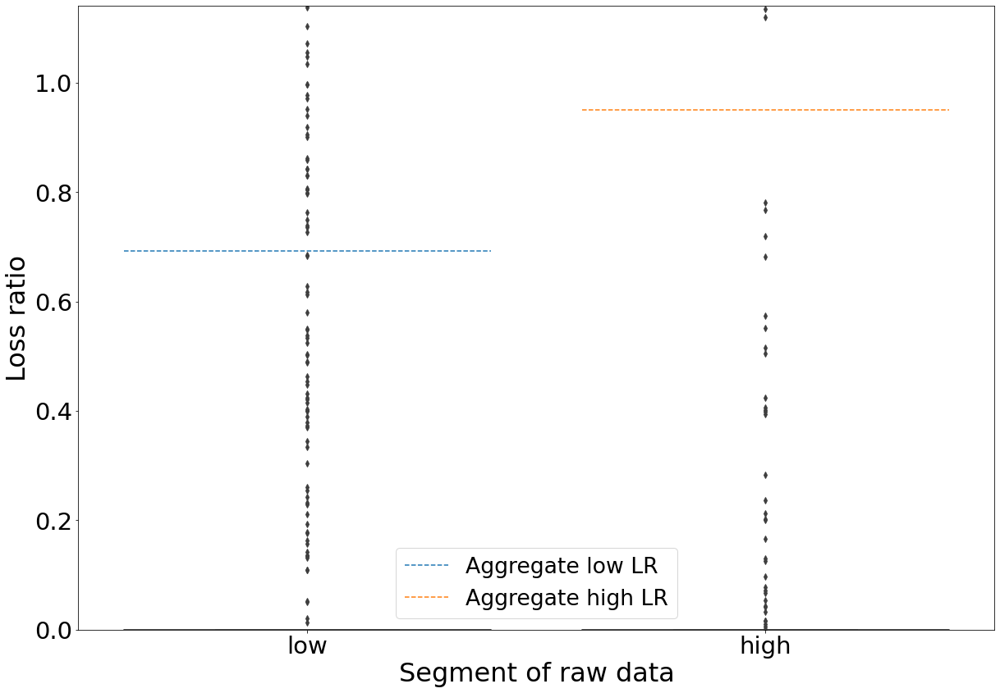

low 0.6044174056709927
high 0.6661758970158804


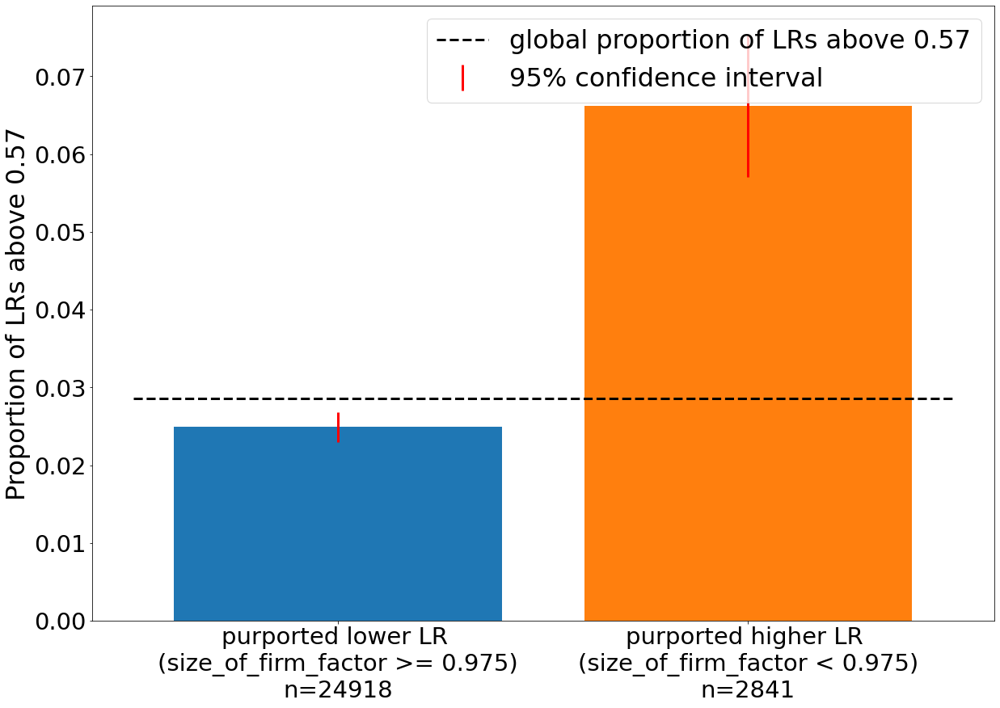

low 0.6044174056709927
high 0.6661758970158804


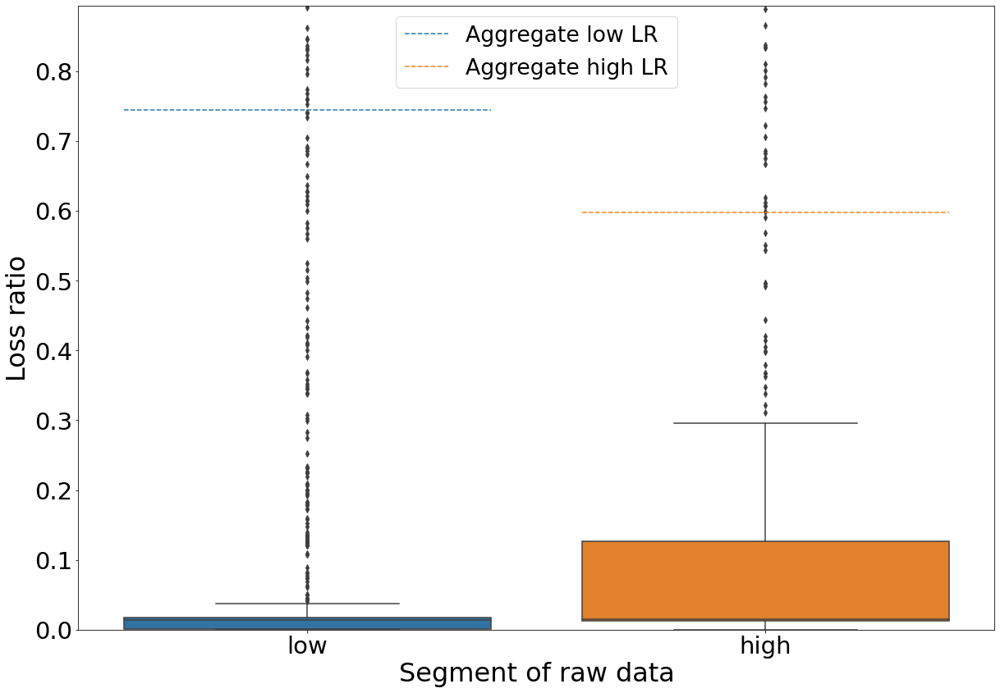

In [421]:
high_mask = (preprocess_df_old["size_of_firm_factor"] < 0.975) #& (preprocess_df["exposure"] < 3)
low_mask = (preprocess_df_old["size_of_firm_factor"] >= 0.975) #& (preprocess_df["exposure"] > 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_size_of_firm_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor >= 0.975)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_size_of_firm_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor >= 0.975)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975)")

high_mask = (preprocess_df_new["size_of_firm_factor"] < 0.975) #& (preprocess_df["exposure"] < 3)
low_mask = (preprocess_df_new["size_of_firm_factor"] >= 0.975) #& (preprocess_df["exposure"] > 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_size_of_firm_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor >= 0.975)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_size_of_firm_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor >= 0.975)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975)")

SHAP plots for old and new policies:

In [340]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__size_of_firm_factor", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_size_firm_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()
# new
shap.dependence_plot("numerical__size_of_firm_factor", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_size_firm_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [341]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=11.55111979606008, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.124878024980484, pvalue=0.0004957295335774716)
0.7149597131713856
0.7822152323988886


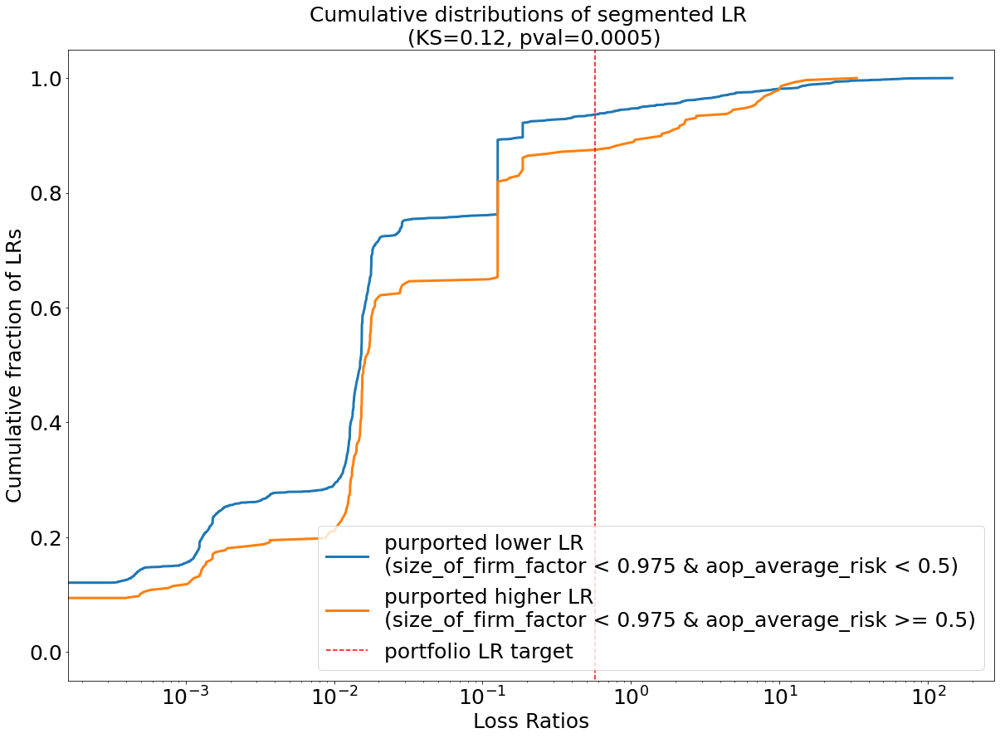

In [97]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["aop_average_risk"] >= 0.5)
low_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["aop_average_risk"] < 0.5)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_size_of_firm_aop_average_risk.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(size_of_firm_factor < 0.975 & aop_average_risk < 0.5)", high_label="purported higher LR \n(size_of_firm_factor < 0.975 & aop_average_risk >= 0.5)")

low 0.7149597131713856
high 0.7822152323988886


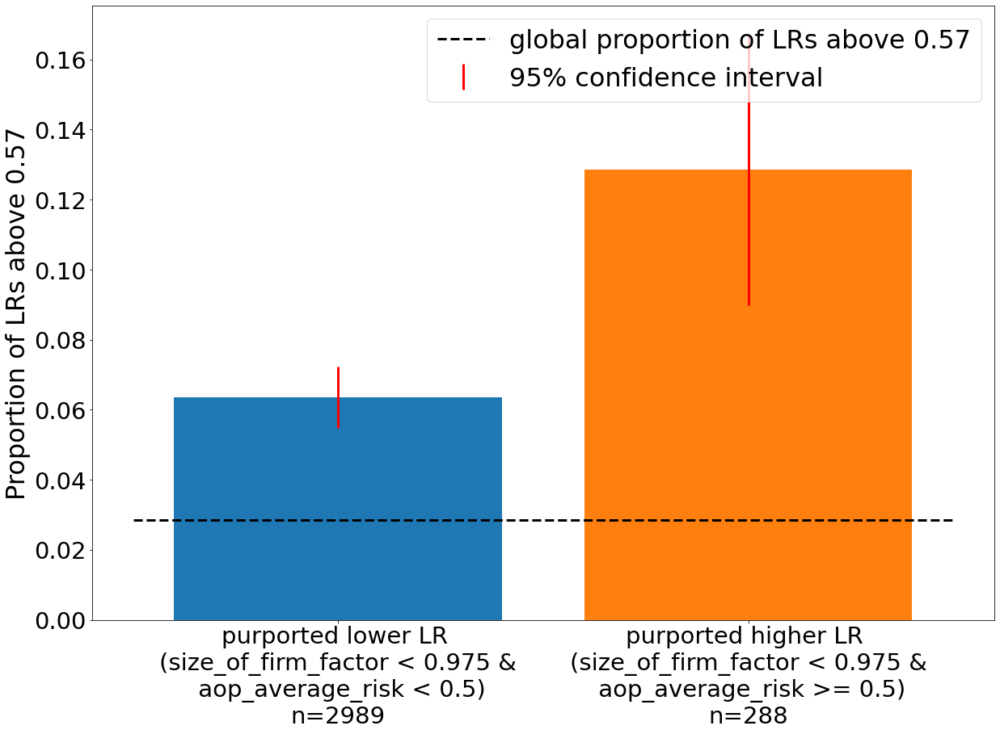

low 0.7149597131713856
high 0.7822152323988886


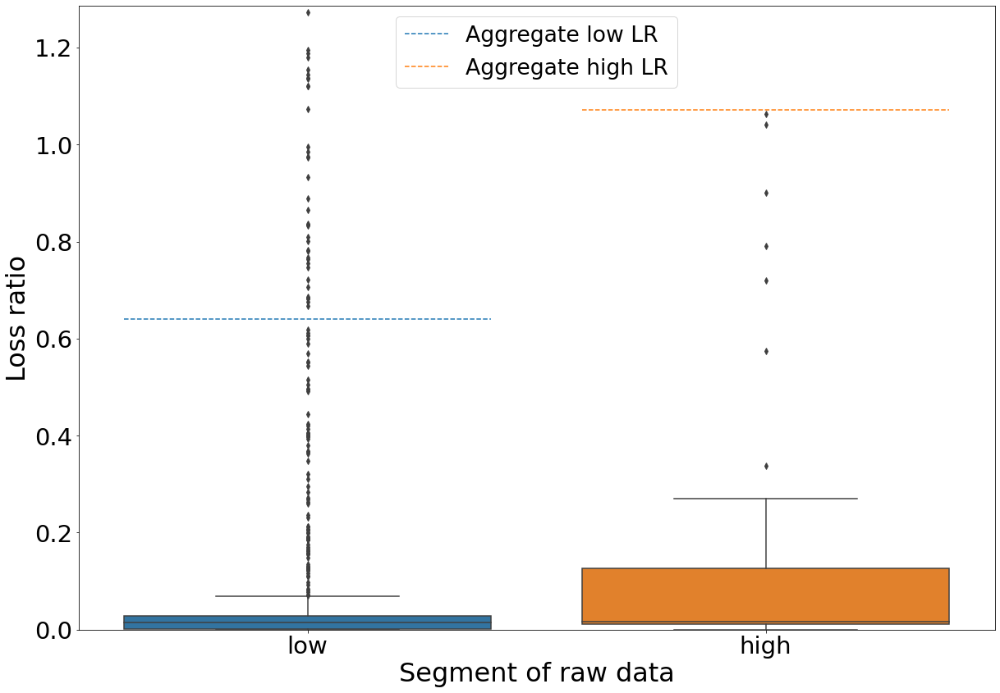

In [375]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["aop_average_risk"] >= 0.5)
low_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["aop_average_risk"] < 0.5)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_size_of_firm_aop_average_risk_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_size_of_firm_aop_average_risk_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)")

old and new:

low 1.1270411917926668
high 0.46937108744212014


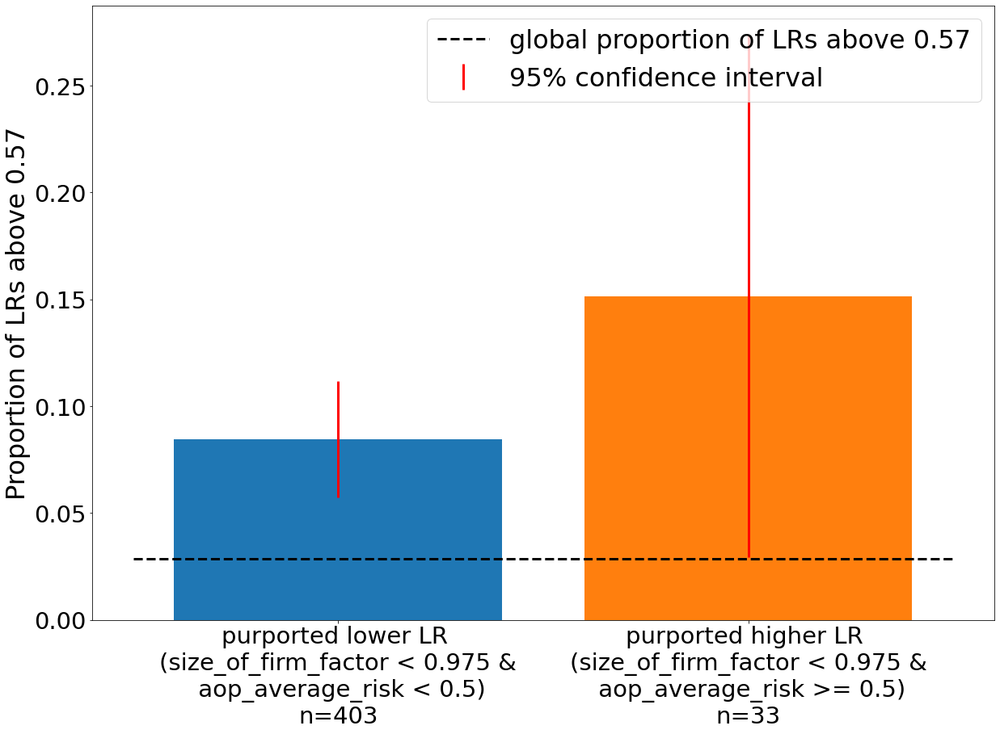

low 1.1270411917926668
high 0.46937108744212014


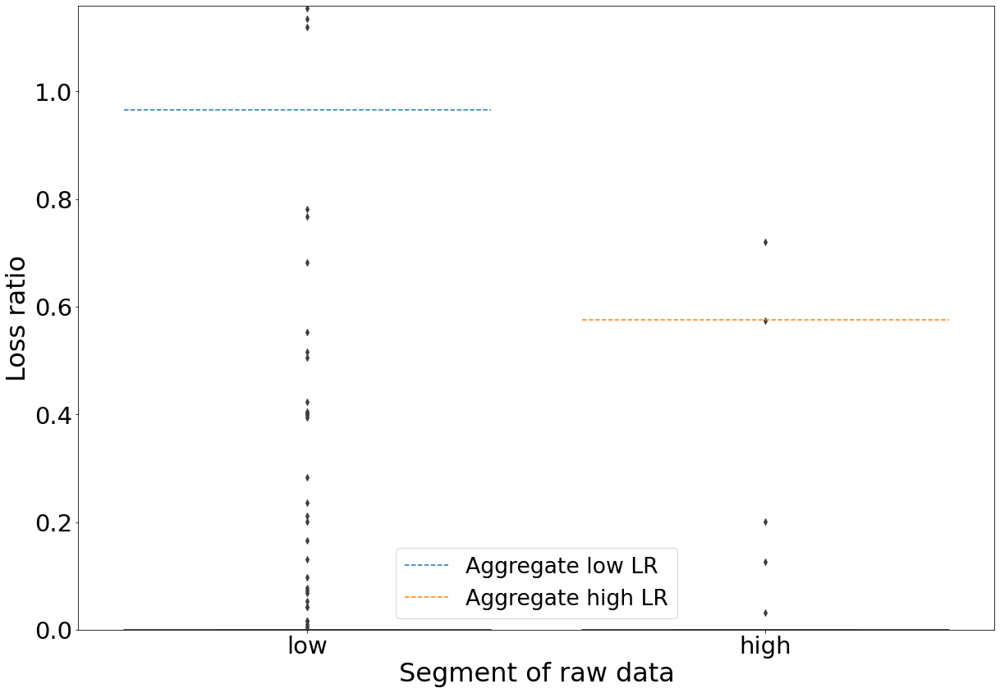

low 0.6507412924891054
high 0.8227009452756467


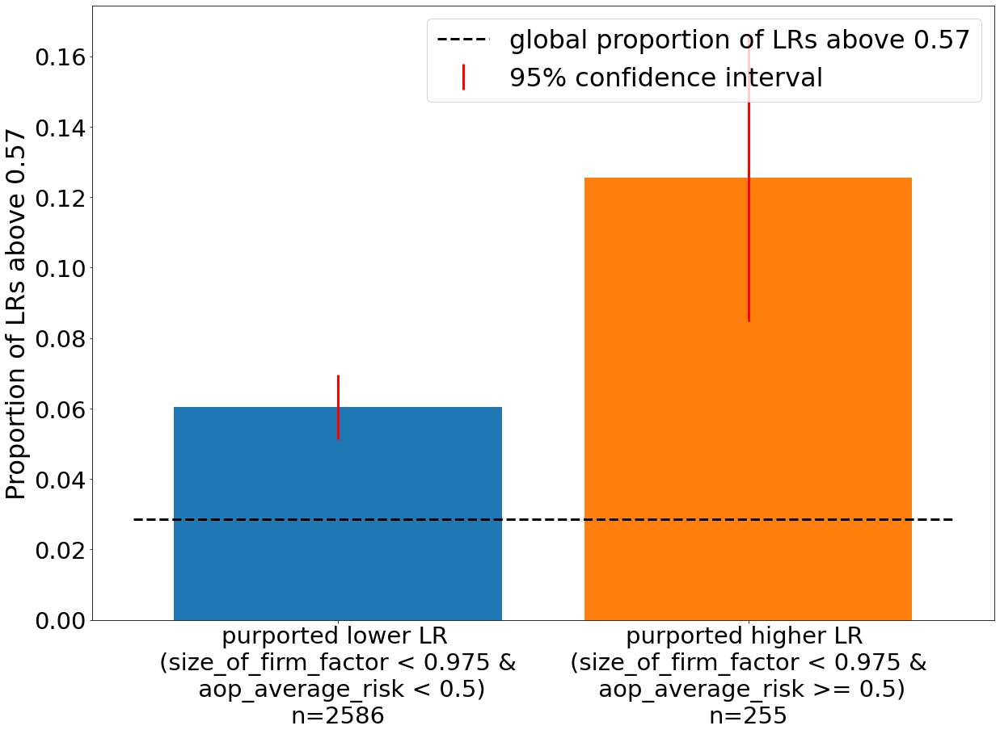

low 0.6507412924891054
high 0.8227009452756467


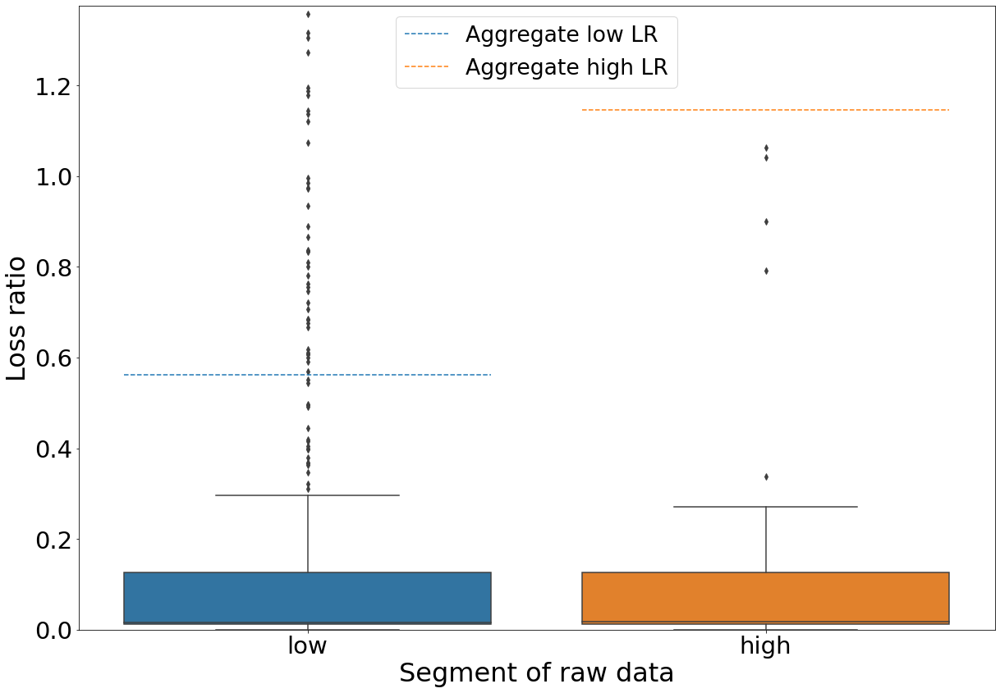

In [422]:
high_mask = (preprocess_df_old["size_of_firm_factor"] < 0.975) & (preprocess_df_old["aop_average_risk"] >= 0.5)
low_mask = (preprocess_df_old["size_of_firm_factor"] < 0.975) & (preprocess_df_old["aop_average_risk"] < 0.5)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_size_of_firm_aop_average_risk_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_size_of_firm_aop_average_risk_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)")

high_mask = (preprocess_df_new["size_of_firm_factor"] < 0.975) & (preprocess_df_new["aop_average_risk"] >= 0.5)
low_mask = (preprocess_df_new["size_of_firm_factor"] < 0.975) & (preprocess_df_new["aop_average_risk"] < 0.5)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_size_of_firm_aop_average_risk_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_size_of_firm_aop_average_risk_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)")

SHAP plots for old and new policies:

In [343]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__size_of_firm_factor", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__aop_average_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_size_firm_factor_aop_avg_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()
# new
shap.dependence_plot("numerical__size_of_firm_factor", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__aop_average_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_size_firm_factor_aop_avg_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [344]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

##### max_detailed_aop_pct related:

Most obvious trend is that high diversity policies (below 0.4) are actually more likely to yield bad LR than more diverse policies (above 0.65). Second is that high exposure may indicate worse performance particularly for high diversity policies.

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=114.21894666976962, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.07804753331826936, pvalue=9.628402146135768e-32)
0.5464299188475151
1.0374955072132708


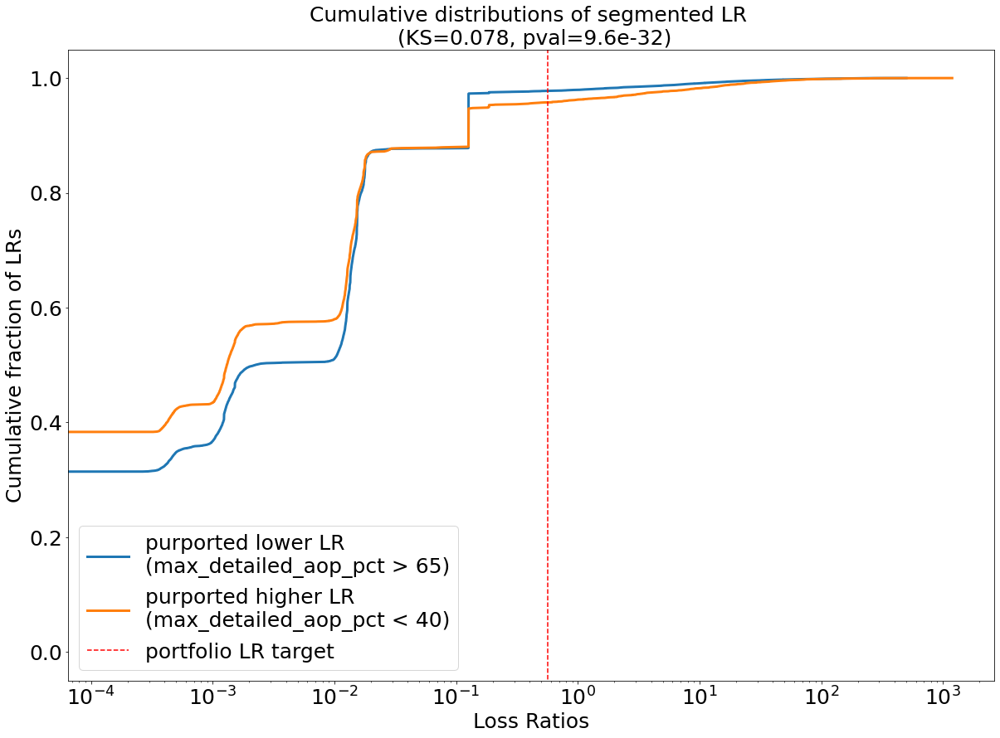

In [98]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) #& (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 65) #& (preprocess_df["exposure"] <= 6)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_max_aop_pct.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(max_detailed_aop_pct > 65)", high_label="purported higher LR \n(max_detailed_aop_pct < 40)")

low 0.5756215839112319
high 1.0374955072132708


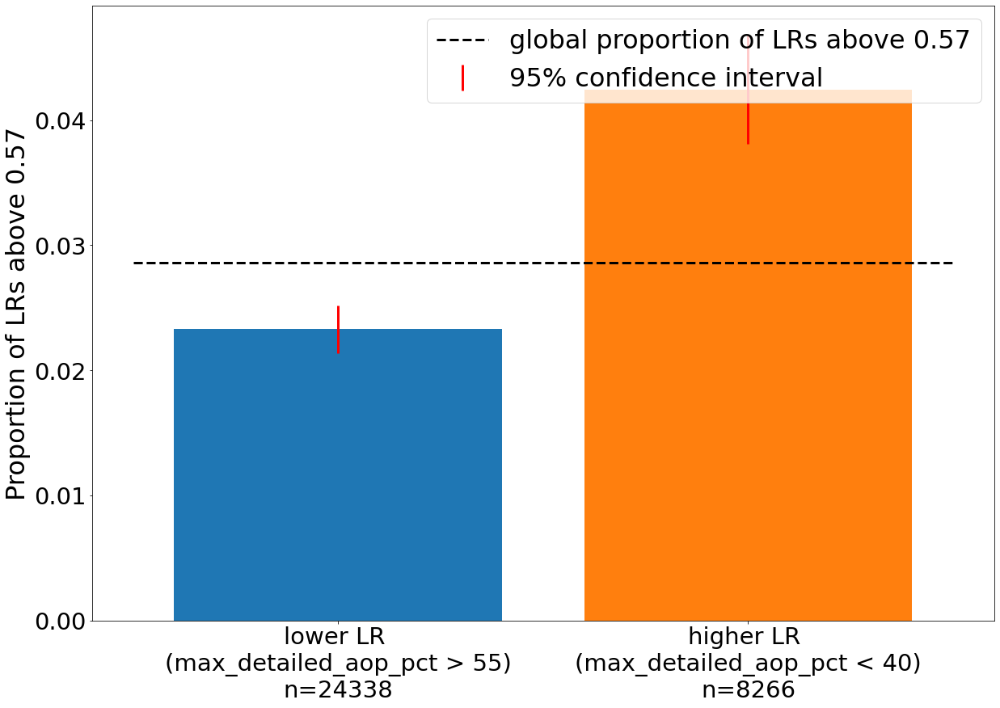

NameError: name 'lr_box_plot' is not defined

In [99]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) #& (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 55) #& (preprocess_df["exposure"] <= 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_max_aop_pct_057_dumbed.png", "ultimate_trended_onlevel_lr", 
                        low_label = "lower LR \n(max_detailed_aop_pct > 55)", high_label = "higher LR \n(max_detailed_aop_pct < 40)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_max_aop_pct_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 55)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40)")

old and new:

low 0.5689917325602716
high 1.5300902811116188


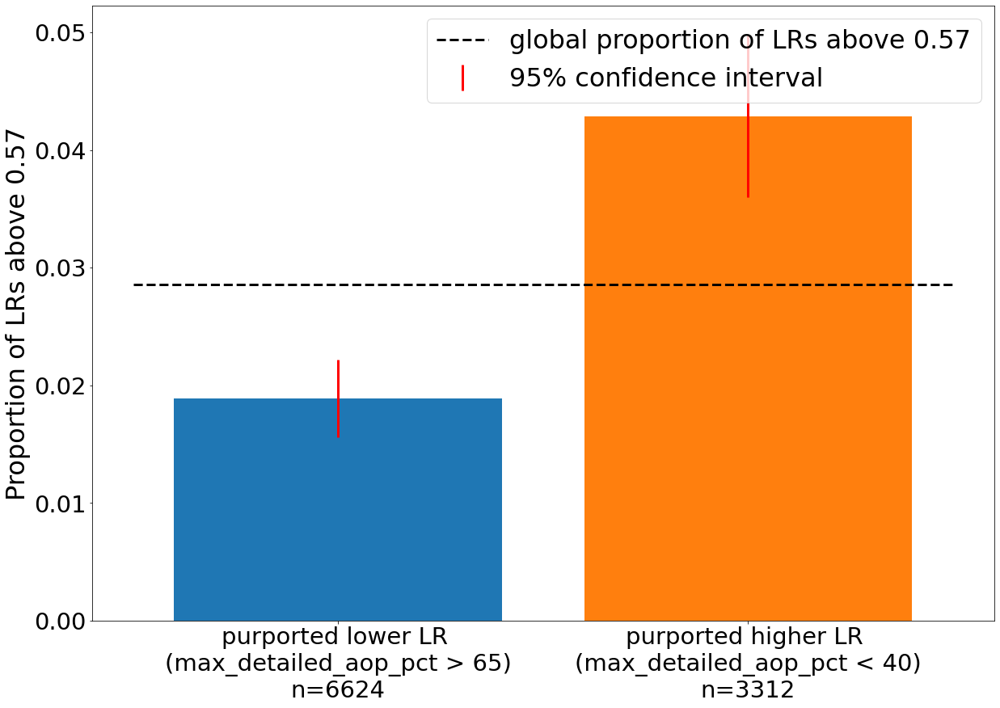

low 0.5689917325602716
high 1.5300902811116188


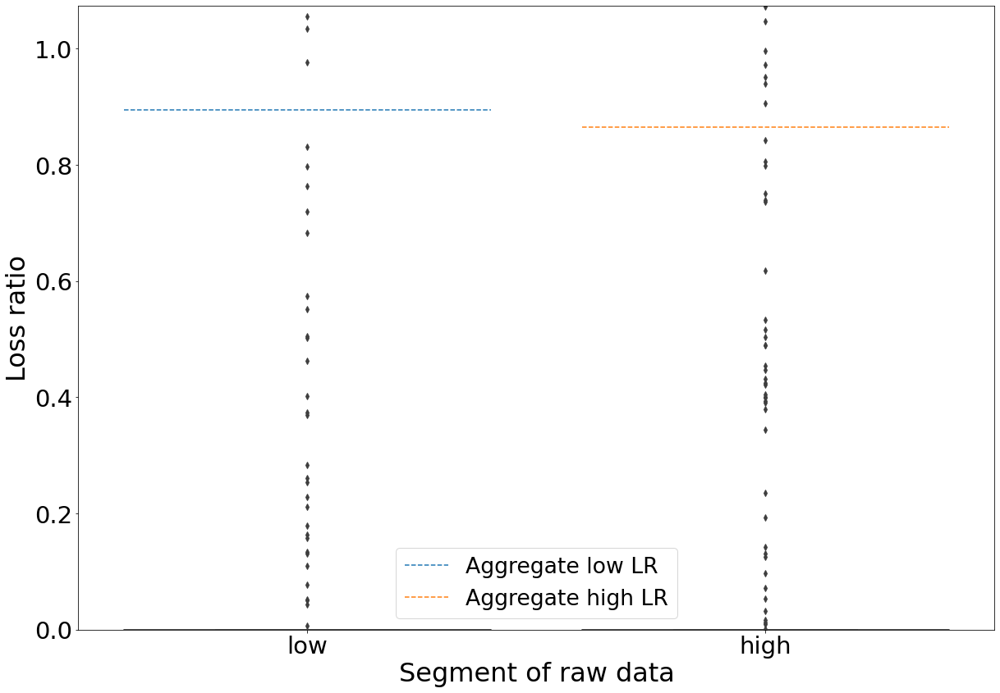

low 0.5358080671038549
high 0.7081709429921706


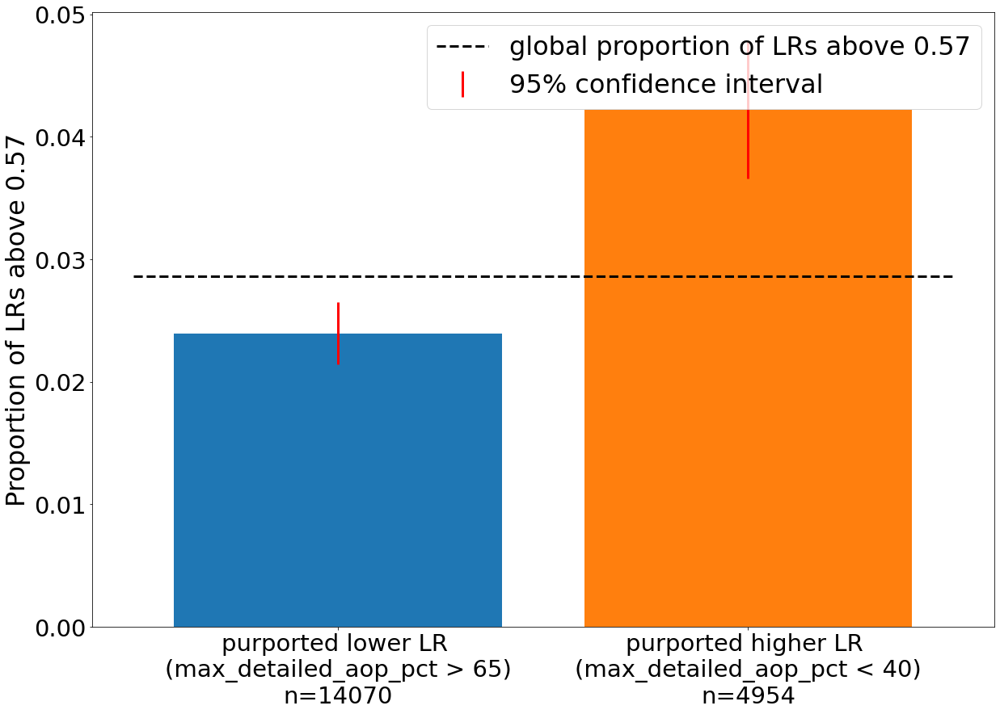

low 0.5358080671038549
high 0.7081709429921706


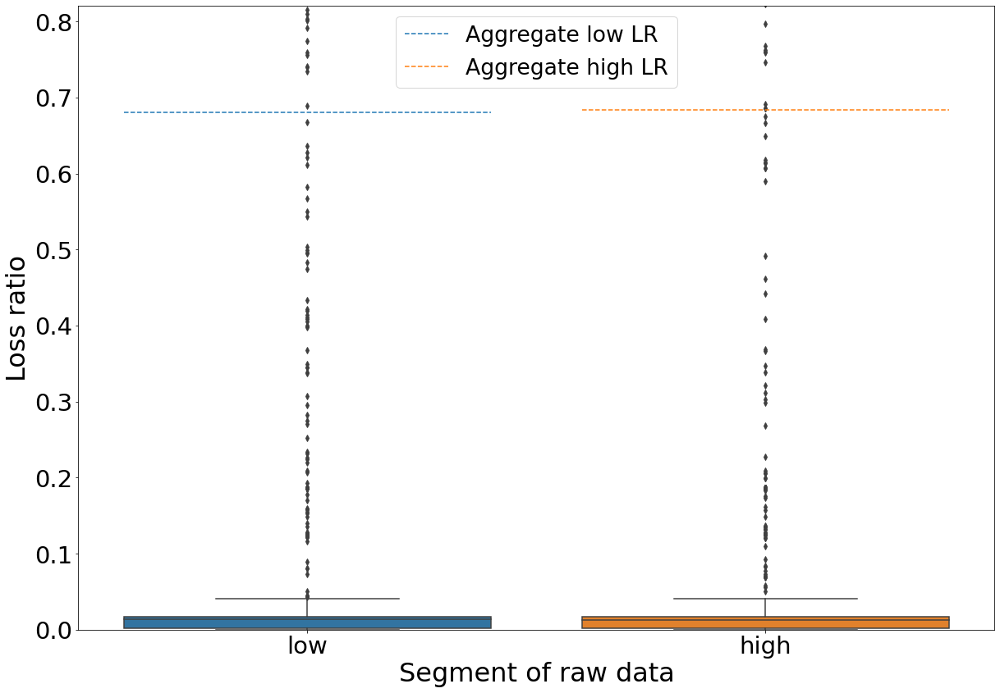

In [423]:
high_mask = (preprocess_df_old["max_detailed_aop_pct"] < 40) #& (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df_old["max_detailed_aop_pct"] > 65) #& (preprocess_df["exposure"] <= 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_max_aop_pct_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 65)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_max_aop_pct_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 65)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40)")

high_mask = (preprocess_df_new["max_detailed_aop_pct"] < 40) #& (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df_new["max_detailed_aop_pct"] > 65) #& (preprocess_df["exposure"] <= 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_max_aop_pct_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 65)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_max_aop_pct_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 65)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40)")

SHAP plots for old and new policies:

In [345]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__max_detailed_aop_pct", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_max_detailed_aop" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("numerical__max_detailed_aop_pct", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_max_detailed_aop" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [346]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=69.90539289636664, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.15856099941410914, pvalue=1.891978359343828e-21)
1.0868163918373068
0.7172004060691436


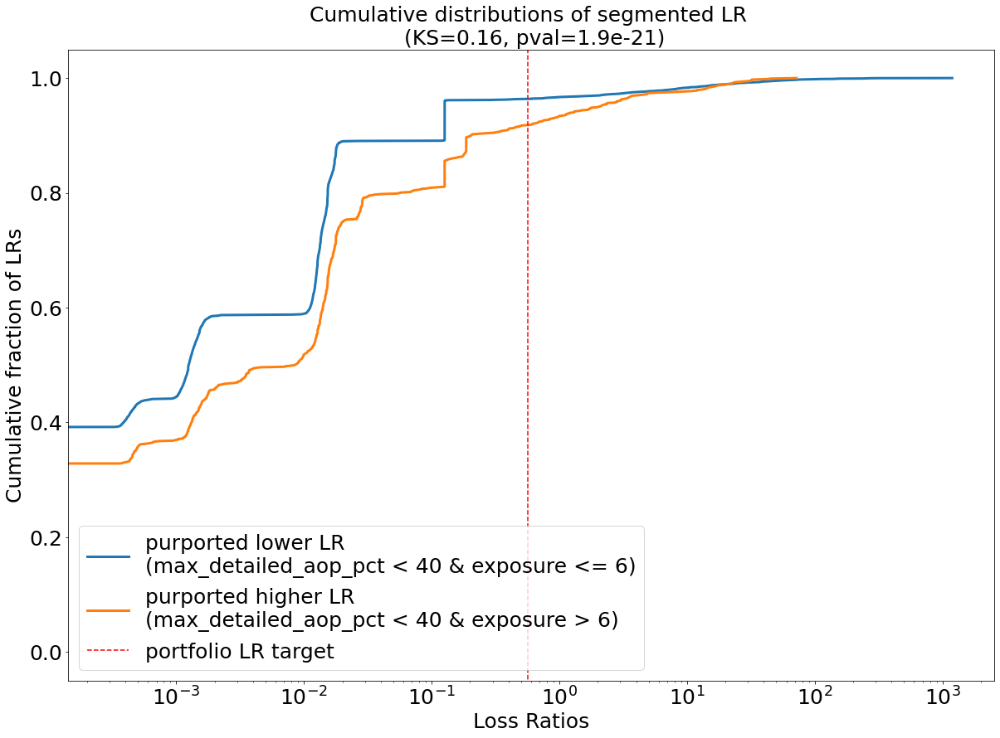

In [99]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] <= 6)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_max_aop_pct_exposure.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(max_detailed_aop_pct < 40 & exposure <= 6)", high_label="purported higher LR \n(max_detailed_aop_pct < 40 & exposure > 6)")

^ more convincing that exposure isn't priced in appropriately for high diversity policies.

low 1.0868163918373068
high 0.7172004060691436


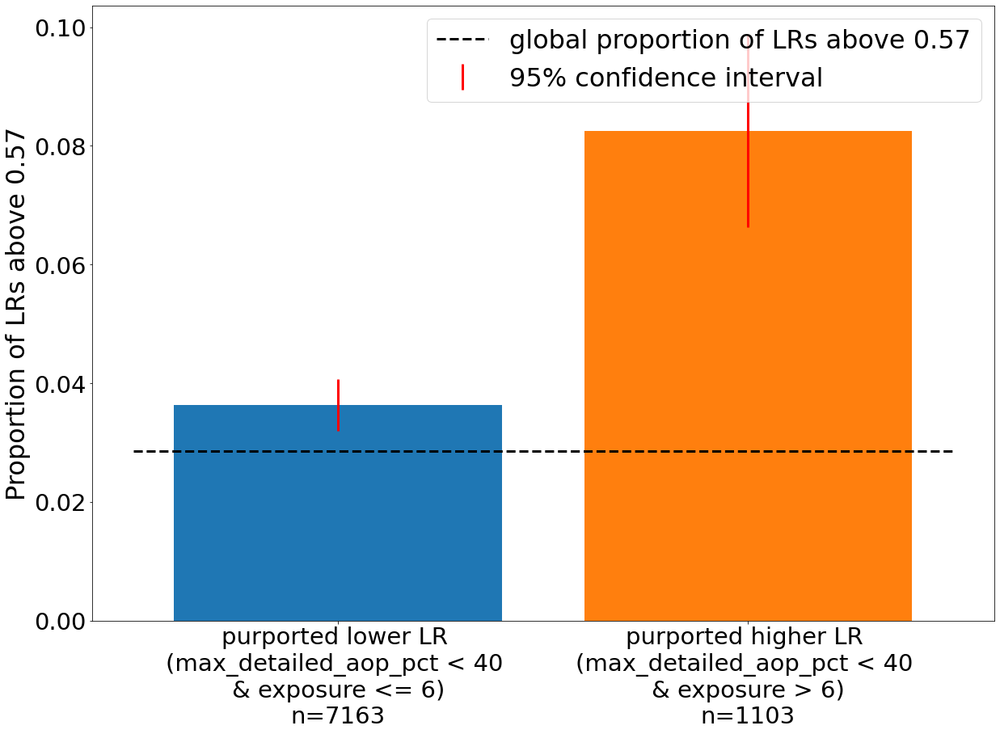

low 1.0868163918373068
high 0.7172004060691436


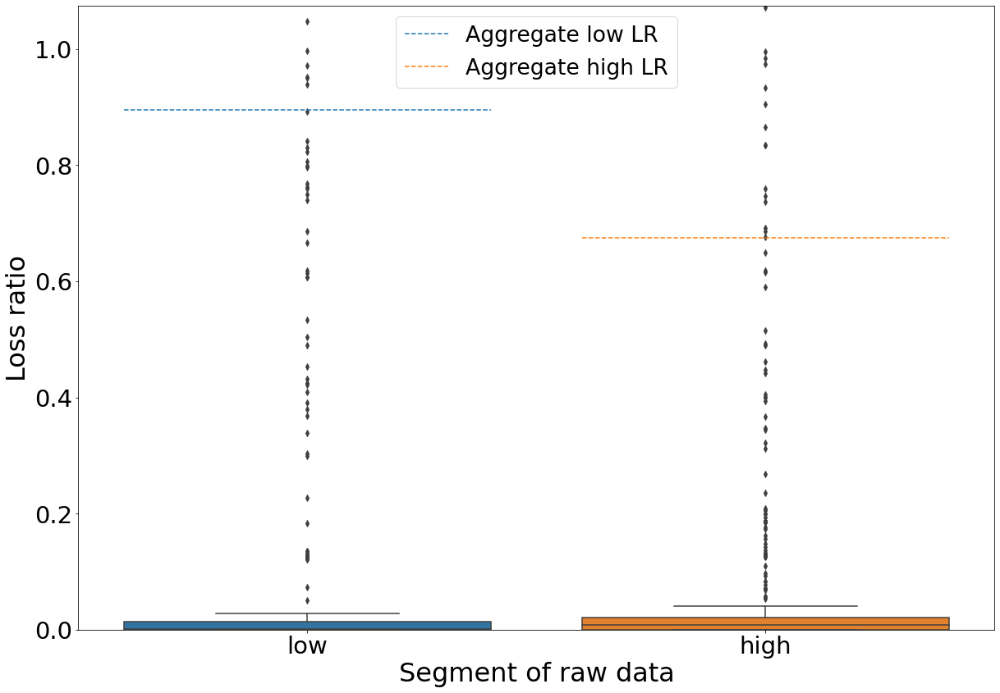

In [377]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] > 6)
low_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] <= 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_max_aop_pct_exposure_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct < 40 \n& exposure <= 6)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_max_aop_pct_exposure_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(max_detailed_aop_pct < 40 \n& exposure <= 6)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure > 6)")

old and new:

low 1.5968942066890899
high 1.023695757174621


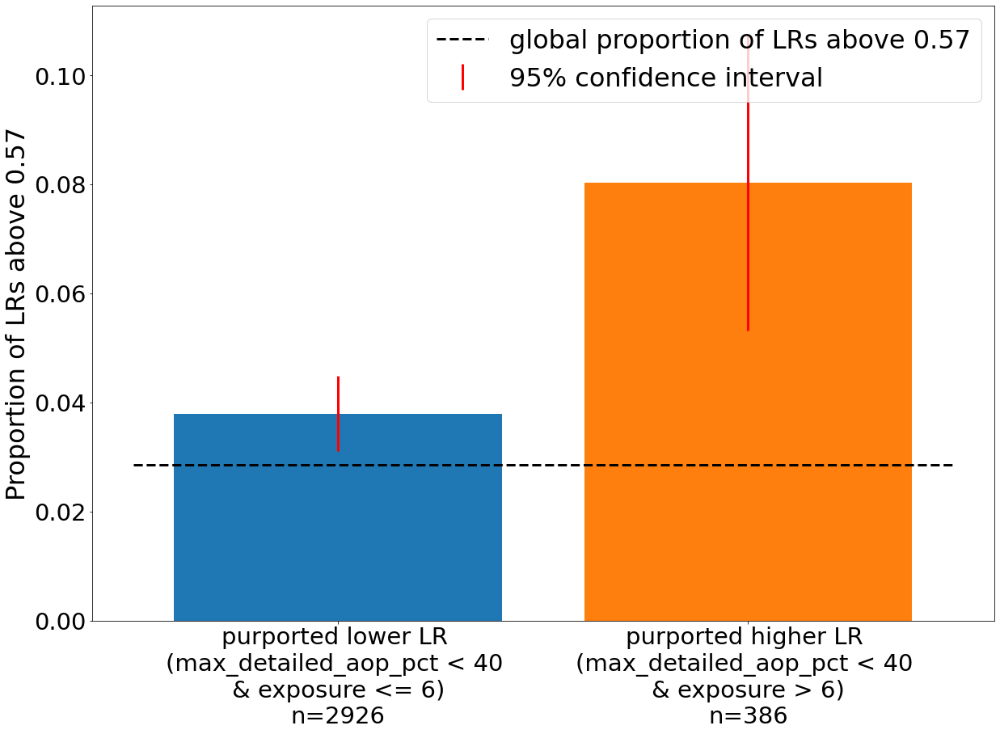

low 1.5968942066890899
high 1.023695757174621


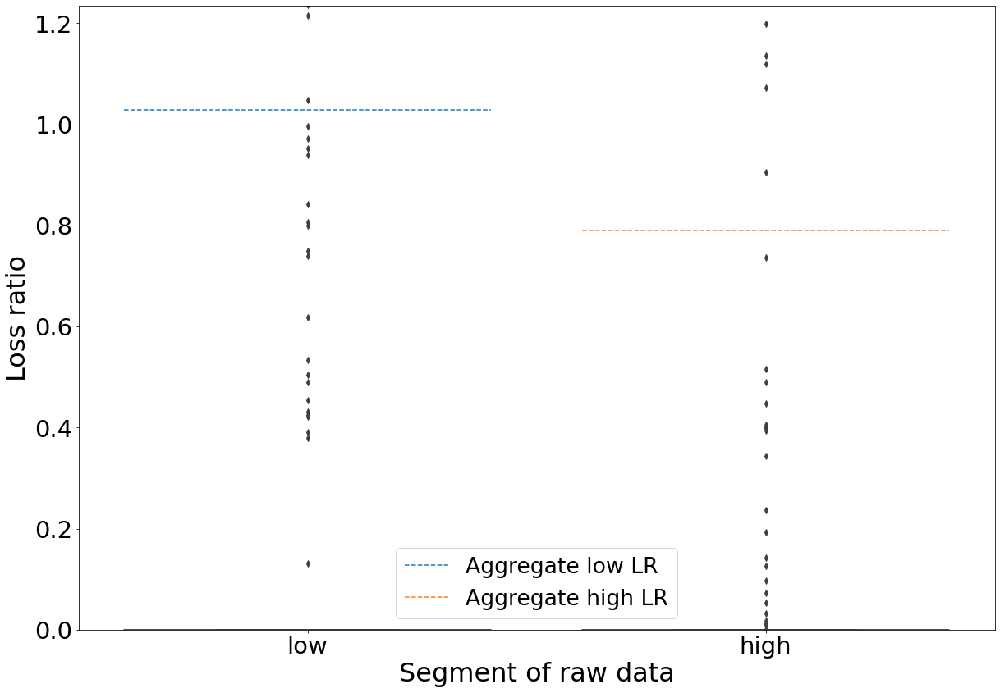

low 0.734565344809618
high 0.5521973300207277


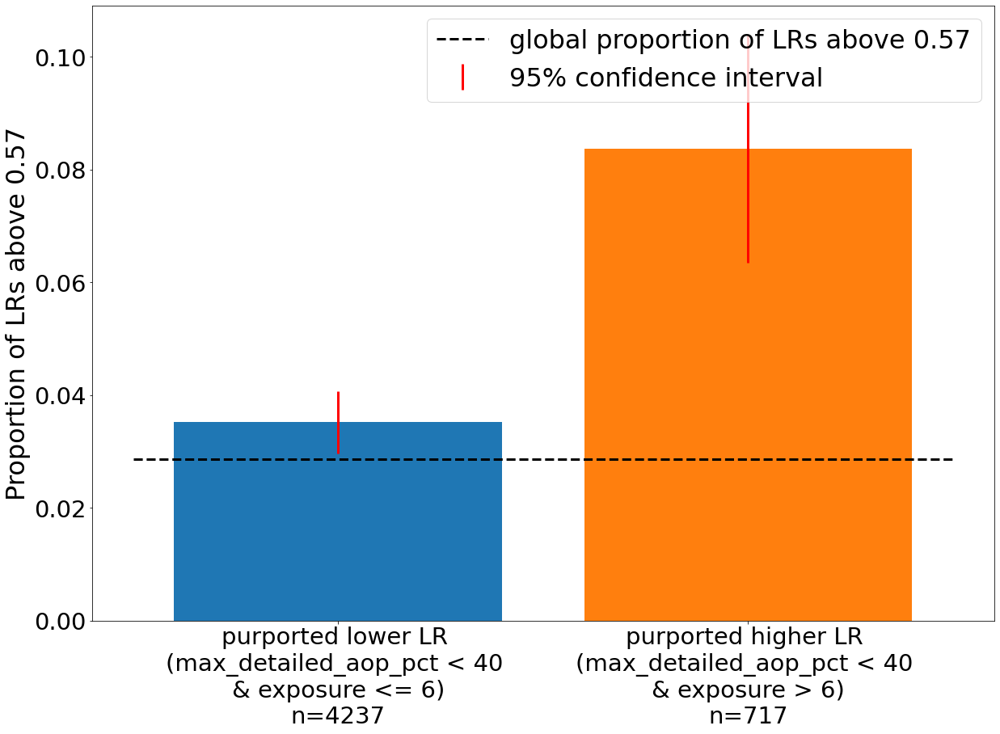

low 0.734565344809618
high 0.5521973300207277


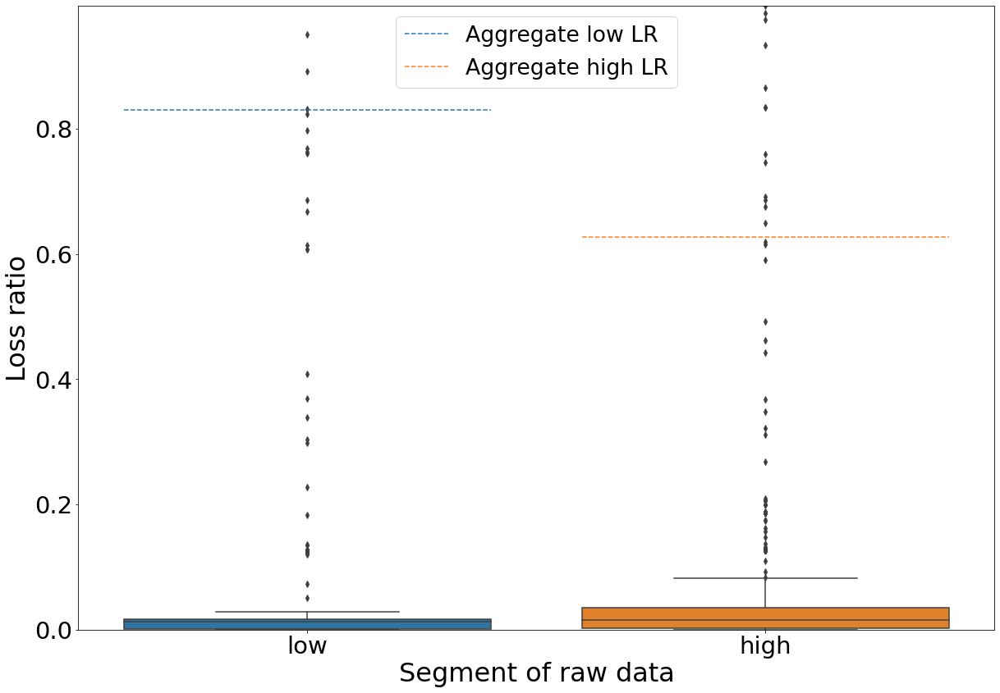

In [424]:
high_mask = (preprocess_df_old["max_detailed_aop_pct"] < 40) & (preprocess_df_old["exposure"] > 6)
low_mask = (preprocess_df_old["max_detailed_aop_pct"] < 40) & (preprocess_df_old["exposure"] <= 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_max_aop_pct_exposure_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct < 40 \n& exposure <= 6)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_max_aop_pct_exposure_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(max_detailed_aop_pct < 40 \n& exposure <= 6)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure > 6)")

high_mask = (preprocess_df_new["max_detailed_aop_pct"] < 40) & (preprocess_df_new["exposure"] > 6)
low_mask = (preprocess_df_new["max_detailed_aop_pct"] < 40) & (preprocess_df_new["exposure"] <= 6)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_max_aop_pct_exposure_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct < 40 \n& exposure <= 6)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure > 6)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_max_aop_pct_exposure_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(max_detailed_aop_pct < 40 \n& exposure <= 6)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure > 6)")

SHAP plots for old and new policies:

In [347]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__max_detailed_aop_pct", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_max_detailed_aop_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("numerical__max_detailed_aop_pct", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_max_detailed_aop_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [348]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 540x360 with 0 Axes>

##### increased_limits_factor related:

Most obvious trend is that high increased limits yields higher probabilities. Also possible that aop_above_average_risk is prices accordingly in this interaction for low increased limits factors.

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=25.97307198199026, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.12988056151286143, pvalue=5.44629271775956e-09)
0.6830063231621416
0.3375893001482336


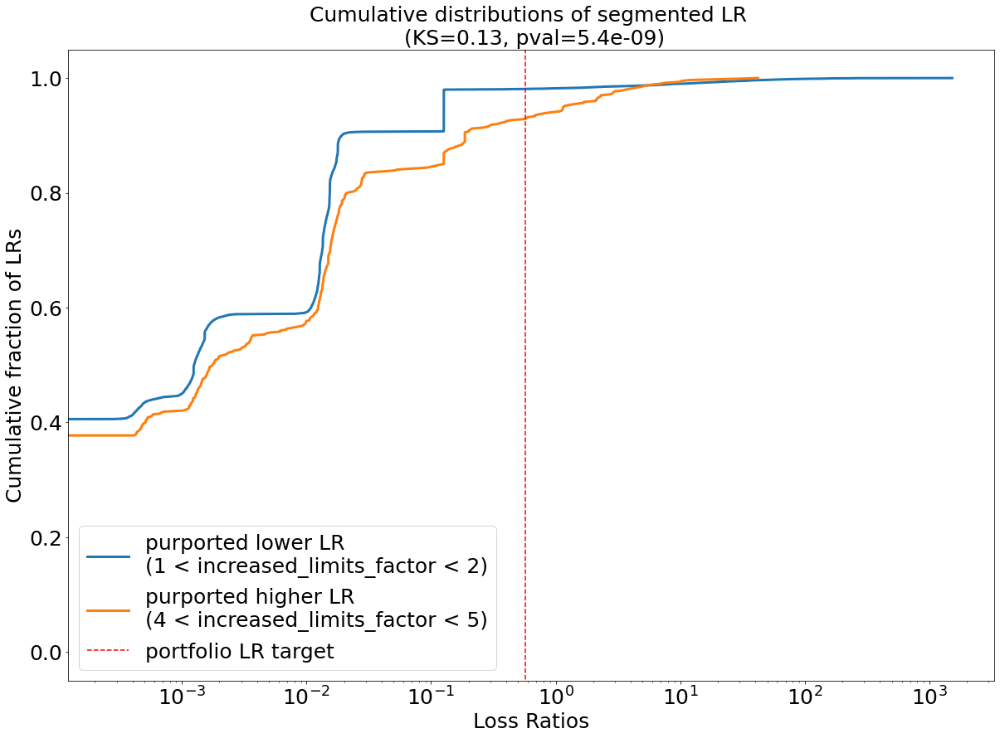

In [100]:
high_mask = (preprocess_df["increased_limits_factor"] < 5) & (preprocess_df["increased_limits_factor"] > 4)
low_mask = (preprocess_df["increased_limits_factor"] < 2) & (preprocess_df["increased_limits_factor"] > 1)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_increased_limits.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(1 < increased_limits_factor < 2)", high_label="purported higher LR \n(4 < increased_limits_factor < 5)")

low 0.6830063231621416
high 0.3375893001482336


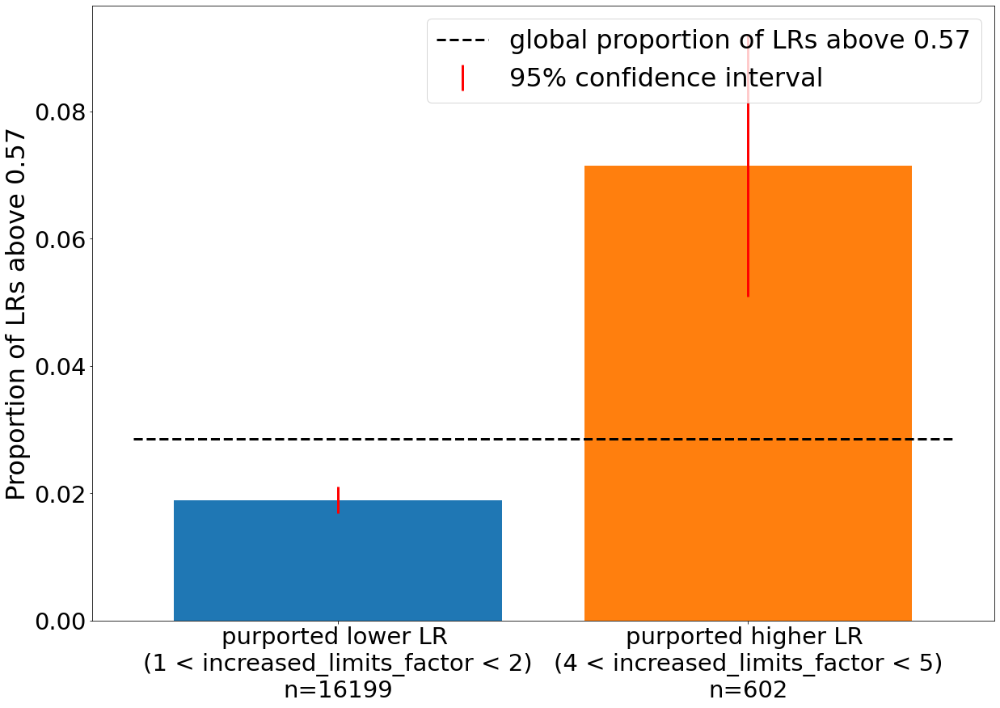

low 0.6830063231621416
high 0.3375893001482336


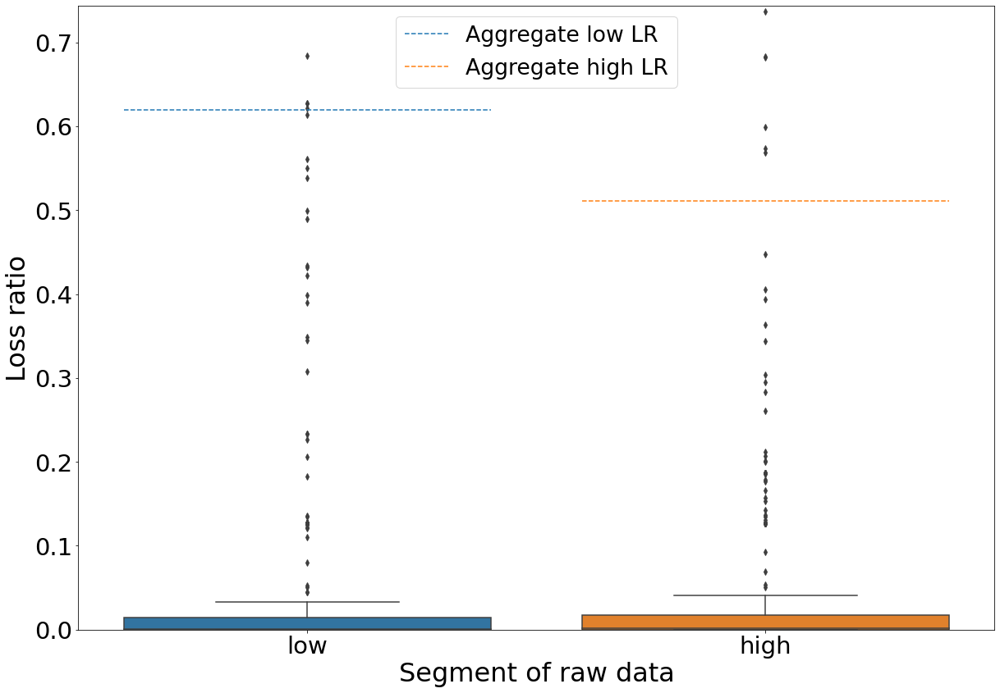

In [378]:
high_mask = (preprocess_df["increased_limits_factor"] < 5) & (preprocess_df["increased_limits_factor"] > 4)
low_mask = (preprocess_df["increased_limits_factor"] < 2) & (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_increased_limits_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_increased_limits_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5)")

old and new:

low 0.8724651679946244
high 0.5443677934486545


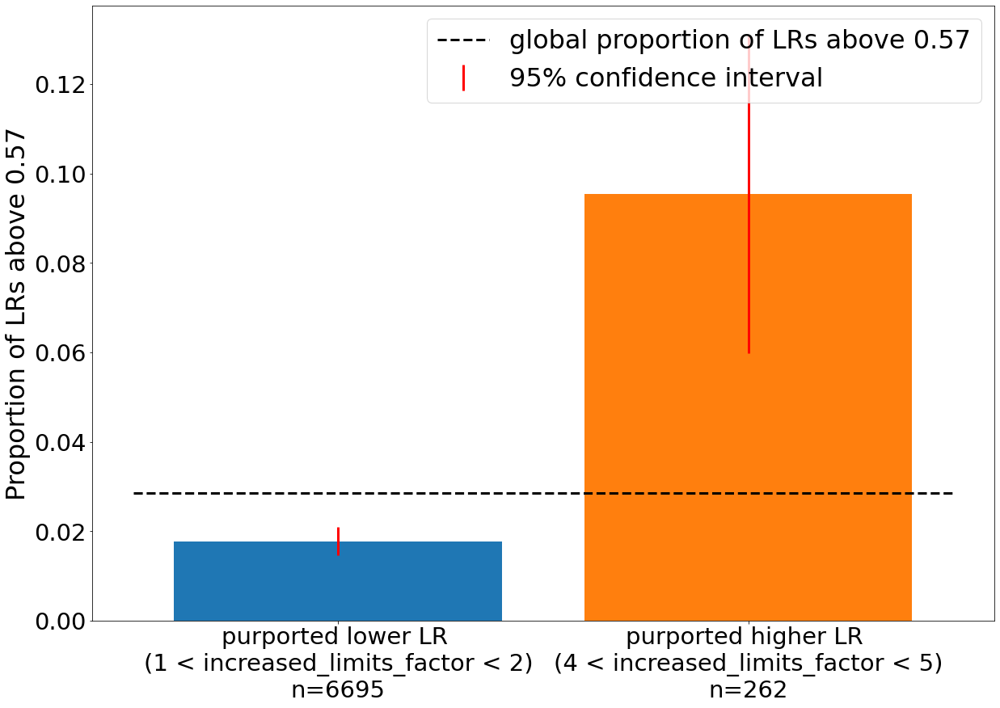

low 0.8724651679946244
high 0.5443677934486545


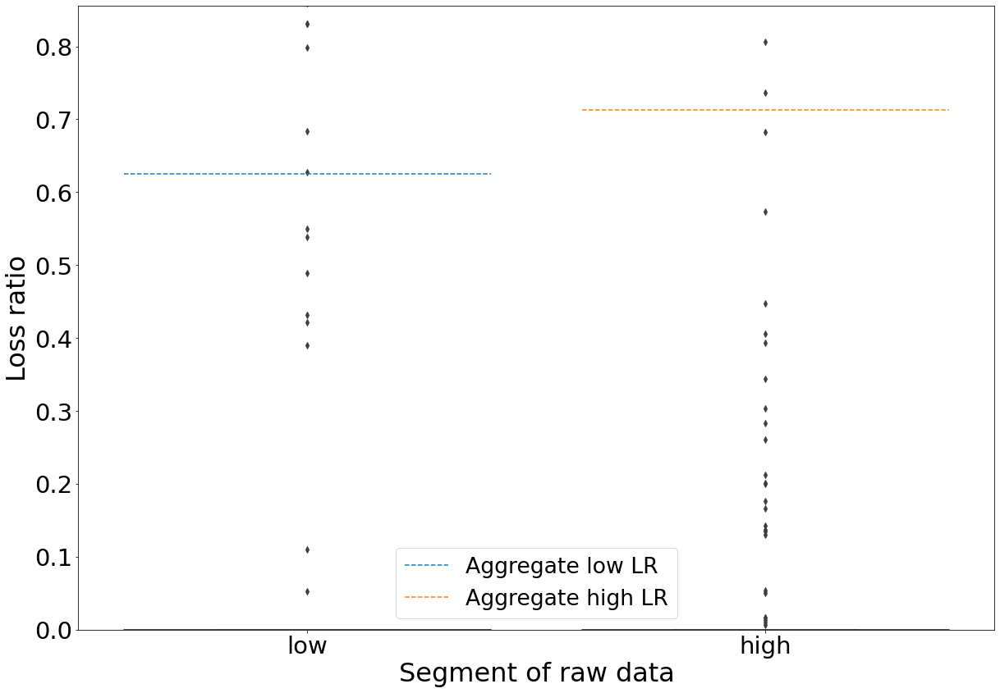

low 0.5495438898547476
high 0.1782482258990858


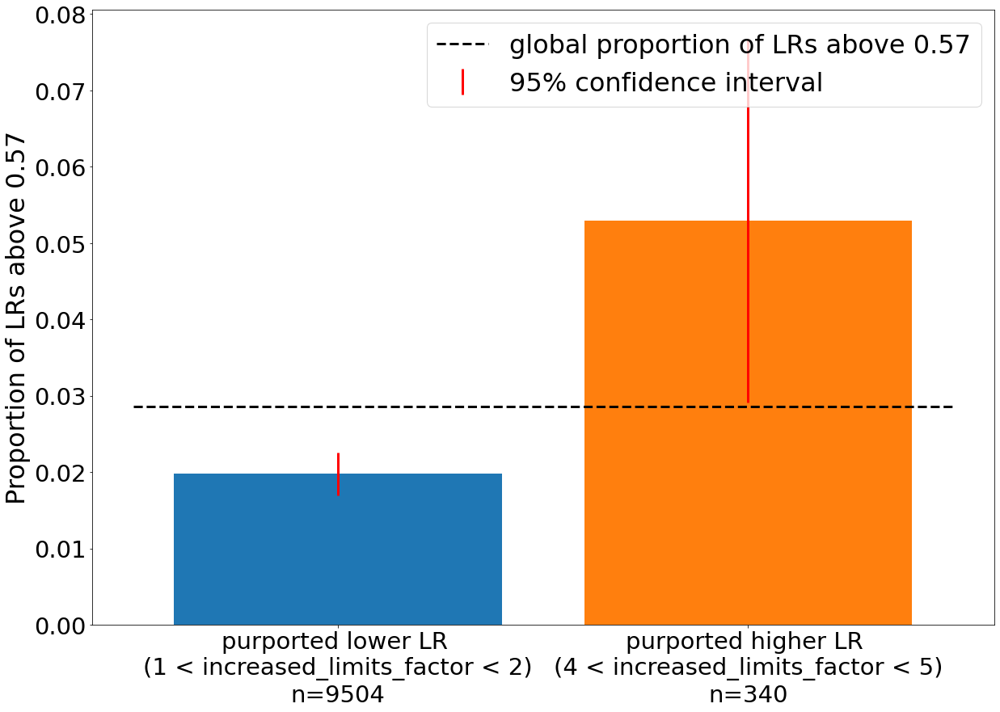

low 0.5495438898547476
high 0.1782482258990858


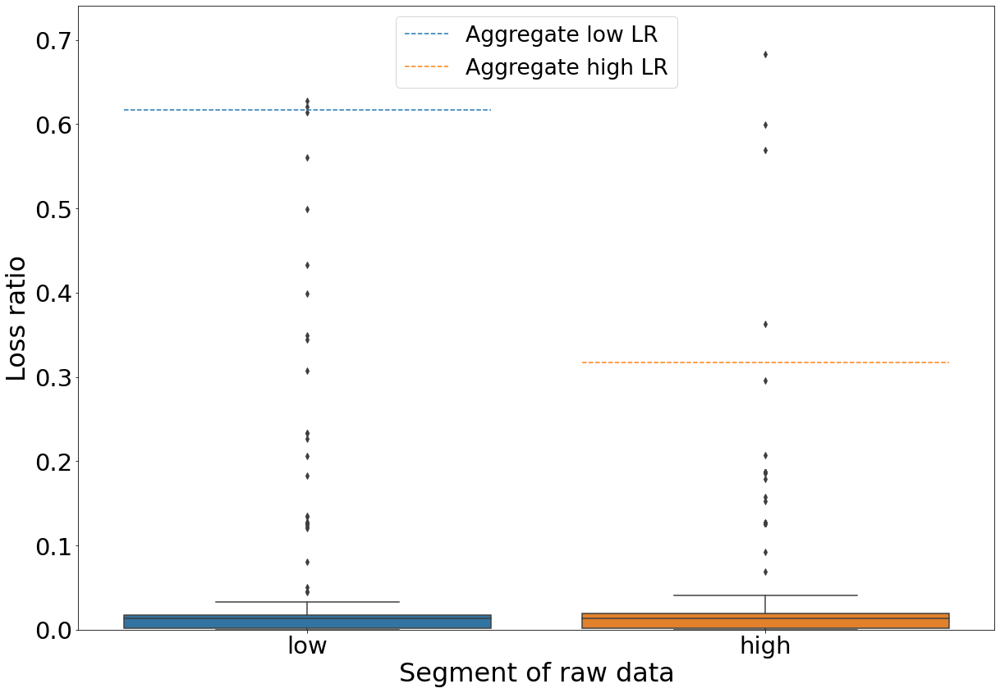

In [425]:
high_mask = (preprocess_df_old["increased_limits_factor"] < 5) & (preprocess_df_old["increased_limits_factor"] > 4)
low_mask = (preprocess_df_old["increased_limits_factor"] < 2) & (preprocess_df_old["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_increased_limits_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_increased_limits_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5)")

high_mask = (preprocess_df_new["increased_limits_factor"] < 5) & (preprocess_df_new["increased_limits_factor"] > 4)
low_mask = (preprocess_df_new["increased_limits_factor"] < 2) & (preprocess_df_new["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_increased_limits_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_increased_limits_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5)")

SHAP plots for old and new policies:

In [349]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__increased_limits_factor", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_increased_limits_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("numerical__increased_limits_factor", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_increased_limits_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [350]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=23.37993998023431, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.06098702298194547, pvalue=8.788481634558003e-11)
0.6166942378782013
0.7011518621773651


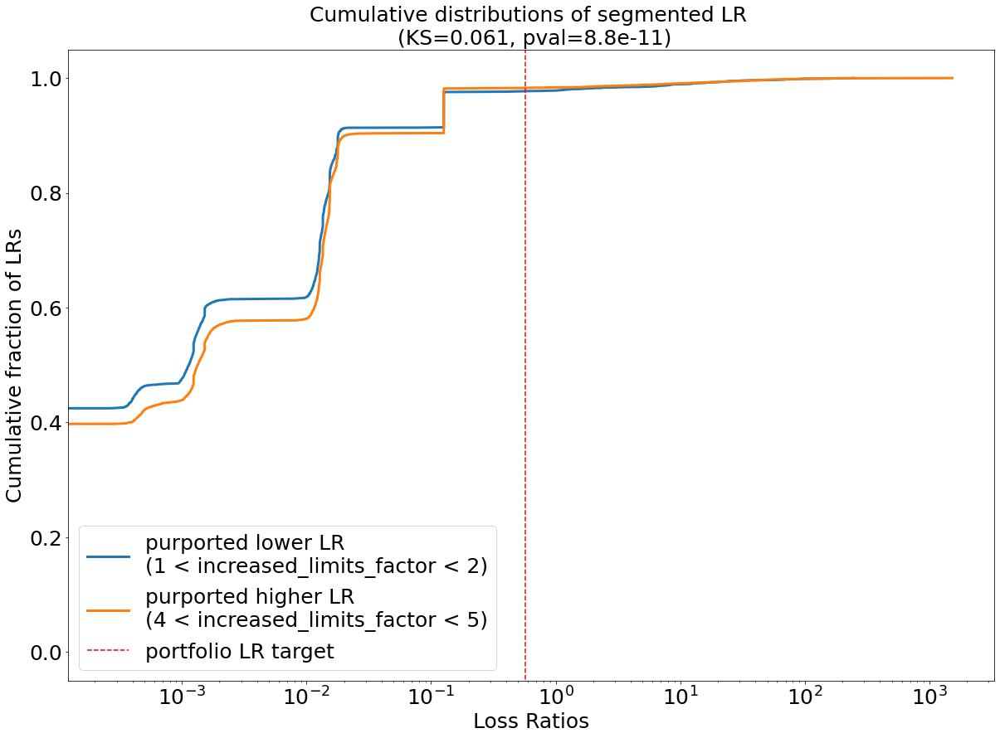

In [101]:
high_mask = (preprocess_df["increased_limits_factor"] < 2) & (preprocess_df["increased_limits_factor"] > 1) & (preprocess_df["aop_above_average_risk"] < 0.5)
low_mask = (preprocess_df["increased_limits_factor"] < 2) & (preprocess_df["increased_limits_factor"] > 1) & (preprocess_df["aop_above_average_risk"] > 0.5)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(1 < increased_limits_factor < 2)", high_label="purported higher LR \n(4 < increased_limits_factor < 5)")

^ Not convincing..

##### schedule_modification_factor related:

Most obvious trend is that high shcedule modification factor yields higher probabilities. 

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=221.89609343841275, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.3248089926656077, pvalue=2.861698287761808e-64)
0.7177297191637133
0.7997716375296751


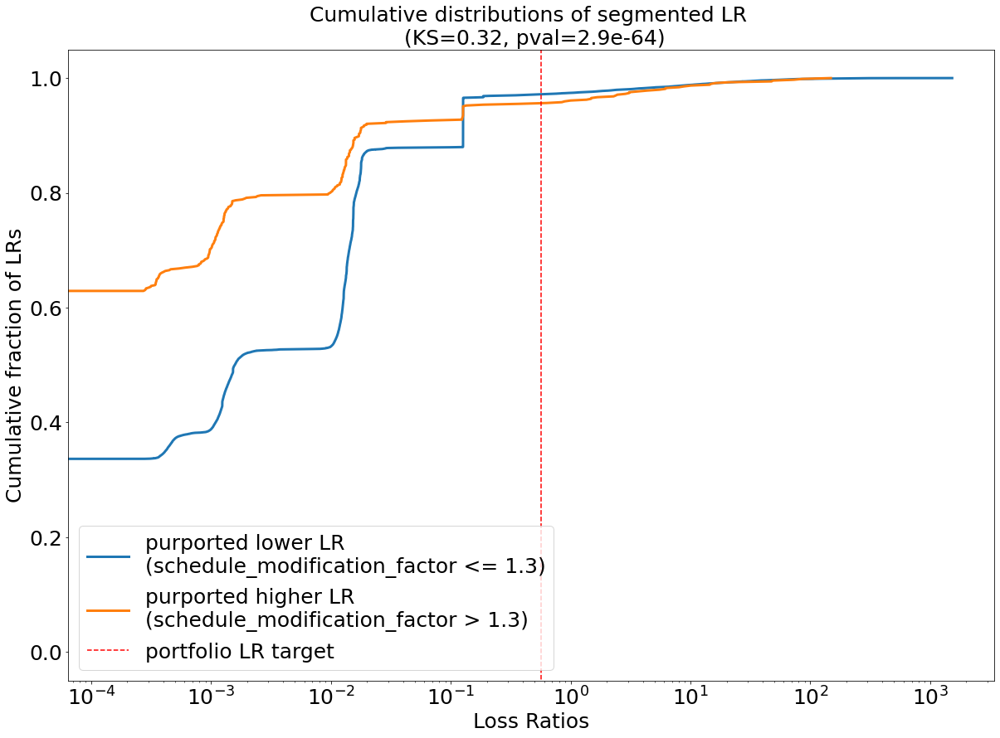

In [255]:
high_mask = (preprocess_df["schedule_modification_factor"] > 1.3) 
low_mask = (preprocess_df["schedule_modification_factor"] <= 1.3) #& (preprocess_df["increased_limits_factor"] > 1)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_schedule_mod.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(schedule_modification_factor <= 1.3)", high_label="purported higher LR \n(schedule_modification_factor > 1.3)")

low 0.7133546033204622
high 0.9234349931875088


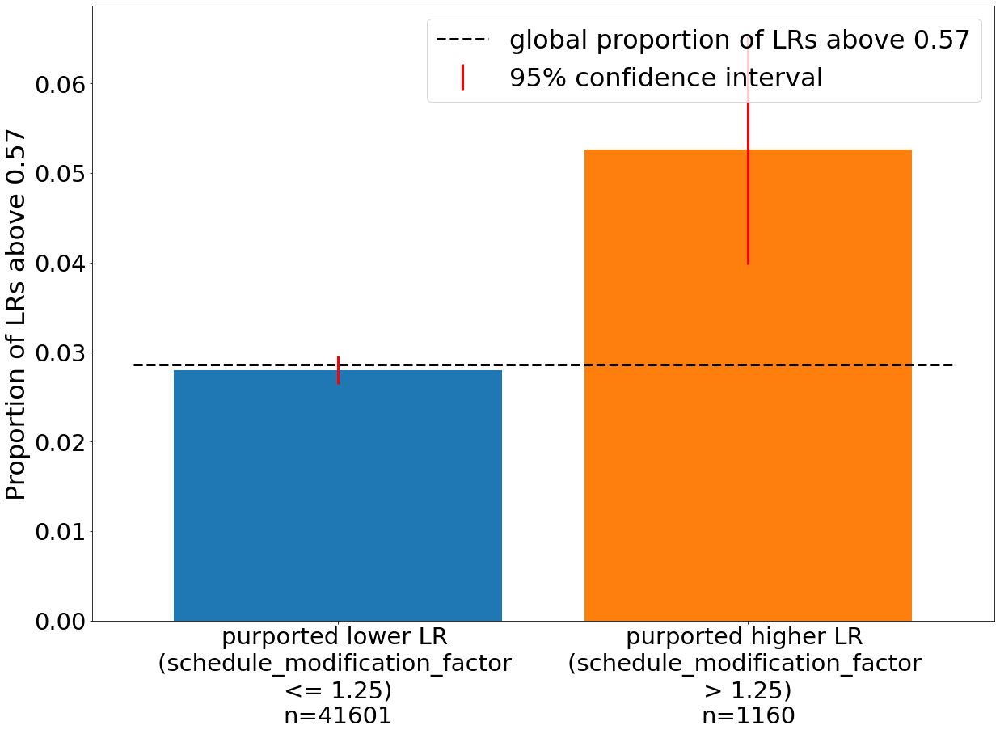

low 0.7133546033204622
high 0.9234349931875088


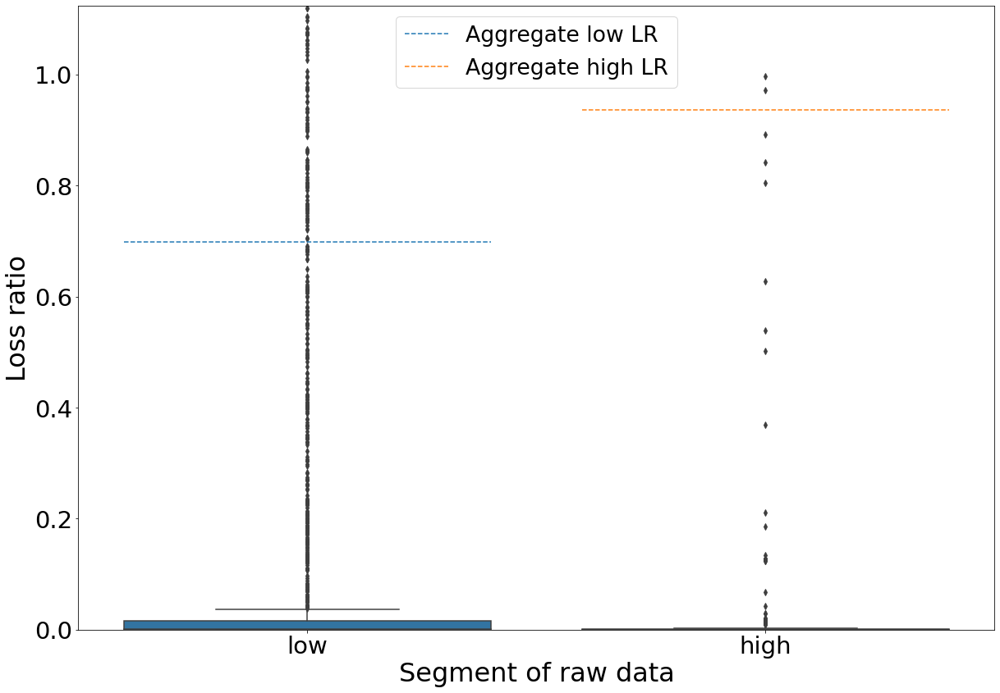

In [248]:
high_mask = (preprocess_df["schedule_modification_factor"] > 1.25) 
low_mask = (preprocess_df["schedule_modification_factor"] <= 1.25) #& (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_schedule_modification_factor_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(schedule_modification_factor \n<= 1.25)", high_label = "purported higher LR \n(schedule_modification_factor \n> 1.25)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_schedule_modification_factor_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(schedule_modification_factor \n<= 1.25)", high_label = "purported higher LR \n(schedule_modification_factor \n> 1.25)")

old and new:

In [245]:
high_mask = (preprocess_df_old["schedule_modification_factor"] > 1.3) 
low_mask = (preprocess_df_old["schedule_modification_factor"] <= 1.3) #& (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_schedule_modification_factor_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(schedule_modification_factor \n<= 1.3)", high_label = "purported higher LR \n(schedule_modification_factor \n> 1.3)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_schedule_modification_factor_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(schedule_modification_factor \n<= 1.3)", high_label = "purported higher LR \n(schedule_modification_factor \n> 1.3)")

high_mask = (preprocess_df_new["schedule_modification_factor"] > 1.3) 
low_mask = (preprocess_df_new["schedule_modification_factor"] <= 1.3) #& (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_schedule_modification_factor_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(schedule_modification_factor \n<= 1.3)", high_label = "purported higher LR \n(schedule_modification_factor \n> 1.3)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_schedule_modification_factor_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(schedule_modification_factor \n<= 1.3)", high_label = "purported higher LR \n(schedule_modification_factor \n> 1.3)")

NameError: name 'preprocess_df_old' is not defined

SHAP plots for old and new policies:

In [351]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__schedule_modification_factor", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_schedule_modification_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("numerical__schedule_modification_factor", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_schedule_modification_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [352]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

Anderson_ksampResult(statistic=3.439020445734829, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.013169447670549101)
KstestResult(statistic=0.11334330409474919, pvalue=0.10254802189338333)
0.7569190352982654
0.6844855358369171


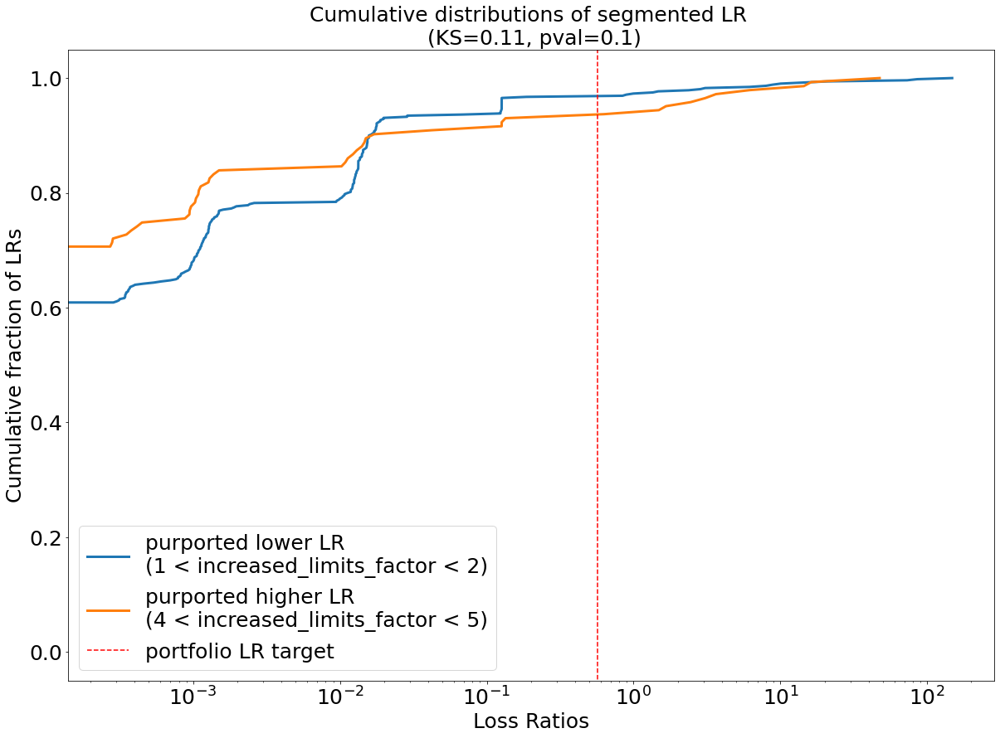

In [103]:
high_mask = (preprocess_df["schedule_modification_factor"] > 1.3) & (preprocess_df["experience_modification_factor"] > 1.050)
low_mask = (preprocess_df["schedule_modification_factor"] > 1.3) & (preprocess_df["experience_modification_factor"] < 1.050)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(1 < increased_limits_factor < 2)", high_label="purported higher LR \n(4 < increased_limits_factor < 5)")

##### prev_agg_lr_bad related:

Most obvious trend is that when the aggregate is bad (below portfolio target), then probability of being a bad LR is higher. Furthermore, not_greater_financial_crisis being 1 may worsen this effect.

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=76.52470343347959, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.12313201482067931, pvalue=6.426484058346754e-16)
0.6240924594415411
1.3758662171882474


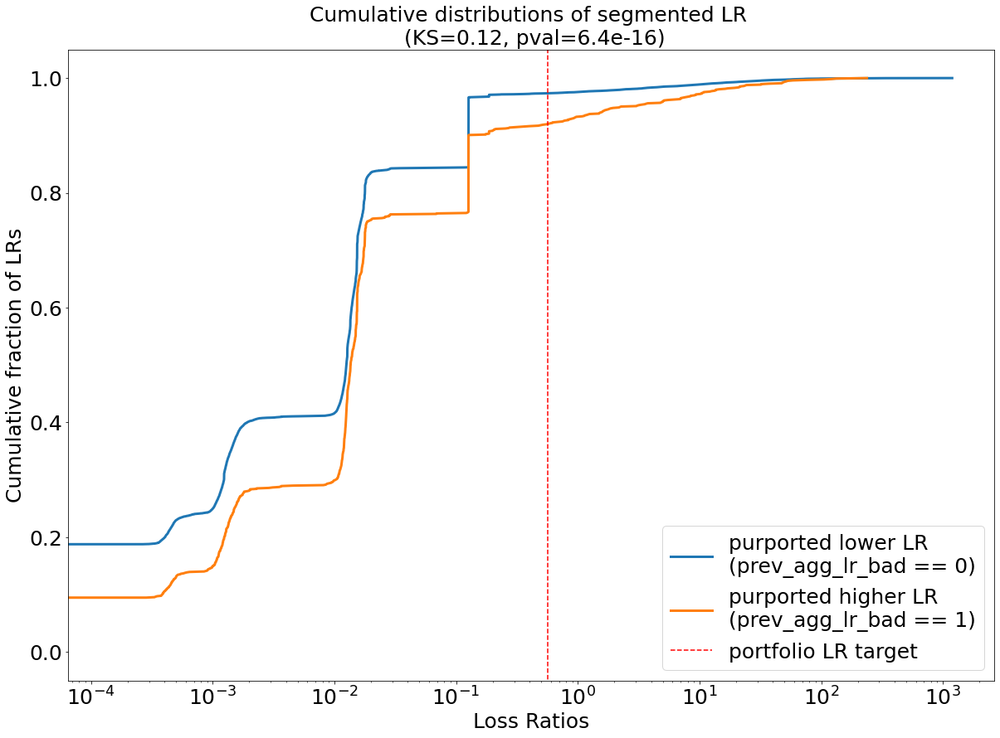

In [104]:
high_mask = (preprocess_df["prev_agg_lr_bad"] == 1.0) 
low_mask = (preprocess_df["prev_agg_lr_bad"] == 0.0)  #& (preprocess_df["increased_limits_factor"] > 1)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_prev_agg_lr_bad.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(prev_agg_lr_bad == 0)", high_label="purported higher LR \n(prev_agg_lr_bad == 1)")

low 0.6240924594415411
high 1.3758662171882474


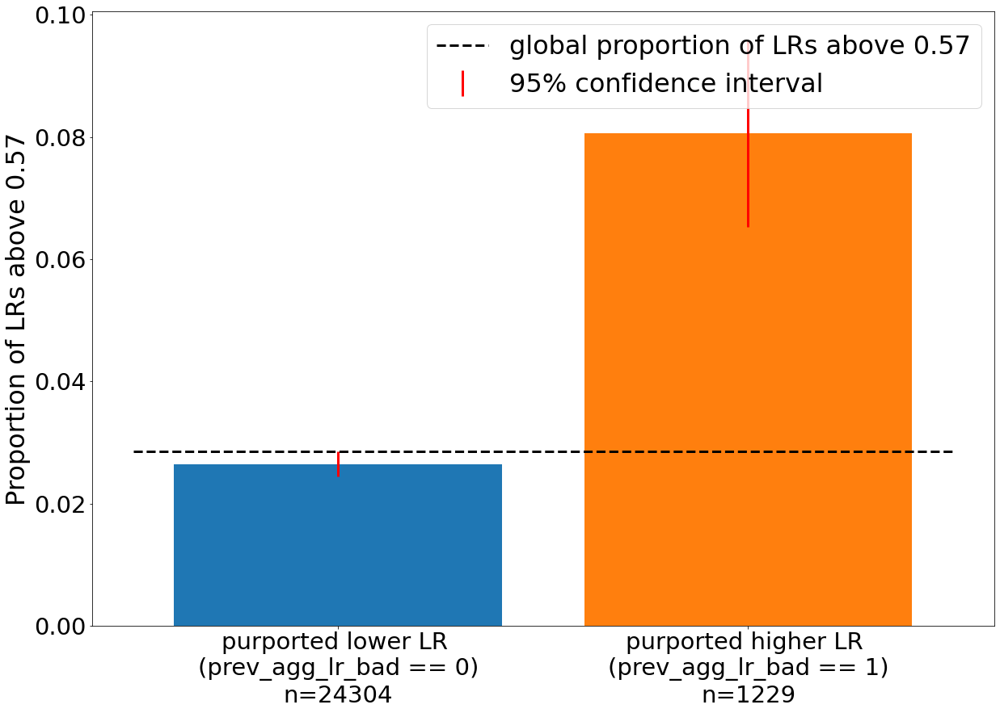

low 0.6240924594415411
high 1.3758662171882474


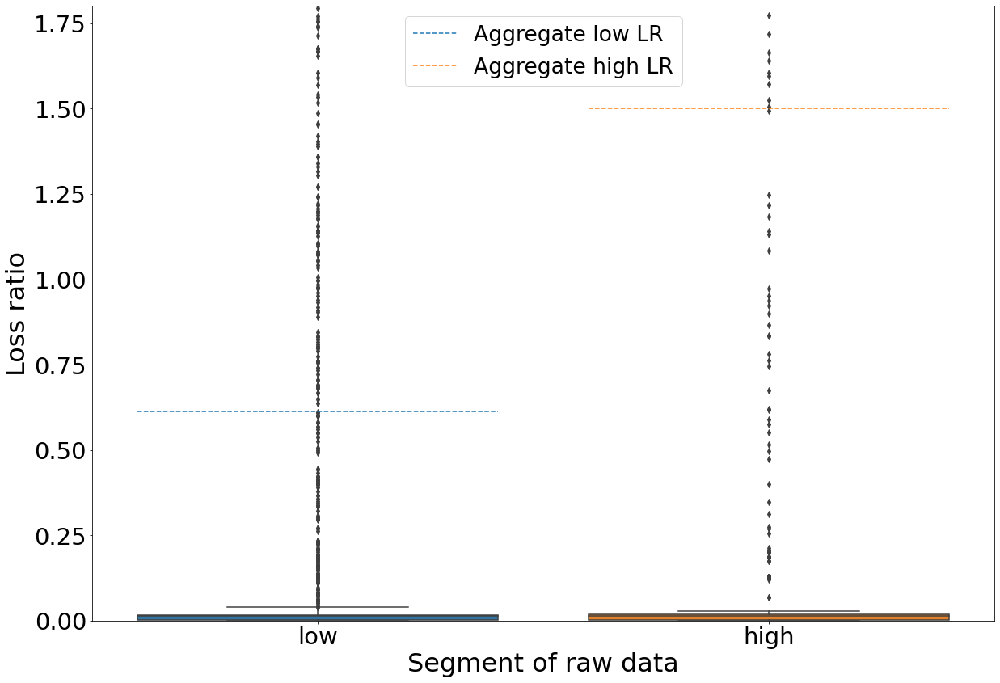

In [380]:
high_mask = (preprocess_df["prev_agg_lr_bad"] == 1.0) 
low_mask = (preprocess_df["prev_agg_lr_bad"] == 0.0)  #& (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_prev_agg_lr_bad_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(prev_agg_lr_bad == 0)", high_label = "purported higher LR \n(prev_agg_lr_bad == 1)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_prev_agg_lr_bad_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(prev_agg_lr_bad == 0)", high_label = "purported higher LR \n(prev_agg_lr_bad == 1)")

old and new:

low 0.7543105328011187
high 2.953407249218729


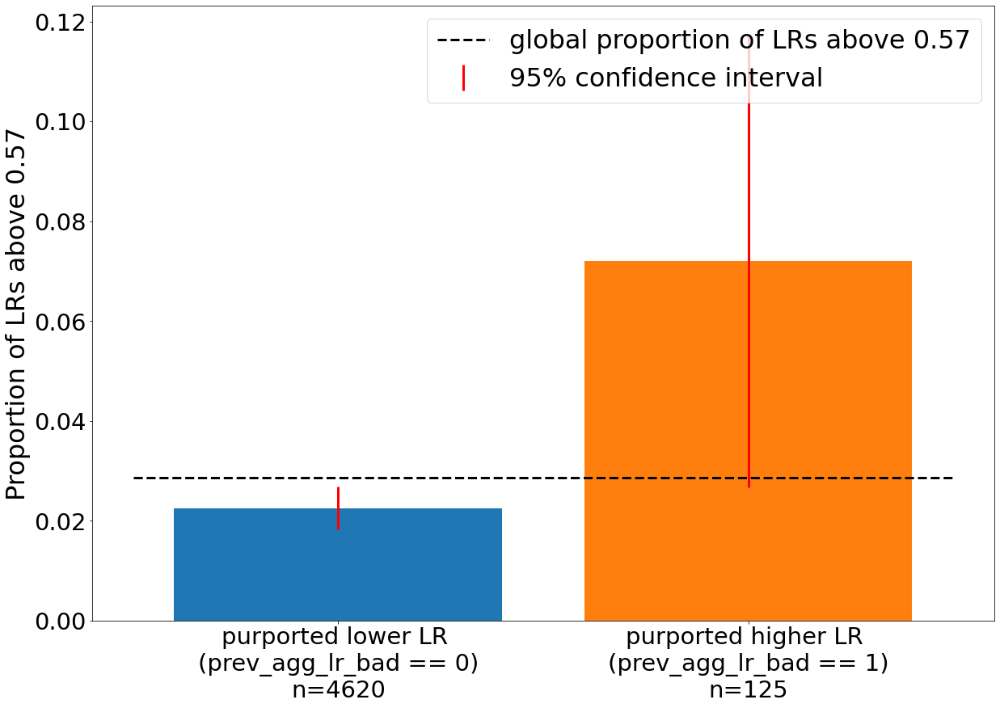

low 0.7543105328011187
high 2.953407249218729


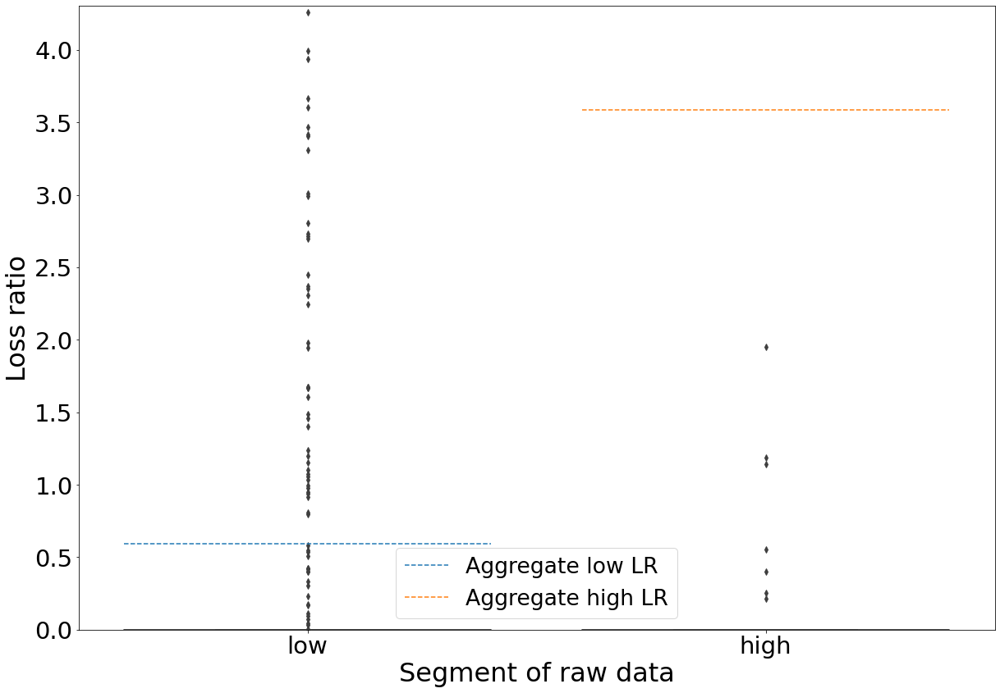

low 0.5935291847554381
high 1.1972497054094338


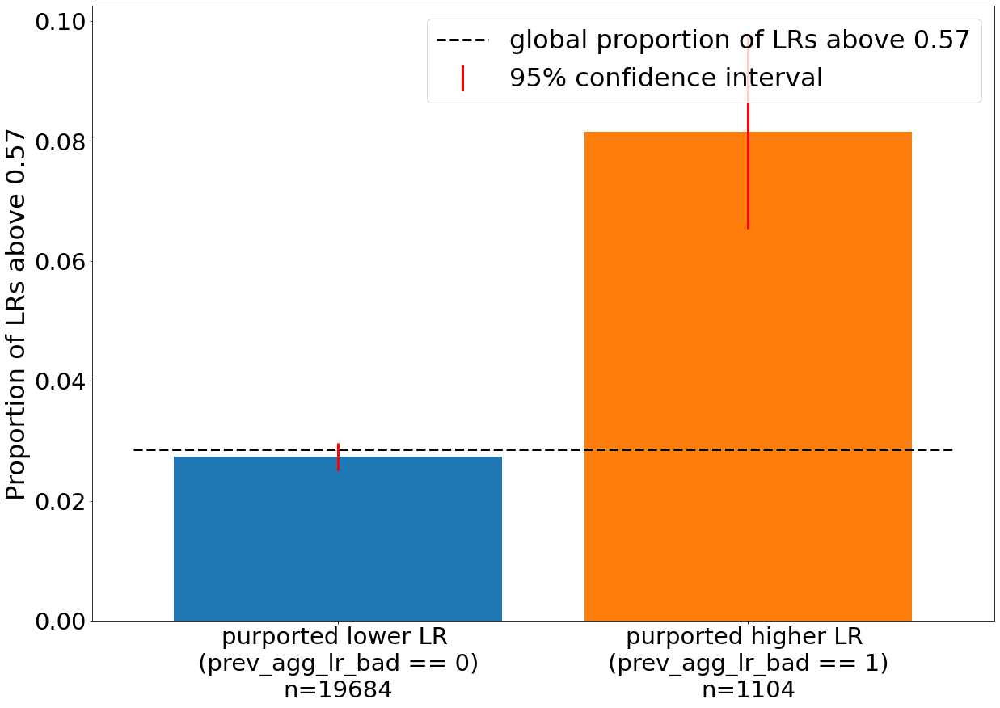

low 0.5935291847554381
high 1.1972497054094338


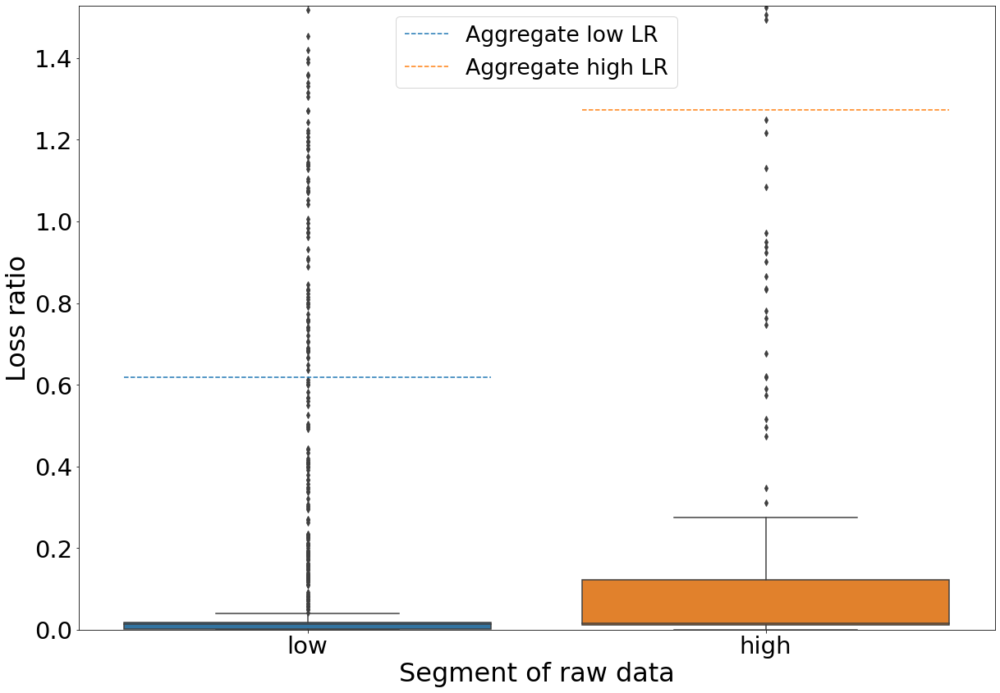

In [428]:
high_mask = (preprocess_df_old["prev_agg_lr_bad"] == 1.0) 
low_mask = (preprocess_df_old["prev_agg_lr_bad"] == 0.0)  #& (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_prev_agg_lr_bad_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(prev_agg_lr_bad == 0)", high_label = "purported higher LR \n(prev_agg_lr_bad == 1)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_prev_agg_lr_bad_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(prev_agg_lr_bad == 0)", high_label = "purported higher LR \n(prev_agg_lr_bad == 1)")

high_mask = (preprocess_df_new["prev_agg_lr_bad"] == 1.0) 
low_mask = (preprocess_df_new["prev_agg_lr_bad"] == 0.0)  #& (preprocess_df["increased_limits_factor"] > 1)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_prev_agg_lr_bad_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(prev_agg_lr_bad == 0)", high_label = "purported higher LR \n(prev_agg_lr_bad == 1)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_prev_agg_lr_bad_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(prev_agg_lr_bad == 0)", high_label = "purported higher LR \n(prev_agg_lr_bad == 1)")

SHAP plots for old and new policies:

In [354]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__prev_agg_lr_bad", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_prev_agg_lr_bad" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("numerical__prev_agg_lr_bad", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_prev_agg_lr_bad" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [355]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

p-value capped: true value larger than 0.25


Anderson_ksampResult(statistic=-0.12972534295970425, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.25)
KstestResult(statistic=0.04477263103480513, pvalue=0.5642869470127153)
1.2232784087237045
1.6021514678263338


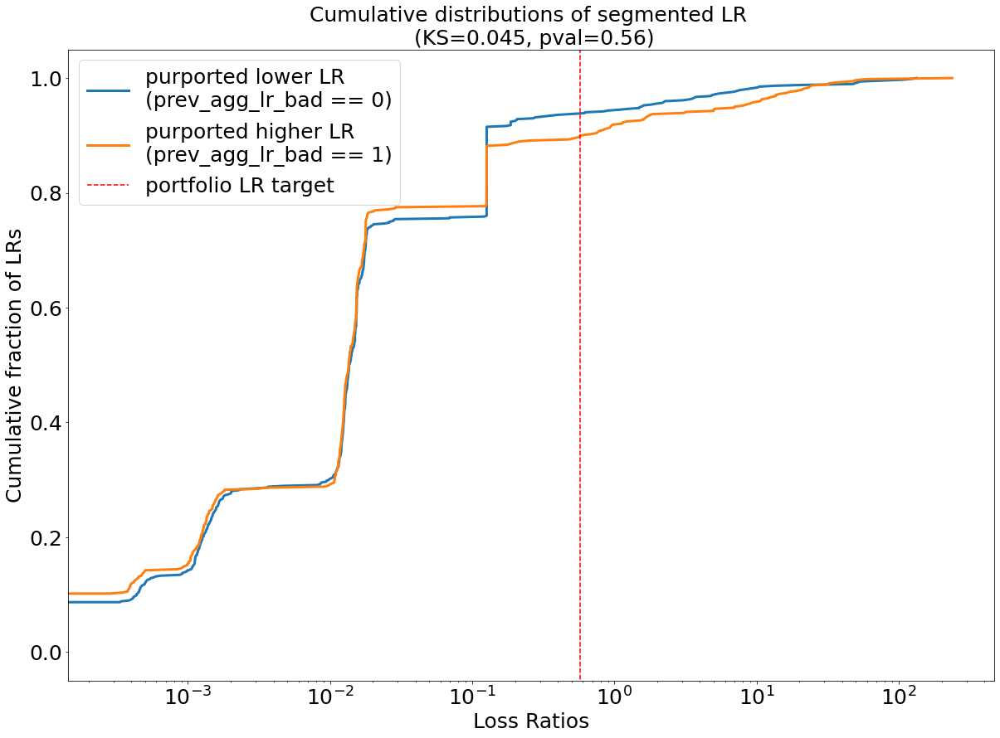

In [105]:
high_mask = (preprocess_df["prev_agg_lr_bad"] == 1.0) & (preprocess_df["not_greater_financial_crisis"] < 0.5)
low_mask = (preprocess_df["prev_agg_lr_bad"] == 1.0)  & (preprocess_df["not_greater_financial_crisis"] > 0.5)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(prev_agg_lr_bad == 0)", high_label="purported higher LR \n(prev_agg_lr_bad == 1)")

^ No significant difference.

##### prev_lr_bad_proportion related:

Most obvious trend is that when the proportion is higher, then probability of being a bad LR is higher. 

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=105.99651023623024, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.4518253030858415, pvalue=2.748406901388992e-33)
0.7892628310983434
2.2434379526658725


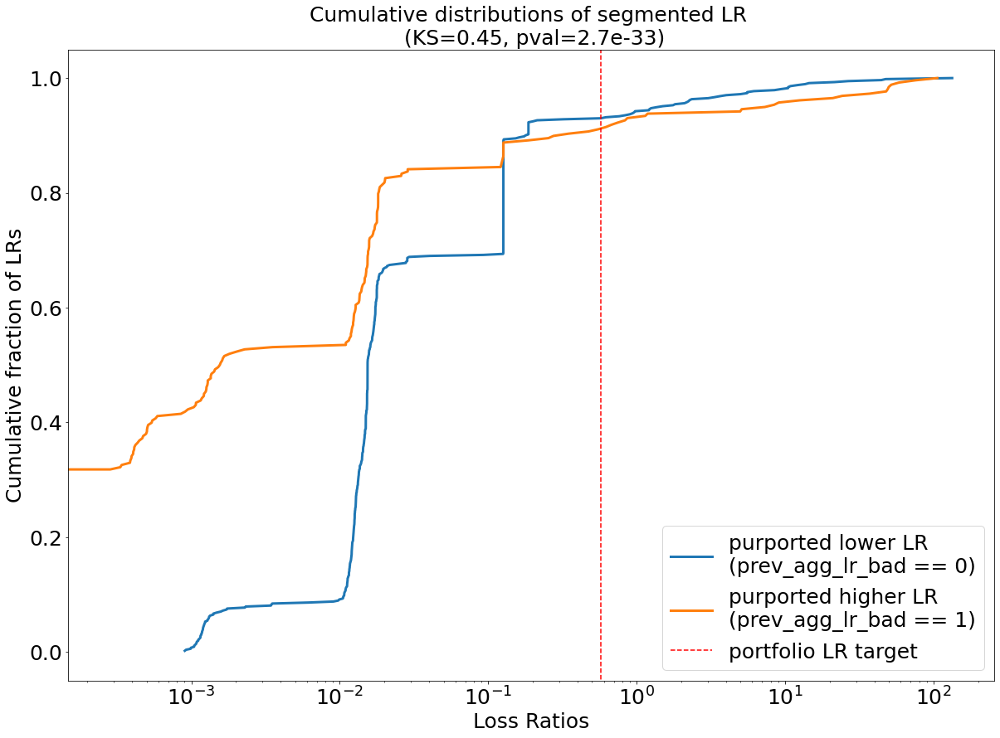

In [106]:
high_mask = (preprocess_df["prev_lr_bad_proportion"] > 0.8) & (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["prev_lr_bad_proportion"] > 0.0) & (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(prev_agg_lr_bad == 0)", high_label="purported higher LR \n(prev_agg_lr_bad == 1)")

##### rate_type_cd related:

Most obvious trend is that when rate_typ_cd = 1, loss-ratios are purportedly higher. Second potential trend is that for rate type codes of 2 and 4, higher size of firm factors (beyond 1.050 estimated) yield higher loss ratio probabilities. 

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=1355.8717002566498, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.3121542861559867, pvalue=0.0)
1.0139584562934454
0.6805440027887499


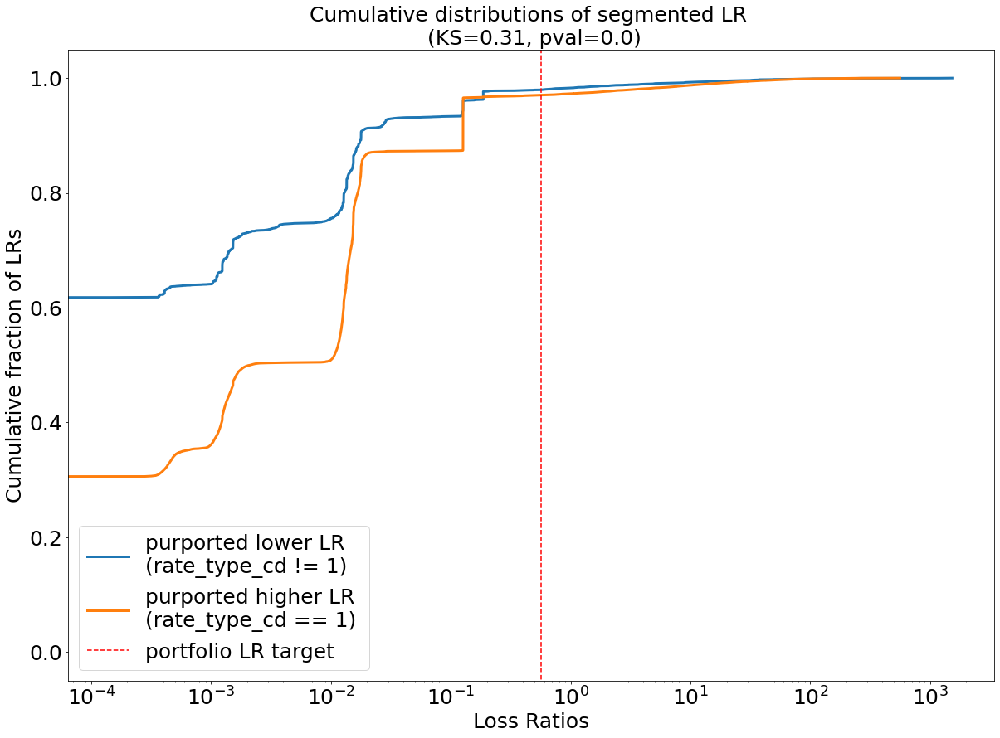

In [107]:
high_mask = (preprocess_df["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["rate_type_cd"] != 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_rate_type_cd.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(rate_type_cd != 1)", high_label="purported higher LR \n(rate_type_cd == 1)")

low 1.0139584562934454
high 0.6805440027887499


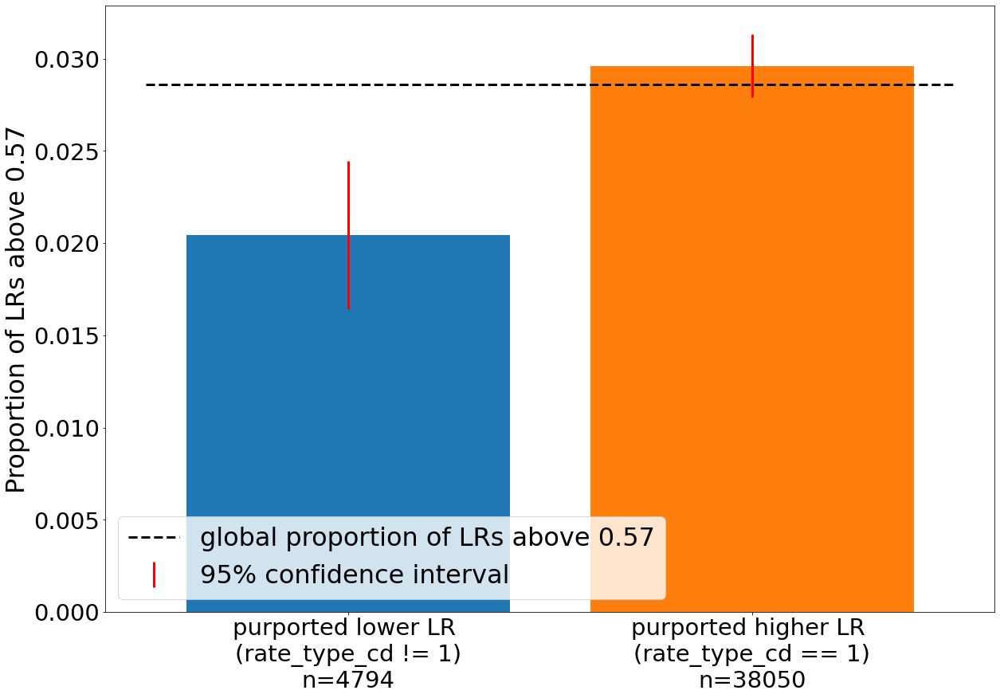

low 1.0139584562934454
high 0.6805440027887499


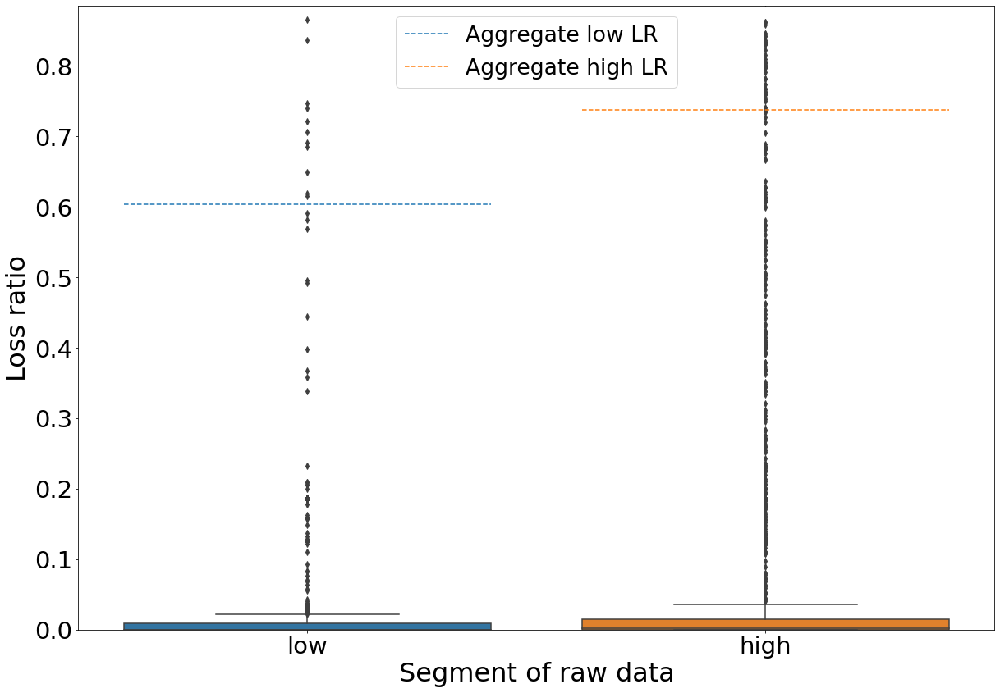

In [381]:
high_mask = (preprocess_df["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["rate_type_cd"] != 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_rate_type_cd_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(rate_type_cd != 1)", high_label = "purported higher LR \n(rate_type_cd == 1)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_rate_type_cd_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(rate_type_cd != 1)", high_label = "purported higher LR \n(rate_type_cd == 1)")

old and new:

low 1.3741946967549152
high 0.8090433484144991


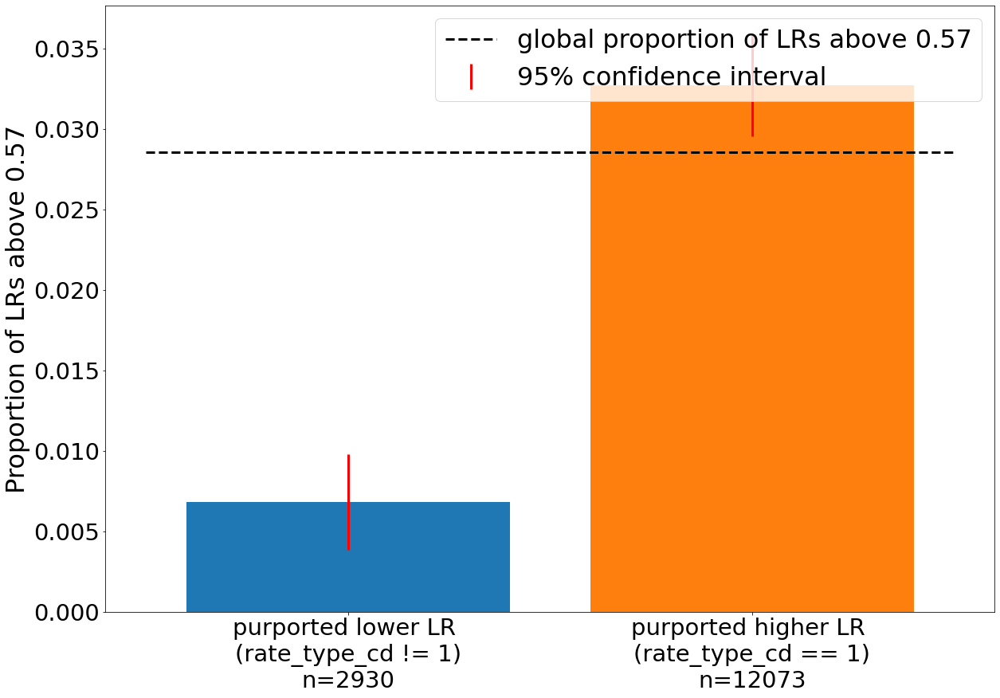

low 1.3741946967549152
high 0.8090433484144991


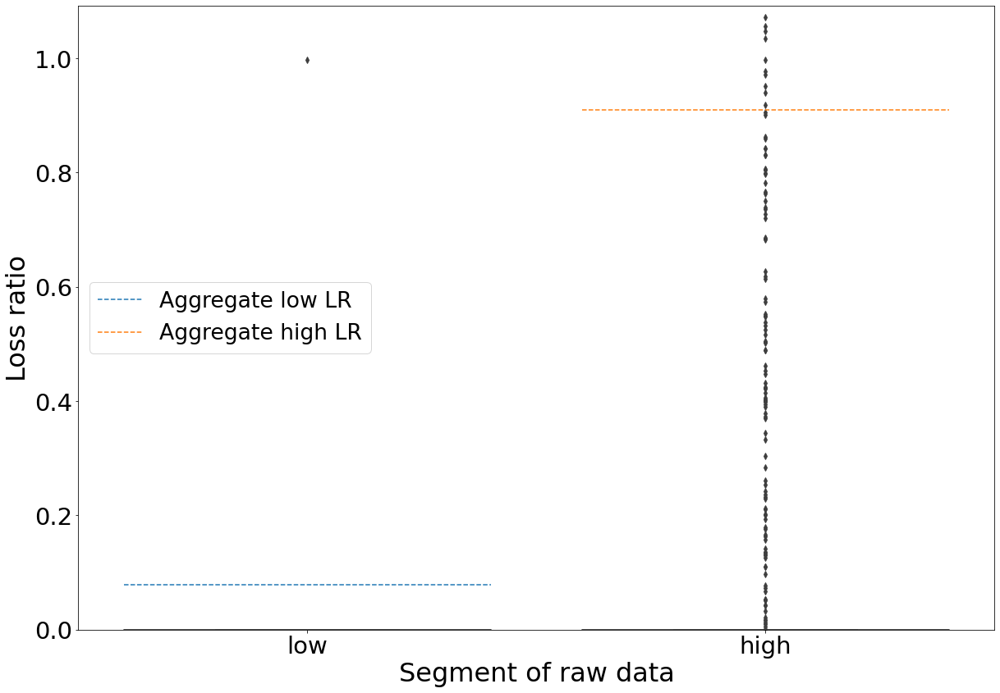

low 0.4477072843234307
high 0.6208229957540783


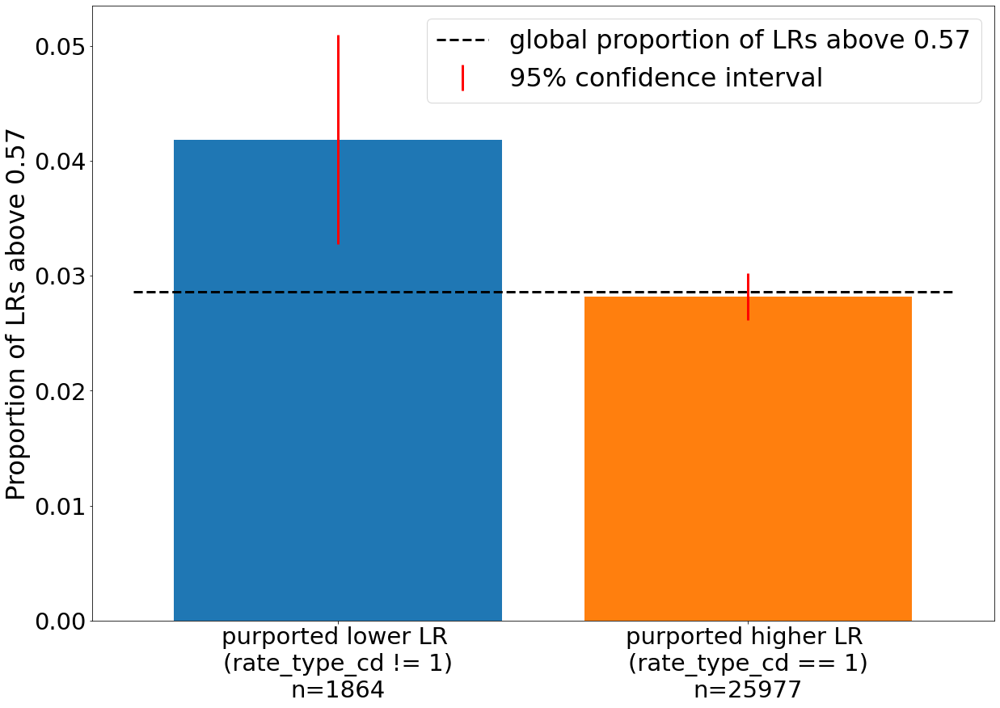

low 0.4477072843234307
high 0.6208229957540783


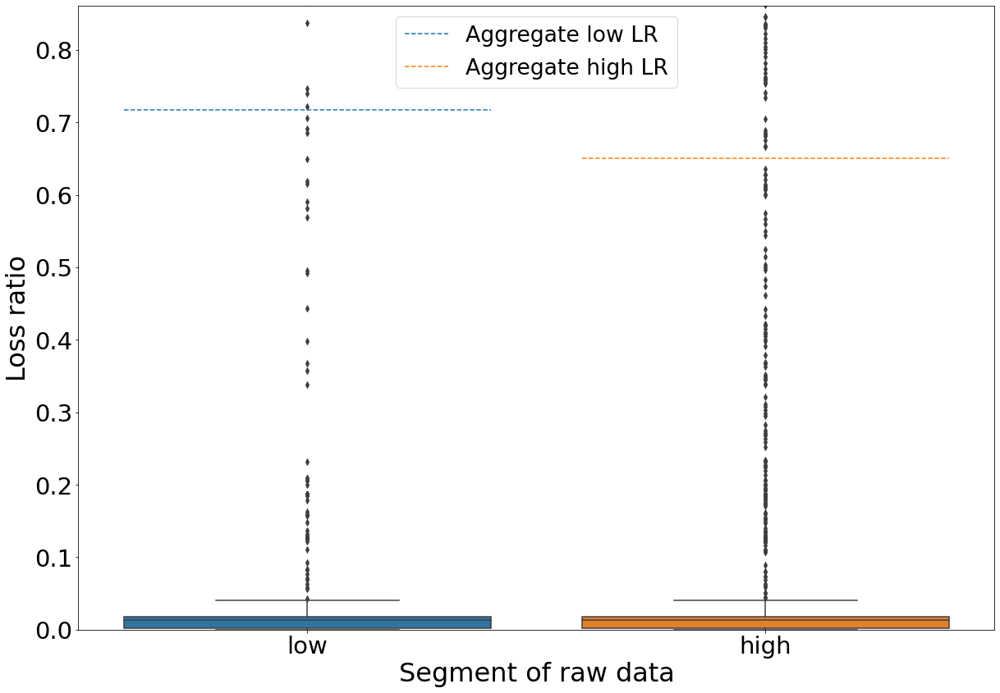

In [429]:
high_mask = (preprocess_df_old["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df_old["rate_type_cd"] != 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_rate_type_cd_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(rate_type_cd != 1)", high_label = "purported higher LR \n(rate_type_cd == 1)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_rate_type_cd_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(rate_type_cd != 1)", high_label = "purported higher LR \n(rate_type_cd == 1)")

high_mask = (preprocess_df_new["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df_new["rate_type_cd"] != 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_rate_type_cd_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(rate_type_cd != 1)", high_label = "purported higher LR \n(rate_type_cd == 1)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_rate_type_cd_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(rate_type_cd != 1)", high_label = "purported higher LR \n(rate_type_cd == 1)")

SHAP plots for old and new policies:

In [359]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("numerical__rate_type_cd", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_rate_typ_cd" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("numerical__rate_type_cd", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_rate_typ_cd" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [360]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

second trend is less likely to be observed, but we will see:

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=2551.291916899795, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.9086860386877911, pvalue=2.77e-322)
0.14123068499091845
1.476867201044586


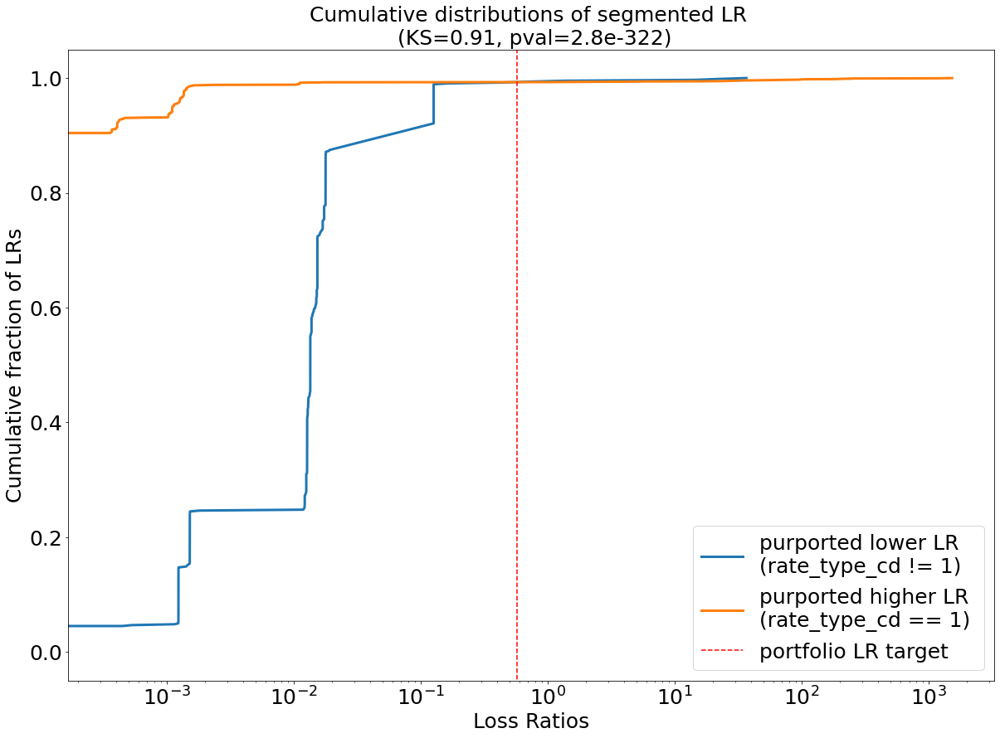

In [108]:
high_mask = ((preprocess_df["rate_type_cd"] == 2) | (preprocess_df["rate_type_cd"] == 4)) & (preprocess_df["size_of_firm_factor"] >= 1.050)
low_mask = ((preprocess_df["rate_type_cd"] == 2) | (preprocess_df["rate_type_cd"] == 4)) & (preprocess_df["size_of_firm_factor"] < 1.050)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(rate_type_cd != 1)", high_label="purported higher LR \n(rate_type_cd == 1)")

##### aop_above_average_risk related:

Most obvious trend is that increasing aop_above_average_risk increases probability of bad policy

Anderson_ksampResult(statistic=6.23070614635186, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.0012898197738999318)
KstestResult(statistic=0.04819769275679434, pvalue=0.0030620346709857274)
0.6740784331418284
0.7616959168446945


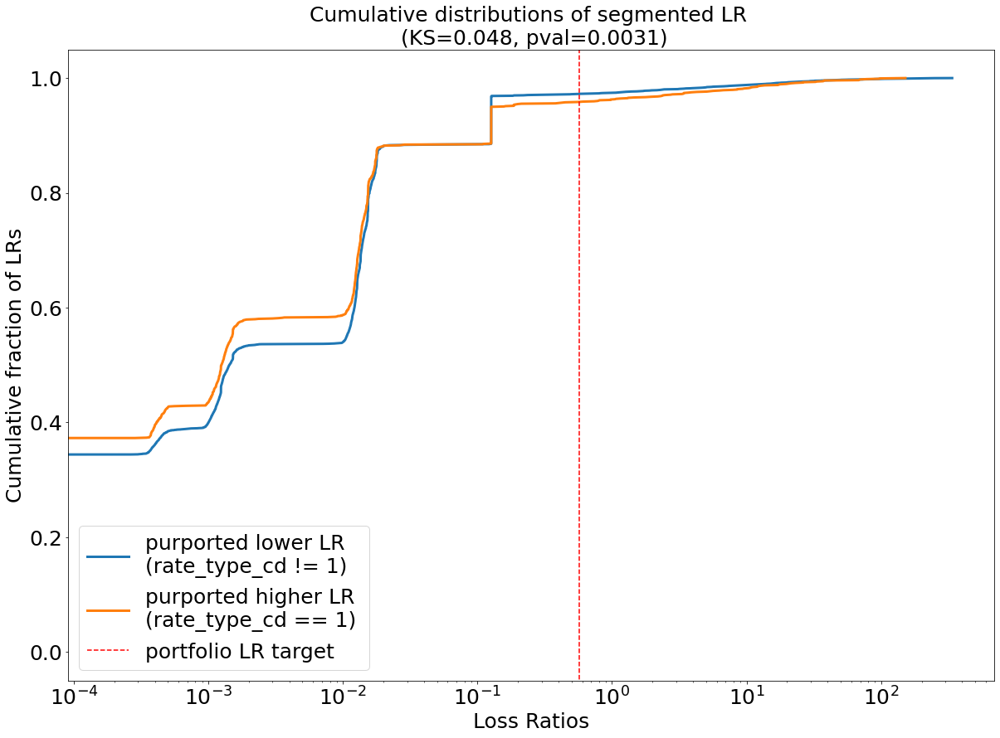

In [109]:
high_mask = (preprocess_df["aop_above_average_risk"] > 0.6) & (preprocess_df["rule_3_multiple_dabbler"] > 0.5)#& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["aop_above_average_risk"] > 0.6) & (preprocess_df["rule_3_multiple_dabbler"] < 0.5)# & (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(rate_type_cd != 1)", high_label="purported higher LR \n(rate_type_cd == 1)")

##### not_greater_financial_crisis related:

Most obvious trend is that a non_greater_financial_crisis value of greater than 0.95 corresponds with a lower probability of a bad policy.

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=193.08251741116692, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.08657802939396958, pvalue=4.889556414034842e-57)
0.6342538597919566
0.7507035712936025


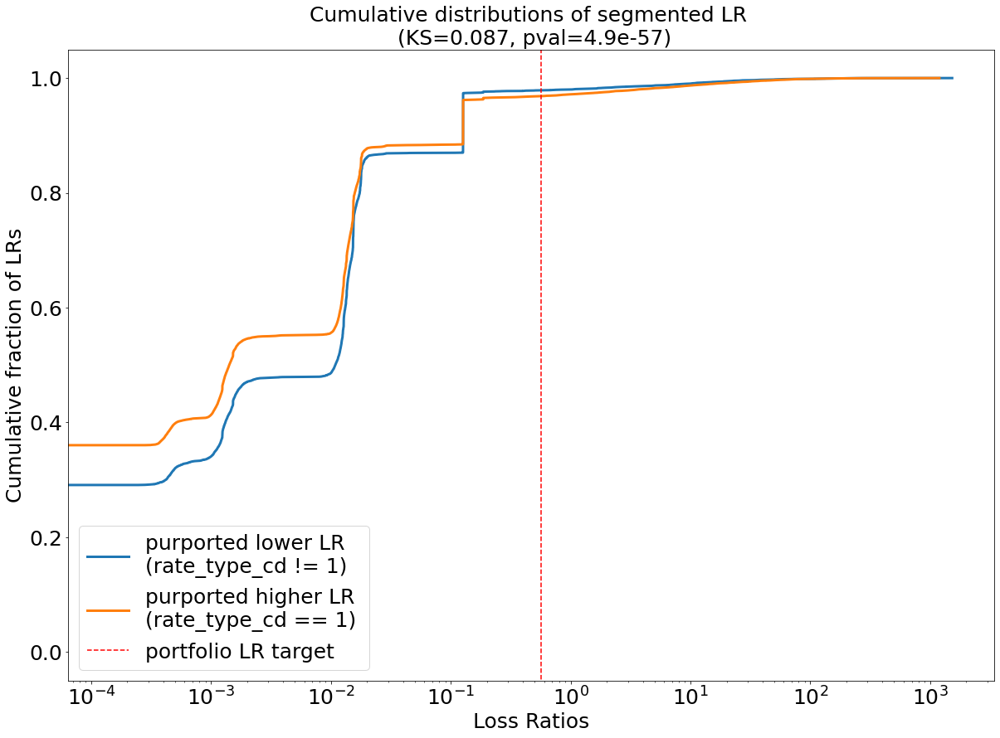

In [253]:
high_mask = (preprocess_df["not_greater_financial_crisis"] <= 0.98) #& (preprocess_df["rule_3_multiple_dabbler"] > 0.5)#& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["not_greater_financial_crisis"] > 0.98) #& (preprocess_df["rule_3_multiple_dabbler"] < 0.5)# & (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(rate_type_cd != 1)", high_label="purported higher LR \n(rate_type_cd == 1)")

low 0.6342538597919566
high 0.7507035712936025


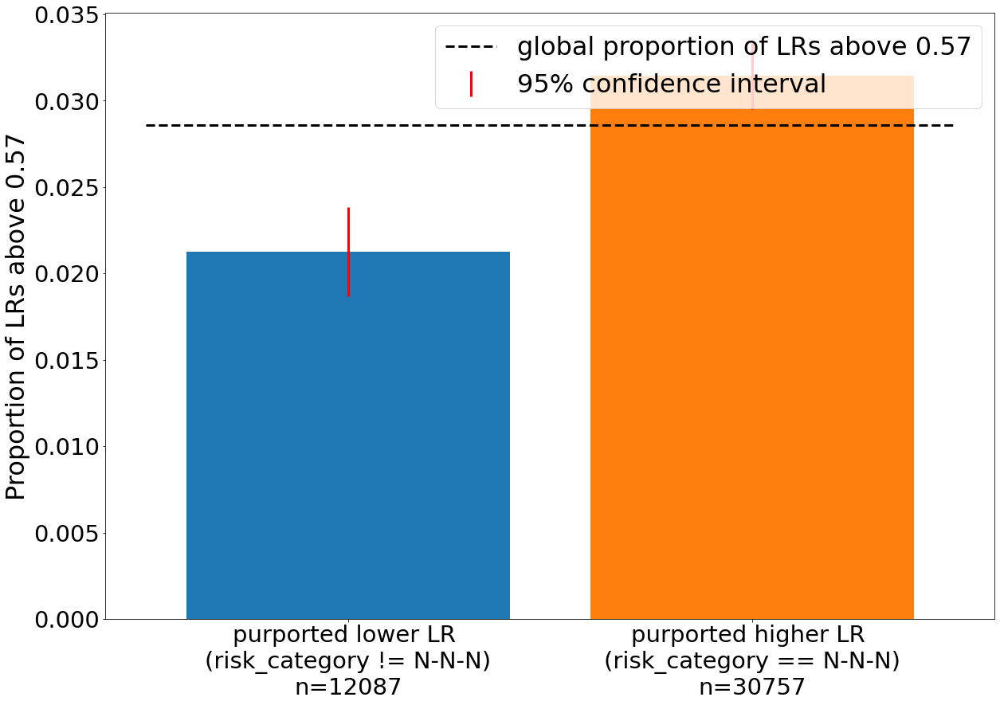

low 0.6342538597919566
high 0.7507035712936025


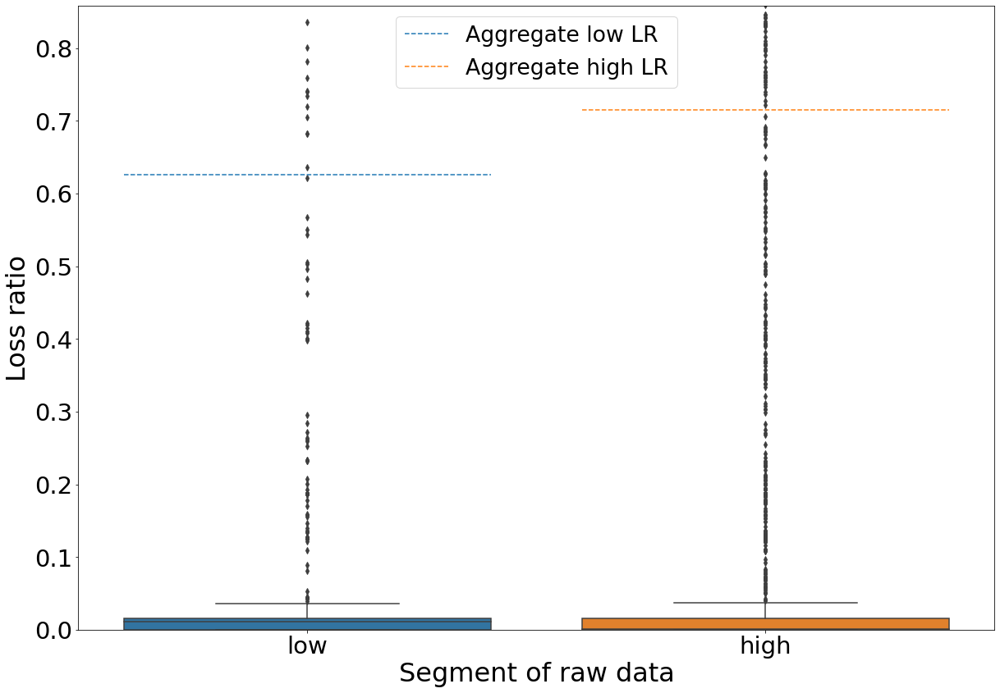

In [254]:
high_low_confint_plot(low_mask, high_mask, preprocess_df, "test.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "test.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)")

##### risk_category related:

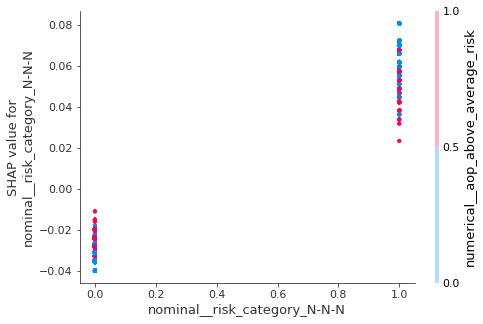

In [460]:
shap.dependence_plot("nominal__risk_category_N-N-N", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = interaction_magnitudes["nominal__risk_category_N-N-N"][0], x_jitter=0, alpha = 0.3)

low 0.622509412023983
high 0.9250440659143092


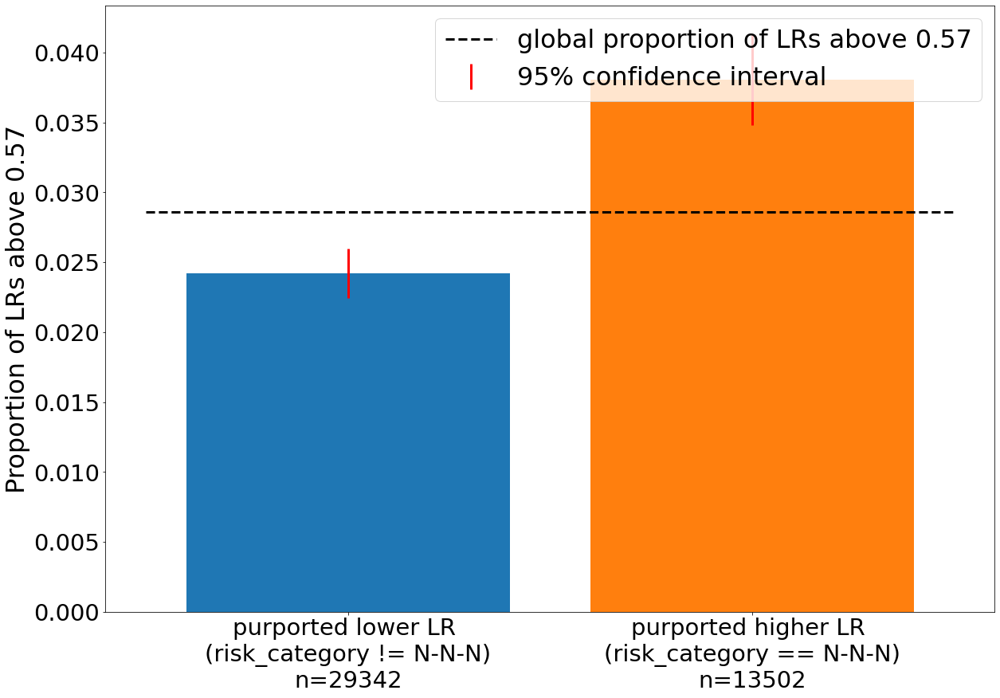

low 0.622509412023983
high 0.9250440659143092


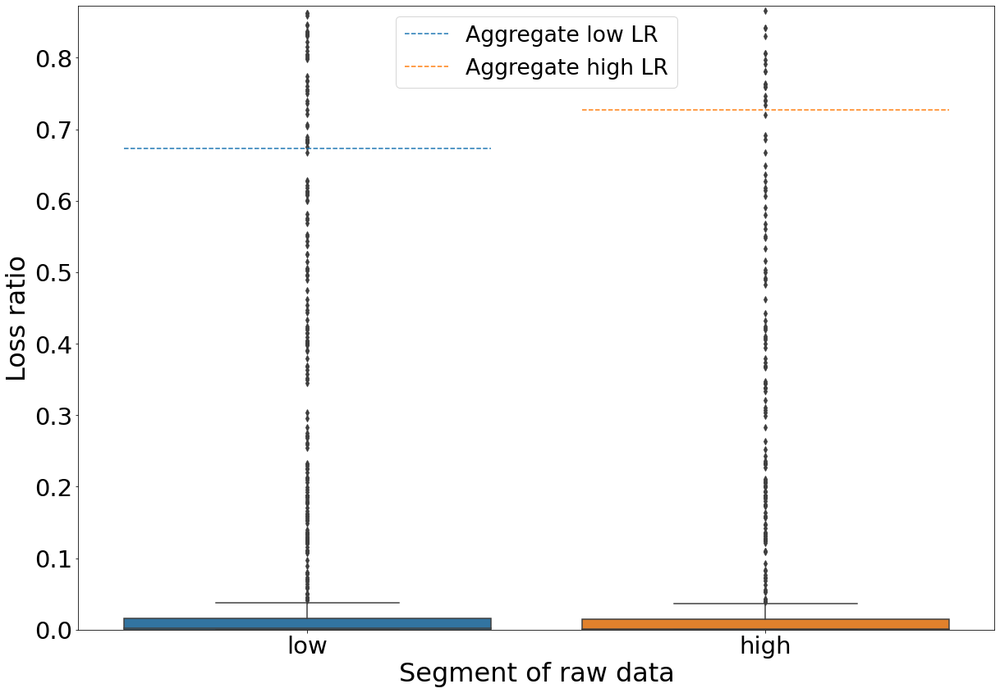

In [382]:
high_mask = (preprocess_df["risk_category"] == "N-N-N") #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["risk_category"] != "N-N-N") #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_risk_category_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_risk_category_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)")

old and new:

low 0.7939825630144385
high 1.152977300518164


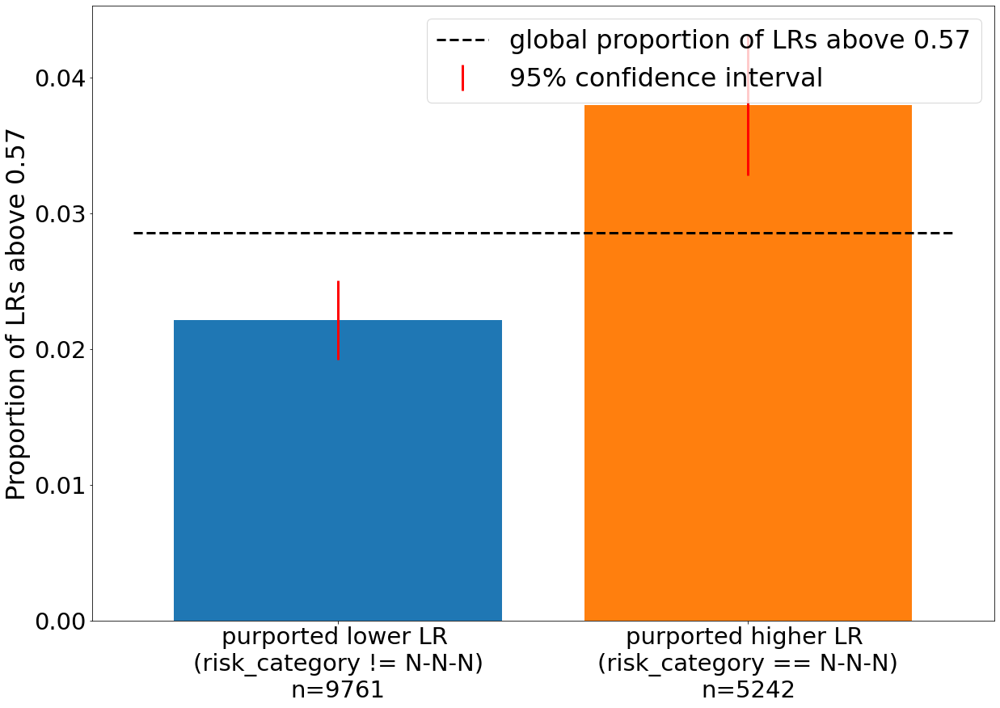

low 0.7939825630144385
high 1.152977300518164


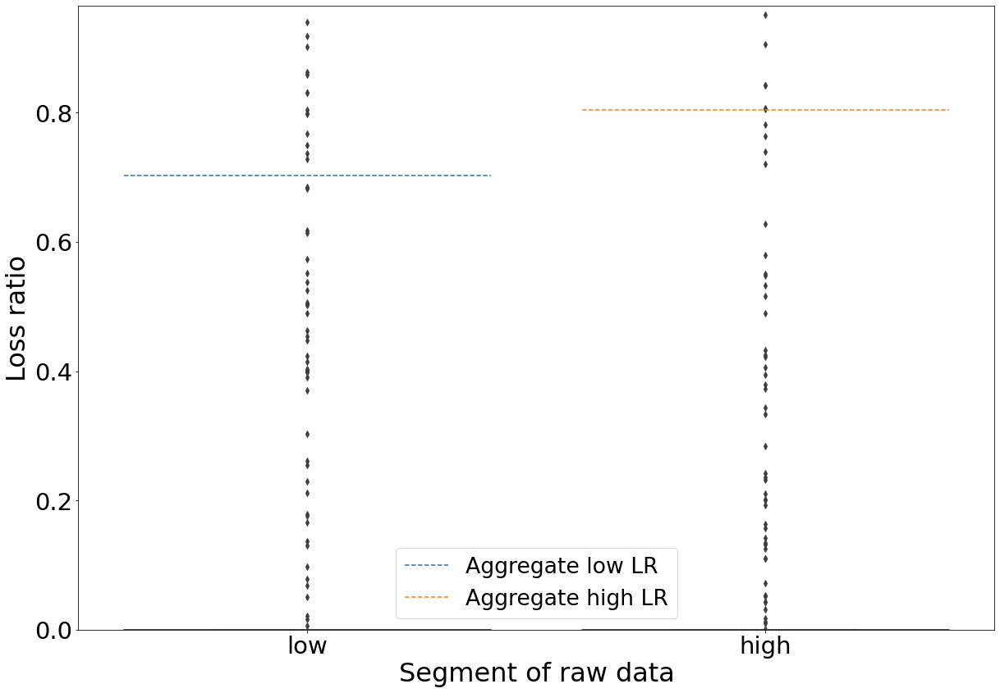

low 0.5370311715450578
high 0.7803920058908944


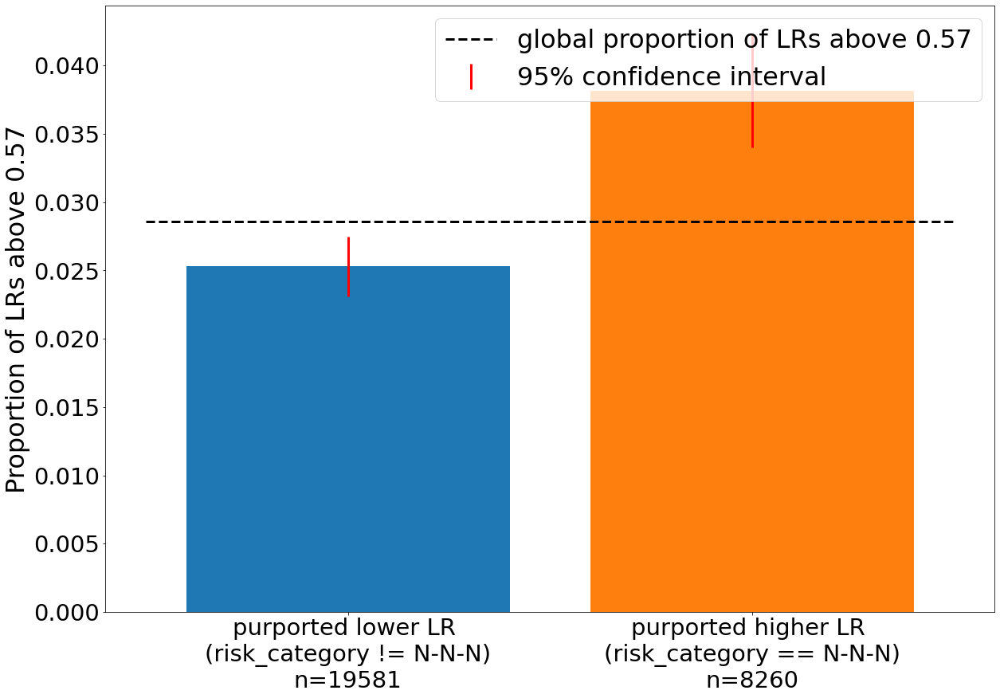

low 0.5370311715450578
high 0.7803920058908944


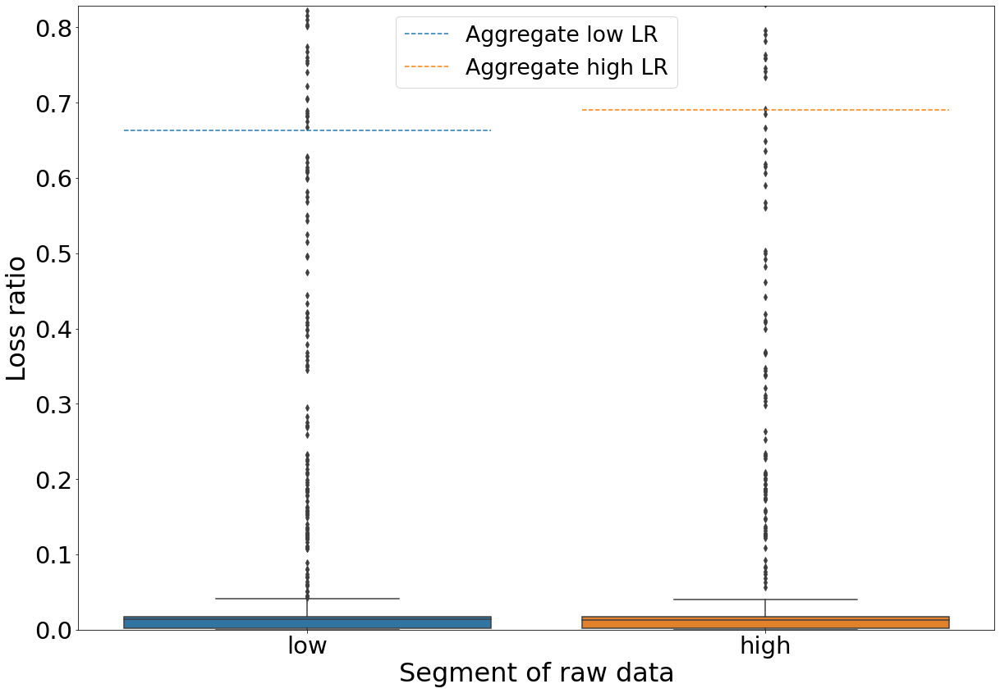

In [431]:
high_mask = (preprocess_df_old["risk_category"] == "N-N-N") #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df_old["risk_category"] != "N-N-N") #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df_old, "bar_chart_cumulative_risk_category_057_old.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_old, preprocess_df_incl_lossnpremium_old, "bar_chart_risk_category_actual_lrs_old.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)")

high_mask = (preprocess_df_new["risk_category"] == "N-N-N") #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df_new["risk_category"] != "N-N-N") #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df_new, "bar_chart_cumulative_risk_category_057_new.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df_new, preprocess_df_incl_lossnpremium_new, "bar_chart_risk_category_actual_lrs_new.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(risk_category != N-N-N)", high_label = "purported higher LR \n(risk_category == N-N-N)")

SHAP plots for old and new policies:

In [361]:
%matplotlib auto
plt.clf()
# old
shap.dependence_plot("nominal__risk_category_N-N-N", shap_values[old_policy_idx_test], X_shap[old_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "OLD_" + "_risk_category_N-N-N" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

# new
shap.dependence_plot("nominal__risk_category_N-N-N", shap_values[new_policy_idx_test], X_shap[new_policy_idx_test], feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color="maroon")
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "NEW_" + "_risk_category_N-N-N" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [362]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

<Figure size 432x360 with 0 Axes>

#### Validating some of the suggestions of the business

##### Admitted vs. non admitted policies for exposure effects

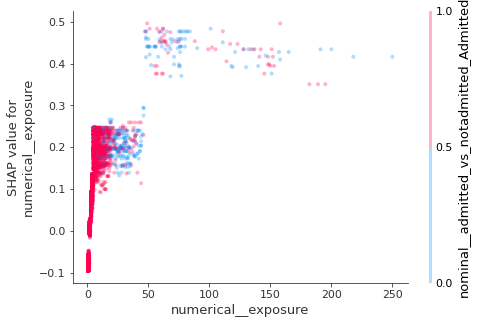

In [432]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "nominal__admitted_vs_notadmitted_Admitted", x_jitter=0, alpha = 0.3)

In [176]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "nominal__admitted_vs_notadmitted_Admitted", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "nominal_exposure_admitted" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [177]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 576x684 with 0 Axes>

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=16.960549964507486, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.20820592324665255, pvalue=9.768483006586189e-05)
0.7180144854915416
1.043702846616893


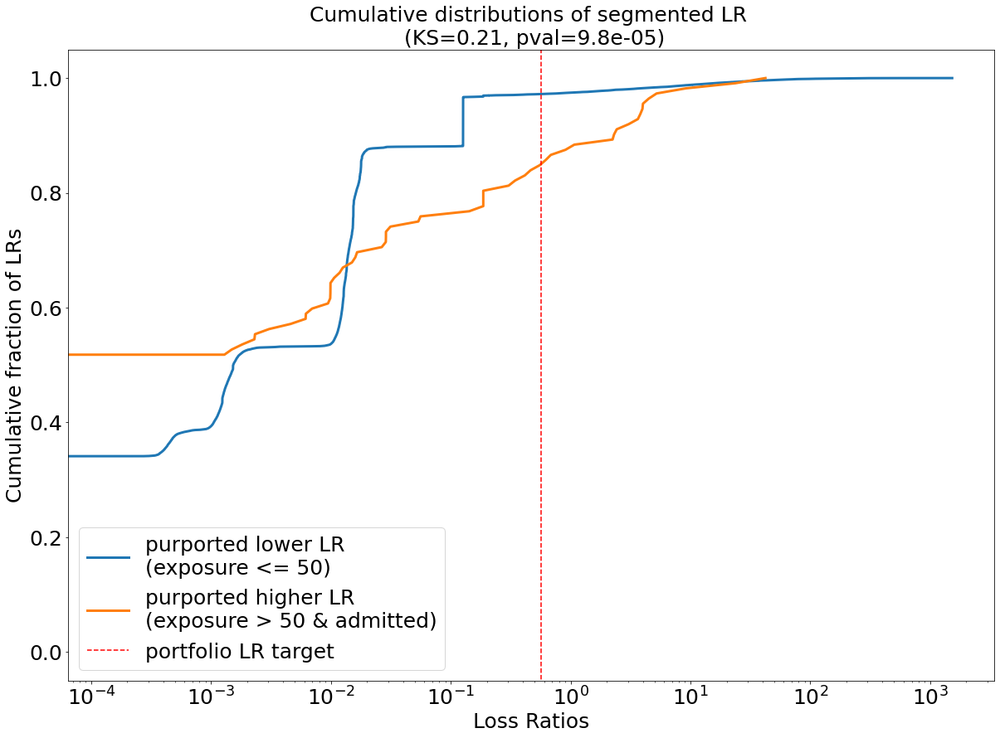

In [223]:
high_mask = (preprocess_df["exposure"] > 50) & (preprocess_df["admitted_vs_notadmitted"] == "Admitted")
low_mask = (preprocess_df["exposure"] <= 50)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_exposure_businesstest_nonadmitted.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(exposure <= 50)", high_label="purported higher LR \n(exposure > 50 & admitted)")

what are the fractions of admitted and non-admitted policies above 50 exposure?

In [186]:
not_admitted_mask = (preprocess_df["exposure"] > 50) & (preprocess_df["admitted_vs_notadmitted"] == "Not_Admitted")
admitted_mask = (preprocess_df["exposure"] > 50) & (preprocess_df["admitted_vs_notadmitted"] != "Not_Admitted")
print("not admitted numbers above 50 exposure", preprocess_df[not_admitted_mask]["ultimate_trended_onlevel_lr"].count())
print("admitted numbers above 50 exposure", preprocess_df[admitted_mask]["ultimate_trended_onlevel_lr"].count())

not admitted numbers above 50 exposure 195
admitted numbers above 50 exposure 112


In [92]:
preprocess_df["aop_above_average_risk"].value_counts()

aop_above_average_risk
0.0000    12672
1.0000     2542
0.0500     1582
0.1000     1571
0.5000     1250
          ...  
0.5839        1
0.3390        1
0.0287        1
0.4020        1
0.3411        1
Name: count, Length: 891, dtype: int64

low 0.7213054479233095
high 1.043702846616893


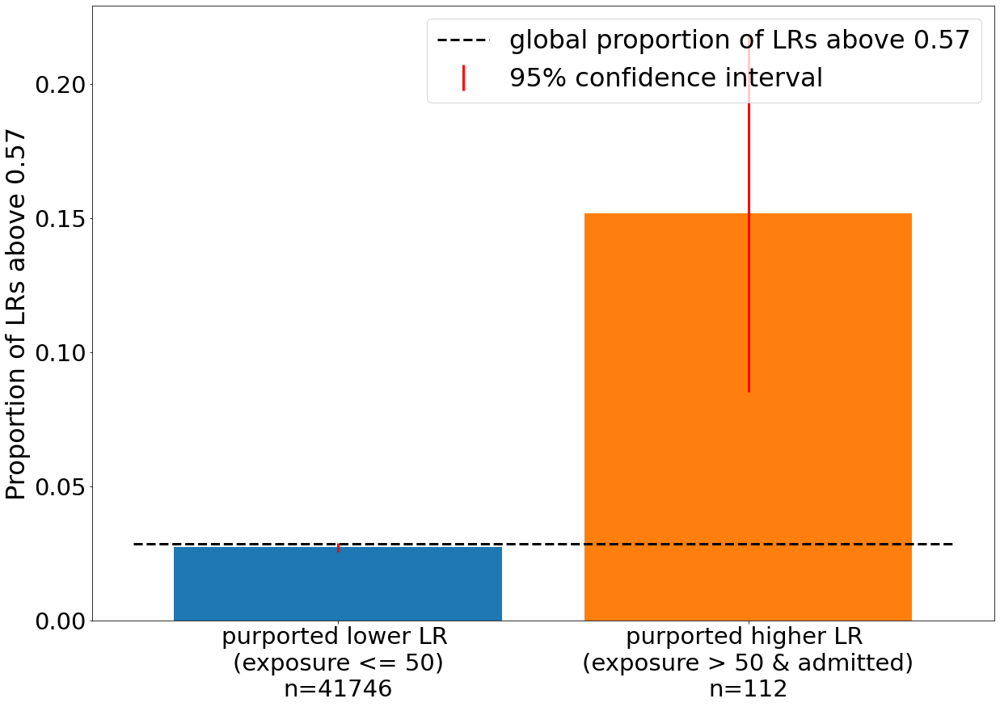

In [222]:
high_low_confint_plot(low_mask, high_mask, preprocess_df, "businesstest_bar_chart_exposure_admitted_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure <= 50)", high_label = "purported higher LR \n(exposure > 50 & admitted)", threshold = 0.57)

What about segmenting by risk category?:

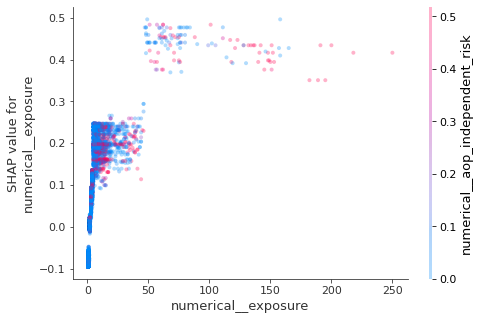

In [98]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_independent_risk", x_jitter=0, alpha = 0.3)

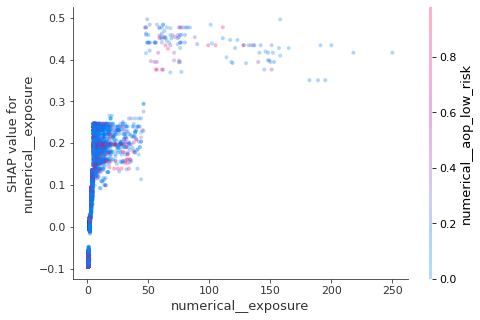

In [99]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_low_risk", x_jitter=0, alpha = 0.3)

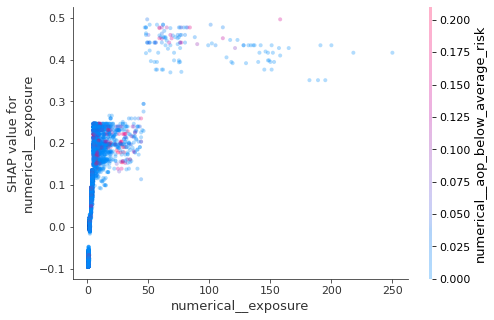

In [100]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_below_average_risk", x_jitter=0, alpha = 0.3)

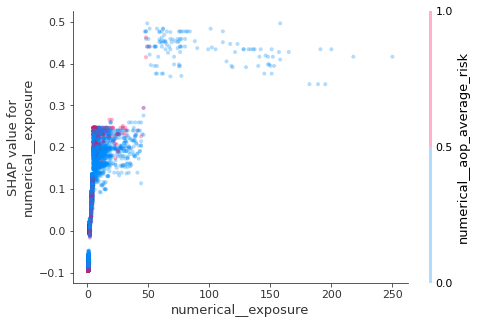

In [101]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_average_risk", x_jitter=0, alpha = 0.3)

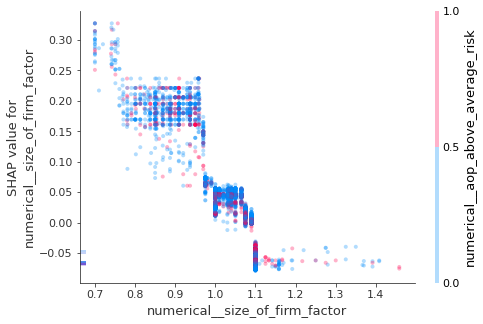

In [363]:
shap.dependence_plot("numerical__size_of_firm_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_above_average_risk", x_jitter=0, alpha = 0.3)

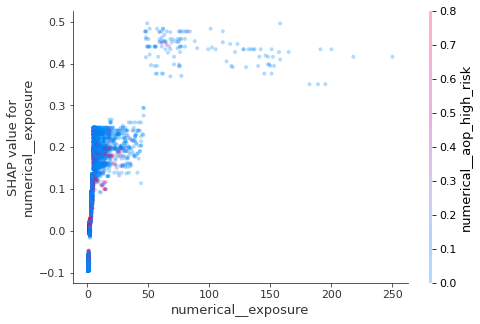

In [103]:
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_high_risk", x_jitter=0, alpha = 0.3)

saving all of these:

In [104]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_independent_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "exposure_independent_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_low_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "exposure_low_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_below_average_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "exposure_below_average_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_average_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "exposure_average_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_above_average_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "exposure_above_average_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

plt.clf()
shap.dependence_plot("numerical__exposure", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__aop_high_risk", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "exposure_high_risk" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: <object object at 0x7f0631cb0d70>


In [130]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

low 0.679422967348388
high 0.7709536325004008


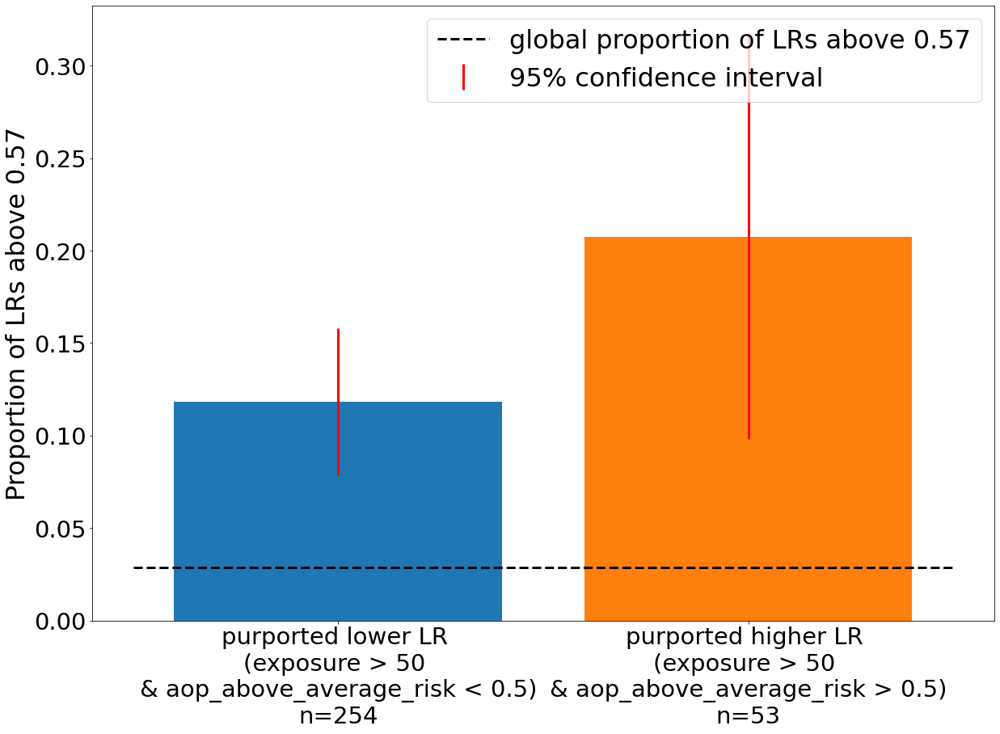

In [441]:
high_mask = (preprocess_df["exposure"] > 50) & (preprocess_df["aop_above_average_risk"] > 0.5 )
low_mask = (preprocess_df["exposure"] > 50) & (preprocess_df["aop_above_average_risk"] < 0.5 )

high_low_confint_plot(low_mask, high_mask, preprocess_df, "businesstest_bar_chart_exposure_above_average_057_gt_50exposure.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure > 50 \n& aop_above_average_risk < 0.5)", high_label = "purported higher LR \n(exposure > 50 \n& aop_above_average_risk > 0.5)", threshold = 0.57)

low 0.6938305194128503
high 0.7794176142753197


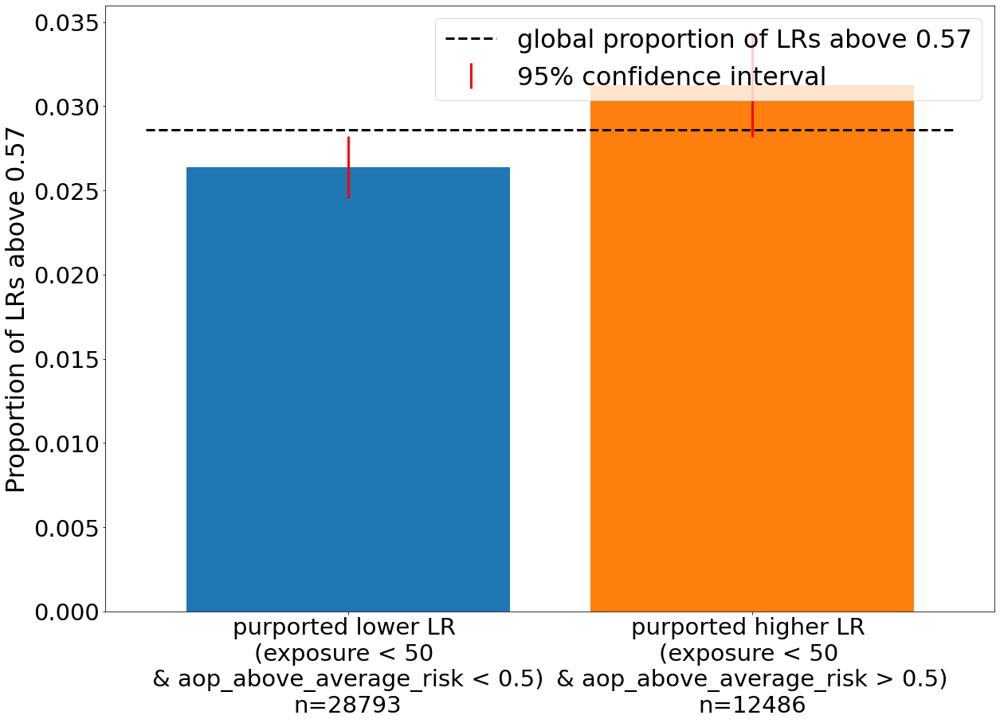

In [443]:
high_mask = (preprocess_df["exposure"] < 50) & (preprocess_df["aop_above_average_risk"] > 0.5 )
low_mask = (preprocess_df["exposure"] < 50) & (preprocess_df["aop_above_average_risk"] < 0.5 )

high_low_confint_plot(low_mask, high_mask, preprocess_df, "businesstest_bar_chart_exposure_above_average_057_lt_50exposure.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(exposure < 50 \n& aop_above_average_risk < 0.5)", high_label = "purported higher LR \n(exposure < 50 \n& aop_above_average_risk > 0.5)", threshold = 0.57)

##### does the size of a firm play a role in the diversity effect?

ft_att is > 95% correlated with exposure, so exposure will be used as the "size of firm" in this analysis.

In [240]:
X_test["exposure"].value_counts()[1:20]

exposure
1.0     6892
2.0     1804
0.5     1011
3.0      850
4.0      482
5.0      312
6.0      250
7.0      186
8.0      128
9.0      123
10.0     101
13.0      58
12.0      57
11.0      52
14.0      46
15.0      41
18.0      31
16.0      29
17.0      28
19.0      22
23.0      13
29.0      13
31.0      12
27.0      12
25.0      11
22.0      11
20.0      11
Name: count, dtype: int64

In [198]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__max_detailed_aop_pct", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "max_detailed_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [199]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=164.75023175985936, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.10435825681873118, pvalue=2.3287613980948314e-48)
0.5464299188475151
1.09516887476673


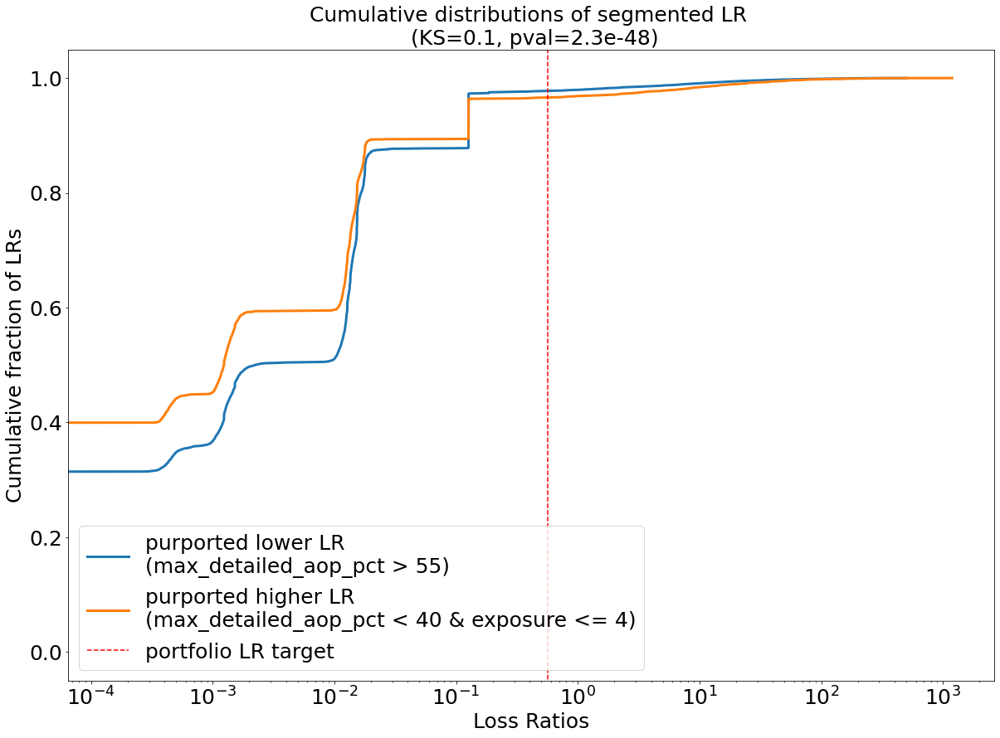

In [206]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] <= 4)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 65) #& (preprocess_df["exposure"] <= 6)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_maxdetailedaop_businesstest_exposure.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(max_detailed_aop_pct > 55)", high_label="purported higher LR \n(max_detailed_aop_pct < 40 & exposure <= 4)")


low 0.5464299188475151
high 1.09516887476673


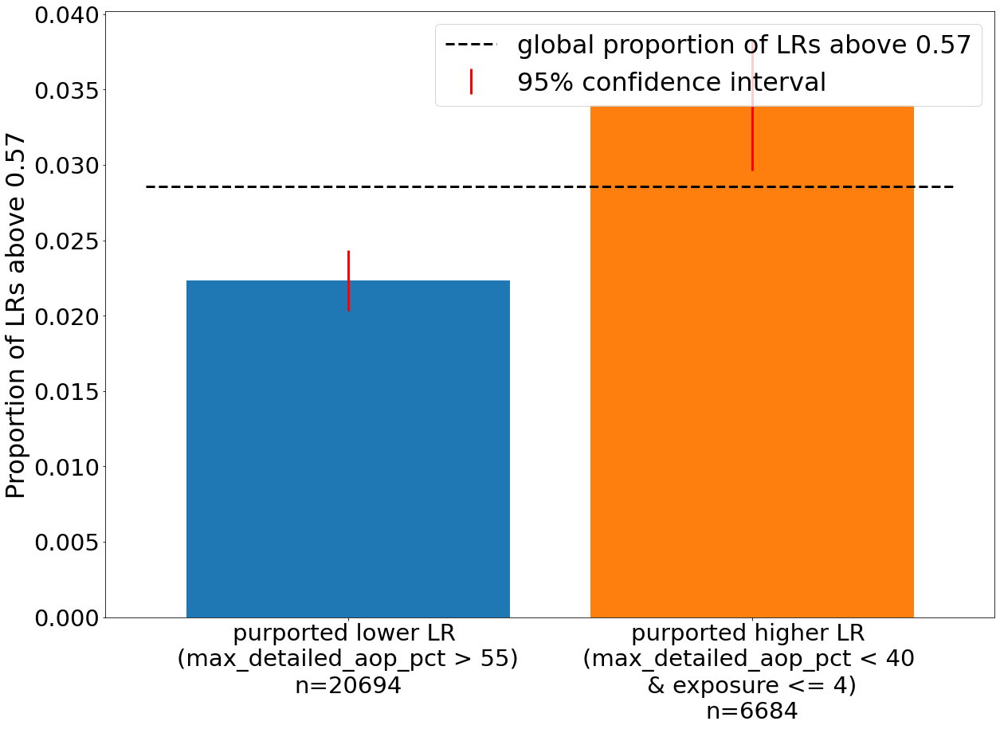

In [209]:
high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_max_aop_pctWithexposure_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 55)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure <= 4)", threshold = 0.57)

Can do the same but consider high exposures in the low diversity and high diversity region:

In [ ]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] >= 50)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 55) & (preprocess_df["exposure"] >= 50)

low 0.7180144854915416
high 0.49507311491240935


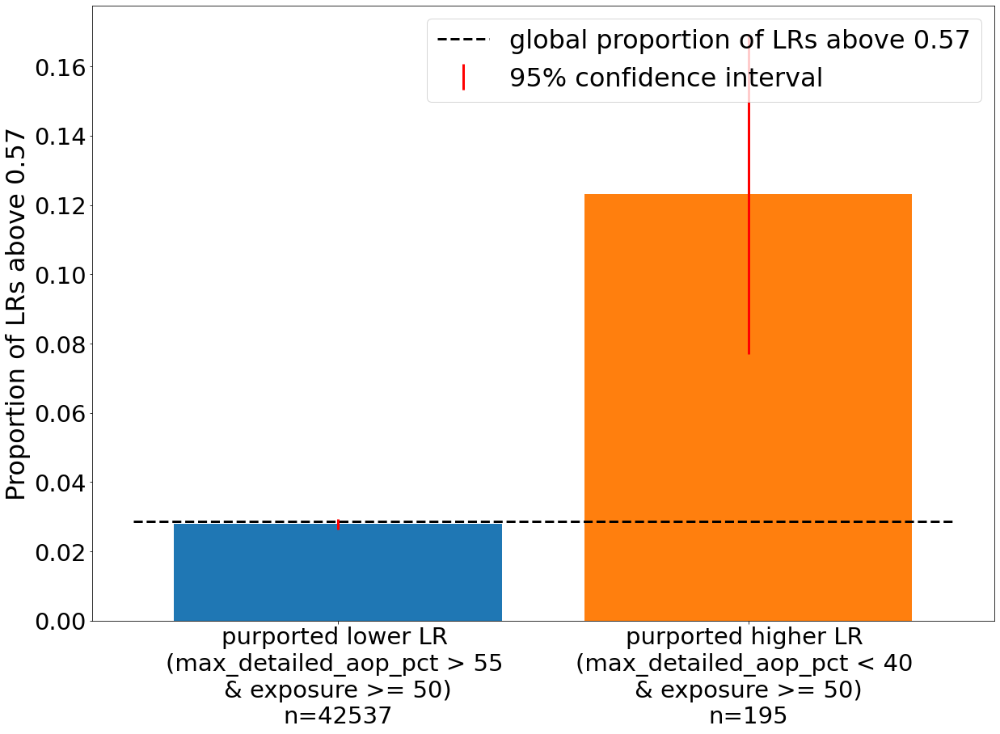

In [436]:
high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_max_aop_pctWithexposure_057_gt50.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(max_detailed_aop_pct > 55 \n& exposure >= 50)", high_label = "purported higher LR \n(max_detailed_aop_pct < 40 \n& exposure >= 50)", threshold = 0.57)

##### is rate type code dependent on state location

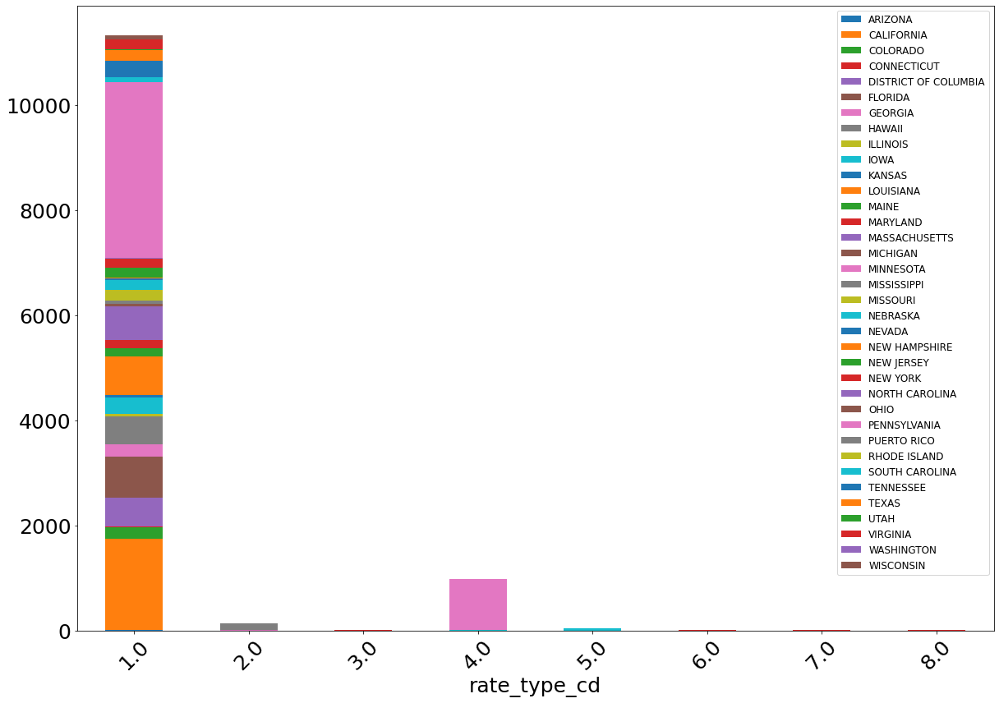

In [144]:
states_rates = df[["state_name", "rate_type_cd"]].iloc[test_idx].reset_index(drop=True)

states_rates.groupby(["rate_type_cd", "state_name"]).size().unstack().plot(kind='bar', stacked=True)
plt.xticks(fontsize=25, rotation=45)
plt.yticks(fontsize=25)
plt.xlabel("rate_type_cd", fontsize=25)
plt.legend(fontsize=12)
figure = plt.gcf()
figure.savefig("state_rate_cd_breakdown.png", dpi=300, bbox_inches='tight')
plt.show()

In [133]:
states_rates.groupby("rate_type_cd").value_counts()

rate_type_cd  state_name          
1.0           PENNSYLVANIA            3342
              CALIFORNIA              1733
              FLORIDA                  790
              LOUISIANA                731
              MASSACHUSETTS            639
              DISTRICT OF COLUMBIA     545
              HAWAII                   535
              TENNESSEE                326
              IOWA                     314
              GEORGIA                  234
              COLORADO                 216
              MISSOURI                 203
              TEXAS                    199
              NEW JERSEY               198
              NEBRASKA                 197
              VIRGINIA                 183
              NEW YORK                 174
              MAINE                    165
              MARYLAND                 149
              WISCONSIN                 82
              SOUTH CAROLINA            80
              MISSISSIPPI               57
              KANSA

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=85.53374213875635, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.31033237189288065, pvalue=8.69150619362025e-41)
0.18278571818860775
0.6805440027887499


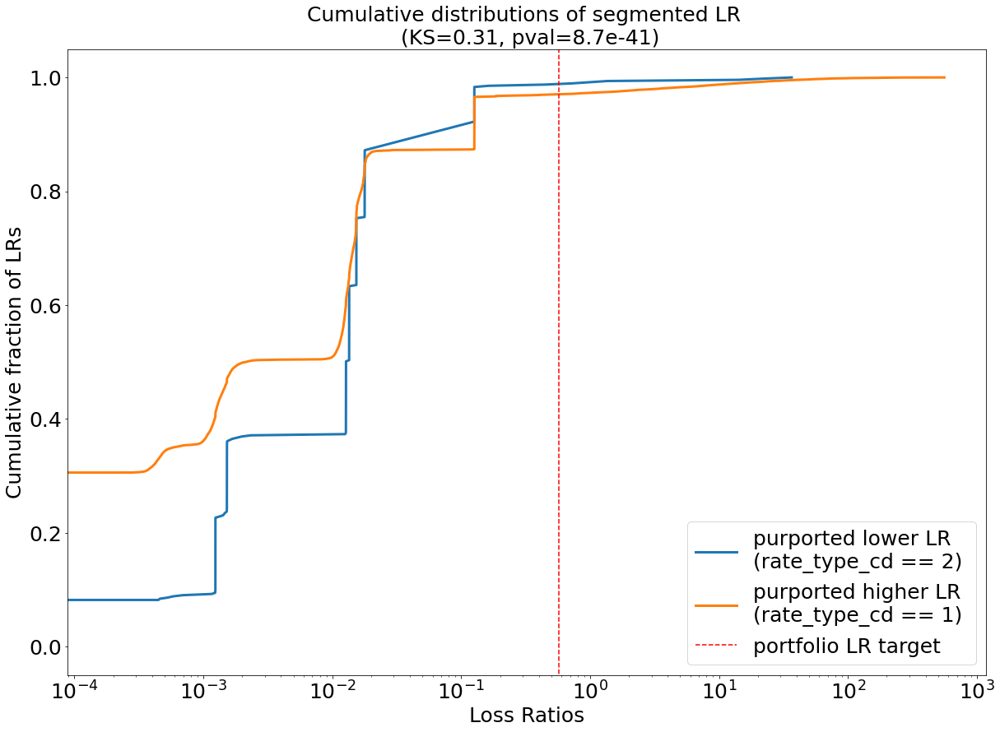

In [170]:
high_mask = (preprocess_df["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["rate_type_cd"] == 2) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_rate_type_cd_2.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(rate_type_cd == 2)", high_label="purported higher LR \n(rate_type_cd == 1)")

low 0.18278571818860775
high 0.6805440027887499


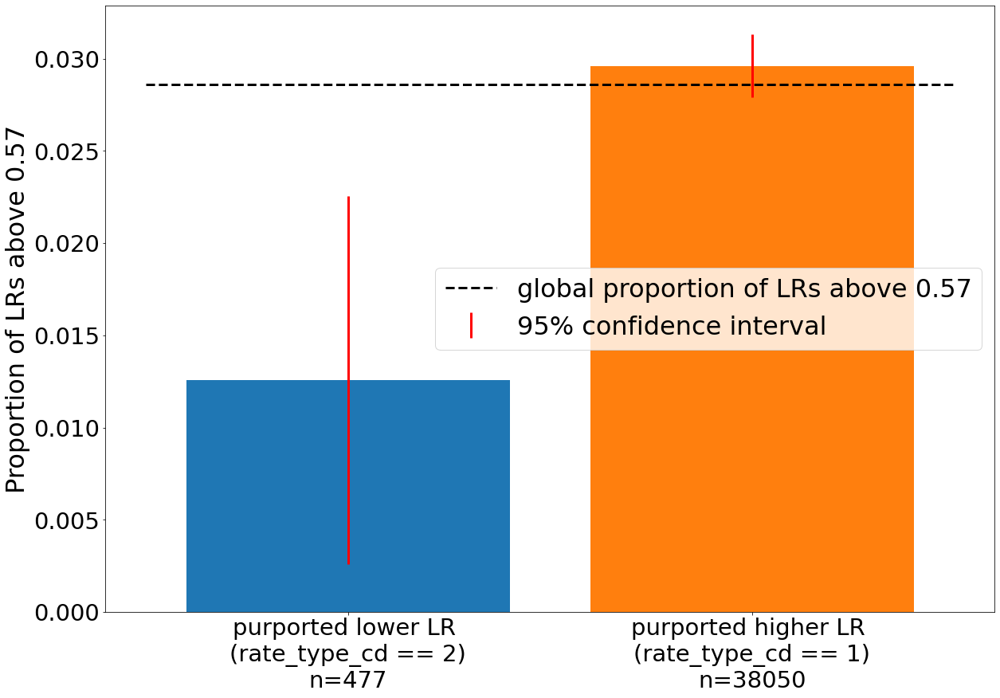

In [171]:
high_mask = (preprocess_df["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["rate_type_cd"] == 2) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_rate_type_cd_057_2.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(rate_type_cd == 2)", high_label = "purported higher LR \n(rate_type_cd == 1)", threshold = 0.57)


p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=2888.7714299859476, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.5500446329670063, pvalue=0.0)
1.3958562072971865
0.6805440027887499


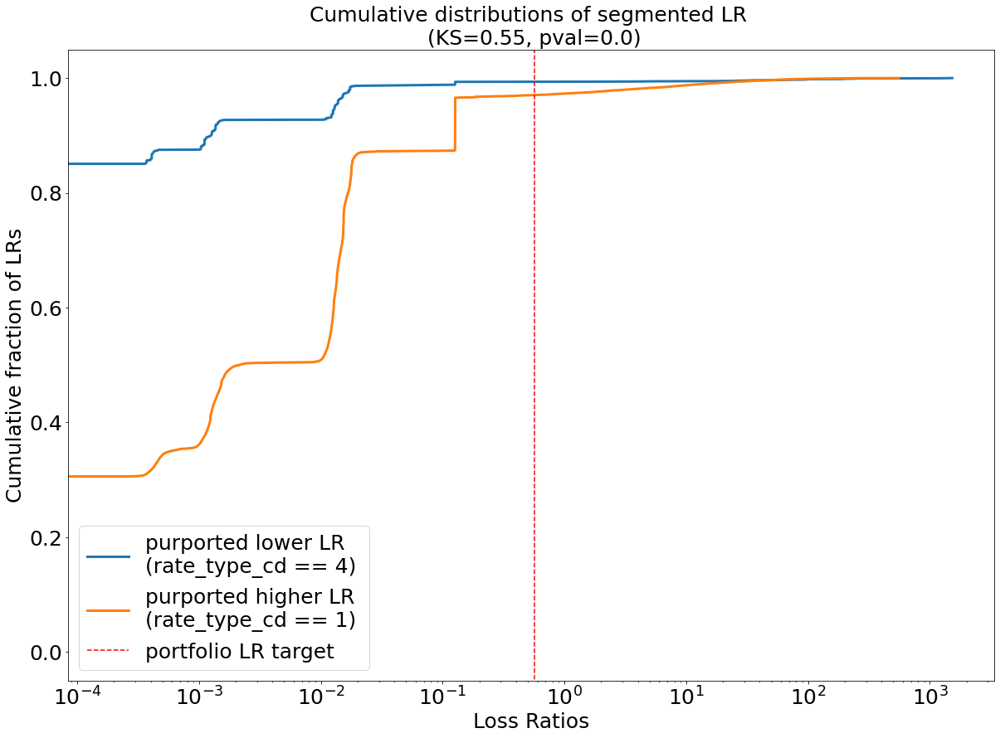

In [172]:
high_mask = (preprocess_df["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["rate_type_cd"] == 4) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "cumulative_rate_type_cd_4.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(rate_type_cd == 4)", high_label="purported higher LR \n(rate_type_cd == 1)")

low 1.3958562072971865
high 0.6805440027887499


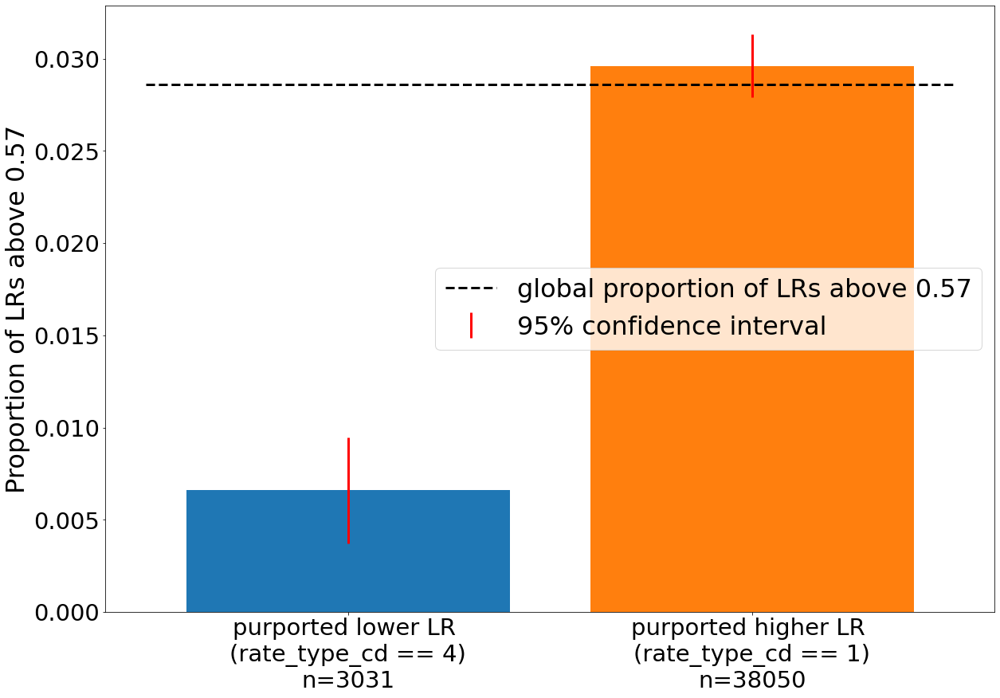

In [173]:
high_mask = (preprocess_df["rate_type_cd"] == 1) #& (preprocess_df["prev_lr_bad_proportion"] <= 1.0)
low_mask = (preprocess_df["rate_type_cd"] == 4) #& (preprocess_df["prev_lr_bad_proportion"] <= 0.2)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_rate_type_cd_057_4.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(rate_type_cd == 4)", high_label = "purported higher LR \n(rate_type_cd == 1)", threshold = 0.57)


##### size_of_firm and the interaction with exposure (not requested)

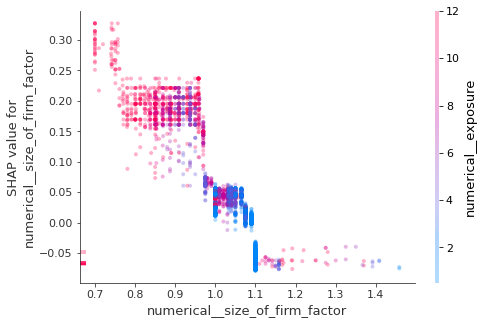

In [174]:
shap.dependence_plot("numerical__size_of_firm_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)

In [175]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__size_of_firm_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "size_of_firm_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [176]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=313.924162309716, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.42705711597604573, pvalue=1.8875084230541578e-84)
0.7215257918529653
1.0229035194237623


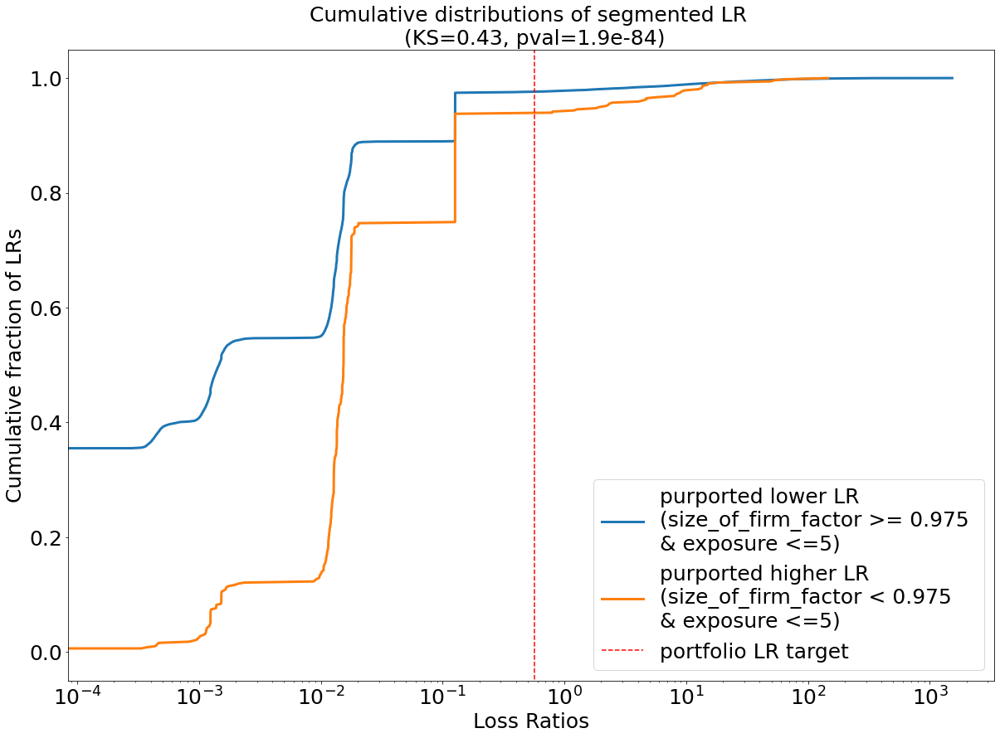

In [181]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["exposure"] <= 5)
low_mask = (preprocess_df["size_of_firm_factor"] >= 0.975) & (preprocess_df["exposure"] <= 5)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "business_interaction_cumulative_size_of_firm.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(size_of_firm_factor >= 0.975 \n& exposure <=5)", high_label="purported higher LR \n(size_of_firm_factor < 0.975 \n& exposure <=5)")

low 0.7215257918529653
high 1.0229035194237623


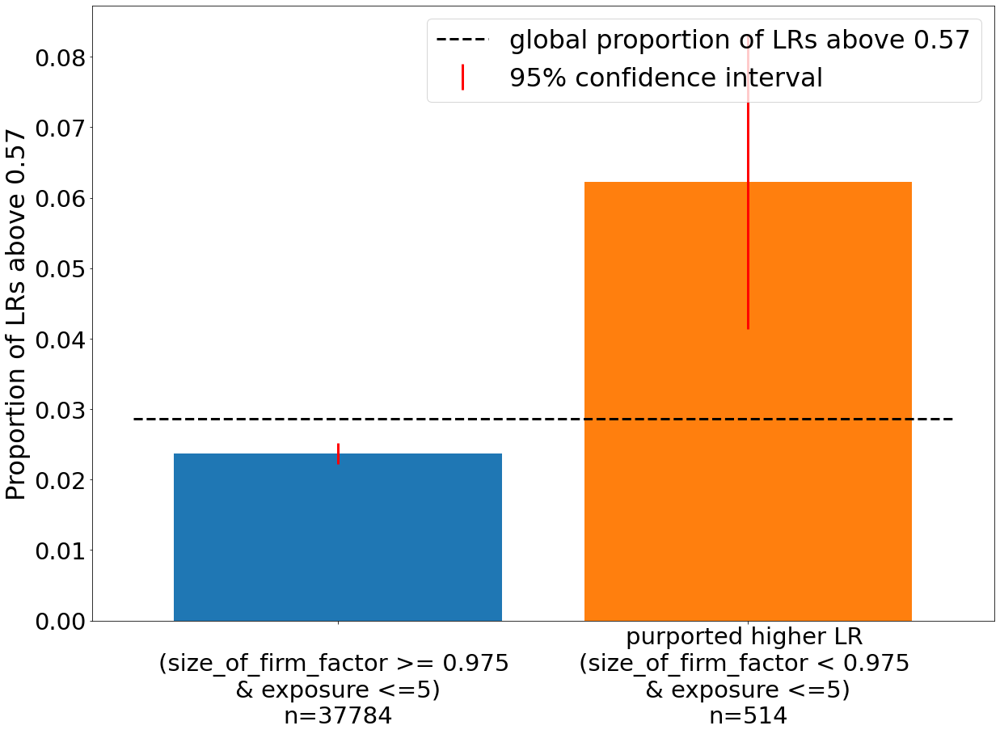

In [182]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["exposure"] <= 5)
low_mask = (preprocess_df["size_of_firm_factor"] >= 0.975) & (preprocess_df["exposure"] <= 5)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "business_interaction_bar_chart_cumulative_size_of_firm_exposure_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "\n(size_of_firm_factor >= 0.975 \n& exposure <=5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 \n& exposure <=5)", threshold = 0.57)


##### increased_limits_factor and the interaction with exposure 

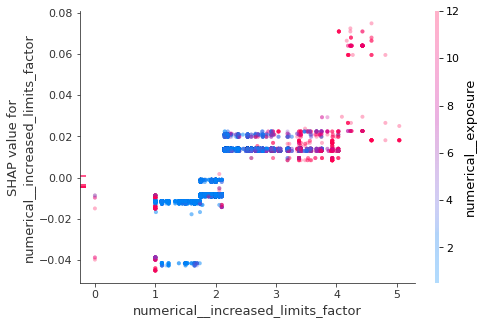

In [183]:
shap.dependence_plot("numerical__increased_limits_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)

In [186]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__increased_limits_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = "numerical__exposure", x_jitter=0, alpha = 0.3)
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "business_interaction_" + "increased_limits_factor_exposure" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [187]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

Anderson_ksampResult(statistic=0.948767322681581, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.13292615752034306)
KstestResult(statistic=0.28333314377352914, pvalue=0.2831839708606354)
0.6801801384664193
0.27723175183911863


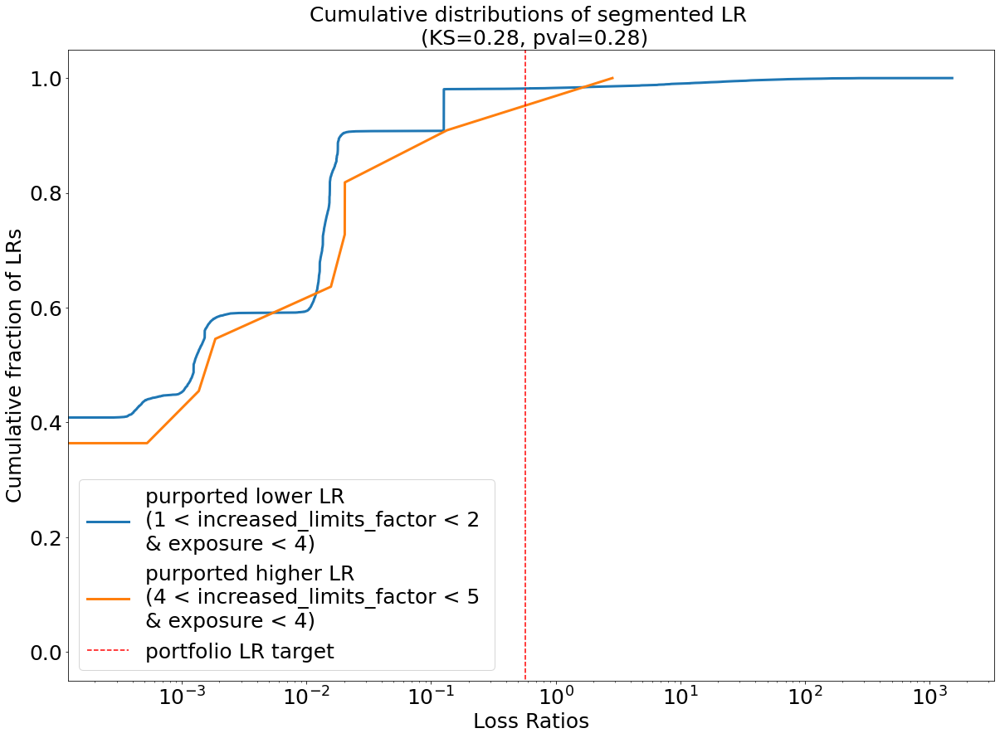

In [355]:
high_mask = (preprocess_df["increased_limits_factor"] < 5) & (preprocess_df["increased_limits_factor"] > 4) & (preprocess_df["exposure"] <= 4)
low_mask = (preprocess_df["increased_limits_factor"] < 2) & (preprocess_df["increased_limits_factor"] > 1) & (preprocess_df["exposure"] <= 4)

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "business_interaction_cumulative_increased_limits_exposure.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR \n(1 < increased_limits_factor < 2 \n& exposure < 4)", high_label="purported higher LR \n(4 < increased_limits_factor < 5 \n& exposure < 4)")

low 0.6801801384664193
high 0.27723175183911863


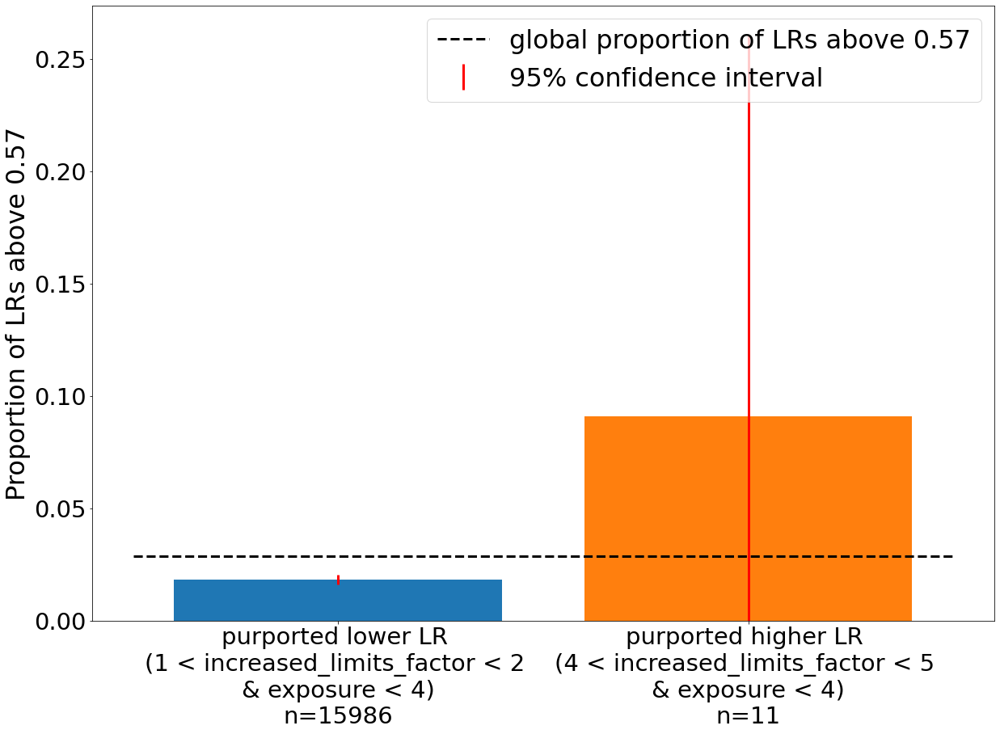

In [191]:
high_mask = (preprocess_df["increased_limits_factor"] < 5) & (preprocess_df["increased_limits_factor"] > 4) & (preprocess_df["exposure"] <= 4)
low_mask = (preprocess_df["increased_limits_factor"] < 2) & (preprocess_df["increased_limits_factor"] > 1) & (preprocess_df["exposure"] <= 4)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "business_interaction_bar_chart_cumulative_increased_limits_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(1 < increased_limits_factor < 2 \n& exposure < 4)", high_label = "purported higher LR \n(4 < increased_limits_factor < 5 \n& exposure < 4)", threshold = 0.57)


##### do we see the 'edition' effect with all the data (we did for Karan's truncated model)

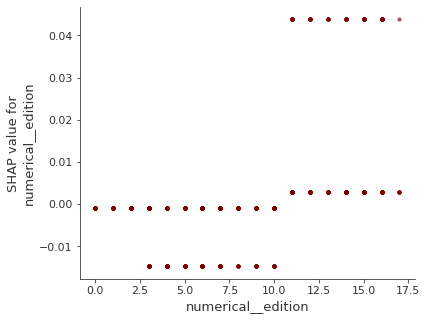

In [361]:
shap.dependence_plot("numerical__edition", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')

In [362]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__edition", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "businessrequest_" + "edition" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [363]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

low 0.6955860973068834
high 0.744372748591423


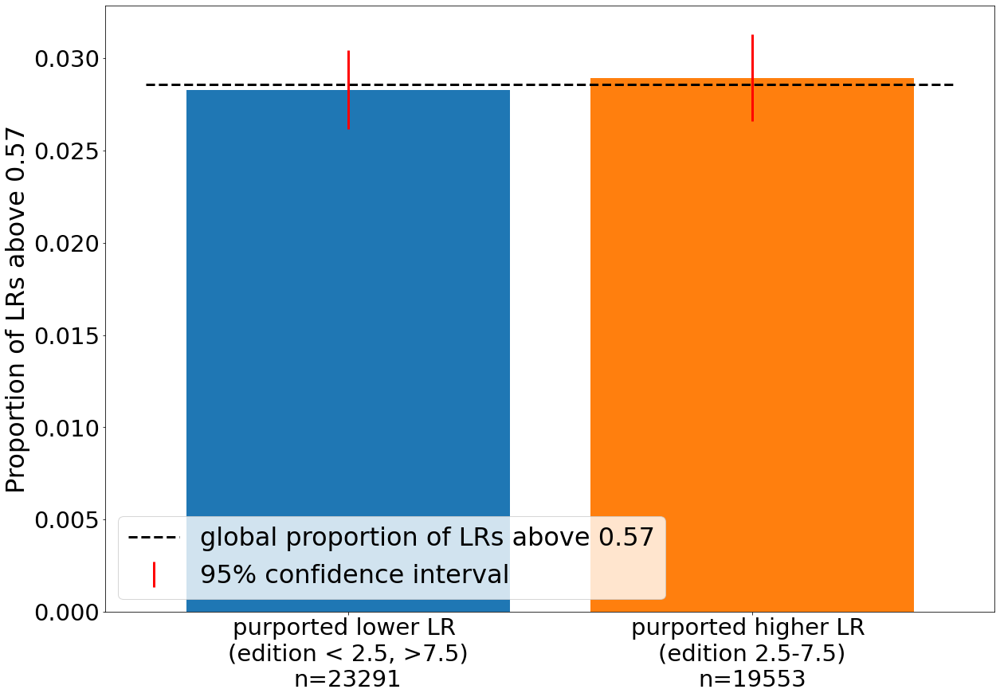

low 0.6955860973068834
high 0.744372748591423


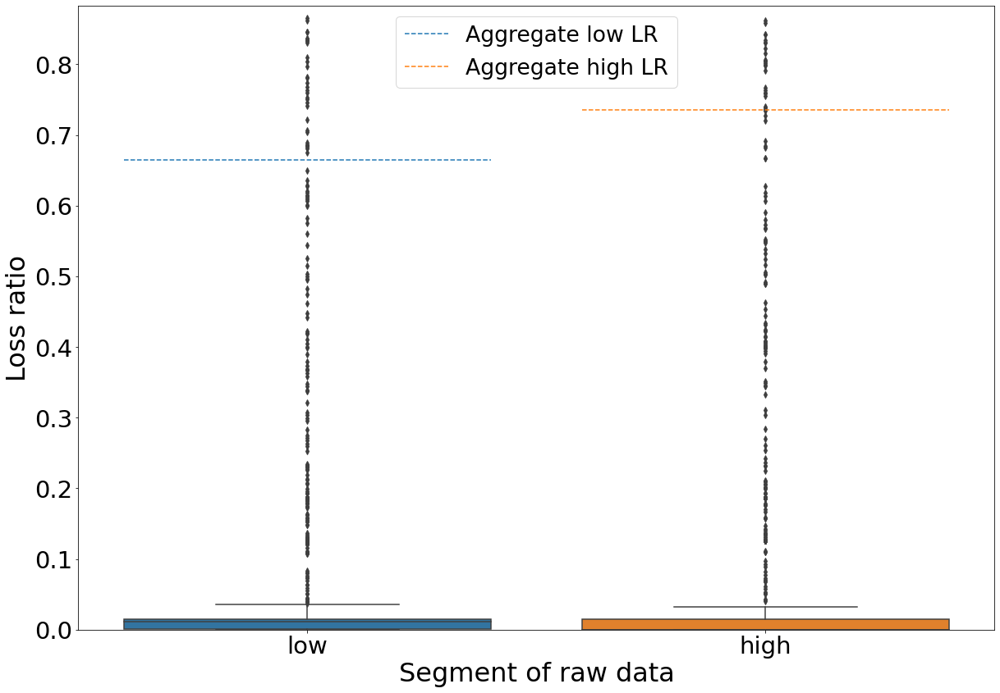

In [383]:
high_mask = (preprocess_df["edition"] > 2.5) & (preprocess_df["edition"] < 7.5)
low_mask = (preprocess_df["edition"] < 2.5) | (preprocess_df["edition"] > 7.5)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_edition_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(edition < 2.5, >7.5)", high_label = "purported higher LR \n(edition 2.5-7.5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_edition_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(edition < 2.5, >7.5)", high_label = "purported higher LR \n(edition 2.5-7.5)")

##### do we see the AOP factor effect with all the data (we did for Karan's truncated model)

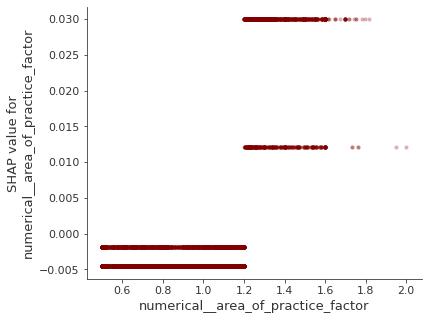

In [366]:
shap.dependence_plot("numerical__area_of_practice_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')

In [367]:
%matplotlib auto
plt.clf()
shap.dependence_plot("numerical__area_of_practice_factor", shap_values, X_shap, feature_names=feature_names_encoded, interaction_index = None, x_jitter=0, alpha = 0.3, color='maroon')
figure = plt.gcf()
figure.savefig("EDA_investigation_figures"+ os.sep + "businessrequest_" + "aop_factor" + ".png", dpi=300, bbox_inches='tight')
plt.clf()

Using matplotlib backend: agg


In [368]:
%matplotlib inline
plt.clf()
plt.close()
plt.rcParams["figure.figsize"]=20,14
textsize = 25

<Figure size 432x288 with 0 Axes>

low 0.610619455802849
high 0.7342624886823551


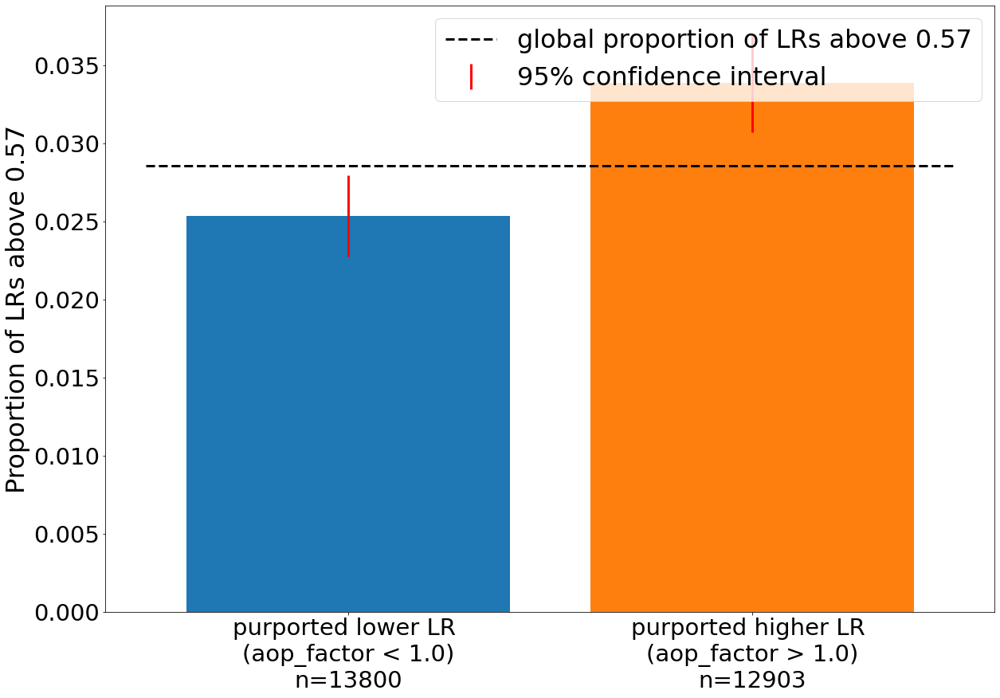

low 0.610619455802849
high 0.7342624886823551


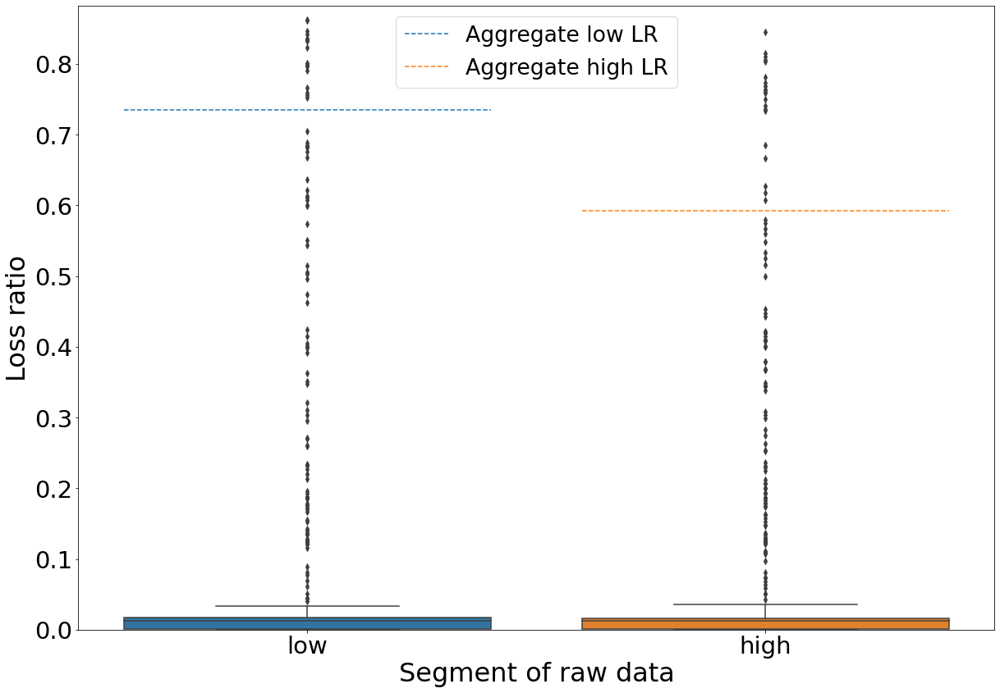

In [257]:
high_mask = (preprocess_df["area_of_practice_factor"] > 1.0) 
low_mask = (preprocess_df["area_of_practice_factor"] < 1.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_aop_factor_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(aop_factor < 1.0)", high_label = "purported higher LR \n(aop_factor > 1.0)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_aop_factor_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(aop_factor < 1.0)", high_label = "purported higher LR \n(aop_factor > 1.0)")

##### does the bad aggregate loss ratio effect hold between admitted and non-admitted products?

low 0.6292499525566504
high 1.379598475525689


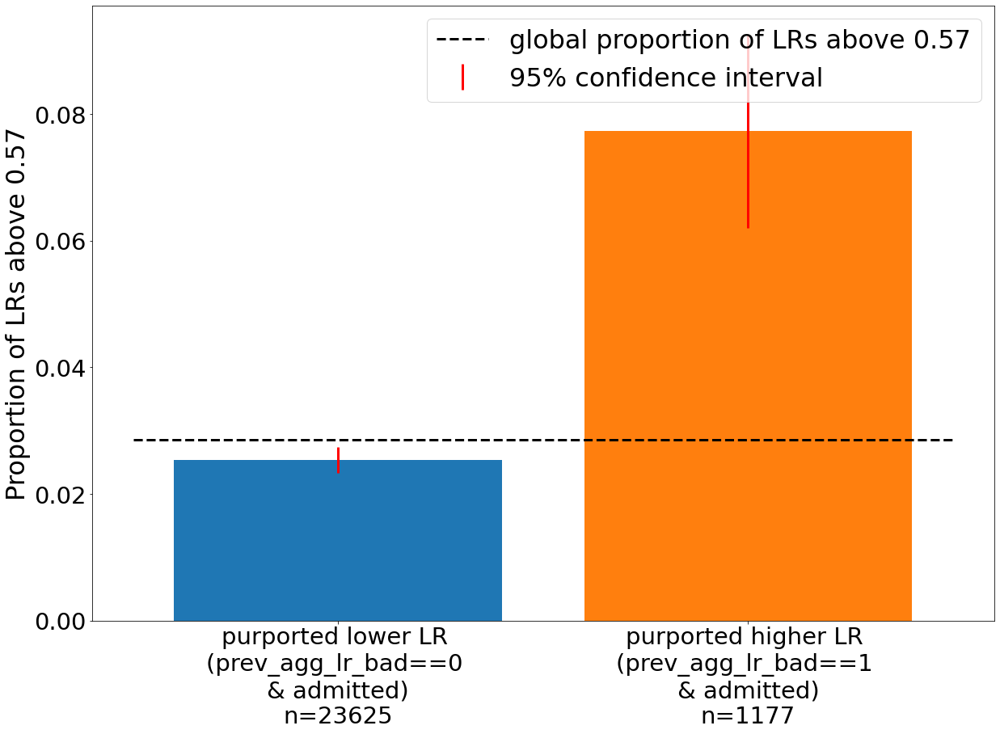

In [452]:
high_mask = (preprocess_df["prev_agg_lr_bad"] == 1.0) & (preprocess_df["admitted_vs_notadmitted"] == "Admitted")
low_mask = (preprocess_df["prev_agg_lr_bad"] == 0.0) & (preprocess_df["admitted_vs_notadmitted"] == "Admitted")

high_low_confint_plot(low_mask, high_mask, preprocess_df, "businesstest_bar_chart_prev_aggr_lr_bad_admitted_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(prev_agg_lr_bad==0 \n& admitted)", high_label = "purported higher LR \n(prev_agg_lr_bad==1 \n& admitted)", threshold = 0.57)

In [259]:
preprocess_df["admitted_vs_notadmitted"].value_counts()

admitted_vs_notadmitted
Admitted        41858
Not_Admitted      986
Name: count, dtype: int64

low 0.4446436010550043
high 1.2913879852042291


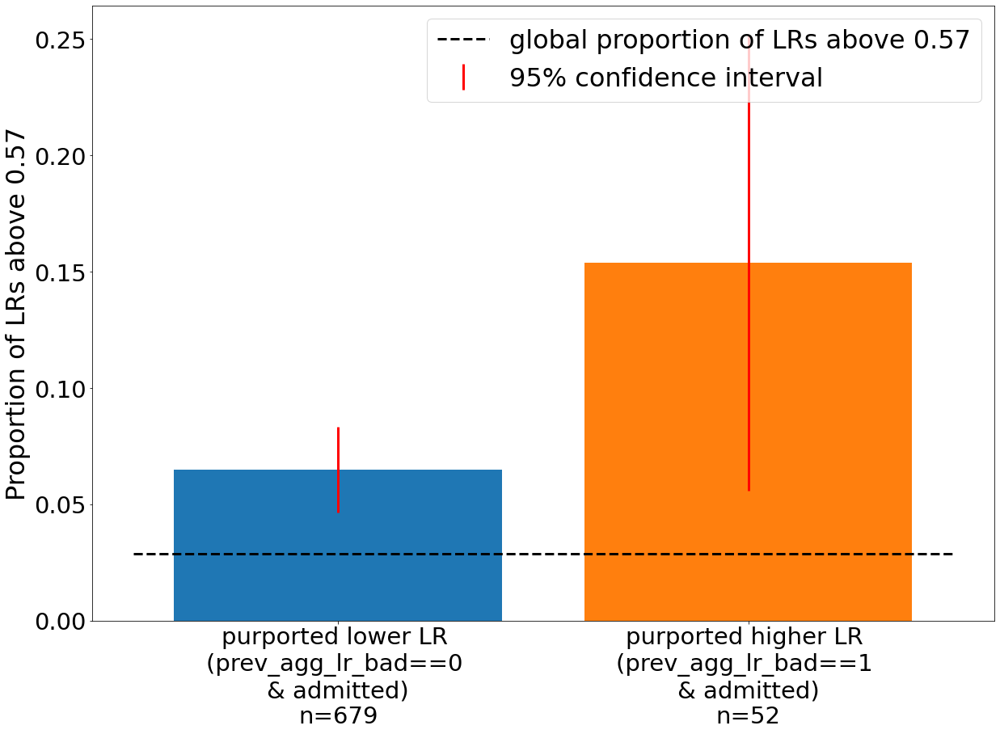

In [260]:
high_mask = (preprocess_df["prev_agg_lr_bad"] == 1.0) & (preprocess_df["admitted_vs_notadmitted"] == "Not_Admitted")
low_mask = (preprocess_df["prev_agg_lr_bad"] == 0.0) & (preprocess_df["admitted_vs_notadmitted"] == "Not_Admitted")

high_low_confint_plot(low_mask, high_mask, preprocess_df, "businesstest_bar_chart_prev_aggr_lr_bad_NOTadmitted_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(prev_agg_lr_bad==0 \n& admitted)", high_label = "purported higher LR \n(prev_agg_lr_bad==1 \n& admitted)", threshold = 0.57)

In [454]:
preprocess_df["admitted_vs_notadmitted"].value_counts()

admitted_vs_notadmitted
Admitted        41858
Not_Admitted      986
Name: count, dtype: int64

##### for small size of firm factor + higher exposure in average AOP, can we break out family law AOP?

low 0.706372499920157
high 1.1263438109023118


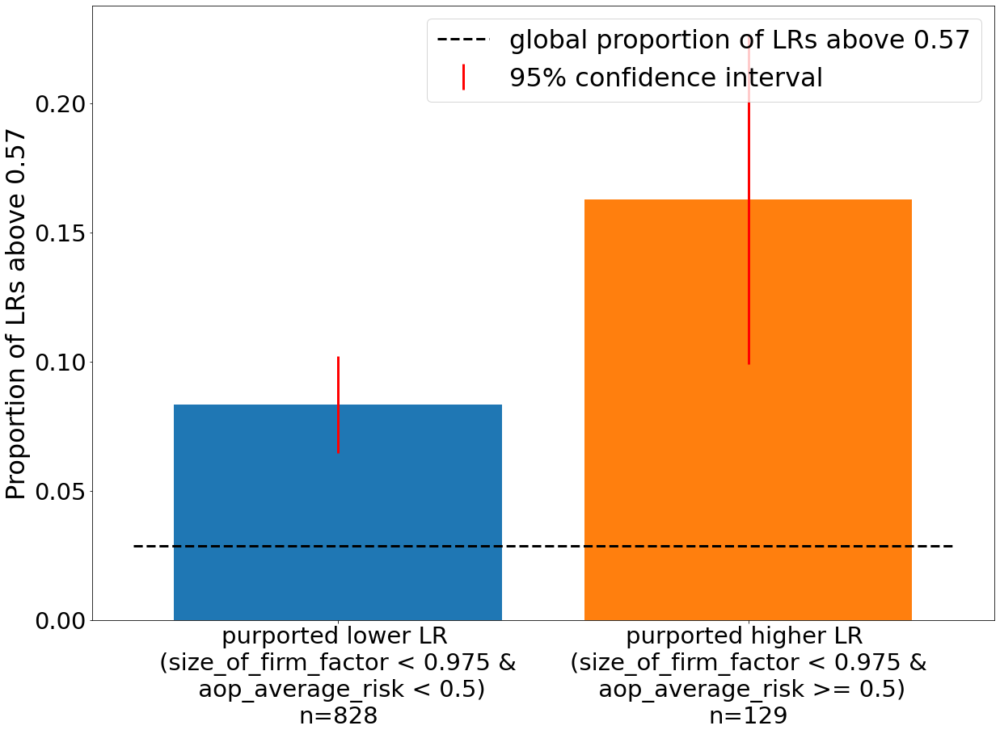

low 0.5869005216292651
high 0.5642754916787966


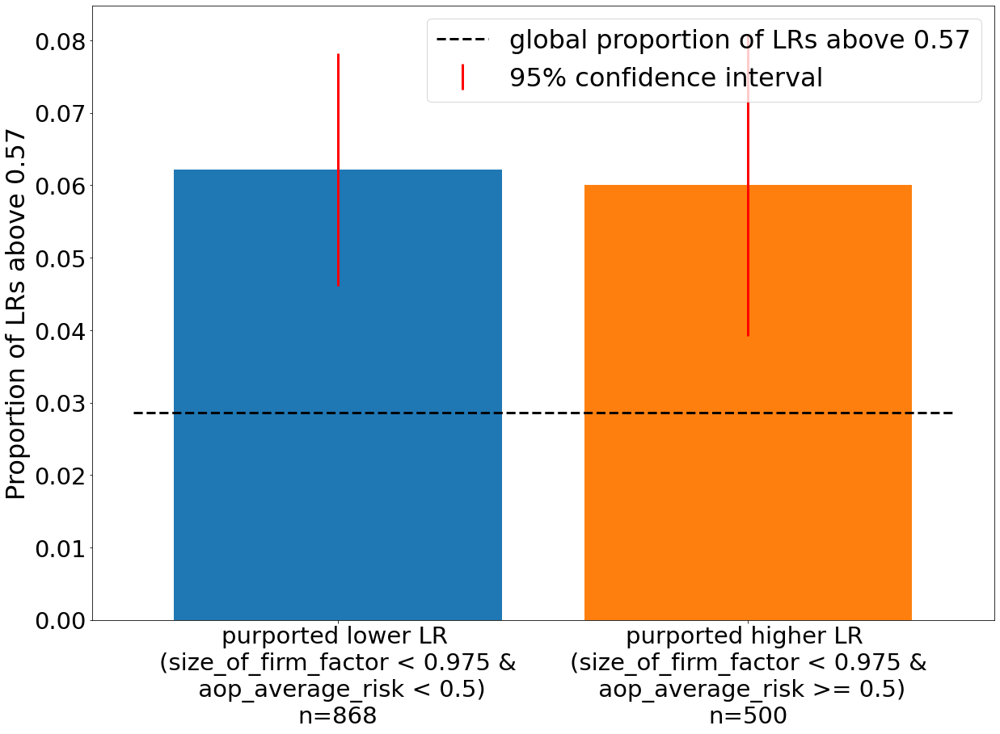

In [553]:
dominant_family_law = preprocess_df.iloc[df[df["family_law"] > 0].index].reset_index()
nondominant_family_law = preprocess_df.iloc[df[df["family_law"] == 0.0].index].reset_index()

high_mask = (dominant_family_law["size_of_firm_factor"] < 0.975) & (dominant_family_law["aop_average_risk"] >= 0.5)
low_mask = (dominant_family_law["size_of_firm_factor"] < 0.975) & (dominant_family_law["aop_average_risk"] < 0.5)

high_low_confint_plot(low_mask, high_mask, dominant_family_law, "businesstest_bar_chart_size_of_firm_dominant_family_law_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)", threshold = 0.57)

high_mask = (nondominant_family_law["size_of_firm_factor"] < 0.975) & (dominant_family_law["aop_average_risk"] >= 0.5)
low_mask = (nondominant_family_law["size_of_firm_factor"] < 0.975) & (dominant_family_law["aop_average_risk"] < 0.5)

high_low_confint_plot(low_mask, high_mask, nondominant_family_law, "businesstest_bar_chart_size_of_firm_nondominant_family_law_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)", threshold = 0.57)

In [ ]:
high_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["aop_average_risk"] >= 0.5)
low_mask = (preprocess_df["size_of_firm_factor"] < 0.975) & (preprocess_df["aop_average_risk"] < 0.5)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_cumulative_size_of_firm_aop_average_risk_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)", threshold = 0.57)

lr_box_plot(low_mask, high_mask, preprocess_df, preprocess_df_incl_lossnpremium, "bar_chart_size_of_firm_aop_average_risk_actual_lrs.png", "ultimate_trended_onlevel_lr",
                        low_label = "purported lower LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk < 0.5)", high_label = "purported higher LR \n(size_of_firm_factor < 0.975 &\n aop_average_risk >= 0.5)")

##### directly investiagate the AOP diversity effect for small and large firms through univariate analysis

First, restricting the analysis to solo firms:

In [110]:
solo_mask = (present_target_trunc_df["exposure"] == 1.0) | (present_target_trunc_df["exposure"] == 0.5)

solo_firms_df = present_target_trunc_df[solo_mask]
print(solo_firms_df.shape)

(26513, 536)


In [116]:
preprocess_df["exposure"].value_counts()

1.0      23397
2.0       6104
0.5       3116
3.0       2938
4.0       1709
         ...  
182.0        1
13.5         1
102.0        1
177.0        1
131.0        1
Name: exposure, Length: 171, dtype: int64

low 0.5165239671585947
high 1.2784254045581969


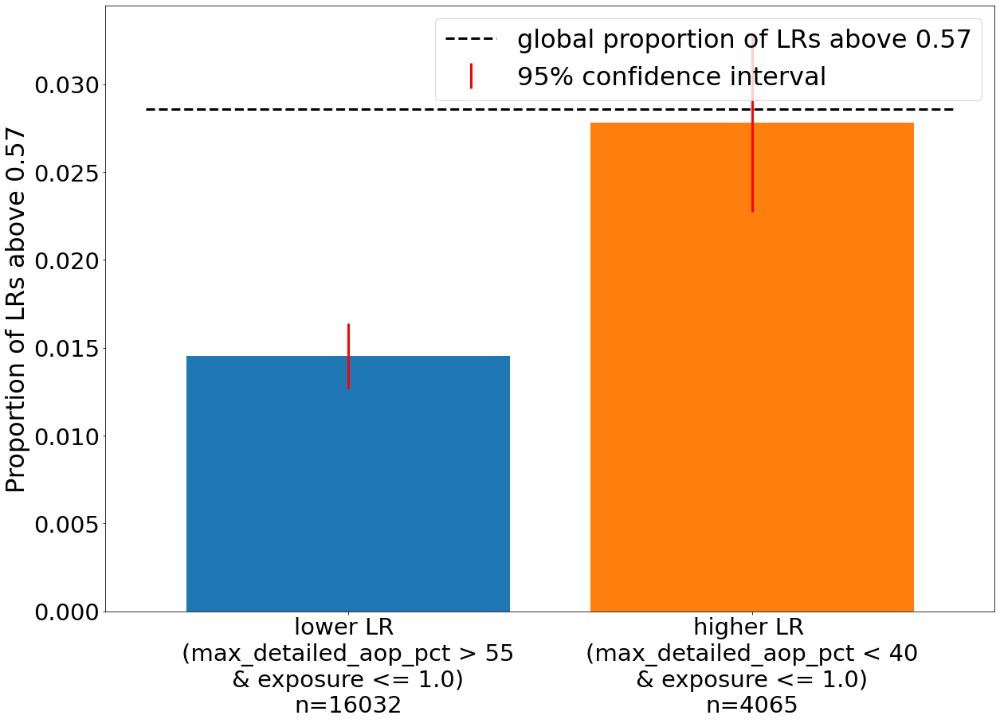

In [121]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] <= 1.0)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 55) & (preprocess_df["exposure"] <= 1.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_solofirms_maxdetaoppct_exposure_057_2024.png", "ultimate_trended_onlevel_lr", 
                        low_label = "lower LR \n(max_detailed_aop_pct > 55\n& exposure <= 1.0)", high_label = "higher LR \n(max_detailed_aop_pct < 40\n& exposure <= 1.0)", threshold = 0.57)

low 0.6896900876167796
high 0.8043652923341642


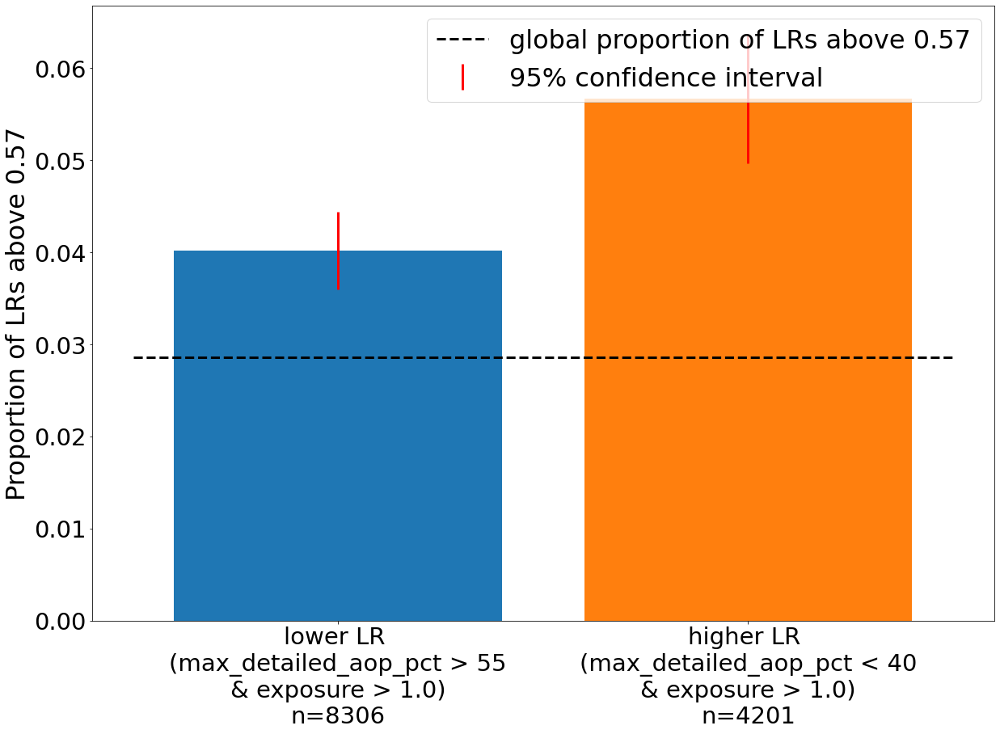

In [122]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] > 1.0)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 55) & (preprocess_df["exposure"] > 1.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_NONsolofirms_maxdetaoppct_exposure_057_2024.png", "ultimate_trended_onlevel_lr", 
                        low_label = "lower LR \n(max_detailed_aop_pct > 55\n& exposure > 1.0)", high_label = "higher LR \n(max_detailed_aop_pct < 40\n& exposure > 1.0)", threshold = 0.57)

low 0.19047047682183854
high 1.0904017786778668


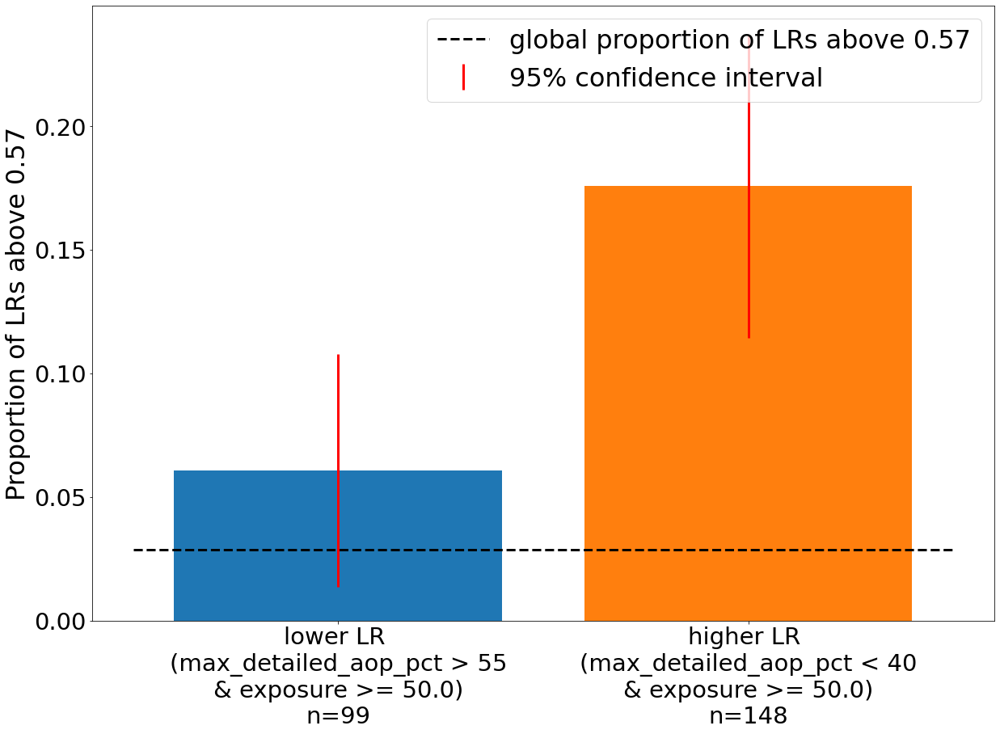

In [123]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 40) & (preprocess_df["exposure"] >= 50.0)
low_mask = (preprocess_df["max_detailed_aop_pct"] > 55) & (preprocess_df["exposure"] >= 50.0)

high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_exceedinglylargefirms_maxdetaoppct_exposure_057_2024.png", "ultimate_trended_onlevel_lr", 
                        low_label = "lower LR \n(max_detailed_aop_pct > 55\n& exposure >= 50.0)", high_label = "higher LR \n(max_detailed_aop_pct < 40\n& exposure >= 50.0)", threshold = 0.57)

0.0285921015778172
Index(['mean', 'count', 'sum', 'list'], dtype='object')
['(30.0', '(40.0', '(45.0', '(50.0', '(60.0', '(70.0', '(76.7', '(85.0', '(9.999', '(95.0']
['(30.0, 40.0]', '(40.0, 45.0]', '(45.0, 50.0]', '(50.0, 60.0]', '(60.0, 70.0]', '(70.0, 76.7]', '(76.7, 85.0]', '(85.0, 95.0]', '(9.999, 30.0]', '(95.0, 100.0]']


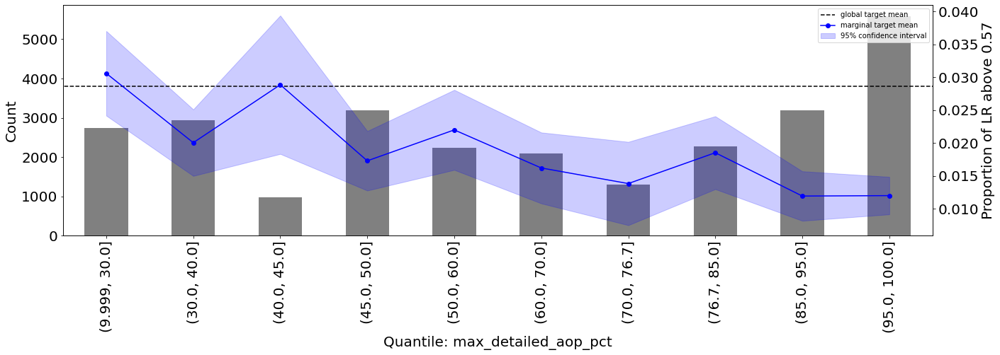

True

In [110]:
# add an indicator of good/bad LR

preprocess_df["bad_lr"] = preprocess_df.apply(lambda x: 1 if x["ultimate_trended_onlevel_lr"] > 0.57 else 0, axis=1)
global_mean = preprocess_df["bad_lr"].mean()
print(global_mean)
univariate_num(preprocess_df[preprocess_df["exposure"] <= 1.0], "max_detailed_aop_pct", "bad_lr", n_buckets=12, filename= os.getcwd() + os.sep + "feature_solofirm_detailedaop_pct" +  ".png", target_binary=True, fontsize=20, plot=True, ylabel="Proportion of LR above 0.57", global_override=global_mean)

Index(['mean', 'count', 'sum', 'list'], dtype='object')
['(25.0', '(30.0', '(38.0', '(45.0', '(50.0', '(57.4', '(68.0', '(76.0', '(86.0', '(9.999', '(95.0']
['(25.0, 30.0]', '(30.0, 38.0]', '(38.0, 45.0]', '(45.0, 50.0]', '(50.0, 57.4]', '(57.4, 68.0]', '(68.0, 76.0]', '(76.0, 86.0]', '(86.0, 95.0]', '(9.999, 25.0]', '(95.0, 100.0]']


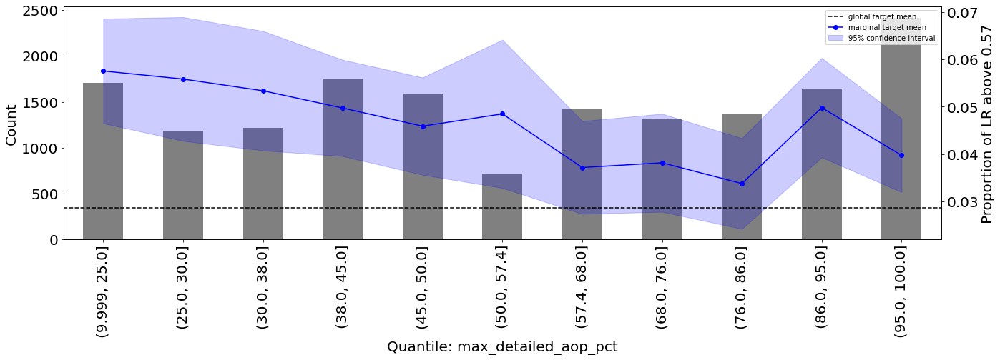

True

In [164]:
univariate_num(preprocess_df[preprocess_df["exposure"] > 1.0], "max_detailed_aop_pct", "bad_lr", n_buckets=12, filename= os.getcwd() + os.sep + "feature_NONsolofirm_detailedaop_pct" +  ".png", target_binary=True, fontsize=20, plot=True, ylabel="Proportion of LR above 0.57", global_override=global_mean)

Index(['mean', 'count', 'sum', 'list'], dtype='object')
['(12.499', '(16.263', '(20.96', '(24.0', '(26.267', '(32.0', '(41.5', '(49.393', '(53.103', '(66.2', '(80.333', '(92.25']
['(12.499, 16.263]', '(16.263, 20.96]', '(20.96, 24.0]', '(24.0, 26.267]', '(26.267, 32.0]', '(32.0, 41.5]', '(41.5, 49.393]', '(49.393, 53.103]', '(53.103, 66.2]', '(66.2, 80.333]', '(80.333, 92.25]', '(92.25, 100.0]']


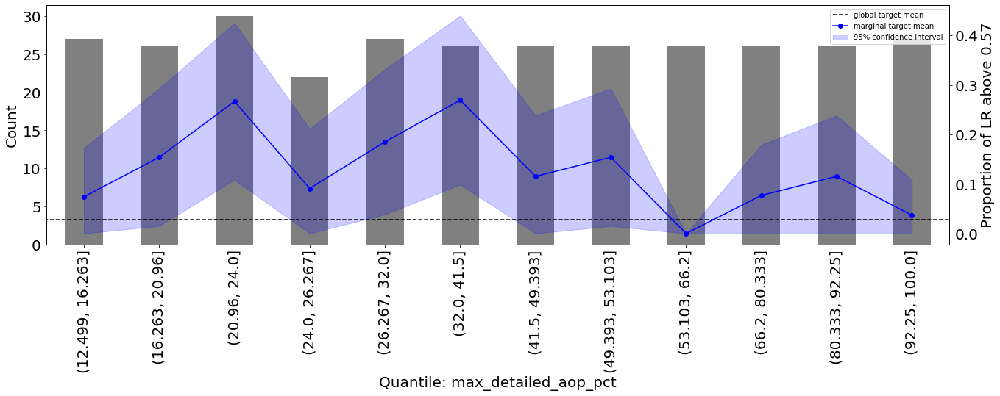

True

In [111]:
univariate_num(preprocess_df[preprocess_df["exposure"] >= 50.0], "max_detailed_aop_pct", "bad_lr", n_buckets=12, filename= os.getcwd() + os.sep + "feature_exceeddinglylargefirm_detailedaop_pct" +  ".png", target_binary=True, fontsize=20, plot=True, ylabel="Proportion of LR above 0.57", global_override=global_mean)

In [ ]:
univariate_num(preprocess_df[preprocess_df["exposure"] <= 1.0], "max_detailed_aop_pct", "bad_lr", n_buckets=12, filename= os.getcwd() + os.sep + "feature_solofirm_detailedaop_pct" +  ".png", target_binary=True, fontsize=20, plot=True, ylabel="Proportion of LR above 0.57")

In [125]:
test = preprocess_df[preprocess_df["exposure"] <=1].groupby("max_detailed_aop")["ultimate_trended_onlevel_lr"].agg(['mean', 'std'])

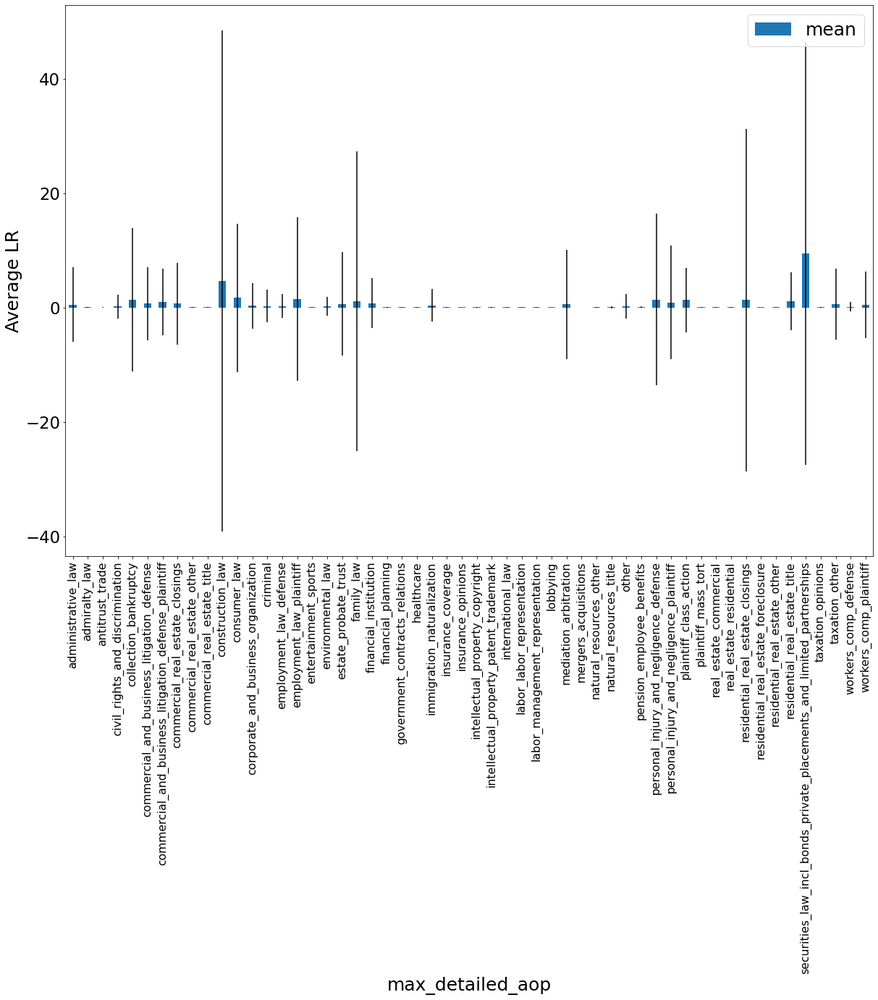

In [132]:
test.plot(kind='bar', y='mean', yerr='std')
save_name = "solo_firm_aopdetailed"

#present_target_trunc_df["premium_per_attorney"] = present_target_trunc_df["onlevel_premium"]/(present_target_trunc_df["ft_att"] + present_target_trunc_df["pt_att"])

plt.xlabel("max_detailed_aop", fontsize=fontsize)
plt.ylabel("Average LR", fontsize=fontsize)
plt.xticks(size=fontsize/1.6)
plt.yticks(size=fontsize/1.1)
plt.savefig("EDA_investigation_figures"+ os.sep + save_name, dpi=300, bbox_inches='tight')
plt.legend(loc='best', fontsize=fontsize)
plt.show()


##### average premium per attorney across size

Here the question was, if we aren't accounting for the size of firm appropriately, how does premium per attorney vary across sizes of firm? 

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


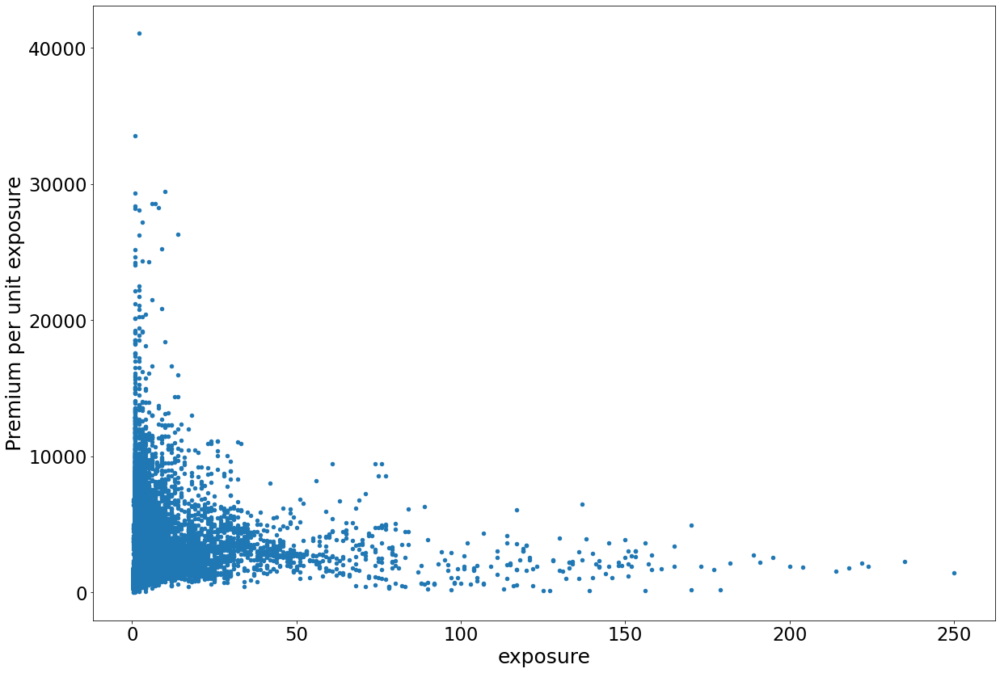

In [113]:
save_name = "premium_per_exposure"
fontsize = 25
present_target_trunc_df["premium_per_exposure"] = present_target_trunc_df["premium"]/present_target_trunc_df["exposure"]
#present_target_trunc_df["premium_per_attorney"] = present_target_trunc_df["onlevel_premium"]/(present_target_trunc_df["ft_att"] + present_target_trunc_df["pt_att"])

present_target_trunc_df.plot(x = "exposure", y="premium_per_exposure", kind= 'scatter')

plt.xlabel("exposure", fontsize=fontsize)
plt.ylabel("Premium per unit exposure", fontsize=fontsize)
plt.xticks(size=fontsize/1.1)
plt.yticks(size=fontsize/1.1)
#plt.legend(loc='best', fontsize=fontsize)

plt.savefig("EDA_investigation_figures"+ os.sep + save_name, dpi=300, bbox_inches='tight')

plt.show()


# plt.show()

### adding random noise

In [218]:
X_train_addnoise = X_train.copy()
X_test_addnoise = X_test.copy()

# uniform noise for train/test
X_train_addnoise["rand_uniform"] = np.random.uniform(-1, 1, X_train.shape[0])
X_test_addnoise["rand_uniform"] = np.random.uniform(-1, 1, X_test.shape[0])

# normal sampling for train/test 
X_train_addnoise["rand_norm"] = np.random.normal(0, 1, size=X_train.shape[0])
X_test_addnoise["rand_norm"] = np.random.normal(0, 1, size=X_test.shape[0])

training XGB with the best hyperparameters from before:

In [222]:
xgb_clf = xgb.XGBClassifier(n_jobs=-1, use_label_encoder=False, tree_method='hist', subsample=0.5, n_estimators=50, max_depth=2, gamma=0.01, eta=0.01, min_child_weight = 5, max_delta_step = 0, colsample_bytree=0.5)

# imputation/encoding of features
ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)

encode_transform = ColumnTransformer(
    transformers=[
        ("numerical", 'passthrough', numerical_to_keep + ["rand_uniform", "rand_norm"]),
        ("nominal", ohe, nominal_to_keep)
    ])

pipe = pipe = Pipeline(steps=[("encoding", encode_transform), ("XGBoost", xgb_clf)])

pipe.fit(X_train_addnoise, y_train_labeled)

joblib.dump(pipe, "XGBv14_best_estimator_ND_addednoise.pkl")

`use_label_encoder` is deprecated in 1.7.0.


['XGBv14_best_estimator_ND_addednoise.pkl']

#### permutation importance with this noise

In [223]:
# This is the best performing model 
with open("XGBv14_best_estimator_ND_addednoise.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

feature_names = best_clss_model.named_steps["encoding"].transformers_[0][2]  + best_clss_model.named_steps["encoding"].transformers_[1][2]

perm = permutation_importance(best_clss_model, X_test_addnoise.loc[:, feature_names], y_test_labeled, n_repeats = 50, scoring="roc_auc", n_jobs=-1)

In [224]:
top_x = 20
perm_idx_sorted = perm.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'aggregate_limit', 'prev_lr_bad_proportion', 'prev_ft_att_trend', 'prev_lr_avg_2', 'prev_agg_lr_bad', 'occurrence_limit', 'increased_limits_factor', 'product_modified', 'aggregate_deductible_amount', 'rating_program', 'market', 'surcharge', 'prev_lr_avg_4', 'prev_lr_std', 'policy_lenght_days', 'prev_lr_avg_3', 'max_detailed_aop']
['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'aggregate_limit', 'prev_lr_bad_proportion', 'prev_ft_att_trend', 'prev_lr_avg_2', 'prev_agg_lr_bad', 'occurrence_limit', 'increased_limits_factor', 'product_modified', 'aggregate_deductible_amount', 'rating_program', 'market', 'surcharge', 'prev_lr_avg_4', 'prev_lr_std', 'policy_lenght_days', 'prev_lr_avg_3', 'max_detailed_aop', 'prev_lr_trend', 'not_greater_financial_crisis', 'prev_lr_avg_5', 'aop_average_risk', 'schedule_modification_factor', 'product', 'prev_lr_avg_1', 'policy_prefix_code', 'base_rate_factor', 'non_dis

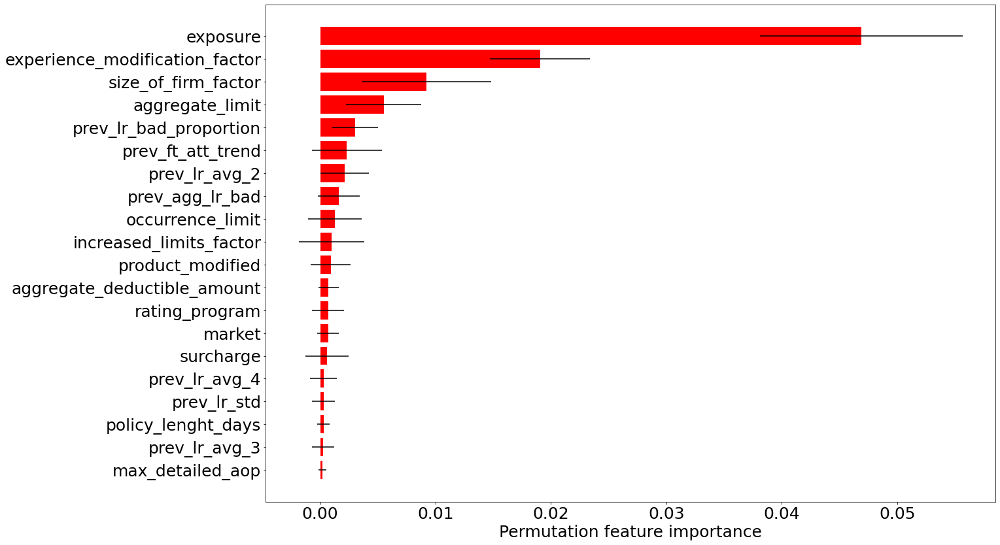

In [225]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_XGB_classification_withnoise.png", dpi=300, bbox_inches='tight')
plt.show()

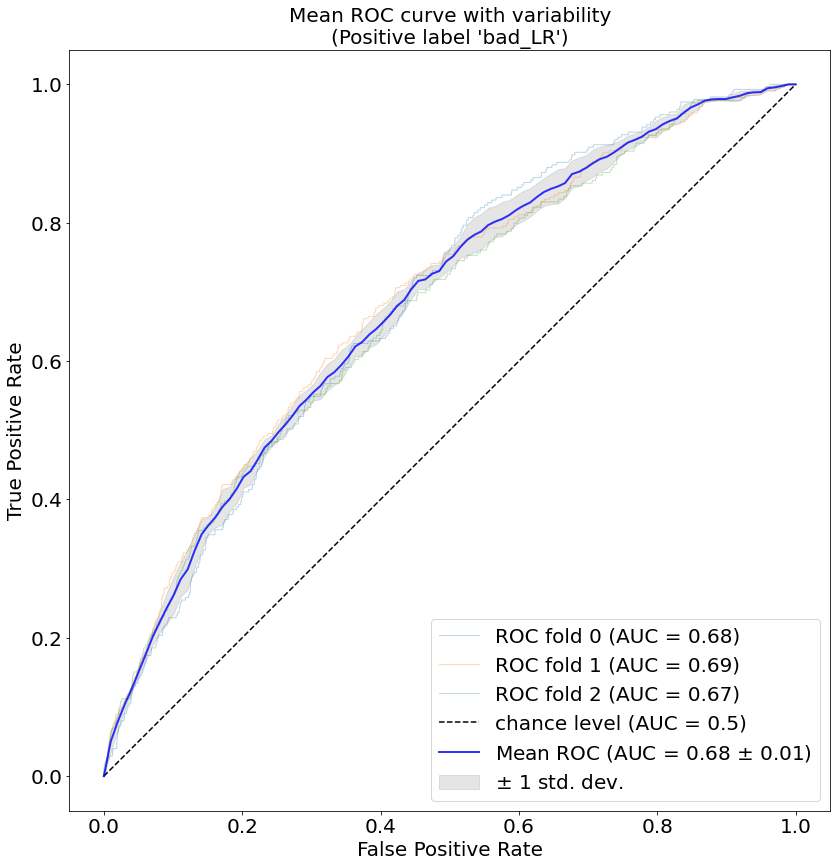

In [217]:
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
    log_reg = joblib.load(file)
    
roc_cv(train_df, X=X_train, y=y_train_labeled, classifier=log_reg, target='bad_LR', fontsize=20, filename="bad_lr_xgb_classifier_CV.png")

In [ ]:
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
    log_reg = joblib.load(file)
    
roc_cv(train_df, X=X_train, y=y_train_labeled, classifier=log_reg, target='bad_LR', fontsize=20, filename="bad_lr_xgb_classifier_CV.png")

### calibration exploration

0.2027128
[0.078775   0.08186746 0.04575985 ... 0.03837798 0.04290476 0.05606051]
0        1
2        0
5        0
6        0
10       0
        ..
42816    0
42826    0
42829    0
42830    0
42834    0
Name: ultimate_trended_onlevel_lr, Length: 12853, dtype: int64
[(0.0495, 0.203], (0.0495, 0.203], (0.0383, 0.0495], (0.0383, 0.0495], (0.0383, 0.0495], ..., (0.0495, 0.203], (0.0187, 0.0213], (0.0383, 0.0495], (0.0383, 0.0495], (0.0495, 0.203]]
Length: 12853
Categories (10, interval[float64, right]): [(0.013500000000000002, 0.0187] < (0.0187, 0.0213] < (0.0213, 0.0233] < (0.0233, 0.0252] ... (0.0295, 0.0329] < (0.0329, 0.0383] < (0.0383, 0.0495] < (0.0495, 0.203]]
['(0.013500000000000002, 0.0187]', '(0.0187, 0.0213]', '(0.0213, 0.0233]', '(0.0233, 0.0252]', '(0.0252, 0.0271]', '(0.0271, 0.0295]', '(0.0295, 0.0329]', '(0.0329, 0.0383]', '(0.0383, 0.0495]', '(0.0495, 0.203]']


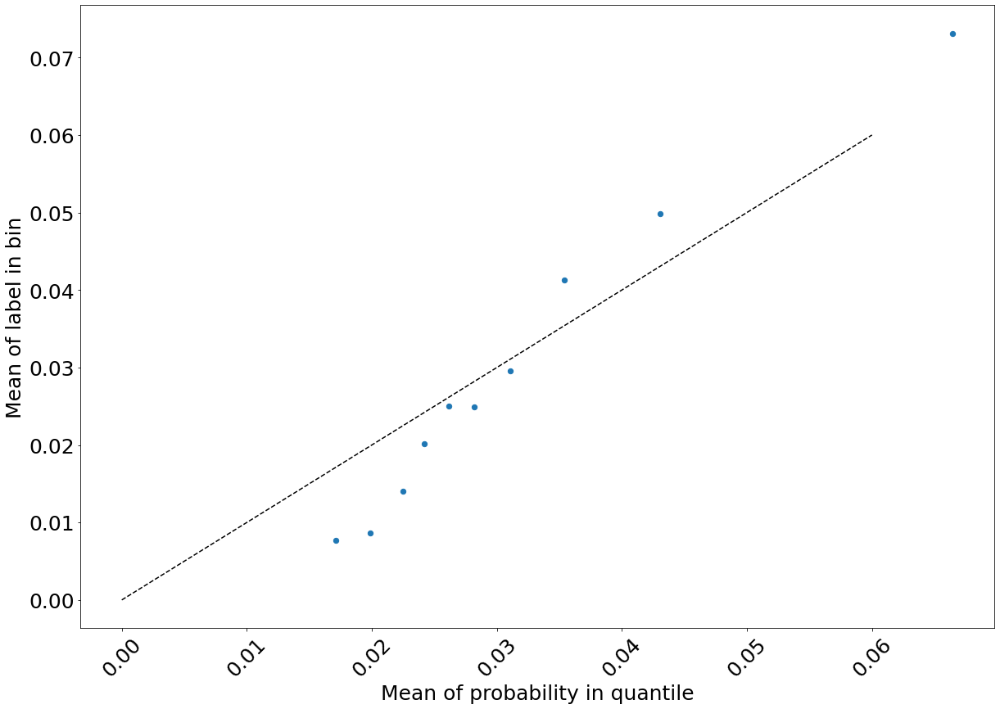

In [88]:
quantile_actual_predicted_dotted("XGBv14_best_estimator_classifier_ND.pkl", "XGB_calibration_plot.png", X_test, y_test_labeled, proba = np.array([]),  prob_thresh_low=0.0, prob_thresh_high=1.0)

## HGBT

In [92]:
def HGBT_classification_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    random_state = 42
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=random_state, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])

    model_HGBC = HistGradientBoostingClassifier(random_state=random_state)
    
    start = time.time()
    
    param_grid = {}
    param_grid['HGBTclassifier__learning_rate'] = [10, 5, 1, 0.1, 0.01]
    param_grid['HGBTclassifier__max_bins'] = [10, 20, 30, 40, 50, 75, 100]
    param_grid['HGBTclassifier__max_iter'] = [100, 500, 1000, 1500, 2000, 2500, 3000]
    param_grid['HGBTclassifier__min_samples_leaf'] = [2, 5, 10, 20, 30, 50, 100]
    param_grid['HGBTclassifier__max_leaf_nodes'] = [10, 20, 30, 40]
    param_grid['HGBTclassifier__max_depth'] = [None, 5, 10, 20]
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=9, sparse=False)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", StandardScaler(), numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), ("HGBTclassifier", model_HGBC)])

    hgbt_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    hgbt_search.fit(X_train, y_train)
    
    results = pd.DataFrame(hgbt_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(hgbt_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return hgbt_search

def HGBT_classification_specific(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    random_state = 42
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=random_state, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])

    model_HGBC = HistGradientBoostingClassifier(random_state=random_state)
    
    start = time.time()
    
    param_grid = {}
    param_grid['HGBTclassifier__learning_rate'] = [0.01]
    param_grid['HGBTclassifier__max_bins'] = [20]
    param_grid['HGBTclassifier__max_iter'] = [2000]
    param_grid['HGBTclassifier__min_samples_leaf'] = [5]
    param_grid['HGBTclassifier__max_leaf_nodes'] = [10]
    param_grid['HGBTclassifier__max_depth'] = [10]
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=9, sparse=False)

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", StandardScaler(), numeric),
            ("nominal", ohe, nominal)
        ])

    pipe = Pipeline(steps=[("encoding", encode_transform), ("HGBTclassifier", model_HGBC)])

    hgbt_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    hgbt_search.fit(X_train, y_train)
    
    results = pd.DataFrame(hgbt_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(hgbt_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return hgbt_search


In [221]:
hgbt_search = HGBT_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1250, scorer='roc_auc',
                          name_for_model="HGBTv1_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "HGBT classifier (HGBTv1_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits
Time elapsed (in Sec): 1054.9518978595734


In [171]:
hgbt_search = HGBT_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1250, scorer='roc_auc',
                          name_for_model="HGBTv2_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "HGBT classifier removed size_of_firm_bucket (HGBTv2_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits
Time elapsed (in Sec): 1166.975942850113


In [93]:
hgbt_search = HGBT_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1250, scorer='roc_auc',
                          name_for_model="HGBTv3_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "HGBT classifier removed size_of_firm_bucket + max_detailed_aop_name (HGBTv3_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 1250 candidates, totalling 3750 fits
Time elapsed (in Sec): 1111.7246551513672


## random forest

In [94]:
def RF_classification_experiment(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    RF_clf = RandomForestClassifier(n_jobs=6)
    
    start = time.time()
    
    param_grid = {
    'RF__n_estimators': [10, 50, 100, 500, 1000],
    'RF__max_depth': [2, 4, 6, 8, 10],
    'RF__min_samples_leaf': [2, 5, 10, 20, 30, 50, 100],
    'RF__max_features': ["sqrt", "log2", None],
    }
    
    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)
    
    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean")), ("scaler", StandardScaler())]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )

    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep
    
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal

    pipe = Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), ("encode", encode_transform), ("RF", RF_clf)])

    RF_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    RF_search.fit(X_train, y_train)
    
    results = pd.DataFrame(RF_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
            
    joblib.dump(RF_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return RF_search

In [95]:
RF_search = RF_classification_experiment(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=150, scorer='roc_auc',
                          name_for_model="RFv3_best_estimator_classifier_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "RF classifier after removing size_of_firm_bin + max_detailed_aop_name (RFv3_best_estimator_classifier_ND.pkl)")

Fitting 3 folds for each of 150 candidates, totalling 450 fits
Time elapsed (in Sec): 690.8118131160736


### permutation feature importances

In [104]:
# This is the best performing model 
with open("RFv2_best_estimator_classifier_ND.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

feature_names = best_clss_model.named_steps["encode"].transformers_[0][2]  + best_clss_model.named_steps["encode"].transformers_[1][2]

perm_rf = permutation_importance(best_clss_model, X_test.loc[:, feature_names], y_test_labeled, n_repeats = 50, scoring="roc_auc", n_jobs=-1)

KeyboardInterrupt: 

In [ ]:
top_x = 20
perm_idx_sorted = perm_rf.importances_mean.argsort()[::-1]
perm_importance_top = [ele[1] for ele in zip(np.array(perm_rf.importances_mean)[perm_idx_sorted], np.array(feature_names)[perm_idx_sorted]) if ele[0] > 0]
perm_top_x = [str(ele) for ele in list(np.array(feature_names)[perm_idx_sorted][0:top_x])]
print(list(perm_top_x))
print(list(perm_importance_top))
print(len(perm_importance_top))

In [ ]:
size=25
plt.barh(np.asarray(feature_names)[perm_idx_sorted][0:top_x][::-1], np.asarray(perm_xgb.importances_mean)[perm_idx_sorted][0:top_x][::-1], xerr= perm_xgb.importances_std[perm_idx_sorted][0:top_x][::-1], color='r')
plt.xlabel("Permutation feature importance", fontsize=size)
plt.xticks(size=size)
plt.yticks(size=size)
plt.savefig(os.getcwd() + os.sep+ 'Figures' + os.sep + "permutation_importance_XGB_classification.png", dpi=300, bbox_inches='tight')
plt.show()

In [281]:
preprocess_df[["experience_modification_factor", "schedule_modification_factor"]].value_counts()

experience_modification_factor  schedule_modification_factor
1.000                           1.0000                          6202
0.900                           0.9600                          1617
1.000                           0.9600                          1080
0.900                           1.0100                           761
                                1.0600                           641
                                                                ... 
1.000                           1.1660                             1
0.865                           0.7500                             1
1.000                           1.1590                             1
                                1.1567                             1
1.833                           0.8500                             1
Name: count, Length: 3209, dtype: int64

### SHAP importance

In [101]:
# This is the best performing model 
with open("RFv2_best_estimator_classifier_ND.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_clss_model = joblib.load(file)

X_shap = Pipeline(best_clss_model.steps[:-1]).transform(X_test)
pred = best_clss_model.named_steps["RF"].predict_proba(X_shap)[:, 1]
print(pred)
#explainer = shap.TreeExplainer(best_clss_model.named_steps["XGBoost"], X_shap, masker)
# explainer = shap.TreeExplainer(best_clss_model.named_steps["XGBoost"], 
#                                model_output="raw",
#                                feature_perturbation="tree_path_dependent")

explainer = shap.TreeExplainer(best_clss_model.named_steps["RF"], 
                               X_shap.astype(np.double), model_output="raw",
                               feature_perturbation="interventional")
shap_values = explainer.shap_values(X_shap, y_test_labeled)#, check_additivity=True)
np.abs(shap_values.sum(1) + explainer.expected_value - pred).max()

[0.08359244 0.12012823 0.09229667 ... 0.03390893 0.03271042 0.0558863 ]


100%|===================| 25700/25706 [15:33<00:00]        

ExplainerError: Additivity check failed in TreeExplainer! Please ensure the data matrix you passed to the explainer is the same shape that the model was trained on. If your data shape is correct then please report this on GitHub. This check failed because for one of the samples the sum of the SHAP values was 0.100940, while the model output was 0.099223. If this difference is acceptable you can set check_additivity=False to disable this check.

[[-0.02711006  0.03083604 -0.0005262  ...  0.          0.
   0.        ]
 [ 0.0059712   0.04927921 -0.00895063 ...  0.          0.
   0.        ]
 [ 0.00337467  0.02795659 -0.00294036 ...  0.          0.
   0.        ]
 ...
 [ 0.00388846  0.03117425 -0.00370053 ...  0.          0.
   0.        ]
 [ 0.00339282  0.03111662 -0.00536795 ...  0.          0.
   0.        ]
 [ 0.0009688   0.03353566 -0.0019299  ...  0.          0.
   0.        ]]
{0.0, 1.0}
{0.0}


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


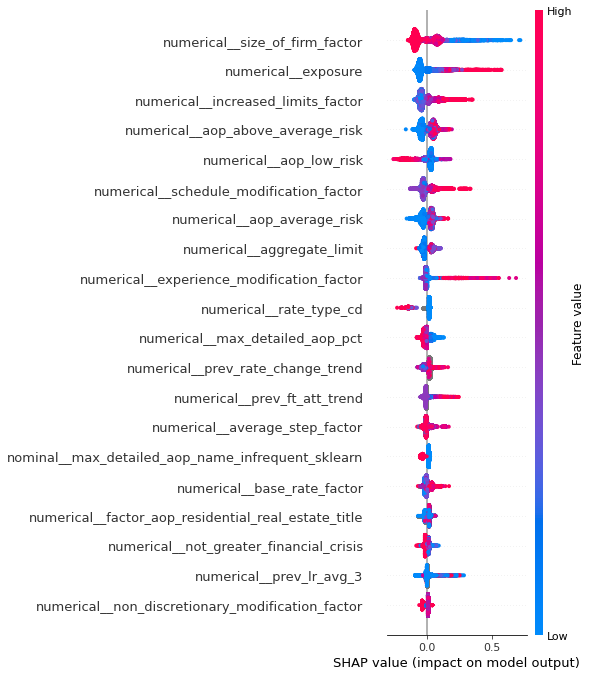

In [287]:
feature_names_encoded = best_clss_model.named_steps["encoding"].get_feature_names_out()
print(shap_values)
print(set(X_shap[:, -1]))
print(set(shap_values[:, -1]))
#print(feature_names_encoded)
shap.summary_plot(shap_values.astype(np.double), X_shap, max_display=20, feature_names = feature_names_encoded, show=False)
plt.savefig("SHAP_beeswarm_XGB.png", dpi=300, bbox_inches='tight')

Computing SHAP interaction values explicitly (will be necessary for dependence plots to pick which feature has the highest interaction)

In [113]:
explainer = shap.TreeExplainer(best_clss_model.named_steps["RF"], 
                               X_shap.astype(np.double))
shap_interaction_values = explainer.shap_interaction_values(X_shap[0:1000, :], y_test_labeled[0:1000])
print(X_shap[0:1000, :])
print(shap_interaction_values)
#shap.summary_plot(shap_interaction_values, X_shap[0:1000, :], max_display=6, feature_names = feature_names_encoded, show=False)

[[1.7806200542834292 0.7119041216737548 -2.390051603517864e-17 ... 0.0
  0.0 1.0]
 [1.7806200542834292 0.7119041216737548 -2.390051603517864e-17 ... 0.0
  0.0 1.0]
 [0.2865839907755703 0.049916006681309875 -2.390051603517864e-17 ... 0.0
  0.0 1.0]
 ...
 [-0.5849370462706808 -0.2810780508149126 -2.390051603517864e-17 ... 0.0
  0.0 0.0]
 [-0.6596388494460738 -0.325210591814409 -2.390051603517864e-17 ... 0.0
  0.0 0.0]
 [-0.6596388494460738 -0.325210591814409 -2.390051603517864e-17 ... 0.0
  0.0 0.0]]
[array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]

In [109]:
print(shap_interaction_values.shape)
print(type(shap_interaction_values))
print(shap_values.shape)

AttributeError: 'list' object has no attribute 'shape'

In [290]:
print(min(shap_interaction_values.ravel()))
print(max(shap_interaction_values.ravel()))

0.0
0.0


SHAP dependence plots of top 5 features (by permutation importance). Should explore any purported interactions in the data alone to verify it.

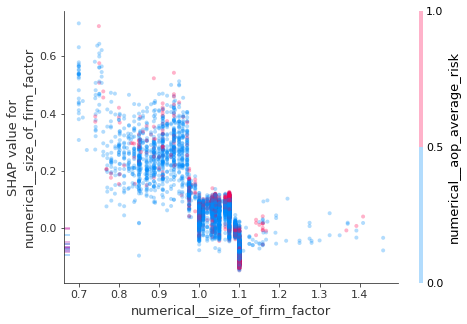

In [291]:
shap.dependence_plot("numerical__size_of_firm_factor", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=0, alpha = 0.3)

In [269]:
preprocess_df["extended_reporting_period_type"].value_counts()

extended_reporting_period_type
N     40491
04      575
01      274
03      132
02       44
05        7
Name: count, dtype: int64

KstestResult(statistic=0.3265347647469188, pvalue=8.399442770429263e-57)
set()
0.92339053203819
0.6832260299254223


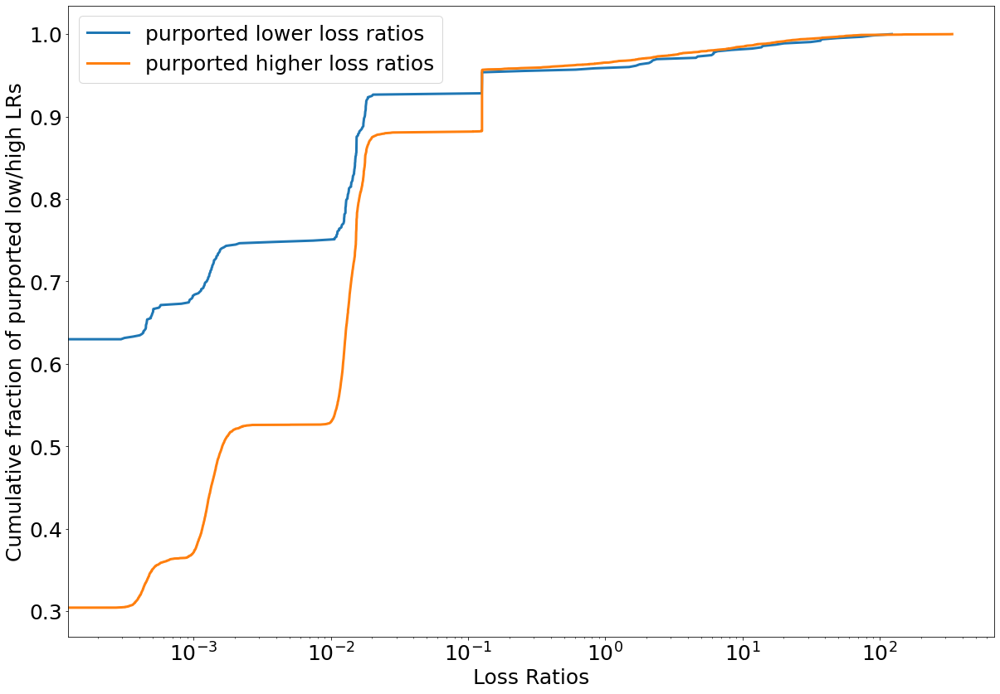

In [270]:
high_mask = (preprocess_df["size_of_firm_factor"] > 1) & (preprocess_df["size_of_firm_factor"] < 1.08) & (preprocess_df["extended_reporting_period_type"] == "N")
low_mask = (preprocess_df["size_of_firm_factor"] > 1) & (preprocess_df["size_of_firm_factor"] < 1.08) & (preprocess_df["extended_reporting_period_type"] != "N") 
purported_high = preprocess_df[high_mask]["ultimate_trended_onlevel_lr"]
purported_low = preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]

print(ks_2samp(purported_high, purported_low))
print(set(purported_high.index.values).intersection(set(purported_low.index.values)))
print(purported_low.mean())
print(purported_high.mean())

x_low, counts_low = np.unique(purported_low, return_counts=True)
cusum_low = np.cumsum(counts_low)

x_high, counts_high = np.unique(purported_high, return_counts=True)
cusum_high = np.cumsum(counts_high)

#print(cusum / cusum[-1])
fontsize=25
plt.plot(x_low, cusum_low/cusum_low[-1], color='#1f77b4', label='purported lower loss ratios', lw=3)
plt.plot(x_high, cusum_high/cusum_high[-1], color='#ff7f0e', label='purported higher loss ratios', lw=3)
plt.xscale('log')

plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of purported low/high LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)
#plt.savefig("classification_cusum_excludedretained_distributions.png", dpi=300, bbox_inches='tight')

plt.show()

^ This is a little bit intriguing. If it is true that a maximal interaction occurs between max_detailed_aop_family_law and exposure, then this suggests the red dots near 0.3 SHAP could easily be selectively removed by reducing exposure to policies with family law as a dominant AOP and low exposure. Furthermore, high exposures above 50 clearly produce a large jump in SHAP value. 

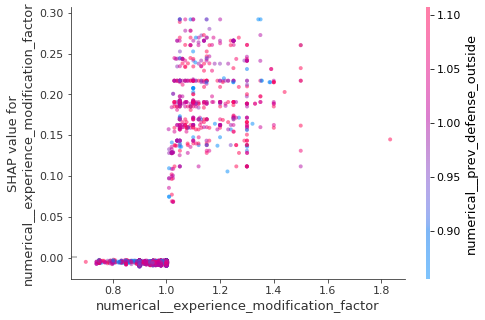

In [103]:
shap.dependence_plot("numerical__experience_modification_factor", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=1, alpha=0.5)

This suggests that policies with large exposures and high average risk do indeed produce larger loss ratios. Not particularly surprising.

<Figure size 432x288 with 0 Axes>

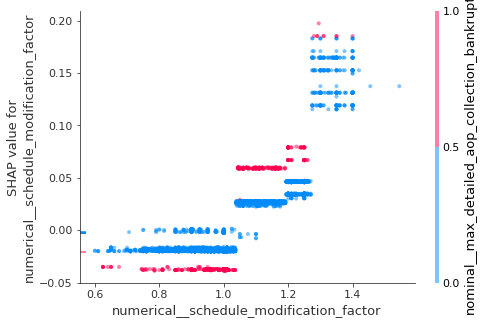

In [102]:
%matplotlib inline
plt.clf()
shap.dependence_plot("numerical__schedule_modification_factor", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=0, alpha=0.5)

Takeaway 1: Businesses with higher experience modification factors would be expected to carry more risk. Interestingly, a hotspot exists for experience modification factors below 0.9 and for high aggregate limits. This is contrast to businesses with a mixture of limits for experience modification factors from 0.9 to 1.0.

aggregate_limit
10000000.0    298
5000000.0     126
1000000.0      61
2000000.0      54
15000000.0     36
3000000.0      28
8000000.0      20
4000000.0      20
500000.0       18
7000000.0      17
6000000.0      14
20000000.0      7
300000.0        2
7500000.0       2
Name: count, dtype: int64
aggregate_limit
1000000.0     3314
2000000.0     2289
500000.0       978
300000.0       693
5000000.0      617
4000000.0      512
3000000.0      405
10000000.0     264
250000.0        70
7000000.0       56
6000000.0       46
1500000.0       31
8000000.0       26
600000.0        23
750000.0         9
15000000.0       4
9000000.0        2
20000000.0       1
Name: count, dtype: int64
set()
0.6742983851961505
0.6528541441393998


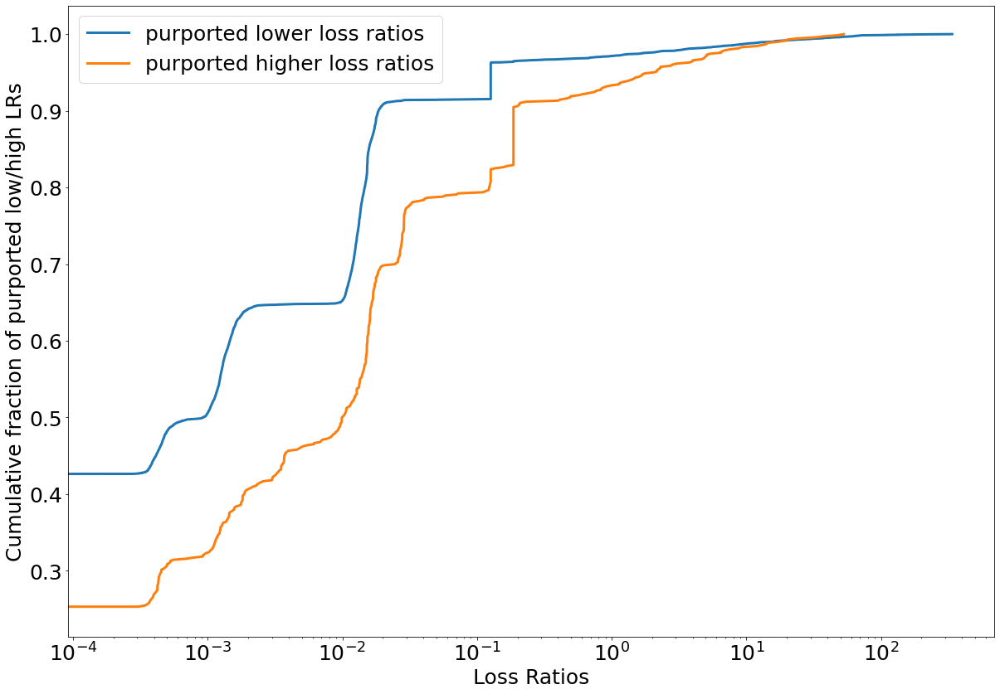

In [151]:
high_mask = (preprocess_df["experience_modification_factor"] < 0.9) #& (preprocess_df["aggregate_limit"] > 5*10**6)
low_mask = (preprocess_df["experience_modification_factor"] > 0.9) & (preprocess_df["experience_modification_factor"] < 1.0)
purported_high = preprocess_df[high_mask]["ultimate_trended_onlevel_lr"]
purported_low = preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]

print(preprocess_df[high_mask]["aggregate_limit"].value_counts())
print(preprocess_df[low_mask]["aggregate_limit"].value_counts())
print(set(purported_high.index.values).intersection(set(purported_low.index.values)))
print(purported_low.mean())
print(purported_high.mean())

x_low, counts_low = np.unique(purported_low, return_counts=True)
cusum_low = np.cumsum(counts_low)

x_high, counts_high = np.unique(purported_high, return_counts=True)
cusum_high = np.cumsum(counts_high)

#print(cusum / cusum[-1])
fontsize=25
plt.plot(x_low, cusum_low/cusum_low[-1], color='#1f77b4', label='purported lower loss ratios', lw=3)
plt.plot(x_high, cusum_high/cusum_high[-1], color='#ff7f0e', label='purported higher loss ratios', lw=3)
plt.xscale('log')

plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of purported low/high LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)
#plt.savefig("classification_cusum_excludedretained_distributions.png", dpi=300, bbox_inches='tight')

plt.show()

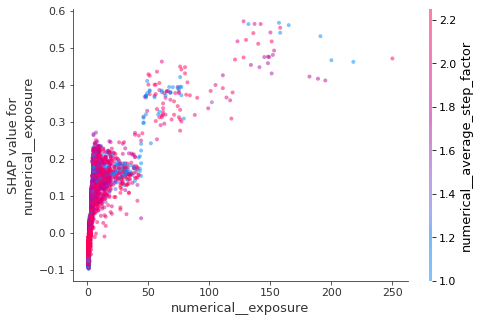

In [294]:
shap.dependence_plot("numerical__exposure", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=0, alpha=0.5)

set()
0.5756215839112319
1.3484310336534946


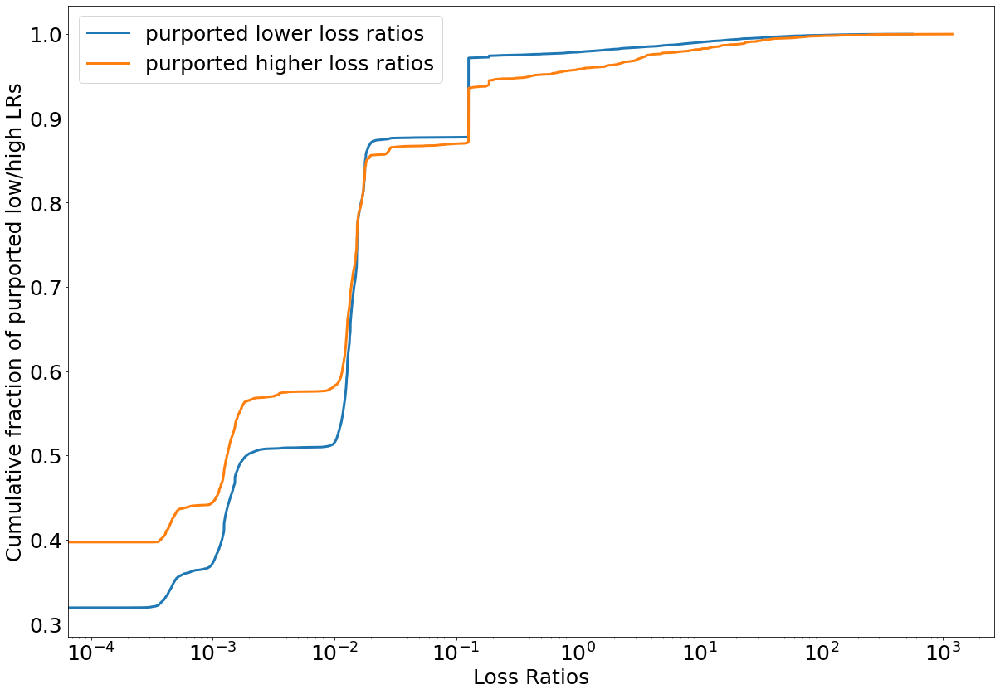

In [159]:
high_mask = (preprocess_df["max_detailed_aop_pct"] < 30) 
low_mask = (preprocess_df["max_detailed_aop_pct"] > 55) 
purported_high = preprocess_df[high_mask]["ultimate_trended_onlevel_lr"]
purported_low = preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]

print(set(purported_high.index.values).intersection(set(purported_low.index.values)))
print(purported_low.mean())
print(purported_high.mean())

x_low, counts_low = np.unique(purported_low, return_counts=True)
cusum_low = np.cumsum(counts_low)

x_high, counts_high = np.unique(purported_high, return_counts=True)
cusum_high = np.cumsum(counts_high)

#print(cusum / cusum[-1])
fontsize=25
plt.plot(x_low, cusum_low/cusum_low[-1], color='#1f77b4', label='purported lower loss ratios', lw=3)
plt.plot(x_high, cusum_high/cusum_high[-1], color='#ff7f0e', label='purported higher loss ratios', lw=3)
plt.xscale('log')

plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of purported low/high LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)
#plt.savefig("classification_cusum_excludedretained_distributions.png", dpi=300, bbox_inches='tight')

plt.show()

set()
0.20018934931157317
0.5930669219984094


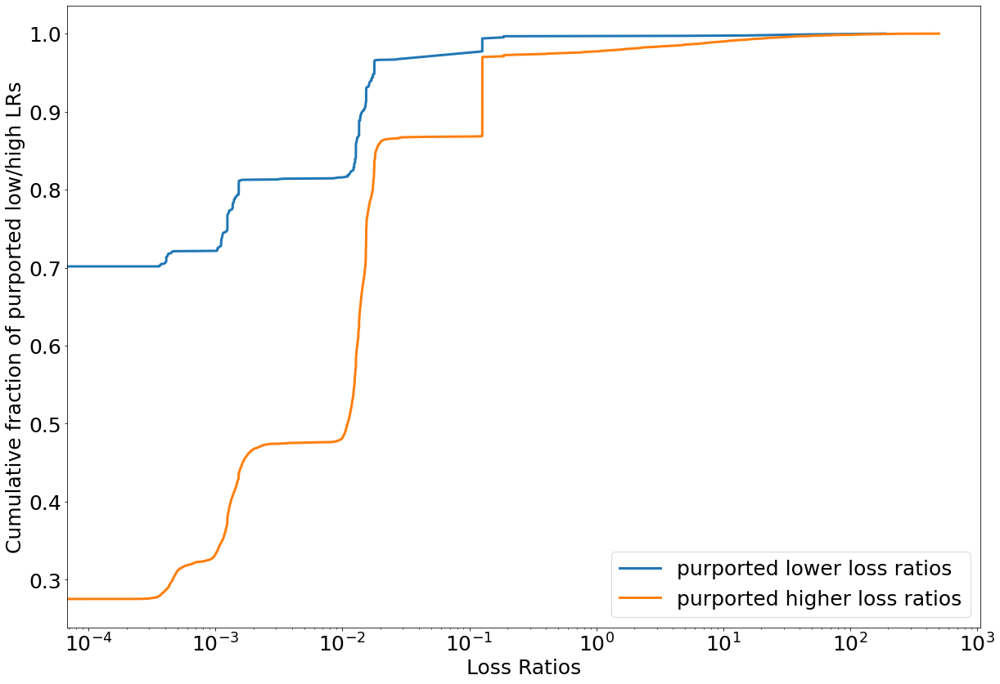

In [160]:
high_mask = (preprocess_df["max_detailed_aop_pct"] > 60) & (preprocess_df["policy_type"] == "STD")
low_mask = (preprocess_df["max_detailed_aop_pct"] > 60) & (preprocess_df["policy_type"] != "STD")
purported_high = preprocess_df[high_mask]["ultimate_trended_onlevel_lr"]
purported_low = preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]

print(set(purported_high.index.values).intersection(set(purported_low.index.values)))
print(purported_low.mean())
print(purported_high.mean())

x_low, counts_low = np.unique(purported_low, return_counts=True)
cusum_low = np.cumsum(counts_low)

x_high, counts_high = np.unique(purported_high, return_counts=True)
cusum_high = np.cumsum(counts_high)

#print(cusum / cusum[-1])
fontsize=25
plt.plot(x_low, cusum_low/cusum_low[-1], color='#1f77b4', label='purported lower loss ratios', lw=3)
plt.plot(x_high, cusum_high/cusum_high[-1], color='#ff7f0e', label='purported higher loss ratios', lw=3)
plt.xscale('log')

plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of purported low/high LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)
#plt.savefig("classification_cusum_excludedretained_distributions.png", dpi=300, bbox_inches='tight')

plt.show()

^ This is counter-intuitive. Lower max detailed aops, meaning higher diversity policies, tend to have higher upper limits of SHAP values. Should test whether or not this is true within the data.

In [295]:
preprocess_df["aop_above_average_risk"].value_counts()

aop_above_average_risk
0.0000    12672
1.0000     2542
0.0500     1582
0.1000     1571
0.5000     1251
          ...  
0.5775        1
0.2330        1
0.1360        1
0.1610        1
0.3411        1
Name: count, Length: 897, dtype: int64

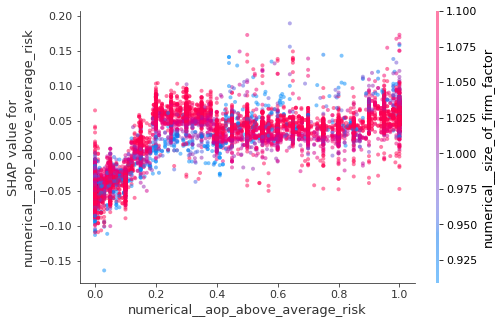

In [296]:
shap.dependence_plot("numerical__aop_above_average_risk", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=1, alpha=0.5)

^ Interesting. This suggests that a high schedule modification factor coupled with being a small firm, in bucket A:1, yields a higher probability of being a bad loss ratio. Seeing cancellation, most likely with exposure.

set()
0.9899658271128539
0.6482106427055796


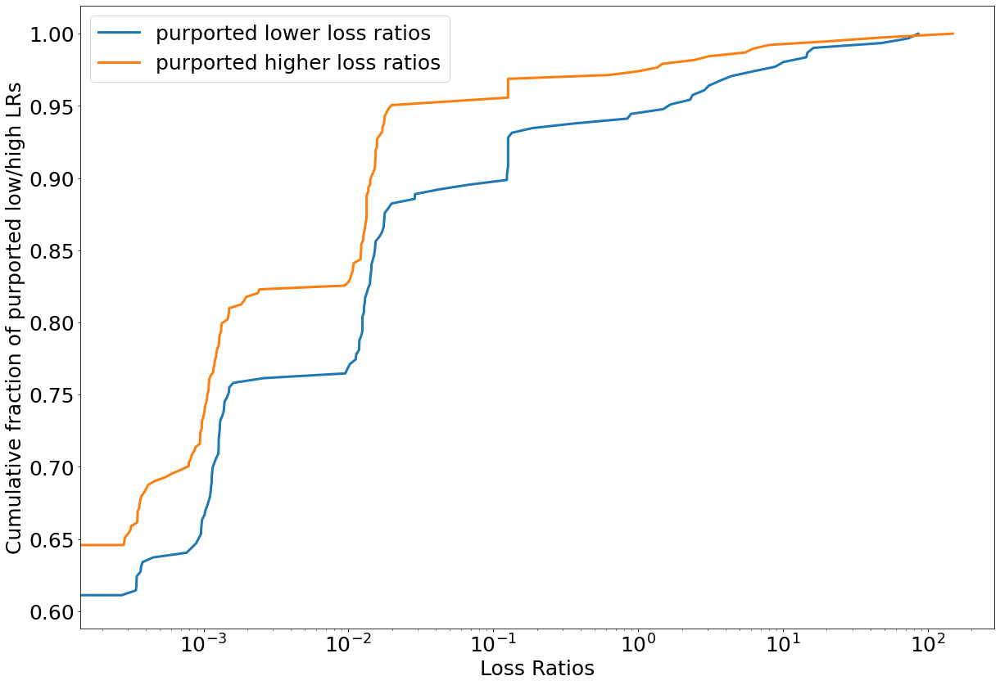

In [165]:
high_mask = (preprocess_df["schedule_modification_factor"] > 1.3) & (preprocess_df["size_of_firm_bucket"] == "A:1")
low_mask = (preprocess_df["schedule_modification_factor"] > 1.3) & (preprocess_df["size_of_firm_bucket"] != "A:1")
purported_high = preprocess_df[high_mask]["ultimate_trended_onlevel_lr"]
purported_low = preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]

print(set(purported_high.index.values).intersection(set(purported_low.index.values)))
print(purported_low.mean())
print(purported_high.mean())

x_low, counts_low = np.unique(purported_low, return_counts=True)
cusum_low = np.cumsum(counts_low)

x_high, counts_high = np.unique(purported_high, return_counts=True)
cusum_high = np.cumsum(counts_high)

#print(cusum / cusum[-1])
fontsize=25
plt.plot(x_low, cusum_low/cusum_low[-1], color='#1f77b4', label='purported lower loss ratios', lw=3)
plt.plot(x_high, cusum_high/cusum_high[-1], color='#ff7f0e', label='purported higher loss ratios', lw=3)
plt.xscale('log')

plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of purported low/high LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)
#plt.savefig("classification_cusum_excludedretained_distributions.png", dpi=300, bbox_inches='tight')

plt.show()

In [297]:
preprocess_df["high_risk_indicator"].value_counts()

high_risk_indicator
Y    25996
N    16848
Name: count, dtype: int64

In [299]:
[ele for ele in feature_names_encoded if "nominal" in ele]

['nominal__low_focus_risk_indicator_N',
 'nominal__low_focus_risk_indicator_Y',
 'nominal__pa_other_states_Other States',
 'nominal__pa_other_states_PA',
 'nominal__dominat_aop_group_Average',
 'nominal__dominat_aop_group_Avobe',
 'nominal__dominat_aop_group_Below',
 'nominal__dominat_aop_group_High',
 'nominal__dominat_aop_group_Low',
 'nominal__max_detailed_aop_collection_bankruptcy',
 'nominal__max_detailed_aop_commercial_and_business_litigation_defense',
 'nominal__max_detailed_aop_corporate_and_business_organization',
 'nominal__max_detailed_aop_criminal',
 'nominal__max_detailed_aop_estate_probate_trust',
 'nominal__max_detailed_aop_family_law',
 'nominal__max_detailed_aop_personal_injury_and_negligence_defense',
 'nominal__max_detailed_aop_personal_injury_and_negligence_plaintiff',
 'nominal__max_detailed_aop_real_estate_residential',
 'nominal__max_detailed_aop_infrequent_sklearn',
 'nominal__producer_external_Brown & Brown',
 'nominal__producer_external_Gallagher',
 'nominal__

In [100]:
shap.dependence_plot("nominal__high_risk_indicator_Y", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=1, alpha=0.5)

^ Again interesting. A small firm coupled with an extended reporting period indicator is more likely to produce a bad loss ratio. This inverts to the expected behaviour when there is no extended reporting period indicator; meaning that a small firm yields a smaller LR.

In [301]:
shap.dependence_plot("nominal__max_detailed_aop_name", shap_values.astype(np.double), X_shap, feature_names=feature_names_encoded, x_jitter=1, alpha=0.5)

ValueError: Could not find feature named: nominal__max_detailed_aop_name

# Frequency-severity approach

Here the thinking is, if we have enough data in the tail of the distribution (beyond 0.57 LR), try to train a regressor just on this portion of the distribution to see if it is possible. I will start with Tweedie because it is quite general:

In [91]:
y_train.index

Int64Index([    1,     3,     4,     7,     8,     9,    11,    12,    13,
               14,
            ...
            42833, 42835, 42836, 42837, 42838, 42839, 42840, 42841, 42842,
            42843],
           dtype='int64', length=29991)

In [149]:
y_bad_index = y_train[y_train > 0.57].index
y_bad = y_train[y_train > 0.57]
X_bad_lr = X_train.loc[y_bad_index]

In [152]:
tweedie_severity_srch = tweedie_experiment(train_df.loc[y_bad_index], X_bad_lr, y_bad, feature_subset = [], n_iterations=200, 
                          name_for_model="tweedie_severity_best_estimator.pkl", name_for_results="severity.csv",
                          description = "tweedie_severity model (tweedie_severity_best_estimator.pkl)")

Fitting 3 folds for each of 200 candidates, totalling 600 fits


One or more of the test scores are non-finite: [-1.18613026e+50 -3.86980128e+17             nan -3.72543789e+03
 -7.70761513e+55 -1.43388609e+38 -3.93546463e+31 -8.08154663e+44
 -1.13159510e+33 -1.13159510e+33 -1.75745235e+05 -1.68465356e+07
 -9.29079493e+44 -2.59383187e+38 -3.59063891e+07 -1.04938907e+54
 -4.11384660e+39             nan             nan -6.33435302e+01
 -7.63184824e+33 -7.48266319e+56             nan -5.67297541e+01
 -5.68778020e+01             nan -2.41341792e+02 -1.25543881e+13
 -2.86371546e+42 -4.59186672e+46 -5.02153054e+38 -1.44604757e+43
             nan -4.29729550e+33 -7.53416382e+58             nan
 -1.67306630e+55 -5.68778020e+01 -1.01946075e+56 -1.44849858e+43
             nan -1.13159510e+33 -5.56436524e+44 -1.92947124e+37
 -2.97427327e+28 -1.42621207e+57 -1.81198853e+46 -4.24194842e+03
 -1.07079847e+51 -6.33435302e+01 -5.67297541e+01 -8.00377515e+23
 -2.59383187e+38 -5.56436524e+44 -2.20171939e+41             nan
 -5.68709016e+01 -1.15635382e+57 -3.1263847

Time elapsed (in Sec): 131.73423767089844


In [154]:
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
        # Call load method to deserialze
        freq_model = joblib.load(file)

with open("tweedie_severity_best_estimator.pkl", 'rb') as file:
        # Call load method to deserialze
        sev_model = joblib.load(file)
        
# with open("XGBv1_best_estimator_newpreprocessing_notruncation.pkl", 'rb') as file:
#     reg_model = joblib.load(file)
        
dataset_X = X_test
dataset_y = y_test
freq_predictions = freq_model.predict_proba(dataset_X)[:, 1]
sev_predictions = sev_model.predict(dataset_X)
# reg_predictions = reg_model.predict(dataset_X)

freq_sev_test_predictions = np.multiply(freq_predictions, sev_predictions)
print(mean_squared_error(dataset_y, freq_sev_test_predictions, squared=False))

tweedie_prediction = sev_model.predict(dataset_X)
print(mean_squared_error(dataset_y, tweedie_prediction, squared=False))

15.805841319519272
34.28620722342172


[(0.792, 0.888], (1.124, 3.774], (0.792, 0.888], (0.792, 0.888], (0.792, 0.888], ..., (0.888, 1.124], (-0.0009999999999999979, 0.548], (0.689, 0.734], (0.888, 1.124], (0.792, 0.888]]
Length: 12853
Categories (10, interval[float64, right]): [(-0.0009999999999999979, 0.548] < (0.548, 0.59] < (0.59, 0.621] < (0.621, 0.654] ... (0.734, 0.792] < (0.792, 0.888] < (0.888, 1.124] < (1.124, 3.774]]
['(-0.0009999999999999979, 0.548]', '(0.548, 0.59]', '(0.59, 0.621]', '(0.621, 0.654]', '(0.654, 0.689]', '(0.689, 0.734]', '(0.734, 0.792]', '(0.792, 0.888]', '(0.888, 1.124]', '(1.124, 3.774]']


([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 [Text(0, 0, '(-0.0009999999999999979, 0.548]'),
  Text(1, 0, '(0.548, 0.59]'),
  Text(2, 0, '(0.59, 0.621]'),
  Text(3, 0, '(0.621, 0.654]'),
  Text(4, 0, '(0.654, 0.689]'),
  Text(5, 0, '(0.689, 0.734]'),
  Text(6, 0, '(0.734, 0.792]'),
  Text(7, 0, '(0.792, 0.888]'),
  Text(8, 0, '(0.888, 1.124]'),
  Text(9, 0, '(1.124, 3.774]')])

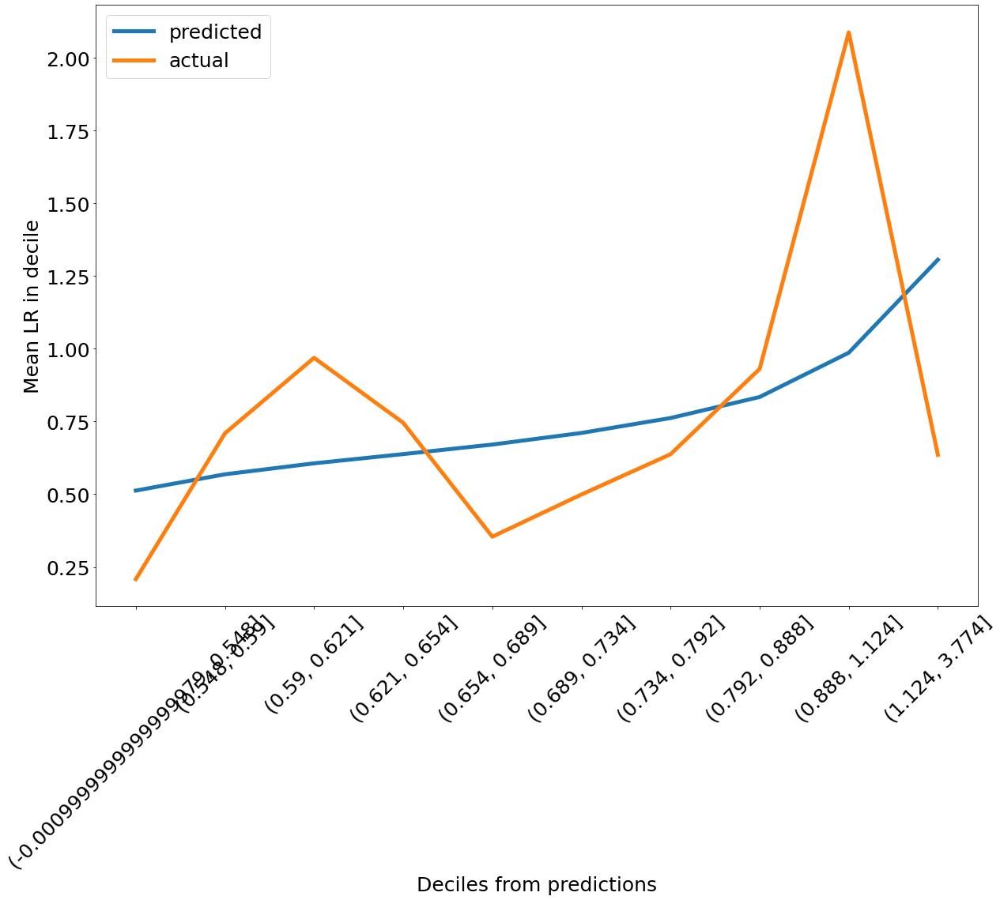

In [156]:
quantiles = pd.qcut(freq_sev_test_predictions, 10, duplicates='drop')
print(quantiles)
qq_df = pd.DataFrame(index = quantiles, data= {"predicted": freq_sev_test_predictions, "actual": y_test.values})
grouped = qq_df.groupby(level=0).mean().sort_index()

fontsize=25
print([str(ele) for ele in grouped.index])
plt.plot([str(ele) for ele in grouped.index.values], grouped["predicted"], label='predicted', lw=5)
plt.plot([str(ele) for ele in grouped.index.values], grouped["actual"], label='actual', lw=5)
#plt.scatter(grouped["predicted"], grouped["actual"], s=40)
#plt.plot(np.arange(0, max(grouped["actual"]), 0.1), np.arange(0, max(grouped["actual"]), 0.1), ls='--', c='k')
plt.ylabel("Mean LR in decile", fontsize= fontsize)
plt.xlabel("Deciles from predictions", fontsize = fontsize)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
plt.legend(fontsize=fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)
#plt.savefig(savename, dpi=300, bbox_inches='tight')

# financial impact of using the best regressor vs. classifier

In [91]:
X_train_impact = preprocess_df_incl_lossnpremium.iloc[train_idx]
X_test_impact = preprocess_df_incl_lossnpremium.iloc[test_idx]

In [226]:
def compute_ideal_impact(X_allfeatures, y):
    
    # computing indicies to remove for certain percentiles
    percentiles = [100, 99.5, 99.0, 98, 95, 90, 80, 70]

    y_historical = y.reset_index(drop=True)
    idx_keep_historical = {k:[i for i in range(len(y_historical)) if y_historical[i] <= np.percentile(y_historical, k)] for k in percentiles}
    
    # computing aggregate loss ratios and premiums at a portfolio level resulting after policy removals
    
    lrs_ideal_historical = {k: np.sum(X_allfeatures["ultimate_loss_trended"].reset_index(level=0, drop=True)[idx_keep_historical[k]])\
                                        /np.sum(X_allfeatures["onlevel_premium"].reset_index(level=0, drop=True)[idx_keep_historical[k]]) for k in percentiles}

    return lrs_ideal_historical

def compute_ideal_impact_smallrange(X_allfeatures, y):
    
    # computing indicies to remove for certain percentiles
    percentiles = [100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0]

    y_historical = y.reset_index(drop=True)
    idx_keep_historical = {k:[i for i in range(len(y_historical)) if y_historical[i] <= np.percentile(y_historical, k)] for k in percentiles}
    
    # computing aggregate loss ratios and premiums at a portfolio level resulting after policy removals
    
    lrs_ideal_historical = {k: np.sum(X_allfeatures["ultimate_loss_trended"].reset_index(level=0, drop=True)[idx_keep_historical[k]])\
                                        /np.sum(X_allfeatures["onlevel_premium"].reset_index(level=0, drop=True)[idx_keep_historical[k]]) for k in percentiles}

    return lrs_ideal_historical

def evaluate_financial_impact(mdl_file, df_for_splitting, X_model, X_allfeatures, y, CV=True, classifier=False, fontsize=25):
    
    with open(mdl_file, 'rb') as file:
        model = joblib.load(file)
    if CV:
        zero_nonzero_indicator = y.apply(lambda row: 1 if row > 0 else 0)

        if classifier:
             # classification
            gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
            splitter_cv = gkf_cv.split(df_for_splitting, zero_nonzero_indicator, groups=df_for_splitting['policy_id'])

            y_pred = cross_val_predict(model, X_model, y, cv = splitter_cv, method='predict_proba')[:, 1]
        else:

            # regression
            gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
            splitter_cv = gkf_cv.split(df_for_splitting, zero_nonzero_indicator, groups=df_for_splitting['policy_id'])
            y_pred = cross_val_predict(model, X_model, y, cv = splitter_cv)
            
    else:
        if classifier:
            
            y_pred = model.predict_proba(X_model)[:, 1]
        else:
            
            y_pred = model.predict(X_model)
        
    # computing indicies to remove for certain percentiles
    percentiles = [100, 99.5, 99.0, 98, 95, 90, 80, 70]
    
    idx_keep = {k:[i for i in range(len(y_pred)) if y_pred[i] <= np.percentile(y_pred, k)] for k in percentiles}
    print(len(y_pred))
    print([key for key in idx_keep.keys()], [len(y_pred) - len(idx_keep[key]) for key in idx_keep.keys()])
    # computing aggregate loss ratios and premiums at a portfolio level resulting after policy removals
    lrs_after_removal_agg = {k: np.sum(X_allfeatures["ultimate_loss_trended"].reset_index(level=0, drop=True)[idx_keep[k]])\
                                        /np.sum(X_allfeatures["onlevel_premium"].reset_index(level=0, drop=True)[idx_keep[k]]) for k in percentiles}
    
    print(lrs_after_removal_agg)

    return lrs_after_removal_agg

def evaluate_financial_impact_smallrange(mdl_file, df_for_splitting, X_model, X_allfeatures, y, CV=True, classifier=False, fontsize=25):
    
    with open(mdl_file, 'rb') as file:
        model = joblib.load(file)
    if CV:
        zero_nonzero_indicator = y.apply(lambda row: 1 if row > 0 else 0)

        if classifier:
             # classification
            gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
            splitter_cv = gkf_cv.split(df_for_splitting, zero_nonzero_indicator, groups=df_for_splitting['policy_id'])

            y_pred = cross_val_predict(model, X_model, y, cv = splitter_cv, method='predict_proba')[:, 1]
        else:

            # regression
            gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
            splitter_cv = gkf_cv.split(df_for_splitting, zero_nonzero_indicator, groups=df_for_splitting['policy_id'])
            y_pred = cross_val_predict(model, X_model, y, cv = splitter_cv)
            
    else:
        if classifier:
            
            y_pred = model.predict_proba(X_model)[:, 1]
        else:
            
            y_pred = model.predict(X_model)
        
    # computing indicies to remove for certain percentiles
    percentiles = [100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0]
    
    idx_keep = {k:[i for i in range(len(y_pred)) if y_pred[i] <= np.percentile(y_pred, k)] for k in percentiles}
    print(len(y_pred))
    print([key for key in idx_keep.keys()], [len(y_pred) - len(idx_keep[key]) for key in idx_keep.keys()])
    # computing aggregate loss ratios and premiums at a portfolio level resulting after policy removals
    lrs_after_removal_agg = {k: np.sum(X_allfeatures["ultimate_loss_trended"].reset_index(level=0, drop=True)[idx_keep[k]])\
                                        /np.sum(X_allfeatures["onlevel_premium"].reset_index(level=0, drop=True)[idx_keep[k]]) for k in percentiles}
    
    print(lrs_after_removal_agg)

    return lrs_after_removal_agg

def evaluate_financial_impact_freqsev(freq_file, sev_file, df_for_splitting, X_model, X_allfeatures, y, y_binary):
    
    with open(freq_file, 'rb') as file:
        # Call load method to deserialze
        freq_model = joblib.load(file)

    with open(sev_file, 'rb') as file:
        # Call load method to deserialze
        sev_model = joblib.load(file)

    zero_nonzero_indicator = y.apply(lambda row: 1 if row > 0 else 0)
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state = 42, n_splits=3)
    splitter_cv = gkf_cv.split(df_for_splitting, zero_nonzero_indicator, groups=df_for_splitting['policy_id'])
    
    # my own CV predict
    y_pred_output = []
    test_indicies_output = []
    for i in range(3):
        
        train_indicies, test_indicies = next(splitter_cv)
        test_indicies_output.extend(test_indicies)
        
        # train splits
        X_split_train = X_model.iloc[train_indicies]
        y_split_train = y.iloc[train_indicies]
        y_split_labeled_train = y_binary.iloc[train_indicies]
        
        # incorporate filtering for training severity model
        y_bad_index = y_split_train[y_split_train > 0.57].index
        
        # test splits
        X_split_test = X_model.iloc[test_indicies]
        
        # fitting models in splits
        freq_model_split = freq_model.fit(X_split_train, y_split_labeled_train)
        sev_model_split = sev_model.fit(X_split_train.loc[y_bad_index], y_split_train.loc[y_bad_index])
        
        # predictions
        freq_pred = freq_model_split.predict_proba(X_split_test)[:, 1]
        sev_pred = sev_model.predict(X_split_test)
    
        y_pred = np.multiply(freq_pred, sev_pred)
        y_pred_output.extend(y_pred)
        
    y_pred = np.array(y_pred_output)[np.argsort(test_indicies_output)]
    
    # computing indicies to remove for certain percentiles
    percentiles = [100, 99.5, 99.0, 98, 95, 90, 80, 70]
    
    idx_keep = {k:[i for i in range(len(y_pred)) if y_pred[i] <= np.percentile(y_pred, k)] for k in percentiles}

    # computing aggregate loss ratios and premiums at a portfolio level resulting after policy removals
    lrs_after_removal_agg = {k: np.sum(X_allfeatures["ultimate_loss_trended"].reset_index(level=0, drop=True)[idx_keep[k]])\
                                        /np.sum(X_allfeatures["onlevel_premium"].reset_index(level=0, drop=True)[idx_keep[k]]) for k in percentiles}
    
    print(lrs_after_removal_agg)

    return lrs_after_removal_agg

In [ ]:
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
        # Call load method to deserialze
        freq_model = joblib.load(file)

with open("tweedie_severity_best_estimator.pkl",

In [159]:
reg_freqsev = evaluate_financial_impact_freqsev("XGBv14_best_estimator_classifier_ND.pkl", "tweedie_severity_best_estimator.pkl", train_df, X_train, X_train_impact, y_train, y_train_labeled)

overflow encountered in exp
invalid value encountered in subtract


{100: nan, 99.5: 0.7302411359812017, 99.0: 0.7303318422615366, 98: 0.7312658125862985, 95: 0.7393746193482945, 90: 0.7112231087224086, 80: 0.7360664413093082, 70: 0.7031535228897602}


invalid value encountered in double_scalars


In [163]:
clss_1 = evaluate_financial_impact("LRv6_best_estimator_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

ValueError: A given column is not a column of the dataframe

In [89]:
reg_hgbt = evaluate_financial_impact("HGBTv3_best_estimator_newpreprocessing_notruncation.pkl", 
                          train_df, X_train, X_train_impact, y_train, CV=True, classifier=False)

29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 298, 508, 751, 2726, 2726, 2726]
{100: 0.7250759420836478, 99.5: 0.7138298957335275, 99.0: 0.6937037142652419, 98: 0.6983212562764916, 95: 0.7020299730035842, 90: 0.6982711579505598, 80: 0.6982711579505598, 70: 0.6982711579505598}


In [90]:
reg_xgb = evaluate_financial_impact("XGBv11_best_estimator_newpreprocessing_notruncation.pkl", 
                          train_df, X_train, X_train_impact, y_train, CV=True, classifier=False)

29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 291, 597, 1500, 2996, 5971, 8174]
{100: 0.7250759420836478, 99.5: 0.7218500553468702, 99.0: 0.7251745656451027, 98: 0.7103333726010118, 95: 0.6910625189537561, 90: 0.7093232499951175, 80: 0.7364648747790055, 70: 0.7005889808979479}


In [91]:
reg_tweedie = evaluate_financial_impact("tweediev2_best_estimator.pkl", 
                          train_df, X_train, X_train_impact, y_train, CV=True, classifier=False)

29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 300, 600, 1500, 2999, 5998, 8997]
{100: 0.7250759420836478, 99.5: 0.7234293060620769, 99.0: 0.7239013429487553, 98: 0.7249231216081832, 95: 0.7099812595103239, 90: 0.708377271258272, 80: 0.7043031804183102, 70: 0.718075413868335}


In [92]:
baseline_historical = compute_ideal_impact(X_train_impact, y_train)

[100, 99.5, 99.0, 98, 95, 90, 80, 70]
[0.7250759420836478, 0.7138298957335275, 0.6937037142652419, 0.6983212562764916, 0.7020299730035842, 0.6982711579505598, 0.6982711579505598, 0.6982711579505598]
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0.7250759420836478, 0.7106318413814502, 0.697375576737911, 0.6750351215387634, 0.6189455120882265, 0.5735182983005347, 0.5620385809557374, 0.5415642859050305]


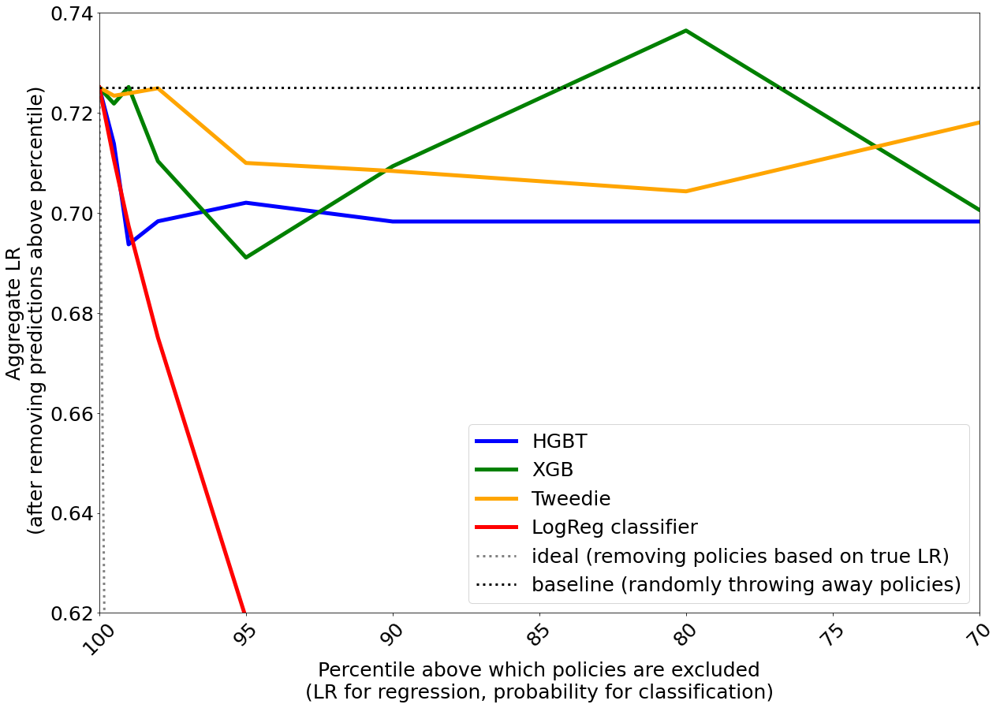

In [93]:
fontsize=25
print([key for key in reg_hgbt.keys()])
print([reg_hgbt[key] for key in reg_hgbt.keys()])
plt.plot([key for key in reg_hgbt.keys()], [reg_hgbt[key] for key in reg_hgbt.keys()], lw=5, c='b', label='HGBT')
plt.plot([key for key in reg_xgb.keys()], [reg_xgb[key] for key in reg_xgb.keys()], lw=5, c='g', label='XGB')
plt.plot([key for key in reg_xgb.keys()], [reg_tweedie[key] for key in reg_tweedie.keys()], lw=5, c='orange', label='Tweedie')
plt.plot([key for key in clss_1.keys()], [clss_1[key] for key in clss_1.keys()], lw=5, c='r', label='LogReg classifier')

print([key for key in clss_1.keys()], [clss_1[key] for key in clss_1.keys()])
# baselines
plt.plot([key for key in baseline_historical.keys()], [baseline_historical[key] for key in baseline_historical.keys()], lw=3, c='gray', ls=':', label='ideal (removing policies based on true LR)')
plt.plot([key for key in reg_xgb.keys()], len([key for key in reg_xgb.keys()]) * [reg_xgb[100]], lw=3, c='k', ls=':', label='baseline (randomly throwing away policies)')

plt.ylabel("Aggregate LR\n (after removing predictions above percentile)", fontsize= fontsize)
plt.xlabel("Percentile above which policies are excluded\n(LR for regression, probability for classification)", fontsize = fontsize)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
plt.legend(fontsize=fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)
plt.xlim(100, 70)
plt.ylim(0.62, 0.74)
plt.savefig("LR_impact_portfoliolevel_regression_classification_updatedLR.png", dpi=300, bbox_inches='tight')
plt.show()

for classifiers:

In [114]:
clss_logistic = evaluate_financial_impact("LRv9_best_estimator_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

The max_iter was reached which means the coef_ did not converge


29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 300, 600, 1500, 2999, 5998, 8997]
{100: 0.7250759420836478, 99.5: 0.7155540436097596, 99.0: 0.7309797356396693, 98: 0.646509508133917, 95: 0.6432571492316435, 90: 0.606316104114397, 80: 0.5688422372223793, 70: 0.5683240624954649}


In [115]:
clss_xgb = evaluate_financial_impact("XGBv14_best_estimator_classifier_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.


29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 300, 600, 1500, 2999, 5998, 8997]
{100: 0.7250759420836478, 99.5: 0.7088471467645681, 99.0: 0.7055977056145145, 98: 0.7177824371146804, 95: 0.6833336715936505, 90: 0.6911910519505131, 80: 0.6966881208439908, 70: 0.7126504721276941}


In [116]:
clss_hgb = evaluate_financial_impact("HGBTv3_best_estimator_classifier_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 300, 600, 1500, 2999, 5998, 8996]
{100: 0.7250759420836478, 99.5: 0.7383263893419665, 99.0: 0.7377380908747575, 98: 0.7172410280892219, 95: 0.6995212873316194, 90: 0.6304796504214414, 80: 0.6458754192343572, 70: 0.6881073477865113}


In [117]:
clss_rf = evaluate_financial_impact("RFv3_best_estimator_classifier_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

29991
[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0, 150, 300, 600, 1500, 2999, 5998, 8997]
{100: 0.7250759420836478, 99.5: 0.7139903396365873, 99.0: 0.7176069074315129, 98: 0.702904356429431, 95: 0.600048062126048, 90: 0.6381908301672272, 80: 0.688941517501805, 70: 0.5999695956661709}


In [118]:
baseline_historical = compute_ideal_impact(X_train_impact, y_train)

[100, 99.5, 99.0, 98, 95, 90, 80, 70] [0.7250759420836478, 0.7155540436097596, 0.7309797356396693, 0.646509508133917, 0.6432571492316435, 0.606316104114397, 0.5688422372223793, 0.5683240624954649]


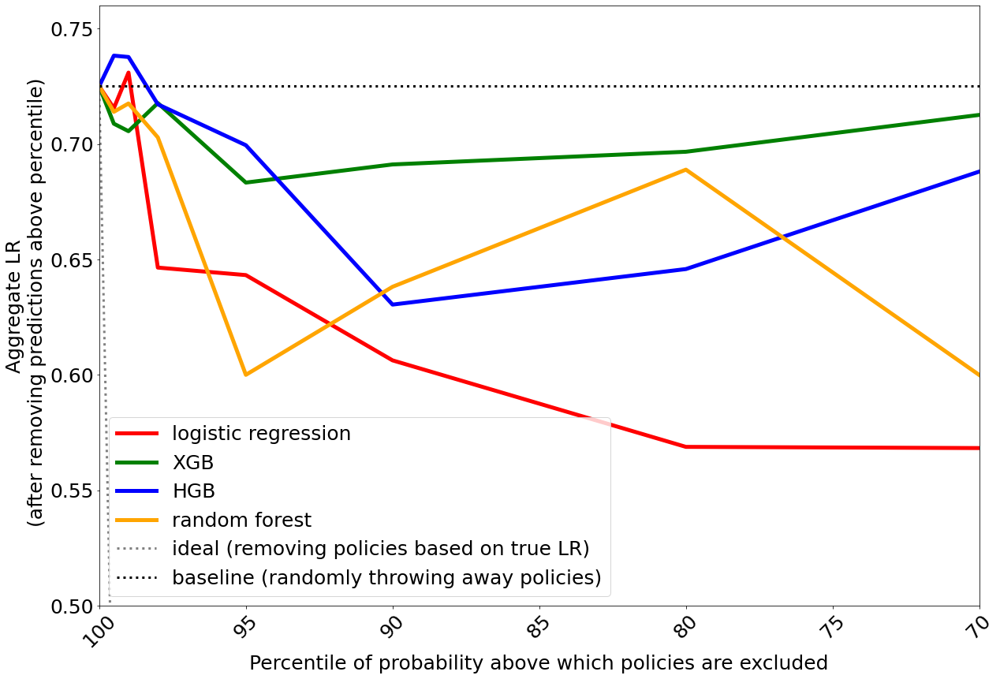

In [119]:
fontsize=25
# print([key for key in reg_hgbt.keys()])
# print([reg_hgbt[key] for key in reg_hgbt.keys()])
print([key for key in clss_logistic.keys()], [clss_logistic[key] for key in clss_logistic.keys()])
plt.plot([key for key in clss_logistic.keys()], [clss_logistic[key] for key in clss_logistic.keys()], lw=5, c='r', label='logistic regression')
plt.plot([key for key in clss_xgb.keys()], [clss_xgb[key] for key in clss_xgb.keys()], lw=5, c='g', label='XGB')
plt.plot([key for key in clss_hgb.keys()], [clss_hgb[key] for key in clss_hgb.keys()], lw=5, c='b', label='HGB')
plt.plot([key for key in clss_rf.keys()], [clss_rf[key] for key in clss_rf.keys()], lw=5, c='orange', label='random forest')

# baselines
plt.plot([key for key in baseline_historical.keys()], [baseline_historical[key] for key in baseline_historical.keys()], lw=3, c='gray', ls=':', label='ideal (removing policies based on true LR)')
plt.plot([key for key in clss_logistic.keys()], len([key for key in clss_logistic.keys()]) * [clss_logistic[100]], lw=3, c='k', ls=':', label='baseline (randomly throwing away policies)')

plt.ylabel("Aggregate LR\n (after removing predictions above percentile)", fontsize= fontsize)
plt.xlabel("Percentile of probability above which policies are excluded", fontsize = fontsize)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
plt.legend(fontsize=fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)
plt.xlim(100, 70)
plt.ylim(0.5, 0.76)
plt.savefig("LR_impact_portfoliolevel_classification_afterremoving_size_of_firm.png", dpi=300, bbox_inches='tight')
plt.show()

truncated version (up to 1%) requested by the business:

In [227]:
clss_logistic = evaluate_financial_impact_smallrange("LRv9_best_estimator_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

The max_iter was reached which means the coef_ did not converge


29991
[100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0] [0, 30, 60, 90, 120, 150, 180, 210, 240, 270, 300]
{100: 0.7250759420836478, 99.9: 0.7145819762816565, 99.8: 0.6983341728706259, 99.7: 0.7023383040730071, 99.6: 0.7093144415760725, 99.5: 0.7155540436097596, 99.4: 0.7207347895372118, 99.3: 0.7244156545881189, 99.2: 0.722499233443446, 99.1: 0.7283368997717288, 99.0: 0.7309797356396693}


In [228]:
clss_xgb = evaluate_financial_impact_smallrange("XGBv14_best_estimator_classifier_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.


29991
[100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0] [0, 30, 60, 90, 120, 150, 180, 210, 240, 270, 300]
{100: 0.7250759420836478, 99.9: 0.7273498333597032, 99.8: 0.740171816281591, 99.7: 0.7276763005084771, 99.6: 0.7328510652140477, 99.5: 0.7088471467645681, 99.4: 0.7156186622068843, 99.3: 0.7251228359306844, 99.2: 0.7191656766786765, 99.1: 0.6972739560876241, 99.0: 0.7055977056145145}


In [229]:
clss_hgb = evaluate_financial_impact_smallrange("HGBTv3_best_estimator_classifier_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

29991
[100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0] [0, 30, 60, 90, 120, 150, 180, 210, 240, 270, 300]
{100: 0.7250759420836478, 99.9: 0.7242904876057875, 99.8: 0.7291092543281351, 99.7: 0.7289828762184345, 99.6: 0.7346131409148424, 99.5: 0.7383263893419665, 99.4: 0.730110482855008, 99.3: 0.7325204793382211, 99.2: 0.7327393149819095, 99.1: 0.7391586287945882, 99.0: 0.7421118164962252}


In [230]:
clss_rf = evaluate_financial_impact_smallrange("RFv3_best_estimator_classifier_ND.pkl", 
                          train_df, X_train, X_train_impact, y_train_labeled, CV=True, classifier=True)

29991
[100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0] [0, 30, 60, 90, 120, 150, 180, 210, 240, 270, 300]
{100: 0.7250759420836478, 99.9: 0.7336889932960602, 99.8: 0.713795028427109, 99.7: 0.7232203962962644, 99.6: 0.7319390401896217, 99.5: 0.737257242934884, 99.4: 0.7170850834498739, 99.3: 0.7191956381572704, 99.2: 0.7295133847135533, 99.1: 0.7326122374330235, 99.0: 0.7163765599261224}


In [231]:
baseline_historical = compute_ideal_impact_smallrange(X_train_impact, y_train)

[100, 99.9, 99.8, 99.7, 99.6, 99.5, 99.4, 99.3, 99.2, 99.1, 99.0] [0.7250759420836478, 0.7145819762816565, 0.6983341728706259, 0.7023383040730071, 0.7093144415760725, 0.7155540436097596, 0.7207347895372118, 0.7244156545881189, 0.722499233443446, 0.7283368997717288, 0.7309797356396693]


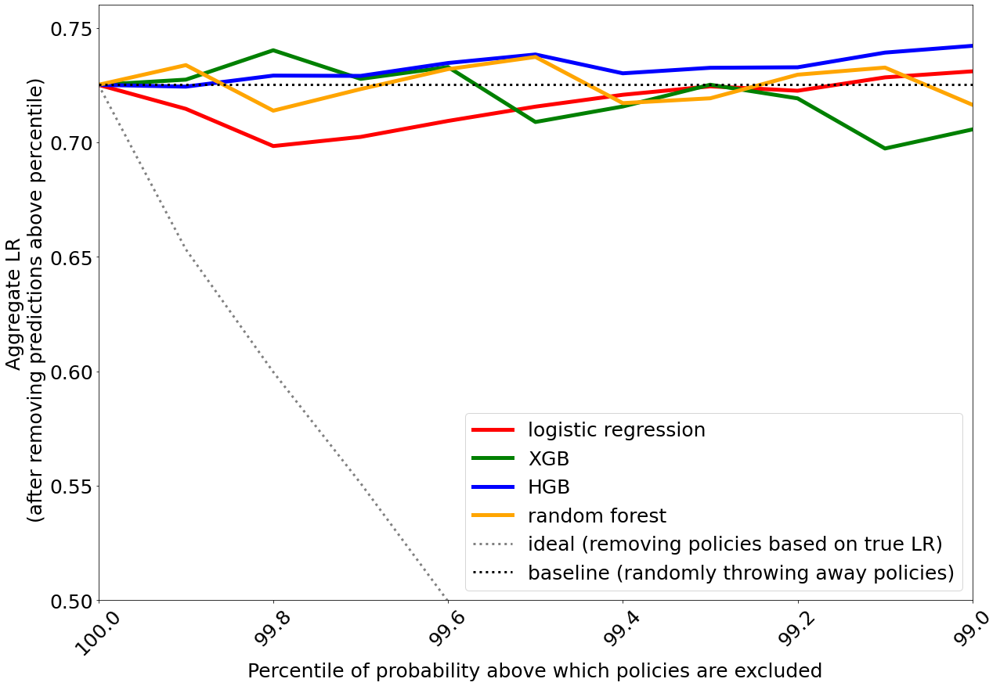

In [233]:
fontsize=25
# print([key for key in reg_hgbt.keys()])
# print([reg_hgbt[key] for key in reg_hgbt.keys()])
print([key for key in clss_logistic.keys()], [clss_logistic[key] for key in clss_logistic.keys()])
plt.plot([key for key in clss_logistic.keys()], [clss_logistic[key] for key in clss_logistic.keys()], lw=5, c='r', label='logistic regression')
plt.plot([key for key in clss_xgb.keys()], [clss_xgb[key] for key in clss_xgb.keys()], lw=5, c='g', label='XGB')
plt.plot([key for key in clss_hgb.keys()], [clss_hgb[key] for key in clss_hgb.keys()], lw=5, c='b', label='HGB')
plt.plot([key for key in clss_rf.keys()], [clss_rf[key] for key in clss_rf.keys()], lw=5, c='orange', label='random forest')

# baselines
plt.plot([key for key in baseline_historical.keys()], [baseline_historical[key] for key in baseline_historical.keys()], lw=3, c='gray', ls=':', label='ideal (removing policies based on true LR)')
plt.plot([key for key in clss_logistic.keys()], len([key for key in clss_logistic.keys()]) * [clss_logistic[100]], lw=3, c='k', ls=':', label='baseline (randomly throwing away policies)')

plt.ylabel("Aggregate LR\n (after removing predictions above percentile)", fontsize= fontsize)
plt.xlabel("Percentile of probability above which policies are excluded", fontsize = fontsize)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
plt.legend(fontsize=fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)
plt.xlim(100, 99.0)
plt.ylim(0.5, 0.76)
plt.savefig("LR_impact_portfoliolevel_classification_smallrange.png", dpi=300, bbox_inches='tight')
plt.show()

test for classifiers 

In [ ]:
clss_logistic_tst = evaluate_financial_impact("LRv9_best_estimator_ND.pkl", 
                          test_df, X_test, X_test_impact, y_test_labeled, CV=False, classifier=True)

In [ ]:
clss_xgb_tst = evaluate_financial_impact("XGBv14_best_estimator_classifier_ND.pkl", 
                          test_df, X_test, X_test_impact, y_test_labeled, CV=False, classifier=True)

In [ ]:
clss_hgb_tst = evaluate_financial_impact("HGBTv3_best_estimator_classifier_ND.pkl", 
                          test_df, X_test, X_test_impact, y_test_labeled, CV=False, classifier=True)

In [ ]:
clss_rf_tst = evaluate_financial_impact("RFv3_best_estimator_classifier_ND.pkl", 
                          test_df, X_test, X_test_impact, y_test_labeled, CV=False, classifier=True)

In [ ]:
baseline_historical_tst = compute_ideal_impact(X_test_impact, y_test)

In [ ]:
fontsize=25
# print([key for key in reg_hgbt.keys()])
# print([reg_hgbt[key] for key in reg_hgbt.keys()])
print([key for key in clss_logistic_tst.keys()], [clss_logistic_tst[key] for key in clss_logistic_tst.keys()])
plt.plot([key for key in clss_logistic_tst.keys()], [clss_logistic_tst[key] for key in clss_logistic_tst.keys()], lw=5, c='r', label='logistic regression')
plt.plot([key for key in clss_xgb_tst.keys()], [clss_xgb_tst[key] for key in clss_xgb_tst.keys()], lw=5, c='g', label='XGB')
plt.plot([key for key in clss_hgb_tst.keys()], [clss_hgb_tst[key] for key in clss_hgb_tst.keys()], lw=5, c='b', label='HGB')
plt.plot([key for key in clss_rf_tst.keys()], [clss_rf_tst[key] for key in clss_rf_tst.keys()], lw=5, c='orange', label='random forest')

# baselines
plt.plot([key for key in baseline_historical_tst.keys()], [baseline_historical_tst[key] for key in baseline_historical_tst.keys()], lw=3, c='gray', ls=':', label='ideal (removing policies based on true LR)')
#plt.plot([key for key in clss_1.keys()], len([key for key in clss_1.keys()]) * [clss_1[100]], lw=3, c='k', ls=':', label='baseline (randomly throwing away policies)')

plt.ylabel("Aggregate LR\n (after removing predictions above percentile)", fontsize= fontsize)
plt.xlabel("Percentile of probability above which policies are excluded", fontsize = fontsize)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
plt.legend(fontsize=fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)
plt.xlim(100, 70)
plt.ylim(0.5, 0.76)
plt.savefig("LR_impact_portfoliolevel_classification_afterremoving_size_of_firm_test.png", dpi=300, bbox_inches='tight')
plt.show()

# evaluating classification ROC at different percentile thresholds

In [319]:
def compute_truncated_ROC(model_file, df_for_splitting, X_model, y_binary):
    
    with open(model_file, 'rb') as file:
        # Call load method to deserialze
        model = joblib.load(file)

    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state = 42, n_splits=3)
    splitter_cv = gkf_cv.split(df_for_splitting, y_binary, groups=df_for_splitting['policy_id'])
    
    # my own CV 
    truncated_rocs = {}
    for i in range(3):
        
        # get indicies
        train_indicies, test_indicies = next(splitter_cv)
        
        # train splits
        X_split_train = X_model.iloc[train_indicies]
        y_split_labeled_train = y_binary.iloc[train_indicies]
        
        # test splits
        X_split_test = X_model.iloc[test_indicies]
        y_split_test = y_binary.iloc[test_indicies]
        
        # train model
        model_split = model.fit(X_split_train, y_split_labeled_train)
        
        # make probability predictions
        prob_pred = model_split.predict_proba(X_split_test)[:, 1]
        
        # test top 1%, 2%, 5%
        percentiles_to_test = [99, 98, 95]
        
        for perc in percentiles_to_test:
            
            idx_prob = np.array([[i, val] for i, val in enumerate(prob_pred) if val > np.percentile(prob_pred, perc)])
        
            idx = idx_prob[:, 0]
            prob = idx_prob[:, 1]
        
            score = roc_auc_score(y_split_test.iloc[idx], prob)
            
            if perc not in truncated_rocs.keys():
                truncated_rocs[perc] = []
            else:
                truncated_rocs[perc].append(score)
                
    # return scores as mean and std by modifying the existing dictionary
    for key in truncated_rocs.keys():
        truncated_rocs[key] = [np.mean(truncated_rocs[key]), np.std(truncated_rocs[key])]
            
    return truncated_rocs

In [320]:
print(compute_truncated_ROC("LRv7_best_estimator_ND.pkl", train_df, X_train, y_train_labeled))

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


{99: [0.5334925491175491, 0.10192411754911754], 98: [0.42137538420173387, 0.04195962333216868], 95: [0.5197918683910063, 0.021254369853507815]}


In [321]:
print(compute_truncated_ROC("XGBv11_best_estimator_classifier_ND.pkl", train_df, X_train, y_train_labeled))

{99: [0.5465065525949147, 0.11968662922326712], 98: [0.583966739215358, 0.006188961437580187], 95: [0.5558539797878227, 0.007665041951307794]}


In [322]:
print(compute_truncated_ROC("HGBTv2_best_estimator_classifier_ND.pkl", train_df, X_train, y_train_labeled))

{99: [0.5261524822695035, 0.003102836879432691], 98: [0.5025034206511053, 0.020191614809887654], 95: [0.5065834610078485, 0.006655455248309239]}


In [323]:
print(compute_truncated_ROC("RFv2_best_estimator_classifier_ND.pkl", train_df, X_train, y_train_labeled))

{99: [0.5278718359714152, 0.08656748814532828], 98: [0.46763563550261544, 0.02990534810394188], 95: [0.5283039258493007, 0.00404082892562968]}


# Lift of the various classifiers

In [107]:
def plot_lift_baselines(y_real, y_proba, fontsize, model_label, color = 'b', title = 'Lift Curve',):
    # Prepare the data
    aux_df = pd.DataFrame()
    aux_df['y_real'] = y_real
    aux_df['y_proba'] = y_proba
    # Sort by predicted probability
    aux_df = aux_df.sort_values('y_proba', ascending = False)
    # Find the total positive ratio of the whole dataset
    total_positive_ratio = sum(aux_df['y_real'] == 1) / aux_df.shape[0]
    # For each line of data, get the ratio of positives of the given subset and calculate the lift
    
    print(total_positive_ratio)
    lift_values = []
    for i in aux_df.index:
        threshold = aux_df.loc[i]['y_proba']
        subset = aux_df[aux_df['y_proba'] >= threshold]
        subset_positive_ratio = sum(subset['y_real'] == 1) / subset.shape[0]
        lift = subset_positive_ratio / total_positive_ratio
        lift_values.append(lift)
        
    # theoretical upper bound:
    theor_upper = 1.0/total_positive_ratio
    
    # theoretical lower bound:
    theor_lower = 1.0

    # Plot the lift curve
    plt.xlabel('Proportion of sample', fontsize=fontsize)
    plt.ylabel('Lift', fontsize=fontsize)
    #plt.title(title, fontsize=fontsize)
    plt.xticks(size=fontsize)
    plt.yticks(size=fontsize)
    x_data = [x/len(lift_values) for x in range(len(lift_values))]
    plt.plot(x_data, lift_values, color = color, label=model_label)
    plt.plot(x_data, [theor_upper] * len(lift_values), linestyle = 'dashed', lw=4, c='gray', label='upper limit')
    plt.plot(x_data, [theor_lower] * len(lift_values), linestyle = 'dashed', lw=4, c='k', label='random selection')
    plt.legend(loc='best', fontsize=fontsize)
    plt.yscale('log')
    
def plot_lift_individual(y_real, y_proba, fontsize, model_label, color = 'b', title = 'Lift Curve'):
    # Prepare the data
    aux_df = pd.DataFrame()
    aux_df['y_real'] = y_real
    aux_df['y_proba'] = y_proba
    # Sort by predicted probability
    aux_df = aux_df.sort_values('y_proba', ascending = False)
    # Find the total positive ratio of the whole dataset
    total_positive_ratio = sum(aux_df['y_real'] == 1) / aux_df.shape[0]
    # For each line of data, get the ratio of positives of the given subset and calculate the lift
    
    print(total_positive_ratio)
    lift_values = []
    for i in aux_df.index:
        threshold = aux_df.loc[i]['y_proba']
        subset = aux_df[aux_df['y_proba'] >= threshold]
        subset_positive_ratio = sum(subset['y_real'] == 1) / subset.shape[0]
        lift = subset_positive_ratio / total_positive_ratio
        lift_values.append(lift)
        
    # theoretical upper bound:
    theor_upper = 1.0/total_positive_ratio
    
    # theoretical lower bound:
    theor_lower = 1.0

    # Plot the lift curve
    x_data = [x/len(lift_values) for x in range(len(lift_values))]
    plt.plot(x_data, lift_values, color = color, label=model_label)

    #ax.axhline(1, color = 'gray', linestyle = 'dashed', linewidth = 3)

In [234]:
with open("RFv3_best_estimator_classifier_ND.pkl", 'rb') as file:
    rf_cls = joblib.load(file)
    
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, y_train_labeled, groups=train_df['policy_id'])
y_prob_pred_rf = cross_val_predict(rf_cls, X_train, y_train_labeled, cv = splitter_cv, method='predict_proba')[:, 1]

with open("HGBTv3_best_estimator_classifier_ND.pkl", 'rb') as file:
    hgb_cls = joblib.load(file)
    
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, y_train_labeled, groups=train_df['policy_id'])
y_prob_pred_hgb = cross_val_predict(hgb_cls, X_train, y_train_labeled, cv = splitter_cv, method='predict_proba')[:, 1]

with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
    xgb_cls = joblib.load(file)
    
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, y_train_labeled, groups=train_df['policy_id'])
y_prob_pred_xgb = cross_val_predict(xgb_cls, X_train, y_train_labeled, cv = splitter_cv, method='predict_proba')[:, 1]

with open("LRv9_best_estimator_ND.pkl", 'rb') as file:
    lr_cls = joblib.load(file)
    
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, y_train_labeled, groups=train_df['policy_id'])
y_prob_pred_lr = cross_val_predict(lr_cls, X_train, y_train_labeled, cv = splitter_cv, method='predict_proba')[:, 1]

`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
The max_iter was reached which means the coef_ did not converge


In [96]:
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
    xgb_cls = joblib.load(file)
    
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, y_train_labeled, groups=train_df['policy_id'])
y_prob_pred_xgb = cross_val_predict(xgb_cls, X_train, y_train_labeled, cv = splitter_cv, method='predict_proba')[:, 1]

`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.


0.028241805875095862
0.028241805875095862
0.028241805875095862
0.028241805875095862


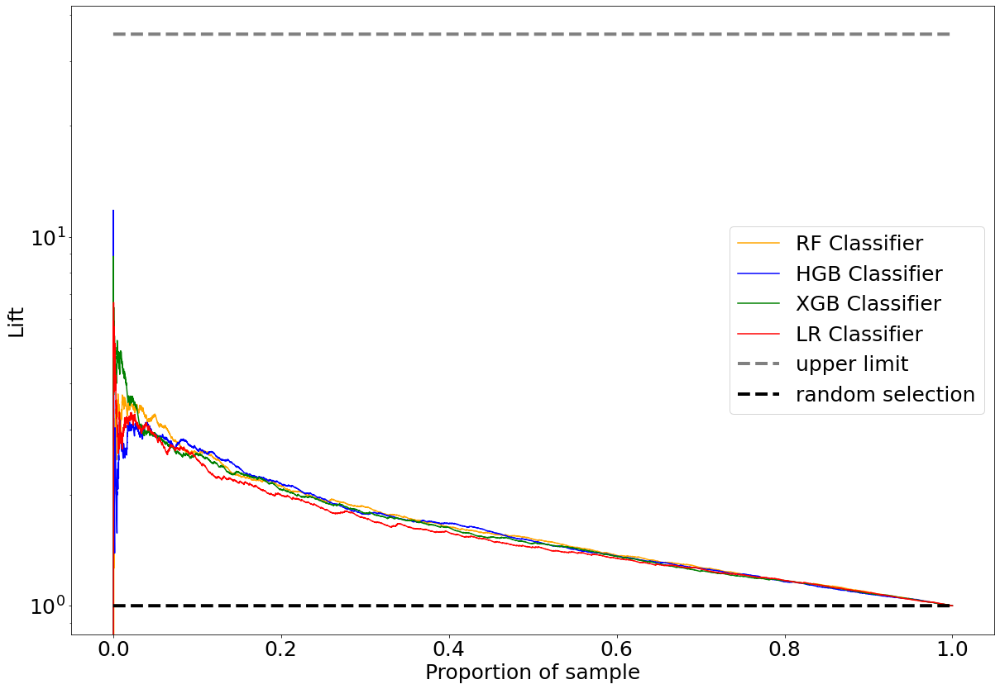

In [109]:
plot_lift_individual(y_train_labeled, y_prob_pred_rf, fontsize=25, model_label='RF Classifier', color='orange')
plot_lift_individual(y_train_labeled, y_prob_pred_hgb, fontsize=25, model_label='HGB Classifier', color='b')
plot_lift_individual(y_train_labeled, y_prob_pred_xgb, fontsize=25, model_label='XGB Classifier', color='g')
plot_lift_baselines(y_train_labeled, y_prob_pred_lr, fontsize=25, model_label='LR Classifier', color='r')
#plt.xlim(0, 0.05)
plt.savefig("classifiers_Lift_fullxrange.png", dpi=300, bbox_inches='tight')

0.028241805875095862
0.028241805875095862
0.028241805875095862
0.028241805875095862


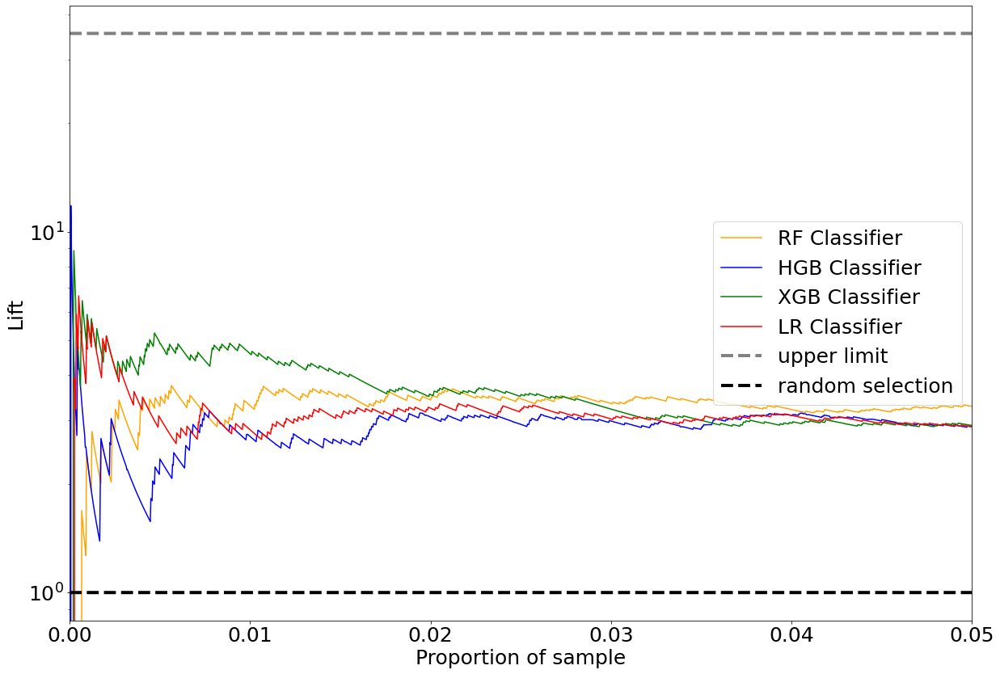

In [110]:
plot_lift_individual(y_train_labeled, y_prob_pred_rf, fontsize=25, model_label='RF Classifier', color='orange')
plot_lift_individual(y_train_labeled, y_prob_pred_hgb, fontsize=25, model_label='HGB Classifier', color='b')
plot_lift_individual(y_train_labeled, y_prob_pred_xgb, fontsize=25, model_label='XGB Classifier', color='g')
plot_lift_baselines(y_train_labeled, y_prob_pred_lr, fontsize=25, model_label='LR Classifier', color='r')
plt.xlim(0, 0.05)
plt.savefig("classifiers_Lift_truncatedxrange.png", dpi=300, bbox_inches='tight')

# Distribution of lrs thrown away by classifiers

In [120]:
df_excluded_1 = pd.DataFrame()

df_premiums_1 = pd.DataFrame()
# fix this after lunch
lr_excluded_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_lr)) if y_prob_pred_lr[i] > np.percentile(y_prob_pred_lr, 99)]].values
rf_excluded_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_rf)) if y_prob_pred_rf[i] > np.percentile(y_prob_pred_rf, 99)]].values
xgb_excluded_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_xgb)) if y_prob_pred_xgb[i] > np.percentile(y_prob_pred_xgb, 99)]].values
hgb_excluded_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_hgb)) if y_prob_pred_hgb[i] > np.percentile(y_prob_pred_hgb, 99)]].values

#lr_retained_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_lr)) if y_prob_pred_lr[i] <= np.percentile(y_prob_pred_lr, 99)]].values
# lr_premiums_1 = X_test_impact["onlevel_premium"].reset_index(drop=True)[[i for i in range(len(y_prob_pred_lr)) if y_prob_pred_lr[i] > np.percentile(y_prob_pred_lr, 99)]].values
# rf_premiums_1 = X_test_impact["onlevel_premium"].reset_index(drop=True)[[i for i in range(len(y_prob_pred_rf)) if y_prob_pred_rf[i] > np.percentile(y_prob_pred_rf, 99)]].values
# xgb_premiums_1 = X_test_impact["onlevel_premium"].reset_index(drop=True)[[i for i in range(len(y_prob_pred_xgb)) if y_prob_pred_xgb[i] > np.percentile(y_prob_pred_xgb, 99)]].values
# hgb_premiums_1 = X_test_impact["onlevel_premium"].reset_index(drop=True)[[i for i in range(len(y_prob_pred_hgb)) if y_prob_pred_hgb[i] > np.percentile(y_prob_pred_hgb, 98)]].values

# lr_excluded_2 = [ele for ele in y_prob_pred_lr if ele > np.percentile(y_prob_pred_lr, 98)]
# rf_excluded_2 = [ele for ele in y_prob_pred_rf if ele > np.percentile(y_prob_pred_rf, 98)]
# xgb_excluded_2 = [ele for ele in y_prob_pred_xgb if ele > np.percentile(y_prob_pred_xgb, 98)]
# hgb_excluded_2 = [ele for ele in y_prob_pred_hgb if ele > np.percentile(y_prob_pred_hgb, 98)]

df_excluded_1["model"] = ["LR"] * len(lr_excluded_1) + ["RF"] * len(rf_excluded_1) + ["XGB"] * len(xgb_excluded_1) + ["HGB"] * len(hgb_excluded_1)
df_excluded_1["loss ratio"] = list(lr_excluded_1) + list(rf_excluded_1) + list(xgb_excluded_1) + list(hgb_excluded_1)

# df_premiums_1["model"] = ["LR"] * len(lr_premiums_1) + ["RF"] * len(rf_premiums_1) + ["XGB"] * len(xgb_premiums_1) + ["HGB"] * len(hgb_premiums_1)
# df_premiums_1["premiums"] = list(lr_premiums_1) + list(rf_premiums_1) + list(xgb_premiums_1) + list(hgb_premiums_1)

# df_excluded_2["model"] = ["LR"] * len(lr_excluded_2) + ["RF"] * len(rf_excluded_2) + ["XGB"] * len(xgb_excluded_2) + ["HGB"] * len(hgb_excluded_2)
# df_excluded_2["loss ratio"] = lr_excluded_2 + rf_excluded_2 + xgb_excluded_2 + hgb_excluded_2

In [329]:
df_excluded_1[(df_excluded_1["model"] == "LR") & (df_excluded_1["loss ratio"] < 120)]["loss ratio"].mean()

0.41319586809759357

In [330]:
df_excluded_1[(df_excluded_1["model"] == "RF") & (df_excluded_1["loss ratio"] < 120)]["loss ratio"].mean()

0.5997794159624209

In [331]:
df_excluded_1[(df_excluded_1["model"] == "XGB") & (df_excluded_1["loss ratio"] < 120)]["loss ratio"].mean()

1.009376675287327

In [332]:
df_excluded_1[(df_excluded_1["model"] == "HGB") & (df_excluded_1["loss ratio"] < 120)]["loss ratio"].mean()

0.4391314914507003

In [333]:
df_excluded_1.groupby("model").mean()

,loss ratio
model,
HGB,0.439131
LR,0.413196
RF,0.599779
XGB,1.009377


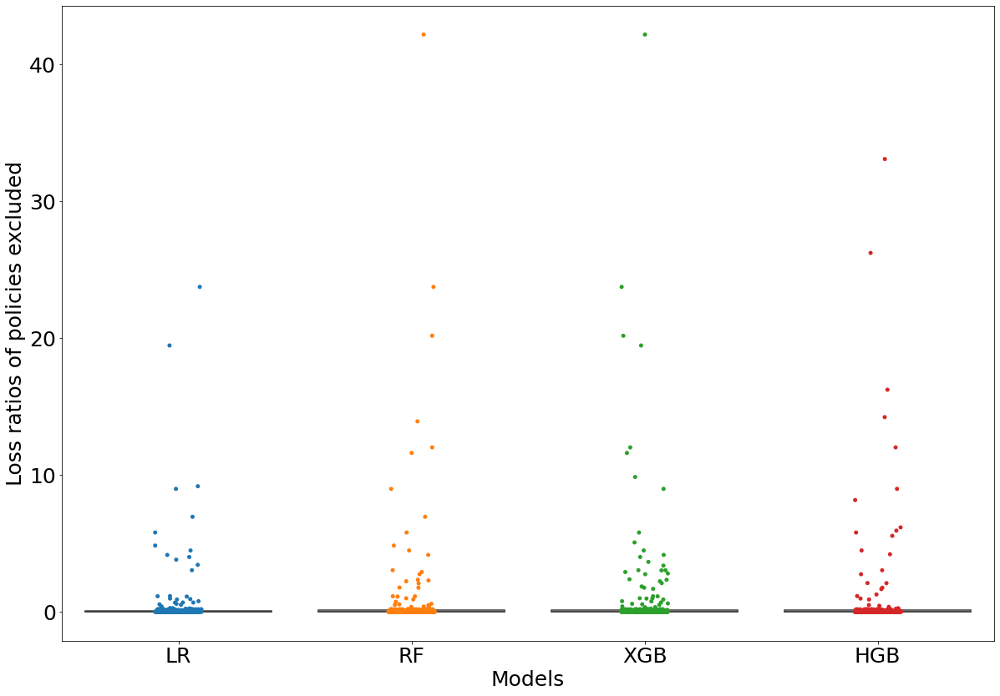

In [121]:
sns.stripplot(x="model", y = "loss ratio", data=df_excluded_1)
sns.boxplot(x="model", y="loss ratio", data=df_excluded_1, 
                 showcaps=False,boxprops={'facecolor':'None'},
                 showfliers=False,whiskerprops={'linewidth':0})
plt.xlabel("Models", fontsize=25)
plt.ylabel("Loss ratios of policies excluded",fontsize=25)
plt.xticks(size=25)
plt.yticks(size=25)

plt.savefig("classification_exclusion_distributions.png", dpi=300, bbox_inches='tight')

# distributions kept vs. thrown away

In [235]:
df_1 = pd.DataFrame()

lr_excluded_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_xgb)) if y_prob_pred_xgb[i] > np.percentile(y_prob_pred_xgb, 99)]].values
lr_retained_1 = y_train.reset_index(drop=True)[[i for i in range(len(y_prob_pred_xgb)) if y_prob_pred_xgb[i] <= np.percentile(y_prob_pred_xgb, 99)]].values

df_1["model"] = ["Excluded by XGB model (1%)"] * len(lr_excluded_1) + ["Retained by XGB model"] * len(lr_retained_1)
df_1["loss ratio"] = list(lr_excluded_1) + list(lr_retained_1) 
df_1["color"] = ['#7f7f7f'] * len(lr_excluded_1) + ['#2ca02c'] * len(lr_retained_1)

In [337]:
print(sns.color_palette().as_hex())

['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']


In [435]:
sns.color_palette()

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

[0.00000000e+00 1.86289098e-04 1.88973209e-04 ... 5.01467225e+02
 5.59395476e+02 1.19226587e+03]


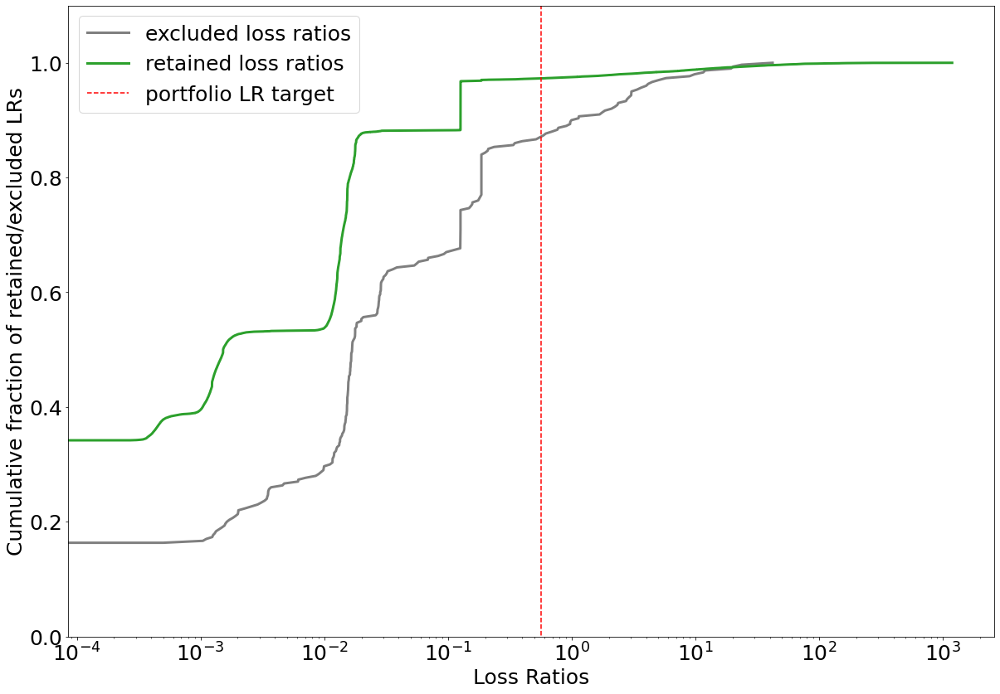

In [236]:
x_excluded, counts_excluded = np.unique(lr_excluded_1, return_counts=True)
cusum_excluded = np.cumsum(counts_excluded)

x, counts = np.unique(lr_retained_1, return_counts=True)
cusum = np.cumsum(counts)

#print(cusum / cusum[-1])
print(x)
fontsize=25
plt.plot(x_excluded, cusum_excluded/cusum_excluded[-1], color="#7f7f7f", label='excluded loss ratios', lw=3)
plt.plot(x, cusum/cusum[-1], color='#2ca02c', label='retained loss ratios', lw=3)
plt.plot([0.57] * 20, np.linspace(-1, 1.2, 20), color='r', ls='--', label='portfolio LR target')
plt.xscale('log')
plt.ylim(0, 1.1)
plt.xlabel("Loss Ratios", fontsize=25)
plt.ylabel("Cumulative fraction of retained/excluded LRs",fontsize=25)
plt.xticks(size=25)
plt.yticks(size=25)
plt.legend(loc='best', fontsize=fontsize)
plt.savefig("classification_cusum_excludedretained_distributions.png", dpi=300, bbox_inches='tight')

plt.show()


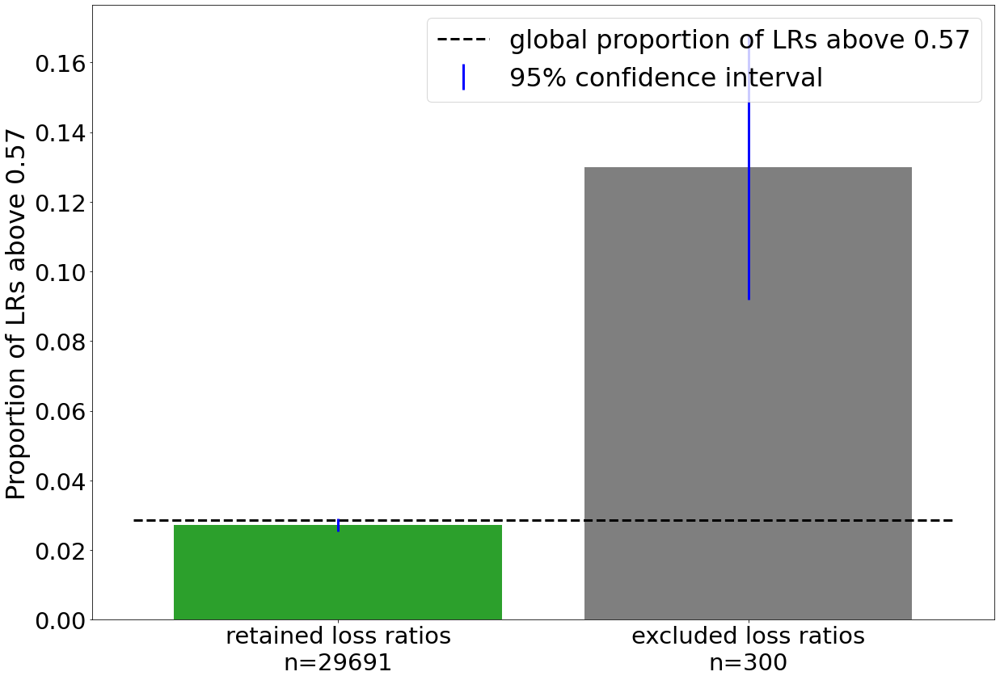

In [242]:
purported_high = lr_excluded_1 
purported_low = lr_retained_1

# computing 'bad' policy fractions for high and low bins
x_low, counts_low = np.unique(purported_low, return_counts=True)
cusum_low = np.cumsum(counts_low)

x_high, counts_high = np.unique(purported_high, return_counts=True)
cusum_high = np.cumsum(counts_high)

low_counts = cusum_low[np.where(np.array(sorted(x_low)) <= 0.57)[0][-1]]
low_total = cusum_low[-1]

high_counts = cusum_high[np.where(np.array(sorted(x_high)) <= 0.57)[0][-1]]
high_total = cusum_high[-1]

low_fraction = 1 - (low_counts/low_total)
high_fraction = 1- (high_counts/high_total)

low_fraction_bounds = proportion_confint(low_total - low_counts, low_total, alpha = 0.05)
high_fraction_bounds = proportion_confint(high_total - high_counts, high_total, alpha = 0.05)

# ------plotting---------
fig, ax = plt.subplots(figsize=(20,14))
fontsize=32
x = ["retained loss ratios" + "\n" + "n={}".format(purported_low.shape[0]), "excluded loss ratios" + "\n" + "n={}".format(purported_high.shape[0])]

# line plot of global success fraction
global_mean = preprocess_df["ultimate_trended_onlevel_lr"].apply(lambda x: 1 if x > 0.57 else 0).mean()
plt.plot([-0.5, 0, 1, 1.5] , [global_mean] * 4, label="global proportion of LRs above {}".format(0.57), linestyle = '--', color='k', lw=3)

# line plot of local success fraction for just two bins
plt.bar(x, [low_fraction, high_fraction], color=['#2ca02c', "#7f7f7f"])

# plot 95% confidence interval around observed success fraction (using errorbar)
yerr = [[abs(low_fraction - low_fraction_bounds[0]), abs(high_fraction - high_fraction_bounds[0])], 
                [abs(low_fraction - low_fraction_bounds[1]), abs(high_fraction - high_fraction_bounds[1])]]

plt.errorbar(x, [low_fraction, high_fraction], yerr = yerr, fmt='none', color='b', lw=3, label='95% confidence interval')

plt.ylabel("Proportion of LRs above {}".format(0.57),fontsize=fontsize)

plt.xticks(size=fontsize/1.1)
plt.yticks(size=fontsize/1.1)
plt.legend(loc='best', fontsize=fontsize)

plt.savefig("EDA_investigation_figures"+ os.sep + "bar_chart_distributions_retained_excluded", dpi=300, bbox_inches='tight')

plt.show()

In [457]:
print(df_1.sample(10))

                            model  loss ratio    color
28874       Retained by XGB model   47.967823  #2ca02c
8493        Retained by XGB model    0.016063  #2ca02c
21400       Retained by XGB model    1.104467  #2ca02c
9819        Retained by XGB model    0.000556  #2ca02c
16258       Retained by XGB model    0.001619  #2ca02c
24581       Retained by XGB model    0.000000  #2ca02c
4789        Retained by XGB model    0.001614  #2ca02c
29949       Retained by XGB model    0.000000  #2ca02c
17872       Retained by XGB model    0.000000  #2ca02c
271    Excluded by XGB model (1%)    0.015500  #7f7f7f


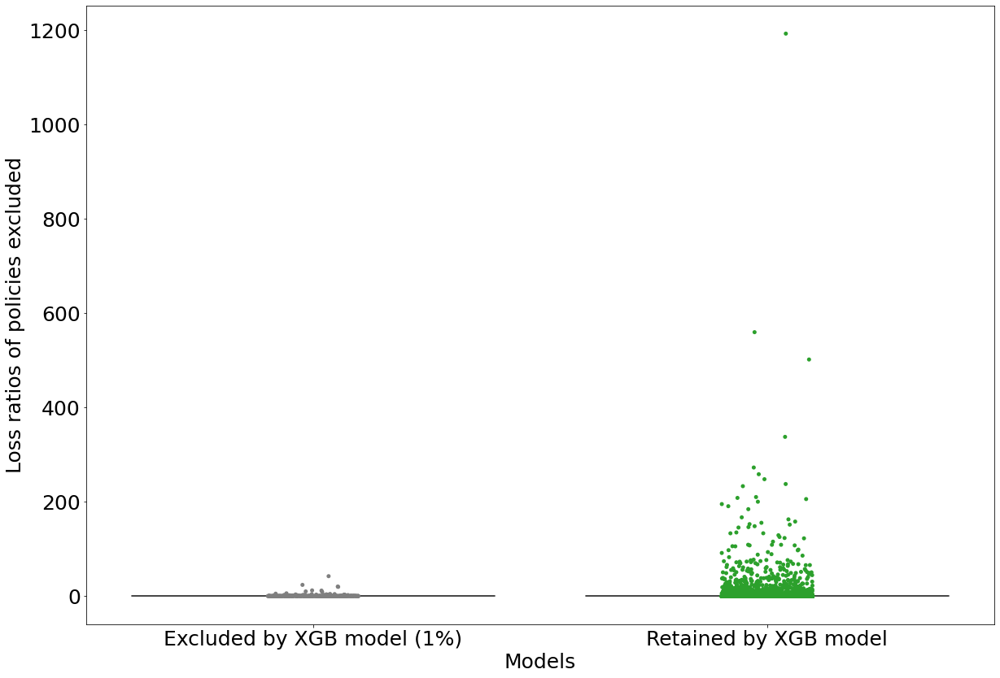

In [130]:
my_pal = {"Excluded by XGB model (1%)": "#7f7f7f", "Retained by XGB model": '#2ca02c'}
ax = sns.stripplot(x="model", y = "loss ratio", data=df_1, palette=my_pal)

sns.boxplot(x="model", y="loss ratio", palette = my_pal, data=df_1, 
                 showcaps=False,boxprops={'facecolor':'None'},
                 showfliers=False,whiskerprops={'linewidth':0}, ax=ax)
plt.xlabel("Models", fontsize=25)
plt.ylabel("Loss ratios of policies excluded",fontsize=25)
plt.xticks(size=25)
plt.yticks(size=25)

plt.savefig("classification_keptvsexcluded_distributions.png", dpi=300, bbox_inches='tight')

# portfolio impact of two rules (exposure, max_detailed_aop)

## For exposure

Let's ask a simple question. Given that high exposures are more likely to have more bad loss ratios, what is the effect of removing high exposures (above 50%) on premiums and aggregate loss ratio?:

In [96]:
def mc_sim_portfolio(target_percentage_bad, target_feature, threshold_bad_feat_gt, df, iterations):

    bad_policies_prob = target_percentage_bad/df[df[target_feature]>=threshold_bad_feat_gt].shape[0]
    good_policies_prob = (1.0 - target_percentage_bad)/df[df[target_feature]<threshold_bad_feat_gt].shape[0]

    template_df = df.copy()
    template_df["probability"] = template_df.apply(lambda row: bad_policies_prob if row[target_feature] >=threshold_bad_feat_gt else good_policies_prob, axis=1)
    template_df = template_df[[target_feature, "probability", "ultimate_loss_trended", "onlevel_premium"]]

    sample_lrs = []
    total_premiums = []

    for i in range(iterations):
        sample_df = template_df.sample(n=template_df.shape[0], replace=True, weights = "probability")
        sample_lr = np.sum(sample_df["ultimate_loss_trended"])/np.sum(sample_df["onlevel_premium"])
        sample_lrs.append(sample_lr)
        
        total_premiums.append(sample_df["onlevel_premium"].sum())

    return np.mean(sample_lrs), np.std(sample_lrs)/np.sqrt(len(sample_lrs)), np.mean(total_premiums), np.std(total_premiums)/np.sqrt(len(total_premiums))

In [96]:
def mc_sim_portfolio_priceincrease(target_price_increase, target_feature, threshold_bad_feat_gt, df, iterations):

    # first apply price increase to policies above threshold
    idx_above_threshold = df[df[target_feature] >= threshold_bad_feat_gt].index.tolist()
    idx_below_threshold = df[df[target_feature] < threshold_bad_feat_gt].index.tolist()
    
    target_premiums = df["onlevel_premium"].iloc[idx_above_threshold].apply(lambda x: target_price_increase*x).tolist()
    target_losses = df["ultimate_loss_trended"].iloc[idx_above_threshold].tolist()
    
    unchanged_premiums = df["onlevel_premium"].iloc[idx_below_threshold].tolist()
    unchanged_losses = df["ultimate_loss_trended"].iloc[idx_below_threshold].tolist()
    
    updated_aggregate = (np.sum(target_losses) + np.sum(unchanged_losses))/ (np.sum(target_premiums) + np.sum(unchanged_premiums))
    other_aggregate = np.sum(df["ultimate_loss_trended"])/np.sum(df["onlevel_premium"])
    
    # second, apply the price increase to same policies, but where their loss ratios have been replaced with random loss ratios (but keep premiums same so loss = LR *premiums). Then iterate.
    reference_agg_lrs = []
    for i in range(iterations):
        sample_df = df.iloc[idx_below_threshold].sample(n=len(idx_above_threshold), replace=False)
        sample_df["lr"] = sample_df["ultimate_loss_trended"]/sample_df["onlevel_premium"]
        sample_df["original_premiums"] = df["onlevel_premium"].iloc[idx_above_threshold].values
        sample_df["sample_losses"] = sample_df["original_premiums"] * sample_df["lr"]
        sample_losses = sample_df["sample_losses"].tolist()
        
        reference_aggregate = (np.sum(sample_losses) + np.sum(unchanged_losses))/ (np.sum(target_premiums) + np.sum(unchanged_premiums))
        reference_agg_lrs.append(reference_aggregate)
    
    return updated_aggregate, np.mean(reference_agg_lrs), np.std(reference_agg_lrs)/np.sqrt(len(reference_agg_lrs))

In [256]:
a = np.array([1,2,3,4,5])
selected_rmvl_idx = random.sample(range(len(a)), int(0.2*len(a)))
print(selected_rmvl_idx)
print(list(set(a) - set(a[selected_rmvl_idx])))
print(list(np.setdiff1d(a, a[selected_rmvl_idx])))

[4]
[1, 2, 3, 4]
[1, 2, 3, 4]


In [97]:
def mc_sim_portfolio_priceincrease_elasticity(target_price_increase, target_feature, threshold_bad_feat_gt, df, iterations):

    # first apply price increase to policies above threshold
    idx_above_threshold = df[df[target_feature] >= threshold_bad_feat_gt].index.tolist()
    idx_below_threshold = df[df[target_feature] < threshold_bad_feat_gt].index.tolist()
    
    percent_drop = target_price_increase - 1.0
    temp_above_threshold = np.array(idx_above_threshold)
    
    agg_lrs = []
    reference_agg_lrs = []
    premiums = []
    for i in range(iterations):
        
        # randomly drop percentage of these policies that equals the target price increase (accounting for elasticity)
        selected_rmvl_idx = random.sample(range(len(temp_above_threshold)), int(percent_drop*len(temp_above_threshold)))
        idx_above_threshold = list(np.setdiff1d(temp_above_threshold, temp_above_threshold[selected_rmvl_idx]))

        target_premiums = df["onlevel_premium"].iloc[idx_above_threshold].apply(lambda x: target_price_increase*x).tolist()
        target_losses = df["ultimate_loss_trended"].iloc[idx_above_threshold].tolist()

        unchanged_premiums = df["onlevel_premium"].iloc[idx_below_threshold].tolist()
        unchanged_losses = df["ultimate_loss_trended"].iloc[idx_below_threshold].tolist()

        updated_aggregate = (np.sum(target_losses) + np.sum(unchanged_losses))/ (np.sum(target_premiums) + np.sum(unchanged_premiums))
        premiums.append(np.sum(target_premiums) + np.sum(unchanged_premiums))
        agg_lrs.append(updated_aggregate)
        
        # second, apply the price increase to same policies, but where their loss ratios have been replaced with random loss ratios (but keep premiums same so loss = LR *premiums). Then iterate.
        sample_df = df.iloc[idx_below_threshold].sample(n=len(idx_above_threshold), replace=False)
        sample_df["lr"] = sample_df["ultimate_loss_trended"]/sample_df["onlevel_premium"]
        sample_df["original_premiums"] = df["onlevel_premium"].iloc[idx_above_threshold].values
        sample_df["sample_losses"] = sample_df["original_premiums"] * sample_df["lr"]
        sample_losses = sample_df["sample_losses"].tolist()
        
        reference_aggregate = (np.sum(sample_losses) + np.sum(unchanged_losses))/ (np.sum(target_premiums) + np.sum(unchanged_premiums))
        reference_agg_lrs.append(reference_aggregate)
        
    return np.mean(agg_lrs), np.std(agg_lrs)/np.sqrt(len(agg_lrs)), np.mean(reference_agg_lrs), np.std(reference_agg_lrs)/np.sqrt(len(reference_agg_lrs)), np.mean(premiums), np.std(premiums)/np.sqrt(len(premiums))

In [262]:
def fun(low_premiums: np.ndarray,
        low_losses: np.ndarray, 
        high_premiums: np.ndarray,
        high_losses: np.ndarray, 
        prop_high_present: float) -> tuple:

    # Calculate proportion of the high premiums to discard given the desired proportion of 'high' items being present
    prop_high_throw_away = 1 - (prop_high_present * (low_premiums.shape[0] + high_premiums.shape[0]) / high_premiums.shape[0])
    
    #print(prop_high_throw_away)
    throw_away_indices = np.random.choice(high_premiums.shape[0], size=round(high_premiums.shape[0]*prop_high_throw_away), replace=False)

    # Updated set of high premiums and losses after throw away step
    high_premiums_updated = high_premiums[np.setdiff1d(np.arange(high_premiums.shape[0]), throw_away_indices, assume_unique=True)]
    high_losses_updated = high_losses[np.setdiff1d(np.arange(high_premiums.shape[0]), throw_away_indices, assume_unique=True)]

    # Total premium amount over the set of high premiums thrown away must equal the total premium amount over the sampled set
    target_premiums = np.sum(high_premiums[throw_away_indices])
    sample_premiums_sum = 0
    sample_premiums = np.array([])
    sample_losses = np.array([])
    extra_attempts = 100
    done = False
    
    while not done:
        # Draw a random index from the low set
        sampled_item_index = np.random.choice(low_premiums.shape[0], size=1, replace=True)
        
        # If the corresponding premium can be added without exceeding the target, add it and save the associated loss too
        if sample_premiums_sum + low_premiums[sampled_item_index].item() <= target_premiums:
            sample_premiums_sum += low_premiums[sampled_item_index].item()
            sample_premiums = np.concatenate((sample_premiums, low_premiums[sampled_item_index]))
            sample_losses = np.concatenate((sample_losses, low_losses[sampled_item_index]))
        else:
            # After using the above methodology to get close to the target premium amount, we attempt to get a little closer
            # given a predefined amount of extra steps. This is because the previous loop exists as soon as it samples a premium 
            # that would push us over the target. With this for loop, we can see if there exists other premiums that can get us closer
            for _ in range(extra_attempts):
                extra_sampled_item_index = np.random.choice(low_premiums.shape[0], size=1, replace=True)
                if sample_premiums_sum + low_premiums[extra_sampled_item_index].item() <= target_premiums:
                    sample_premiums_sum += low_premiums[extra_sampled_item_index].item()
                    sample_premiums = np.concatenate((sample_premiums, low_premiums[extra_sampled_item_index]))
                    sample_losses = np.concatenate((sample_losses, low_losses[extra_sampled_item_index]))
            done = True

    # Calculate the aggregate total premiums and aggregate loss ratio of the new portfolio
    aggregate_total_premiums = np.sum(low_premiums) + np.sum(high_premiums_updated) + np.sum(sample_premiums)
    aggregate_loss_ratio = (np.sum(low_losses) + np.sum(high_losses_updated) + np.sum(sample_losses)) / aggregate_total_premiums

    return (aggregate_total_premiums, aggregate_loss_ratio)

In [121]:
aggregate_means = []
aggregate_stds = []

premiums_mean = []
premiums_stds = []

high_exposure_fractions = []
for thresh in np.arange(0.01, 0.000, -0.001):
    mean_aggregate, std_aggregate, mean_premiums, std_premiums = mc_sim_portfolio(thresh, "exposure", 50, preprocess_df_incl_lossnpremium, 5000)

    aggregate_means.append(mean_aggregate)
    aggregate_stds.append(std_aggregate * 1.96) #95% confidence interval
    
    premiums_mean.append(mean_premiums)
    premiums_stds.append(std_premiums * 1.96)
    high_exposure_fractions.append(thresh)

In [ ]:
preprocess_df_incl_lossnpremium["exposure"]

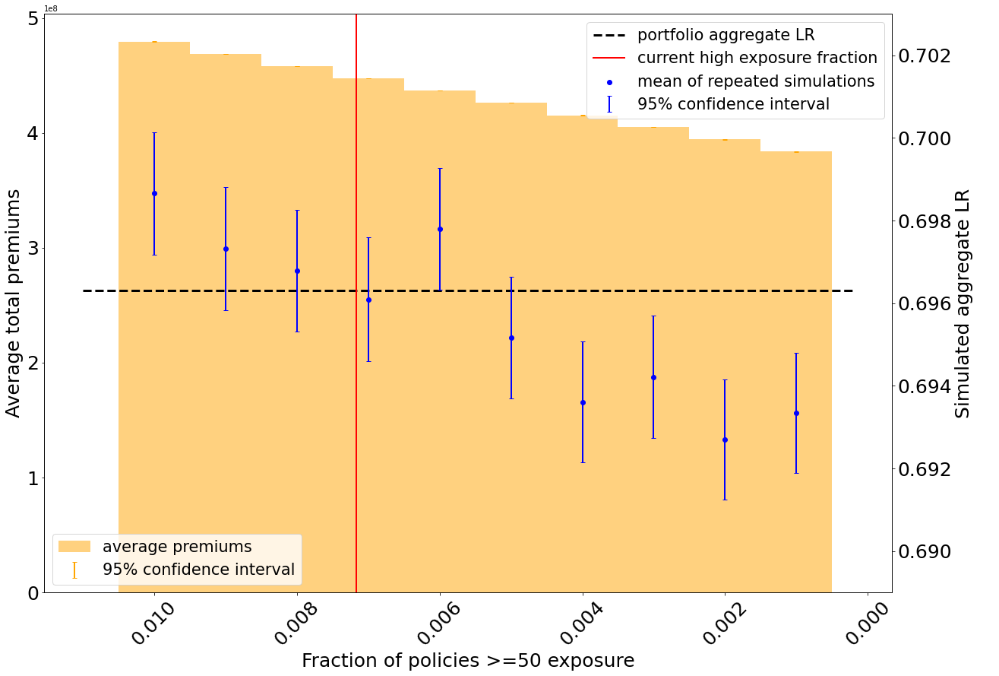

In [194]:
fontsize=25
plt.ylabel("Average total premiums", fontsize= fontsize)
plt.xlabel("Fraction of policies >=50 exposure", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.bar(high_exposure_fractions, premiums_mean, 
        color='orange', alpha=0.5, width=0.001, label='average premiums')
plt.errorbar(high_exposure_fractions,  premiums_mean, yerr=premiums_stds, fmt='none', color='orange', lw=2, label='95% confidence interval', capsize=3)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)

#legend1.remove()

plt.legend(fontsize=fontsize/1.2, loc='lower left')
plt.xticks(size = fontsize, rotation=45)

ax = plt.twinx()

plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Fraction of policies >=50 exposure", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([0.011, 0.0002], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
curr_exposure_fraction = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] > 50].shape[0]/preprocess_df_incl_lossnpremium.shape[0]
plt.plot([curr_exposure_fraction]*2, [0.689, 0.703], linestyle = '-', color='r', lw=2, label="current high exposure fraction")
plt.errorbar(high_exposure_fractions, aggregate_means, yerr=aggregate_stds, fmt='none', color='b', lw=2, label='95% confidence interval', capsize=3)
plt.scatter(high_exposure_fractions, aggregate_means,  color='b', label='mean of repeated simulations')

plt.gca().invert_xaxis()
plt.ylim(0.689, 0.703)
plt.legend(loc='upper right', fontsize=fontsize/1.2)
plt.savefig("simulated_exposure_effect.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
aggregate_means_premiumstest = []
aggregate_stds_premiumstest = []

premiums_mean_premiumstest = []
premiums_stds_premiumstest = []

high_exposure_fractions_premiumstest = []

iterations = 5000

low_premiums = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] <= 50]["onlevel_premium"].tolist())
low_loss = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] <= 50]["ultimate_loss_trended"].tolist())

high_premiums = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] > 50]["onlevel_premium"].tolist())
high_loss = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] > 50]["ultimate_loss_trended"].tolist())

for thresh in np.arange(0.0070, 0.000, -0.0005):
    
    lst_premiums = []
    lst_lr = []
    
    for i in range(iterations):
    
        agg_premiums, agg_lr = fun(low_premiums, low_loss, high_premiums, high_loss, thresh)
        
        lst_premiums.append(agg_premiums)
        lst_lr.append(agg_lr)
        
    aggregate_means_premiumstest.append(np.mean(lst_lr))
    aggregate_stds_premiumstest.append(np.std(lst_lr)/np.sqrt(len(lst_lr)) * 1.96) #95% confidence interval

    premiums_mean_premiumstest.append(np.mean(lst_premiums))
    premiums_stds_premiumstest.append(np.std(lst_premiums)/np.sqrt(len(lst_premiums)) * 1.96)
    high_exposure_fractions_premiumstest.append(thresh)

In [ ]:
np.save("agg_mean_premiumtest.npy", aggregate_means_premiumstest)
np.save("agg_stds_premiumtest.npy", aggregate_stds_premiumstest)
np.save("premiums_mean_premiumtest.npy", premiums_mean_premiumstest)
np.save("premiums_stds_premiumtest.npy", premiums_stds_premiumstest)

In [100]:
high_exposure_fractions_premiumstest = []

for thresh in np.arange(0.0070, 0.000, -0.0005):
    high_exposure_fractions_premiumstest.append(thresh)
    
aggregate_means_premiumstest = np.load("agg_mean_premiumtest.npy")
aggregate_stds_premiumstest = np.load("agg_stds_premiumtest.npy")
premiums_mean_premiumstest = np.load("premiums_mean_premiumtest.npy")
premiums_stds_premiumstest = np.load("premiums_stds_premiumtest.npy")

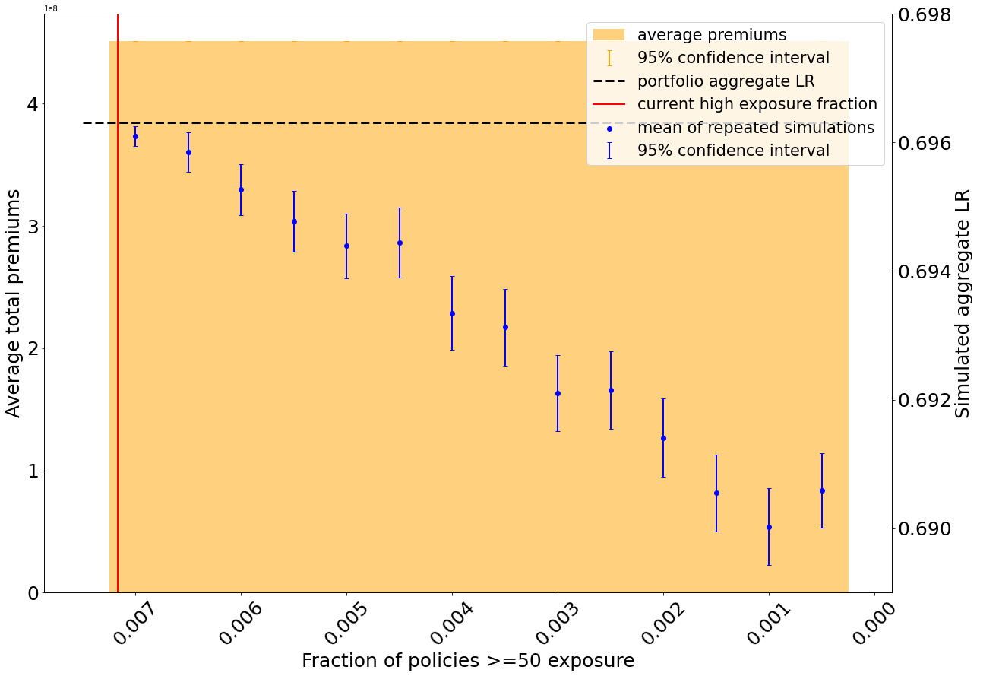

In [112]:
fontsize=25
plt.ylabel("Average total premiums", fontsize= fontsize)
plt.xlabel("Fraction of policies >=50 exposure", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.bar(high_exposure_fractions_premiumstest, premiums_mean_premiumstest, 
        color='orange', alpha=0.5, width=0.0005, label='average premiums')
plt.errorbar(high_exposure_fractions_premiumstest,  premiums_mean_premiumstest, yerr=premiums_stds_premiumstest, fmt='none', color='orange', lw=2, label='95% confidence interval', capsize=3)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)

#legend1.remove()

#plt.legend(fontsize=fontsize/1.2, loc='lower center').set_zorder(3)
plt.xticks(size = fontsize, rotation=45)

plt.twinx()

plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Fraction of policies >=50 exposure", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([0.0075, 0.0002], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
curr_exposure_fraction = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] > 50].shape[0]/preprocess_df_incl_lossnpremium.shape[0]
plt.plot([curr_exposure_fraction]*2, [0.679, 0.703], linestyle = '-', color='r', lw=2, label="current high exposure fraction")
plt.errorbar(high_exposure_fractions_premiumstest, aggregate_means_premiumstest, yerr=aggregate_stds_premiumstest, fmt='none', color='b', lw=2, label='95% confidence interval', capsize=3)
plt.scatter(high_exposure_fractions_premiumstest, aggregate_means_premiumstest,  color='b', label='mean of repeated simulations')

plt.gca().invert_xaxis()
plt.ylim(0.689, 0.698)

fig = plt.gcf()
handles = []
labels = []
for ax in fig.axes:
    for h, l in zip(*ax.get_legend_handles_labels()):
        handles.append(h)
        labels.append(l)
    
plt.legend(handles, labels, loc='upper right', fontsize=fontsize/1.2)
plt.savefig("simulated_exposure_effect_premiumstest.png", dpi=300, bbox_inches='tight')
plt.show()

In [255]:
low_premiums.shape[0]

42537

In [237]:
preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["exposure"] > 50].shape[0]/preprocess_df_incl_lossnpremium.shape[0]

0.0071655307627672485

Let's simulate the price increase approach with the appropriate baseline:

In [204]:
price_change_lrs = []
reference_mean_lrs = []
reference_std_lrs = []

price_fractions = []
for thresh in np.arange(1.00, 1.16, 0.01):
    price_aggregate, mean_ref_aggregate, std_ref_aggregate = mc_sim_portfolio_priceincrease(thresh, "exposure", 50, preprocess_df_incl_lossnpremium, 500)
    
    price_change_lrs.append(price_aggregate)
    reference_mean_lrs.append(mean_ref_aggregate)
    reference_std_lrs.append(std_ref_aggregate * 1.96)
    
    price_fractions.append(thresh)

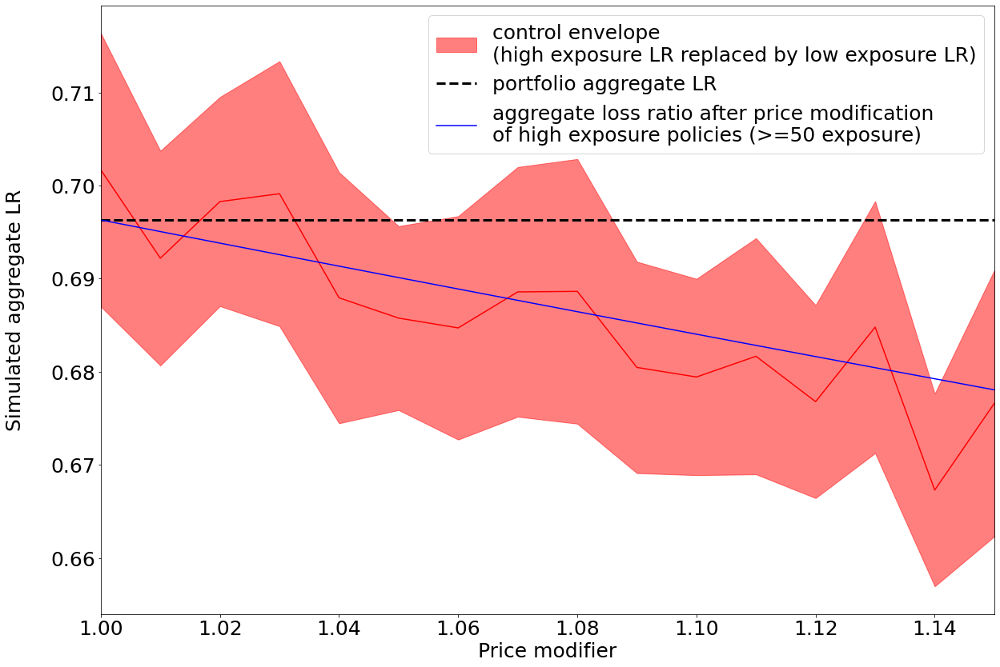

In [205]:
plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Price modifier", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
lower = np.array(reference_mean_lrs) - np.array(reference_std_lrs)
upper = np.array(reference_mean_lrs) + np.array(reference_std_lrs)
plt.fill_between(price_fractions, lower, upper, alpha=0.5, color='red', label='control envelope \n(high exposure LR replaced by low exposure LR)')
plt.plot(price_fractions, reference_mean_lrs, color='red')
#plt.errorbar(price_fractions, reference_mean_lrs, yerr=reference_std_lrs,  color='r', lw=2, label='control \n(high exposure LR replaced by low exposure LR)')

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1.0, 1.15], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
plt.plot(price_fractions, price_change_lrs, color='b', label='aggregate loss ratio after price modification\nof high exposure policies (>=50 exposure)', zorder = 2.5)
plt.xlim(1.0, 1.15)
plt.legend(loc='best', fontsize=fontsize)
#plt.gca().invert_xaxis()
plt.savefig("simulated_pricing_exposure_effect.png", dpi=300, bbox_inches='tight')
plt.show()

Same price increase approach but including elasticity:

In [99]:
price_change_mean_lrs = []
price_change_std_lrs = []
reference_mean_lrs = []
reference_std_lrs = []

premiums_mean = []
premiums_std = []
price_fractions = []
for thresh in np.arange(1.00, 1.16, 0.01):
    aggregate_mean, aggregate_std, ref_mean, ref_std, premium_mean, premium_std = mc_sim_portfolio_priceincrease_elasticity(thresh, "exposure", 50, preprocess_df_incl_lossnpremium, 500)
    
    price_change_mean_lrs.append(aggregate_mean)
    price_change_std_lrs.append(aggregate_std * 1.96) # strictly conf interval
    
    reference_mean_lrs.append(ref_mean)
    reference_std_lrs.append(ref_std * 1.96)
    
    premiums_mean.append(premium_mean)
    premiums_std.append(premium_std * 1.96)
    
    price_fractions.append(thresh)

In [102]:
print(price_change_mean_lrs)

[0.6963104167494423, 0.6948543263992535, 0.6936783557079051, 0.6930160230072954, 0.6910798333639395, 0.6904278479208831, 0.6887630303238715, 0.6881087619234227, 0.6869507616289325, 0.685508086477831, 0.684778900587434, 0.6841662805804992, 0.6827478341327674, 0.6824625175565581, 0.6804182215793242, 0.680179947551684]


In [103]:
print(100*(price_change_mean_lrs[0] - price_change_mean_lrs[5])/price_change_mean_lrs[0])

0.8448198801937441


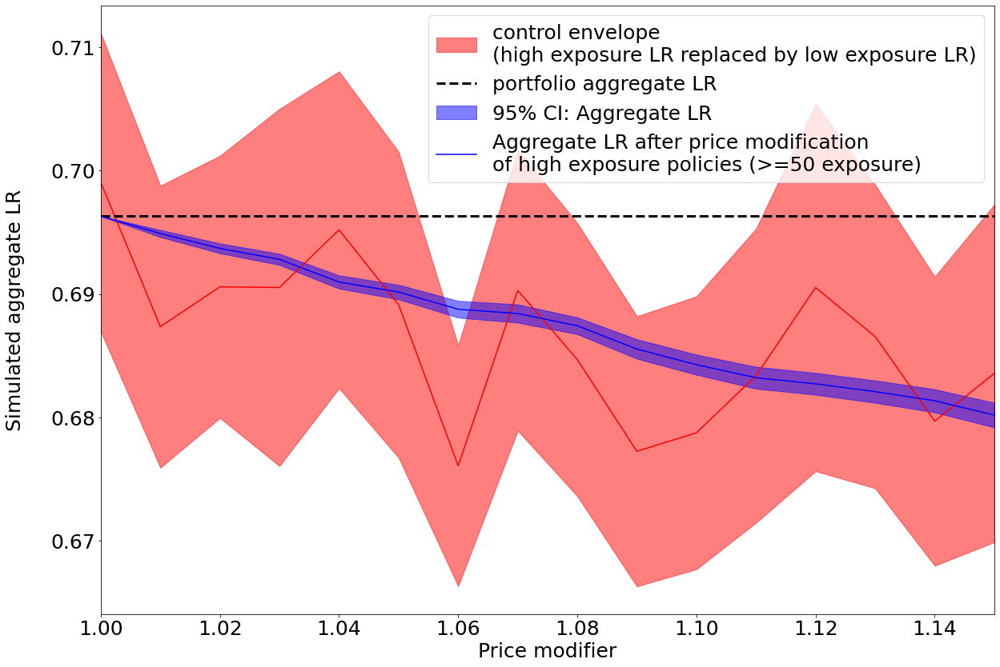

In [268]:
plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Price modifier", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
lower = np.array(reference_mean_lrs) - np.array(reference_std_lrs)
upper = np.array(reference_mean_lrs) + np.array(reference_std_lrs)
plt.fill_between(price_fractions, lower, upper, alpha=0.5, color='red', label='control envelope \n(high exposure LR replaced by low exposure LR)')
plt.plot(price_fractions, reference_mean_lrs, color='red')
#plt.errorbar(price_fractions, reference_mean_lrs, yerr=reference_std_lrs,  color='r', lw=2, label='control \n(high exposure LR replaced by low exposure LR)')

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1.0, 1.15], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
lower_agg = np.array(price_change_mean_lrs) - np.array(price_change_std_lrs)
upper_agg = np.array(price_change_mean_lrs) + np.array(price_change_std_lrs)
plt.fill_between(price_fractions, lower_agg, upper_agg, alpha=0.5, color='b', label='95% CI: Aggregate LR')
plt.plot(price_fractions, price_change_mean_lrs, color='b', label='Aggregate LR after price modification\nof high exposure policies (>=50 exposure)', zorder = 2.5)

#plt.plot(price_fractions, price_change_lrs, color='b', label='aggregate loss ratio after price modification\nof high exposure policies (>=50 exposure)', zorder = 2.5)
plt.xlim(1.0, 1.15)
plt.legend(loc='best', fontsize=fontsize)
#plt.gca().invert_xaxis()
plt.savefig("simulated_pricing_exposure_effect_elasticity_w_control_envelope.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
print((premiums_mean[0] - premiums_mean[-1])/premiums_mean[0])

In [109]:
preprocess_df_incl_lossnpremium["effective_year"].value_counts()

2011    6477
2012    5697
2019    3909
2018    3903
2021    3885
2020    3880
2017    3753
2016    3495
2015    2930
2013    2829
2014    2086
Name: effective_year, dtype: int64

In [125]:
def formatter(x, pos):
    return str(round(x / 1e6, 2)) + " M"

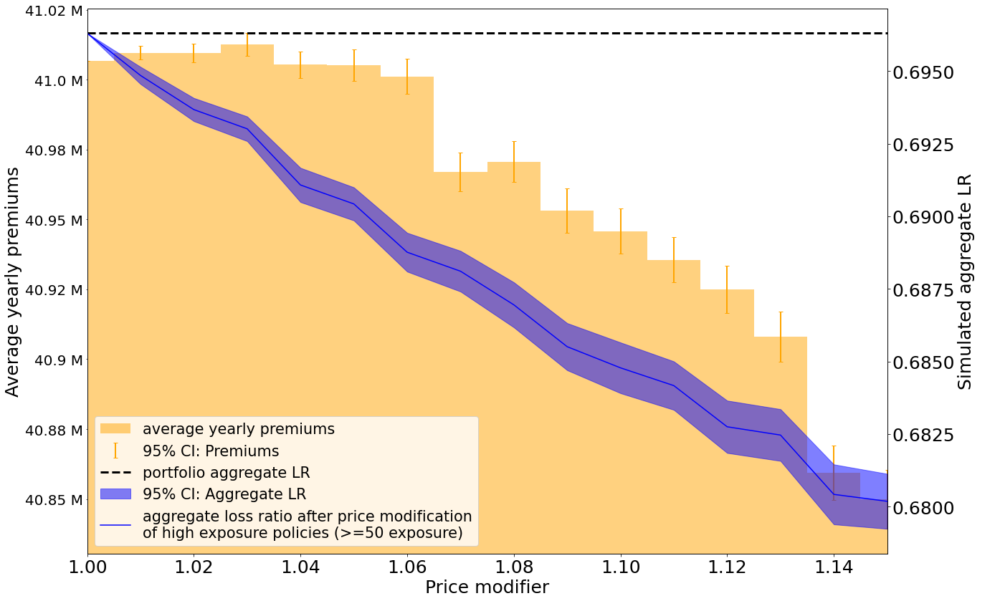

In [130]:
fontsize=25
import matplotlib
fig, ax = plt.subplots()
#matplotlib.rc('ytick', labelsize=20)
ax.set_yscale('log')

ax.yaxis.set_major_formatter(formatter)
ax.yaxis.set_minor_formatter(formatter)

plt.ylabel("Average yearly premiums", fontsize= fontsize/1.0)
plt.xlabel("Price modifier", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
plt.bar(price_fractions, np.array(premiums_mean)/(11.0), 
        color='orange', alpha=0.5, width=0.01, label='average yearly premiums')
plt.errorbar(price_fractions,  np.array(premiums_mean)/(11.0), yerr=np.array(premiums_std)/(11.0), fmt='none', color='orange', lw=2, label='95% CI: Premiums', capsize=3)
#plt.text(1, 4.51*10**8, "in millions")#  ha = "left", va = "top")
plt.twinx()
plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Price modifier", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
# lower = np.array(reference_mean_lrs) - np.array(reference_std_lrs)
# upper = np.array(reference_mean_lrs) + np.array(reference_std_lrs)
# plt.fill_between(price_fractions, lower, upper, alpha=0.5, color='red', label='control envelope \n(high exposure LR replaced by low exposure LR)')
# plt.plot(price_fractions, reference_mean_lrs, color='red')
#plt.errorbar(price_fractions, reference_mean_lrs, yerr=reference_std_lrs,  color='r', lw=2, label='control \n(high exposure LR replaced by low exposure LR)')

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1.0, 1.15], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
lower_agg = np.array(price_change_mean_lrs) - np.array(price_change_std_lrs)
upper_agg = np.array(price_change_mean_lrs) + np.array(price_change_std_lrs)
plt.fill_between(price_fractions, lower_agg, upper_agg, alpha=0.5, color='b', label='95% CI: Aggregate LR')
plt.plot(price_fractions, price_change_mean_lrs, color='b', label='aggregate loss ratio after price modification\nof high exposure policies (>=50 exposure)', zorder = 2.5)

#plt.plot(price_fractions, price_change_lrs, color='b', label='aggregate loss ratio after price modification\nof high exposure policies (>=50 exposure)', zorder = 2.5)
plt.xlim(1.0, 1.15)
fig = plt.gcf()
handles = []
labels = []
for ax in fig.axes:
    for h, l in zip(*ax.get_legend_handles_labels()):
        handles.append(h)
        labels.append(l)
    
plt.legend(handles, labels, loc='best', fontsize=fontsize/1.2)
#plt.gca().invert_xaxis()
plt.savefig("simulated_pricing_exposure_effect_elasticity_updated.png", dpi=300, bbox_inches='tight')
plt.show()

What happens when excluding policies:

In [538]:
preprocess_df_incl_lossnpremium["exposure"].describe()

count    42844.000000
mean         3.356316
std          9.689820
min          0.500000
25%          1.000000
50%          1.000000
75%          2.000000
max        250.000000
Name: exposure, dtype: float64

[50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250]
[0.6898525350647453, 0.7264660985067322, 0.7176755843948766, 0.7112865759324162, 0.7093037868516416, 0.7068837506969571, 0.7031064093980826, 0.6967347707646191, 0.6999787207284787, 0.6918264904878748, 0.6992929176218561, 0.7000738778932897, 0.6969785480142421, 0.6961707324256179, 0.6947586232233017, 0.6971412285392093, 0.6962142184044243, 0.6949256393397458, 0.6974785827571414, 0.6968781298029283, 0.6963104167494422]


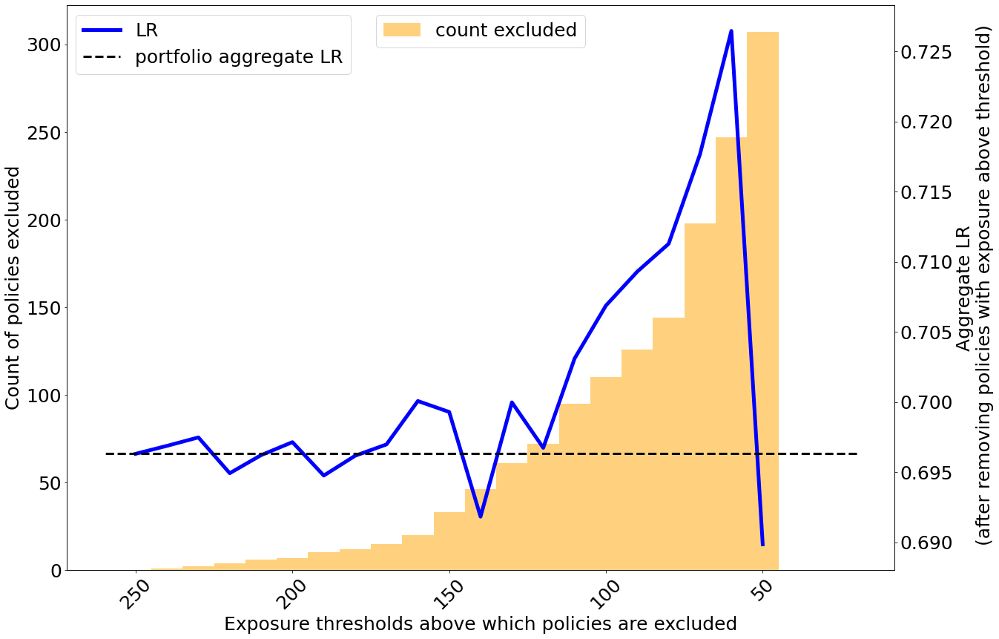

In [206]:
exposure_thresholds = [50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250] 

historical_exposure = preprocess_df_incl_lossnpremium["exposure"].reset_index(drop=True)
idx_keep_historical = {k:historical_exposure[historical_exposure <= k].index.tolist() for k in exposure_thresholds}

#print(idx_keep_historical)
lrs_ideal_historical = {k: np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"].reset_index(level=0, drop=True).iloc[idx_keep_historical[k]])\
                                    /np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"].reset_index(level=0, drop=True).iloc[idx_keep_historical[k]]) for k in exposure_thresholds}

fontsize=25

print(list(lrs_ideal_historical.keys()))
print([lrs_ideal_historical[key] for key in lrs_ideal_historical.keys()])

plt.ylabel("Count of policies excluded", fontsize= fontsize)
plt.xlabel("Exposure thresholds above which policies are excluded", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.bar(list(lrs_ideal_historical.keys()), [preprocess_df_incl_lossnpremium.shape[0] - len(idx_keep_historical[key]) for key in lrs_ideal_historical.keys()], 
        color='orange', alpha=0.5, width=10, label='count excluded')
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)

#legend1.remove()

plt.legend(fontsize=fontsize, loc='upper center')
plt.xticks(size = fontsize, rotation=45)

ax = plt.twinx()

plt.ylabel("Aggregate LR\n (after removing policies with exposure above threshold)", fontsize= fontsize)

plt.plot(list(lrs_ideal_historical.keys()), [lrs_ideal_historical[key] for key in lrs_ideal_historical.keys()], lw=5, c='b', label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([20, 260], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)

plt.legend(fontsize=fontsize)
plt.xlabel("Exposure thresholds above which policies are excluded", fontsize = fontsize)
plt.gca().invert_xaxis()
# plt.xlim(100, 70)
# plt.ylim(0.62, 0.74)
plt.savefig("removal_impact_exposusure.png", dpi=300, bbox_inches='tight')
plt.show()

#print([historical_exposure - lrs_ideal_historical[key] for key in lrs_ideal_historical.keys()])

^ Obviously the above is not promising. The more we throw away at high exposures, the greater potential to throw away cash cow policies that are actually performing well. Instead, let's simulate what would happend if we restructured a portfolio, sampling with replacement, but with lower probabilities for > 50 exposures:

## For max_detailed_aop_pct

In [166]:
def mc_sim_portfolio_detailed(target_percentage_bad, target_feature, threshold_bad_feat_lt, df, iterations):

    bad_policies_prob = target_percentage_bad/df[df[target_feature]<threshold_bad_feat_lt].shape[0]
    good_policies_prob = (1.0 - target_percentage_bad)/df[df[target_feature]>=threshold_bad_feat_lt].shape[0]

    template_df = df.copy()
    template_df["probability"] = template_df.apply(lambda row: bad_policies_prob if row[target_feature] < threshold_bad_feat_lt else good_policies_prob, axis=1)
    template_df = template_df[[target_feature, "probability", "ultimate_loss_trended", "onlevel_premium"]]

    sample_lrs = []
    total_premiums = []
    
    for i in range(iterations):
        sample_df = template_df.sample(n=template_df.shape[0], replace=True, weights = "probability")
        sample_lr = np.sum(sample_df["ultimate_loss_trended"])/np.sum(sample_df["onlevel_premium"])
        sample_lrs.append(sample_lr)
        
        total_premiums.append(sample_df["onlevel_premium"].sum())

    return np.mean(sample_lrs), np.std(sample_lrs)/np.sqrt(len(sample_lrs)), np.mean(total_premiums), np.std(total_premiums)/np.sqrt(len(total_premiums))

In [354]:
def mc_sim_portfolio_priceincrease_detailed(target_price_increase, target_feature, threshold_bad_feat_lt, df, iterations):

    # first apply price increase to policies above threshold
    idx_below_threshold = df[df[target_feature] < threshold_bad_feat_lt].index.tolist()
    idx_above_threshold = df[df[target_feature] >= threshold_bad_feat_lt].index.tolist()
    
    target_premiums = df["onlevel_premium"].iloc[idx_below_threshold].apply(lambda x: target_price_increase*x).tolist()
    target_losses = df["ultimate_loss_trended"].iloc[idx_below_threshold].tolist()
    
    unchanged_premiums = df["onlevel_premium"].iloc[idx_above_threshold].tolist()
    unchanged_losses = df["ultimate_loss_trended"].iloc[idx_above_threshold].tolist()
    
    updated_aggregate = (np.sum(target_losses) + np.sum(unchanged_losses))/ (np.sum(target_premiums) + np.sum(unchanged_premiums))
    other_aggregate = np.sum(df["ultimate_loss_trended"])/np.sum(df["onlevel_premium"])
    
    # control simply should be selecting the same amount above but at random and increasing the price
    reference_agg_lrs = []
    for i in range(iterations):
        sample_idx = np.random.choice(df.index.tolist(), size=len(idx_below_threshold), replace=False)
        unchanged_idx = list(set(preprocess_df_incl_lossnpremium.index.tolist()) - set(sample_idx))
        sample_df = df.iloc[sample_idx]
        unchanged_df = df.iloc[unchanged_idx]
        
        original_losses = unchanged_df["ultimate_loss_trended"].tolist()
        original_premiums = unchanged_df["onlevel_premium"].tolist()
        
        sample_losses = sample_df["ultimate_loss_trended"].tolist()
        sample_premiums = sample_df["onlevel_premium"].apply(lambda x: target_price_increase*x).tolist()
        
        reference_aggregate = (np.sum(sample_losses) + np.sum(original_losses))/ (np.sum(sample_premiums) + np.sum(original_premiums))
        reference_agg_lrs.append(reference_aggregate)
    
    return updated_aggregate, np.mean(reference_agg_lrs), np.std(reference_agg_lrs)/np.sqrt(len(reference_agg_lrs))

In [100]:
def mc_sim_portfolio_priceincrease_detailed_elasticity(target_price_increase, target_feature, threshold_bad_feat_lt, df, iterations):

    # first apply price increase to policies above threshold
    idx_below_threshold = df[df[target_feature] < threshold_bad_feat_lt].index.tolist()
    idx_above_threshold = df[df[target_feature] >= threshold_bad_feat_lt].index.tolist()
    
    percent_drop = target_price_increase - 1.0
    temp_below_threshold = np.array(idx_below_threshold)
    
    agg_lrs = []
    reference_agg_lrs = []
    premiums = []
    for i in range(iterations):
        
        # randomly drop percentage of these policies that equals the target price increase percentage (accounting for elasticity)
        selected_rmvl_idx = random.sample(range(len(temp_below_threshold)), int(percent_drop*len(temp_below_threshold)))
        idx_below_threshold = list(np.setdiff1d(temp_below_threshold, temp_below_threshold[selected_rmvl_idx]))

        target_premiums = df["onlevel_premium"].iloc[idx_below_threshold].apply(lambda x: target_price_increase*x).tolist()
        target_losses = df["ultimate_loss_trended"].iloc[idx_below_threshold].tolist()
    
        unchanged_premiums = df["onlevel_premium"].iloc[idx_above_threshold].tolist()
        unchanged_losses = df["ultimate_loss_trended"].iloc[idx_above_threshold].tolist()
    
        updated_aggregate = (np.sum(target_losses) + np.sum(unchanged_losses))/ (np.sum(target_premiums) + np.sum(unchanged_premiums))
 
        premiums.append(np.sum(target_premiums) + np.sum(unchanged_premiums))
        agg_lrs.append(updated_aggregate)
        
        # now sample to produce reference values for control envelope
        sample_idx = np.random.choice(df.index.tolist(), size=len(idx_below_threshold), replace=False)
        unchanged_idx = list(set(preprocess_df_incl_lossnpremium.index.tolist()) - set(sample_idx))
        sample_df = df.iloc[sample_idx]
        unchanged_df = df.iloc[unchanged_idx]
        
        original_losses = unchanged_df["ultimate_loss_trended"].tolist()
        original_premiums = unchanged_df["onlevel_premium"].tolist()
        
        sample_losses = sample_df["ultimate_loss_trended"].tolist()
        sample_premiums = sample_df["onlevel_premium"].apply(lambda x: target_price_increase*x).tolist()
        
        reference_aggregate = (np.sum(sample_losses) + np.sum(original_losses))/ (np.sum(sample_premiums) + np.sum(original_premiums))
        reference_agg_lrs.append(reference_aggregate)
        
    return np.mean(agg_lrs), np.std(agg_lrs)/np.sqrt(len(agg_lrs)), np.mean(reference_agg_lrs), np.std(reference_agg_lrs)/np.sqrt(len(reference_agg_lrs)), np.mean(premiums), np.std(premiums)/np.sqrt(len(premiums))

In [152]:
idx_to_change = np.random.choice(preprocess_df_incl_lossnpremium.index.tolist(), size=10, replace=False)
idx_unchanged = list(set(preprocess_df_incl_lossnpremium.index.tolist()) - set(idx_to_change))

In [168]:
aggregate_means_detailed = []
aggregate_stds_detailed = []
high_exposure_fractions_detailed = []

premiums_mean_detailed = []
premiums_stds_detailed = []

for thresh in np.arange(0.25, 0.00, -0.02):
    mean_aggregate, std_aggregate, mean_premiums, std_premiums = mc_sim_portfolio_detailed(thresh, "max_detailed_aop_pct", 40, preprocess_df_incl_lossnpremium, 5000)
    aggregate_means_detailed.append(mean_aggregate)
    aggregate_stds_detailed.append(std_aggregate * 1.96)
    
    premiums_mean_detailed.append(mean_premiums)
    premiums_stds_detailed.append(std_premiums * 1.96)
    
    high_exposure_fractions_detailed.append(thresh)

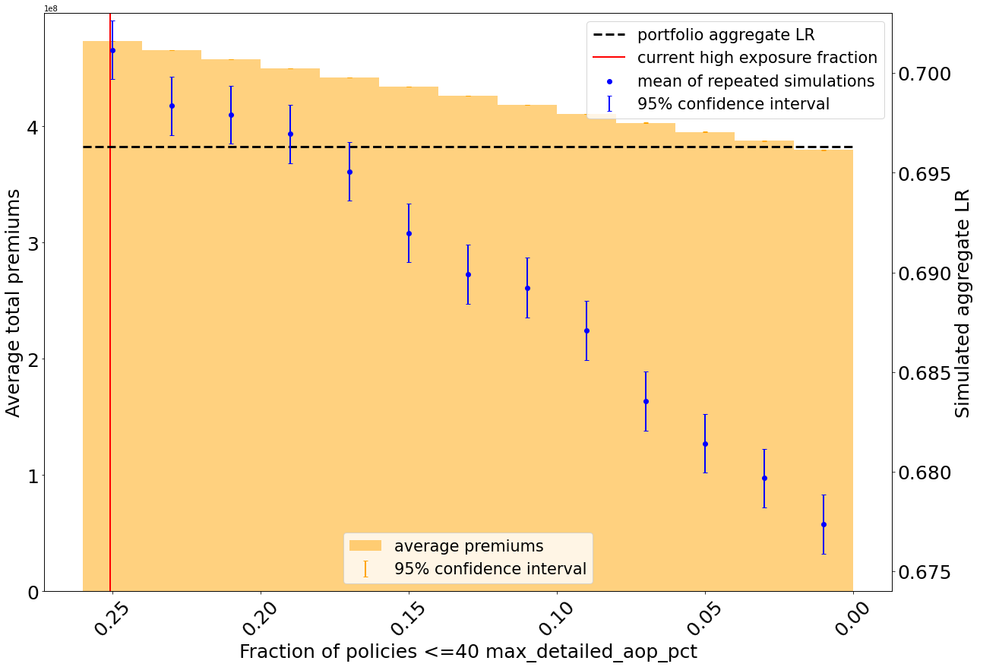

In [200]:
fontsize=25
plt.ylabel("Average total premiums", fontsize= fontsize)
plt.xlabel("Fraction of policies <=40 max_detailed_aop_pct", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.bar(high_exposure_fractions_detailed, premiums_mean_detailed, 
        color='orange', alpha=0.5, width=0.02, label='average premiums')
plt.errorbar(high_exposure_fractions_detailed,  premiums_mean_detailed, yerr=premiums_stds_detailed, fmt='none', color='orange', lw=2, label='95% confidence interval', capsize=3)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)

#legend1.remove()

plt.legend(fontsize=fontsize/1.2, loc='lower center')
plt.xticks(size = fontsize, rotation=45)

ax = plt.twinx()

plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Fraction of policies <=40 max_detailed_aop_pct", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([0.26, 0.2, 0.0] , [global_mean] * 3, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
curr_highdiver_fraction = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"] <=40].shape[0]/preprocess_df_incl_lossnpremium.shape[0]
plt.plot([curr_highdiver_fraction]*2, [0.674, 0.703], linestyle = '-', color='r', lw=2, label="current high exposure fraction", zorder=0)
plt.errorbar(high_exposure_fractions_detailed, aggregate_means_detailed, yerr=aggregate_stds_detailed, fmt='none', color='b', lw=2, label='95% confidence interval', capsize=3)
plt.scatter(high_exposure_fractions_detailed, aggregate_means_detailed,  color='b', label='mean of repeated simulations')

plt.gca().invert_xaxis()
plt.ylim(0.674, 0.703)




plt.legend(loc='upper right', fontsize=fontsize/1.2)
plt.savefig("simulated_max_detailed_effect.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
aggregate_means_premiumstest_detailed = []
aggregate_stds_premiumstest_detailed = []

premiums_mean_premiumstest_detailed = []
premiums_stds_premiumstest_detailed = []

high_exposure_fractions_premiumstest_detailed = []

iterations = 5000

low_premiums = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"] > 40]["onlevel_premium"].tolist())
low_loss = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"] > 40]["ultimate_loss_trended"].tolist())

high_premiums = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"] <= 40]["onlevel_premium"].tolist())
high_loss = np.array(preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"] <= 40]["ultimate_loss_trended"].tolist())

for thresh in np.arange(0.25, 0.00, -0.02):
    
    lst_premiums = []
    lst_lr = []
    
    for i in range(iterations):
    
        agg_premiums, agg_lr = fun(low_premiums, low_loss, high_premiums, high_loss, thresh)
        
        lst_premiums.append(agg_premiums)
        lst_lr.append(agg_lr)
        
    aggregate_means_premiumstest_detailed.append(np.mean(lst_lr))
    aggregate_stds_premiumstest_detailed.append(np.std(lst_lr)/np.sqrt(len(lst_lr)) * 1.96) #95% confidence interval

    premiums_mean_premiumstest_detailed.append(np.mean(lst_premiums))
    premiums_stds_premiumstest_detailed.append(np.std(lst_premiums)/np.sqrt(len(lst_premiums)) * 1.96)
    high_exposure_fractions_premiumstest_detailed.append(thresh)

In [ ]:
np.save("agg_mean_premiumtest_detailed.npy", aggregate_means_premiumstest_detailed)
np.save("agg_stds_premiumtest_detailed.npy", aggregate_stds_premiumstest_detailed)
np.save("premiums_mean_premiumtest_detailed.npy", premiums_mean_premiumstest_detailed)
np.save("premiums_stds_premiumtest_detailed.npy", premiums_stds_premiumstest_detailed)

In [102]:
high_exposure_fractions_premiumstest_detailed = []

for thresh in np.arange(0.25, 0.00, -0.02):
    high_exposure_fractions_premiumstest_detailed.append(thresh)
    
aggregate_means_premiumstest_detailed = np.load("agg_mean_premiumtest_detailed.npy")
aggregate_stds_premiumstest_detailed = np.load("agg_stds_premiumtest_detailed.npy")
premiums_mean_premiumstest_detailed = np.load("premiums_mean_premiumtest_detailed.npy")
premiums_stds_premiumstest_detailed = np.load("premiums_stds_premiumtest_detailed.npy")

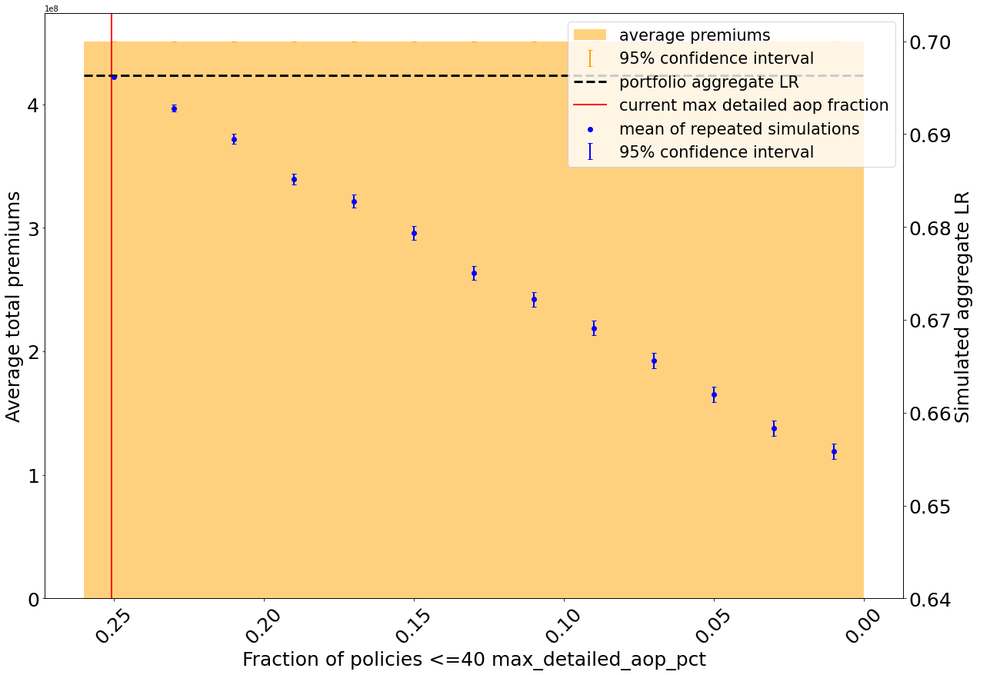

In [108]:
fontsize=25
plt.ylabel("Average total premiums", fontsize= fontsize)
plt.xlabel("Fraction of policies <=40 max_detailed_aop_pct", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.bar(high_exposure_fractions_premiumstest_detailed, premiums_mean_premiumstest_detailed, 
        color='orange', alpha=0.5, width=0.02, label='average premiums')
plt.errorbar(high_exposure_fractions_premiumstest_detailed,  premiums_mean_premiumstest_detailed, yerr=premiums_stds_premiumstest_detailed, fmt='none', color='orange', lw=2, label='95% confidence interval', capsize=3)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)

#legend1.remove()

#plt.legend(fontsize=fontsize/1.2, loc='lower center')
plt.xticks(size = fontsize, rotation=45)

ax = plt.twinx()

plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Fraction of policies <=40 max_detailed_aop_pct", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([0.26, 0.2, 0.0] , [global_mean] * 3, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
curr_highdiver_fraction = preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"] <=40].shape[0]/preprocess_df_incl_lossnpremium.shape[0]
plt.plot([curr_highdiver_fraction]*2, [0.60, 0.703], linestyle = '-', color='r', lw=2, label="current max detailed aop fraction", zorder=0)
plt.errorbar(high_exposure_fractions_premiumstest_detailed, aggregate_means_premiumstest_detailed, yerr=aggregate_stds_premiumstest_detailed, fmt='none', color='b', lw=2, label='95% confidence interval', capsize=3)
plt.scatter(high_exposure_fractions_premiumstest_detailed, aggregate_means_premiumstest_detailed,  color='b', label='mean of repeated simulations')

plt.gca().invert_xaxis()

fig = plt.gcf()
handles = []
labels = []
for ax in fig.axes:
    for h, l in zip(*ax.get_legend_handles_labels()):
        handles.append(h)
        labels.append(l)
    
plt.legend(handles, labels, loc='upper right', fontsize=fontsize/1.2)
plt.ylim(0.64, 0.703)
#plt.legend(loc='upper right', fontsize=fontsize/1.2)
plt.savefig("simulated_max_detailed_effect_premiumstest.png", dpi=300, bbox_inches='tight')
plt.show()

Exploring price increase approach for max detailed aop:

In [97]:
price_change_lrs_detailed = []
reference_mean_lrs_detailed = []
reference_std_lrs_detailed = []

price_fractions_detailed = []
for thresh in np.arange(1.00, 1.16, 0.01):
    price_aggregate, mean_ref_aggregate, std_ref_aggregate = mc_sim_portfolio_priceincrease_detailed(thresh, "max_detailed_aop_pct", 40, preprocess_df_incl_lossnpremium, 10)
    
    price_change_lrs_detailed.append(price_aggregate)
    reference_mean_lrs_detailed.append(mean_ref_aggregate)
    reference_std_lrs_detailed.append(std_ref_aggregate * 1.96)
    
    price_fractions_detailed.append(thresh)

NameError: name 'mc_sim_portfolio_priceincrease_detailed' is not defined

In [499]:
preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"]<=40]["exposure"].mean()

4.386727475800447

In [500]:
preprocess_df_incl_lossnpremium[preprocess_df_incl_lossnpremium["max_detailed_aop_pct"]>40]["exposure"].mean()

3.0114330218068535

In [159]:
print(reference_std_lrs_detailed)

[1.2903001102030238e-17, 3.619629258327178e-06, 7.177158605386575e-06, 1.0637863779117057e-05, 1.3551939768154649e-05, 1.8786644987398386e-05, 2.1355602746638003e-05, 2.463353461303181e-05, 2.792076120132243e-05, 3.0827772555058515e-05, 3.199508931927558e-05, 3.639879280099607e-05, 3.969826002007347e-05, 4.4697753927259696e-05, 4.9299288700307255e-05, 4.971668681531134e-05]


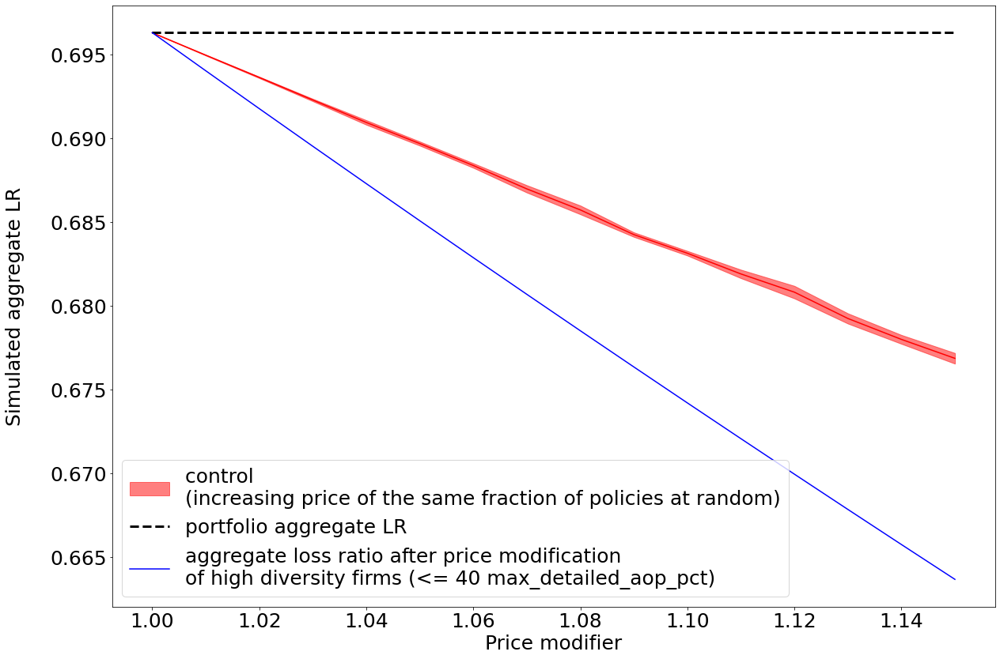

In [356]:
plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Price modifier", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
lower = np.array(reference_mean_lrs_detailed) - np.array(reference_std_lrs_detailed)
upper = np.array(reference_mean_lrs_detailed) + np.array(reference_std_lrs_detailed)
plt.plot(price_fractions_detailed, reference_mean_lrs_detailed, color='red')
plt.fill_between(price_fractions_detailed, lower, upper, alpha=0.5, color='red', label='control \n(increasing price of the same fraction of policies at random)')
#plt.errorbar(price_fractions, reference_mean_lrs, yerr=reference_std_lrs,  color='r', lw=2, label='control \n(high exposure LR replaced by low exposure LR)')

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1.0, 1.15], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
plt.plot(price_fractions_detailed, price_change_lrs_detailed, color='b', label='aggregate loss ratio after price modification\nof high diversity firms (<= 40 max_detailed_aop_pct)', zorder = 2.5)
plt.legend(loc='best', fontsize=fontsize)
#plt.gca().invert_xaxis()
plt.savefig("simulated_pricing_detailedaoppct_effect.png", dpi=300, bbox_inches='tight')
plt.show()

Exploring price increase approach for max detailed aop again but with elasticity:

In [101]:
price_change_mean_lrs_detailed = []
price_change_std_lrs_detailed = []
reference_mean_lrs_detailed = []
reference_std_lrs_detailed = []

premiums_mean_detailed = []
premiums_std_detailed = []
price_fractions_detailed = []
for thresh in np.arange(1.00, 1.16, 0.01):
    aggregate_mean, aggregate_std, ref_mean, ref_std, premium_mean, premium_std = mc_sim_portfolio_priceincrease_detailed_elasticity(thresh, "max_detailed_aop_pct", 40, preprocess_df_incl_lossnpremium, 100)
    
    price_change_mean_lrs_detailed.append(aggregate_mean)
    price_change_std_lrs_detailed.append(aggregate_std * 1.96) # strictly conf interval
    
    reference_mean_lrs_detailed.append(ref_mean)
    reference_std_lrs_detailed.append(ref_std * 1.96)
    
    premiums_mean_detailed.append(premium_mean)
    premiums_std_detailed.append(premium_std * 1.96)
    
    price_fractions_detailed.append(thresh)

In [110]:
print(price_change_mean_lrs_detailed)

[0.6963104167494423, 0.6938202253782184, 0.6920388021224708, 0.6895288167143839, 0.6873021597228296, 0.6854209097423372, 0.682873581161757, 0.6803564507248244, 0.6775417007209221, 0.6772664727379017, 0.6769755212962464, 0.6740110265270591, 0.6713601639634831, 0.6684605185623107, 0.6676952657409302, 0.6631819850992062]


In [133]:
print(100*(price_change_mean_lrs_detailed[0] - price_change_mean_lrs_detailed[5])/price_change_mean_lrs_detailed[0])

1.6239922049908937


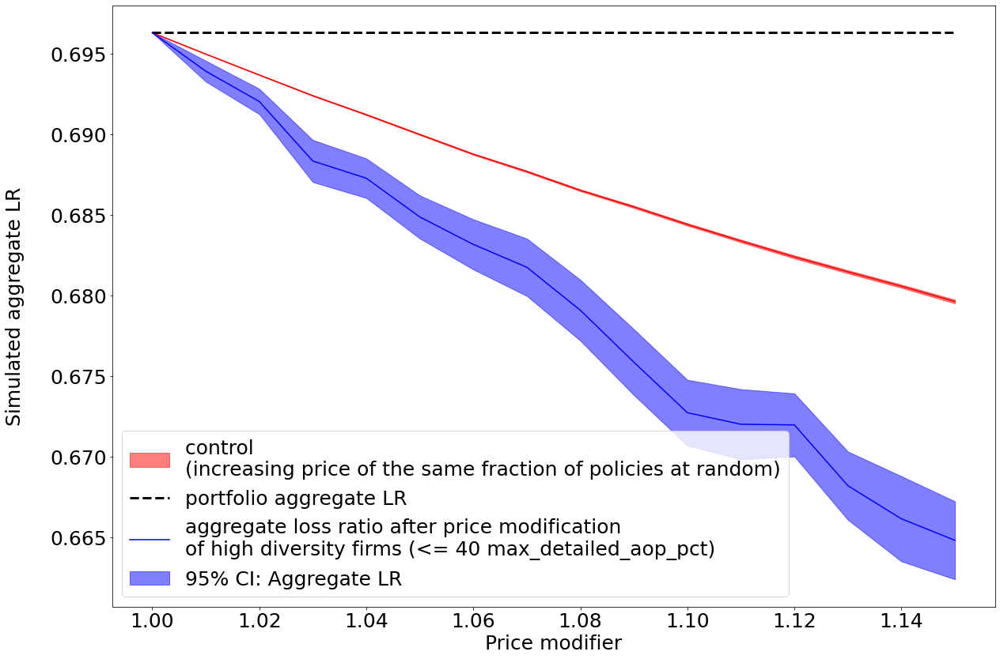

In [363]:
plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Price modifier", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
lower = np.array(reference_mean_lrs_detailed) - np.array(reference_std_lrs_detailed)
upper = np.array(reference_mean_lrs_detailed) + np.array(reference_std_lrs_detailed)
plt.plot(price_fractions_detailed, reference_mean_lrs_detailed, color='red')
plt.fill_between(price_fractions_detailed, lower, upper, alpha=0.5, color='red', label='control \n(increasing price of the same fraction of policies at random)')
#plt.errorbar(price_fractions, reference_mean_lrs, yerr=reference_std_lrs,  color='r', lw=2, label='control \n(high exposure LR replaced by low exposure LR)')

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1.0, 1.15], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
lower_agg = np.array(price_change_mean_lrs_detailed) - np.array(price_change_std_lrs_detailed)
upper_agg = np.array(price_change_mean_lrs_detailed) + np.array(price_change_std_lrs_detailed)
plt.plot(price_fractions_detailed, price_change_mean_lrs_detailed, color='b', label='aggregate loss ratio after price modification\nof high diversity firms (<= 40 max_detailed_aop_pct)', zorder = 2.5)
plt.fill_between(price_fractions_detailed, lower_agg, upper_agg, alpha=0.5, color='b', label='95% CI: Aggregate LR')
plt.legend(loc='best', fontsize=fontsize)
#plt.gca().invert_xaxis()
plt.savefig("simulated_pricing_detailedaoppct_effect_elasticity_w_control_envelope.png", dpi=300, bbox_inches='tight')
plt.show()

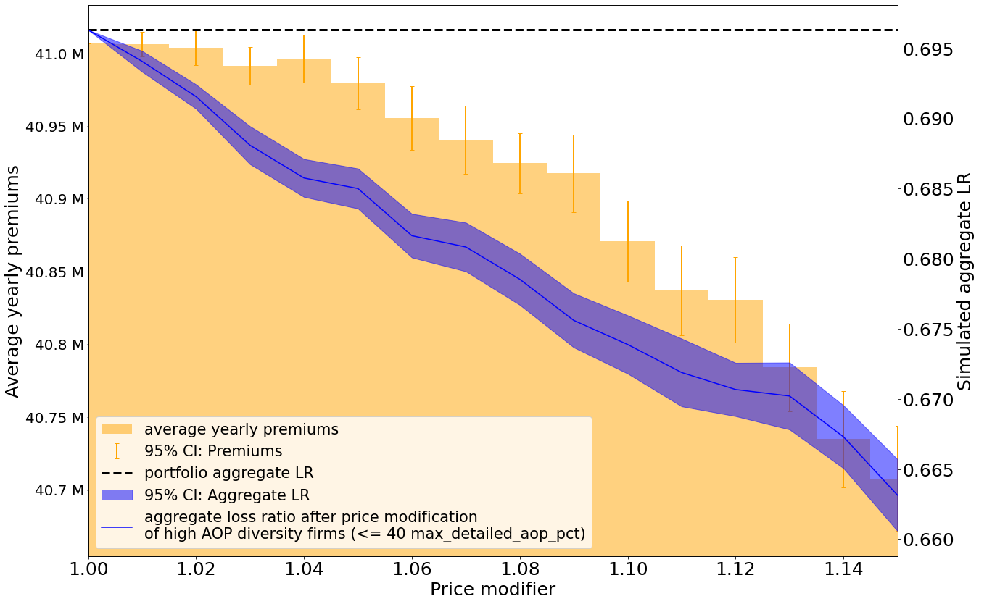

In [132]:
fontsize=25
import matplotlib
fig, ax = plt.subplots()
#matplotlib.rc('ytick', labelsize=20)
ax.set_yscale('log')
ax.yaxis.set_major_formatter(formatter)
ax.yaxis.set_minor_formatter(formatter)
plt.ylabel("Average yearly premiums", fontsize= fontsize/1.0)
plt.xlabel("Price modifier", fontsize = fontsize)
plt.yticks(size = fontsize)
plt.xticks(size = fontsize)
plt.bar(price_fractions_detailed, np.array(premiums_mean_detailed)/11.0, 
        color='orange', alpha=0.5, width=0.01, label='average yearly premiums')
plt.errorbar(price_fractions_detailed,  np.array(premiums_mean_detailed)/11.0, yerr=np.array(premiums_std_detailed)/11.0, fmt='none', color='orange', lw=2, label='95% CI: Premiums', capsize=3)

plt.twinx()
plt.ylabel("Simulated aggregate LR\n ", fontsize= fontsize)
plt.xlabel("Price modifier", fontsize = fontsize)

#plt.plot(high_exposure_fractions, aggregate_means, label='LR')
plt.yticks(size= fontsize)
plt.xticks(size = fontsize)
# lower = np.array(reference_mean_lrs) - np.array(reference_std_lrs)
# upper = np.array(reference_mean_lrs) + np.array(reference_std_lrs)
# plt.fill_between(price_fractions, lower, upper, alpha=0.5, color='red', label='control envelope \n(high exposure LR replaced by low exposure LR)')
# plt.plot(price_fractions, reference_mean_lrs, color='red')
#plt.errorbar(price_fractions, reference_mean_lrs, yerr=reference_std_lrs,  color='r', lw=2, label='control \n(high exposure LR replaced by low exposure LR)')

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1.0, 1.15], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)
lower_agg = np.array(price_change_mean_lrs_detailed) - np.array(price_change_std_lrs_detailed)
upper_agg = np.array(price_change_mean_lrs_detailed) + np.array(price_change_std_lrs_detailed)
plt.fill_between(price_fractions_detailed, lower_agg, upper_agg, alpha=0.5, color='b', label='95% CI: Aggregate LR')
plt.plot(price_fractions_detailed, price_change_mean_lrs_detailed, color='b', label='aggregate loss ratio after price modification\nof high AOP diversity firms (<= 40 max_detailed_aop_pct)', zorder = 2.5)

#plt.plot(price_fractions, price_change_lrs, color='b', label='aggregate loss ratio after price modification\nof high exposure policies (>=50 exposure)', zorder = 2.5)
plt.xlim(1.0, 1.15)
fig = plt.gcf()
handles = []
labels = []
for ax in fig.axes:
    for h, l in zip(*ax.get_legend_handles_labels()):
        handles.append(h)
        labels.append(l)
    
plt.legend(handles, labels, loc='best', fontsize=fontsize/1.2)
#plt.gca().invert_xaxis()
plt.savefig("simulated_pricing_detailedaop_effect_elasticity_updated.png", dpi=300, bbox_inches='tight')
plt.show()

In [530]:
historical_max_detailed_aop = preprocess_df_incl_lossnpremium["max_detailed_aop_pct"].reset_index(drop=True)
np.percentile(historical_max_detailed_aop, 40)

50.0

[5.0, 10.0, 15.0, 20.0, 25.0, 30, 35, 40]
[0.6963104167494422, 0.6963104167494422, 0.7007018006567778, 0.7097685102947686, 0.7097570179237638, 0.7351307100558018, 0.7222448267401851, 0.675343392580966]


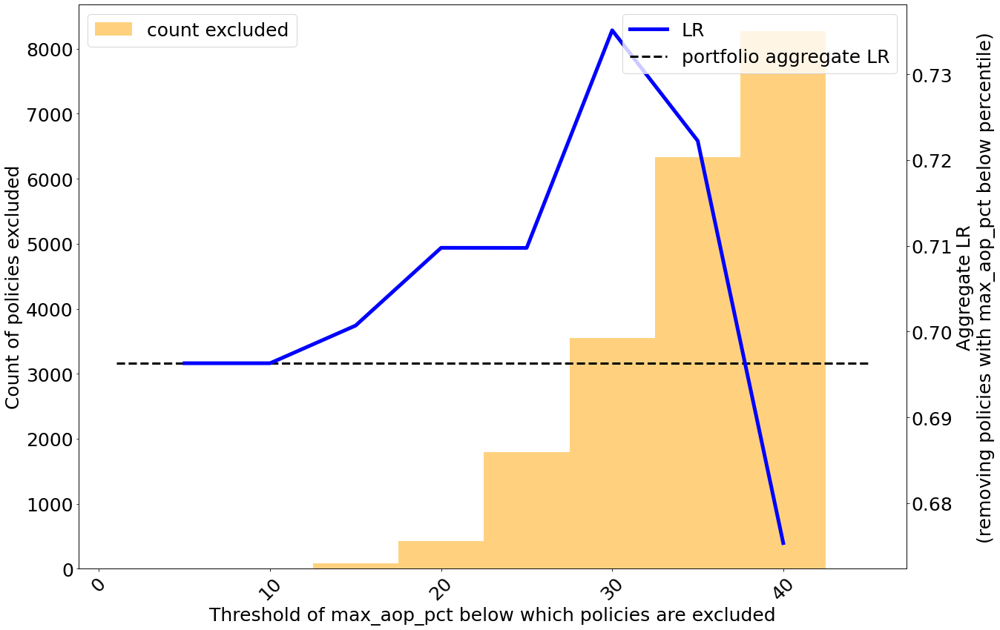

In [545]:
max_detailed_aop_thresholds = [5.0, 10.0, 15.0, 20.0, 25.0, 30, 35, 40] 

historical_max_detailed_aop = preprocess_df_incl_lossnpremium["max_detailed_aop_pct"].reset_index(drop=True)
idx_keep_historical = {k:historical_max_detailed_aop[historical_max_detailed_aop >= k].index.tolist() for k in max_detailed_aop_thresholds}

#print(idx_keep_historical)
lrs_ideal_historical = {k: np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"].reset_index(level=0, drop=True).iloc[idx_keep_historical[k]])\
                                    /np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"].reset_index(level=0, drop=True).iloc[idx_keep_historical[k]]) for k in max_detailed_aop_thresholds}

fontsize=25

print(list(lrs_ideal_historical.keys()))
print([lrs_ideal_historical[key] for key in lrs_ideal_historical.keys()])

plt.ylabel("Count of policies excluded", fontsize= fontsize)
plt.yticks(size= fontsize)
plt.bar(list(lrs_ideal_historical.keys()), [preprocess_df_incl_lossnpremium.shape[0] - len(idx_keep_historical[key]) for key in lrs_ideal_historical.keys()], 
        color='orange', alpha=0.5, width=5.0, label='count excluded', zorder=-1)
plt.legend(fontsize=fontsize, loc='upper left')
plt.xlabel("Threshold of max_aop_pct below which policies are excluded", fontsize = fontsize)
plt.yticks(size= fontsize)
plt.xticks(size = fontsize, rotation=45)
#plt.title("binned actual vs predicted plot for truncated regression model (all years, total set)", fontsize = fontsize)
ax = plt.twinx()

plt.plot(list(lrs_ideal_historical.keys()), [lrs_ideal_historical[key] for key in lrs_ideal_historical.keys()], lw=5, c='b', label='LR', zorder=3)

global_mean = np.sum(preprocess_df_incl_lossnpremium["ultimate_loss_trended"])/np.sum(preprocess_df_incl_lossnpremium["onlevel_premium"])
plt.plot([1, 45], [global_mean] * 2, label="portfolio aggregate LR", linestyle = '--', color='k', lw=3)

plt.ylabel("Aggregate LR\n(removing policies with max_aop_pct below percentile)", fontsize= fontsize)

plt.legend(fontsize=fontsize, loc="upper right")
plt.xticks(size = fontsize, rotation=45)
plt.yticks(size = fontsize)
#plt.gca().invert_xaxis()
# plt.xlim(100, 70)
# plt.ylim(0.62, 0.74)
plt.savefig("removal_impact_max_detailed_aop_pct.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
preproce

# business types (aops) kept vs. thrown away

In [362]:
with open("XGBv14_best_estimator_classifier_ND.pkl", 'rb') as file:
    xgb_cls = joblib.load(file)

gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, y_train_labeled, groups=train_df['policy_id'])
y_prob_pred_xgb = cross_val_predict(xgb_cls, X_train, y_train_labeled, cv = splitter_cv, method='predict_proba')[:, 1]

`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.
`use_label_encoder` is deprecated in 1.7.0.


In [450]:
dominant_aops_excluded_5 = X_train['max_detailed_aop'].reset_index(drop=True)[[i for i in range(len(y_prob_pred_xgb)) if y_prob_pred_xgb[i] > np.percentile(y_prob_pred_xgb, 95)]].values
dominant_aops = X_train["max_detailed_aop"].values

aop_ranks_excluded = pd.DataFrame(dominant_aops_excluded_5).value_counts().rank(method="dense")
aop_ranks_all = pd.DataFrame(dominant_aops).value_counts().rank(method="dense")

aop_ranks_excluded_allspace = (aop_ranks_excluded / aop_ranks_excluded.nunique()) * aop_ranks_all.nunique()
differences_allspace = aop_ranks_excluded_allspace - aop_ranks_all

top_10_abundant_excluded = [ele[0] for ele in aop_ranks_excluded_allspace.index][0:10]
differences_allspace[top_10_abundant_excluded].sort_values(ascending=False)

corporate_and_business_organization                      3.923077
commercial_and_business_litigation_defense               0.846154
personal_injury_and_negligence_defense                   0.769231
estate_probate_trust                                     0.000000
collection_bankruptcy                                   -2.384615
insurance_coverage                                      -3.538462
commercial_and_business_litigation_defense_plaintiff    -4.692308
personal_injury_and_negligence_plaintiff                -6.307692
family_law                                             -11.461538
residential_real_estate_closings                       -12.615385
Name: count, dtype: float64

In [459]:
aop_ranks_excluded_allspace

estate_probate_trust                                                     54.000000
corporate_and_business_organization                                      51.923077
commercial_and_business_litigation_defense                               49.846154
personal_injury_and_negligence_defense                                   47.769231
personal_injury_and_negligence_plaintiff                                 45.692308
collection_bankruptcy                                                    43.615385
family_law                                                               41.538462
insurance_coverage                                                       39.461538
residential_real_estate_closings                                         37.384615
commercial_and_business_litigation_defense_plaintiff                     35.307692
commercial_real_estate_closings                                          33.230769
commercial_real_estate_other                                             33.230769
othe

In [460]:
aop_ranks_all

estate_probate_trust                                                     54.0
family_law                                                               53.0
personal_injury_and_negligence_plaintiff                                 52.0
criminal                                                                 51.0
residential_real_estate_closings                                         50.0
commercial_and_business_litigation_defense                               49.0
corporate_and_business_organization                                      48.0
personal_injury_and_negligence_defense                                   47.0
collection_bankruptcy                                                    46.0
administrative_law                                                       45.0
commercial_real_estate_closings                                          44.0
insurance_coverage                                                       43.0
other                                                           

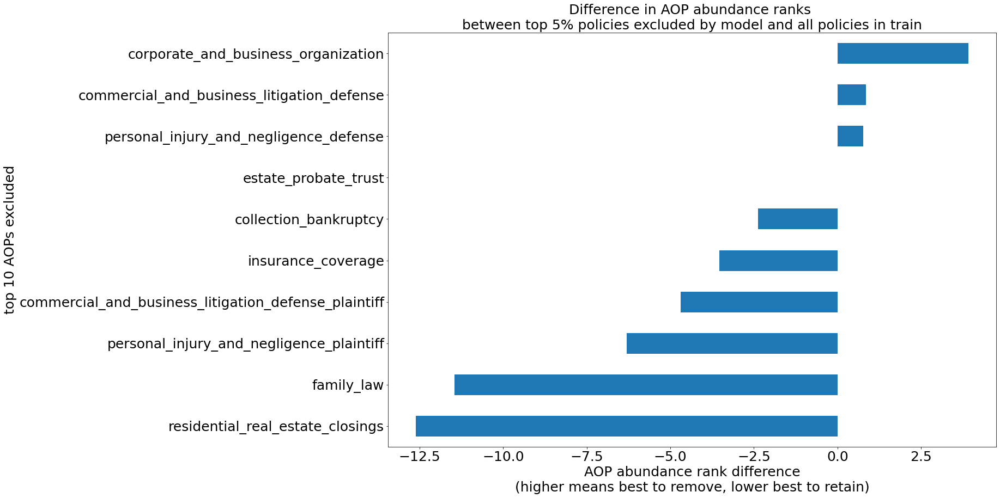

In [454]:
differences_allspace[top_10_abundant_excluded].sort_values().plot.barh()
plt.xlabel("AOP abundance rank difference\n(higher means best to remove, lower best to retain)", fontsize=25)
plt.ylabel("top 10 AOPs excluded",fontsize=25)
plt.xticks(size=25)
plt.yticks(ticks = range(0, len(differences_allspace[top_10_abundant_excluded])), labels=[ele[0] for ele in differences_allspace[top_10_abundant_excluded].sort_values().index], size=25)
plt.title("Difference in AOP abundance ranks \nbetween top 5% policies excluded by model and all policies in train", fontsize=25)
#plt.legend(loc='best', fontsize=fontsize)
plt.savefig("aop_ranks_model_exclusion.png", dpi=300, bbox_inches='tight')

plt.show()


In [455]:
preprocess_df[preprocess_df["max_detailed_aop"] == "corporate_and_business_organization"]["ultimate_trended_onlevel_lr"].describe()

count    2032.000000
mean        0.440486
std         6.062675
min         0.000000
25%         0.000000
50%         0.002064
75%         0.015496
max       213.566007
Name: ultimate_trended_onlevel_lr, dtype: float64

In [458]:
preprocess_df[preprocess_df["max_detailed_aop"] == "family_law"]["ultimate_trended_onlevel_lr"].describe()

count    6046.000000
mean        1.005135
std        22.468386
min         0.000000
25%         0.000000
50%         0.001819
75%         0.015257
max      1524.773986
Name: ultimate_trended_onlevel_lr, dtype: float64

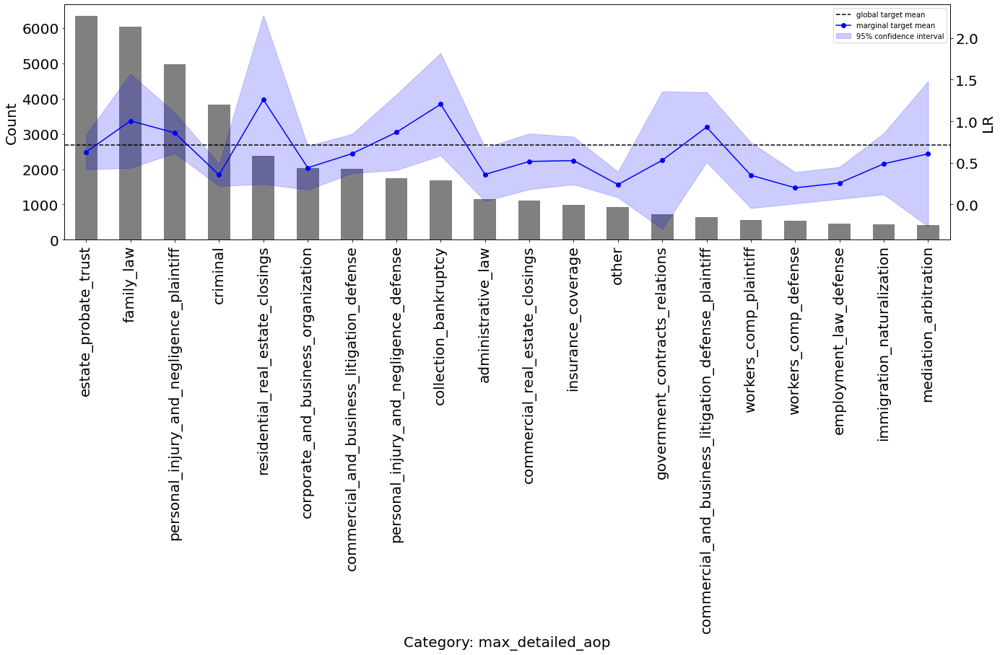

True

In [462]:
univariate_cat(preprocess_df, "max_detailed_aop", "ultimate_trended_onlevel_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "max_detailed_aop" + ".png", target_binary=False, fontsize=20, plot=True)

In [572]:
pd.DataFrame(dominant_aops_retained_1).value_counts()

estate_probate_trust                                                     4486
family_law                                                               4249
personal_injury_and_negligence_plaintiff                                 3452
criminal                                                                 2676
residential_real_estate_closings                                         1702
commercial_and_business_litigation_defense                               1456
corporate_and_business_organization                                      1286
personal_injury_and_negligence_defense                                   1173
collection_bankruptcy                                                    1121
administrative_law                                                        839
commercial_real_estate_closings                                           757
insurance_coverage                                                        695
other                                                           

In [563]:
X_train[['max_detailed_aop', 'max_detailed_aop_pct', 'max_detailed_aop_name']].value_counts()

max_detailed_aop                          max_detailed_aop_pct  max_detailed_aop_name                     
family_law                                100.00                family_law                                    949
personal_injury_and_negligence_plaintiff  100.00                personal_injury_and_negligence_plaintiff      494
criminal                                  100.00                criminal                                      493
estate_probate_trust                      100.00                estate_probate_trust                          458
                                          50.00                 estate_probate_trust                          454
                                                                                                             ... 
personal_injury_and_negligence_defense    98.49                 personal_injury_and_negligence_defense          1
insurance                                 30.00                 commercial_and_business_litigat

# feature cluster analysis

## creating XGB with filling to use in cluster analysis

In [125]:
def XGB_classification_specific_4clustering(train_for_cv_df, X_train, y_train, feature_subset, n_iterations, scorer, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, y_train, groups=train_for_cv_df['policy_id'])
    xgb_clf = xgb.XGBClassifier(n_jobs=6, use_label_encoder=False, tree_method='hist')
    
    start = time.time()

    param_grid = {
    'XGBoost__n_estimators': [50],
    'XGBoost__max_depth': [2],
    'XGBoost__gamma': [0.01],
    'XGBoost__colsample_bytree': [0.2],
    'XGBoost__subsample': [0.5],
    'XGBoost__eta': [0.1],
    'XGBoost__min_child_weight': [5],
    #'XGBoost__scale_pos_weight': [25, 30 ,35],
    'XGBoost__max_delta_step':[0]
    }
    
    numerical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="mean"))]
    )

    categorical_fill = Pipeline(
        steps=[("imputer", SimpleImputer(strategy="constant", fill_value='nothing'))]
    )
    
    if len(feature_subset) > 0:
        numeric = list(set(numerical_to_keep).intersection(set(feature_subset)))
        nominal = list(set(nominal_to_keep).intersection(set(feature_subset)))
    else:
        numeric = numerical_to_keep
        nominal = nominal_to_keep

    ohe = OneHotEncoder(handle_unknown="ignore", max_categories=10)
        
    fillna_transform = ColumnTransformer(
        transformers=[
            ("numerical", numerical_fill, numeric),
            ("nominal", categorical_fill, nominal)
        ])

    encode_transform = ColumnTransformer(
        transformers=[
            ("numerical", 'passthrough', numeric),
            ("nominal", ohe, nominal)
        ])
    
    columns_after_fill = numeric + nominal
    
    pipe = Pipeline(steps=[("fill_na", fillna_transform), ("topandas", PandasCastTransformer(columns = columns_after_fill)), ("encoding", encode_transform), ("XGBoost", xgb_clf)])

    xgb_search = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, scoring=scorer, 
                              cv=splitter_cv, n_jobs=-1, return_train_score=True, n_iter=n_iterations, verbose=1)

    xgb_search.fit(X_train, y_train)
    
    results = pd.DataFrame(xgb_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
        results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True)
            
    joblib.dump(xgb_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return xgb_search

In [132]:
XGB_search_clss = XGB_classification_specific_4clustering(train_df, X_train, y_train_labeled, feature_subset = [], n_iterations=1, scorer='roc_auc',
                          name_for_model= "XGBv14_best_estimator_classifier_filled_ND.pkl", name_for_results="LR_classification_ND.csv",
                          description = "Filledna XGB classification v11, fillna for clustering + removed max_detailed_aop (XGBv14_best_estimator_classifier_filled_ND.pkl)")

`use_label_encoder` is deprecated in 1.7.0.


Fitting 3 folds for each of 1 candidates, totalling 3 fits


`use_label_encoder` is deprecated in 1.7.0.


Time elapsed (in Sec): 54.93703317642212


In [302]:
X_comb = pd.concat([X_train, X_test], axis=0).reset_index(drop=True)
y_comb = pd.concat([y_train_labeled, y_test_labeled], axis=0).reset_index(drop=True)
y_comb_actual_lr = pd.concat([y_train, y_test], axis=0).reset_index(drop=True)
with open("XGBv14_best_estimator_classifier_filled_ND.pkl", 'rb') as file:
    lr_cls = joblib.load(file)
    
# generate SHAP values
X_shap = Pipeline(lr_cls.steps[:-1]).transform(X_comb).astype(np.double)

# pred = lr_cls.named_steps["LR"].predict(X_shap)
# print(pred)
explainer = shap.TreeExplainer(lr_cls.named_steps["XGBoost"])
shap_values = explainer.shap_values(X_shap)

PCA:

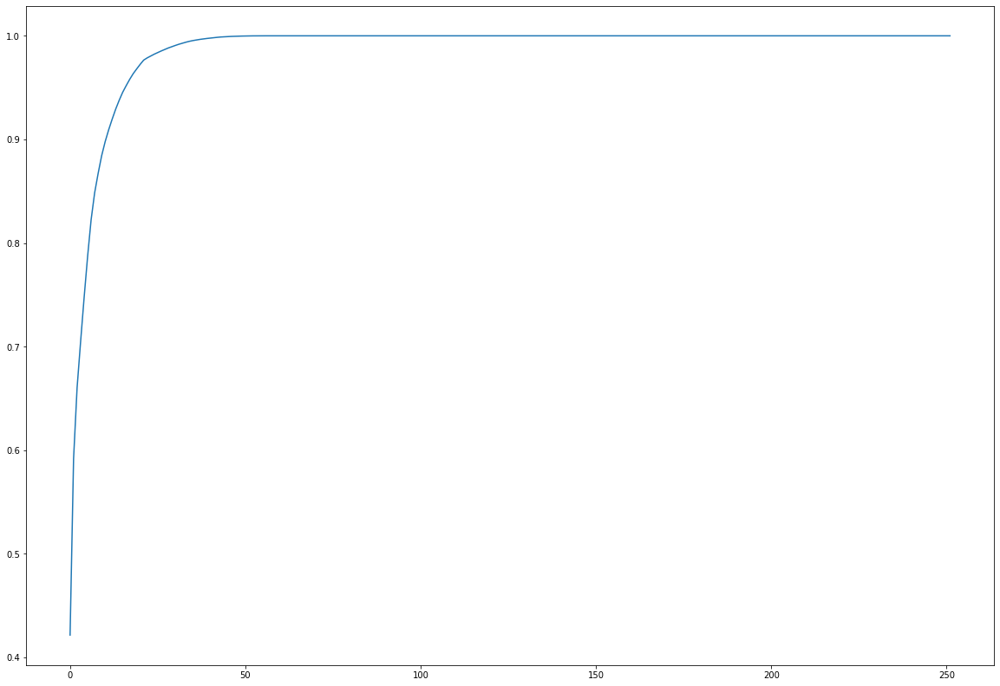

In [303]:
shap_1 = shap_values[np.where(y_comb==1)[0]]

pca = PCA(n_components=None)
pca.fit(shap_1)

cum_exp_variance = np.cumsum(pca.explained_variance_ratio_)
plt.plot(range(0, len(cum_exp_variance)), cum_exp_variance)
# print(pca.explained_variance_ratio_)

^ This suggests we should keep only the top 50 components for clustering

Simple elbow method for cluster number determination in k-means:

In [304]:
%%capture
shap_pca_transformed = pca.transform(shap_1)[:, 0:40]

sse = {}
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(shap_pca_transformed)
    #data["clusters"] = kmeans.labels_
    #print(data["clusters"])
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center

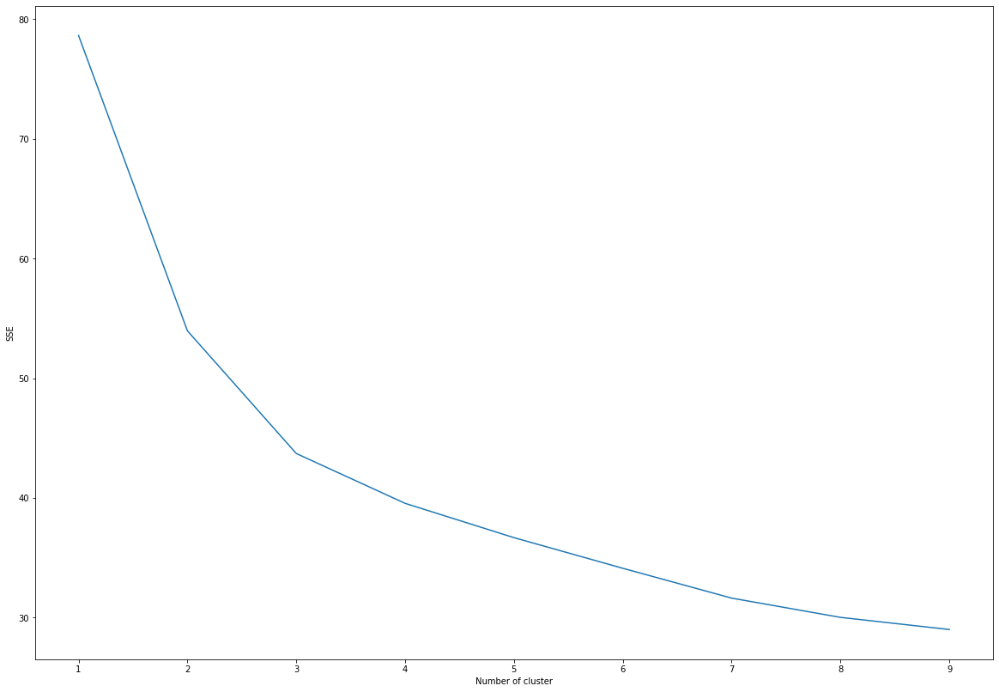

In [305]:
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()
plt.show()

In [313]:
%%capture
shap_pca_transformed = pca.transform(shap_1)[:, 0:40]

clustering = KMeans(n_clusters=3, random_state=40).fit(shap_pca_transformed)
print(clustering.labels_)
color_map = {0:'b', 1:'r', 2:'orange'}#, 3:'k'}

clustering_colors = [color_map[label] for label in clustering.labels_]

[<matplotlib.lines.Line2D object at 0x7f5c13a6e790>, <matplotlib.lines.Line2D object at 0x7f5c1dd61430>, <matplotlib.lines.Line2D object at 0x7f5c1e413760>]


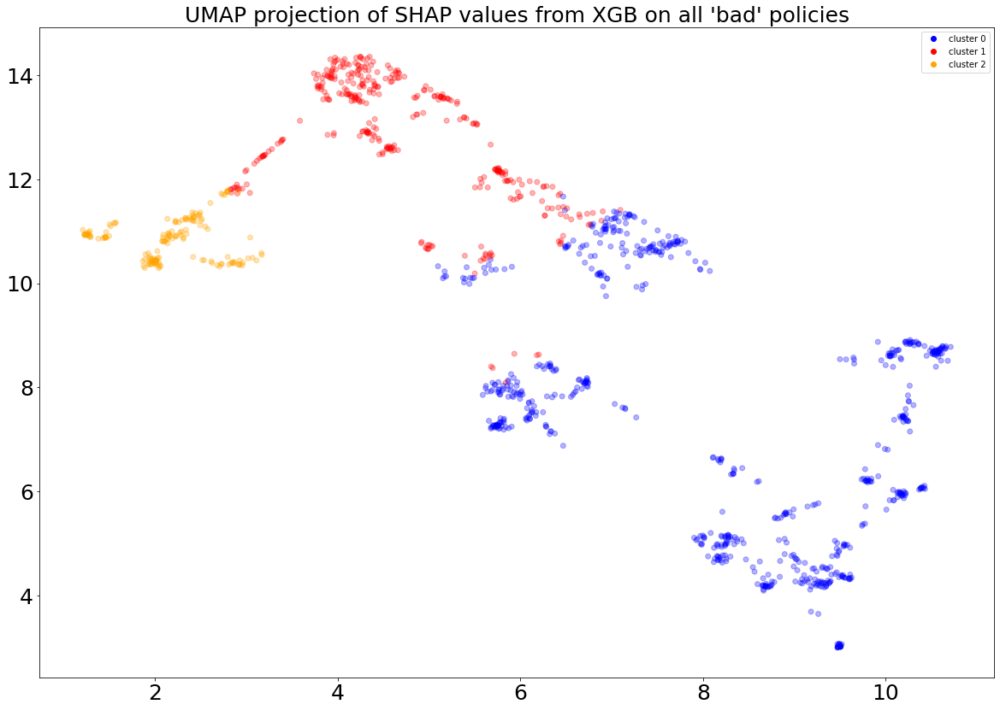

In [314]:
X_2d = umap.UMAP(n_neighbors=150, min_dist=0).fit_transform(shap_values[np.where(y_comb==1)[0]])
y_bad_lr = y_comb_actual_lr.iloc[np.where(y_comb==1)]

fontsize=20

plt.scatter(X_2d[:, 0], X_2d[:, 1], c=clustering_colors, alpha=0.3)

plt.title("UMAP projection of SHAP values from XGB on all 'bad' policies", fontsize=25)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

handlelist = [plt.plot([], marker="o", ls="", color=color)[0] for color in [color_map[i] for i in range(3)]]
labels = ["cluster 0", "cluster 1", "cluster 2"]#, "cluster 3"]
print(handlelist)
plt.legend(handlelist, labels, loc='best')

plt.savefig("UMAP_bad_policies.png", dpi=300, bbox_inches='tight')

Are any of these clusters actually 'special'? Meaning, are any of them actually enriched in more bad loss ratios than the others, such that it would indicate there is substructure in bad policies? Let's plot some 

count     705.000000
mean       33.138537
std        89.411090
min         0.575078
25%         3.162702
50%         9.628524
75%        30.699213
max      1524.773986
Name: ultimate_trended_onlevel_lr, dtype: float64
count    354.000000
mean      10.821916
std       19.188726
min        0.573632
25%        1.669841
50%        3.697232
75%       12.003690
max      194.974712
Name: ultimate_trended_onlevel_lr, dtype: float64
count    166.000000
mean      16.875106
std       33.145758
min        0.579961
25%        2.205998
50%        6.244074
75%       16.821961
max      272.506198
Name: ultimate_trended_onlevel_lr, dtype: float64


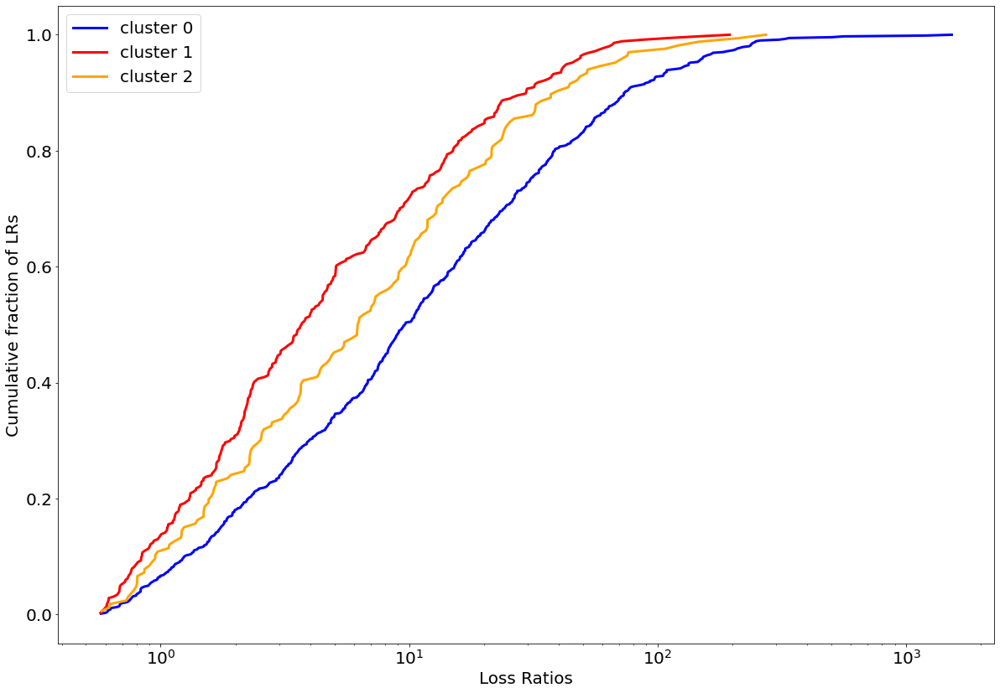

In [315]:
clust_0 = y_comb_actual_lr.iloc[np.where(y_comb==1)[0]].iloc[np.where(clustering.labels_==0)[0]]
clust_1 = y_comb_actual_lr.iloc[np.where(y_comb==1)[0]].iloc[np.where(clustering.labels_==1)[0]]
clust_2 = y_comb_actual_lr.iloc[np.where(y_comb==1)[0]].iloc[np.where(clustering.labels_==2)[0]]
# clust_3 = y_comb_actual_lr.iloc[np.where(y_comb==1)[0]].iloc[np.where(clustering.labels_==3)[0]]

print(clust_0.describe())
print(clust_1.describe())
print(clust_2.describe())
# print(clust_3.describe())

x_0, counts_0 = np.unique(clust_0, return_counts=True)
cusum_0 = np.cumsum(counts_0)

x_1, counts_1 = np.unique(clust_1, return_counts=True)
cusum_1 = np.cumsum(counts_1)

x_2, counts_2 = np.unique(clust_2, return_counts=True)
cusum_2 = np.cumsum(counts_2)

# x_3, counts_3 = np.unique(clust_3, return_counts=True)
# cusum_3 = np.cumsum(counts_3)

plt.plot(x_0, cusum_0/cusum_0[-1], color=color_map[0], label="cluster 0", lw=3)
plt.plot(x_1, cusum_1/cusum_1[-1], color=color_map[1], label="cluster 1", lw=3)
plt.plot(x_2, cusum_2/cusum_2[-1], color=color_map[2], label="cluster 2", lw=3)
# plt.plot(x_3, cusum_3/cusum_3[-1], color=color_map[3], label="cluster 3", lw=3)

#plt.plot([0.57] * 20, np.linspace(-1, 1.2, 20), color='r', ls='--', label='portfolio LR target')
plt.xscale('log')
plt.ylim(-0.05, 1.05)
#plt.title("Cumulative distributions of segmented LR \n (KS={:2.2}, pval={:2.2})".format(KS, p_val), fontsize=fontsize)
plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)

plt.savefig("cumulative_fraction_lrs_kmeans.png", dpi=300, bbox_inches='tight')
plt.show()


For 'bad' LR subclusters:

In [318]:
feature_names_encoded = lr_cls.named_steps["encoding"].get_feature_names_out()
sr_clf = SkopeRules(feature_names_encoded, n_estimators=50, max_depth=4)

for i in sorted(set(clustering.labels_)):
    print(i)
    cluster_ovr_labels = [1 if ele == i else 0 for ele in clustering.labels_]

    sr_clf.fit(X_shap[np.where(y_comb==1)[0]], cluster_ovr_labels)

    for rule in sr_clf.rules_[0]:
        print(rule)

    for j, est in enumerate(sr_clf.estimators_):
        if i ==3 and j==0:
            plot_tree(est, feature_names = feature_names_encoded)
            plt.savefig("example_tree" + str(j)+ ".png", dpi=300, bbox_inches='tight')
            plt.show()

0
numerical__experience_modification_factor <= 1.0049999952316284 and numerical__size_of_firm_factor > 0.987500011920929 and numerical__exposure <= 4.5 and numerical__prev_defense_outside_trend > -3810.0
(0.9937627097102186, 0.9823803934719427, 2)
1
numerical__experience_modification_factor <= 1.0324999690055847 and numerical__exposure > 4.5 and numerical__prev_lr_std <= 16.50636339187622
(0.9958872165797868, 0.8512130658960091, 3)
2
nominal__market_MID <= 0.5 and numerical__experience_modification_factor > 1.0084999799728394 and numerical__size_of_firm_factor > 1.031499981880188 and numerical__surcharge <= 537.77001953125
(0.984, 0.9318181818181818, 1)


In [585]:
feature_names_encoded = lr_cls.named_steps["encoding"].get_feature_names_out()

sr_clf = SkopeRules(feature_names_encoded, n_estimators=10, max_depth=3)#, precision_min=0.2)
sr_clf.fit(X_shap, y_comb.values)
print(y_comb.describe())
print(sr_clf.rules_)
for rule in sr_clf.rules_:
    print(rule)

# for est in sr_clf.estimators_:
#     plot_tree(est, feature_names = feature_names_encoded)
#     plt.show()

count    42844.000000
mean         0.028592
std          0.166659
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: ultimate_trended_onlevel_lr, dtype: float64
[]


## For all data

PCA:

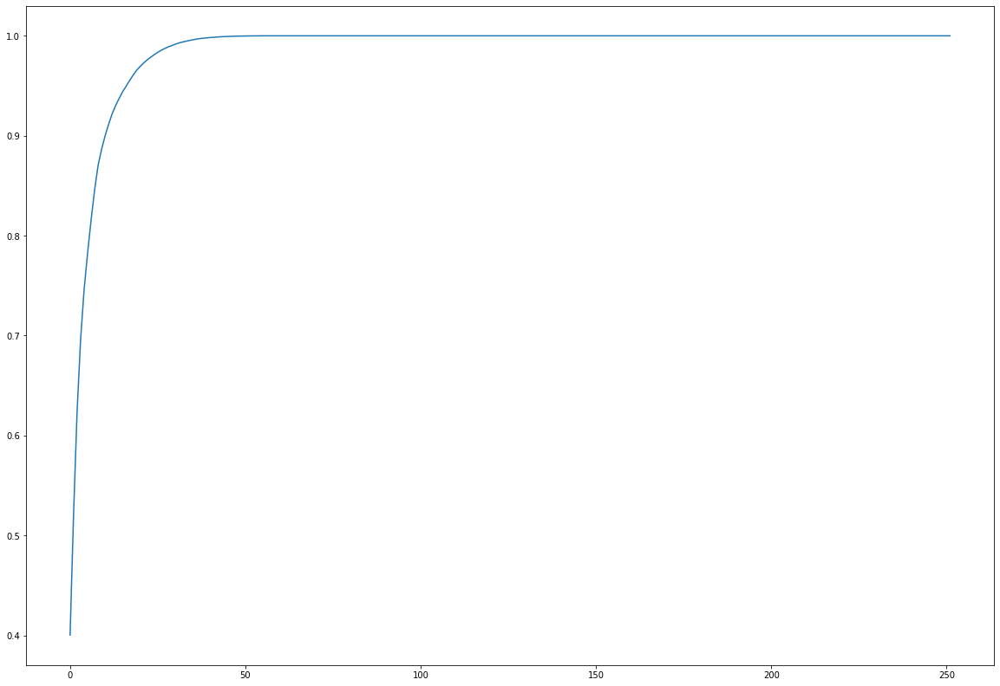

In [320]:
shap_all = shap_values

pca = PCA(n_components=None)
pca.fit(shap_all)

cum_exp_variance = np.cumsum(pca.explained_variance_ratio_)
plt.plot(range(0, len(cum_exp_variance)), cum_exp_variance)
# print(pca.explained_variance_ratio_)

^ This suggests we should keep only the top 10 components for clustering to retain > 90% of explained variance

Simple elbow method for cluster number determination in k-means:

In [323]:
%%capture
shap_pca_transformed = pca.transform(shap_all)[:, 0:10]

sse = {}
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(shap_pca_transformed)
    #data["clusters"] = kmeans.labels_
    #print(data["clusters"])
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center

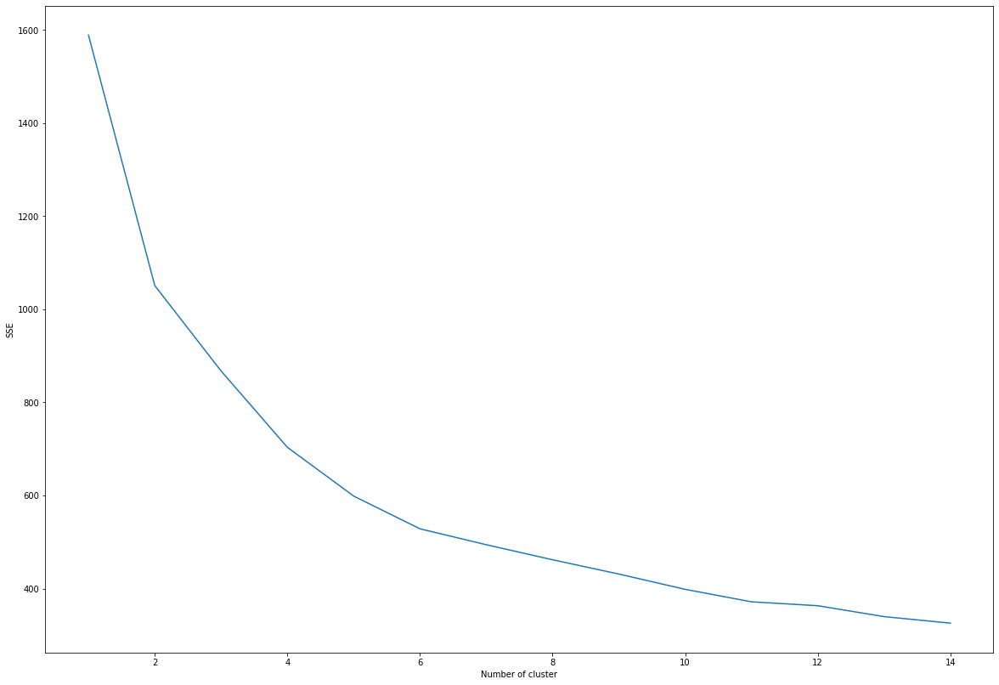

In [324]:
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()
plt.show()

In [325]:
%%capture
shap_pca_transformed = pca.transform(shap_all)[:, 0:10]

clustering = KMeans(n_clusters=2, random_state=40).fit(shap_pca_transformed)
print(clustering.labels_)
color_map = {0:'b', 1:'r'}#, 2:'orange', 3:'k', 4: 'purple', 5: 'maroon', 6: 'green'}

clustering_colors = [color_map[label] for label in clustering.labels_]

In [326]:
print(len(color_map))

2


[<matplotlib.lines.Line2D object at 0x7f5c13b982b0>, <matplotlib.lines.Line2D object at 0x7f5cb37bfd90>]


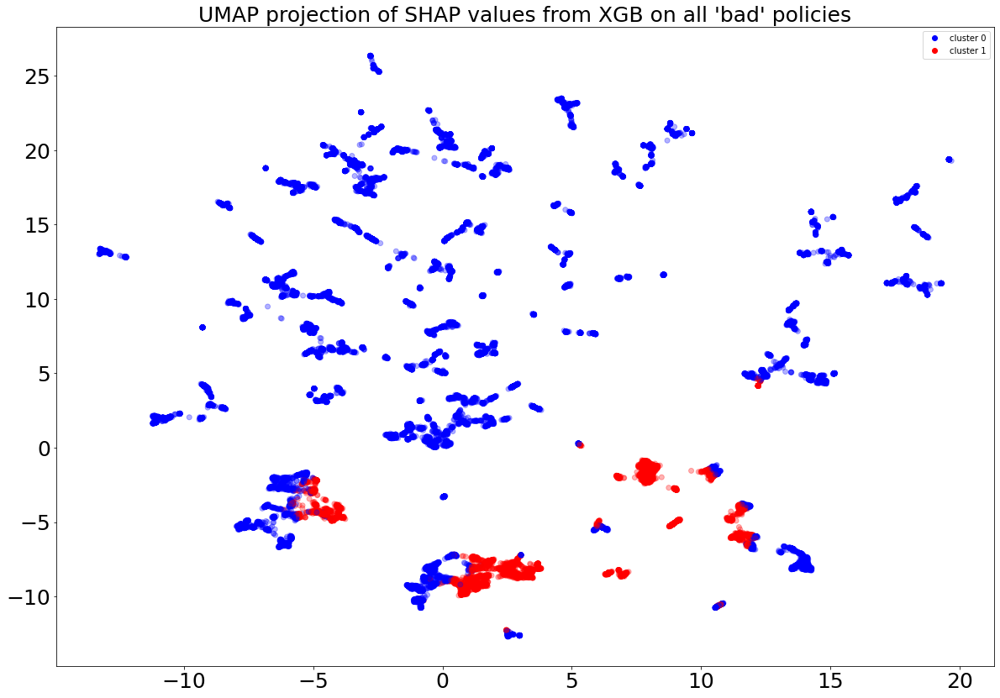

In [327]:
X_2d = umap.UMAP(n_neighbors=100, min_dist=0).fit_transform(shap_values)
y_bad_lr = y_comb_actual_lr

fontsize=20

plt.scatter(X_2d[:, 0], X_2d[:, 1], c=clustering_colors, alpha=0.3)

plt.title("UMAP projection of SHAP values from XGB on all 'bad' policies", fontsize=25)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

handlelist = [plt.plot([], marker="o", ls="", color=color)[0] for color in [color_map[i] for i in range(len(color_map))]]
labels = ["cluster 0", "cluster 1"]#, "cluster 2", "cluster 3", "cluster 4", "cluster 5", "cluster 6"]
print(handlelist)
plt.legend(handlelist, labels, loc='best')

plt.savefig("UMAP_all_policies.png", dpi=300, bbox_inches='tight')

Are any of these clusters actually 'special'? Meaning, are any of them actually enriched in more bad loss ratios than the others, such that it would indicate there is substructure in bad policies? Let's plot some 

count    32737.000000
mean         0.738067
std         14.103353
min          0.000000
25%          0.000000
50%          0.001382
75%          0.014959
max       1524.773986
Name: ultimate_trended_onlevel_lr, dtype: float64
count    10107.000000
mean         0.652371
std          5.157470
min          0.000000
25%          0.000000
50%          0.011924
75%          0.016967
max        194.974712
Name: ultimate_trended_onlevel_lr, dtype: float64


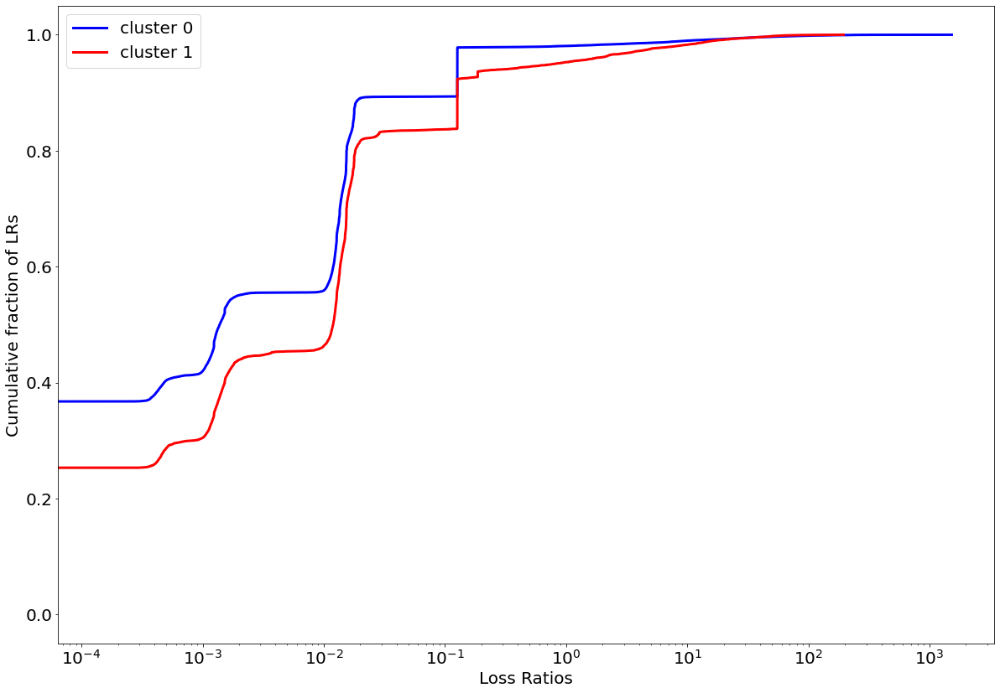

In [328]:
clust_0 = y_comb_actual_lr.iloc[np.where(clustering.labels_==0)[0]]
clust_1 = y_comb_actual_lr.iloc[np.where(clustering.labels_==1)[0]]
# clust_2 = y_comb_actual_lr.iloc[np.where(clustering.labels_==2)[0]]
# clust_3 = y_comb_actual_lr.iloc[np.where(clustering.labels_==3)[0]]
# clust_4 = y_comb_actual_lr.iloc[np.where(clustering.labels_==4)[0]]
# clust_5 = y_comb_actual_lr.iloc[np.where(clustering.labels_==5)[0]]
# clust_6= y_comb_actual_lr.iloc[np.where(clustering.labels_==6)[0]]

print(clust_0.describe())
print(clust_1.describe())
# print(clust_2.describe())
# print(clust_3.describe())
# print(clust_4.describe())
# print(clust_5.describe())
# print(clust_6.describe())

x_0, counts_0 = np.unique(clust_0, return_counts=True)
cusum_0 = np.cumsum(counts_0)

x_1, counts_1 = np.unique(clust_1, return_counts=True)
cusum_1 = np.cumsum(counts_1)

# x_2, counts_2 = np.unique(clust_2, return_counts=True)
# cusum_2 = np.cumsum(counts_2)

# x_3, counts_3 = np.unique(clust_3, return_counts=True)
# cusum_3 = np.cumsum(counts_3)

# x_4, counts_4 = np.unique(clust_4, return_counts=True)
# cusum_4 = np.cumsum(counts_4)

# x_5, counts_5 = np.unique(clust_5, return_counts=True)
# cusum_5 = np.cumsum(counts_5)

# x_6, counts_6 = np.unique(clust_6, return_counts=True)
# cusum_6 = np.cumsum(counts_6)

plt.plot(x_0, cusum_0/cusum_0[-1], color=color_map[0], label="cluster 0", lw=3)
plt.plot(x_1, cusum_1/cusum_1[-1], color=color_map[1], label="cluster 1", lw=3)
# plt.plot(x_2, cusum_2/cusum_2[-1], color=color_map[2], label="cluster 2", lw=3)
# plt.plot(x_3, cusum_3/cusum_3[-1], color=color_map[3], label="cluster 3", lw=3)
# plt.plot(x_4, cusum_4/cusum_4[-1], color=color_map[4], label="cluster 4", lw=3)
# plt.plot(x_5, cusum_5/cusum_5[-1], color=color_map[5], label="cluster 5", lw=3)
# plt.plot(x_6, cusum_6/cusum_6[-1], color=color_map[6], label="cluster 6", lw=3)


#plt.plot([0.57] * 20, np.linspace(-1, 1.2, 20), color='r', ls='--', label='portfolio LR target')
plt.xscale('log')
plt.ylim(-0.05, 1.05)
#plt.title("Cumulative distributions of segmented LR \n (KS={:2.2}, pval={:2.2})".format(KS, p_val), fontsize=fontsize)
plt.xlabel("Loss Ratios", fontsize=fontsize)
plt.ylabel("Cumulative fraction of LRs",fontsize=fontsize)
plt.xticks(size=fontsize)
plt.yticks(size=fontsize)
plt.legend(loc='best', fontsize=fontsize)

plt.savefig("cumulative_fraction_lrs_kmeans_all.png", dpi=300, bbox_inches='tight')
plt.show()


In [330]:
feature_names_encoded = lr_cls.named_steps["encoding"].get_feature_names_out()
sr_clf = SkopeRules(feature_names_encoded, n_estimators=40, max_depth=10)

for i in sorted(set(clustering.labels_)):
    print(i)
    cluster_ovr_labels = [1 if ele == i else 0 for ele in clustering.labels_]

    sr_clf.fit(X_shap, cluster_ovr_labels)

    for rule in sr_clf.rules_[0]:
        print(rule)

    for j, est in enumerate(sr_clf.estimators_):
        if i ==3 and j==0:
            plot_tree(est, feature_names = feature_names_encoded)
            plt.savefig("example_tree" + str(j)+ ".png", dpi=300, bbox_inches='tight')
            plt.show()

0
numerical__deductible_factor <= 0.375 and numerical__increased_limits_factor <= 3.534999966621399 and numerical__schedule_modification_factor <= 1.362500011920929 and numerical__exposure <= 2.75 and numerical__rate_tier_code <= 2.5 and numerical__prev_lr_avg_5 <= 14.860750675201416 and numerical__prev_lr_trend > -0.47940561175346375 and numerical__prev_lr_bad_proportion <= 0.8333333432674408 and numerical__prev_rate_change_trend > -0.4394647181034088
(0.9992925084505935, 0.9715683277285234, 1)
1
numerical__aggregate_limit > 1250000.0 and numerical__size_of_firm_factor <= 1.1541666388511658 and numerical__exposure > 2.75 and numerical__prev_lr_std > 5.00781470691436e-06
(0.9996629024102478, 0.7307787087235091, 1)


If we apply these rules to the full dataset, how do the distributions look?

p-value floored: true value smaller than 0.001


Anderson_ksampResult(statistic=1589.6730130620758, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)
KstestResult(statistic=0.3895812306563251, pvalue=0.0)
0.7282240960720705
0.5881178455900179


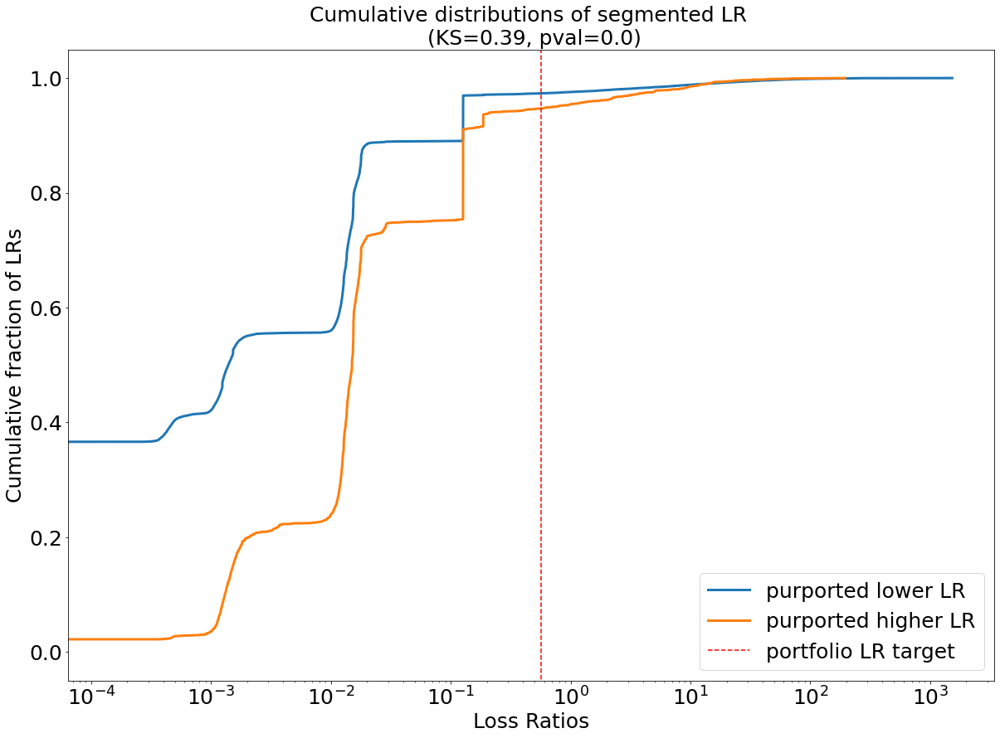

In [335]:
# low_mask = (preprocess_df["experience_modification_factor"] <= 1.0049999952316284) & (preprocess_df["exposure"] <= 3.5) & (preprocess_df["rate_type_cd"] > 1.6244363188743591)

#high_mask = ~low_mask
high_mask = (preprocess_df["aggregate_limit"] > 1250000.0) & (preprocess_df["size_of_firm_factor"] <= 1.1541666388511658) & (preprocess_df["exposure"]  > 2.75) & (preprocess_df["prev_lr_std"] > 5.00781470691436e-06)
low_mask = ~high_mask

print(anderson_ksamp([preprocess_df[high_mask]["ultimate_trended_onlevel_lr"], preprocess_df[low_mask]["ultimate_trended_onlevel_lr"]]))
cumulative_ks_plot(low_mask, high_mask, preprocess_df, "testing_skoperules.png", "ultimate_trended_onlevel_lr", 
                   low_label="purported lower LR", high_label="purported higher LR")

low 1.2000778255529585
high 0.6736549597948561


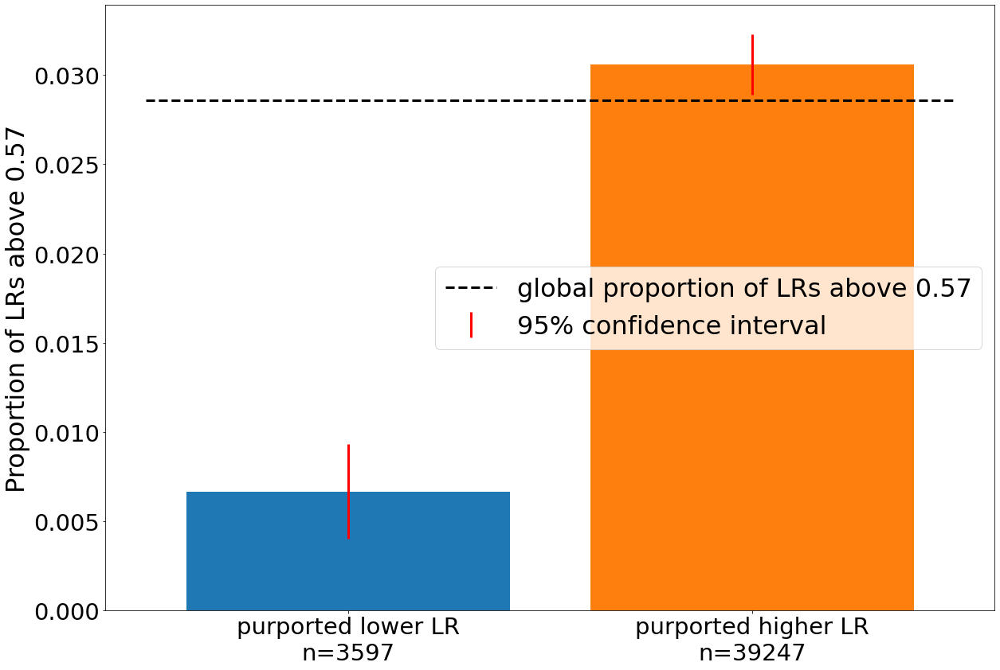

In [161]:
high_low_confint_plot(low_mask, high_mask, preprocess_df, "bar_chart_testing_skoperules_057.png", "ultimate_trended_onlevel_lr", 
                        low_label = "purported lower LR", high_label = "purported higher LR", threshold = 0.57)

# Univariate plots of top important "useful" features:


### Univariate plots requested by business

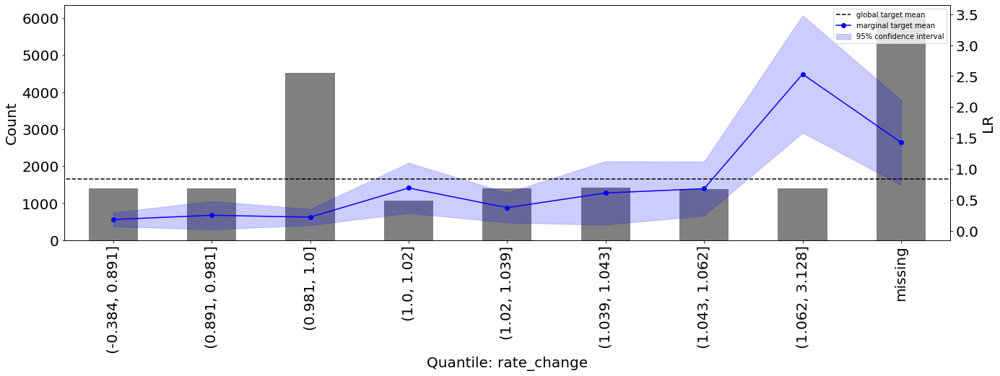

True

In [195]:
univariate_num(present_target_trunc_df[(present_target_trunc_df["effective_year"] < 2016)] , var_name="rate_change", target_name="ultimate_trended_onlevel_lr", n_buckets=10, filename= "requested_univariate_2016prior_rate_change.png", plot=True, fontsize=20)

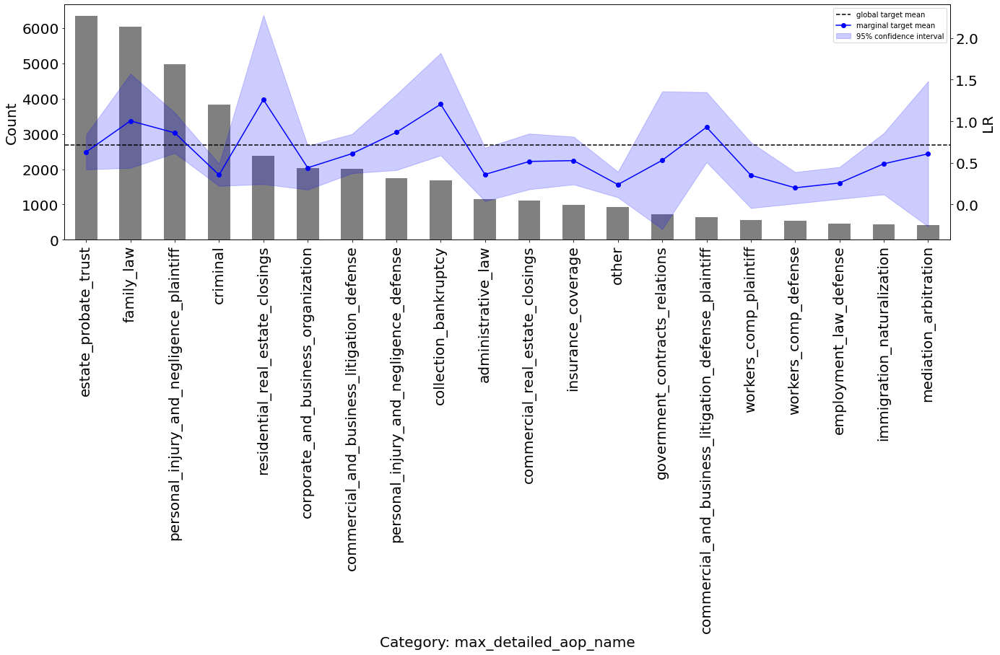

True

In [556]:
univariate_cat(preprocess_df, "max_detailed_aop_name", "ultimate_trended_onlevel_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_test" + ".png", target_binary=False, fontsize=20, plot=True)

['rate_type_cd', 'experience_modification_factor', 'max_detailed_aop_pct', 'aop_above_average_risk', 'prev_lr_bad_proportion', 'exposure', 'size_of_firm_factor', 'not_greater_financial_crisis', 'schedule_modification_factor']


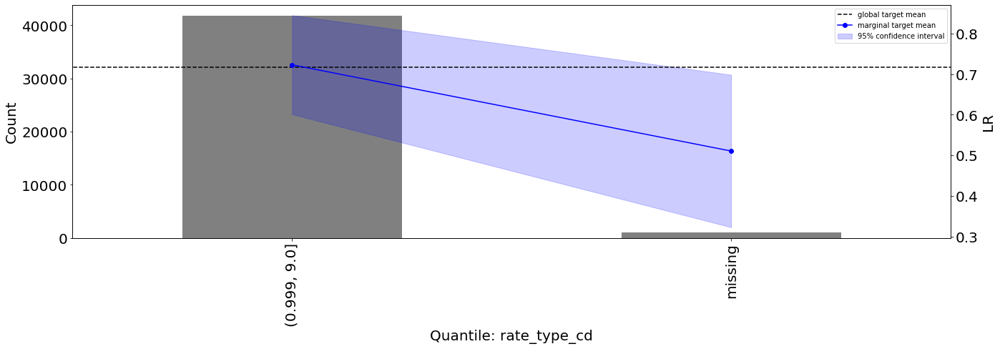

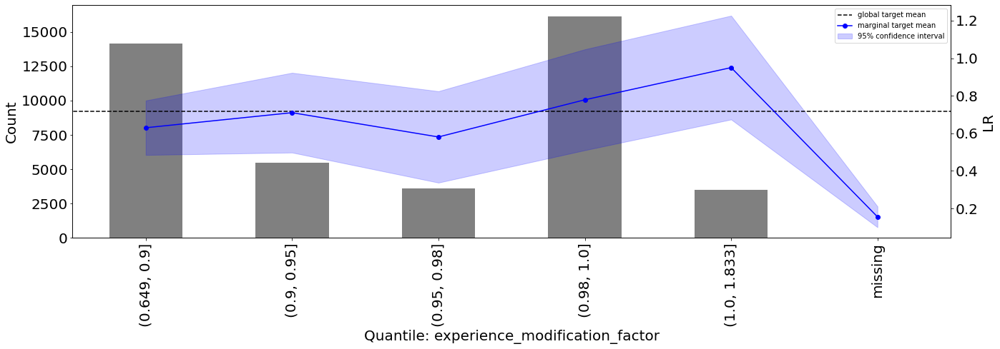

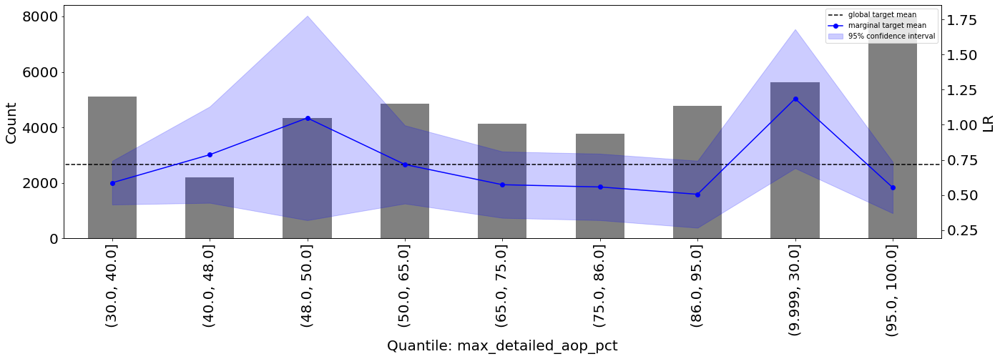

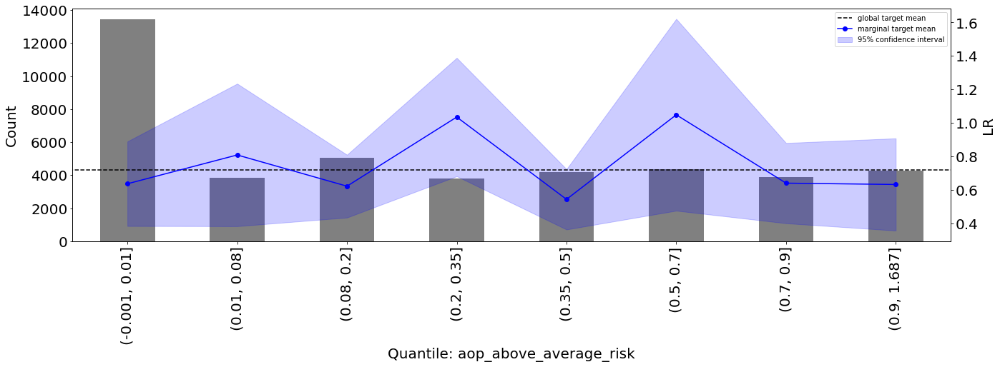

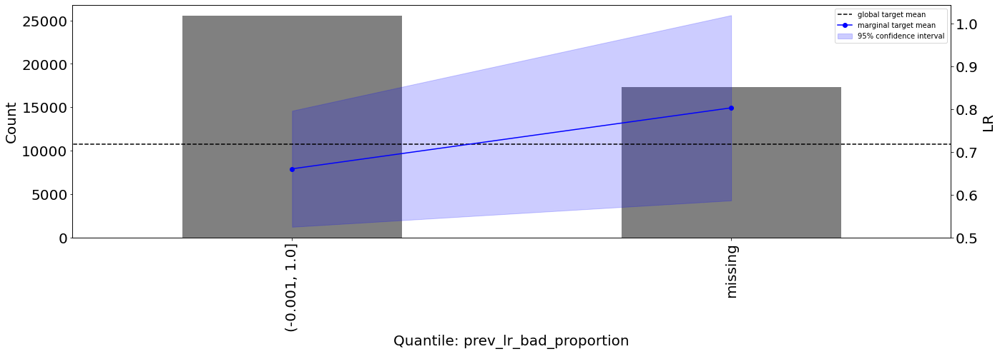

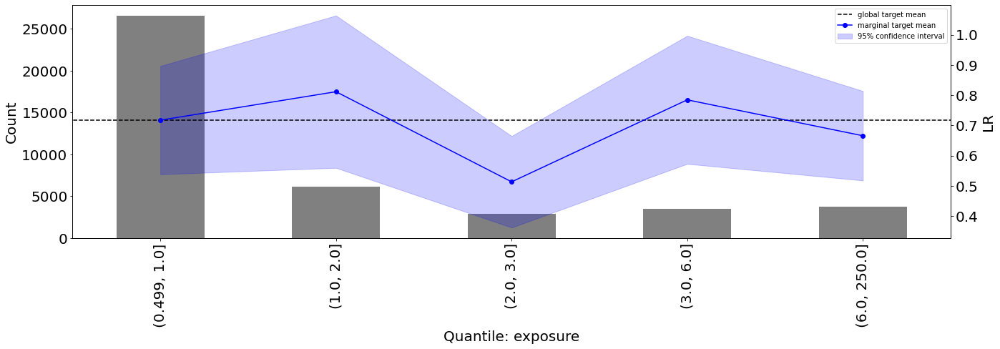

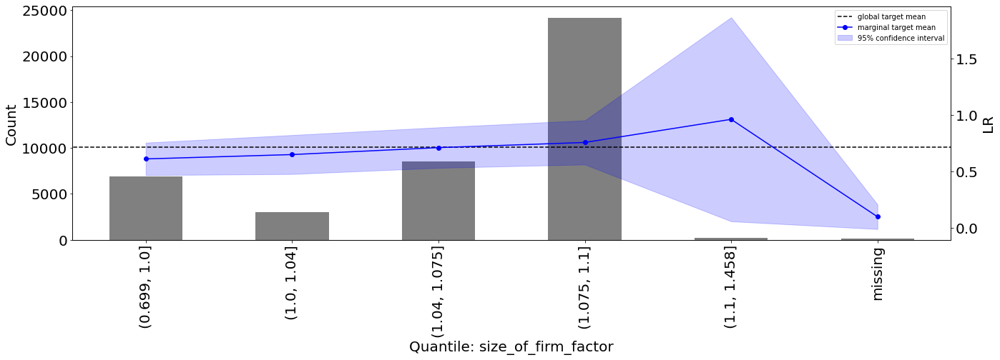

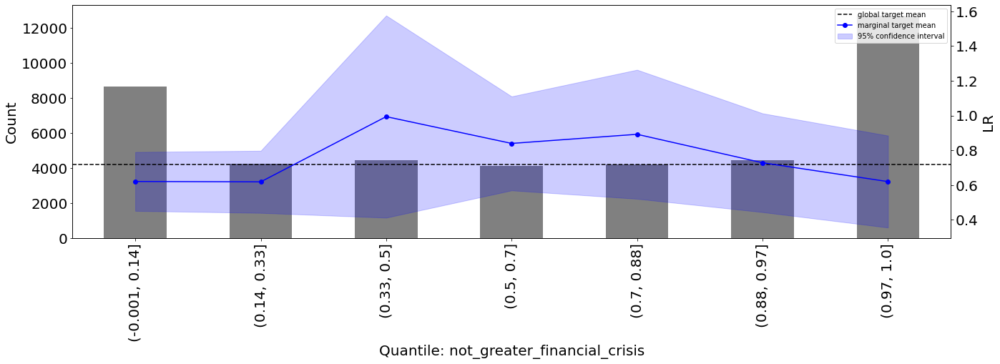

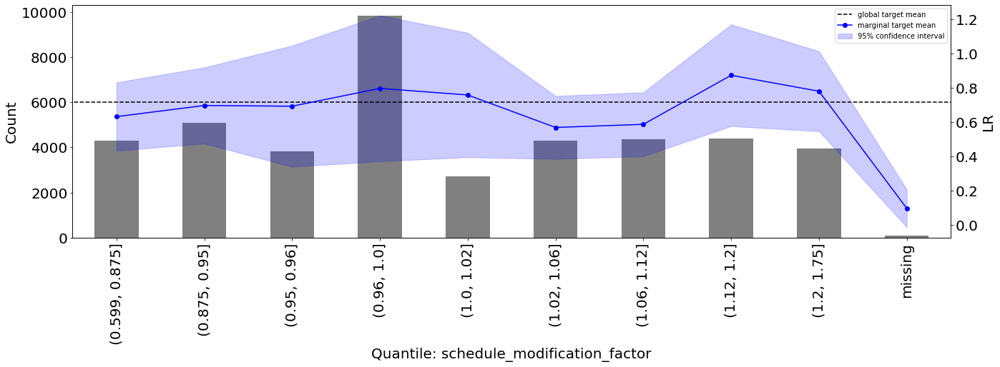

In [788]:
#numerical_to_investigate = ["prev_auto_renewal_std", "factor_aop_pension_employee_benefits"]

top_x = ['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'not_greater_financial_crisis', 'risk_category', 'rate_type_cd', 'schedule_modification_factor', 'prev_lr_bad_proportion', 'max_detailed_aop_pct', 'aop_above_average_risk']
numerical_to_investigate = list(set(top_x).intersection(set(numerical_to_keep)))
print(numerical_to_investigate)
for col in numerical_to_investigate:
    univariate_num(preprocess_df, col, "ultimate_trended_onlevel_lr", n_buckets=10, filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_" + col + ".png", target_binary=False, fontsize=20, plot=True)


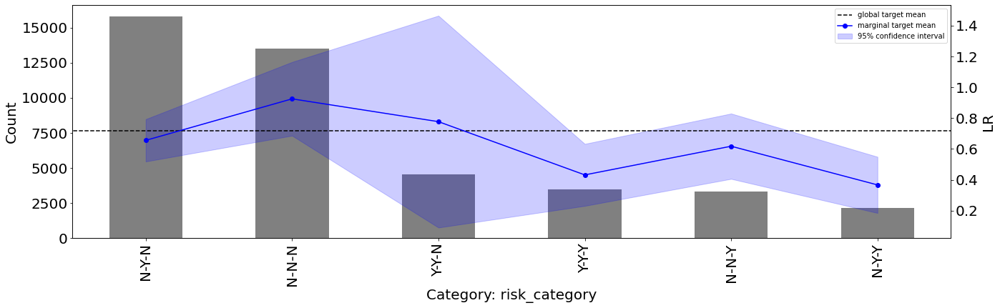

In [697]:
top_x = ['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'not_greater_financial_crisis', 'risk_category', 'rate_type_cd', 'schedule_modification_factor', 'prev_lr_bad_proportion', 'max_detailed_aop_pct', 'aop_above_average_risk']

categorical_to_investigate = list(set(top_x).intersection(set(nominal_to_keep)))
for col in categorical_to_investigate:
    univariate_cat(preprocess_df, col, "ultimate_trended_onlevel_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_" + col + ".png", target_binary=False, fontsize=20, plot=True)


In [90]:
lr_classification_df = preprocess_df.copy()
lr_classification_df["bad_lr"] = lr_classification_df["ultimate_trended_onlevel_lr"].apply(lambda x: 1 if x > 0.57 else 0)

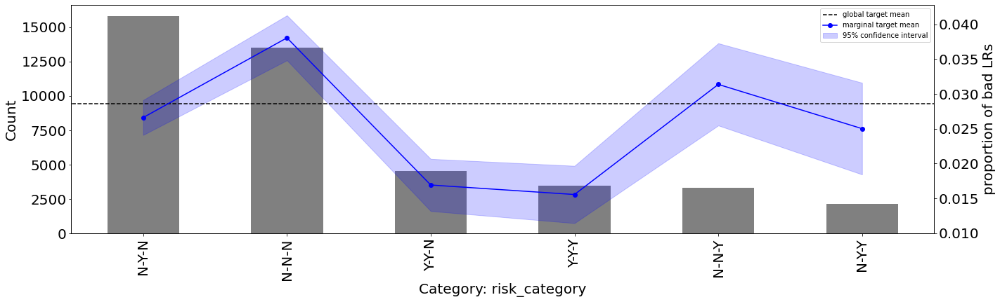

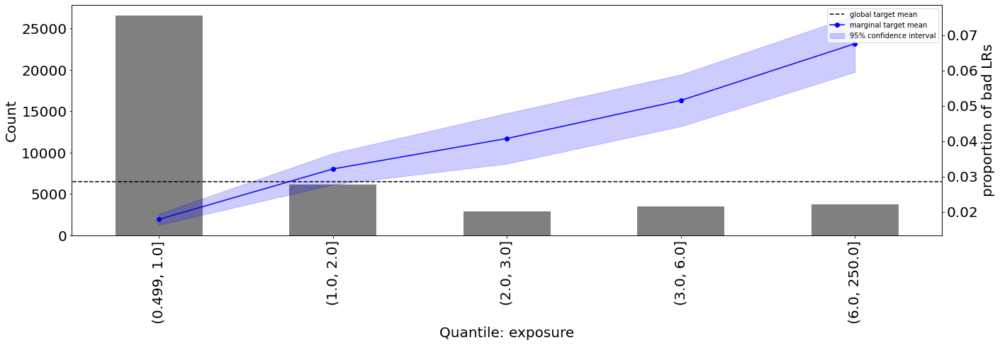

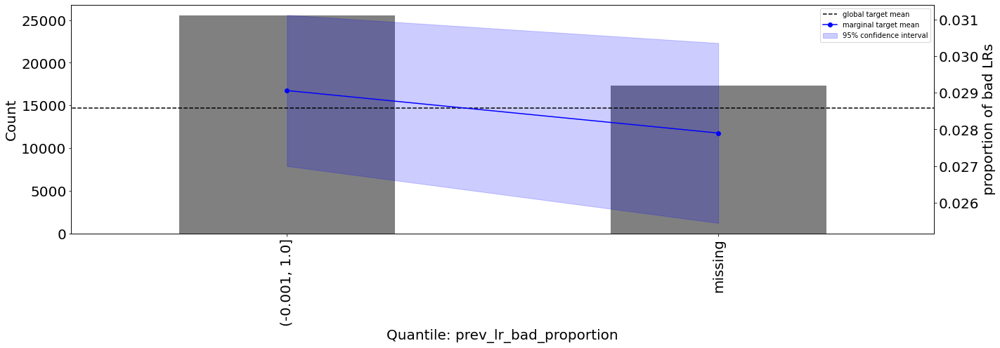

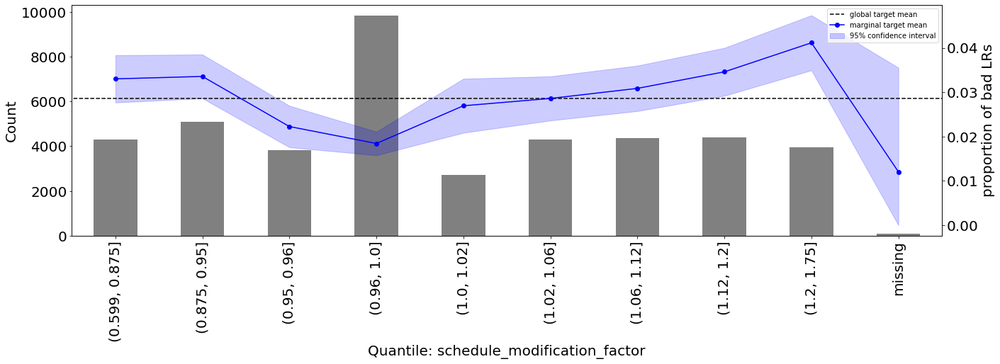

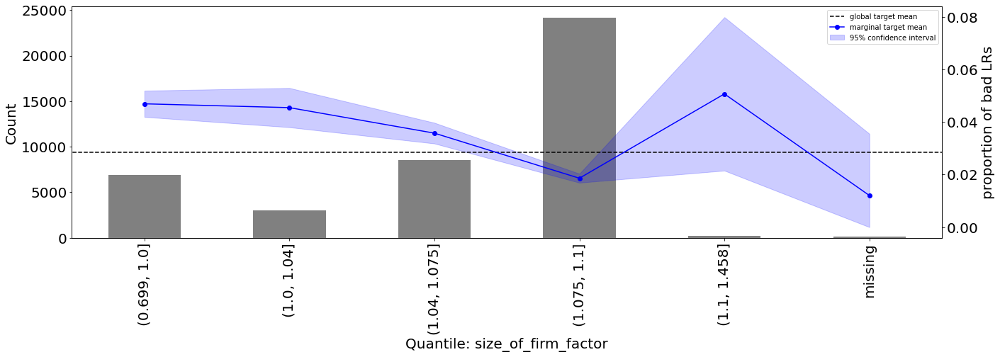

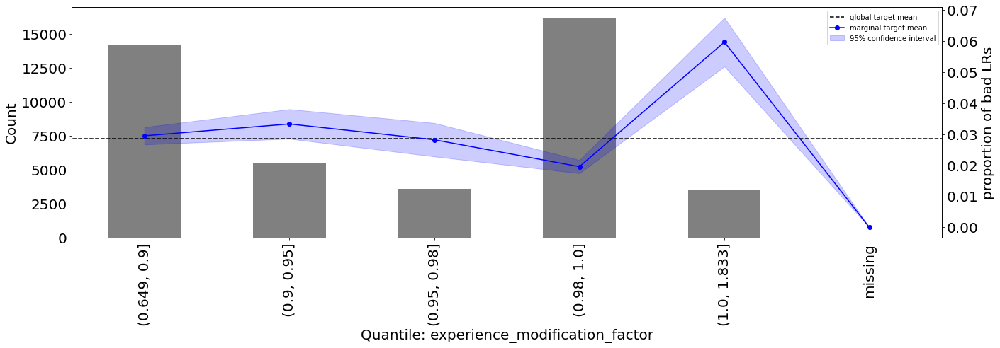

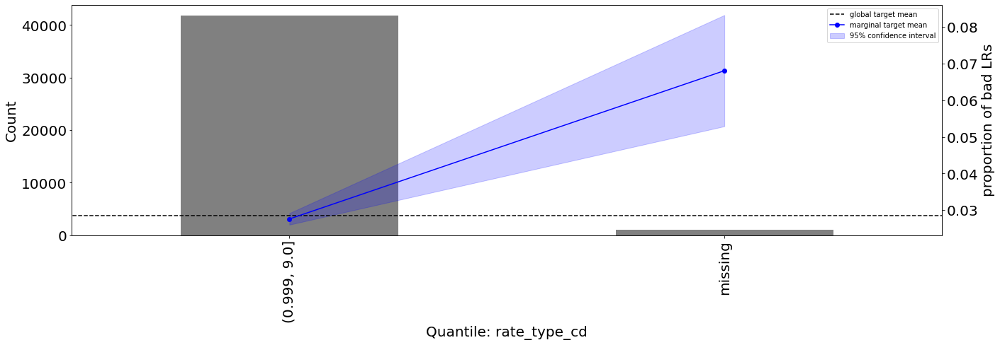

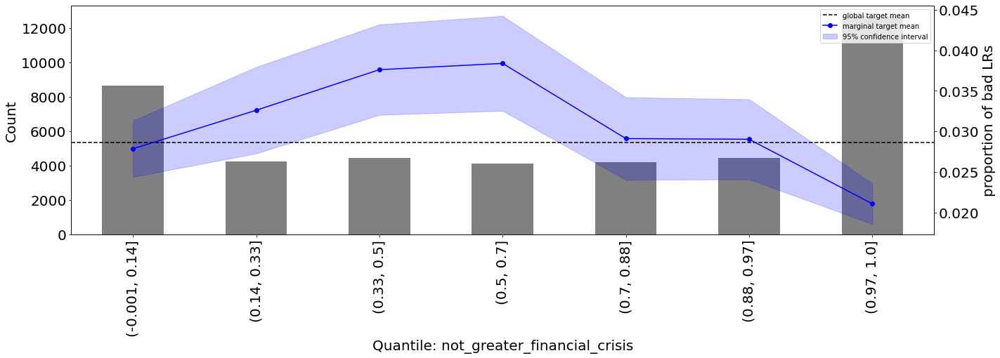

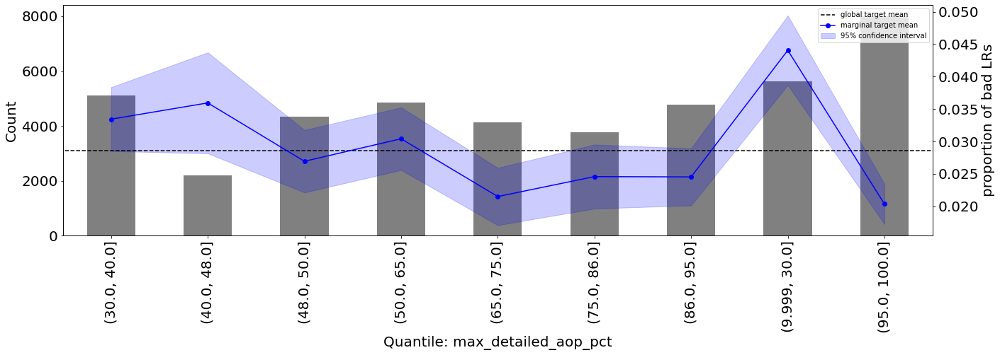

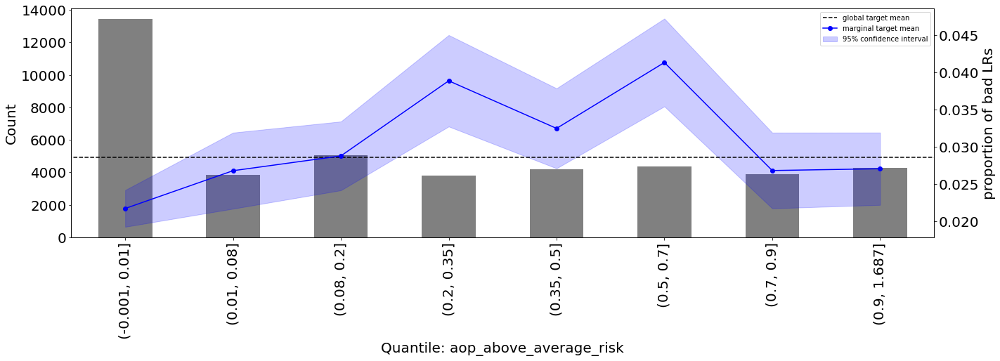

In [91]:
top_x = ['exposure', 'experience_modification_factor', 'size_of_firm_factor', 'not_greater_financial_crisis', 'risk_category', 'rate_type_cd', 'schedule_modification_factor', 'prev_lr_bad_proportion', 'max_detailed_aop_pct', 'aop_above_average_risk']

categorical_to_investigate = list(set(top_x).intersection(set(nominal_to_keep)))
for col in categorical_to_investigate:
    univariate_cat(lr_classification_df, col, "bad_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_badlr_" + col + ".png", target_binary=True, fontsize=20, plot=True, ylabel="proportion of bad LRs")
    
numerical_to_investigate = list(set(top_x).intersection(set(numerical_to_keep)))
for col in numerical_to_investigate:
    univariate_num(lr_classification_df, col, "bad_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_badlr_" + col + ".png", target_binary=True, fontsize=20, plot=True, n_buckets=10, ylabel="proportion of bad LRs")

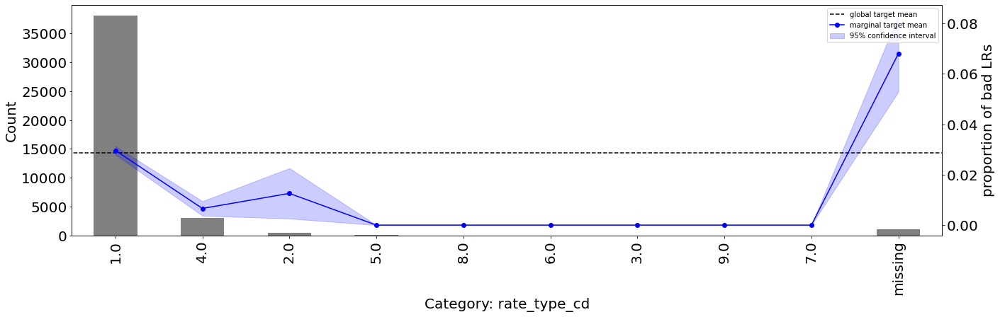

True

In [92]:
univariate_cat(lr_classification_df, "rate_type_cd", "bad_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_badlr_" + "rate_type_cd" + ".png", target_binary=True, fontsize=20, plot=True, ylabel="proportion of bad LRs")

invalid value encountered in multiply
invalid value encountered in multiply


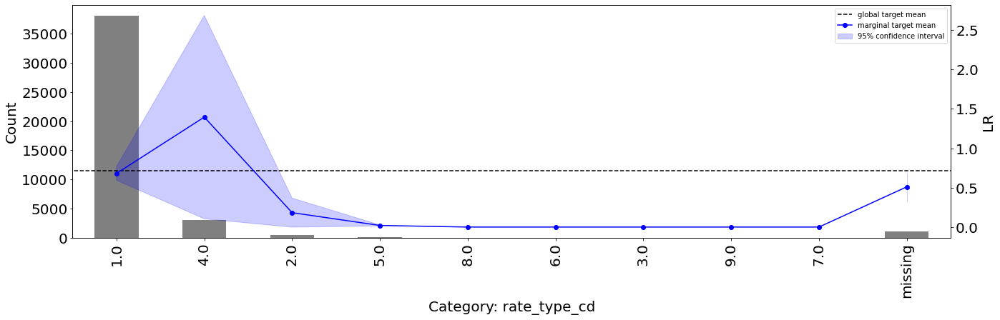

True

In [791]:
univariate_cat(preprocess_df, "rate_type_cd", "ultimate_trended_onlevel_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_" + "rate_type_cd" + ".png", target_binary=False, fontsize=20, plot=True)

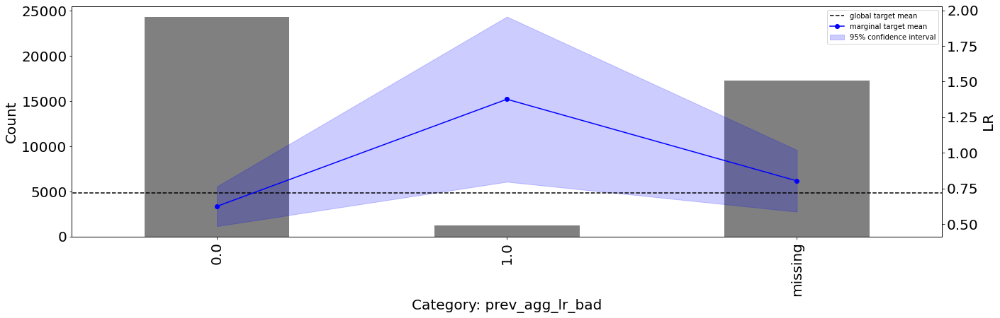

True

In [790]:
univariate_cat(preprocess_df, "prev_agg_lr_bad", "ultimate_trended_onlevel_lr", filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_" + "prev_agg_lr_bad" + ".png", target_binary=False, fontsize=20, plot=True)

# checking how missing values impact univariate trends

Spurious connection for experience_modification_factor (when it doesn't exist, neither do premiums or losses, so loss ratio is set to zero)

In [100]:
merged_df[merged_df["experience_modification_factor"].isnull()][["experience_modification_factor", "onlevel_premium", "ultimate_loss"]].value_counts()#[["experience_modification_factor", "onlevel_premium", "ultimate_loss"]].value_counts()

Series([], Name: count, dtype: int64)

In [115]:
merged_df[(merged_df["effective_year"] > 2011) & merged_df["experience_modification_factor"].isnull() & (merged_df["effective_year"] < 2022)][["policy_id", "effective_year", "experience_modification_factor", "onlevel_premium", "ultimate_loss"]]

,policy_id,effective_year,experience_modification_factor,onlevel_premium,ultimate_loss
48678,XSU3270122088,2021,NaN,52368.000000,-9206.666554
96898,XSU3270117681,2021,NaN,87826.000000,-15440.434937
96905,XSU3270120363,2021,NaN,80544.000000,-14160.207588
96908,XSU3270121979,2021,NaN,15000.000000,-2637.106598
172954,WFT3330083830,2013,NaN,814732.147059,NaN
192927,XSU3270001041,2021,NaN,71420.000000,-12556.143548


In [116]:
merged_df[(merged_df["effective_year"] > 2011) & merged_df["experience_modification_factor"].isnull()][["policy_id", "effective_year", "experience_modification_factor", "onlevel_premium", "ultimate_loss"]]

,policy_id,effective_year,experience_modification_factor,onlevel_premium,ultimate_loss
5727,FNA3370111978,2023,NaN,NaN,NaN
5815,FNA3370122681,2022,NaN,NaN,-35621.737846
5816,FNA3370123198,2022,NaN,NaN,NaN
5871,FNA3379990051,2023,NaN,NaN,NaN
48660,XSU3270001041,2022,NaN,NaN,NaN
48669,XSU3270115519,2022,NaN,38323.000000,-19214.811056
48677,XSU3270120363,2022,NaN,88598.000000,NaN
48678,XSU3270122088,2021,NaN,52368.000000,-9206.666554
48679,XSU3270122159,2022,NaN,NaN,-16994.651273
48680,XSU3270122159,2023,NaN,NaN,NaN


Spurious connection for size_of_firm_factor

In [453]:
merged_df[merged_df["size_of_firm_factor"].isnull()][["size_of_firm_factor", "onlevel_premium", "ultimate_loss"]].value_counts()#[["experience_modification_factor", "onlevel_premium", "ultimate_loss"]].value_counts()

Series([], Name: count, dtype: int64)

Spurious connection for schedule_modification_factor

In [458]:
merged_df[merged_df["schedule_modification_factor"].isnull()][["schedule_modification_factor", "onlevel_premium", "ultimate_loss"]].value_counts()#[["experience_modification_factor", "onlevel_premium", "ultimate_loss"]].value_counts()

Series([], Name: count, dtype: int64)

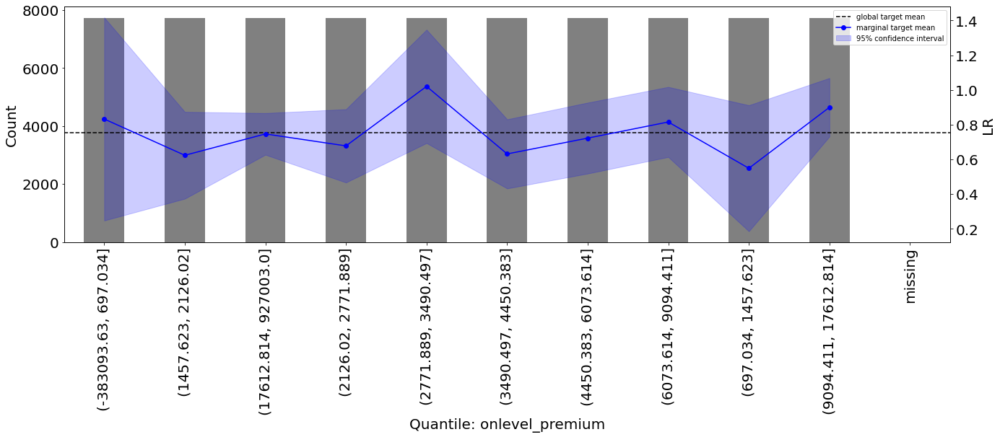

True

In [657]:
univariate_num(merged_df, "onlevel_premium", "ultimate_trended_onlevel_lr", n_buckets=10, filename= os.getcwd() + os.sep + "Figures" + os.sep + "feature_" + "onlevel_premium" + ".png", target_binary=False, fontsize=20, plot=True)

# congruence of feature importances across regression and classification

Testing intersection of perm importance from classification and regression:

In [410]:
perm_importance_classification = ['auto_renewal_count', 'rate_change', 'pt_att', 'increased_limits_factor', 'max_detailed_aop_pct', 'factor_aop_intellectual_property_c_p_t_not_including_litigation', 'aop_below_average_risk_exposure', 'risk_impact_attorney_count', 'program_code', 'deductible_amount', 'aop_average_risk_exposure', 'real_estate_commercial', 'rule_2_total', 'deductible_type', 'max_detailed_aop']
perm_importance_regression = ['price_impact_experience_modifier', 'defense_outside', 'not_auto_renewal_count', 'rate_change', 'expiration_year_month', 'effective_year', 'schedule_modification_factor', 'weighted_debit_amount', 'price_impact_overall', 'risk_impact_miscellaneous', 'price_impact_miscellaneous', 'risk_impact_overall', 'experience_modification_factor', 'aop_above_average_risk', 'aop_below_average_risk']
print(set(perm_importance_classification).intersection(perm_importance_regression))

{'rate_change'}


^ in reality, an overlap of 2 as not_auto_renewal_count and auto_renewal_count are perfectly anticorrelated.

# Cross-val prediction vs. theoretical 

In [1726]:
def plot_actual_predicted(X_train, y_train, y_pred, title, fontsize, filename, axeslimit = None):
    
    # effective year colourmap
    cmap = plt.cm.get_cmap('jet')
    norm = Normalize(vmin=min(X_train["effective_year"]), vmax = max(X_train["effective_year"]))
    colors = cmap(norm(X_train["effective_year"]))
    
    # predicted vs actual scatter
    plt.scatter(y_train, y_pred, marker='o', c = colors)
    
    # equals line
    equality_range = range(0, math.ceil(max(y_train)) + 1)
    plt.plot(equality_range, equality_range, linestyle='--', color='k', marker='')
    
    # plot params
    plt.xlim(0, math.ceil(max(y_train)))
    plt.ylim(0, math.ceil(max(y_train)))
    plt.ylabel("Predicted", fontsize=fontsize)
    plt.xlabel("Actual", fontsize=fontsize)
    plt.title(title, fontsize=fontsize)
    plt.yticks(size=fontsize)
    plt.xticks(size=fontsize)

    ticks = np.arange(min(X_train["effective_year"]), max(X_train["effective_year"]) + 1, 1)
    cb = plt.colorbar(ScalarMappable(norm=norm, cmap=cmap), ticks=ticks)
    cb.ax.tick_params(labelsize=fontsize/1.5)
    cb.set_label('Effective year', fontsize=fontsize/1.5)
    
    if axeslimit:
        plt.xlim(axeslimit[0], axeslimit[1])
        plt.ylim(axeslimit[0], axeslimit[1])
    
    plt.savefig(filename, bbox_inches='tight')
    plt.show()

def residual_plot(X_train, y_train, y_pred, title, fontsize, filename, axeslimit = None):
    
    cmap = plt.cm.get_cmap('jet')
    norm = Normalize(vmin=min(X_train["effective_year"]), vmax = max(X_train["effective_year"]))
    colors = cmap(norm(X_train["effective_year"]))
    plt.scatter(y_train, y_pred-y_train, marker='o', c = colors)
    equality_range = range(0, math.ceil(max(y_train)) + 1)

    plt.xlim(0, math.ceil(max(y_train)))
    plt.ylim(min(y_pred-y_train), max(y_pred-y_train))
    plt.ylabel("Residuals (Predicted - Actual)", fontsize= fontsize)
    plt.xlabel("Actual", fontsize = fontsize)
    plt.title(title, fontsize = fontsize)
    plt.yticks(size= fontsize)
    plt.xticks(size = fontsize)

    ticks = np.arange(min(X_train["effective_year"]), max(X_train["effective_year"]) + 1, 1)
    cb = plt.colorbar(ScalarMappable(norm=norm, cmap=cmap), ticks=ticks)
    cb.ax.tick_params(labelsize=fontsize/1.5)
    cb.set_label('Effective year', fontsize=fontsize/1.5)

    plt.savefig(filename, bbox_inches='tight')
    plt.show()
    

## best model for all policies

In [1646]:
with open("XGBv7_best_estimator.pkl", 'rb') as file:
      
    # Call load method to deserialze
    best_reg_model = joblib.load(file)

gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
splitter_cv = gkf_cv.split(train_df, zero_nonzero_indicator, groups=train_df['policy_id'])

best_rmse = np.sqrt(np.mean(-cross_val_score(best_reg_model, X_train, y_train, cv = splitter_cv, scoring="neg_mean_squared_error")))

gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(train_df, zero_nonzero_indicator, groups=train_df['policy_id'])

y_pred = cross_val_predict(best_reg_model, X_train, y_train, cv = splitter_cv)

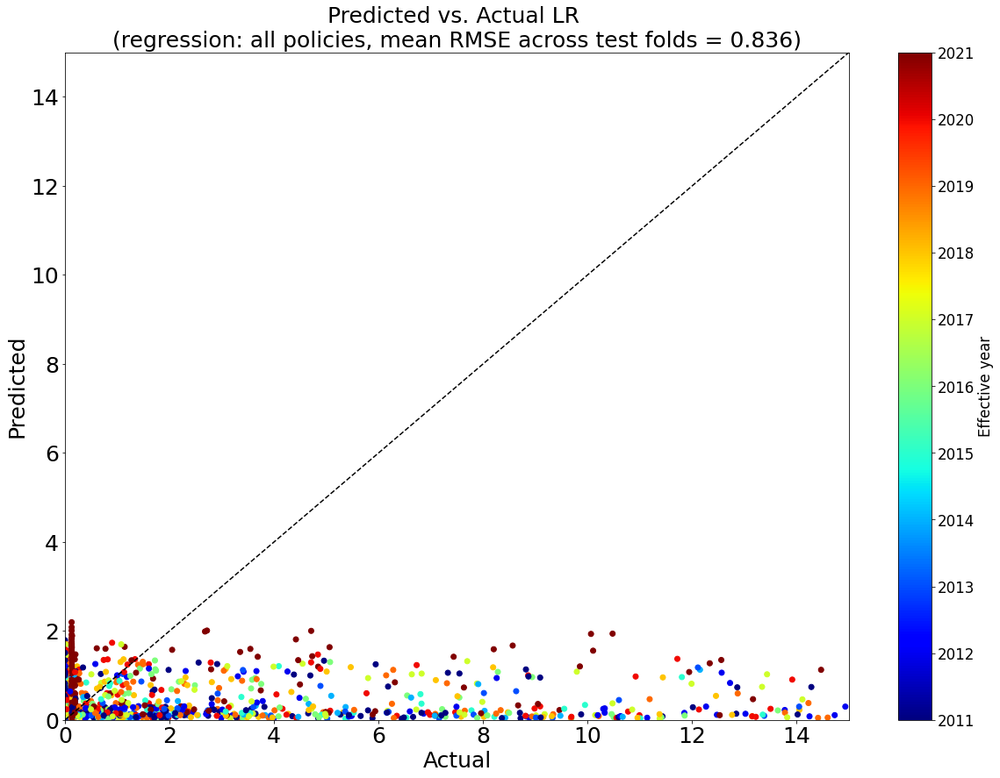

In [1663]:
plot_actual_predicted(X_train, y_train, y_pred, 
                      title=f"Predicted vs. Actual LR \n(regression: all policies, mean RMSE across test folds = {best_rmse:{1}.{3}})",
                      filename= os.getcwd() + os.sep+ "Figures" + os.sep + "actual_predicted_allpolicies.png", fontsize=25)
# fig = plt.gcf()
# fig.savefig("allpolicies_pred_actual.png", dpi=300)

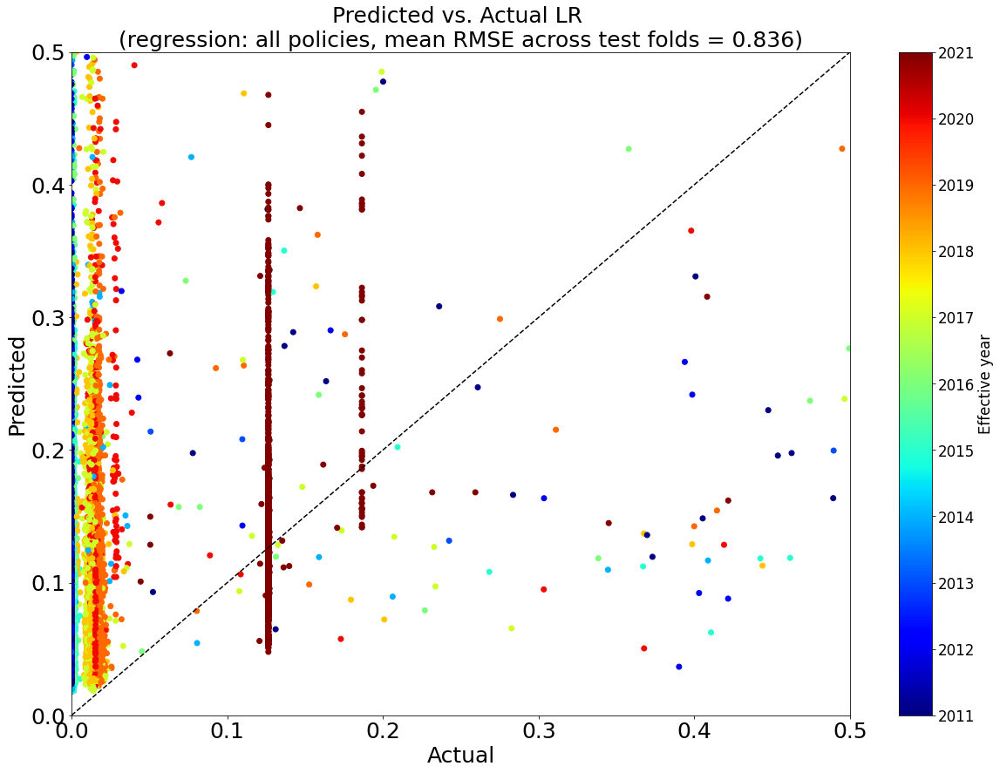

In [1664]:
plot_actual_predicted(X_train, y_train, y_pred, 
                      title=f"Predicted vs. Actual LR \n(regression: all policies, mean RMSE across test folds = {best_rmse:{1}.{3}})",
                      fontsize=25, filename= os.getcwd() + os.sep+ "Figures" + os.sep + "actual_predicted_allpolicies_zoom.png", axeslimit=(0, 0.5))

In [101]:
merged_df[(merged_df["ultimate_trended_onlevel_lr"] > 0.10) & (merged_df["ultimate_trended_onlevel_lr"] < 0.15) & (merged_df["effective_year"] == 2021)][
    ["effective_year","ultimate_loss", "loss_trend_factor", "onlevel_premium", "pure_ibnr", "ibner", "ultimate_trended_onlevel_lr"]].value_counts().sort_values(ascending=False)

effective_year  ultimate_loss  loss_trend_factor  onlevel_premium  pure_ibnr   ibner  ultimate_trended_onlevel_lr
2021            -61.847059     1.0609             519.0            61.847059   0.0    0.126423                       15
                -452.710937    1.0609             3799.0           452.710937  0.0    0.126423                        5
                -367.030715    1.0609             3080.0           367.030715  0.0    0.126423                        5
                -156.226386    1.0609             1311.0           156.226386  0.0    0.126423                        4
                -399.324651    1.0609             3351.0           399.324651  0.0    0.126423                        4
                                                                                                                     ..
                -321.271042    1.0609             2696.0           321.271042  0.0    0.126423                        1
                -324.726850    1.0609         

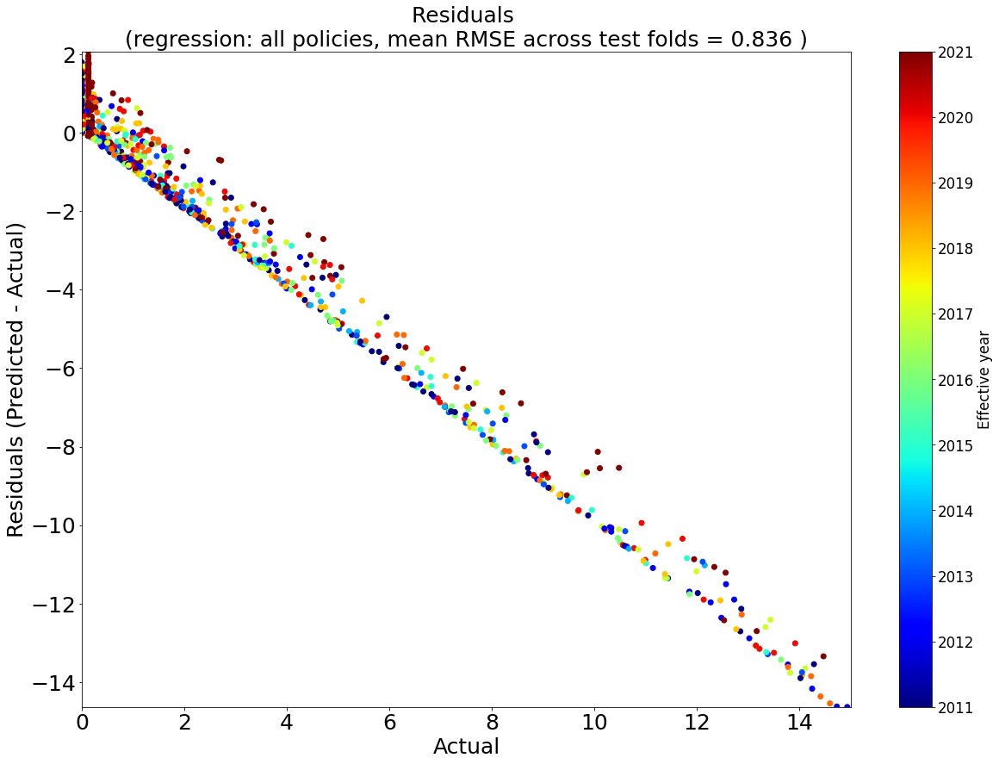

In [1665]:
residual_plot(X_train, y_train, y_pred, 
                      title=f"Residuals \n(regression: all policies, mean RMSE across test folds = {best_rmse:{1}.{3}} )",
                      filename= os.getcwd() + os.sep+ "Figures" + os.sep + "residuals_allpolicies.png", fontsize=25)

In [525]:
preprocess_df[(preprocess_df["ultimate_trended_onlevel_lr"] > 0.10) & (preprocess_df["ultimate_trended_onlevel_lr"] < 0.15)]["ultimate_trended_onlevel_lr"].value_counts().head(20)

0.1264230148397187    2098
0.1264230148397187    1233
0.1264230148397187     156
0.1264230148397186      34
0.1264230148397187       6
0.1272096080879437       2
0.1264281226339427       1
0.1264623989564912       1
0.1271845992664639       1
0.1075181335778470       1
0.1219735719090596       1
0.1097015649707957       1
0.1264095225222331       1
0.1265017068055225       1
0.1264516756909632       1
0.1256184666511464       1
0.1264708118207545       1
0.1264460469065505       1
0.1348754558622605       1
0.1264834233903875       1
Name: ultimate_trended_onlevel_lr, dtype: int64

## best model for developed policies

First I need to get both the model and dataset:

In [1786]:
#import pickle
with open("XGBv13best_estimator_developed.pkl", 'rb') as file:
      
    # Call load method to deserialze
    developed_reg_model = joblib.load(file)
    
developed_train_df = pd.read_csv("developed_train.csv", low_memory=False, index_col=[0])
developed_X_train = pd.read_csv("developed_X_train.csv", low_memory=False, index_col=[0])
developed_y_train = pd.read_csv("developed_y_train.csv", low_memory=False, index_col=[0], squeeze=True)

The squeeze argument has been deprecated and will be removed in a future version. Append .squeeze("columns") to the call to squeeze.




In [704]:
print(type(developed_y_train))

<class 'pandas.core.series.Series'>


In [1787]:
gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
zero_nonzero_indicator = developed_y_train.apply(lambda row: 1 if row > 0 else 0)
splitter_cv = gkf_cv.split(developed_train_df, zero_nonzero_indicator, groups=developed_train_df['policy_id'])

best_rmse = np.sqrt(np.mean(-cross_val_score(developed_reg_model, developed_X_train, developed_y_train, cv = splitter_cv, scoring="neg_mean_squared_error")))

gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
splitter_cv = gkf_cv.split(developed_train_df, zero_nonzero_indicator, groups=developed_train_df['policy_id'])

y_pred_developed = cross_val_predict(developed_reg_model, developed_X_train, developed_y_train, cv = splitter_cv)

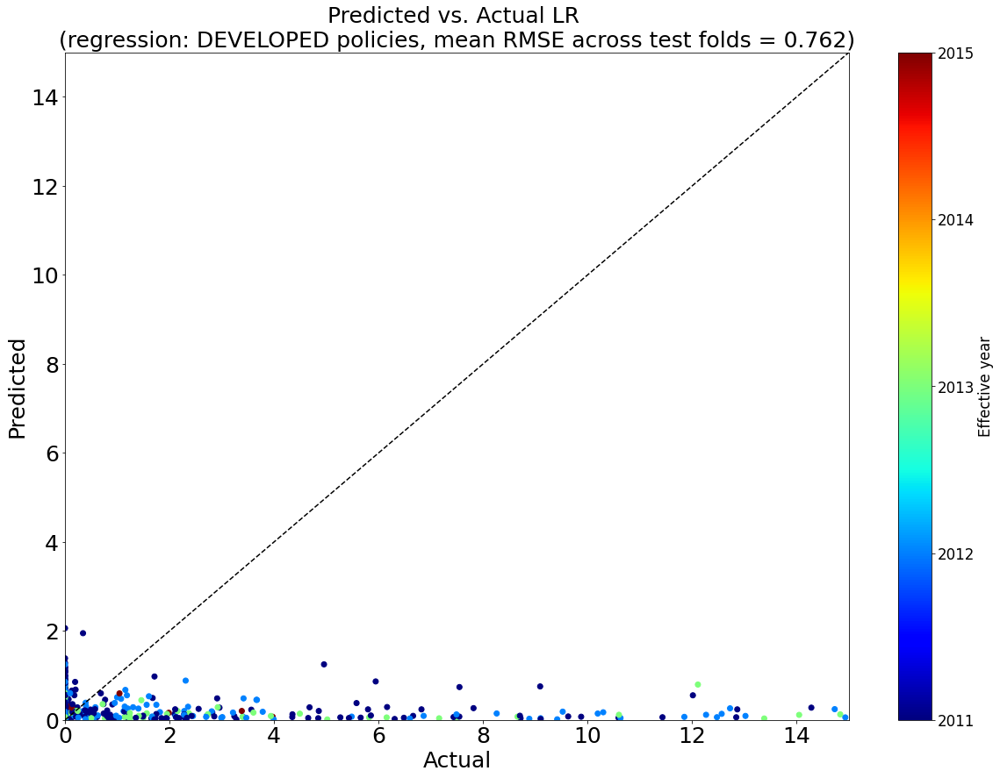

In [1788]:
plot_actual_predicted(developed_X_train, developed_y_train, y_pred_developed, 
                      title= f"Predicted vs. Actual LR \n(regression: DEVELOPED policies, mean RMSE across test folds = {best_rmse:{1}.{3}})",
                      filename= os.getcwd() + os.sep+ "Figures" + os.sep + "actual_predicted_DEVELOPED.png", fontsize=25)

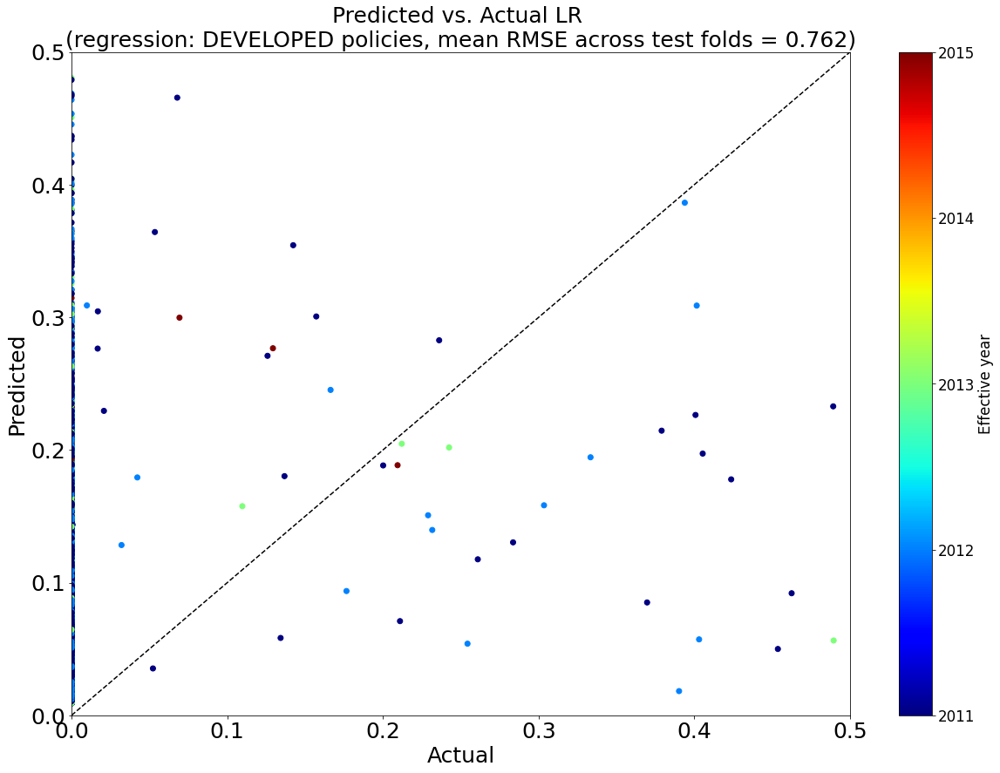

In [1789]:
plot_actual_predicted(developed_X_train, developed_y_train, y_pred_developed, 
                      title= f"Predicted vs. Actual LR \n(regression: DEVELOPED policies, mean RMSE across test folds = {best_rmse:{1}.{3}})",
                      fontsize=25,  filename= os.getcwd() + os.sep+ "Figures" + os.sep + "actual_predicted_DEVELOPED_zoom.png", axeslimit=(0, 0.5))

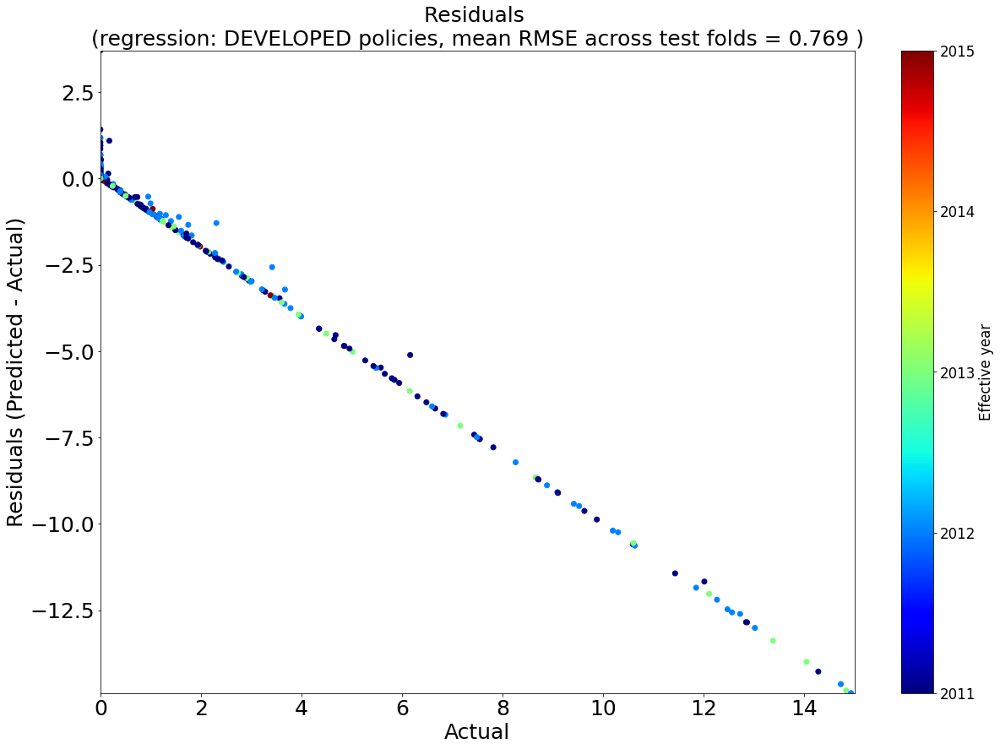

In [1672]:
residual_plot(developed_X_train, developed_y_train, y_pred_developed, 
                      title=f"Residuals \n(regression: DEVELOPED policies, mean RMSE across test folds = {best_rmse:{1}.{3}} )",
                       filename= os.getcwd() + os.sep+ "Figures" + os.sep + "residuals_DEVELOPED.png", fontsize=25)

dummy regressor performs best by taking mean:

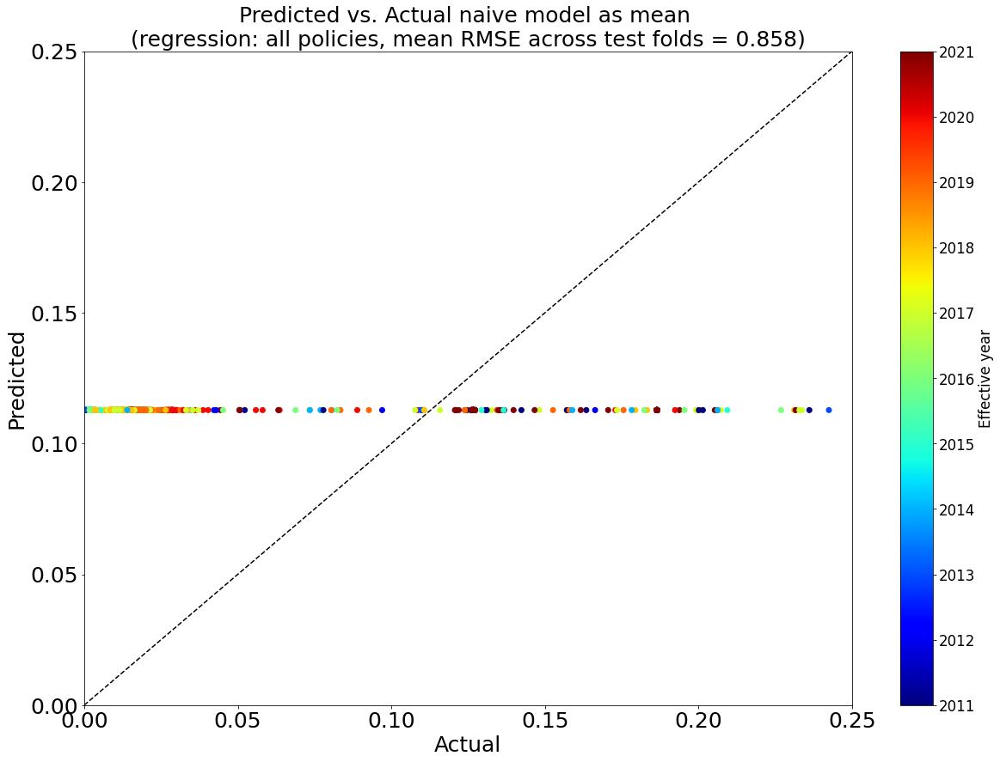

In [1673]:

plot_actual_predicted(X_train, y_train, [np.mean(y_train)] * len(y_train), 
                      title=f"Predicted vs. Actual naive model as mean \n(regression: all policies, mean RMSE across test folds = 0.858)",
                      fontsize=25,  filename= os.getcwd() + os.sep+ "Figures" + os.sep + "actual_predicted_naiveallpolicies.png", axeslimit=(0, 0.25))

# Comparing to dummy regressor

In [80]:
def dummy_experiment(train_for_cv_df, X_train, y_train, name_for_model, name_for_results, description):
    
    gkf_cv = StratifiedGroupKFold(shuffle=True, random_state=42, n_splits=3)
    
    # create a dummy target that is binary for zero/non-zero 
    zero_nonzero_indicator = y_train.apply(lambda row: 1 if row > 0 else 0)
    
    splitter_cv = gkf_cv.split(train_for_cv_df, zero_nonzero_indicator, groups=train_for_cv_df['policy_id'])
    
    dummy_reg = DummyRegressor(strategy="mean")
    
    start = time.time()
    
    param_grid = {
    'Dummy__strategy': ["quantile", "mean", "median"],
    'Dummy__quantile': [0.01, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8],
    }
    
    pipe = Pipeline(steps=[("Dummy", dummy_reg)])

    dummy_search = GridSearchCV(estimator=pipe, param_grid=param_grid, scoring='neg_root_mean_squared_error', 
                              cv=splitter_cv, n_jobs=4, return_train_score=True, verbose=1)

    dummy_search.fit(X_train, y_train)
    
    results = pd.DataFrame(dummy_search.cv_results_).loc[:, "params":]
    results = pd.concat([pd.Series(description, index=results.index, name='description'), results], axis=1)
    
    if os.path.isfile(name_for_results):
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='a', header=False, index=False)
    else:
         results[results["rank_test_score"] == 1].to_csv(name_for_results, mode='w', header=True, index=False)
            
    joblib.dump(dummy_search.best_estimator_, name_for_model)
    end = time.time()
    
    print ("Time elapsed (in Sec):", end - start)
    return dummy_search

In [89]:
dummy_search = dummy_experiment(train_df, X_train, y_train,  
                          name_for_model="dummy_best_estimator_allpolicies_notruncation.pkl", name_for_results="regression_notruncation.csv",
                          description = "Best dummy regressor allpolicies_notruncation")

Fitting 3 folds for each of 27 candidates, totalling 81 fits
Time elapsed (in Sec): 6.626835346221924


In [87]:
%%capture cap
print("Best dummy regressor allpolicies_notruncation\n")
print_XGB_metrics(dummy_search)

In [88]:
with open('regression.log', 'a') as f: f.write(cap.stdout)
print(cap.stdout)

Best dummy regressor allpolicies_notruncation

Best parameters: {'Dummy__quantile': 0.01, 'Dummy__strategy': 'mean'}
Best Score (-ve MSE):  -10.643846983178355
MSE std:  2.4169856821408904
Lowest RMSE (test):  3.262490916949556
Lowest RMSE STD (test):  0.36734090963561916





## dummy regressor comparison for developed policies

In [85]:
dummy_search = dummy_experiment(train_df, X_train, y_train,  
                          name_for_model="dummy_best_estimator.pkl", name_for_results="XGB_regression.csv",
                          description = "Best dummy regressor")

Fitting 3 folds for each of 27 candidates, totalling 81 fits
Time elapsed (in Sec): 8.172723293304443


In [86]:
%%capture cap
print("all features dummy regression experiment\n")
print_XGB_metrics(dummy_search)

# model summary plots

In [1838]:
model_descriptions = ["GLM(Tweedie)", "XGB variant", "XGB variant", "XGB variant", 
                "XGB + SMOTER", "XGB + SMOTER", "XGB + SMOTER",
               "HGBT variant", "HGBT variant", "Ensemble Resampling\n+ XGB"]

mean_test_score = [-0.731186736, -0.698483508, -0.718190024, -0.719414448, 
                   -0.717768796, -0.704246797, -0.707499927, -0.697415703,
                   -0.697206503, -0.705310274]

naive_rmse = math.sqrt(0.736264613)

model_rmses = [math.sqrt(-ele) for ele in mean_test_score]

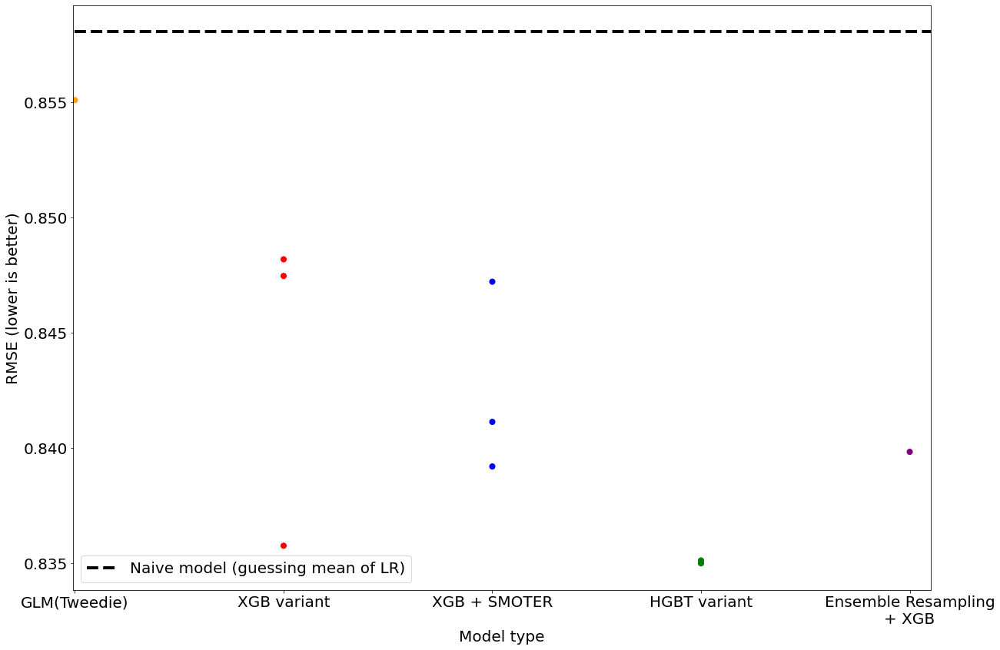

In [1840]:
fontsize=20

plt.scatter(model_descriptions, model_rmses, c = ["orange"] + ["r"] * 3 + ['b'] * 3 + ['g'] * 2 + ['purple']*1, s=50)
plt.plot(range(len(model_rmses)), [naive_rmse] *len(model_rmses), ls='--', lw=4, c='k', label='Naive model (guessing mean of LR)')
plt.yticks(size = fontsize)
plt.xticks(size = fontsize)
plt.ylabel("RMSE (lower is better)", size=fontsize)
plt.xlabel("Model type", size=fontsize)
plt.xlim([-0.01, 4.1])
plt.legend(loc='best', fontsize=fontsize)
plt.savefig(os.getcwd() + os.sep+ "Figures" + os.sep + "model_summary_plot.png")

# model summary plots after frequent feature removals

In [1]:
model_descriptions = ["GLM(Tweedie)", "XGB", "HGB variant", "HGB variant", "HGB variant", "HGB variant",  "HGB variant"] #last addition is Rishav's with his own preprocessing

mean_test_score = [-10.644245839464011, -10.643308843674252, -10.643885288768185, -10.656929986984442, 
                   -10.657420183916196, -10.65051771196749, -10.6406]

std_test_score = [2.417498236376686,  2.417065104996029, 2.4148349637762596, 2.418362813623384, 
                  2.418547849869414, 2.418228538828026, 2.4]

naive_rmse = 10.643846983178355

model_rmses = [-ele for ele in mean_test_score]
model_stds = std_test_score

In [4]:
print(np.arange(-0.7, 4.1, 0.1))
print(len(np.arange(-0.7, 4.1, 0.1)))
print(len([naive_rmse] *len(np.arange(-0.7, 4.1, 0.1))))

[-7.00000000e-01 -6.00000000e-01 -5.00000000e-01 -4.00000000e-01
 -3.00000000e-01 -2.00000000e-01 -1.00000000e-01 -1.11022302e-16
  1.00000000e-01  2.00000000e-01  3.00000000e-01  4.00000000e-01
  5.00000000e-01  6.00000000e-01  7.00000000e-01  8.00000000e-01
  9.00000000e-01  1.00000000e+00  1.10000000e+00  1.20000000e+00
  1.30000000e+00  1.40000000e+00  1.50000000e+00  1.60000000e+00
  1.70000000e+00  1.80000000e+00  1.90000000e+00  2.00000000e+00
  2.10000000e+00  2.20000000e+00  2.30000000e+00  2.40000000e+00
  2.50000000e+00  2.60000000e+00  2.70000000e+00  2.80000000e+00
  2.90000000e+00  3.00000000e+00  3.10000000e+00  3.20000000e+00
  3.30000000e+00  3.40000000e+00  3.50000000e+00  3.60000000e+00
  3.70000000e+00  3.80000000e+00  3.90000000e+00  4.00000000e+00]
48
48


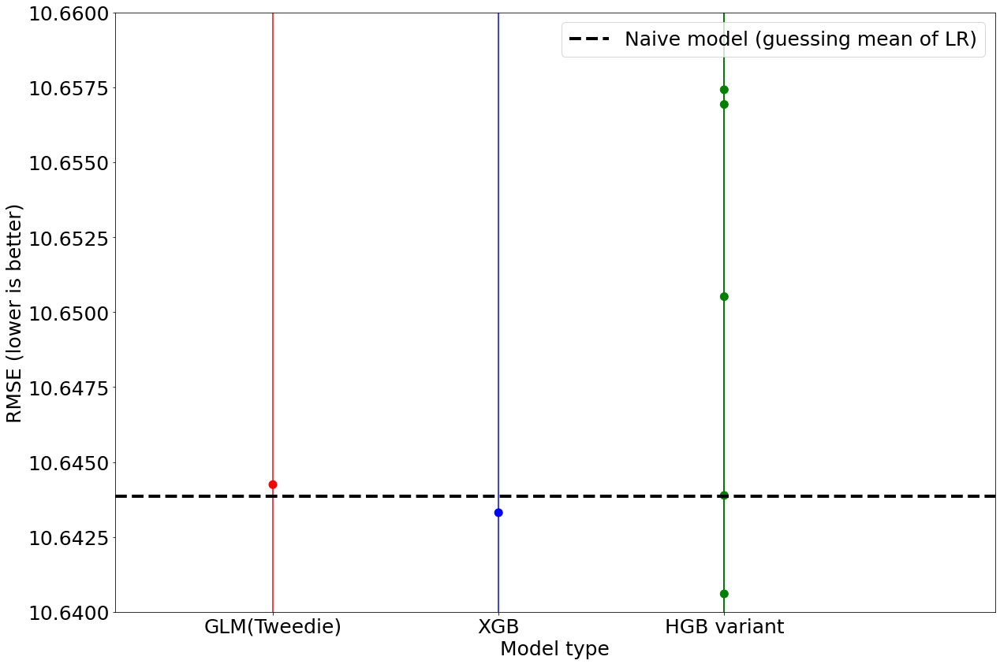

In [6]:
fontsize=25

plt.scatter(model_descriptions, model_rmses, c = ["r"] * 1 + ['b'] * 1 + ['g'] * 5 , s=100)
plt.plot(list(np.arange(-0.7, 3.6, 0.1)), [naive_rmse] * len(np.arange(-0.7, 3.6, 0.1)), ls='--', lw=4, c='k', label='Naive model (guessing mean of LR)')

plt.errorbar(model_descriptions, model_rmses,
             yerr = model_stds,
             fmt ='none', c = ["r"] * 1 + ['b'] * 1 + ['g'] * 5 )

plt.yticks(size = fontsize)
plt.xticks(size = fontsize)
plt.ylabel("RMSE (lower is better)", size=fontsize)
plt.xlabel("Model type", size=fontsize)
plt.xlim([-0.7, 3.2])
plt.ylim(10.64, 10.66)
#plt.ylim(7, 14)
plt.legend(loc='best', fontsize=fontsize)
plt.savefig(os.getcwd() + os.sep+ "Figures" + os.sep + "model_summary_plot_updatedafterremovals.png")

# Scratch (usually data exploration)

## Testing Risk categories

In [796]:
riskcol_high = ['plaintiff_class_action', 'plaintiff_mass_tort','personal_injury_and_negligence_plaintiff', 'intellectual_property_patent_trademark']
riskcol_aboveavg = ['antitrust_trade', 'collection_bankruptcy', 'commercial_and_business_litigation_defense_plaintiff', 'employment_law_plaintiff',
                    'entertainment_sports', 'environmental_law', 'estate_probate_trust', 'financial_institution', 'intellectual_property_copyright', 
                    'labor_labor_representation', 'mergers_acquisitions', 'natural_resources_other', 'natural_resources_title',
                    'pension_employee_benefits', 'commercial_real_estate_closings', 'commercial_real_estate_foreclosure', 'commercial_real_estate_other',
                    'commercial_real_estate_title', 'residential_real_estate_closings', 'residential_real_estate_foreclosure',  'residential_real_estate_other',
                    'residential_real_estate_title', 'workers_comp_plaintiff']
riskcol_avg = ['admiralty_law', 'admiralty_law_plaintiff', 'civil_rights_and_discrimination', 'corporate_and_business_organization', 
               'financial_planning', 'healthcare', 'international_law', 'taxation_other', 'other']
riskcol_belowavg = ['administrative_law', 'construction_law', 'consumer_law', 'family_law', 'government_contracts_relations', 'immigration_naturalization',
                   'labor_management_representation']
riskcol_low = ['commercial_and_business_litigation_defense', 'criminal', 'employment_law_defense', 'insurance_coverage', 'insurance_opinions', 
               'mediation_arbitration', 'personal_injury_and_negligence_defense', 'workers_comp_defense']

In [799]:
yeartrunc_df = merged_df[(merged_df["effective_year"]> 2010) & (merged_df["effective_year"] < 2022)]

match_highrisk = yeartrunc_df.fillna(0).apply(lambda row: math.isclose(row[riskcol_high].sum(), row["aop_high_risk"]*100.0, rel_tol = 10**-2), axis=1).mean()
match_aboveavgrisk = yeartrunc_df.fillna(0).apply(lambda row: math.isclose(row[riskcol_aboveavg].sum(), row["aop_above_average_risk"]*100.0, rel_tol = 10**-2), axis=1).mean()
match_agvgrisk = yeartrunc_df.fillna(0).apply(lambda row: math.isclose(row[riskcol_avg].sum(), row["aop_average_risk"]*100.0, rel_tol = 10**-2), axis=1).mean()
match_belowavgrisk = yeartrunc_df.fillna(0).apply(lambda row: math.isclose(row[riskcol_belowavg].sum(), row["aop_below_average_risk"]*100.0, rel_tol = 10**-2), axis=1).mean()
match_lowrisk = yeartrunc_df.fillna(0).apply(lambda row: math.isclose(row[riskcol_low].sum(), row["aop_low_risk"]*100.0, rel_tol = 10**-2), axis=1).mean()

print(match_highrisk)
print(match_aboveavgrisk)
print(match_agvgrisk)
print(match_belowavgrisk)
print(match_lowrisk)

print(set(riskcol_high + riskcol_aboveavg + riskcol_avg + riskcol_belowavg + riskcol_low) ^ set(aop_cols))

0.9845694839401427
0.9811430702531351
0.9982984476248193
0.9999766910633537
1.0
{'intellectual_property_c_p_t_including_litigation', 'securities_law_incl_bonds_private_placements_and_limited_partnerships', 'communications_fcc', 'tax_ad_valorum', 'defense', 'lobbying', 'taxation_opinions', 'juvenile_court_proceeding', 'intellectual_property_c_p_t_not_including_litigation', 'social_security_veterans_administration'}


In [967]:
print(yeartrunc_df["max_detailed_aop"].unique().tolist())

['intellectual_property_patent_trademark', 'real_estate_commercial', 'corporate_and_business_organization', 'family_law', 'estate_probate_trust', 'personal_injury_and_negligence_plaintiff', 'personal_injury_and_negligence_defense', 'financial_institution', 'commercial_and_business_litigation_defense', 'insurance', 'employment_law_defense', 'other', 'real_estate_residential', 'administrative_law', 'plaintiff_mass_tort', 'commercial_and_business_litigation_defense_plaintiff', 'collection_bankruptcy', 'entertainment_sports', 'labor_management_representation', 'workers_comp_defense', 'criminal', 'financial_planning', 'healthcare', 'antitrust_trade', 'plaintiff_class_action', nan, 'admiralty_law', 'immigration_naturalization', 'government_contracts_relations', 'workers_comp_plaintiff', 'mediation_arbitration', 'labor_labor_representation', 'intellectual_property_copyright', 'employment_law_plaintiff', 'construction_law', 'taxation_other', 'civil_rights_and_discrimination', 'natural_resource

In [805]:
risk_other = ['intellectual_property_c_p_t_including_litigation', 'securities_law_incl_bonds_private_placements_and_limited_partnerships', 'communications_fcc', 'tax_ad_valorum', 'defense', 'lobbying', 'taxation_opinions', 'juvenile_court_proceeding', 'intellectual_property_c_p_t_not_including_litigation', 'social_security_veterans_administration']

In [836]:
print(yeartrunc_df[riskcol_high + riskcol_aboveavg + riskcol_avg + riskcol_belowavg + riskcol_low].sum(axis=1).value_counts().sort_index(ascending=False))

297.2300000000000182        1
130.0000000000000000        1
103.0000000000000000        1
100.0000000000000284        1
100.0000000000000142       75
100.0000000000000000    41299
99.9999999999999858       109
99.9999999999999716         5
99.9800000000000040         1
99.9700000000000131         1
99.9699999999999989         1
99.9500000000000171         1
99.9500000000000028         4
99.9200000000000017         1
99.9099999999999966         1
99.9000000000000199         1
99.9000000000000057        25
99.8999999999999915        12
99.8999999999999773         7
99.8800000000000097         1
99.8799999999999955         1
99.8400000000000034         3
99.8299999999999983         2
99.8099999999999881         2
99.8000000000000114         3
99.7999999999999972        10
99.7999999999999829         3
99.7099999999999937         1
99.7000000000000171         1
99.7000000000000028         1
99.6999999999999886         3
99.6899999999999977         6
99.6400000000000006         1
99.6350000

In [837]:
print(yeartrunc_df[aop_cols].sum(axis=1).value_counts().sort_index(ascending=False))

297.2300000000000182        1
132.0000000000000000        1
103.0000000000000000        1
100.0200000000000102        1
100.0100000000000051        1
100.0000000000000142      162
100.0000000000000000    42540
99.9999999999999858       185
99.9999999999999716         1
99.9700000000000131         1
99.9699999999999989         1
99.9599999999999937         1
99.9339999999999975         1
99.9099999999999966         1
77.9700000000000131         2
0.0000000000000000          2
dtype: int64


In [821]:
yeartrunc_df.shape

(42902, 534)

In [970]:
yeartrunc_df[aop_cols + ["max_detailed_aop", "max_detailed_aop_pct", "dominat_aop_group"]]

,entertainment_sports,personal_injury_and_negligence_plaintiff,financial_planning,intellectual_property_copyright,intellectual_property_patent_trademark,mergers_acquisitions,commercial_and_business_litigation_defense,employment_law_defense,personal_injury_and_negligence_defense,workers_comp_defense,...,securities_law_incl_bonds_private_placements_and_limited_partnerships,social_security_veterans_administration,tax_ad_valorum,taxation_opinions,taxation_other,workers_comp_plaintiff,defense,max_detailed_aop,max_detailed_aop_pct,dominat_aop_group
5684,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,100.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,...,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,intellectual_property_patent_trademark,100.0000000000000000,High
5685,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,...,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,real_estate_commercial,100.0000000000000000,Avobe
5686,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,...,1.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,corporate_and_business_organization,30.0000000000000000,Avobe
5687,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,...,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,family_law,100.0000000000000000,Below
5688,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,...,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,family_law,100.0000000000000000,Below
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
234055,1.0000000000000000,14.0000000000000000,0.0000000000000000,3.0000000000000000,3.0000000000000000,19.0000000000000000,0.0000000000000000,4.5000000000000000,0.0000000000000000,0.0000000000000000,...,2.0000000000000000,0.0000000000000000,0.0000000000000000,1.0000000000000000,1.0000000000000000,0.0000000000000000,0.0000000000000000,mergers_acquisitions,19.0000000000000000,Avobe
234056,0.0000000000000000,87.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,...,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,personal_injury_and_negligence_plaintiff,87.0000000000000000,High
234057,0.0000000000000000,4.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,32.0000000000000000,0.0000000000000000,25.0000000000000000,0.0000000000000000,...,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,0.0000000000000000,commercial_and_business_litigation_defense,32.0000000000000000,Low
234058,0.0000000000000000,0.0000000000000000,0.0000000000000000,1.0000000000000000,1.0000000000000000,0.0000000000000000,11.0000000000000000,0.0000000000000000,1.0000000000000000,1.0000000000000000,...,2.0000000000000000,0.0000000000000000,0.0000000000000000,1.

## testing how much signal IBNR captures:

Here the idea is to test how much of the ultimate loss signal is captured by IBNR across the good/bad policies. If IBNR dominates the 0 label losses then 

In [200]:
ibnr_test = present_target_trunc_df.copy()

ibnr_test["pure_ibnr"] = ibnr_test["pure_ibnr"].fillna(0)
ibnr_test["ibner"] = ibnr_test["ibner"].fillna(0)
ibnr_test["ultimate_loss"] = ibnr_test["ultimate_loss"].fillna(0)

ibnr_test["ibnr_fraction_trended"] = ibnr_test.apply(lambda row: 1.0 if row["ultimate_loss"] == 0 else
                                             (row["pure_ibnr"] + row["ibner"])/(row["ultimate_loss"] * row["loss_trend_factor"] * -1), axis=1)

ibnr_test["ibnr_fraction"] = ibnr_test.apply(lambda row: 1.0 if row["ultimate_loss"] == 0 else
                                             (row["pure_ibnr"] + row["ibner"])/(row["ultimate_loss"] * -1), axis=1)
ibnr_test['bad_lr'] = ibnr_test["ultimate_trended_onlevel_lr"].apply(lambda x: 1 if x > 0.57 else 0)

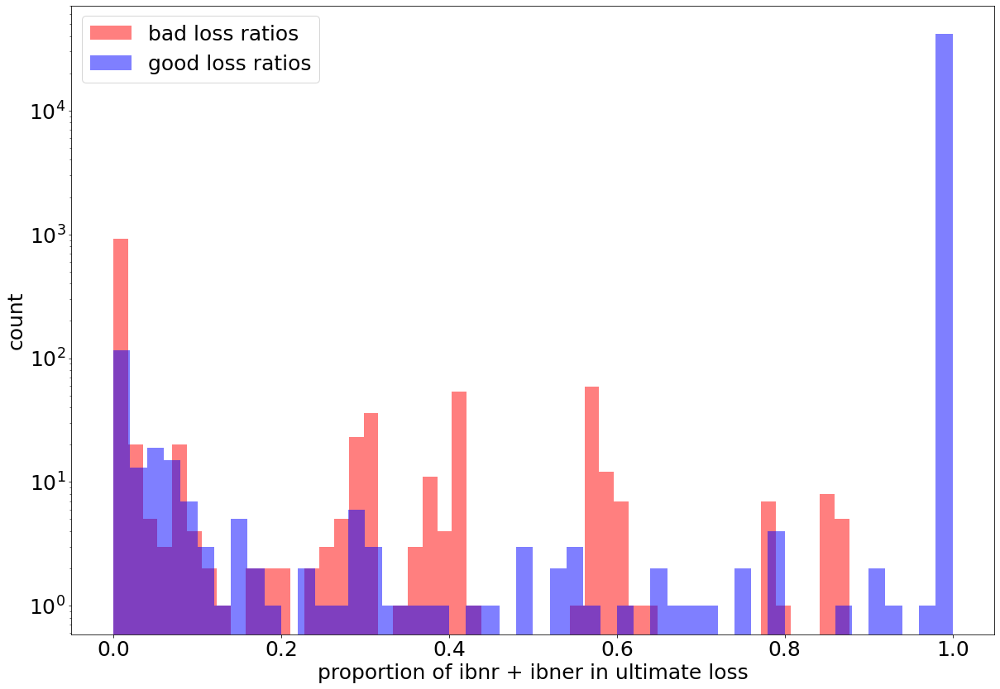

In [201]:
textsize=25
ibnr_test[ibnr_test["bad_lr"] == 1]["ibnr_fraction"].plot(kind='hist', bins=50, color='red', label='bad loss ratios', alpha = 0.5)
ibnr_test[ibnr_test["bad_lr"] == 0]["ibnr_fraction"].plot(kind='hist', bins=50, color='blue', label = 'good loss ratios', alpha = 0.5)
plt.legend(loc='best', fontsize=textsize)
plt.xticks(fontsize=textsize)
plt.yticks(fontsize=textsize)
plt.xlabel('proportion of ibnr + ibner in ultimate loss', fontsize=textsize)
plt.ylabel('count', fontsize=textsize)
plt.yscale('log')
plt.show()

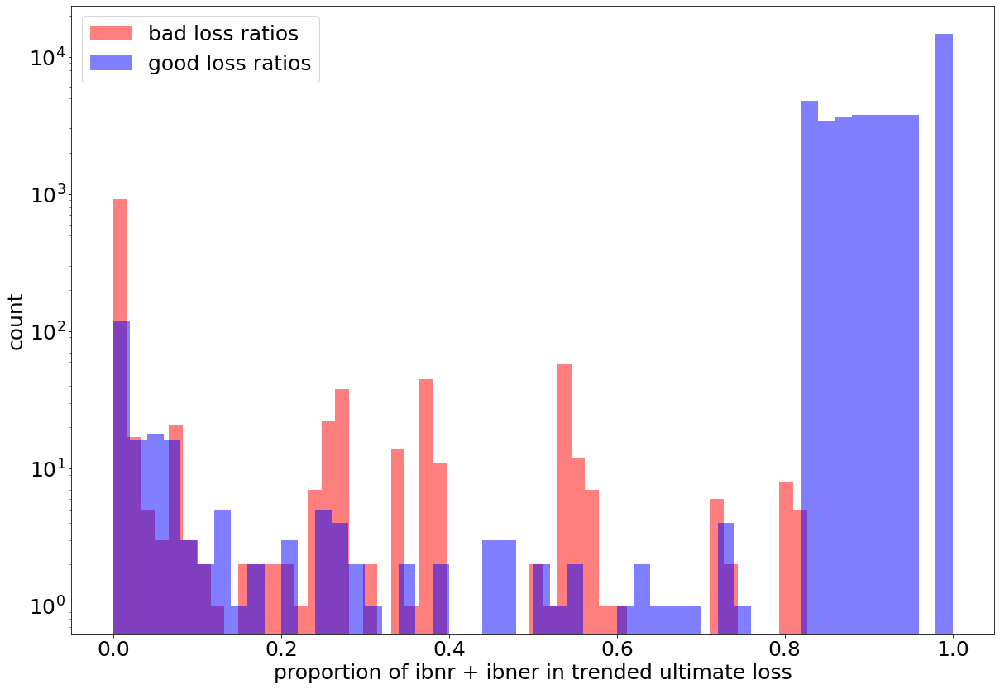

In [202]:
textsize=25
ibnr_test[ibnr_test["bad_lr"] == 1]["ibnr_fraction_trended"].plot(kind='hist', bins=50, color='red', label='bad loss ratios', alpha = 0.5)
ibnr_test[ibnr_test["bad_lr"] == 0]["ibnr_fraction_trended"].plot(kind='hist', bins=50, color='blue', label = 'good loss ratios', alpha = 0.5)
plt.legend(loc='best', fontsize=textsize)
plt.xticks(fontsize=textsize)
plt.yticks(fontsize=textsize)
plt.xlabel('proportion of ibnr + ibner in trended ultimate loss', fontsize=textsize)
plt.ylabel('count', fontsize=textsize)
plt.yscale('log')
plt.show()

In [159]:
ibnr_test[["effective_year", "pure_ibnr", "ibner", "total_paid", "total_reserve", "ultimate_loss", "onlevel_premium", "ultimate_trended_onlevel_lr", "bad_lr"]].sample(20)

,effective_year,pure_ibnr,ibner,total_paid,total_reserve,ultimate_loss,onlevel_premium,ultimate_trended_onlevel_lr,bad_lr
42467,2012,0.000000,0.0,NaN,NaN,0.000000,49265.393005,0.000000,0
32166,2020,121.941006,0.0,NaN,NaN,-121.941006,9993.220217,0.013204,0
221693,2020,72.823311,0.0,NaN,NaN,-72.823311,5745.484054,0.013716,0
227553,2011,0.000000,0.0,NaN,NaN,0.000000,2303.736784,0.000000,0
85452,2017,80.664412,0.0,NaN,NaN,-80.664412,7299.374407,0.012690,0
130509,2018,42.663057,0.0,NaN,NaN,-42.663057,4649.299065,0.010331,0
178918,2019,70.638283,0.0,NaN,NaN,-70.638283,4774.819400,0.016329,0
223463,2017,37.946556,0.0,NaN,NaN,-37.946556,3710.350341,0.011744,0
177462,2012,0.000000,0.0,NaN,NaN,0.000000,3630.885346,0.000000,0
37101,2020,16.012312,0.0,NaN,NaN,-16.012312,1126.724122,0.015378,0


## testing if prev_agg_lr_bad is simply a function of history length

In [137]:
agg_testing_df = df_with_histories[["prev_agg_lr_bad", "effective_year_history", "ultimate_trended_onlevel_lr"]].copy()

agg_testing_df["bad_lr"] = agg_testing_df["ultimate_trended_onlevel_lr"].apply(lambda x: 1 if x > 0.57 else 0)
agg_testing_df["history_length"] = agg_testing_df["effective_year_history"].apply(lambda x: len(x))
agg_testing_df = agg_testing_df.drop("effective_year_history", axis=1)
agg_testing_df = agg_testing_df.drop("ultimate_trended_onlevel_lr", axis=1)

In [138]:
agg_testing_df.sample(20)

,prev_agg_lr_bad,bad_lr,history_length
41955,0.0,0,1
39556,0.0,0,3
27761,NaN,0,0
1517,NaN,0,0
23245,0.0,0,3
37240,NaN,0,0
25263,0.0,0,1
654,NaN,0,0
33299,0.0,0,1
30050,0.0,0,5


<Axes: xlabel='history_length'>

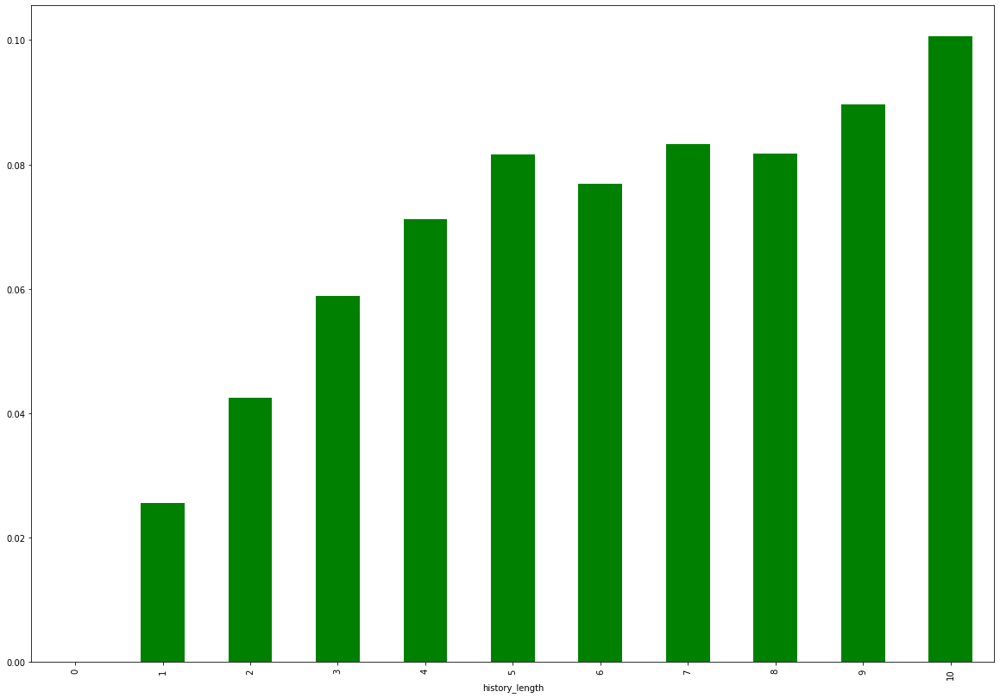

In [147]:
agg_testing_df.groupby("history_length")["prev_agg_lr_bad"].mean().plot(kind='bar', color='green')

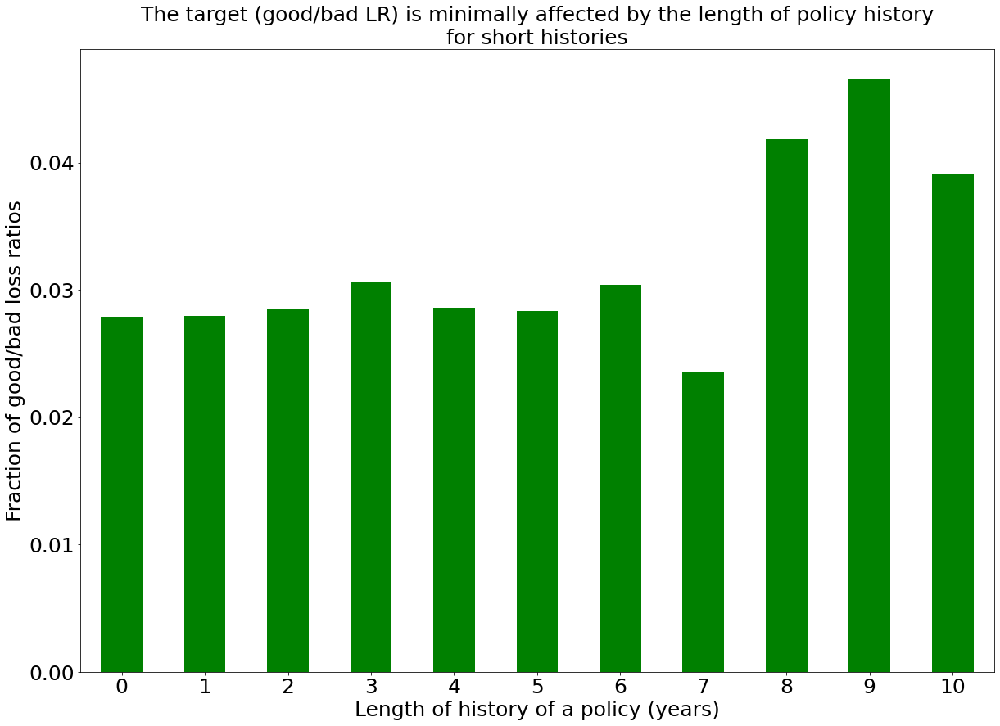

In [155]:
textsize=25
agg_testing_df.groupby("history_length")["bad_lr"].mean().plot(kind='bar', color='green')

plt.title("The target (good/bad LR) is minimally affected by the length of policy history\nfor short histories", fontsize=textsize)
plt.xlabel("Length of history of a policy (years)", fontsize=textsize)
plt.ylabel("Fraction of good/bad loss ratios", fontsize=textsize)
plt.xticks(fontsize=textsize, rotation=0)
plt.yticks(fontsize=textsize)
plt.savefig("target_vs_history_length.png", dpi=300, bbox_inches='tight')

# simulating this effect because it doesn't make sense

# take a window of 10 losses, compute aggregate loss ratio (assume premiums are 100 as well)

In [299]:
threshold = 0.2

In [301]:
losses_window_mean = {}
for window_size in np.arange(1, 10, 1):
    losses_window_aggregate = []
    for i in range(50):
        
        #losses = np.random.exponential(100, 10000)
        losses = np.random.binomial(1, 0.02, 100000) * np.array([1000]*100000)
        losses_window = []
        premiums = [100] * window_size
        for j in np.arange(0, len(losses)-window_size, window_size):
            losses_window.append(losses[j:j+window_size])

        # now for each loss, compute aggregate LR
        agg_lr = []
        for window in losses_window:
            agg_lr.append(sum(window)/sum(premiums))
            
        fraction_bad = len(np.where(np.array(agg_lr) > threshold)[0])/len(agg_lr)
        
        losses_window_aggregate.append(fraction_bad)

    losses_window_mean[window_size] = np.mean(losses_window_aggregate)

print(losses_window_mean)

{1: 0.01990639906399064, 2: 0.03966959339186784, 3: 0.05865178651786517, 4: 0.07746709868394736, 5: 0.09600580029001449, 6: 0.11456858274330976, 7: 0.1318305915295765, 8: 0.14955596447715816, 9: 0.16646566465664656}


In [259]:
np.arange(0, 100, 10)

array([ 0, 10, 20, 30, 40, 50, 60, 70, 80, 90])

# Scratch

In [183]:
def generate_dates_inclusive(start_q, end_q):
    
    year_start = int(start_q.split(" ")[0])
    quarter_start = int(start_q.split("Q")[1])

    if end_q is not None:
        year_end = int(end_q.split(" ")[0])
        quarter_end = int(end_q.split("Q")[1])
    else:
        year_end = datetime.date.today().year
        quarter_end = (datetime.date.today().month - 1)//3 + 1

    quarters = ["Q1", "Q2", "Q3", "Q4"]
    dates = []
    
    for yr in range(year_start, year_end + 1):
        start_slice = 0
        end_slice = 4
        
        if yr == year_start:
            start_slice = quarter_start -1
        if yr == year_end:
            end_slice = quarter_end
        
        dates.extend([str(yr) + " " + ele for ele in quarters[start_slice:end_slice]])

    return dates

In [184]:
generate_dates_inclusive("2024 Q1", None)

['2024 Q1']

In [162]:
import datetime

In [175]:
type((datetime.date.today().month - 1)//3 + 1)

int